In [1]:
import pandas as pd
import numpy as np
import threading
import time
import queue
import matplotlib.pyplot as plt
from tensorflow import keras
from tensorflow.keras.models import model_from_json

In [2]:
# Lista para guardar las predicciones
history = []

# Parámetros de normalización para conjunto de datos de la industria
T_C_0_num = -2304.11053494
T_C_0_den = 7393.278659940001

In [3]:
# Función de normalización
def normalize(x):
  return (x - T_C_0_num) / T_C_0_den

In [4]:
# Lógica del proceso Simulador
def simulator(thread_name, console_lock):
    for i in range(len(sds)):
        # Pausa de un segundo entre entregas de datos
        time.sleep(1)
        # Inserción de los datos en el repositorio FIFO
        q.put(sds[i])
        with console_lock:
            print("Proceso Simulador de Lecturas - Proc.Nro. " + str(threading.get_ident()))
            print("Lecturas enviadas: ", sds[i])

In [5]:
# Lógica del proceso predictor
def predictor(thread_name, console_lock, loaded_model):
    pred_counter = 0
    serie = np.empty((1, 4))
    while (pred_counter < 912):
        if q.qsize() > 0:
            b = q.get()
            with console_lock:
                print("Proceso Predictor - Proc.Nro. " + str(threading.get_ident()))
                print("Predicción Nro.: ", pred_counter, " - Datos Recibidos: ", b)
                print("Objetos restantes en la cola: " + str(q.qsize()))
                # Preparado de la Serie
                if pred_counter == 0:
                    serie = np.array([b])
                else:
                    serie = np.append(serie, np.array([b]), axis=0)
                # Gráfica de la serie acumulada
                plt.plot(serie)
                # Plot de la salida normalizada a la cota máxima de valores para mejor visualización
                # La marca de predicción sale con grosor 4 y color rojo
                plt.plot([((h * T_C_0_den) + T_C_0_num) for h in history], linewidth=4, color='red')
                plt.show()

                # Predicción
                if len(serie) > 0: # Hay suficientes datos para predecir
                    x = normalize(serie[-1:, :])
                    # print("Ultima lectura recibida (Normalizada)")
                    # print(x)
                    pred_val = loaded_model.predict(np.array([x]))
                    i_pred_val = np.argmax(pred_val)
                    history.append(i_pred_val)
                    print("Predicción: ", pred_val, "Etiqueta: ", i_pred_val)
                    print("Estado en 30 minutos: ", text_labels[i_pred_val])
                else:
                    print("No hay suficientes datos para realizar una predicción.")
                pred_counter += 1
        else:
            time.sleep(1)
    # Guardado en archivo del resultado de las predicciones
    mat = np.matrix(history)
    with open('resultados_h_p_s_2.txt', 'wb') as f:
        for line in mat:
            np.savetxt(f, line, fmt='%.4f', delimiter='\t')


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 140)               16800     
_________________________________________________________________
dense_1 (Dense)              (None, 50)                7050      
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 102       
Total params: 23,952
Trainable params: 23,952
Non-trainable params: 0
_________________________________________________________________
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5810400e+01  1.0095800e+01  5.4988100e+01  7.4557400e+01
  6.1034940e+02  3.2955600e+01  9.7919000e+00  1.8515080e+02
  5.0000000e-04  6.6868000e+01  1.2499500e+02  8.2069000e+00
  6.6001100e+01  1.6867080e+02  2.0270100e+01  1.6379010e+02
  1.8362400e+02  7.0475900e+01 -6.8991000e+00  3.1032000e+00
  1.639230

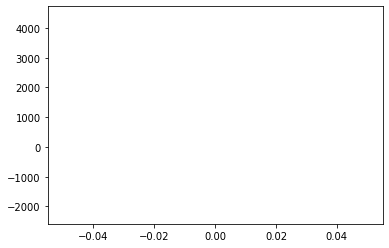

Predicción:  [[[0.9836447  0.01635519]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6102300e+01  1.0071400e+01  5.5916800e+01  7.5733400e+01
  6.0928250e+02  3.3085100e+01  9.9593000e+00  1.8501230e+02
  5.0000000e-04  6.7666000e+01  1.2504540e+02  8.0513000e+00
  6.5987900e+01  1.6885380e+02  2.1044300e+01  1.6397260e+02
  1.8357860e+02  7.0441200e+01 -6.8991000e+00  3.0990000e+00
  1.5659500e+01  6.9023000e+00  1.6010000e+00  7.1505000e+01
  1.4237000e+00  1.4840000e+00  8.7585200e+01  6.2314000e+01
  1.2717000e+00  1.1913000e+00  1.5687000e+00  1.3443000e+00
  1.5218990e+02  8.1890000e-01  8.2060000e-01 -2.2530846e+03
  2.0436110e+02  1.5718000e+00  1.3338000e+00  2.1891051e+03
  4.2609868e+03  1.8481450e+02  1.3753000e+00  1.3681000e+00
  8.0024000e+00  7.4033000e+00  1.7130000e+00  1.4390000e-01
  3.0640600e+01  5.2653110e+02  5.1871590e+02  5.1473920e+02
  5.1522520e+02  5.1544140e+02  3.2489500e+01  3.25

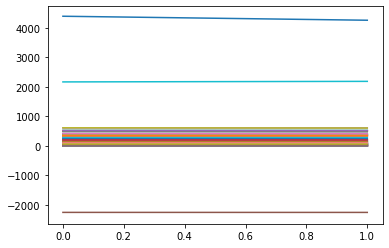

Predicción:  [[[0.9785791  0.02142091]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6347600e+01  9.9507000e+00  5.6404900e+01  7.5803500e+01
  6.1002980e+02  3.4022900e+01  9.9191000e+00  1.8494660e+02
  5.0000000e-04  6.7923700e+01  1.2467470e+02  8.0646000e+00
  6.6083500e+01  1.7055960e+02  2.1444100e+01  1.6429360e+02
  1.8341100e+02  7.0458700e+01 -6.8991000e+00  3.0908000e+00
  1.5530700e+01  6.9001000e+00  1.6027000e+00  7.1537900e+01
  1.4259000e+00  1.4880000e+00  9.0084500e+01  6.2288500e+01
  1.2724000e+00  1.1932000e+00  1.5691000e+00  1.3479000e+00
  1.5211490e+02  8.1790000e-01  8.1930000e-01 -2.2451547e+03
  2.0629260e+02  1.5777000e+00  1.3347000e+00  2.1174160e+03
  4.3807828e+03  1.8481450e+02  1.3807000e+00  1.3720000e+00
  7.9979000e+00  7.4088000e+00  1.7150000e+00  1.4580000e-01
  3.2617400e+01  5.2693330e+02  5.1913080e+02  5.1529880e+02
  5.1574680e+02  5.1602170e+02  3.3027300e+01  3.30

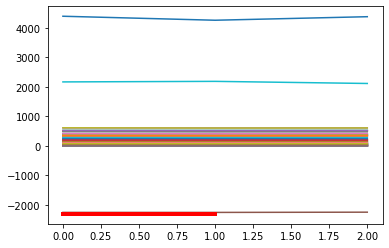

Predicción:  [[[0.98235935 0.0176407 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6622800e+01  9.8008000e+00  5.6516000e+01  7.5513900e+01
  6.1012570e+02  3.4795100e+01  9.9811000e+00  1.8507470e+02
  5.0000000e-04  6.7888300e+01  1.2500260e+02  7.9287000e+00
  6.6185500e+01  1.7136870e+02  2.1461500e+01  1.6389090e+02
  1.8333260e+02  7.0377300e+01 -6.8991000e+00  3.0875000e+00
  1.5103000e+01  6.8781000e+00  1.5997000e+00  7.1545800e+01
  1.4276000e+00  1.4884000e+00  8.9673100e+01  6.2150200e+01
  1.2741000e+00  1.1945000e+00  1.5683000e+00  1.3471000e+00
  1.5186950e+02  8.1860000e-01  8.2000000e-01 -2.2437849e+03
  2.0323600e+02  1.5762000e+00  1.3361000e+00  2.1240292e+03
  4.3606869e+03  1.8481450e+02  1.3785000e+00  1.3709000e+00
  8.0014000e+00  7.3988000e+00  1.7159000e+00  1.4750000e-01
  3.1314000e+01  5.2630220e+02  5.1900100e+02  5.1499190e+02
  5.1541580e+02  5.1570150e+02  3.3260000e+01  3.31

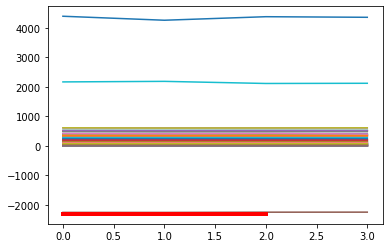

Predicción:  [[[0.98154265 0.01845736]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6635000e+01  9.7774000e+00  5.7186600e+01  7.5569200e+01
  6.1030530e+02  3.3893600e+01  1.0024500e+01  1.8495530e+02
  5.0000000e-04  6.8035500e+01  1.2495080e+02  8.2282000e+00
  6.6023800e+01  1.6990000e+02  2.1640300e+01  1.6392190e+02
  1.8333310e+02  7.0405200e+01 -6.8991000e+00  3.0982000e+00
  1.5481800e+01  6.9013000e+00  1.6001000e+00  7.1503100e+01
  1.4300000e+00  1.4933000e+00  8.9269700e+01  6.1852200e+01
  1.2798000e+00  1.1966000e+00  1.5751000e+00  1.3504000e+00
  1.5237780e+02  8.1820000e-01  8.1990000e-01 -2.2524192e+03
  2.0315030e+02  1.5841000e+00  1.3416000e+00  2.1855278e+03
  4.3509311e+03  1.8481450e+02  1.3831000e+00  1.3744000e+00
  7.9976000e+00  7.3996000e+00  1.7199000e+00  1.4480000e-01
  3.2548000e+01  5.2610000e+02  5.1901050e+02  5.1506920e+02
  5.1550720e+02  5.1575810e+02  3.3290900e+01  3.30

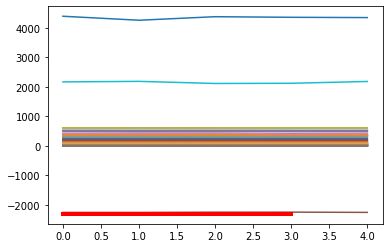

Predicción:  [[[0.98209506 0.01790493]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6756700e+01  9.6799000e+00  5.8990300e+01  7.5514600e+01
  6.1079570e+02  3.4602300e+01  1.0057000e+01  1.8498770e+02
  5.0000000e-04  6.8004600e+01  1.2471180e+02  8.0378000e+00
  6.6087500e+01  1.7090750e+02  2.1442400e+01  1.6393420e+02
  1.8331770e+02  7.0493000e+01 -6.8991000e+00  3.1328000e+00
  1.5330900e+01  6.8951000e+00  1.5997000e+00  7.1540300e+01
  1.4257000e+00  1.4877000e+00  9.0666400e+01  6.2421000e+01
  1.2738000e+00  1.1923000e+00  1.5681000e+00  1.3466000e+00
  1.5254290e+02  8.1780000e-01  8.1970000e-01 -2.2409068e+03
  2.0208250e+02  1.5772000e+00  1.3365000e+00  2.1436553e+03
  4.3684503e+03  1.8481450e+02  1.3787000e+00  1.3704000e+00
  8.0029000e+00  7.3991000e+00  1.7140000e+00  1.4610000e-01
  3.2066700e+01  5.2676660e+02  5.1913670e+02  5.1514780e+02
  5.1559920e+02  5.1587150e+02  3.3152300e+01  3.32

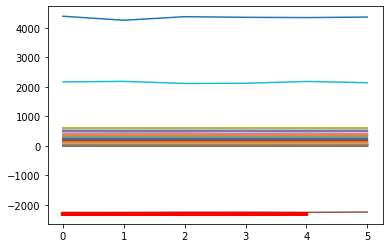

Predicción:  [[[0.98144436 0.0185556 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6691500e+01  9.6811000e+00  5.8740600e+01  7.5084500e+01
  6.1077200e+02  3.5024700e+01  1.0032900e+01  1.8503150e+02
  5.0000000e-04  6.7712200e+01  1.2495600e+02  8.0882000e+00
  6.5897700e+01  1.7175940e+02  2.1387300e+01  1.6403580e+02
  1.8342250e+02  7.0470900e+01 -6.8991000e+00  3.1078000e+00
  1.6629100e+01  6.8890000e+00  1.6001000e+00  7.1464100e+01
  1.4207000e+00  1.4823000e+00  8.8898800e+01  6.2727600e+01
  1.2693000e+00  1.1881000e+00  1.5597000e+00  1.3385000e+00
  1.5100560e+02  8.1780000e-01  8.2080000e-01 -2.2484659e+03
  2.0442010e+02  1.5710000e+00  1.3319000e+00  2.2002584e+03
  4.3381470e+03  1.8481450e+02  1.3730000e+00  1.3630000e+00
  7.9975000e+00  7.3993000e+00  1.7098000e+00  1.4980000e-01
  3.4339600e+01  5.2653340e+02  5.1866120e+02  5.1478580e+02
  5.1524830e+02  5.1551100e+02  3.3160200e+01  3.31

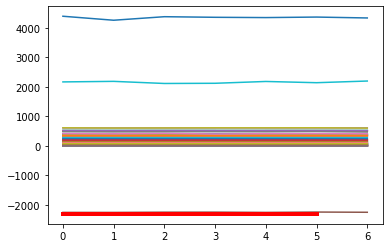

Predicción:  [[[0.98103416 0.01896591]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6542700e+01  9.6954000e+00  5.8909400e+01  7.4287700e+01
  6.1015680e+02  3.5459400e+01  1.0070400e+01  1.8519410e+02
  5.0000000e-04  6.7729400e+01  1.2517410e+02  8.0550000e+00
  6.6116300e+01  1.7285890e+02  2.1345500e+01  1.6407730e+02
  1.8385170e+02  7.0516800e+01 -6.8991000e+00  3.1540000e+00
  1.6908400e+01  6.9042000e+00  1.5987000e+00  7.1581300e+01
  1.4156000e+00  1.4779000e+00  8.9164900e+01  6.2894300e+01
  1.2646000e+00  1.1830000e+00  1.5528000e+00  1.3330000e+00
  1.4978430e+02  8.1640000e-01  8.1990000e-01 -2.2507050e+03
  2.0527860e+02  1.5685000e+00  1.3276000e+00  2.1756028e+03
  4.2939781e+03  1.8481450e+02  1.3657000e+00  1.3575000e+00
  8.0004000e+00  7.3995000e+00  1.7042000e+00  1.5180000e-01
  3.2742900e+01  5.2636670e+02  5.1857720e+02  5.1447590e+02
  5.1494100e+02  5.1519610e+02  3.3239300e+01  3.31

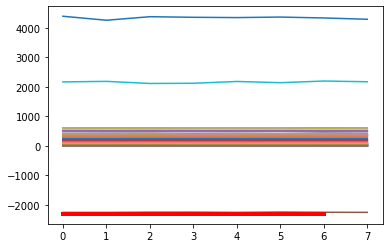

Predicción:  [[[0.9797158  0.02028424]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6496500e+01  9.6824000e+00  6.0048600e+01  7.5233000e+01
  6.0998280e+02  3.5596900e+01  1.0150200e+01  1.8593490e+02
  5.0000000e-04  6.9311800e+01  1.2455570e+02  7.8544000e+00
  6.5754900e+01  1.7451610e+02  2.1868100e+01  1.6415820e+02
  1.8455590e+02  7.0778500e+01 -6.8991000e+00  3.3104000e+00
  1.7012100e+01  6.8899000e+00  1.5995000e+00  7.2006200e+01
  1.4399000e+00  1.5033000e+00  9.1114600e+01  6.2556600e+01
  1.2890000e+00  1.2051000e+00  1.5722000e+00  1.3554000e+00
  1.5207660e+02  8.1760000e-01  8.2030000e-01 -2.2570667e+03
  2.0507250e+02  1.5947000e+00  1.3514000e+00  2.1400789e+03
  4.3347386e+03  1.8481450e+02  1.3900000e+00  1.3785000e+00
  7.9983000e+00  7.3993000e+00  1.7259000e+00  1.5360000e-01
  3.4673100e+01  5.2771330e+02  5.1925730e+02  5.1553140e+02
  5.1601250e+02  5.1621190e+02  3.3102900e+01  3.30

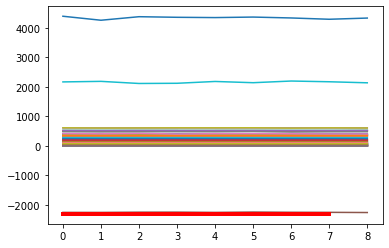

Predicción:  [[[0.98215723 0.01784272]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6520500e+01  9.6618000e+00  5.9769200e+01  7.5329400e+01
  6.0903200e+02  3.3728400e+01  1.0094700e+01  1.8598920e+02
  5.0000000e-04  7.0115700e+01  1.2521790e+02  8.0395000e+00
  6.5554700e+01  1.7372270e+02  2.2044300e+01  1.6401110e+02
  1.8441710e+02  7.0807000e+01 -6.8991000e+00  3.2470000e+00
  1.6917800e+01  6.9236000e+00  1.6019000e+00  7.2043400e+01
  1.4252000e+00  1.4882000e+00  9.1391100e+01  6.2724100e+01
  1.2801000e+00  1.1927000e+00  1.5595000e+00  1.3437000e+00
  1.5064370e+02  8.1710000e-01  8.2000000e-01 -2.2444973e+03
  2.0424460e+02  1.5789000e+00  1.3432000e+00  2.1508078e+03
  4.2889336e+03  1.8481450e+02  1.3768000e+00  1.3673000e+00
  8.0006000e+00  7.4008000e+00  1.7121000e+00  1.5270000e-01
  3.3560900e+01  5.2721780e+02  5.1941720e+02  5.1532600e+02
  5.1580250e+02  5.1606690e+02  3.3154400e+01  3.30

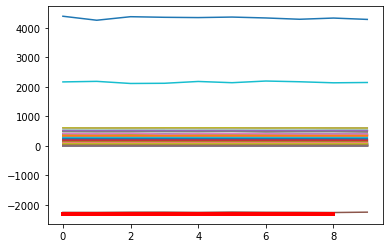

Predicción:  [[[0.9785558  0.02144416]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6240100e+01  9.8407000e+00  5.9481500e+01  7.4193000e+01
  6.0982000e+02  3.4677200e+01  1.0151600e+01  1.8604670e+02
  5.0000000e-04  7.0504700e+01  1.2485190e+02  8.1281000e+00
  6.5762500e+01  1.7444910e+02  2.1728400e+01  1.6397660e+02
  1.8449270e+02  7.0951000e+01 -6.8991000e+00  3.2617000e+00
  1.6717200e+01  6.8896000e+00  1.6008000e+00  7.1997800e+01
  1.4246000e+00  1.4893000e+00  9.0262000e+01  6.2961100e+01
  1.2829000e+00  1.1909000e+00  1.5574000e+00  1.3429000e+00
  1.5017090e+02  8.1580000e-01  8.1990000e-01 -2.1570226e+03
  2.0629240e+02  1.5792000e+00  1.3459000e+00  2.1024122e+03
  4.1862175e+03  1.8481450e+02  1.3734000e+00  1.3666000e+00
  8.0001000e+00  7.4004000e+00  1.7106000e+00  1.5340000e-01
  3.0403800e+01  5.2638440e+02  5.1903570e+02  5.1508630e+02
  5.1548590e+02  5.1578940e+02  3.2628100e+01  3.31

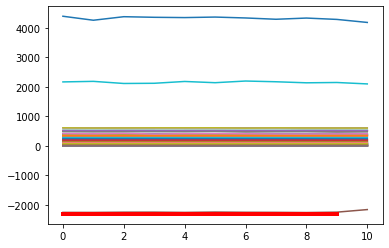

Predicción:  [[[0.95306593 0.0469341 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6029800e+01  9.8573000e+00  5.9264000e+01  7.3837500e+01
  6.1017480e+02  3.4825400e+01  1.0164800e+01  1.8600500e+02
  5.0000000e-04  7.0467000e+01  1.2535720e+02  8.1755000e+00
  6.5910300e+01  1.7544110e+02  2.1480200e+01  1.6392900e+02
  1.8457620e+02  7.0715300e+01 -6.8991000e+00  3.3004000e+00
  1.7503900e+01  6.9065000e+00  1.6022000e+00  7.2023400e+01
  1.4247000e+00  1.4864000e+00  9.0820900e+01  6.2967600e+01
  1.2852000e+00  1.1893000e+00  1.5541000e+00  1.3395000e+00
  1.5107600e+02  8.1570000e-01  8.2010000e-01 -2.1490507e+03
  2.0460150e+02  1.5774000e+00  1.3489000e+00  2.1171174e+03
  4.1432209e+03  1.8481450e+02  1.3704000e+00  1.3619000e+00
  7.9983000e+00  7.4016000e+00  1.7098000e+00  1.5510000e-01
  3.1092600e+01  5.2671780e+02  5.1915250e+02  5.1517620e+02
  5.1561180e+02  5.1588410e+02  3.2059800e+01  3.30

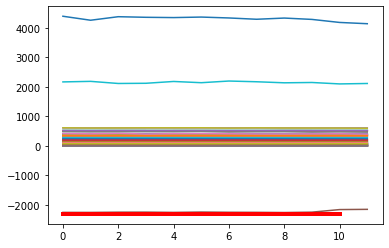

Predicción:  [[[0.9460487  0.05395126]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5892800e+01  9.8630000e+00  5.9386800e+01  7.3494600e+01
  6.0981200e+02  3.5227300e+01  1.0192500e+01  1.8592620e+02
  5.0000000e-04  6.9923400e+01  1.2496550e+02  8.0029000e+00
  6.5135300e+01  1.7528290e+02  2.1315800e+01  1.6418280e+02
  1.8460200e+02  7.0837000e+01 -6.8991000e+00  3.3126000e+00
  1.7889900e+01  6.8878000e+00  1.6004000e+00  7.1864700e+01
  1.4200000e+00  1.4850000e+00  8.8884600e+01  6.2929900e+01
  1.2808000e+00  1.1840000e+00  1.5479000e+00  1.3337000e+00
  1.4904610e+02  8.1460000e-01  8.1980000e-01 -2.1490165e+03
  2.0484840e+02  1.5736000e+00  1.3437000e+00  2.1374665e+03
  4.2132254e+03  1.8481450e+02  1.3684000e+00  1.3604000e+00
  7.9997000e+00  7.3984000e+00  1.7056000e+00  1.5780000e-01
  3.4451700e+01  5.2633340e+02  5.1882470e+02  5.1477460e+02
  5.1511600e+02  5.1545430e+02  3.1985500e+01  3.28

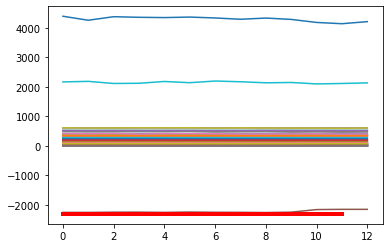

Predicción:  [[[0.9529816  0.04701846]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5542200e+01  9.8992000e+00  5.9446500e+01  7.4149600e+01
  6.1037870e+02  3.4656900e+01  1.0202900e+01  1.8595770e+02
  5.0000000e-04  6.9081500e+01  1.2503670e+02  7.8520000e+00
  6.5506600e+01  1.7365500e+02  2.1362300e+01  1.6393830e+02
  1.8471870e+02  7.0639000e+01 -6.8991000e+00  3.2973000e+00
  1.8692000e+01  6.9052000e+00  1.5974000e+00  7.1817200e+01
  1.4296000e+00  1.4927000e+00  8.9621800e+01  6.2593900e+01
  1.2879000e+00  1.1925000e+00  1.5579000e+00  1.3406000e+00
  1.4933380e+02  8.1720000e-01  8.2030000e-01 -2.1534044e+03
  2.0449600e+02  1.5817000e+00  1.3508000e+00  2.1243188e+03
  4.1836011e+03  1.8481450e+02  1.3710000e+00  1.3602000e+00
  7.9984000e+00  7.3979000e+00  1.7151000e+00  1.5690000e-01
  3.0915800e+01  5.2628220e+02  5.1857570e+02  5.1472560e+02
  5.1518360e+02  5.1547480e+02  3.2155300e+01  3.30

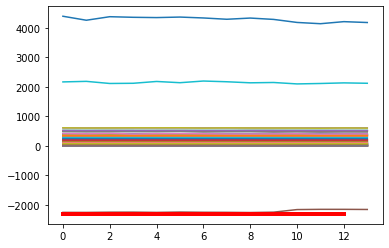

Predicción:  [[[0.9514848  0.04851517]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5321300e+01  9.8029000e+00  5.9195700e+01  7.5521500e+01
  6.0959540e+02  3.2579800e+01  1.0170300e+01  1.8598150e+02
  5.0000000e-04  6.7224900e+01  1.2482320e+02  7.8165000e+00
  6.6061700e+01  1.6885240e+02  2.1369100e+01  1.6381190e+02
  1.8456320e+02  7.0627600e+01 -6.8991000e+00  3.2967000e+00
  1.6514400e+01  6.9036000e+00  1.6012000e+00  7.1762700e+01
  1.4253000e+00  1.4880000e+00  9.1140700e+01  6.2416000e+01
  1.2827000e+00  1.1895000e+00  1.5622000e+00  1.3414000e+00
  1.5268390e+02  8.1480000e-01  8.2070000e-01 -2.1395433e+03
  2.0566540e+02  1.5788000e+00  1.3451000e+00  2.1747369e+03
  4.2957656e+03  1.8481450e+02  1.3741000e+00  1.3664000e+00
  8.0013000e+00  7.3978000e+00  1.7107000e+00  1.4820000e-01
  3.2642000e+01  5.2696660e+02  5.1922340e+02  5.1526450e+02
  5.1558310e+02  5.1594630e+02  3.1962200e+01  3.29

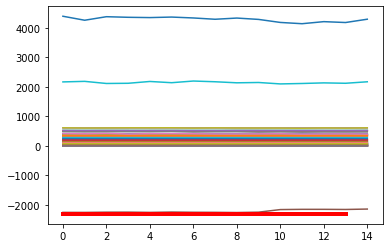

Predicción:  [[[0.9573264  0.04267357]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4616700e+01  9.9375000e+00  5.9702000e+01  7.2735500e+01
  6.1035700e+02  3.2861600e+01  1.0246300e+01  1.8605370e+02
  5.0000000e-04  6.6976300e+01  1.2483700e+02  7.8744000e+00
  6.6078800e+01  1.6978320e+02  2.1066100e+01  1.6406430e+02
  1.8478150e+02  7.0897400e+01 -6.8991000e+00  3.3042000e+00
  1.7679800e+01  6.8683000e+00  1.6015000e+00  7.1788500e+01
  1.4169000e+00  1.4824000e+00  8.9849100e+01  6.1149500e+01
  1.2771000e+00  1.1760000e+00  1.5557000e+00  1.3333000e+00
  1.5388990e+02  8.1360000e-01  8.1990000e-01 -2.1489435e+03
  2.0592440e+02  1.5725000e+00  1.3382000e+00  2.1572808e+03
  4.2043414e+03  1.8481450e+02  1.3695000e+00  1.3622000e+00
  7.9996000e+00  7.3996000e+00  1.7060000e+00  1.5030000e-01
  3.6044300e+01  5.2633330e+02  5.1863240e+02  5.1475210e+02
  5.1503220e+02  5.1560290e+02  3.1591400e+01  3.26

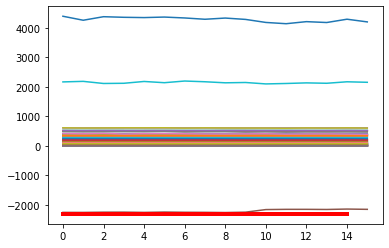

Predicción:  [[[0.95210516 0.04789488]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3882900e+01  9.9364000e+00  5.9455900e+01  7.3819500e+01
  6.1107310e+02  3.3218200e+01  1.0337800e+01  1.8599510e+02
  5.0000000e-04  6.6891800e+01  1.2507130e+02  7.9134000e+00
  6.5832000e+01  1.7080880e+02  2.0822300e+01  1.6409540e+02
  1.8495720e+02  7.0711400e+01 -6.8991000e+00  3.4213000e+00
  1.7594000e+01  6.9129000e+00  1.6000000e+00  7.1832100e+01
  1.4272000e+00  1.4882000e+00  9.1154900e+01  5.9877500e+01
  1.2914000e+00  1.1860000e+00  1.5594000e+00  1.3409000e+00
  1.5431760e+02  8.1600000e-01  8.1980000e-01 -2.1478008e+03
  2.0551910e+02  1.5797000e+00  1.3511000e+00  2.1365846e+03
  4.1338531e+03  1.8481450e+02  1.3759000e+00  1.3663000e+00
  8.0009000e+00  7.4003000e+00  1.7142000e+00  1.5450000e-01
  3.4985700e+01  5.2641780e+02  5.1906840e+02  5.1493520e+02
  5.1534400e+02  5.1586660e+02  3.1519700e+01  3.24

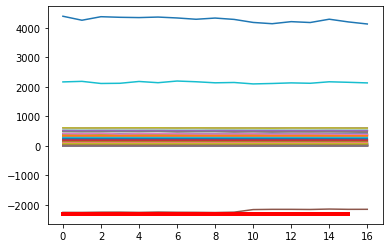

Predicción:  [[[0.94445395 0.05554603]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3804700e+01  9.9305000e+00  5.8973400e+01  7.4830600e+01
  6.1000410e+02  3.2566300e+01  1.0324900e+01  1.8600990e+02
  5.0000000e-04  6.6942700e+01  1.2525700e+02  7.8872000e+00
  6.5838500e+01  1.7030090e+02  2.0478800e+01  1.6409640e+02
  1.8491480e+02  7.0860000e+01 -6.8991000e+00  3.4079000e+00
  1.7888800e+01  6.8822000e+00  1.6002000e+00  7.1860800e+01
  1.4237000e+00  1.4834000e+00  9.2116600e+01  6.0496400e+01
  1.2870000e+00  1.1823000e+00  1.5558000e+00  1.3377000e+00
  1.5433920e+02  8.1300000e-01  8.1950000e-01 -2.1517552e+03
  2.0310660e+02  1.5748000e+00  1.3475000e+00  2.1392339e+03
  4.1512039e+03  1.8481450e+02  1.3717000e+00  1.3641000e+00
  8.0008000e+00  7.3985000e+00  1.7091000e+00  1.5300000e-01
  3.3699700e+01  5.2651560e+02  5.1891400e+02  5.1486000e+02
  5.1532400e+02  5.1582370e+02  3.1219900e+01  3.23

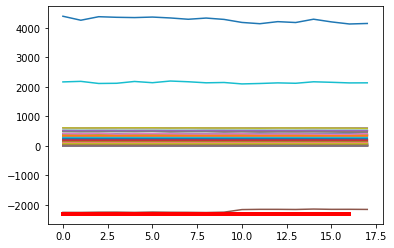

Predicción:  [[[0.94758755 0.05241239]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4670200e+01  9.8070000e+00  5.8856800e+01  7.4243000e+01
  6.1090020e+02  3.3775900e+01  1.0452700e+01  1.8605770e+02
  5.0000000e-04  6.6894600e+01  1.2503460e+02  8.1008000e+00
  6.6050300e+01  1.7118920e+02  2.0347400e+01  1.6416130e+02
  1.8480900e+02  7.0750700e+01 -6.8991000e+00  3.3798000e+00
  1.6556800e+01  6.9180000e+00  1.6010000e+00  7.1833400e+01
  1.4191000e+00  1.4819000e+00  9.1040100e+01  5.8302700e+01
  1.2830000e+00  1.1765000e+00  1.5499000e+00  1.3321000e+00
  1.5420230e+02  8.1310000e-01  8.1950000e-01 -2.1509474e+03
  2.0474650e+02  1.5738000e+00  1.3418000e+00  2.1240508e+03
  4.2108217e+03  1.8481450e+02  1.3673000e+00  1.3595000e+00
  7.9992000e+00  7.3998000e+00  1.7056000e+00  1.5590000e-01
  3.5218200e+01  5.2730110e+02  5.1967050e+02  5.1525690e+02
  5.1576390e+02  5.1642830e+02  3.0421700e+01  3.17

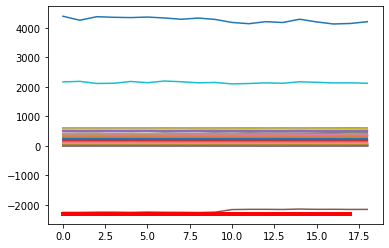

Predicción:  [[[0.9535888  0.04641127]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4879600e+01  9.8855000e+00  5.7762300e+01  7.4902300e+01
  6.0993900e+02  3.4987100e+01  1.0425000e+01  1.8600910e+02
  5.0000000e-04  6.6869900e+01  1.2485570e+02  7.7362000e+00
  6.6012300e+01  1.7185810e+02  2.0387600e+01  1.6397030e+02
  1.8509210e+02  7.0635800e+01 -6.8991000e+00  3.4034000e+00
  1.7349700e+01  6.8851000e+00  1.5990000e+00  7.1815300e+01
  1.4391000e+00  1.4990000e+00  9.2288700e+01  5.9291100e+01
  1.3006000e+00  1.1919000e+00  1.5666000e+00  1.3455000e+00
  1.5250740e+02  8.1770000e-01  8.2050000e-01 -2.1512077e+03
  2.0273200e+02  1.5901000e+00  1.3597000e+00  2.1326907e+03
  4.1311309e+03  1.8481450e+02  1.3819000e+00  1.3670000e+00
  8.0008000e+00  7.3930000e+00  1.7234000e+00  1.5650000e-01
  3.6314000e+01  5.2644890e+02  5.1903470e+02  5.1505360e+02
  5.1549800e+02  5.1610430e+02  3.1197700e+01  3.18

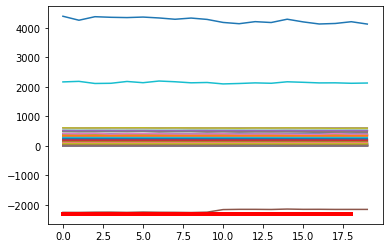

Predicción:  [[[0.94543177 0.05456822]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3984400e+01  9.8970000e+00  5.8839400e+01  7.5570500e+01
  6.1068950e+02  3.2991900e+01  1.0468400e+01  1.8606500e+02
  5.0000000e-04  6.6987200e+01  1.2469250e+02  8.0457000e+00
  6.6049000e+01  1.7066090e+02  2.0359200e+01  1.6388840e+02
  1.8515410e+02  7.0746000e+01 -6.8991000e+00  3.3939000e+00
  1.7223100e+01  6.9040000e+00  1.6006000e+00  7.1795600e+01
  1.4345000e+00  1.4955000e+00  9.1494200e+01  5.9598800e+01
  1.2959000e+00  1.1855000e+00  1.5675000e+00  1.3407000e+00
  1.5601310e+02  8.1790000e-01  8.2010000e-01 -2.1510029e+03
  2.0241030e+02  1.5878000e+00  1.3555000e+00  2.1262392e+03
  4.1733280e+03  1.8481450e+02  1.3767000e+00  1.3618000e+00
  7.9994000e+00  7.4060000e+00  1.7204000e+00  1.5290000e-01
  3.5979700e+01  5.2706670e+02  5.1940600e+02  5.1535100e+02
  5.1574940e+02  5.1630790e+02  3.1061400e+01  3.21

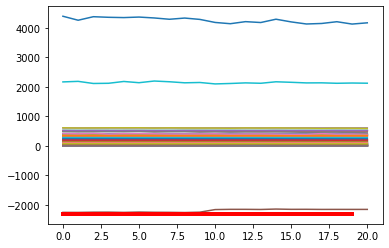

Predicción:  [[[0.94944054 0.05055952]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3474200e+01  9.8089000e+00  5.7237200e+01  7.5724400e+01
  6.1019150e+02  3.4699800e+01  1.0408800e+01  1.8596120e+02
  5.0000000e-04  6.6845200e+01  1.2494670e+02  7.8563000e+00
  6.6141600e+01  1.7232650e+02  2.0564300e+01  1.6397170e+02
  1.8492590e+02  7.0396800e+01 -6.8991000e+00  3.2995000e+00
  1.6601900e+01  6.8983000e+00  1.6013000e+00  7.1770100e+01
  1.4414000e+00  1.5024000e+00  9.2230000e+01  5.9345900e+01
  1.3029000e+00  1.1924000e+00  1.5703000e+00  1.3456000e+00
  1.5751630e+02  8.1860000e-01  8.2160000e-01 -2.1558352e+03
  2.0260740e+02  1.5943000e+00  1.3625000e+00  2.0896330e+03
  4.1985025e+03  1.8481450e+02  1.3812000e+00  1.3674000e+00
  8.0017000e+00  7.4010000e+00  1.7259000e+00  1.5550000e-01
  3.5920200e+01  5.2730000e+02  5.2021330e+02  5.1603030e+02
  5.1639590e+02  5.1696520e+02  3.0694800e+01  3.17

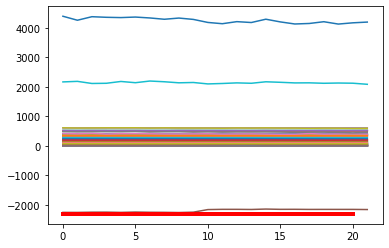

Predicción:  [[[0.9538469  0.04615316]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2839000e+01  9.9920000e+00  5.7666000e+01  7.3581800e+01
  6.0969750e+02  3.3962100e+01  1.0403600e+01  1.8595930e+02
  5.0000000e-04  6.6956700e+01  1.2535570e+02  8.1244000e+00
  6.5724400e+01  1.7150660e+02  2.0050000e+01  1.6416550e+02
  1.8497030e+02  7.0440000e+01 -6.8991000e+00  3.3080000e+00
  1.8451900e+01  6.9238000e+00  1.5997000e+00  7.1548400e+01
  1.4195000e+00  1.4792000e+00  9.0679600e+01  5.9588700e+01
  1.2840000e+00  1.1722000e+00  1.5480000e+00  1.3219000e+00
  1.5322180e+02  8.1630000e-01  8.2010000e-01 -2.1597328e+03
  2.0527180e+02  1.5704000e+00  1.3430000e+00  2.1289972e+03
  4.1064503e+03  1.8481450e+02  1.3530000e+00  1.3454000e+00
  7.9992000e+00  7.3989000e+00  1.7050000e+00  1.5680000e-01
  3.1447500e+01  5.2528440e+02  5.1861840e+02  5.1423780e+02
  5.1466050e+02  5.1519850e+02  3.0431900e+01  3.14

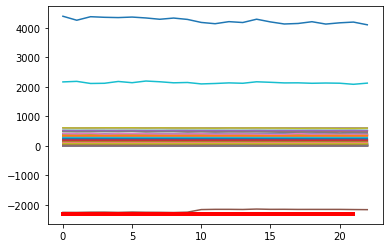

Predicción:  [[[0.94575965 0.05424041]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3245800e+01  9.8938000e+00  5.8009400e+01  7.4240900e+01
  6.0926620e+02  3.3098000e+01  1.0577200e+01  1.8589200e+02
  5.0000000e-04  6.7366600e+01  1.2469300e+02  8.0398000e+00
  6.6191400e+01  1.7009100e+02  2.0125100e+01  1.6374270e+02
  1.8534150e+02  6.9903100e+01 -6.8991000e+00  3.5919000e+00
  1.9216000e+01  6.8916000e+00  1.5992000e+00  7.1344200e+01
  1.4457000e+00  1.5061000e+00  9.1678500e+01  5.8803500e+01
  1.3107000e+00  1.1957000e+00  1.5728000e+00  1.3489000e+00
  1.5359390e+02  8.1610000e-01  8.2010000e-01 -2.1449170e+03
  2.0048420e+02  1.5982000e+00  1.3693000e+00  2.1723579e+03
  4.1568028e+03  1.8481450e+02  1.3805000e+00  1.3723000e+00
  8.0002000e+00  7.3997000e+00  1.7313000e+00  1.5850000e-01
  3.1552100e+01  5.2596440e+02  5.1796800e+02  5.1428030e+02
  5.1474250e+02  5.1523620e+02  3.0391900e+01  3.14

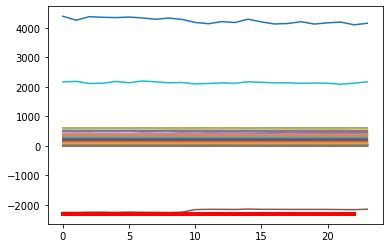

Predicción:  [[[0.9453835  0.05461654]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3444000e+01  9.8036000e+00  5.6965100e+01  7.5335900e+01
  6.1084090e+02  3.3707200e+01  1.0557300e+01  1.8504550e+02
  5.0000000e-04  6.7125800e+01  1.2500200e+02  7.8861000e+00
  6.7124300e+01  1.7199170e+02  2.0509800e+01  1.6390640e+02
  1.8441710e+02  6.9823400e+01 -6.8991000e+00  3.5953000e+00
  1.7894900e+01  6.8994000e+00  1.6017000e+00  7.1136200e+01
  1.4356000e+00  1.4971000e+00  9.1573900e+01  5.7742800e+01
  1.2985000e+00  1.1910000e+00  1.5609000e+00  1.3484000e+00
  1.5755350e+02  8.1670000e-01  8.2040000e-01 -2.1471717e+03
  2.0007890e+02  1.5890000e+00  1.3561000e+00  2.1442200e+03
  4.1708106e+03  1.8481450e+02  1.3805000e+00  1.3722000e+00
  7.9988000e+00  7.4022000e+00  1.7180000e+00  1.5760000e-01
  3.2064900e+01  5.2750220e+02  5.2047300e+02  5.1626000e+02
  5.1675230e+02  5.1722670e+02  3.0388100e+01  3.15

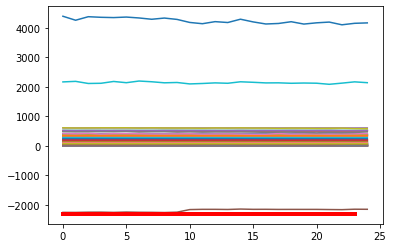

Predicción:  [[[0.9484064  0.05159362]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4432700e+01  9.7121000e+00  5.9886700e+01  7.5063300e+01
  6.0991520e+02  3.4280700e+01  1.0673500e+01  1.8492450e+02
  5.0000000e-04  6.6896700e+01  1.2490590e+02  7.8278000e+00
  6.6848600e+01  1.7111240e+02  2.0179400e+01  1.6474770e+02
  1.8439290e+02  6.9792700e+01 -6.8991000e+00  3.6793000e+00
  1.5978300e+01  6.9165000e+00  1.5977000e+00  7.0909500e+01
  1.4449000e+00  1.5030000e+00  9.1870300e+01  5.6116500e+01
  1.3071000e+00  1.2067000e+00  1.5739000e+00  1.3564000e+00
  1.5407090e+02  8.1790000e-01  8.2170000e-01 -2.2024532e+03
  1.9912310e+02  1.5934000e+00  1.3626000e+00  2.1178795e+03
  4.2632812e+03  1.8481450e+02  1.3890000e+00  1.3804000e+00
  7.9993000e+00  7.3908000e+00  1.7298000e+00  1.5550000e-01
  3.2806600e+01  5.2657390e+02  5.1933300e+02  5.1494090e+02
  5.1560110e+02  5.1603580e+02  3.1350600e+01  3.18

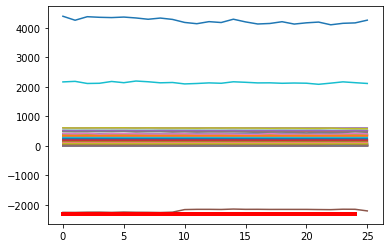

Predicción:  [[[0.97012055 0.02987942]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4192200e+01  9.7260000e+00  5.5717000e+01  7.4174400e+01
  6.0983560e+02  3.5523400e+01  1.0695800e+01  1.8509600e+02
  5.0000000e-04  6.6737600e+01  1.2496500e+02  7.8816000e+00
  6.5162600e+01  1.7206380e+02  2.0018700e+01  1.6385680e+02
  1.8464110e+02  6.9367700e+01 -6.8991000e+00  3.6991000e+00
  1.7138800e+01  6.8980000e+00  1.5998000e+00  7.0943000e+01
  1.4718000e+00  1.5308000e+00  9.0390700e+01  5.5591700e+01
  1.3349000e+00  1.2310000e+00  1.6001000e+00  1.3827000e+00
  1.5231360e+02  8.1850000e-01  8.2110000e-01 -2.1554776e+03
  1.9766250e+02  1.6224000e+00  1.3908000e+00  2.1791188e+03
  4.1549672e+03  1.8481450e+02  1.4133000e+00  1.4061000e+00
  8.0034000e+00  7.4095000e+00  1.7581000e+00  1.5800000e-01
  3.0857800e+01  5.2645940e+02  5.1913100e+02  5.1496210e+02
  5.1554130e+02  5.1597780e+02  3.0654000e+01  3.15

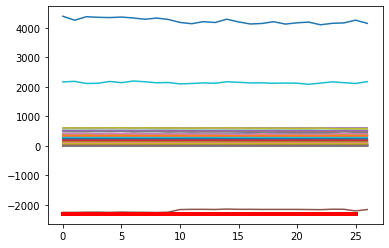

Predicción:  [[[0.94908756 0.05091247]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4019400e+01  9.6803000e+00  5.6200400e+01  7.5766600e+01
  6.0997150e+02  3.3395200e+01  1.0668200e+01  1.8502250e+02
  5.0000000e-04  6.6874800e+01  1.2527950e+02  8.2122000e+00
  6.5587600e+01  1.7049910e+02  2.0980500e+01  1.6424300e+02
  1.8446610e+02  6.9559500e+01 -6.8991000e+00  3.6999000e+00
  1.5946000e+01  6.9118000e+00  1.5997000e+00  7.0984400e+01
  1.4492000e+00  1.5092000e+00  9.1544000e+01  5.6363500e+01
  1.3153000e+00  1.2062000e+00  1.5813000e+00  1.3626000e+00
  1.5617520e+02  8.2870000e-01  8.3110000e-01 -2.1481184e+03
  1.9629650e+02  1.6004000e+00  1.3715000e+00  2.1769981e+03
  4.2028325e+03  1.8481450e+02  1.3925000e+00  1.3864000e+00
  7.9973000e+00  7.4005000e+00  1.7369000e+00  1.5550000e-01
  2.9871400e+01  5.2661560e+02  5.1933020e+02  5.1522640e+02
  5.1582580e+02  5.1619410e+02  3.2352100e+01  3.15

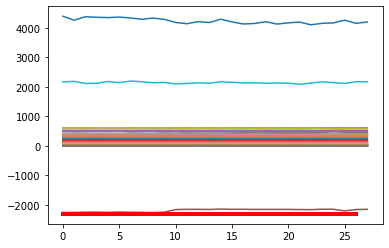

Predicción:  [[[0.95142096 0.04857903]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3723200e+01  9.6618000e+00  5.7333800e+01  7.5604100e+01
  6.0961040e+02  3.2643800e+01  1.0687700e+01  1.8506810e+02
  5.0000000e-04  6.6869900e+01  1.2580290e+02  8.1607000e+00
  6.6026200e+01  1.6938110e+02  2.1594900e+01  1.6407260e+02
  1.8448530e+02  6.9646600e+01 -6.8991000e+00  3.7941000e+00
  1.6256200e+01  6.8967000e+00  1.6004000e+00  7.1000400e+01
  1.4400000e+00  1.5031000e+00  9.0912300e+01  5.6158000e+01
  1.3056000e+00  1.1968000e+00  1.5756000e+00  1.3511000e+00
  1.5661170e+02  8.2480000e-01  8.3020000e-01 -2.1497235e+03
  1.9842830e+02  1.5948000e+00  1.3618000e+00  2.1899471e+03
  4.1855597e+03  1.8481450e+02  1.3801000e+00  1.3772000e+00
  7.9984000e+00  7.4005000e+00  1.7291000e+00  1.5360000e-01
  2.9304200e+01  5.2618220e+02  5.1881350e+02  5.1482660e+02
  5.1542540e+02  5.1583020e+02  3.3170000e+01  3.19

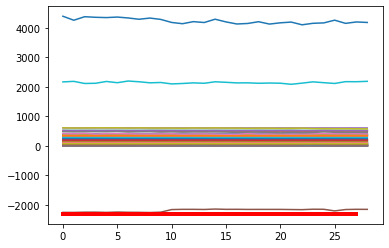

Predicción:  [[[0.9501816  0.04981844]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3585600e+01  9.3668000e+00  5.4998400e+01  7.4711200e+01
  6.0958370e+02  3.2959600e+01  1.0722500e+01  1.8502220e+02
  5.0000000e-04  6.7509100e+01  1.2808430e+02  8.5832000e+00
  6.5950200e+01  1.7042030e+02  2.1205200e+01  1.6405970e+02
  1.8420300e+02  6.9876500e+01 -6.8991000e+00  3.7934000e+00
  1.5953800e+01  6.8734000e+00  1.6043000e+00  7.0973100e+01
  1.4472000e+00  1.5103000e+00  9.1536800e+01  5.5642200e+01
  1.3119000e+00  1.2020000e+00  1.5800000e+00  1.3608000e+00
  1.5740360e+02  8.2330000e-01  8.3040000e-01 -2.1468242e+03
  1.9911140e+02  1.6020000e+00  1.3673000e+00  2.1440298e+03
  4.2008216e+03  1.8481450e+02  1.3920000e+00  1.3914000e+00
  8.0040000e+00  7.3971000e+00  1.7355000e+00  1.5560000e-01
  3.0709400e+01  5.2776300e+02  5.2024190e+02  5.1606220e+02
  5.1655830e+02  5.1702660e+02  3.2346500e+01  3.16

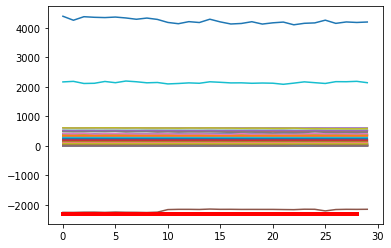

Predicción:  [[[0.9510333  0.04896672]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3690600e+01  9.4200000e+00  5.3549600e+01  7.5074800e+01
  6.1062290e+02  3.1863600e+01  1.0798300e+01  1.8496800e+02
  5.0000000e-04  6.7734200e+01  1.2834840e+02  8.9340000e+00
  6.5945400e+01  1.6937930e+02  2.1163100e+01  1.6390920e+02
  1.8410540e+02  6.9809400e+01 -6.8991000e+00  3.7938000e+00
  1.5594100e+01  6.9237000e+00  1.6000000e+00  7.0964000e+01
  1.4510000e+00  1.5125000e+00  9.0782600e+01  5.5850800e+01
  1.3166000e+00  1.2024000e+00  1.5831000e+00  1.3585000e+00
  1.5819500e+02  8.2310000e-01  8.2980000e-01 -2.1508924e+03
  1.9727580e+02  1.6041000e+00  1.3727000e+00  2.1754291e+03
  4.1412338e+03  1.8481450e+02  1.3908000e+00  1.3881000e+00
  8.0005000e+00  7.3986000e+00  1.7392000e+00  1.5640000e-01
  3.2543000e+01  5.2697040e+02  5.1967440e+02  5.1543510e+02
  5.1591010e+02  5.1625170e+02  3.2005400e+01  3.12

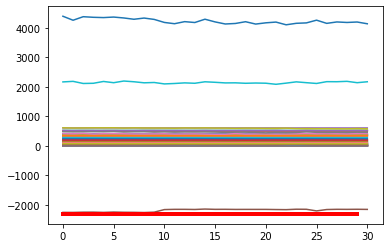

Predicción:  [[[0.94628817 0.05371188]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3761200e+01  9.4573000e+00  5.3949300e+01  7.6759600e+01
  6.1081310e+02  3.2223900e+01  1.0843200e+01  1.8504790e+02
  5.0000000e-04  6.7791400e+01  1.2810150e+02  9.0074000e+00
  6.5867800e+01  1.6947490e+02  2.0659100e+01  1.6426230e+02
  1.8424890e+02  6.9513100e+01 -6.8991000e+00  3.7859000e+00
  1.5236000e+01  6.8909000e+00  1.6015000e+00  7.1030500e+01
  1.4521000e+00  1.5121000e+00  9.2383600e+01  5.5106800e+01
  1.3190000e+00  1.2019000e+00  1.5818000e+00  1.3608000e+00
  1.5840170e+02  8.2290000e-01  8.2970000e-01 -2.1524130e+03
  1.9935570e+02  1.6046000e+00  1.3744000e+00  2.1843426e+03
  4.1066397e+03  1.8481450e+02  1.3960000e+00  1.3904000e+00
  7.9967000e+00  7.4009000e+00  1.7406000e+00  1.5870000e-01
  3.4903700e+01  5.2695940e+02  5.1948320e+02  5.1554200e+02
  5.1591580e+02  5.1632640e+02  3.1781900e+01  3.10

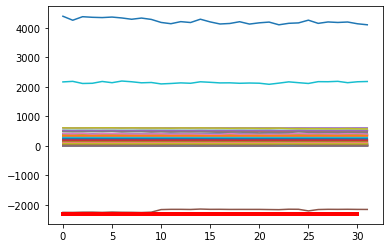

Predicción:  [[[0.9432473  0.05675263]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3834400e+01  1.0154000e+01  5.3175200e+01  7.7723900e+01
  6.1033060e+02  3.2745000e+01  1.0788500e+01  1.8502940e+02
  5.0000000e-04  6.7810700e+01  1.2788900e+02  9.5896000e+00
  6.5764300e+01  1.6962520e+02  2.0552400e+01  1.6417570e+02
  1.8491330e+02  6.9751100e+01 -6.8991000e+00  3.7116000e+00
  1.4940200e+01  6.8877000e+00  1.5993000e+00  7.0999400e+01
  1.4551000e+00  1.5186000e+00  9.0652500e+01  5.6225500e+01
  1.3210000e+00  1.2019000e+00  1.5835000e+00  1.3615000e+00
  1.5935350e+02  8.2420000e-01  8.2970000e-01 -2.1481809e+03
  1.9787550e+02  1.6106000e+00  1.3769000e+00  2.1795361e+03
  4.1986161e+03  1.8481450e+02  1.3971000e+00  1.3906000e+00
  8.0011000e+00  7.4018000e+00  1.7425000e+00  1.5910000e-01
  3.5720800e+01  5.2710610e+02  5.1943320e+02  5.1564820e+02
  5.1592420e+02  5.1644540e+02  3.1173400e+01  3.06

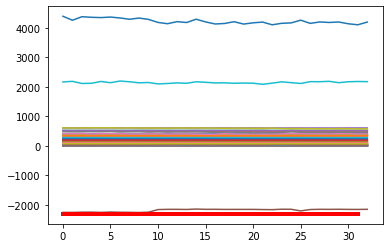

Predicción:  [[[0.9510373  0.04896277]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4592300e+01  1.0331700e+01  5.1424100e+01  7.8118000e+01
  6.0997670e+02  3.4028500e+01  1.0631700e+01  1.8503230e+02
  5.0000000e-04  6.7439200e+01  1.2785510e+02  1.1352800e+01
  6.6248900e+01  1.7285650e+02  2.0924200e+01  1.6422830e+02
  1.8495200e+02  6.9497200e+01 -6.8991000e+00  3.6144000e+00
  1.5718000e+01  6.9208000e+00  1.5986000e+00  7.1028300e+01
  1.4545000e+00  1.5160000e+00  9.0524000e+01  5.6090100e+01
  1.3232000e+00  1.2020000e+00  1.5755000e+00  1.3634000e+00
  1.5998590e+02  8.2460000e-01  8.2950000e-01 -2.1462220e+03
  1.9800500e+02  1.6052000e+00  1.3794000e+00  2.1352584e+03
  4.1526499e+03  1.8481450e+02  1.3972000e+00  1.3894000e+00
  8.0003000e+00  7.4019000e+00  1.7406000e+00  1.6490000e-01
  3.3756300e+01  5.2698780e+02  5.1994770e+02  5.1576870e+02
  5.1601060e+02  5.1665140e+02  3.0816800e+01  3.03

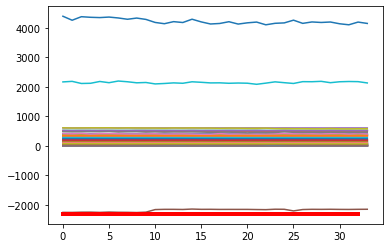

Predicción:  [[[0.9463126 0.0536874]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  34  - Datos Recibidos:  [ 4.4214500e+01  1.0443800e+01  5.0987200e+01  7.7014500e+01
  6.0981900e+02  3.3998300e+01  1.0609400e+01  1.8499610e+02
  5.0000000e-04  6.6998800e+01  1.2860420e+02  1.1740200e+01
  6.5935200e+01  1.7186540e+02  2.0984000e+01  1.6408700e+02
  1.8493080e+02  6.9650200e+01 -6.8991000e+00  3.6038000e+00
  1.6536700e+01  6.8898000e+00  1.6004000e+00  7.1019900e+01
  1.4400000e+00  1.5005000e+00  8.9213800e+01  5.6698000e+01
  1.3064000e+00  1.1909000e+00  1.5633000e+00  1.3523000e+00
  1.5802690e+02  8.2620000e-01  8.2980000e-01 -2.1444511e+03
  1.9821780e+02  1.5900000e+00  1.3630000e+00  2.1859627e+03
  4.2013902e+03  1.8481450e+02  1.3860000e+00  1.3780000e+00
  7.9992000e+00  7.3998000e+00  1.7265000e+00  1.6330000e-01
  3.3032100e+01  5.2656770e+02  5.1862040e+02  5.1478510e+02
  5.1506290e+02  5.1578010e+02  3.1195200e+

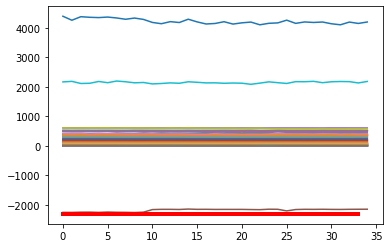

Predicción:  [[[0.9505159  0.04948404]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5044500e+01  1.0285500e+01  5.1602100e+01  7.6530900e+01
  6.1048260e+02  3.5319100e+01  1.0774800e+01  1.8509660e+02
  5.0000000e-04  6.6621700e+01  1.2790350e+02  1.2004100e+01
  6.5712700e+01  1.7248880e+02  2.1229600e+01  1.6407480e+02
  1.8498760e+02  6.9494700e+01 -6.8991000e+00  3.5921000e+00
  1.5059300e+01  6.8894000e+00  1.5334000e+00  7.1003500e+01
  1.4480000e+00  1.5098000e+00  9.0345300e+01  5.5842100e+01
  1.3153000e+00  1.1991000e+00  1.5731000e+00  1.3588000e+00
  1.5828900e+02  8.2720000e-01  8.3040000e-01 -2.1452037e+03
  1.9780020e+02  1.5991000e+00  1.3713000e+00  2.1318314e+03
  4.1630034e+03  1.8481450e+02  1.3936000e+00  1.3839000e+00
  8.0031000e+00  7.3994000e+00  1.7338000e+00  1.6060000e-01
  3.4893600e+01  5.2754670e+02  5.1939750e+02  5.1569300e+02
  5.1597760e+02  5.1669660e+02  3.0941400e+01  3.03

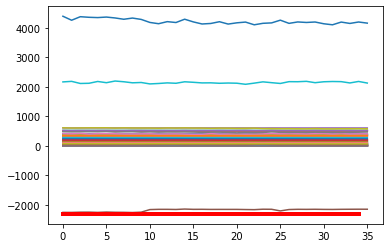

Predicción:  [[[0.9473318  0.05266818]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4028400e+01  1.0357900e+01  5.0616100e+01  7.6542000e+01
  6.1049820e+02  3.6028900e+01  1.0881100e+01  1.8504190e+02
  5.0000000e-04  6.7415800e+01  1.2808490e+02  1.2164900e+01
  6.5669400e+01  1.7492030e+02  2.1683200e+01  1.6366950e+02
  1.8491230e+02  6.9769200e+01 -6.8991000e+00  3.6015000e+00
  1.5705800e+01  6.8858000e+00  1.4993000e+00  7.0997700e+01
  1.4458000e+00  1.5077000e+00  9.2113600e+01  5.7057300e+01
  1.3128000e+00  1.1976000e+00  1.5673000e+00  1.3575000e+00
  1.5832190e+02  8.2040000e-01  8.2240000e-01 -2.1317760e+03
  2.0008760e+02  1.5984000e+00  1.3697000e+00  2.1332632e+03
  4.2164976e+03  1.8481450e+02  1.3912000e+00  1.3838000e+00
  7.9990000e+00  7.4019000e+00  1.7324000e+00  1.6520000e-01
  3.3260500e+01  5.2763560e+02  5.1974200e+02  5.1593260e+02
  5.1623600e+02  5.1699690e+02  3.1369100e+01  3.04

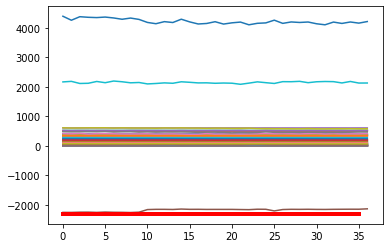

Predicción:  [[[0.94811547 0.05188453]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4083100e+01  1.0251800e+01  5.0882100e+01  7.5953700e+01
  6.1113110e+02  3.6370400e+01  1.0905200e+01  1.8444410e+02
  5.0000000e-04  6.7223100e+01  1.2813540e+02  1.1943000e+01
  6.5732200e+01  1.7481450e+02  2.2003200e+01  1.6383190e+02
  1.8421620e+02  6.9733000e+01 -6.8991000e+00  3.5998000e+00
  1.6302600e+01  6.9172000e+00  1.4981000e+00  7.0976400e+01
  1.4357000e+00  1.4966000e+00  9.0281300e+01  5.6528600e+01
  1.3092000e+00  1.1890000e+00  1.5555000e+00  1.3450000e+00
  1.5628070e+02  8.1860000e-01  8.2090000e-01 -2.1060998e+03
  1.9873560e+02  1.5863000e+00  1.3656000e+00  2.1099277e+03
  4.0219098e+03  1.8481450e+02  1.3783000e+00  1.3704000e+00
  8.0015000e+00  7.3992000e+00  1.7209000e+00  1.6500000e-01
  3.3477700e+01  5.2704780e+02  5.1940140e+02  5.1539380e+02
  5.1576280e+02  5.1649300e+02  3.2028800e+01  3.08

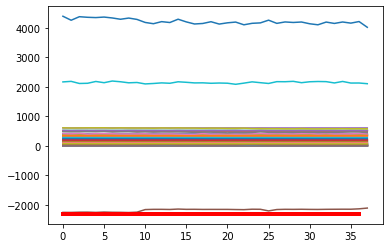

Predicción:  [[[0.91052127 0.08947872]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4323800e+01  1.0613100e+01  5.0646800e+01  7.5990500e+01
  6.0974580e+02  3.6558800e+01  1.0833200e+01  1.8399330e+02
  5.0000000e-04  6.7191400e+01  1.2789850e+02  1.1787200e+01
  6.5734500e+01  1.7548610e+02  2.2410100e+01  1.6391340e+02
  1.8404210e+02  6.9609400e+01 -6.8991000e+00  3.5534000e+00
  1.5594500e+01  6.8996000e+00  1.5015000e+00  7.1024700e+01
  1.4483000e+00  1.5102000e+00  9.1753000e+01  5.6573600e+01
  1.3208000e+00  1.2066000e+00  1.5692000e+00  1.3617000e+00
  1.5519940e+02  8.2720000e-01  8.2950000e-01 -2.0997972e+03
  1.9874960e+02  1.6013000e+00  1.3771000e+00  2.1851624e+03
  4.0596630e+03  1.8481450e+02  1.3914000e+00  1.3872000e+00
  7.9961000e+00  7.3985000e+00  1.7353000e+00  1.6590000e-01
  2.9799600e+01  5.2744060e+02  5.2015560e+02  5.1611900e+02
  5.1646460e+02  5.1712590e+02  3.2563400e+01  3.11

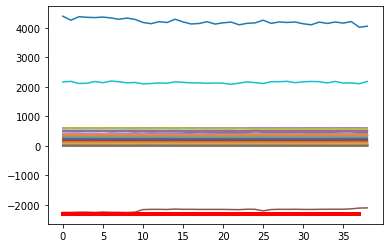

Predicción:  [[[0.9130386  0.08696134]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4305400e+01  1.0582600e+01  5.0547700e+01  7.5625000e+01
  6.1063860e+02  3.6143600e+01  1.0791300e+01  1.8400360e+02
  5.0000000e-04  6.7286300e+01  1.2827760e+02  1.1896600e+01
  6.4800600e+01  1.7533910e+02  2.2177500e+01  1.6419640e+02
  1.8387580e+02  6.9653400e+01 -6.8991000e+00  3.5136000e+00
  1.5997400e+01  6.8860000e+00  1.5001000e+00  7.0947600e+01
  1.4418000e+00  1.5006000e+00  9.1360900e+01  5.6629200e+01
  1.3126000e+00  1.1999000e+00  1.5625000e+00  1.3527000e+00
  1.5447040e+02  8.2780000e-01  8.3030000e-01 -2.0965569e+03
  2.0046600e+02  1.5930000e+00  1.3690000e+00  2.1327377e+03
  4.0305433e+03  1.8481450e+02  1.3820000e+00  1.3776000e+00
  8.0037000e+00  7.3977000e+00  1.7272000e+00  1.6510000e-01
  2.9367300e+01  5.2716890e+02  5.1982650e+02  5.1560900e+02
  5.1607950e+02  5.1657970e+02  3.2463000e+01  3.12

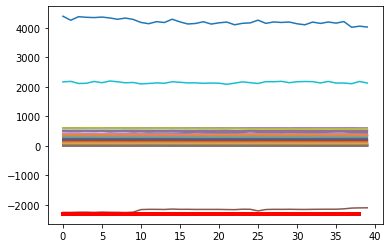

Predicción:  [[[0.9064574  0.09354255]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3979500e+01  1.0554400e+01  5.0071200e+01  7.4963300e+01
  6.1056040e+02  3.5984800e+01  1.0815200e+01  1.8386230e+02
  5.0000000e-04  6.7338500e+01  1.2839250e+02  1.2053400e+01
  6.4688000e+01  1.7470140e+02  2.2110500e+01  1.6607770e+02
  1.8381390e+02  7.0074700e+01 -6.8991000e+00  3.4922000e+00
  1.6638600e+01  6.8875000e+00  1.5006000e+00  7.1230400e+01
  1.4384000e+00  1.5000000e+00  9.2969700e+01  5.7388200e+01
  1.3100000e+00  1.1980000e+00  1.5609000e+00  1.3535000e+00
  1.5358150e+02  8.2750000e-01  8.3010000e-01 -2.0939857e+03
  2.0017380e+02  1.5911000e+00  1.3672000e+00  2.1257287e+03
  4.1238603e+03  1.8481450e+02  1.3837000e+00  1.3795000e+00
  7.9975000e+00  7.3991000e+00  1.7252000e+00  1.6410000e-01
  2.9893200e+01  5.2660000e+02  5.1942770e+02  5.1541860e+02
  5.1599800e+02  5.1640930e+02  3.2362000e+01  3.12

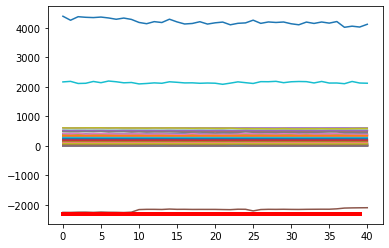

Predicción:  [[[0.92045623 0.07954381]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4109600e+01  1.0533500e+01  5.0200800e+01  7.5804900e+01
  6.0997080e+02  3.5995200e+01  1.0840200e+01  1.8409450e+02
  5.0000000e-04  6.7730700e+01  1.2851630e+02  1.2161800e+01
  6.4404200e+01  1.7500970e+02  2.2150600e+01  1.6607180e+02
  1.8370950e+02  7.0041300e+01 -6.8991000e+00  3.4916000e+00
  1.5530500e+01  6.9181000e+00  1.5013000e+00  7.1508800e+01
  1.4446000e+00  1.5022000e+00  9.3354400e+01  5.7459900e+01
  1.3189000e+00  1.2047000e+00  1.5653000e+00  1.3593000e+00
  1.5377630e+02  8.2740000e-01  8.3010000e-01 -2.1074279e+03
  2.0320930e+02  1.5947000e+00  1.3763000e+00  2.0901334e+03
  4.0956765e+03  1.8481450e+02  1.3878000e+00  1.3864000e+00
  8.0004000e+00  7.3992000e+00  1.7308000e+00  1.6560000e-01
  2.8446400e+01  5.2629650e+02  5.1976520e+02  5.1552590e+02
  5.1612640e+02  5.1654580e+02  3.2126300e+01  3.12

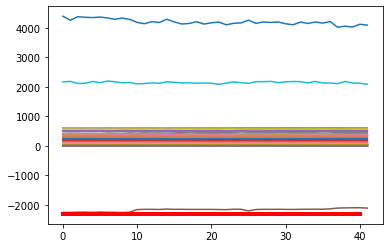

Predicción:  [[[0.923128 0.076872]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5198900e+01  1.0523600e+01  5.3467800e+01  7.5527000e+01
  6.1023490e+02  3.4473800e+01  1.1214100e+01  1.8397330e+02
  5.0000000e-04  6.9430900e+01  1.2808740e+02  1.1941800e+01
  6.4299100e+01  1.7367490e+02  2.1406100e+01  1.6590290e+02
  1.8351330e+02  7.0518400e+01 -6.8991000e+00  3.5056000e+00
  1.4046300e+01  6.8866000e+00  1.5008000e+00  7.1516400e+01
  1.4291000e+00  1.4912000e+00  9.1121000e+01  5.7539200e+01
  1.3003000e+00  1.1896000e+00  1.5553000e+00  1.3414000e+00
  1.5220130e+02  8.2550000e-01  8.2940000e-01 -2.0911437e+03
  2.0264590e+02  1.5830000e+00  1.3576000e+00  2.0861328e+03
  4.0458608e+03  1.8481450e+02  1.3706000e+00  1.3699000e+00
  7.9966000e+00  7.3825000e+00  1.7189000e+00  1.6370000e-01
  2.9405200e+01  5.2650460e+02  5.1990860e+02  5.1560990e+02
  5.1622860e+02  5.1657130e+02  3.0968500e+01  3.076860

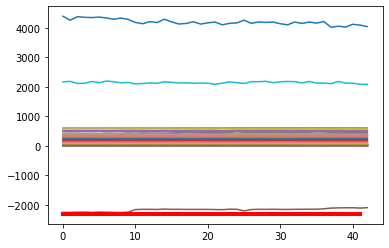

Predicción:  [[[0.90612686 0.09387312]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8334100e+01  1.0132800e+01  4.3167200e+01  7.4603700e+01
  6.0977870e+02  3.3923300e+01  1.1565300e+01  1.8398940e+02
  5.0000000e-04  7.4423700e+01  1.2924430e+02  1.2153400e+01
  6.1221800e+01  1.7281880e+02  2.0003400e+01  1.6625960e+02
  1.8389870e+02  6.9895100e+01 -6.8991000e+00  3.5419000e+00
  1.4332300e+01  6.9023000e+00  1.5004000e+00  7.1458400e+01
  1.4425000e+00  1.5032000e+00  9.1858700e+01  5.7484200e+01
  1.3120000e+00  1.1904000e+00  1.5711000e+00  1.3380000e+00
  1.4519280e+02  8.2600000e-01  8.2980000e-01 -2.0715678e+03
  2.0159050e+02  1.5946000e+00  1.3689000e+00  2.1415126e+03
  4.1312559e+03  1.8481450e+02  1.3743000e+00  1.3665000e+00
  8.0044000e+00  7.4120000e+00  1.7356000e+00  1.6440000e-01
  3.5235800e+01  5.2515840e+02  5.1904430e+02  5.1503420e+02
  5.1547530e+02  5.1583360e+02  2.9260000e+01  2.88

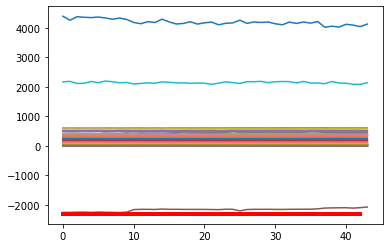

Predicción:  [[[0.9098119  0.09018807]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9097100e+01  1.0390700e+01  4.5472100e+01  7.7056000e+01
  6.1110540e+02  3.3696100e+01  1.1041100e+01  1.8395000e+02
  5.0000000e-04  8.2562700e+01  1.2890500e+02  1.2317200e+01
  6.4481200e+01  1.7318590e+02  2.1089000e+01  1.6602300e+02
  1.8447250e+02  6.9875900e+01 -6.8991000e+00  3.5189000e+00
  1.6560100e+01  6.9024000e+00  1.5010000e+00  7.1476600e+01
  1.4543000e+00  1.5163000e+00  9.3594100e+01  5.6624200e+01
  1.3295000e+00  1.1883000e+00  1.5757000e+00  1.3408000e+00
  1.5193400e+02  8.2660000e-01  8.3060000e-01 -2.0720995e+03
  2.0081630e+02  1.6089000e+00  1.3863000e+00  2.0931208e+03
  4.0197276e+03  1.8481450e+02  1.3767000e+00  1.3664000e+00
  8.0001000e+00  7.3950000e+00  1.7410000e+00  1.6510000e-01
  3.6066200e+01  5.2652890e+02  5.1893500e+02  5.1538800e+02
  5.1566000e+02  5.1619630e+02  3.1393300e+01  3.01

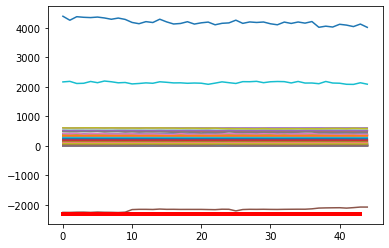

Predicción:  [[[0.88960165 0.11039833]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7418200e+01  1.0441200e+01  5.8558700e+01  7.5582200e+01
  6.1049650e+02  3.4787300e+01  1.1495200e+01  1.8395050e+02
  5.0000000e-04  8.5506100e+01  1.2473350e+02  1.2156100e+01
  6.3801700e+01  1.7821310e+02  2.1526400e+01  1.6586750e+02
  1.8393310e+02  7.0257200e+01  1.2775700e+01  3.3913000e+00
  1.6864800e+01  6.8873000e+00  1.5003000e+00  7.1535800e+01
  1.4646000e+00  1.5258000e+00  8.9662000e+01  5.6466800e+01
  1.3378000e+00  1.2027000e+00  1.5829000e+00  1.3547000e+00
  1.5438080e+02  8.2500000e-01  8.2930000e-01 -2.0955763e+03
  2.0092820e+02  1.6166000e+00  1.3944000e+00  2.1420813e+03
  4.1576533e+03  1.8481450e+02  1.3856000e+00  1.3838000e+00
  7.9974000e+00  7.3968000e+00  1.7541000e+00  1.7100000e-01
  3.1258900e+01  5.2760220e+02  5.2096500e+02  5.1706530e+02
  5.1733830e+02  5.1786190e+02  3.0796200e+01  3.03

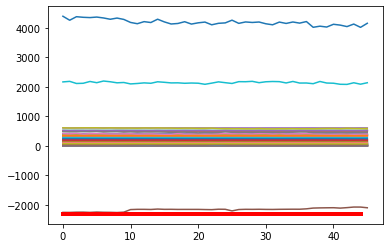

Predicción:  [[[0.9264982  0.07350182]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9186000e+01  1.0274600e+01  4.8851800e+01  7.5904900e+01
  6.0979690e+02  3.4594200e+01  1.1160100e+01  1.8399990e+02
  5.0000000e-04  8.5634600e+01  1.2505280e+02  1.1852800e+01
  6.1153700e+01  1.7687680e+02  2.0221700e+01  1.6598200e+02
  1.8429250e+02  7.0015500e+01 -4.0000000e-04  3.4196000e+00
  1.7259200e+01  6.9057000e+00  1.4994000e+00  7.1485700e+01
  1.4544000e+00  1.5164000e+00  9.1289200e+01  5.6583900e+01
  1.3225000e+00  1.1927000e+00  1.5928000e+00  1.3409000e+00
  1.4966840e+02  8.2610000e-01  8.3060000e-01 -2.0994975e+03
  1.9847160e+02  1.6084000e+00  1.3793000e+00  2.1383884e+03
  4.1103400e+03  1.8481450e+02  1.3734000e+00  1.3655000e+00
  8.0036000e+00  7.4106000e+00  1.7422000e+00  1.4960000e-01
  3.2277100e+01  5.2690220e+02  5.2002670e+02  5.1617730e+02
  5.1626540e+02  5.1674640e+02  2.9847200e+01  2.90

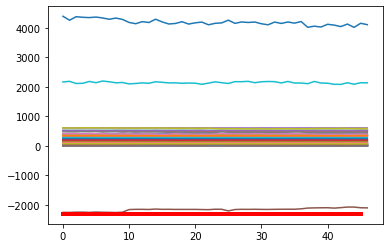

Predicción:  [[[0.9209533 0.0790467]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2966400e+01  1.0551800e+01  4.7444500e+01  7.6228300e+01
  6.0986190e+02  3.3686500e+01  1.0947300e+01  1.8403640e+02
  5.0000000e-04  8.5969100e+01  1.2877190e+02  1.1962900e+01
  6.3686200e+01  1.7523560e+02  2.0851100e+01  1.6589130e+02
  1.8440180e+02  7.0075100e+01 -4.0000000e-04  3.6035000e+00
  1.8794900e+01  6.9056000e+00  1.5011000e+00  7.1715800e+01
  1.4480000e+00  1.5079000e+00  9.1027900e+01  5.7773600e+01
  1.3201000e+00  1.1829000e+00  1.5901000e+00  1.3351000e+00
  1.5257870e+02  8.2670000e-01  8.3030000e-01 -2.1086673e+03
  2.0250780e+02  1.6000000e+00  1.3781000e+00  2.0929877e+03
  4.0422258e+03  1.8481450e+02  1.3668000e+00  1.3590000e+00
  7.9871000e+00  7.4047000e+00  1.7351000e+00  1.4510000e-01
  3.1802500e+01  5.2601560e+02  5.1885880e+02  5.1546440e+02
  5.1564770e+02  5.1627550e+02  3.1182600e+01  3.0346

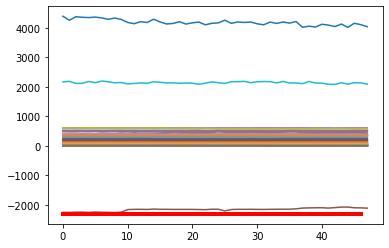

Predicción:  [[[0.9148219  0.08517803]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0775000e+01  1.0610700e+01  5.2611400e+01  7.4914300e+01
  6.0976560e+02  3.3550700e+01  1.1013800e+01  1.8404530e+02
  5.0000000e-04  8.4670800e+01  1.2667080e+02  1.2065300e+01
  6.5343100e+01  1.7679170e+02  2.1928600e+01  1.6607990e+02
  1.8411760e+02  7.0233000e+01 -4.0000000e-04  3.6037000e+00
  1.8495300e+01  6.8924000e+00  1.4992000e+00  7.1726400e+01
  1.4597000e+00  1.5223000e+00  9.3072500e+01  5.7161000e+01
  1.3324000e+00  1.2005000e+00  1.6018000e+00  1.3551000e+00
  1.5453340e+02  8.2790000e-01  8.2960000e-01 -2.0960434e+03
  2.0043280e+02  1.6155000e+00  1.3895000e+00  2.0701744e+03
  4.0292423e+03  1.8481450e+02  1.3879000e+00  1.3814000e+00
  8.0000000e+00  7.3914000e+00  1.7466000e+00  1.4470000e-01
  3.2823600e+01  5.2709780e+02  5.1959920e+02  5.1598800e+02
  5.1618770e+02  5.1678950e+02  3.1611800e+01  3.07

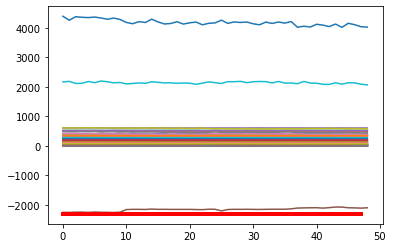

Predicción:  [[[0.9060456  0.09395441]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8074000e+01  1.0640000e+01  5.4850700e+01  7.4571400e+01
  6.1012100e+02  3.2989800e+01  1.0919100e+01  1.8396400e+02
  5.0000000e-04  8.3699500e+01  1.2444870e+02  1.1932200e+01
  6.4404300e+01  1.7774620e+02  2.1936400e+01  1.6597490e+02
  1.8406290e+02  7.0352000e+01  2.8721900e+01  3.5163000e+00
  1.7166000e+01  6.9182000e+00  1.5015000e+00  7.1741400e+01
  1.4506000e+00  1.5112000e+00  9.2366300e+01  5.7895500e+01
  1.3261000e+00  1.1966000e+00  1.5909000e+00  1.3524000e+00
  1.5415890e+02  8.2780000e-01  8.3000000e-01 -2.0976966e+03
  2.0104390e+02  1.6028000e+00  1.3840000e+00  2.0625580e+03
  4.0112963e+03  1.8481450e+02  1.3843000e+00  1.3790000e+00
  7.9985000e+00  7.4053000e+00  1.7367000e+00  1.4580000e-01
  3.1646600e+01  5.2714280e+02  5.1988400e+02  5.1619770e+02
  5.1639270e+02  5.1693420e+02  3.1566600e+01  3.05

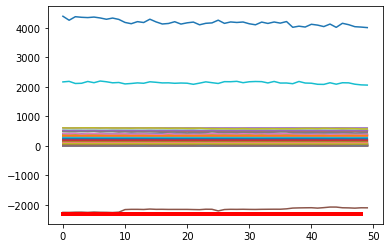

Predicción:  [[[0.9050375  0.09496244]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6993600e+01  1.0537900e+01  5.0136000e+01  7.4714300e+01
  6.0981850e+02  3.3504100e+01  1.0932900e+01  1.8399020e+02
  5.0000000e-04  8.3539700e+01  1.2847230e+02  1.2100900e+01
  6.3813000e+01  1.7883450e+02  2.2212600e+01  1.6618670e+02
  1.8404970e+02  7.0306800e+01  3.9999500e+01  3.5081000e+00
  1.7237200e+01  6.8789000e+00  1.4989000e+00  7.1668300e+01
  1.4592000e+00  1.5229000e+00  9.3857200e+01  5.9209200e+01
  1.3280000e+00  1.2063000e+00  1.5990000e+00  1.3592000e+00
  1.5231460e+02  8.2820000e-01  8.3000000e-01 -2.0974224e+03
  1.9942980e+02  1.6159000e+00  1.3872000e+00  2.1225882e+03
  4.1237197e+03  1.8481450e+02  1.3897000e+00  1.3871000e+00
  7.9991000e+00  7.4016000e+00  1.7470000e+00  1.4800000e-01
  3.0160300e+01  5.2721890e+02  5.1980840e+02  5.1625810e+02
  5.1674550e+02  5.1710310e+02  3.2218300e+01  3.09

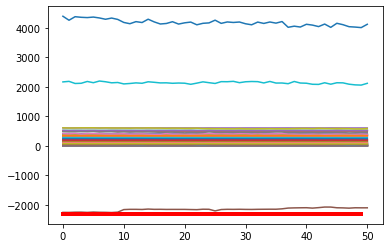

Predicción:  [[[0.922877   0.07712294]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6584700e+01  1.0713400e+01  4.8090800e+01  7.6600200e+01
  6.1059670e+02  3.3834100e+01  1.0798800e+01  1.8405960e+02
  5.0000000e-04  8.2020200e+01  1.2826300e+02  1.1879400e+01
  6.3595300e+01  1.7735820e+02  2.1340300e+01  1.6598010e+02
  1.8398390e+02  7.0069700e+01  8.2378100e+01  3.4912000e+00
  1.7139400e+01  6.9124000e+00  1.5002000e+00  7.1626500e+01
  1.4646000e+00  1.5255000e+00  9.1629200e+01  5.8758700e+01
  1.3355000e+00  1.2096000e+00  1.6069000e+00  1.3603000e+00
  1.5297570e+02  8.2890000e-01  8.3120000e-01 -2.1047914e+03
  2.0059210e+02  1.6181000e+00  1.3938000e+00  2.0629971e+03
  4.0658210e+03  1.8481450e+02  1.3905000e+00  1.3872000e+00
  7.9981000e+00  7.3947000e+00  1.7524000e+00  1.4520000e-01
  3.0343900e+01  5.2741340e+02  5.1930650e+02  5.1569990e+02
  5.1644540e+02  5.1644340e+02  3.3009800e+01  3.18

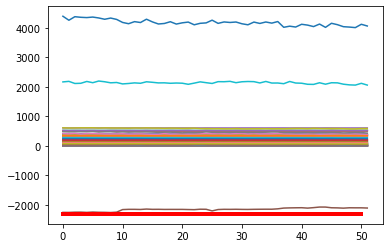

Predicción:  [[[0.91815555 0.08184442]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6535900e+01  1.0679000e+01  4.5836600e+01  7.5840300e+01
  6.0965290e+02  3.4515400e+01  1.0701000e+01  1.8398460e+02
  5.0000000e-04  8.1196000e+01  1.2870170e+02  1.2222400e+01
  6.5084300e+01  1.8130860e+02  2.0320600e+01  1.6584360e+02
  1.8346600e+02  7.0566600e+01 -4.0000000e-04  3.2934000e+00
  1.6215600e+01  6.8904000e+00  1.5002000e+00  7.1741100e+01
  1.4577000e+00  1.5216000e+00  9.1497100e+01  5.8962800e+01
  1.3302000e+00  1.2079000e+00  1.5964000e+00  1.3620000e+00
  1.5254240e+02  8.2320000e-01  8.2720000e-01 -2.0957570e+03
  2.0209830e+02  1.6128000e+00  1.3892000e+00  2.0753988e+03
  3.9690315e+03  1.8481450e+02  1.3913000e+00  1.3901000e+00
  8.0011000e+00  7.4024000e+00  1.7451000e+00  1.4850000e-01
  2.9211400e+01  5.2731780e+02  5.2017740e+02  5.1647580e+02
  5.1736520e+02  5.1728310e+02  3.1657400e+01  3.15

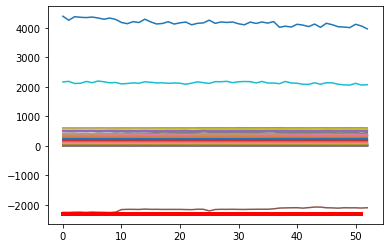

Predicción:  [[[0.89577514 0.10422488]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6183700e+01  1.0601400e+01  4.9373100e+01  7.5170800e+01
  6.1014130e+02  3.4745300e+01  1.0694700e+01  1.8403460e+02
  5.0000000e-04  8.2414400e+01  1.2569740e+02  1.2238900e+01
  6.4900200e+01  1.8015230e+02  2.0656500e+01  1.6571320e+02
  1.8321970e+02  7.0312400e+01 -4.0000000e-04  3.3018000e+00
  1.6536400e+01  6.9073000e+00  1.4998000e+00  7.1741400e+01
  1.4595000e+00  1.5242000e+00  9.0788600e+01  5.9355400e+01
  1.3328000e+00  1.2089000e+00  1.5991000e+00  1.3639000e+00
  1.5285510e+02  8.2770000e-01  8.2960000e-01 -2.0932357e+03
  2.0174590e+02  1.6155000e+00  1.3919000e+00  2.1293658e+03
  4.1853869e+03  1.8481450e+02  1.3918000e+00  1.3883000e+00
  8.0030000e+00  7.4069000e+00  1.7482000e+00  1.4860000e-01
  2.7857300e+01  5.2562000e+02  5.1927400e+02  5.1527660e+02
  5.1619990e+02  5.1611890e+02  3.1473400e+01  3.09

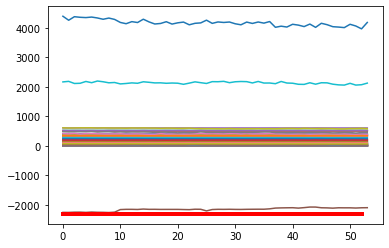

Predicción:  [[[0.9295114  0.07048854]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6739900e+01  1.0356400e+01  5.3739600e+01  7.7153800e+01
  6.1055340e+02  3.5238700e+01  1.0546500e+01  1.8401630e+02
  5.0000000e-04  8.3935600e+01  1.2334680e+02  1.2254800e+01
  6.3216000e+01  1.8198780e+02  2.0967400e+01  1.6600850e+02
  1.8327490e+02  7.0090900e+01 -4.0000000e-04  3.3134000e+00
  1.7481000e+01  6.8669000e+00  1.4993000e+00  7.1670400e+01
  1.4581000e+00  1.5224000e+00  9.1738600e+01  5.8797900e+01
  1.3298000e+00  1.2096000e+00  1.5963000e+00  1.3602000e+00
  1.5077400e+02  8.2820000e-01  8.3070000e-01 -2.1008009e+03
  2.0132200e+02  1.6150000e+00  1.3894000e+00  2.1197570e+03
  4.1531580e+03  1.8481450e+02  1.3880000e+00  1.3843000e+00
  7.9974000e+00  7.4005000e+00  1.7452000e+00  1.4850000e-01
  2.7667700e+01  5.2671110e+02  5.1933590e+02  5.1587920e+02
  5.1661380e+02  5.1652090e+02  3.1920300e+01  3.13

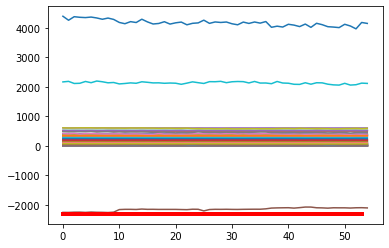

Predicción:  [[[0.92796504 0.072035  ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6463400e+01  1.0328400e+01  5.8071900e+01  7.6777900e+01
  6.1068580e+02  3.4817600e+01  1.0264400e+01  1.8394360e+02
  5.0000000e-04  8.5028800e+01  1.2210800e+02  1.1616000e+01
  6.3353500e+01  1.8267130e+02  2.1455300e+01  1.6604170e+02
  1.8315020e+02  7.0328500e+01 -4.0000000e-04  3.3004000e+00
  1.7826300e+01  6.9142000e+00  1.4999000e+00  7.1656900e+01
  1.4485000e+00  1.5106000e+00  9.0060400e+01  6.0784300e+01
  1.3197000e+00  1.2022000e+00  1.5827000e+00  1.3467000e+00
  1.4901090e+02  8.2700000e-01  8.3080000e-01 -2.1008136e+03
  2.0140800e+02  1.5997000e+00  1.3797000e+00  2.1210867e+03
  4.1310110e+03  1.8481450e+02  1.3736000e+00  1.3726000e+00
  8.0012000e+00  7.3999000e+00  1.7340000e+00  1.5130000e-01
  2.7453100e+01  5.2787610e+02  5.1992290e+02  5.1590600e+02
  5.1676920e+02  5.1660800e+02  3.2251700e+01  3.14

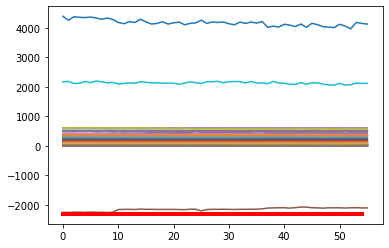

Predicción:  [[[0.9248288  0.07517124]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6101500e+01  1.0470700e+01  6.2891800e+01  7.4740500e+01
  6.1054980e+02  3.5115800e+01  1.0202300e+01  1.8406670e+02
  5.0000000e-04  8.5302500e+01  1.2092010e+02  7.9221000e+00
  6.3010500e+01  1.8187330e+02  2.1713400e+01  1.6599090e+02
  1.8329870e+02  7.0677300e+01 -4.0000000e-04  3.2951000e+00
  1.8204600e+01  6.9129000e+00  1.4993000e+00  7.1782300e+01
  1.4292000e+00  1.4944000e+00  9.0494000e+01  5.9463700e+01
  1.3154000e+00  1.1830000e+00  1.5620000e+00  1.3323000e+00
  1.4853150e+02  8.2420000e-01  8.3030000e-01 -1.9774120e+03
  2.0472200e+02  1.5850000e+00  1.3753000e+00  2.0975969e+03
  3.9744272e+03  1.8481450e+02  1.3608000e+00  1.3591000e+00
  7.9971000e+00  7.4018000e+00  1.7163000e+00  1.5420000e-01
  2.8263400e+01  5.2720000e+02  5.1911460e+02  5.1493910e+02
  5.1570750e+02  5.1582310e+02  3.2093100e+01  3.12

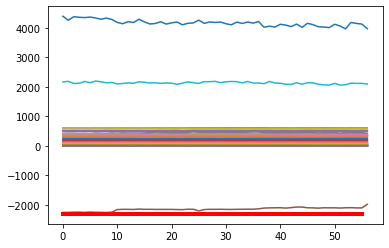

Predicción:  [[[0.78992206 0.21007797]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5728600e+01  1.0459000e+01  6.3205600e+01  7.4814500e+01
  6.0950330e+02  3.4817300e+01  9.9204000e+00  1.8399280e+02
  5.0000000e-04  8.6085000e+01  1.2012300e+02  7.8949000e+00
  6.3580200e+01  1.8105940e+02  2.2117500e+01  1.6585660e+02
  1.8367870e+02  7.0991400e+01 -4.0000000e-04  3.2923000e+00
  1.8717700e+01  6.8895000e+00  1.4994000e+00  7.2000400e+01
  1.4326000e+00  1.4935000e+00  8.9818300e+01  5.9982900e+01
  1.3170000e+00  1.1829000e+00  1.5648000e+00  1.3316000e+00
  1.4898700e+02  8.2590000e-01  8.2960000e-01 -1.9533671e+03
  2.0519590e+02  1.5831000e+00  1.3770000e+00  2.0879348e+03
  3.8833174e+03  1.8481450e+02  1.3628000e+00  1.3544000e+00
  8.0002000e+00  7.4005000e+00  1.7184000e+00  1.5370000e-01
  3.1138000e+01  5.2730000e+02  5.1895130e+02  5.1509210e+02
  5.1583600e+02  5.1594080e+02  3.1878800e+01  3.10

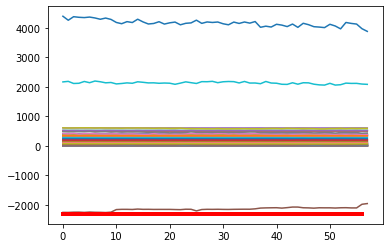

Predicción:  [[[0.72487044 0.2751296 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5682100e+01  1.0464400e+01  6.2943300e+01  7.3974900e+01
  6.1049170e+02  3.5374900e+01  9.9047000e+00  1.8395490e+02
  5.0000000e-04  8.6212600e+01  1.2015470e+02  7.9544000e+00
  6.4755800e+01  1.8323230e+02  2.2962200e+01  1.6611440e+02
  1.8358900e+02  7.1108800e+01 -4.0000000e-04  3.2903000e+00
  1.8752600e+01  6.9215000e+00  1.4997000e+00  7.2071800e+01
  1.4304000e+00  1.4912000e+00  8.8649500e+01  5.9777300e+01
  1.3138000e+00  1.1816000e+00  1.5555000e+00  1.3281000e+00
  1.4867370e+02  8.2530000e-01  8.3060000e-01 -1.9484731e+03
  2.0630320e+02  1.5795000e+00  1.3740000e+00  2.0799334e+03
  3.8521208e+03  1.8481450e+02  1.3571000e+00  1.3576000e+00
  8.0013000e+00  7.4017000e+00  1.7147000e+00  1.5920000e-01
  2.9257500e+01  5.2786890e+02  5.1992720e+02  5.1596080e+02
  5.1656590e+02  5.1676070e+02  3.1640300e+01  3.08

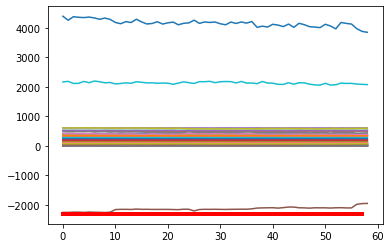

Predicción:  [[[0.7053827  0.29461727]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5915100e+01  1.0464900e+01  6.3510500e+01  7.3293200e+01
  6.1059820e+02  3.4876800e+01  9.9335000e+00  1.8393740e+02
  5.0000000e-04  8.6401900e+01  1.1996250e+02  8.2098000e+00
  6.3823300e+01  1.8197330e+02  2.2879400e+01  1.6586520e+02
  1.8347730e+02  7.0648900e+01 -4.0000000e-04  3.2955000e+00
  1.8791600e+01  6.8928000e+00  1.4990000e+00  7.1775600e+01
  1.4265000e+00  1.4876000e+00  8.9927700e+01  5.9976400e+01
  1.3093000e+00  1.1800000e+00  1.5521000e+00  1.3273000e+00
  1.4661500e+02  8.2420000e-01  8.3030000e-01 -1.9463230e+03
  2.0228980e+02  1.5773000e+00  1.3692000e+00  2.0457051e+03
  3.9667363e+03  1.8481450e+02  1.3560000e+00  1.3553000e+00
  8.0013000e+00  7.3998000e+00  1.7107000e+00  1.5860000e-01
  2.8478100e+01  5.2714890e+02  5.1932310e+02  5.1522460e+02
  5.1590600e+02  5.1613800e+02  3.1618700e+01  3.07

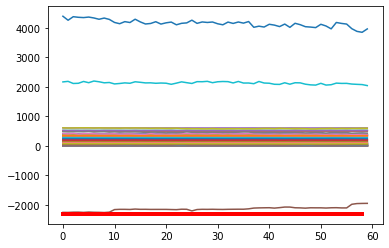

Predicción:  [[[0.7483999 0.2516001]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5421000e+01  1.0388900e+01  6.3648500e+01  7.3682900e+01
  6.0982640e+02  3.4342600e+01  9.8747000e+00  1.8401570e+02
  5.0000000e-04  8.5027200e+01  1.1992410e+02  8.0223000e+00
  6.3463800e+01  1.8086940e+02  2.3120600e+01  1.6576660e+02
  1.8360750e+02  7.0546000e+01 -4.0000000e-04  3.3005000e+00
  1.8884200e+01  6.9131000e+00  1.4997000e+00  7.1718900e+01
  1.4211000e+00  1.4823000e+00  8.9324200e+01  6.0442100e+01
  1.3027000e+00  1.1759000e+00  1.5481000e+00  1.3243000e+00
  1.4701400e+02  8.2590000e-01  8.3040000e-01 -1.9522171e+03
  2.0534420e+02  1.5714000e+00  1.3632000e+00  2.0586466e+03
  3.9060223e+03  1.8481450e+02  1.3543000e+00  1.3468000e+00
  7.9997000e+00  7.4017000e+00  1.7053000e+00  1.5750000e-01
  2.9835000e+01  5.2784890e+02  5.1897520e+02  5.1515280e+02
  5.1578320e+02  5.1609850e+02  3.1808100e+01  3.0835

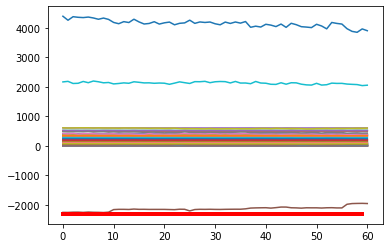

Predicción:  [[[0.7321061  0.26789388]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6184200e+01  1.0314100e+01  6.4206200e+01  7.3798000e+01
  6.1061400e+02  3.4350600e+01  9.8748000e+00  1.8403890e+02
  5.0000000e-04  8.3798900e+01  1.1996440e+02  8.2319000e+00
  6.3189500e+01  1.8208610e+02  2.3204000e+01  1.6593490e+02
  1.8362660e+02  7.0497200e+01 -4.0000000e-04  3.2892000e+00
  1.8857700e+01  6.9039000e+00  1.4991000e+00  7.1485700e+01
  1.4150000e+00  1.4748000e+00  8.9817100e+01  6.0854300e+01
  1.2976000e+00  1.1739000e+00  1.5421000e+00  1.3205000e+00
  1.4639710e+02  8.2680000e-01  8.2940000e-01 -1.9475304e+03
  2.0393890e+02  1.5653000e+00  1.3587000e+00  2.1077635e+03
  3.9592481e+03  1.8481450e+02  1.3521000e+00  1.3460000e+00
  7.9993000e+00  7.3994000e+00  1.6986000e+00  1.5660000e-01
  3.1156100e+01  5.2751780e+02  5.1919930e+02  5.1532320e+02
  5.1589730e+02  5.1606020e+02  3.1838500e+01  3.09

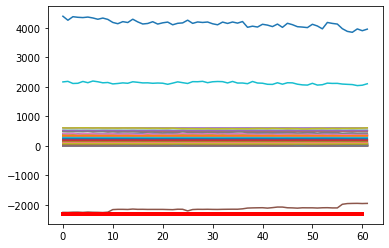

Predicción:  [[[0.74661475 0.25338528]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5890100e+01  1.0369700e+01  6.2847000e+01  7.2990600e+01
  6.0983280e+02  3.4011500e+01  9.9844000e+00  1.8412120e+02
  5.0000000e-04  8.3012600e+01  1.1997770e+02  8.2152000e+00
  6.3367100e+01  1.7945950e+02  2.2782900e+01  1.6578070e+02
  1.8384320e+02  7.0498100e+01 -4.0000000e-04  3.3484000e+00
  1.8560500e+01  6.8791000e+00  1.5013000e+00  7.1419200e+01
  1.4126000e+00  1.4742000e+00  8.9035400e+01  6.0515900e+01
  1.2903000e+00  1.1690000e+00  1.5414000e+00  1.3166000e+00
  1.4565090e+02  8.2600000e-01  8.3050000e-01 -1.9503130e+03
  2.0265990e+02  1.5636000e+00  1.3513000e+00  2.0847566e+03
  3.9428487e+03  1.8481450e+02  1.3516000e+00  1.3426000e+00
  7.9997000e+00  7.3984000e+00  1.6951000e+00  1.5350000e-01
  3.4584100e+01  5.2754890e+02  5.1858520e+02  5.1481160e+02
  5.1544880e+02  5.1571070e+02  3.1601800e+01  3.04

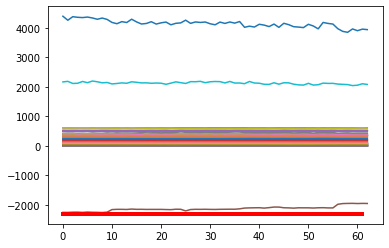

Predicción:  [[[0.74463564 0.25536436]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5288100e+01  1.0321100e+01  6.3697900e+01  7.4199200e+01
  6.1007310e+02  3.2020400e+01  9.9606000e+00  1.8399240e+02
  5.0000000e-04  8.3085600e+01  1.1989780e+02  7.9810000e+00
  6.3848200e+01  1.7901870e+02  2.3342600e+01  1.6609820e+02
  1.8399190e+02  7.0331300e+01 -4.0000000e-04  3.4025000e+00
  1.8286400e+01  6.8891000e+00  1.4978000e+00  7.1325800e+01
  1.4180000e+00  1.4822000e+00  8.9888100e+01  6.0319000e+01
  1.3014000e+00  1.1773000e+00  1.5490000e+00  1.3260000e+00
  1.4749660e+02  8.2690000e-01  8.3020000e-01 -1.9487297e+03
  2.0376830e+02  1.5725000e+00  1.3611000e+00  2.0652106e+03
  4.0211319e+03  1.8481450e+02  1.3580000e+00  1.3472000e+00
  7.9980000e+00  7.3986000e+00  1.7030000e+00  1.5400000e-01
  3.2075000e+01  5.2834890e+02  5.1889730e+02  5.1514590e+02
  5.1588940e+02  5.1614000e+02  3.1999400e+01  3.09

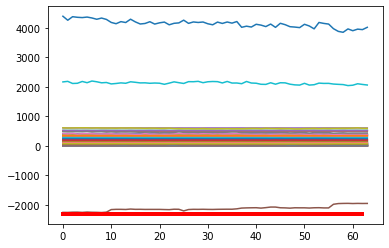

Predicción:  [[[0.77258813 0.22741191]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4861500e+01  1.0232200e+01  6.1815400e+01  7.2757500e+01
  6.0965380e+02  3.3118100e+01  1.0078100e+01  1.8403030e+02
  5.0000000e-04  8.1905000e+01  1.1989530e+02  8.0862000e+00
  6.4283400e+01  1.7943930e+02  2.2302100e+01  1.6615180e+02
  1.8379600e+02  7.0256800e+01 -4.0000000e-04  3.4021000e+00
  1.6530300e+01  6.8973000e+00  1.5011000e+00  7.1251300e+01
  1.4059000e+00  1.4668000e+00  8.8723200e+01  5.9422700e+01
  1.2897000e+00  1.1658000e+00  1.5365000e+00  1.3158000e+00
  1.4863440e+02  8.2300000e-01  8.2930000e-01 -1.9496860e+03
  2.0277030e+02  1.5550000e+00  1.3489000e+00  2.0766031e+03
  3.9437170e+03  1.8481450e+02  1.3505000e+00  1.3409000e+00
  8.0032000e+00  7.3966000e+00  1.6892000e+00  1.5190000e-01
  3.4644800e+01  5.2860000e+02  5.1962510e+02  5.1545710e+02
  5.1627540e+02  5.1649810e+02  3.1787500e+01  3.06

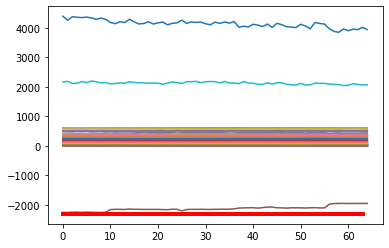

Predicción:  [[[0.7455452  0.25445482]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4723700e+01  1.0350700e+01  6.1680600e+01  7.2035600e+01
  6.1044600e+02  3.5194300e+01  1.0125800e+01  1.8391980e+02
  5.0000000e-04  8.2278000e+01  1.2008240e+02  7.6871000e+00
  6.1889000e+01  1.7984560e+02  2.2066700e+01  1.6598920e+02
  1.8393170e+02  6.9833000e+01 -4.0000000e-04  3.4399000e+00
  1.6588500e+01  6.9056000e+00  1.5009000e+00  7.1145000e+01
  1.4142000e+00  1.4731000e+00  8.8009000e+01  5.9741000e+01
  1.2959000e+00  1.1673000e+00  1.5425000e+00  1.3137000e+00
  1.4694090e+02  8.2460000e-01  8.3000000e-01 -1.9462210e+03
  2.0233430e+02  1.5609000e+00  1.3556000e+00  2.0874493e+03
  3.9699735e+03  1.8481450e+02  1.3479000e+00  1.3378000e+00
  7.9981000e+00  7.3969000e+00  1.6967000e+00  1.5450000e-01
  3.4234300e+01  5.2766890e+02  5.1909960e+02  5.1487150e+02
  5.1580370e+02  5.1588580e+02  3.2250800e+01  3.08

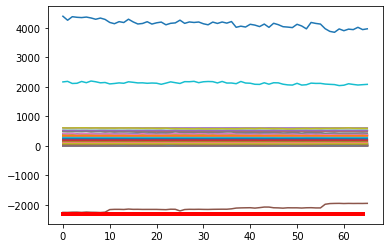

Predicción:  [[[0.7511628  0.24883714]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5168100e+01  1.0424400e+01  6.2529800e+01  7.3325200e+01
  6.1041150e+02  3.5199200e+01  1.0162300e+01  1.8395260e+02
  5.0000000e-04  8.2613300e+01  1.1993380e+02  7.9163000e+00
  6.2432900e+01  1.7737800e+02  2.2016200e+01  1.6578540e+02
  1.8409810e+02  7.0162300e+01 -4.0000000e-04  3.4973000e+00
  1.7738600e+01  6.9237000e+00  1.4999000e+00  7.1091600e+01
  1.4254000e+00  1.4868000e+00  8.9067200e+01  5.9741300e+01
  1.3072000e+00  1.1744000e+00  1.5551000e+00  1.3223000e+00
  1.4766900e+02  8.2650000e-01  8.2980000e-01 -1.9540087e+03
  2.0026840e+02  1.5750000e+00  1.3669000e+00  2.1141611e+03
  3.9638592e+03  1.8481450e+02  1.3544000e+00  1.3463000e+00
  8.0017000e+00  7.3994000e+00  1.7093000e+00  1.5430000e-01
  3.2181200e+01  5.2774890e+02  5.1906040e+02  5.1525350e+02
  5.1617210e+02  5.1624400e+02  3.2368200e+01  3.12

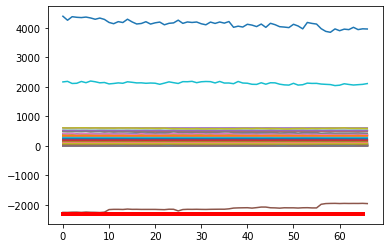

Predicción:  [[[0.7573078  0.24269213]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4857600e+01  1.0455500e+01  6.2881300e+01  7.3461300e+01
  6.1009080e+02  3.4830300e+01  1.0103800e+01  1.8401200e+02
  5.0000000e-04  8.2425400e+01  1.1996190e+02  8.0585000e+00
  6.4589900e+01  1.7823410e+02  2.2070800e+01  1.6586300e+02
  1.8423520e+02  6.9712500e+01 -4.0000000e-04  3.4684000e+00
  1.7811300e+01  6.8664000e+00  1.4992000e+00  7.0714400e+01
  1.4158000e+00  1.4763000e+00  8.9895600e+01  5.8943400e+01
  1.2987000e+00  1.1651000e+00  1.5460000e+00  1.3143000e+00
  1.4857460e+02  8.2820000e-01  8.3030000e-01 -1.9529527e+03
  1.9876140e+02  1.5657000e+00  1.3576000e+00  2.1222381e+03
  3.9706570e+03  1.8481450e+02  1.3445000e+00  1.3371000e+00
  7.9992000e+00  7.4016000e+00  1.7001000e+00  1.5420000e-01
  3.0300400e+01  5.2815110e+02  5.1935850e+02  5.1520420e+02
  5.1612170e+02  5.1620950e+02  3.2643400e+01  3.14

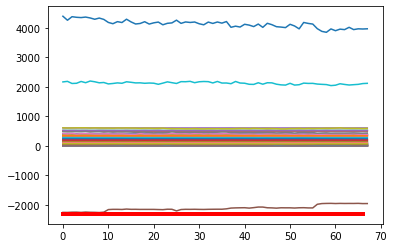

Predicción:  [[[0.7591676  0.24083234]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4645200e+01  1.0395400e+01  6.4480100e+01  7.0975400e+01
  6.0978320e+02  3.3994400e+01  1.0041700e+01  1.8402180e+02
  5.0000000e-04  8.2380200e+01  1.1979690e+02  8.0003000e+00
  6.3772500e+01  1.7561450e+02  2.2277400e+01  1.6604450e+02
  1.8438160e+02  6.8771200e+01 -4.0000000e-04  3.4045000e+00
  1.8801100e+01  6.9150000e+00  1.5009000e+00  7.0284300e+01
  1.4218000e+00  1.4805000e+00  8.7098900e+01  5.7800300e+01
  1.3035000e+00  1.1687000e+00  1.5566000e+00  1.3139000e+00
  1.4569760e+02  8.2880000e-01  8.3030000e-01 -1.9487862e+03
  1.9648620e+02  1.5681000e+00  1.3610000e+00  2.1346291e+03
  3.8628807e+03  1.8481450e+02  1.3436000e+00  1.3350000e+00
  8.0216000e+00  7.4009000e+00  1.7089000e+00  1.5210000e-01
  2.9700200e+01  5.2698220e+02  5.1800830e+02  5.1417100e+02
  5.1512480e+02  5.1524050e+02  3.3083300e+01  3.15

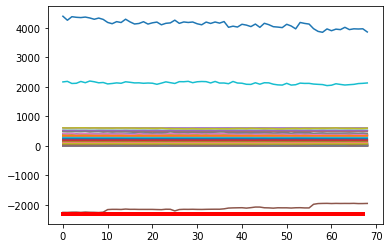

Predicción:  [[[0.7068119  0.29318804]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4612600e+01  1.0301300e+01  6.3927400e+01  7.2808900e+01
  6.0910570e+02  3.3751900e+01  1.0007200e+01  1.8399020e+02
  5.0000000e-04  8.2337100e+01  1.1959610e+02  8.0110000e+00
  6.4628300e+01  1.7637470e+02  2.3266500e+01  1.6619850e+02
  1.8431320e+02  6.9585400e+01 -4.0000000e-04  3.4002000e+00
  1.9256900e+01  6.8992000e+00  1.4998000e+00  7.1182600e+01
  1.4532000e+00  1.5139000e+00  9.0092300e+01  6.0347900e+01
  1.3357000e+00  1.1970000e+00  1.5851000e+00  1.3494000e+00
  1.5262400e+02  8.2890000e-01  8.3020000e-01 -1.9536130e+03
  1.9842510e+02  1.6037000e+00  1.3960000e+00  2.0717106e+03
  3.9888163e+03  1.8481450e+02  1.3800000e+00  1.3711000e+00
  8.0009000e+00  7.3998000e+00  1.7403000e+00  1.5520000e-01
  3.0643400e+01  5.3001560e+02  5.2121620e+02  5.1757770e+02
  5.1843340e+02  5.1849720e+02  3.2843000e+01  3.16

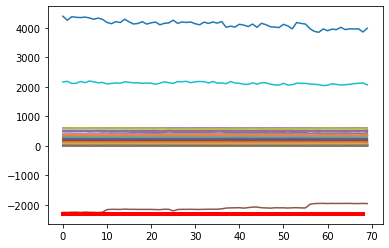

Predicción:  [[[0.76459795 0.23540209]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4949900e+01  1.0437900e+01  6.3296000e+01  7.3305200e+01
  6.1047440e+02  3.3410200e+01  1.0030100e+01  1.8395210e+02
  5.0000000e-04  8.2014800e+01  1.1988820e+02  8.0065000e+00
  6.4115000e+01  1.8165010e+02  2.2508800e+01  1.6602690e+02
  1.8422930e+02  6.9890800e+01 -4.0000000e-04  3.4818000e+00
  1.9114200e+01  6.8904000e+00  1.5018000e+00  7.1170500e+01
  1.4353000e+00  1.4962000e+00  8.9303000e+01  5.9452500e+01
  1.3148000e+00  1.1909000e+00  1.5578000e+00  1.3370000e+00
  1.4907160e+02  8.2810000e-01  8.2990000e-01 -1.9537795e+03
  1.9889750e+02  1.5850000e+00  1.3746000e+00  2.1145030e+03
  4.0123987e+03  1.8481450e+02  1.3650000e+00  1.3603000e+00
  7.9966000e+00  7.4044000e+00  1.7201000e+00  1.6240000e-01
  2.8304900e+01  5.2818440e+02  5.2063550e+02  5.1611740e+02
  5.1704560e+02  5.1714540e+02  3.2217500e+01  3.19

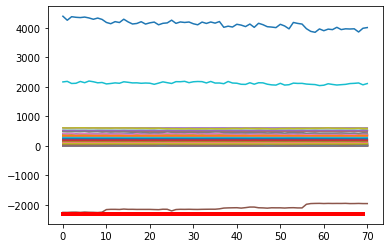

Predicción:  [[[0.77365714 0.22634292]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5186900e+01  1.0372600e+01  6.2932600e+01  7.4492800e+01
  6.0969320e+02  3.3178900e+01  1.0159200e+01  1.8401630e+02
  5.0000000e-04  8.2362800e+01  1.1996050e+02  8.0137000e+00
  6.2709300e+01  1.7981940e+02  2.2286500e+01  1.6597700e+02
  1.8428580e+02  6.9692000e+01 -4.0000000e-04  3.7653000e+00
  1.9217400e+01  6.9027000e+00  1.5007000e+00  7.1207800e+01
  1.4384000e+00  1.5014000e+00  8.9606700e+01  6.0187000e+01
  1.3227000e+00  1.1955000e+00  1.5650000e+00  1.3462000e+00
  1.4724640e+02  8.2860000e-01  8.2960000e-01 -1.9489115e+03
  1.9935980e+02  1.5901000e+00  1.3826000e+00  2.1353804e+03
  4.0047405e+03  1.8481450e+02  1.3743000e+00  1.3711000e+00
  8.0059000e+00  7.3990000e+00  1.7233000e+00  1.5800000e-01
  2.7857700e+01  5.2793330e+02  5.1952460e+02  5.1563110e+02
  5.1660650e+02  5.1671020e+02  3.2162300e+01  3.21

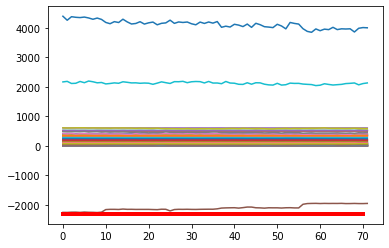

Predicción:  [[[0.7645939  0.23540612]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5409400e+01  1.0279000e+01  6.2512000e+01  7.3386400e+01
  6.1015980e+02  3.2683000e+01  1.0181100e+01  1.8405250e+02
  5.0000000e-04  8.2279000e+01  1.2107580e+02  8.0950000e+00
  6.4961500e+01  1.8047360e+02  2.2284000e+01  1.6619890e+02
  1.8429870e+02  6.9626400e+01 -4.0000000e-04  3.8005000e+00
  1.9139500e+01  6.9218000e+00  1.5014000e+00  7.1163000e+01
  1.4422000e+00  1.5047000e+00  8.9065700e+01  5.9702000e+01
  1.3260000e+00  1.2036000e+00  1.5666000e+00  1.3546000e+00
  1.4999220e+02  8.2850000e-01  8.2940000e-01 -1.9575017e+03
  1.9737440e+02  1.5924000e+00  1.3858000e+00  2.1210221e+03
  4.0041492e+03  1.8481450e+02  1.3827000e+00  1.3805000e+00
  7.9950000e+00  7.3973000e+00  1.7274000e+00  1.6050000e-01
  2.8068500e+01  5.2881560e+02  5.2032710e+02  5.1618500e+02
  5.1711190e+02  5.1718180e+02  3.1872600e+01  3.18

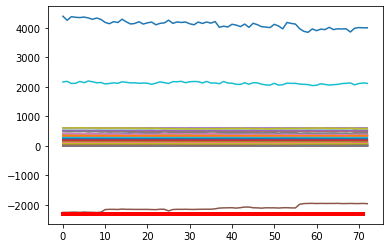

Predicción:  [[[0.7749399  0.22506014]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5138800e+01  1.0251400e+01  5.9119200e+01  7.3565100e+01
  6.0901250e+02  3.3548700e+01  1.0151200e+01  1.8412470e+02
  5.0000000e-04  8.2092600e+01  1.2261090e+02  7.8727000e+00
  6.3856300e+01  1.8172550e+02  2.2284500e+01  1.6620000e+02
  1.8423200e+02  6.9730600e+01 -4.0000000e-04  3.8193000e+00
  1.8772800e+01  6.8913000e+00  1.5027000e+00  7.1297300e+01
  1.4564000e+00  1.5171000e+00  8.7407000e+01  5.8972300e+01
  1.3404000e+00  1.2234000e+00  1.5747000e+00  1.3692000e+00
  1.4817990e+02  8.2750000e-01  8.2980000e-01 -1.9460916e+03
  2.0178660e+02  1.6057000e+00  1.3997000e+00  2.1072998e+03
  4.0226559e+03  1.8481450e+02  1.3968000e+00  1.3942000e+00
  8.0013000e+00  7.3982000e+00  1.7405000e+00  1.6580000e-01
  2.7513800e+01  5.2880000e+02  5.2026430e+02  5.1628170e+02
  5.1729230e+02  5.1719940e+02  3.1757200e+01  3.15

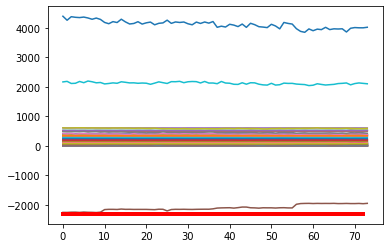

Predicción:  [[[0.76789093 0.23210901]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4915500e+01  1.0256800e+01  5.7673700e+01  7.4617100e+01
  6.0966100e+02  3.3535800e+01  1.0198000e+01  1.8403380e+02
  5.0000000e-04  8.2210200e+01  1.2299440e+02  7.8772000e+00
  6.3707500e+01  1.8183460e+02  2.2294500e+01  1.6606820e+02
  1.8396430e+02  6.9559900e+01 -4.0000000e-04  3.8117000e+00
  1.7852100e+01  6.9115000e+00  1.5007000e+00  7.1222500e+01
  1.4425000e+00  1.5048000e+00  8.8078800e+01  5.8579500e+01
  1.3295000e+00  1.2120000e+00  1.5601000e+00  1.3591000e+00
  1.4847690e+02  8.2850000e-01  8.2960000e-01 -1.9548589e+03
  2.0098080e+02  1.5929000e+00  1.3878000e+00  2.1901971e+03
  3.9966184e+03  1.8481450e+02  1.3868000e+00  1.3839000e+00
  7.9998000e+00  7.4005000e+00  1.7252000e+00  1.6490000e-01
  2.7835200e+01  5.2870000e+02  5.2011660e+02  5.1583090e+02
  5.1690900e+02  5.1689290e+02  3.1468400e+01  3.15

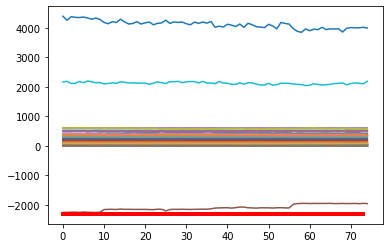

Predicción:  [[[0.7687831  0.23121692]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4860400e+01  1.0283500e+01  5.8819900e+01  7.4367000e+01
  6.0960140e+02  3.3608200e+01  1.0239300e+01  1.8391480e+02
  5.0000000e-04  8.1556000e+01  1.2295420e+02  8.3789000e+00
  6.4222900e+01  1.8015860e+02  2.2253400e+01  1.6585830e+02
  1.8397510e+02  6.9708900e+01 -4.0000000e-04  3.8021000e+00
  1.5394000e+01  6.9183000e+00  1.5012000e+00  7.1172500e+01
  1.4445000e+00  1.5044000e+00  8.8626600e+01  5.8070100e+01
  1.3287000e+00  1.2119000e+00  1.5718000e+00  1.3598000e+00
  1.4897490e+02  8.2900000e-01  8.3020000e-01 -1.9507094e+03
  1.9857910e+02  1.5920000e+00  1.3871000e+00  2.1203155e+03
  3.9510006e+03  1.8481450e+02  1.3878000e+00  1.3846000e+00
  8.0006000e+00  7.4024000e+00  1.7288000e+00  1.5720000e-01
  2.8081200e+01  5.2836890e+02  5.1993360e+02  5.1568730e+02
  5.1689520e+02  5.1672100e+02  3.1602500e+01  3.14

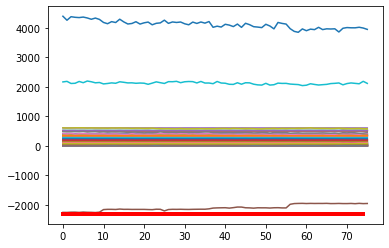

Predicción:  [[[0.74891865 0.25108132]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4769300e+01  1.0252600e+01  6.0338400e+01  7.4820500e+01
  6.0885640e+02  3.3641100e+01  1.0307900e+01  1.8405080e+02
  5.0000000e-04  8.0781600e+01  1.2298380e+02  8.1427000e+00
  6.2666900e+01  1.8020720e+02  2.2293200e+01  1.6597830e+02
  1.8416530e+02  6.9421000e+01 -4.0000000e-04  3.9010000e+00
  1.6056100e+01  6.8966000e+00  1.4992000e+00  7.1159100e+01
  1.4542000e+00  1.5156000e+00  8.8748900e+01  5.6850400e+01
  1.3408000e+00  1.2188000e+00  1.5811000e+00  1.3667000e+00
  1.4863400e+02  8.2830000e-01  8.2990000e-01 -1.9553019e+03
  1.9736960e+02  1.6058000e+00  1.3975000e+00  2.1548034e+03
  4.0178243e+03  1.8481450e+02  1.3943000e+00  1.3900000e+00
  8.0016000e+00  7.3997000e+00  1.7412000e+00  1.5990000e-01
  2.7556500e+01  5.2774890e+02  5.1980750e+02  5.1553600e+02
  5.1681150e+02  5.1664070e+02  3.1484000e+01  3.14

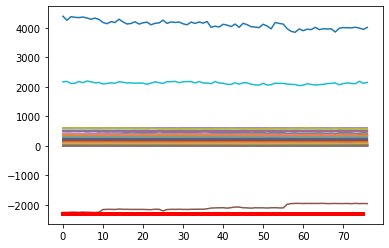

Predicción:  [[[0.7776633 0.2223367]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4792500e+01  1.0281400e+01  5.8965900e+01  7.5234300e+01
  6.1036480e+02  3.3153700e+01  1.0272700e+01  1.8404530e+02
  5.0000000e-04  8.0772400e+01  1.2288500e+02  8.0178000e+00
  6.4999900e+01  1.7953050e+02  2.2517400e+01  1.6619120e+02
  1.8432680e+02  6.9228800e+01 -4.0000000e-04  3.8921000e+00
  1.5922200e+01  6.9040000e+00  1.5007000e+00  7.1222800e+01
  1.4622000e+00  1.5226000e+00  8.9831500e+01  5.6644600e+01
  1.3498000e+00  1.2241000e+00  1.5897000e+00  1.3754000e+00
  1.4997760e+02  8.2720000e-01  8.2930000e-01 -1.9461842e+03
  1.9868600e+02  1.6117000e+00  1.4067000e+00  2.1740648e+03
  3.9735053e+03  1.8481450e+02  1.4035000e+00  1.3983000e+00
  8.0016000e+00  7.3882000e+00  1.7499000e+00  1.6010000e-01
  2.7915300e+01  5.2850000e+02  5.2052560e+02  5.1647150e+02
  5.1754520e+02  5.1737160e+02  3.2479500e+01  3.1529

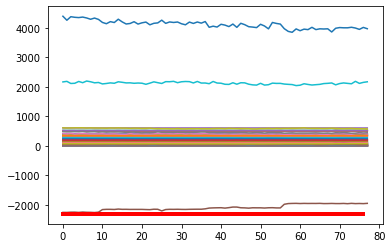

Predicción:  [[[0.75051856 0.24948144]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4557100e+01  1.0322200e+01  5.7240500e+01  7.3400400e+01
  6.1020670e+02  3.2552900e+01  1.0280300e+01  1.8398170e+02
  5.0000000e-04  8.0770000e+01  1.2289760e+02  8.1394000e+00
  6.4286400e+01  1.8002790e+02  2.2052800e+01  1.6582240e+02
  1.8432020e+02  6.9537300e+01 -4.0000000e-04  3.9048000e+00
  1.6111000e+01  6.9053000e+00  1.4988000e+00  7.1130200e+01
  1.4643000e+00  1.5277000e+00  9.0112100e+01  5.6581000e+01
  1.3483000e+00  1.2275000e+00  1.5935000e+00  1.3781000e+00
  1.4995690e+02  8.2670000e-01  8.3060000e-01 -1.9524672e+03
  1.9957520e+02  1.6169000e+00  1.4050000e+00  2.1706024e+03
  4.1114705e+03  1.8481450e+02  1.4061000e+00  1.4026000e+00
  7.9997000e+00  7.4098000e+00  1.7551000e+00  1.6190000e-01
  2.7841700e+01  5.2801560e+02  5.2053750e+02  5.1650520e+02
  5.1743370e+02  5.1735210e+02  3.1752200e+01  3.17

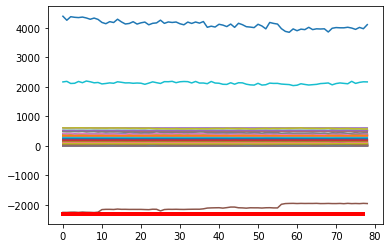

Predicción:  [[[0.80720294 0.1927971 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4814900e+01  1.0255200e+01  5.7839300e+01  7.4079500e+01
  6.0979550e+02  3.2258900e+01  1.0308100e+01  1.8398570e+02
  5.0000000e-04  8.0952000e+01  1.2289230e+02  8.1083000e+00
  6.3854400e+01  1.7882840e+02  2.2007000e+01  1.6587020e+02
  1.8424710e+02  6.9503500e+01 -4.0000000e-04  3.9216000e+00
  1.5916100e+01  6.8995000e+00  1.5011000e+00  7.1237800e+01
  1.4667000e+00  1.5280000e+00  9.0050400e+01  5.6615100e+01
  1.3524000e+00  1.2281000e+00  1.5945000e+00  1.3787000e+00
  1.4970250e+02  8.2650000e-01  8.2980000e-01 -1.9485007e+03
  1.9937680e+02  1.6181000e+00  1.4089000e+00  2.2291268e+03
  4.1341102e+03  1.8481450e+02  1.4075000e+00  1.4038000e+00
  8.0025000e+00  7.4031000e+00  1.7557000e+00  1.6090000e-01
  2.8676300e+01  5.2741770e+02  5.1998160e+02  5.1591070e+02
  5.1691890e+02  5.1680800e+02  3.1713100e+01  3.16

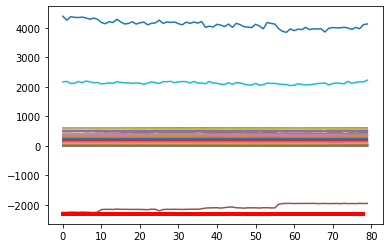

Predicción:  [[[0.8090342 0.1909658]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4893500e+01  9.7018000e+00  5.7624800e+01  7.6478400e+01
  6.0907500e+02  3.2406400e+01  1.0392800e+01  1.8413540e+02
  5.0000000e-04  8.1155400e+01  1.2330930e+02  7.9156000e+00
  6.3497100e+01  1.7842610e+02  2.1991700e+01  1.6624940e+02
  1.8380860e+02  6.9859200e+01 -4.0000000e-04  4.0972000e+00
  1.5804700e+01  6.8975000e+00  1.5003000e+00  7.1610200e+01
  1.4543000e+00  1.5150000e+00  9.0430600e+01  5.6691800e+01
  1.3422000e+00  1.2154000e+00  1.5837000e+00  1.3673000e+00
  1.5014050e+02  8.2600000e-01  8.2950000e-01 -1.9443734e+03
  2.0005810e+02  1.6061000e+00  1.3993000e+00  2.2132807e+03
  4.0290433e+03  1.8481450e+02  1.3957000e+00  1.3934000e+00
  7.9988000e+00  7.4006000e+00  1.7424000e+00  1.5860000e-01
  2.8474600e+01  5.2708450e+02  5.1977060e+02  5.1578180e+02
  5.1679560e+02  5.1665720e+02  3.1930200e+01  3.2138

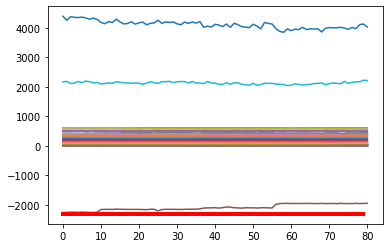

Predicción:  [[[0.7692407  0.23075935]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4452800e+01  9.5174000e+00  5.6086800e+01  7.6885200e+01
  6.0958420e+02  3.3105200e+01  1.0419000e+01  1.8398120e+02
  5.0000000e-04  8.1237200e+01  1.2448380e+02  8.1037000e+00
  6.3699200e+01  1.7910380e+02  2.2152800e+01  1.6613780e+02
  1.8337150e+02  7.0434800e+01 -4.0000000e-04  4.2187000e+00
  1.6370100e+01  6.9012000e+00  1.4983000e+00  7.1855300e+01
  1.4584000e+00  1.5195000e+00  9.0592000e+01  5.7432000e+01
  1.3468000e+00  1.2188000e+00  1.5834000e+00  1.3688000e+00
  1.5098890e+02  8.2340000e-01  8.2960000e-01 -1.9563036e+03
  2.0236200e+02  1.6093000e+00  1.4035000e+00  2.1814511e+03
  4.0865547e+03  1.8481450e+02  1.3969000e+00  1.3956000e+00
  7.9981000e+00  7.4017000e+00  1.7450000e+00  1.6180000e-01
  2.8120300e+01  5.2738440e+02  5.1999740e+02  5.1600260e+02
  5.1706850e+02  5.1686620e+02  3.1997100e+01  3.21

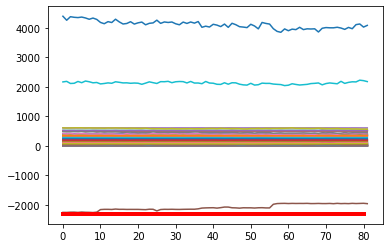

Predicción:  [[[0.802791 0.197209]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4713100e+01  9.5245000e+00  5.7920900e+01  7.6414100e+01
  6.1017910e+02  3.3764100e+01  1.0409300e+01  1.8391180e+02
  5.0000000e-04  8.1038300e+01  1.2528240e+02  7.8961000e+00
  6.4114900e+01  1.7964810e+02  2.2207100e+01  1.6630060e+02
  1.8326150e+02  7.0359200e+01 -4.0000000e-04  4.1871000e+00
  1.5757700e+01  6.8974000e+00  1.5209000e+00  7.1873100e+01
  1.4519000e+00  1.5155000e+00  9.1835300e+01  5.8196100e+01
  1.3395000e+00  1.2142000e+00  1.5777000e+00  1.3701000e+00
  1.5140170e+02  8.2370000e-01  8.2940000e-01 -1.9425271e+03
  2.0120960e+02  1.6069000e+00  1.3972000e+00  2.2407849e+03
  4.0820140e+03  1.8481450e+02  1.3981000e+00  1.3983000e+00
  8.0007000e+00  7.4001000e+00  1.7398000e+00  1.6220000e-01
  2.7770800e+01  5.2689780e+02  5.1940710e+02  5.1532290e+02
  5.1649960e+02  5.1627630e+02  3.1935000e+01  3.220340

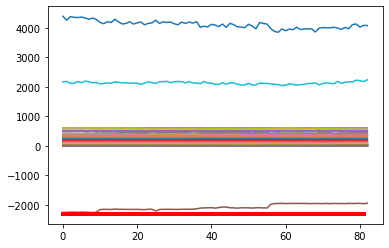

Predicción:  [[[0.785436   0.21456403]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5262000e+01  9.5679000e+00  5.7935400e+01  7.5661800e+01
  6.0918690e+02  3.3853100e+01  1.0436800e+01  1.8458420e+02
  5.0000000e-04  8.3987400e+01  1.2531060e+02  7.9387000e+00
  6.4506100e+01  1.8198070e+02  2.2183700e+01  1.6597740e+02
  1.8392380e+02  6.9935700e+01 -4.0000000e-04  4.1902000e+00
  1.6709300e+01  6.8887000e+00  1.5031000e+00  7.1801300e+01
  1.4761000e+00  1.5371000e+00  9.0906700e+01  5.6922700e+01
  1.3657000e+00  1.2363000e+00  1.5938000e+00  1.3871000e+00
  1.5126440e+02  8.2650000e-01  8.3020000e-01 -1.9499835e+03
  1.9951330e+02  1.6274000e+00  1.4225000e+00  2.2130456e+03
  4.0148923e+03  1.8481450e+02  1.4148000e+00  1.4124000e+00
  8.0020000e+00  7.4014000e+00  1.7607000e+00  1.6730000e-01
  2.7991100e+01  5.2625330e+02  5.1915140e+02  5.1498440e+02
  5.1617060e+02  5.1601920e+02  3.1294400e+01  3.23

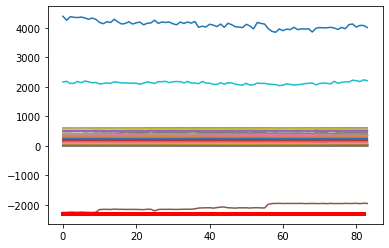

Predicción:  [[[0.7704943  0.22950572]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4251300e+01  9.9650000e+00  5.7749600e+01  7.6027300e+01
  6.0912030e+02  3.3408600e+01  1.0430100e+01  1.8504890e+02
  5.0000000e-04  8.4056600e+01  1.2596400e+02  7.9722000e+00
  6.4274700e+01  1.8152440e+02  2.2208000e+01  1.6594900e+02
  1.8453510e+02  7.0041600e+01 -4.0000000e-04  4.2132000e+00
  1.6807000e+01  6.9122000e+00  1.4986000e+00  7.1756800e+01
  1.4662000e+00  1.5287000e+00  9.0314100e+01  5.7356600e+01
  1.3544000e+00  1.2249000e+00  1.5828000e+00  1.3773000e+00
  1.5199070e+02  8.2500000e-01  8.3010000e-01 -1.9519961e+03
  1.9853180e+02  1.6189000e+00  1.4122000e+00  2.1449065e+03
  4.0887463e+03  1.8481450e+02  1.4045000e+00  1.4065000e+00
  7.9985000e+00  7.3996000e+00  1.7510000e+00  1.6850000e-01
  2.7098900e+01  5.2633110e+02  5.1930490e+02  5.1509890e+02
  5.1628000e+02  5.1614520e+02  3.2167600e+01  3.22

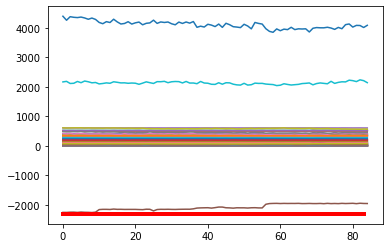

Predicción:  [[[0.7999858  0.20001419]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4487000e+01  9.7064000e+00  5.7841100e+01  7.6642800e+01
  6.0867160e+02  3.2967900e+01  1.0338000e+01  1.8504040e+02
  5.0000000e-04  8.3865500e+01  1.2597810e+02  8.0261000e+00
  6.3434400e+01  1.8105070e+02  2.2192100e+01  1.6605920e+02
  1.8434220e+02  7.0298200e+01 -4.0000000e-04  4.1984000e+00
  1.6908100e+01  6.8798000e+00  1.5009000e+00  7.1732100e+01
  1.4612000e+00  1.5249000e+00  9.1125000e+01  5.7938100e+01
  1.3481000e+00  1.2193000e+00  1.5787000e+00  1.3721000e+00
  1.5141920e+02  8.2550000e-01  8.2960000e-01 -1.9509291e+03
  2.0048460e+02  1.6161000e+00  1.4063000e+00  2.1583089e+03
  4.1104042e+03  1.8481450e+02  1.3996000e+00  1.3997000e+00
  7.9998000e+00  7.4018000e+00  1.7477000e+00  1.6880000e-01
  2.7388300e+01  5.2618440e+02  5.1906370e+02  5.1491880e+02
  5.1601510e+02  5.1593840e+02  3.2218800e+01  3.22

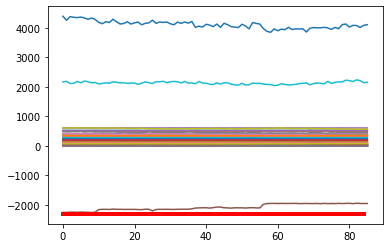

Predicción:  [[[0.8050464 0.1949536]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5014400e+01  9.6618000e+00  5.8401900e+01  7.7248800e+01
  6.1017820e+02  3.1162200e+01  1.0083400e+01  1.8499330e+02
  5.0000000e-04  8.3082200e+01  1.2589580e+02  8.1144000e+00
  6.4088300e+01  1.7889480e+02  2.2212500e+01  1.6595180e+02
  1.8449540e+02  7.0178800e+01 -4.0000000e-04  4.1120000e+00
  1.6153200e+01  6.9138000e+00  1.5018000e+00  7.1819900e+01
  1.4650000e+00  1.5254000e+00  9.0938000e+01  5.7800400e+01
  1.3524000e+00  1.2252000e+00  1.5895000e+00  1.3777000e+00
  1.5297280e+02  8.2650000e-01  8.2970000e-01 -1.9516673e+03
  2.0059770e+02  1.6168000e+00  1.4100000e+00  2.1967757e+03
  4.0665764e+03  1.8481450e+02  1.4048000e+00  1.4014000e+00
  8.0005000e+00  7.4006000e+00  1.7513000e+00  1.6210000e-01
  2.7335300e+01  5.2640000e+02  5.1917180e+02  5.1509710e+02
  5.1628110e+02  5.1610890e+02  3.2430200e+01  3.2240

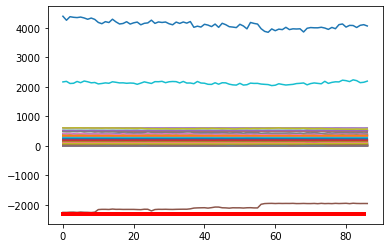

Predicción:  [[[0.7911285  0.20887147]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4932300e+01  9.6173000e+00  5.6031600e+01  7.6703600e+01
  6.0983550e+02  3.1449700e+01  1.0106800e+01  1.8511210e+02
  5.0000000e-04  8.2050000e+01  1.2603480e+02  7.9280000e+00
  6.4459700e+01  1.7866320e+02  2.2273300e+01  1.6616800e+02
  1.8445690e+02  7.0546400e+01 -4.0000000e-04  4.1271000e+00
  1.4896800e+01  6.9082000e+00  1.4989000e+00  7.2029900e+01
  1.4506000e+00  1.5141000e+00  9.0677300e+01  5.8085500e+01
  1.3387000e+00  1.2113000e+00  1.5772000e+00  1.3643000e+00
  1.5320460e+02  8.2670000e-01  8.2950000e-01 -1.9502569e+03
  2.0295250e+02  1.6052000e+00  1.3965000e+00  2.1660667e+03
  4.0138339e+03  1.8481450e+02  1.3930000e+00  1.3887000e+00
  8.0019000e+00  7.3990000e+00  1.7375000e+00  1.6060000e-01
  2.8641000e+01  5.2651770e+02  5.1933670e+02  5.1516210e+02
  5.1631340e+02  5.1611670e+02  3.2495200e+01  3.21

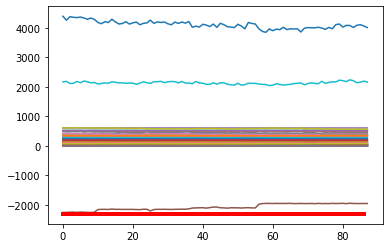

Predicción:  [[[0.7714413  0.22855867]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5333100e+01  9.6428000e+00  5.6387400e+01  7.4763500e+01
  6.1085180e+02  3.2149100e+01  1.0138800e+01  1.8499800e+02
  5.0000000e-04  8.0837500e+01  1.2568450e+02  7.9488000e+00
  6.4852100e+01  1.7848650e+02  2.2487000e+01  1.6619620e+02
  1.8435500e+02  7.0292600e+01 -4.0000000e-04  4.1993000e+00
  1.4960700e+01  6.8825000e+00  1.5008000e+00  7.1991400e+01
  1.4535000e+00  1.5173000e+00  9.0842400e+01  5.8201100e+01
  1.3396000e+00  1.2122000e+00  1.5815000e+00  1.3675000e+00
  1.5443680e+02  8.2740000e-01  8.3030000e-01 -1.9493857e+03
  2.0432700e+02  1.6086000e+00  1.3977000e+00  2.1497295e+03
  4.1468950e+03  1.8481450e+02  1.3971000e+00  1.3919000e+00
  7.9980000e+00  7.3995000e+00  1.7414000e+00  1.6000000e-01
  2.9255100e+01  5.2624890e+02  5.1910770e+02  5.1509250e+02
  5.1626650e+02  5.1607500e+02  3.2936400e+01  3.22

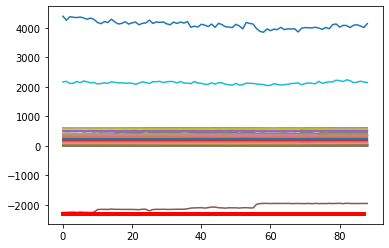

Predicción:  [[[0.8157043  0.18429573]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4848900e+01  9.7453000e+00  5.8324500e+01  7.5384000e+01
  6.0988790e+02  3.2004300e+01  1.0109000e+01  1.8500120e+02
  5.0000000e-04  8.0727700e+01  1.2605430e+02  7.8324000e+00
  6.5166900e+01  1.7880370e+02  2.2715200e+01  1.6598020e+02
  1.8442790e+02  7.0483800e+01 -4.0000000e-04  4.1985000e+00
  1.5678500e+01  6.9307000e+00  1.4990000e+00  7.2053400e+01
  1.4604000e+00  1.5263000e+00  9.0802700e+01  5.8593700e+01
  1.3494000e+00  1.2200000e+00  1.5850000e+00  1.3758000e+00
  1.5438430e+02  8.2590000e-01  8.2980000e-01 -1.9434015e+03
  2.0142810e+02  1.6169000e+00  1.4079000e+00  2.1747638e+03
  4.1469509e+03  1.8481450e+02  1.4041000e+00  1.4004000e+00
  8.0031000e+00  7.3996000e+00  1.7488000e+00  1.6370000e-01
  2.8279500e+01  5.2634890e+02  5.1947850e+02  5.1536780e+02
  5.1657980e+02  5.1633630e+02  3.2908400e+01  3.25

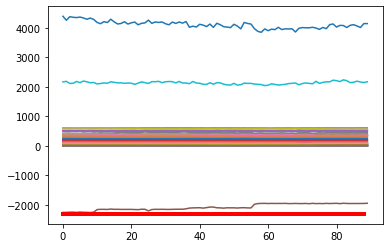

Predicción:  [[[0.8089858  0.19101413]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5723500e+01  9.7452000e+00  5.7990600e+01  7.6595000e+01
  6.0927520e+02  3.3016800e+01  1.0059700e+01  1.8499990e+02
  5.0000000e-04  8.1571600e+01  1.2609130e+02  7.8400000e+00
  6.5023000e+01  1.8067010e+02  2.2424200e+01  1.6614360e+02
  1.8423970e+02  7.0663000e+01 -4.0000000e-04  4.2065000e+00
  1.5763600e+01  6.8827000e+00  1.5009000e+00  7.1945500e+01
  1.4605000e+00  1.5237000e+00  9.0014800e+01  5.9208000e+01
  1.3449000e+00  1.2210000e+00  1.5831000e+00  1.3706000e+00
  1.5342340e+02  8.2490000e-01  8.3010000e-01 -1.9546403e+03
  1.9983040e+02  1.6142000e+00  1.4039000e+00  2.1679392e+03
  4.1264888e+03  1.8481450e+02  1.3980000e+00  1.3943000e+00
  7.9954000e+00  7.4006000e+00  1.7477000e+00  1.6450000e-01
  2.7605300e+01  5.2621770e+02  5.1956130e+02  5.1536640e+02
  5.1657930e+02  5.1633530e+02  3.1746900e+01  3.25

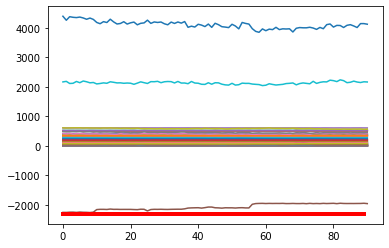

Predicción:  [[[0.8146208  0.18537922]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5871000e+01  9.7859000e+00  5.7352100e+01  7.5848500e+01
  6.1070860e+02  3.3981600e+01  1.0073600e+01  1.8507530e+02
  5.0000000e-04  8.1252100e+01  1.2595110e+02  7.9379000e+00
  6.4370800e+01  1.8149320e+02  2.2288300e+01  1.6576270e+02
  1.8418450e+02  7.0564000e+01 -4.0000000e-04  4.1939000e+00
  1.7201200e+01  6.9177000e+00  1.5000000e+00  7.1972800e+01
  1.4624000e+00  1.5269000e+00  9.0347000e+01  5.9315600e+01
  1.3482000e+00  1.2245000e+00  1.5779000e+00  1.3758000e+00
  1.5097040e+02  8.2570000e-01  8.2990000e-01 -1.9510487e+03
  2.0471940e+02  1.6173000e+00  1.4076000e+00  2.1527979e+03
  4.0623392e+03  1.8481450e+02  1.4037000e+00  1.3999000e+00
  8.0032000e+00  7.4014000e+00  1.7503000e+00  1.7240000e-01
  2.7710000e+01  5.2604890e+02  5.1917420e+02  5.1502170e+02
  5.1631050e+02  5.1606270e+02  3.1387300e+01  3.26

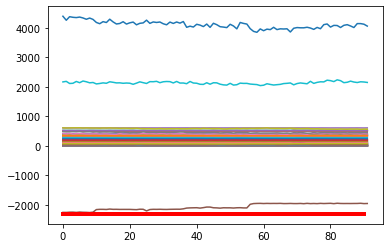

Predicción:  [[[0.7899668  0.21003315]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5465400e+01  9.8491000e+00  5.8280500e+01  7.7171700e+01
  6.0952360e+02  3.3880200e+01  1.0019300e+01  1.8504410e+02
  5.0000000e-04  8.1066700e+01  1.2586250e+02  7.9159000e+00
  6.3754600e+01  1.8141730e+02  2.2267900e+01  1.6589920e+02
  1.8397630e+02  7.0569100e+01 -4.0000000e-04  4.2109000e+00
  1.7240900e+01  6.8755000e+00  1.5004000e+00  7.2044200e+01
  1.4645000e+00  1.5273000e+00  8.9725000e+01  5.8691300e+01
  1.3501000e+00  1.2283000e+00  1.5773000e+00  1.3778000e+00
  1.5043260e+02  8.2410000e-01  8.2990000e-01 -1.9461553e+03
  2.0326340e+02  1.6169000e+00  1.4091000e+00  2.1813257e+03
  4.1050474e+03  1.8481450e+02  1.4058000e+00  1.4031000e+00
  7.9996000e+00  7.3909000e+00  1.7519000e+00  1.7450000e-01
  2.8056700e+01  5.2601780e+02  5.1986650e+02  5.1568870e+02
  5.1694220e+02  5.1666440e+02  3.1265800e+01  3.25

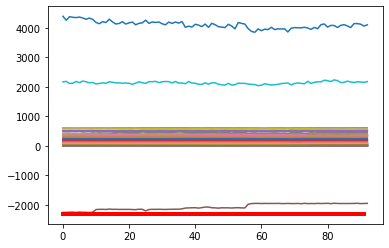

Predicción:  [[[0.79855865 0.20144132]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5636700e+01  9.7351000e+00  5.7527700e+01  7.4938000e+01
  6.0977870e+02  3.3232400e+01  1.0121500e+01  1.8500260e+02
  5.0000000e-04  8.1081200e+01  1.2626590e+02  8.0568000e+00
  6.4507700e+01  1.8009690e+02  2.2290500e+01  1.6574260e+02
  1.8386730e+02  7.0419700e+01 -4.0000000e-04  4.1956000e+00
  1.6663500e+01  6.9200000e+00  1.5008000e+00  7.2081700e+01
  1.4552000e+00  1.5172000e+00  8.9695900e+01  5.8749300e+01
  1.3401000e+00  1.2194000e+00  1.5719000e+00  1.3680000e+00
  1.5002780e+02  8.2570000e-01  8.2990000e-01 -1.9533094e+03
  2.0356380e+02  1.6074000e+00  1.3991000e+00  2.1344605e+03
  4.0618078e+03  1.8481450e+02  1.3984000e+00  1.3934000e+00
  7.9982000e+00  7.3995000e+00  1.7418000e+00  1.6960000e-01
  3.0262000e+01  5.2486890e+02  5.1882140e+02  5.1434760e+02
  5.1553630e+02  5.1543600e+02  3.0626900e+01  3.19

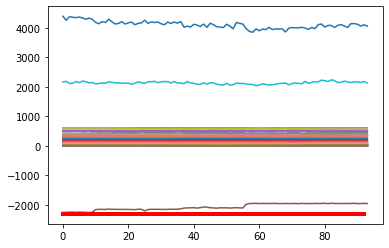

Predicción:  [[[0.7925704  0.20742959]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6418300e+01  9.8153000e+00  5.7923500e+01  7.2992600e+01
  6.0950510e+02  3.3676700e+01  1.0253200e+01  1.8508840e+02
  5.0000000e-04  8.1048600e+01  1.2562610e+02  7.9367000e+00
  6.3806100e+01  1.8013320e+02  2.2293900e+01  1.6578270e+02
  1.8438580e+02  7.0394300e+01 -4.0000000e-04  4.2000000e+00
  1.7058800e+01  6.8995000e+00  1.4972000e+00  7.2163500e+01
  1.4831000e+00  1.5449000e+00  9.0253600e+01  5.7935200e+01
  1.3638000e+00  1.2426000e+00  1.5971000e+00  1.3913000e+00
  1.4798270e+02  8.2770000e-01  8.3010000e-01 -1.9501669e+03
  2.0029380e+02  1.6351000e+00  1.4221000e+00  2.1787931e+03
  4.0711146e+03  1.8481450e+02  1.4243000e+00  1.4177000e+00
  7.9993000e+00  7.4017000e+00  1.7698000e+00  1.7270000e-01
  3.3050300e+01  5.2478220e+02  5.1831300e+02  5.1422870e+02
  5.1553430e+02  5.1531930e+02  3.0148900e+01  3.15

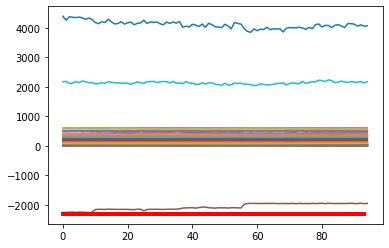

Predicción:  [[[0.79183227 0.20816775]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5987000e+01  9.9607000e+00  5.8557300e+01  7.5399700e+01
  6.0969180e+02  3.3960500e+01  1.0139600e+01  1.8504760e+02
  5.0000000e-04  8.1441200e+01  1.2551280e+02  7.9006000e+00
  6.3803200e+01  1.8103200e+02  2.2335500e+01  1.6581770e+02
  1.8458240e+02  7.0609500e+01 -4.0000000e-04  4.2093000e+00
  1.8189400e+01  6.8730000e+00  1.5003000e+00  7.2373400e+01
  1.4956000e+00  1.5591000e+00  9.0754800e+01  5.7509700e+01
  1.3839000e+00  1.2531000e+00  1.6038000e+00  1.4055000e+00
  1.4937530e+02  8.2590000e-01  8.2950000e-01 -1.9506190e+03
  2.0324090e+02  1.6504000e+00  1.4416000e+00  2.1921045e+03
  4.0504380e+03  1.8481450e+02  1.4357000e+00  1.4332000e+00
  7.9978000e+00  7.4050000e+00  1.7845000e+00  1.8070000e-01
  3.0159100e+01  5.2674670e+02  5.1940030e+02  5.1592020e+02
  5.1687470e+02  5.1683180e+02  3.0736700e+01  3.19

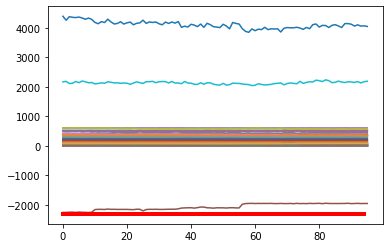

Predicción:  [[[0.7832304 0.2167695]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6134800e+01  9.8817000e+00  5.7694400e+01  7.6412200e+01
  6.1071170e+02  3.4135300e+01  1.0051200e+01  1.8498440e+02
  5.0000000e-04  8.1470200e+01  1.2602640e+02  7.9016000e+00
  6.4986900e+01  1.8285750e+02  2.2289100e+01  1.6603320e+02
  1.8394160e+02  7.0810600e+01 -4.0000000e-04  4.2099000e+00
  1.6378500e+01  6.8962000e+00  1.5002000e+00  7.2438000e+01
  1.4731000e+00  1.5368000e+00  9.1373700e+01  5.8610200e+01
  1.3648000e+00  1.2371000e+00  1.5763000e+00  1.3915000e+00
  1.5112820e+02  8.2530000e-01  8.2960000e-01 -1.9427281e+03
  2.0317090e+02  1.6278000e+00  1.4230000e+00  2.1838031e+03
  4.0030822e+03  1.8481450e+02  1.4210000e+00  1.4171000e+00
  7.9972000e+00  7.3960000e+00  1.7588000e+00  1.8230000e-01
  2.9256000e+01  5.2690440e+02  5.2080920e+02  5.1642580e+02
  5.1734970e+02  5.1733850e+02  3.0845200e+01  3.2018

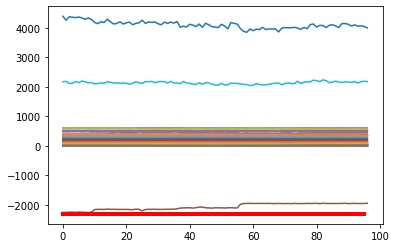

Predicción:  [[[0.7581656 0.2418344]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5618800e+01  9.9394000e+00  5.8311000e+01  7.4441600e+01
  6.1019040e+02  3.3179500e+01  1.0049400e+01  1.8504190e+02
  5.0000000e-04  8.1623000e+01  1.2599390e+02  8.0468000e+00
  6.4844500e+01  1.8079240e+02  2.2305000e+01  1.6624480e+02
  1.8393640e+02  7.0378000e+01 -4.0000000e-04  4.2082000e+00
  1.6734500e+01  6.9039000e+00  1.5007000e+00  7.2348600e+01
  1.4740000e+00  1.5356000e+00  8.9443900e+01  5.8054900e+01
  1.3588000e+00  1.2390000e+00  1.5826000e+00  1.3867000e+00
  1.4946650e+02  8.2520000e-01  8.2970000e-01 -1.9609848e+03
  2.0109430e+02  1.6249000e+00  1.4171000e+00  2.1458740e+03
  4.1399470e+03  1.8481450e+02  1.4182000e+00  1.4077000e+00
  8.0007000e+00  7.3995000e+00  1.7616000e+00  1.7880000e-01
  3.1805400e+01  5.2446660e+02  5.1878390e+02  5.1433310e+02
  5.1545230e+02  5.1536410e+02  3.0451500e+01  3.1706

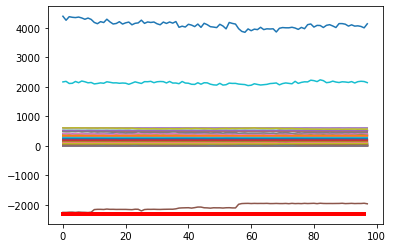

Predicción:  [[[0.8261683  0.17383167]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5463600e+01  9.8225000e+00  5.5982300e+01  7.4512200e+01
  6.1023330e+02  3.2578000e+01  1.0097400e+01  1.8502680e+02
  5.0000000e-04  8.1077900e+01  1.2605790e+02  7.9939000e+00
  6.3282900e+01  1.7960790e+02  2.2304800e+01  1.6608740e+02
  1.8404910e+02  7.0614900e+01 -4.0000000e-04  4.2087000e+00
  1.7614100e+01  6.9018000e+00  1.5002000e+00  7.2395100e+01
  1.4952000e+00  1.5572000e+00  9.0484900e+01  5.7948700e+01
  1.3772000e+00  1.2578000e+00  1.6082000e+00  1.4066000e+00
  1.4899600e+02  8.2540000e-01  8.3000000e-01 -1.9483837e+03
  2.0335060e+02  1.6472000e+00  1.4352000e+00  2.1627521e+03
  4.1617406e+03  1.8481450e+02  1.4395000e+00  1.4278000e+00
  8.0021000e+00  7.3999000e+00  1.7832000e+00  1.7450000e-01
  3.2943500e+01  5.2501340e+02  5.1835580e+02  5.1429940e+02
  5.1540710e+02  5.1538300e+02  3.0232400e+01  3.15

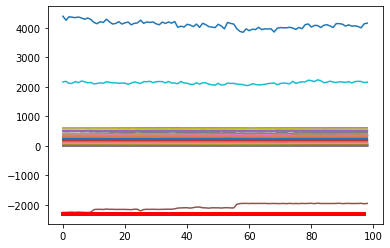

Predicción:  [[[0.81959635 0.18040365]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6231600e+01  9.8057000e+00  5.5695100e+01  7.5361400e+01
  6.0986120e+02  3.2413100e+01  1.0102000e+01  1.8498020e+02
  5.0000000e-04  8.0667700e+01  1.2605840e+02  7.9444000e+00
  6.4772900e+01  1.7914430e+02  2.2302800e+01  1.6601940e+02
  1.8419250e+02  7.0701600e+01 -4.0000000e-04  4.1899000e+00
  1.6372600e+01  6.9057000e+00  1.4998000e+00  7.2404300e+01
  1.4845000e+00  1.5447000e+00  8.9306000e+01  5.7433200e+01
  1.3678000e+00  1.2458000e+00  1.5970000e+00  1.3944000e+00
  1.5224570e+02  8.2710000e-01  8.3070000e-01 -1.9475804e+03
  2.0163100e+02  1.6346000e+00  1.4256000e+00  2.1683073e+03
  4.0626043e+03  1.8481450e+02  1.4278000e+00  1.4158000e+00
  8.0024000e+00  7.4004000e+00  1.7684000e+00  1.7110000e-01
  3.3889400e+01  5.2626880e+02  5.1927300e+02  5.1525800e+02
  5.1638430e+02  5.1624230e+02  3.0331000e+01  3.16

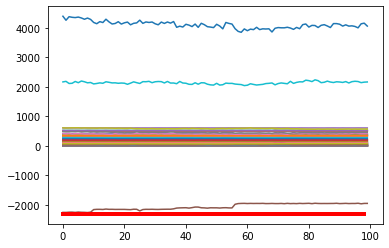

Predicción:  [[[0.78618246 0.21381757]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6225100e+01  1.0008300e+01  5.8242400e+01  7.5437300e+01
  6.0908580e+02  3.2367300e+01  1.0087300e+01  1.8490400e+02
  5.0000000e-04  8.0783300e+01  1.2585800e+02  7.9085000e+00
  6.5472100e+01  1.7911310e+02  2.2328700e+01  1.6610750e+02
  1.8407470e+02  7.0693700e+01 -4.0000000e-04  4.1991000e+00
  1.4804400e+01  6.8872000e+00  1.4996000e+00  7.2428600e+01
  1.4790000e+00  1.5458000e+00  9.0269900e+01  5.8051000e+01
  1.3659000e+00  1.2430000e+00  1.5954000e+00  1.3992000e+00
  1.5335180e+02  8.2360000e-01  8.2980000e-01 -1.9451666e+03
  2.0542140e+02  1.6362000e+00  1.4237000e+00  2.1843392e+03
  4.1921106e+03  1.8481450e+02  1.4297000e+00  1.4234000e+00
  7.9976000e+00  7.4001000e+00  1.7684000e+00  1.7280000e-01
  3.0232200e+01  5.2718010e+02  5.1977290e+02  5.1575660e+02
  5.1685120e+02  5.1682450e+02  3.0363100e+01  3.15

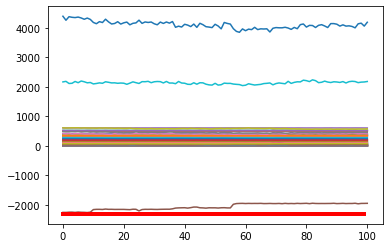

Predicción:  [[[0.82527393 0.17472608]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6044800e+01  9.7986000e+00  5.7996400e+01  7.5196700e+01
  6.1073030e+02  3.2544700e+01  1.0122800e+01  1.8503390e+02
  5.0000000e-04  8.0730000e+01  1.2605290e+02  7.9493000e+00
  6.5080800e+01  1.7994680e+02  2.2249700e+01  1.6569380e+02
  1.8395440e+02  7.0857800e+01 -4.0000000e-04  4.2117000e+00
  1.5220800e+01  6.9052000e+00  1.5008000e+00  7.2398100e+01
  1.4787000e+00  1.5426000e+00  9.0511200e+01  5.8243800e+01
  1.3646000e+00  1.2402000e+00  1.5932000e+00  1.3936000e+00
  1.5240270e+02  8.2410000e-01  8.3000000e-01 -1.9466326e+03
  2.0243770e+02  1.6319000e+00  1.4226000e+00  2.1786849e+03
  4.0376707e+03  1.8481450e+02  1.4237000e+00  1.4196000e+00
  8.0041000e+00  7.4028000e+00  1.7664000e+00  1.7320000e-01
  2.9842200e+01  5.2580220e+02  5.1937630e+02  5.1490310e+02
  5.1592730e+02  5.1595910e+02  3.0328900e+01  3.14

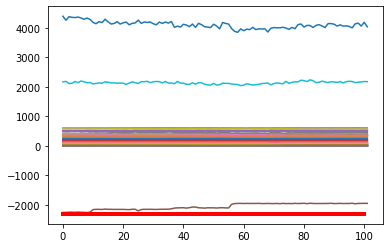

Predicción:  [[[0.77550447 0.22449549]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6303600e+01  9.7290000e+00  5.8357800e+01  7.5474300e+01
  6.1027560e+02  3.3252900e+01  1.0055200e+01  1.8505330e+02
  5.0000000e-04  8.0976500e+01  1.2595240e+02  8.0126000e+00
  6.4275300e+01  1.8078140e+02  2.2323900e+01  1.6602760e+02
  1.8392710e+02  7.0711400e+01 -4.0000000e-04  4.1990000e+00
  1.6793800e+01  6.9129000e+00  1.4984000e+00  7.2349800e+01
  1.4826000e+00  1.5471000e+00  9.0769100e+01  5.8323500e+01
  1.3666000e+00  1.2451000e+00  1.5916000e+00  1.3948000e+00
  1.5006200e+02  8.2570000e-01  8.3040000e-01 -1.9525158e+03
  2.0271280e+02  1.6379000e+00  1.4249000e+00  2.1592041e+03
  4.0203162e+03  1.8481450e+02  1.4253000e+00  1.4191000e+00
  7.9972000e+00  7.3988000e+00  1.7709000e+00  1.7950000e-01
  3.0482700e+01  5.2644890e+02  5.1920300e+02  5.1514920e+02
  5.1613740e+02  5.1621740e+02  3.0370400e+01  3.15

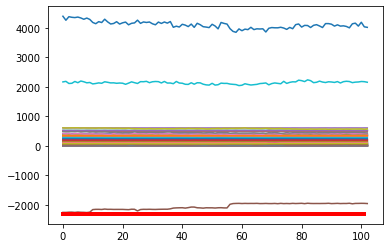

Predicción:  [[[0.77633566 0.22366436]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6456700e+01  9.8941000e+00  5.7128400e+01  7.4885000e+01
  6.1040690e+02  3.3336300e+01  1.0045800e+01  1.8488890e+02
  5.0000000e-04  8.1233400e+01  1.2594880e+02  7.8019000e+00
  6.3767300e+01  1.8099640e+02  2.2351400e+01  1.6601670e+02
  1.8414750e+02  7.0510400e+01 -4.0000000e-04  4.1933000e+00
  1.7745800e+01  6.8943000e+00  1.5013000e+00  7.2387800e+01
  1.5073000e+00  1.5697000e+00  8.9128600e+01  5.7861900e+01
  1.3911000e+00  1.2700000e+00  1.6129000e+00  1.4199000e+00
  1.4941680e+02  8.2720000e-01  8.2980000e-01 -1.9431722e+03
  2.0350090e+02  1.6584000e+00  1.4494000e+00  2.2017710e+03
  4.0554741e+03  1.8481450e+02  1.4535000e+00  1.4427000e+00
  7.9992000e+00  7.3904000e+00  1.7935000e+00  1.8060000e-01
  3.3692500e+01  5.2619780e+02  5.1896510e+02  5.1480190e+02
  5.1596410e+02  5.1603590e+02  3.1544300e+01  3.18

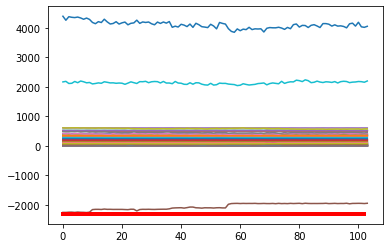

Predicción:  [[[0.7776672 0.2223327]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6652500e+01  9.9544000e+00  5.4766000e+01  7.5701100e+01
  6.0909730e+02  3.3213000e+01  1.0050500e+01  1.8499600e+02
  5.0000000e-04  8.1262000e+01  1.2588750e+02  7.9195000e+00
  6.3785500e+01  1.8132070e+02  2.1980000e+01  1.6621950e+02
  1.8412520e+02  7.0710900e+01 -4.0000000e-04  4.2047000e+00
  1.7879000e+01  6.8909000e+00  1.5021000e+00  7.2434200e+01
  1.5073000e+00  1.5694000e+00  8.9348000e+01  5.8432500e+01
  1.3928000e+00  1.2724000e+00  1.6147000e+00  1.4246000e+00
  1.5041370e+02  8.2810000e-01  8.2980000e-01 -1.9578848e+03
  2.0254540e+02  1.6576000e+00  1.4512000e+00  2.1918366e+03
  4.1206160e+03  1.8481450e+02  1.4584000e+00  1.4496000e+00
  7.9996000e+00  7.4049000e+00  1.7939000e+00  1.7900000e-01
  3.3638100e+01  5.2670220e+02  5.1954230e+02  5.1542950e+02
  5.1644330e+02  5.1655860e+02  3.1532300e+01  3.2105

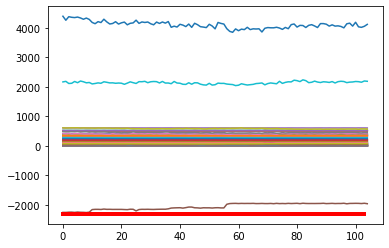

Predicción:  [[[0.81541944 0.18458058]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6632900e+01  9.9824000e+00  5.6468900e+01  7.5508700e+01
  6.1051650e+02  3.3327100e+01  1.0078600e+01  1.8496130e+02
  5.0000000e-04  8.1742100e+01  1.2625750e+02  7.8531000e+00
  6.5374100e+01  1.8082010e+02  2.2012300e+01  1.6584670e+02
  1.8382800e+02  7.0899600e+01 -4.0000000e-04  4.1955000e+00
  1.5823900e+01  6.8884000e+00  1.5020000e+00  7.2400700e+01
  1.4811000e+00  1.5473000e+00  8.8706800e+01  5.9377900e+01
  1.3684000e+00  1.2449000e+00  1.5911000e+00  1.3988000e+00
  1.5280650e+02  8.2790000e-01  8.2970000e-01 -1.9450346e+03
  2.0335100e+02  1.6370000e+00  1.4278000e+00  2.1881064e+03
  4.1730672e+03  1.8481450e+02  1.4325000e+00  1.4265000e+00
  8.0019000e+00  7.4030000e+00  1.7668000e+00  1.7620000e-01
  3.3632600e+01  5.2718230e+02  5.1936920e+02  5.1507750e+02
  5.1602280e+02  5.1613810e+02  3.1695500e+01  3.17

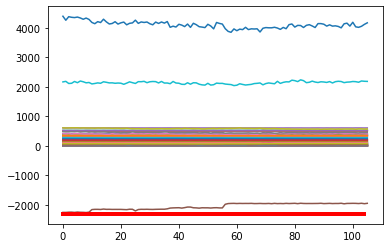

Predicción:  [[[0.8198309  0.18016909]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6500700e+01  9.9152000e+00  5.5861800e+01  7.4819600e+01
  6.1059770e+02  3.3571200e+01  1.0077400e+01  1.8496780e+02
  5.0000000e-04  8.2173100e+01  1.2592670e+02  8.0589000e+00
  6.4848800e+01  1.8081910e+02  2.1985000e+01  1.6578180e+02
  1.8388880e+02  7.0731700e+01 -4.0000000e-04  4.1953000e+00
  1.6040500e+01  6.9015000e+00  1.4999000e+00  7.2445400e+01
  1.4783000e+00  1.5434000e+00  8.9956100e+01  5.9204500e+01
  1.3636000e+00  1.2408000e+00  1.5887000e+00  1.3930000e+00
  1.5157460e+02  8.2830000e-01  8.3030000e-01 -1.9493311e+03
  2.0384130e+02  1.6336000e+00  1.4230000e+00  2.1540924e+03
  4.1853750e+03  1.8481450e+02  1.4269000e+00  1.4209000e+00
  7.9989000e+00  7.3989000e+00  1.7652000e+00  1.7640000e-01
  3.3794500e+01  5.2713550e+02  5.1885310e+02  5.1477600e+02
  5.1576690e+02  5.1585880e+02  3.1954400e+01  3.20

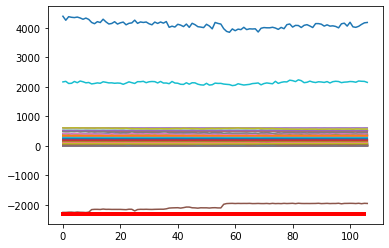

Predicción:  [[[0.8273187  0.17268127]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6664400e+01  9.8942000e+00  5.6034100e+01  7.5289400e+01
  6.0990830e+02  3.4607300e+01  1.0117000e+01  1.8493610e+02
  5.0000000e-04  8.0746500e+01  1.2595460e+02  8.0648000e+00
  6.3359300e+01  1.8030140e+02  2.1982200e+01  1.6597980e+02
  1.8394930e+02  7.0738200e+01 -4.0000000e-04  4.1936000e+00
  1.6927200e+01  6.9017000e+00  1.4999000e+00  7.2336500e+01
  1.4858000e+00  1.5496000e+00  8.8184800e+01  5.9405300e+01
  1.3697000e+00  1.2467000e+00  1.5968000e+00  1.3941000e+00
  1.5052480e+02  8.2830000e-01  8.3030000e-01 -1.9551027e+03
  2.0242480e+02  1.6379000e+00  1.4290000e+00  2.1851823e+03
  4.1145235e+03  1.8481450e+02  1.4274000e+00  1.4244000e+00
  7.9986000e+00  7.4001000e+00  1.7726000e+00  1.7560000e-01
  3.3612200e+01  5.2739780e+02  5.1856790e+02  5.1453600e+02
  5.1562610e+02  5.1559720e+02  3.1773500e+01  3.19

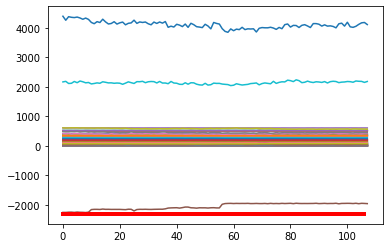

Predicción:  [[[0.81084263 0.18915741]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6697300e+01  9.9568000e+00  5.5945600e+01  7.6440700e+01
  6.0972610e+02  3.4820600e+01  1.0140100e+01  1.8503290e+02
  5.0000000e-04  8.0163900e+01  1.2582280e+02  8.0766000e+00
  6.3655900e+01  1.8006850e+02  2.2022200e+01  1.6592880e+02
  1.8397950e+02  7.0662100e+01 -4.0000000e-04  4.2136000e+00
  1.6749600e+01  6.9142000e+00  1.5004000e+00  7.2434800e+01
  1.4893000e+00  1.5540000e+00  8.8040400e+01  5.9809000e+01
  1.3738000e+00  1.2490000e+00  1.5961000e+00  1.4014000e+00
  1.5076160e+02  8.2860000e-01  8.3020000e-01 -1.9476236e+03
  2.0275590e+02  1.6417000e+00  1.4335000e+00  2.1639886e+03
  4.0156908e+03  1.8481450e+02  1.4338000e+00  1.4285000e+00
  7.9998000e+00  7.4017000e+00  1.7745000e+00  1.7840000e-01
  3.2385200e+01  5.2800000e+02  5.1909870e+02  5.1541410e+02
  5.1651670e+02  5.1626070e+02  3.2029500e+01  3.21

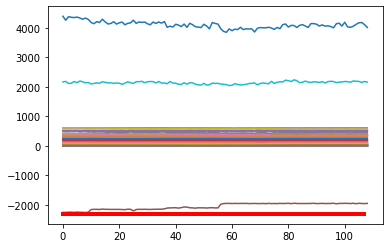

Predicción:  [[[0.76882935 0.2311706 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7125700e+01  9.8559000e+00  5.7872600e+01  7.6926100e+01
  6.1014900e+02  3.6164900e+01  1.0161200e+01  1.8504050e+02
  5.0000000e-04  7.8411500e+01  1.2589700e+02  7.8420000e+00
  6.4592900e+01  1.8181900e+02  2.1992900e+01  1.6591050e+02
  1.8371350e+02  7.0777200e+01 -4.0000000e-04  4.1927000e+00
  1.6105300e+01  6.9007000e+00  1.5002000e+00  7.2389200e+01
  1.4813000e+00  1.5482000e+00  9.0053500e+01  5.9350900e+01
  1.3703000e+00  1.2449000e+00  1.5870000e+00  1.3980000e+00
  1.5232300e+02  8.2630000e-01  8.2960000e-01 -1.9459100e+03
  2.0271440e+02  1.6388000e+00  1.4297000e+00  2.1874239e+03
  4.1263612e+03  1.8481450e+02  1.4283000e+00  1.4208000e+00
  8.0003000e+00  7.3992000e+00  1.7670000e+00  1.7990000e-01
  3.0267000e+01  5.2816890e+02  5.1988750e+02  5.1570150e+02
  5.1683160e+02  5.1649630e+02  3.2001500e+01  3.21

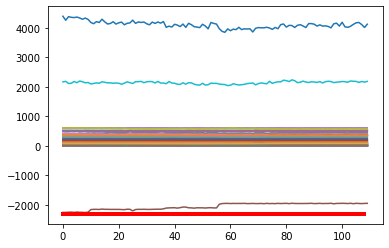

Predicción:  [[[0.804982   0.19501802]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7413500e+01  9.7062000e+00  5.7448100e+01  7.6022000e+01
  6.0985130e+02  3.4834200e+01  1.0052700e+01  1.8499210e+02
  5.0000000e-04  7.8277300e+01  1.2598650e+02  7.9865000e+00
  6.4677800e+01  1.8009380e+02  2.2006100e+01  1.6621280e+02
  1.8356250e+02  7.0706600e+01 -4.0000000e-04  4.1884000e+00
  1.6154000e+01  6.8794000e+00  1.4998000e+00  7.2359500e+01
  1.4861000e+00  1.5508000e+00  9.0441400e+01  5.8843400e+01
  1.3708000e+00  1.2504000e+00  1.5945000e+00  1.4007000e+00
  1.5201610e+02  8.2580000e-01  8.2990000e-01 -1.9525192e+03
  2.0321220e+02  1.6419000e+00  1.4292000e+00  2.2043397e+03
  4.1061607e+03  1.8481450e+02  1.4348000e+00  1.4254000e+00
  8.0035000e+00  7.4038000e+00  1.7731000e+00  1.7850000e-01
  3.4143000e+01  5.2756440e+02  5.1914870e+02  5.1543110e+02
  5.1618720e+02  5.1610570e+02  3.2003700e+01  3.19

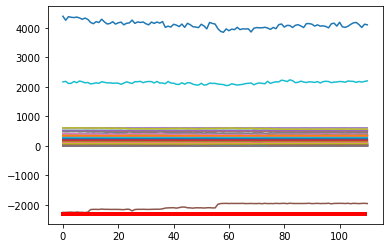

Predicción:  [[[0.80471605 0.19528393]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7356400e+01  9.8677000e+00  5.7202400e+01  7.5797900e+01
  6.0942440e+02  3.6077800e+01  1.0082100e+01  1.8494570e+02
  5.0000000e-04  7.6255700e+01  1.2601160e+02  7.9681000e+00
  6.4113200e+01  1.7923920e+02  2.2024100e+01  1.6614640e+02
  1.8371300e+02  7.1016200e+01 -4.0000000e-04  4.2111000e+00
  1.5206700e+01  6.8871000e+00  1.4990000e+00  7.2368800e+01
  1.4677000e+00  1.5317000e+00  9.0288800e+01  5.9661100e+01
  1.3557000e+00  1.2320000e+00  1.5803000e+00  1.3832000e+00
  1.5056430e+02  8.2750000e-01  8.2990000e-01 -1.9487708e+03
  2.0483440e+02  1.6216000e+00  1.4158000e+00  2.1855274e+03
  4.1327206e+03  1.8481450e+02  1.4145000e+00  1.4100000e+00
  8.0018000e+00  7.3990000e+00  1.7548000e+00  1.7460000e-01
  3.1538300e+01  5.2681780e+02  5.1864740e+02  5.1480200e+02
  5.1550060e+02  5.1538520e+02  3.2201000e+01  3.20

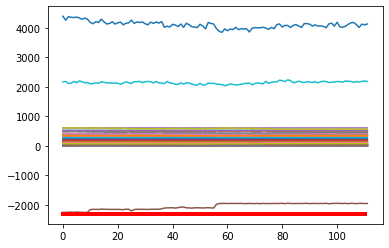

Predicción:  [[[0.8101244  0.18987559]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7064300e+01  9.8943000e+00  5.7848500e+01  7.5468600e+01
  6.0846160e+02  3.4973800e+01  1.0056700e+01  1.8506270e+02
  5.0000000e-04  7.4802200e+01  1.2597800e+02  7.9969000e+00
  6.4962400e+01  1.7679320e+02  2.2010700e+01  1.6616040e+02
  1.8376160e+02  7.0931100e+01 -4.0000000e-04  4.2178000e+00
  1.4837100e+01  6.8874000e+00  1.4996000e+00  7.2384500e+01
  1.4686000e+00  1.5360000e+00  9.0355500e+01  6.0105400e+01
  1.3556000e+00  1.2323000e+00  1.5877000e+00  1.3874000e+00
  1.5166550e+02  8.2790000e-01  8.2970000e-01 -1.9438452e+03
  2.0427960e+02  1.6259000e+00  1.4154000e+00  2.1842760e+03
  4.1854029e+03  1.8481450e+02  1.4168000e+00  1.4131000e+00
  7.9970000e+00  7.3999000e+00  1.7583000e+00  1.7060000e-01
  2.9109300e+01  5.2753330e+02  5.1868310e+02  5.1498560e+02
  5.1590540e+02  5.1570490e+02  3.2157200e+01  3.19

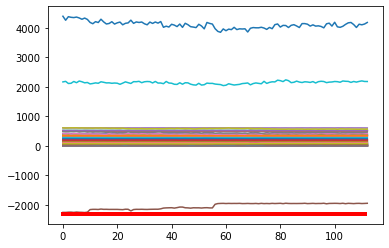

Predicción:  [[[0.82175314 0.1782469 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6918100e+01  1.0069000e+01  5.6493700e+01  7.5390100e+01
  6.0987650e+02  3.3813200e+01  1.0071300e+01  1.8503020e+02
  5.0000000e-04  7.4715400e+01  1.2614640e+02  7.9729000e+00
  6.4492700e+01  1.7656040e+02  2.2045000e+01  1.6606400e+02
  1.8395250e+02  7.0878500e+01 -4.0000000e-04  4.2054000e+00
  1.3793600e+01  6.9047000e+00  1.4990000e+00  7.2420400e+01
  1.4704000e+00  1.5360000e+00  8.8633700e+01  5.9970900e+01
  1.3593000e+00  1.2318000e+00  1.5947000e+00  1.3834000e+00
  1.5304290e+02  8.2840000e-01  8.3030000e-01 -1.9562384e+03
  2.0214820e+02  1.6253000e+00  1.4193000e+00  2.2017217e+03
  4.0826717e+03  1.8481450e+02  1.4133000e+00  1.4092000e+00
  8.0022000e+00  7.4003000e+00  1.7595000e+00  1.6470000e-01
  3.0149900e+01  5.2788220e+02  5.1903540e+02  5.1526480e+02
  5.1623090e+02  5.1606500e+02  3.1902700e+01  3.18

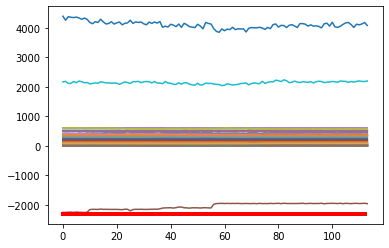

Predicción:  [[[0.8012453  0.19875471]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7003800e+01  1.0020500e+01  5.6434400e+01  7.6109500e+01
  6.0862010e+02  3.4022600e+01  1.0071900e+01  1.8500520e+02
  5.0000000e-04  7.4049500e+01  1.2653500e+02  8.1283000e+00
  6.4043000e+01  1.7715090e+02  2.2022500e+01  1.6601230e+02
  1.8376300e+02  7.0631600e+01 -4.0000000e-04  4.1991000e+00
  1.4365300e+01  6.9401000e+00  1.5009000e+00  7.2349300e+01
  1.4706000e+00  1.5357000e+00  8.7798500e+01  5.9875400e+01
  1.3582000e+00  1.2327000e+00  1.5905000e+00  1.3814000e+00
  1.5298760e+02  8.2810000e-01  8.2990000e-01 -1.9556642e+03
  2.0266170e+02  1.6252000e+00  1.4179000e+00  2.1468096e+03
  4.0590761e+03  1.8481450e+02  1.4094000e+00  1.4064000e+00
  7.9975000e+00  7.3961000e+00  1.7595000e+00  1.6890000e-01
  2.8320900e+01  5.2773560e+02  5.1944950e+02  5.1527200e+02
  5.1626830e+02  5.1618100e+02  3.1805600e+01  3.17

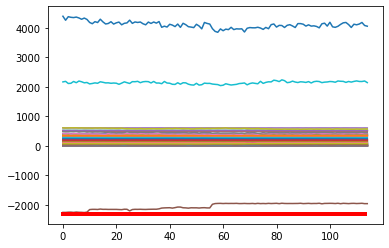

Predicción:  [[[0.7931329  0.20686714]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7241100e+01  1.0059200e+01  5.5448500e+01  7.5506500e+01
  6.0941860e+02  3.3780200e+01  1.0188700e+01  1.8534030e+02
  5.0000000e-04  7.3458700e+01  1.2619630e+02  8.0124000e+00
  6.5179800e+01  1.7504040e+02  2.2003200e+01  1.6586030e+02
  1.8405220e+02  7.0875700e+01 -4.0000000e-04  4.2061000e+00
  1.3817100e+01  6.8840000e+00  1.4995000e+00  7.2387500e+01
  1.4634000e+00  1.5303000e+00  8.9763900e+01  6.0139900e+01
  1.3496000e+00  1.2258000e+00  1.5885000e+00  1.3776000e+00
  1.5162700e+02  8.2670000e-01  8.2960000e-01 -1.9494794e+03
  2.0182900e+02  1.6190000e+00  1.4100000e+00  2.1634203e+03
  4.1373046e+03  1.8481450e+02  1.4091000e+00  1.4036000e+00
  8.0016000e+00  7.3997000e+00  1.7556000e+00  1.6710000e-01
  3.1368900e+01  5.2678230e+02  5.1865920e+02  5.1446510e+02
  5.1550550e+02  5.1534090e+02  3.1553900e+01  3.15

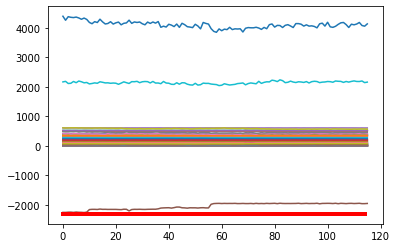

Predicción:  [[[0.81287694 0.18712309]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7093800e+01  9.9403000e+00  5.8225200e+01  7.5182900e+01
  6.0995760e+02  3.4244900e+01  1.0181000e+01  1.8588580e+02
  5.0000000e-04  7.3092400e+01  1.2591830e+02  8.1586000e+00
  6.4901900e+01  1.7657150e+02  2.1926700e+01  1.6596020e+02
  1.8488990e+02  7.0789400e+01 -4.0000000e-04  4.1887000e+00
  1.5626800e+01  6.9098000e+00  1.5003000e+00  7.2396000e+01
  1.4782000e+00  1.5438000e+00  8.8087400e+01  5.9247900e+01
  1.3635000e+00  1.2368000e+00  1.5965000e+00  1.3887000e+00
  1.5162220e+02  8.2780000e-01  8.2990000e-01 -1.9496371e+03
  2.0438440e+02  1.6325000e+00  1.4228000e+00  2.1989011e+03
  4.0267126e+03  1.8481450e+02  1.4211000e+00  1.4131000e+00
  8.0011000e+00  7.3994000e+00  1.7695000e+00  1.7300000e-01
  3.2174300e+01  5.2763110e+02  5.1847470e+02  5.1491890e+02
  5.1600880e+02  5.1584010e+02  3.1907100e+01  3.17

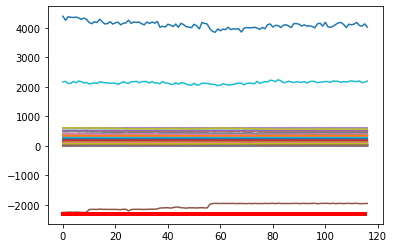

Predicción:  [[[0.7748613  0.22513875]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7102300e+01  9.9082000e+00  5.9262200e+01  7.6569000e+01
  6.1037160e+02  3.4438300e+01  1.0083400e+01  1.8628380e+02
  5.0000000e-04  7.2503300e+01  1.2606990e+02  8.0021000e+00
  6.5241700e+01  1.7740920e+02  2.1500400e+01  1.6613120e+02
  1.8559560e+02  7.0783300e+01 -4.0000000e-04  4.1376000e+00
  1.4882500e+01  6.9158000e+00  1.5001000e+00  7.2422100e+01
  1.4560000e+00  1.5221000e+00  8.9152600e+01  5.9430600e+01
  1.3491000e+00  1.2130000e+00  1.5728000e+00  1.3681000e+00
  1.5542090e+02  8.2800000e-01  8.2960000e-01 -1.9487218e+03
  2.0168000e+02  1.6115000e+00  1.4082000e+00  2.1831549e+03
  4.0478102e+03  1.8481450e+02  1.4000000e+00  1.3918000e+00
  7.9963000e+00  7.4001000e+00  1.7446000e+00  1.7190000e-01
  3.1929400e+01  5.2888440e+02  5.1992190e+02  5.1593970e+02
  5.1710110e+02  5.1684900e+02  3.2065100e+01  3.19

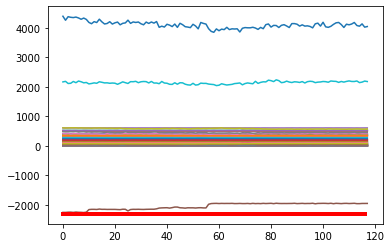

Predicción:  [[[0.78129035 0.21870969]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7515600e+01  1.0130600e+01  5.9442000e+01  7.5152400e+01
  6.0996000e+02  3.4018400e+01  1.0130000e+01  1.8647770e+02
  5.0000000e-04  7.2248700e+01  1.2599730e+02  8.0370000e+00
  6.5178000e+01  1.7740070e+02  2.1531000e+01  1.6589240e+02
  1.8581270e+02  7.0554400e+01 -4.0000000e-04  4.0855000e+00
  1.4680500e+01  6.8954000e+00  1.5014000e+00  7.2407400e+01
  1.4661000e+00  1.5336000e+00  8.7879900e+01  5.9628900e+01
  1.3552000e+00  1.2243000e+00  1.5818000e+00  1.3782000e+00
  1.5519840e+02  8.2840000e-01  8.3050000e-01 -1.9540696e+03
  2.0204050e+02  1.6220000e+00  1.4148000e+00  2.2103649e+03
  4.0705780e+03  1.8481450e+02  1.4108000e+00  1.4022000e+00
  8.0004000e+00  7.4000000e+00  1.7561000e+00  1.7430000e-01
  3.2577700e+01  5.2944890e+02  5.2007470e+02  5.1609630e+02
  5.1721940e+02  5.1699660e+02  3.2071800e+01  3.18

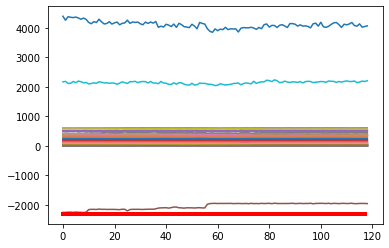

Predicción:  [[[0.79444295 0.20555703]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7609800e+01  1.0205000e+01  5.9646900e+01  7.5463100e+01
  6.1067060e+02  3.3759100e+01  1.0178800e+01  1.8637790e+02
  5.0000000e-04  7.2655800e+01  1.2641690e+02  7.8659000e+00
  6.5464000e+01  1.7708040e+02  2.1487600e+01  1.6616740e+02
  1.8579870e+02  7.0737700e+01 -4.0000000e-04  4.1471000e+00
  1.4822600e+01  6.9061000e+00  1.5010000e+00  7.2440600e+01
  1.4696000e+00  1.5345000e+00  8.8782800e+01  5.9109700e+01
  1.3561000e+00  1.2267000e+00  1.5841000e+00  1.3802000e+00
  1.5537290e+02  8.2850000e-01  8.2970000e-01 -2.0009424e+03
  2.0314240e+02  1.6229000e+00  1.4158000e+00  2.2546259e+03
  4.1728479e+03  1.8481450e+02  1.4121000e+00  1.4036000e+00
  7.9997000e+00  7.3999000e+00  1.7584000e+00  1.7420000e-01
  3.2131700e+01  5.2924890e+02  5.2024210e+02  5.1613050e+02
  5.1727390e+02  5.1708220e+02  3.1853300e+01  3.18

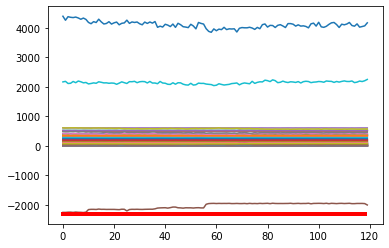

Predicción:  [[[0.8688743  0.13112563]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7522000e+01  1.0066000e+01  5.9598400e+01  7.5574400e+01
  6.1063590e+02  3.3987000e+01  1.0284300e+01  1.8633020e+02
  5.0000000e-04  7.2541200e+01  1.2608220e+02  7.9090000e+00
  6.5814800e+01  1.7680330e+02  2.1430700e+01  1.6600340e+02
  1.8574000e+02  7.0686000e+01 -4.0000000e-04  4.3090000e+00
  1.6003000e+01  6.9047000e+00  1.5000000e+00  7.2419000e+01
  1.4647000e+00  1.5294000e+00  8.9052800e+01  5.9712200e+01
  1.3474000e+00  1.2194000e+00  1.5782000e+00  1.3815000e+00
  1.5474730e+02  8.2900000e-01  8.2980000e-01 -2.0021207e+03
  2.0254570e+02  1.6179000e+00  1.4070000e+00  2.1832650e+03
  4.0971628e+03  1.8481450e+02  1.4127000e+00  1.4051000e+00
  7.9999000e+00  7.4007000e+00  1.7542000e+00  1.7590000e-01
  3.0447500e+01  5.2860220e+02  5.1957220e+02  5.1552240e+02
  5.1664930e+02  5.1651090e+02  3.1974300e+01  3.19

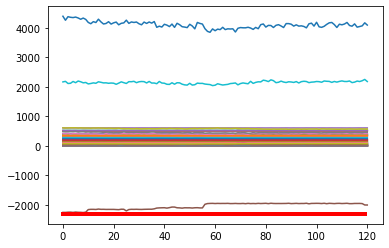

Predicción:  [[[0.8513521  0.14864792]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7501800e+01  1.0138000e+01  5.9322200e+01  7.5884000e+01
  6.0895600e+02  3.4281800e+01  1.0282000e+01  1.8642440e+02
  5.0000000e-04  7.2263200e+01  1.2566350e+02  8.0416000e+00
  6.6302300e+01  1.7613040e+02  2.1434800e+01  1.6613640e+02
  1.8590500e+02  7.1110000e+01 -4.0000000e-04  4.2893000e+00
  1.5969000e+01  6.9160000e+00  1.5028000e+00  7.2437000e+01
  1.4584000e+00  1.5273000e+00  8.9950300e+01  5.9676700e+01
  1.3431000e+00  1.2149000e+00  1.5708000e+00  1.3737000e+00
  1.5457180e+02  8.2810000e-01  8.2980000e-01 -1.9804865e+03
  2.0339760e+02  1.6188000e+00  1.4031000e+00  2.1675432e+03
  4.1465864e+03  1.8481450e+02  1.4040000e+00  1.3977000e+00
  8.0053000e+00  7.4011000e+00  1.7497000e+00  1.7880000e-01
  3.0267600e+01  5.2900000e+02  5.1972550e+02  5.1546870e+02
  5.1666890e+02  5.1648270e+02  3.2159900e+01  3.21

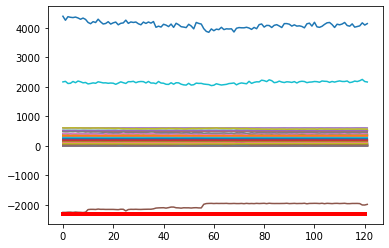

Predicción:  [[[0.8446213 0.1553787]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7540100e+01  1.0101200e+01  5.9691000e+01  7.4494400e+01
  6.1007860e+02  3.4685900e+01  1.0299500e+01  1.8633020e+02
  5.0000000e-04  7.1104400e+01  1.2635660e+02  8.1064000e+00
  6.5755700e+01  1.7551770e+02  2.1742500e+01  1.6593190e+02
  1.8588810e+02  7.0520200e+01 -4.0000000e-04  4.3131000e+00
  1.6200900e+01  6.9135000e+00  1.5005000e+00  7.2327600e+01
  1.4543000e+00  1.5213000e+00  8.9894600e+01  6.0398900e+01
  1.3372000e+00  1.2079000e+00  1.5680000e+00  1.3646000e+00
  1.5536920e+02  8.2920000e-01  8.3040000e-01 -2.0009707e+03
  2.0168080e+02  1.6110000e+00  1.3974000e+00  2.1944613e+03
  4.1239682e+03  1.8481450e+02  1.3956000e+00  1.3897000e+00
  8.0022000e+00  7.4016000e+00  1.7436000e+00  1.7570000e-01
  3.0743700e+01  5.2891560e+02  5.1966050e+02  5.1576450e+02
  5.1693790e+02  5.1671270e+02  3.2632000e+01  3.2341

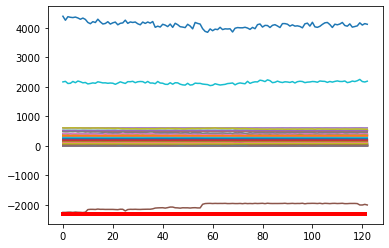

Predicción:  [[[0.8570193  0.14298064]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7464500e+01  1.0029200e+01  5.9365700e+01  7.3359300e+01
  6.0880290e+02  3.4497600e+01  1.0288300e+01  1.8650010e+02
  5.0000000e-04  7.0738800e+01  1.2597200e+02  7.9750000e+00
  6.5524100e+01  1.7467010e+02  2.1676400e+01  1.6606800e+02
  1.8594990e+02  7.0855900e+01 -4.0000000e-04  4.3038000e+00
  1.6646300e+01  6.8790000e+00  1.4983000e+00  7.2313700e+01
  1.4589000e+00  1.5299000e+00  8.8975600e+01  5.9881200e+01
  1.3374000e+00  1.2121000e+00  1.5728000e+00  1.3685000e+00
  1.5429340e+02  8.2830000e-01  8.3000000e-01 -1.9957113e+03
  2.0470270e+02  1.6199000e+00  1.3973000e+00  2.1882576e+03
  4.1658535e+03  1.8481450e+02  1.3986000e+00  1.3928000e+00
  7.9931000e+00  7.3981000e+00  1.7505000e+00  1.7800000e-01
  3.0103200e+01  5.2883330e+02  5.1937750e+02  5.1544330e+02
  5.1665920e+02  5.1639020e+02  3.2856300e+01  3.26

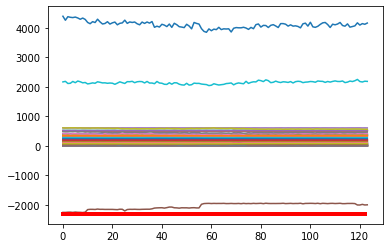

Predicción:  [[[0.8630727  0.13692738]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7410700e+01  1.0073200e+01  5.7270800e+01  7.4216800e+01
  6.0984880e+02  3.4101600e+01  1.0206000e+01  1.8607600e+02
  5.0000000e-04  7.0671500e+01  1.2615900e+02  8.0735000e+00
  6.5781900e+01  1.7421090e+02  2.1814800e+01  1.6601490e+02
  1.8568000e+02  7.0877000e+01 -4.0000000e-04  4.3062000e+00
  1.7131200e+01  6.8817000e+00  1.5006000e+00  7.2462900e+01
  1.4597000e+00  1.5287000e+00  8.9195800e+01  5.9157000e+01
  1.3390000e+00  1.2159000e+00  1.5723000e+00  1.3732000e+00
  1.5441120e+02  8.2860000e-01  8.3010000e-01 -1.9916995e+03
  2.0345340e+02  1.6188000e+00  1.3987000e+00  2.2161496e+03
  4.2147672e+03  1.8481450e+02  1.4021000e+00  1.3964000e+00
  7.9996000e+00  7.4056000e+00  1.7514000e+00  1.7890000e-01
  2.8714700e+01  5.2956450e+02  5.2002790e+02  5.1624560e+02
  5.1746550e+02  5.1723990e+02  3.2236000e+01  3.25

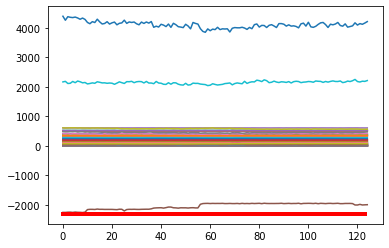

Predicción:  [[[0.8717766  0.12822345]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7555200e+01  1.0077600e+01  5.6472600e+01  7.5040400e+01
  6.1050130e+02  3.4995700e+01  1.0218900e+01  1.8593800e+02
  5.0000000e-04  7.0701000e+01  1.2604100e+02  7.9919000e+00
  6.6252600e+01  1.7588840e+02  2.1534800e+01  1.6582880e+02
  1.8549060e+02  7.0705200e+01 -4.0000000e-04  4.3049000e+00
  1.6291900e+01  6.8999000e+00  1.5003000e+00  7.2410400e+01
  1.4580000e+00  1.5260000e+00  8.8645100e+01  5.9681000e+01
  1.3411000e+00  1.2168000e+00  1.5689000e+00  1.3696000e+00
  1.5385410e+02  8.2890000e-01  8.2960000e-01 -2.0052730e+03
  2.0375100e+02  1.6157000e+00  1.4003000e+00  2.1996733e+03
  4.1932573e+03  1.8481450e+02  1.3989000e+00  1.3942000e+00
  7.9998000e+00  7.3991000e+00  1.7479000e+00  1.7880000e-01
  2.9285200e+01  5.2946880e+02  5.2022120e+02  5.1619820e+02
  5.1739350e+02  5.1716750e+02  3.1834900e+01  3.22

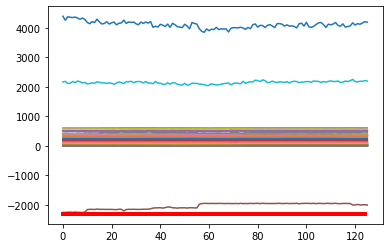

Predicción:  [[[0.8769299  0.12307005]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7553500e+01  1.0121800e+01  5.6845600e+01  7.5883300e+01
  6.0965900e+02  3.4511300e+01  1.0207300e+01  1.8599020e+02
  5.0000000e-04  7.1441800e+01  1.2614270e+02  8.0151000e+00
  6.5370100e+01  1.7547340e+02  2.1699900e+01  1.6619290e+02
  1.8547880e+02  7.0645800e+01 -4.0000000e-04  4.2826000e+00
  1.6226100e+01  6.8986000e+00  1.5005000e+00  7.2410600e+01
  1.4566000e+00  1.5234000e+00  9.0523900e+01  5.9776200e+01
  1.3376000e+00  1.2161000e+00  1.5706000e+00  1.3674000e+00
  1.5230920e+02  8.2880000e-01  8.3070000e-01 -1.9964224e+03
  2.0193110e+02  1.6122000e+00  1.3972000e+00  2.2092603e+03
  4.2486348e+03  1.8481450e+02  1.3974000e+00  1.3927000e+00
  8.0013000e+00  7.3997000e+00  1.7464000e+00  1.7580000e-01
  2.9823800e+01  5.2916670e+02  5.1997340e+02  5.1597420e+02
  5.1721340e+02  5.1696260e+02  3.1975000e+01  3.22

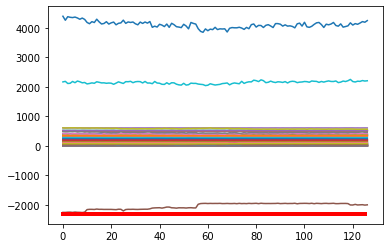

Predicción:  [[[0.8824557  0.11754434]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7468500e+01  1.0077400e+01  5.6322800e+01  7.5556500e+01
  6.1012200e+02  3.4164700e+01  1.0176200e+01  1.8600870e+02
  5.0000000e-04  7.1837400e+01  1.2633280e+02  8.2524000e+00
  6.5737800e+01  1.7523440e+02  2.1790800e+01  1.6593010e+02
  1.8536090e+02  7.0914700e+01 -4.0000000e-04  4.2969000e+00
  1.5934200e+01  6.8933000e+00  1.5001000e+00  7.2431900e+01
  1.4479000e+00  1.5164000e+00  9.0094800e+01  5.9548200e+01
  1.3303000e+00  1.2065000e+00  1.5620000e+00  1.3604000e+00
  1.5281720e+02  8.2800000e-01  8.3000000e-01 -1.9952453e+03
  2.0385780e+02  1.6070000e+00  1.3902000e+00  2.2017213e+03
  4.1438137e+03  1.8481450e+02  1.3908000e+00  1.3870000e+00
  8.0008000e+00  7.4016000e+00  1.7388000e+00  1.7700000e-01
  3.0427700e+01  5.2900110e+02  5.1995250e+02  5.1574730e+02
  5.1705020e+02  5.1676760e+02  3.1961100e+01  3.21

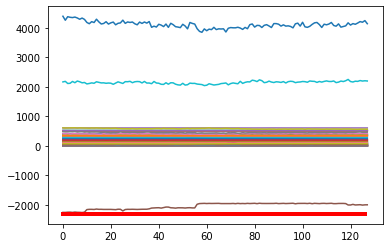

Predicción:  [[[0.85778517 0.14221479]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7444300e+01  1.0081200e+01  5.7188400e+01  7.4378400e+01
  6.1049910e+02  3.3948600e+01  1.0128800e+01  1.8605210e+02
  5.0000000e-04  7.2082000e+01  1.2613030e+02  7.9594000e+00
  6.6095700e+01  1.7571330e+02  2.2104300e+01  1.6639730e+02
  1.8544510e+02  7.0847200e+01 -4.0000000e-04  4.2983000e+00
  1.6574800e+01  6.9025000e+00  1.4999000e+00  7.2336100e+01
  1.4535000e+00  1.5208000e+00  8.9419200e+01  5.9550900e+01
  1.3378000e+00  1.2115000e+00  1.5660000e+00  1.3648000e+00
  1.5355050e+02  8.2750000e-01  8.3010000e-01 -1.9998296e+03
  2.0404280e+02  1.6088000e+00  1.3973000e+00  2.2042342e+03
  4.1442221e+03  1.8481450e+02  1.3955000e+00  1.3915000e+00
  7.9997000e+00  7.3995000e+00  1.7432000e+00  1.7750000e-01
  3.0650800e+01  5.2910000e+02  5.1985450e+02  5.1599230e+02
  5.1721830e+02  5.1690600e+02  3.2270600e+01  3.20

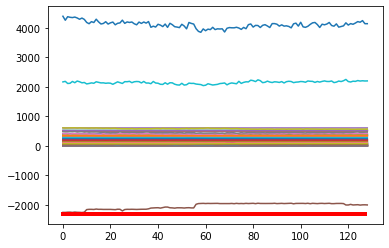

Predicción:  [[[0.86157024 0.1384297 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7337800e+01  1.0131400e+01  5.7684200e+01  7.2202500e+01
  6.1095480e+02  3.3523400e+01  1.0124500e+01  1.8599750e+02
  5.0000000e-04  7.2248200e+01  1.2599360e+02  7.9975000e+00
  6.6486900e+01  1.7577210e+02  2.1978600e+01  1.6595140e+02
  1.8530310e+02  7.0737900e+01 -4.0000000e-04  4.2929000e+00
  1.6297300e+01  6.9190000e+00  1.5004000e+00  7.2405600e+01
  1.4679000e+00  1.5353000e+00  8.9335300e+01  5.8676200e+01
  1.3527000e+00  1.2250000e+00  1.5795000e+00  1.3803000e+00
  1.5532390e+02  8.2590000e-01  8.2920000e-01 -2.0042497e+03
  2.0389730e+02  1.6239000e+00  1.4118000e+00  2.1997090e+03
  4.0746331e+03  1.8481450e+02  1.4113000e+00  1.4063000e+00
  7.9969000e+00  7.3913000e+00  1.7571000e+00  1.7770000e-01
  3.1120400e+01  5.2911200e+02  5.2022340e+02  5.1633370e+02
  5.1761310e+02  5.1724430e+02  3.2466700e+01  3.22

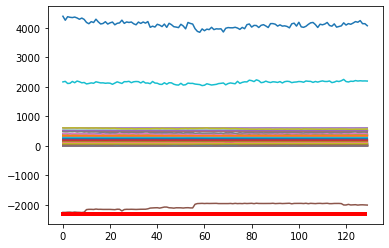

Predicción:  [[[0.84714776 0.15285219]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6902100e+01  1.0229700e+01  5.7228200e+01  7.2063800e+01
  6.1028190e+02  3.3581900e+01  1.0081500e+01  1.8596030e+02
  5.0000000e-04  7.2167400e+01  1.2577730e+02  7.7030000e+00
  6.5957000e+01  1.7662570e+02  2.1492600e+01  1.6593340e+02
  1.8530270e+02  7.0352100e+01 -4.0000000e-04  4.3016000e+00
  1.6942300e+01  6.8877000e+00  1.5009000e+00  7.2397300e+01
  1.4856000e+00  1.5531000e+00  8.8955800e+01  5.8271700e+01
  1.3709000e+00  1.2451000e+00  1.5935000e+00  1.3987000e+00
  1.5525560e+02  8.2700000e-01  8.3010000e-01 -1.9976218e+03
  2.0283410e+02  1.6417000e+00  1.4294000e+00  2.1743876e+03
  4.1111963e+03  1.8481450e+02  1.4294000e+00  1.4242000e+00
  8.0005000e+00  7.4065000e+00  1.7737000e+00  1.8040000e-01
  3.0996500e+01  5.2924630e+02  5.2068470e+02  5.1661620e+02
  5.1783940e+02  5.1749900e+02  3.1553200e+01  3.21

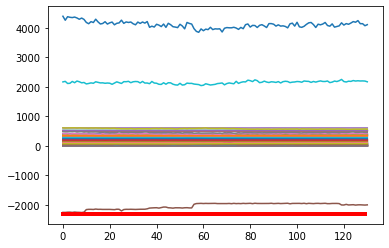

Predicción:  [[[0.8509595  0.14904049]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6913600e+01  1.0182300e+01  5.4007100e+01  7.5422300e+01
  6.1153890e+02  3.3712600e+01  1.0106700e+01  1.8591840e+02
  5.0000000e-04  7.2380700e+01  1.2809880e+02  7.9520000e+00
  6.6039200e+01  1.7650250e+02  2.1487900e+01  1.6342660e+02
  1.8490130e+02  7.0793200e+01 -4.0000000e-04  4.3011000e+00
  1.5611600e+01  6.9073000e+00  1.5002000e+00  7.2353300e+01
  1.4629000e+00  1.5342000e+00  9.0134700e+01  5.9257200e+01
  1.3487000e+00  1.2219000e+00  1.5733000e+00  1.3810000e+00
  1.5677490e+02  8.2580000e-01  8.3010000e-01 -1.9960120e+03
  2.0473200e+02  1.6239000e+00  1.4077000e+00  2.1723879e+03
  4.1378773e+03  1.8481450e+02  1.4125000e+00  1.4069000e+00
  8.0019000e+00  7.4023000e+00  1.7513000e+00  1.7790000e-01
  3.1067200e+01  5.2863340e+02  5.2026500e+02  5.1598320e+02
  5.1714650e+02  5.1694360e+02  3.1710400e+01  3.18

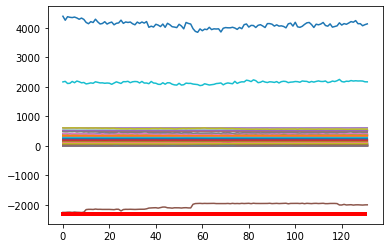

Predicción:  [[[0.8573629  0.14263701]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6992800e+01  1.0216200e+01  5.4651500e+01  7.6205300e+01
  6.1068780e+02  3.4116100e+01  1.0247700e+01  1.8626520e+02
  5.0000000e-04  7.2320100e+01  1.2811180e+02  8.2272000e+00
  6.6275500e+01  1.7632730e+02  2.1517100e+01  1.6214690e+02
  1.8498240e+02  7.0762200e+01 -4.0000000e-04  4.3033000e+00
  1.5421800e+01  6.8932000e+00  1.4999000e+00  7.2400400e+01
  1.4559000e+00  1.5242000e+00  8.9383600e+01  5.8708800e+01
  1.3443000e+00  1.2141000e+00  1.5679000e+00  1.3732000e+00
  1.5635950e+02  8.2430000e-01  8.2930000e-01 -2.0011823e+03
  2.0349480e+02  1.6129000e+00  1.4034000e+00  2.1814370e+03
  4.0956783e+03  1.8481450e+02  1.4060000e+00  1.4010000e+00
  7.9888000e+00  7.3960000e+00  1.7441000e+00  1.7600000e-01
  3.2584800e+01  5.2796670e+02  5.1940110e+02  5.1540660e+02
  5.1655680e+02  5.1629320e+02  3.1490700e+01  3.20

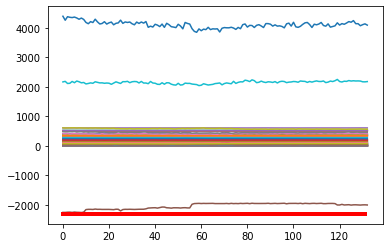

Predicción:  [[[0.85101396 0.14898603]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6957000e+01  1.0317100e+01  5.5726900e+01  7.5216700e+01
  6.1019230e+02  3.4882400e+01  1.0517600e+01  1.8664240e+02
  5.0000000e-04  7.2474700e+01  1.2760230e+02  7.9570000e+00
  6.5992300e+01  1.7787630e+02  2.1513100e+01  1.6185180e+02
  1.8579690e+02  7.0696900e+01 -4.0000000e-04  4.3046000e+00
  1.5059600e+01  6.8954000e+00  1.5016000e+00  7.2421500e+01
  1.4741000e+00  1.5414000e+00  8.9621900e+01  5.7277300e+01
  1.3568000e+00  1.2277000e+00  1.5802000e+00  1.3850000e+00
  1.5605970e+02  8.2770000e-01  8.3310000e-01 -2.0027705e+03
  2.0404590e+02  1.6311000e+00  1.4139000e+00  2.1683366e+03
  4.1924607e+03  1.8481450e+02  1.4199000e+00  1.4127000e+00
  7.9997000e+00  7.4034000e+00  1.7618000e+00  1.8140000e-01
  3.4661800e+01  5.2801560e+02  5.1910980e+02  5.1512280e+02
  5.1621230e+02  5.1602160e+02  3.1020900e+01  3.15

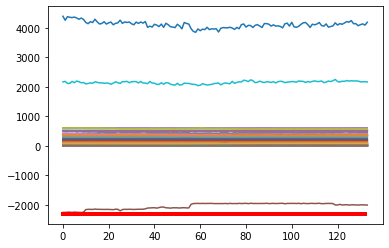

Predicción:  [[[0.87572294 0.12427703]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6954100e+01  1.0228000e+01  5.7927600e+01  7.6375800e+01
  6.0950600e+02  3.4293700e+01  1.0443400e+01  1.8702490e+02
  5.0000000e-04  7.2352200e+01  1.2797180e+02  7.9513000e+00
  6.6521300e+01  1.7962830e+02  2.1468700e+01  1.6204450e+02
  1.8637380e+02  7.0722200e+01 -4.0000000e-04  4.3028000e+00
  1.6577600e+01  6.8975000e+00  1.5009000e+00  7.2379300e+01
  1.4815000e+00  1.5474000e+00  9.1344000e+01  5.6727600e+01
  1.3630000e+00  1.2325000e+00  1.5788000e+00  1.3946000e+00
  1.6043110e+02  8.3350000e-01  8.3920000e-01 -2.0790035e+03
  2.0188940e+02  1.6367000e+00  1.4200000e+00  2.2243833e+03
  4.2160935e+03  1.8481450e+02  1.4269000e+00  1.4185000e+00
  7.9992000e+00  7.4009000e+00  1.7667000e+00  1.8790000e-01
  3.2153100e+01  5.2994670e+02  5.2022720e+02  5.1662330e+02
  5.1760230e+02  5.1747590e+02  3.1208700e+01  3.17

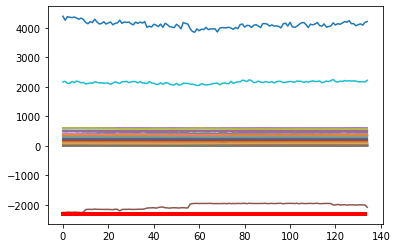

Predicción:  [[[0.9255717  0.07442832]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7174200e+01  1.0275600e+01  5.8947300e+01  7.5682800e+01
  6.1005510e+02  3.4569500e+01  1.0393100e+01  1.8705800e+02
  5.0000000e-04  7.2297200e+01  1.2700060e+02  8.1077000e+00
  6.6095700e+01  1.7991650e+02  2.1495200e+01  1.6187430e+02
  1.8630790e+02  7.0695400e+01 -4.0000000e-04  4.3019000e+00
  1.7202400e+01  6.9233000e+00  1.5020000e+00  7.2360200e+01
  1.4867000e+00  1.5532000e+00  8.8708300e+01  5.6826400e+01
  1.3633000e+00  1.2388000e+00  1.5806000e+00  1.3988000e+00
  1.6000330e+02  8.3720000e-01  8.4000000e-01 -2.0982833e+03
  2.0081550e+02  1.6427000e+00  1.4199000e+00  2.2607199e+03
  4.2695660e+03  1.8481450e+02  1.4301000e+00  1.4227000e+00
  7.9978000e+00  7.4000000e+00  1.7725000e+00  1.9240000e-01
  3.1497300e+01  5.2930220e+02  5.2032780e+02  5.1640010e+02
  5.1721740e+02  5.1722440e+02  3.1161600e+01  3.14

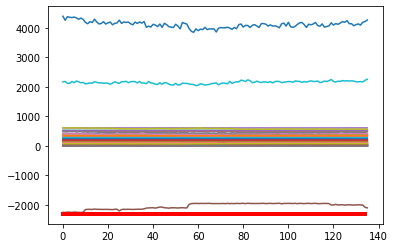

Predicción:  [[[0.94106084 0.05893918]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7410600e+01  1.0273600e+01  5.7508200e+01  7.5833000e+01
  6.1057080e+02  3.4570500e+01  1.0350700e+01  1.8696070e+02
  5.0000000e-04  7.2328600e+01  1.2770550e+02  7.9767000e+00
  6.6256800e+01  1.8011370e+02  2.1539800e+01  1.6210650e+02
  1.8643940e+02  7.0848500e+01 -4.0000000e-04  4.2992000e+00
  1.6042600e+01  6.9191000e+00  1.4992000e+00  7.2415000e+01
  1.4691000e+00  1.5343000e+00  9.4293000e+01  5.8207400e+01
  1.3445000e+00  1.2239000e+00  1.5678000e+00  1.3816000e+00
  1.5912240e+02  8.3620000e-01  8.4040000e-01 -2.0973983e+03
  2.0481500e+02  1.6273000e+00  1.4027000e+00  2.1928160e+03
  4.2723825e+03  1.8481450e+02  1.4164000e+00  1.4102000e+00
  7.9990000e+00  7.3944000e+00  1.7529000e+00  1.8480000e-01
  3.4688700e+01  5.2885110e+02  5.1989790e+02  5.1601130e+02
  5.1685800e+02  5.1691190e+02  3.1529200e+01  3.17

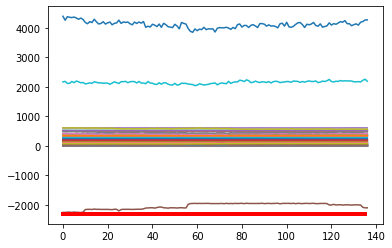

Predicción:  [[[0.9413216  0.05867845]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6759000e+01  9.9203000e+00  5.7862800e+01  7.4688500e+01
  6.1069370e+02  3.4379600e+01  1.0408200e+01  1.8709630e+02
  5.0000000e-04  7.2218700e+01  1.2760090e+02  8.0548000e+00
  6.6334600e+01  1.7911370e+02  2.1566200e+01  1.6200590e+02
  1.8623690e+02  7.0976600e+01 -4.0000000e-04  4.3457000e+00
  1.6069700e+01  7.0049000e+00  1.5002000e+00  7.2548900e+01
  1.4697000e+00  1.5381000e+00  9.0271400e+01  5.7497000e+01
  1.3451000e+00  1.2229000e+00  1.5695000e+00  1.3831000e+00
  1.6002940e+02  8.3530000e-01  8.4090000e-01 -2.0962912e+03
  2.0426810e+02  1.6297000e+00  1.4027000e+00  2.2236357e+03
  4.2510701e+03  1.8481450e+02  1.4174000e+00  1.4068000e+00
  7.9998000e+00  7.3984000e+00  1.7546000e+00  1.8530000e-01
  3.4304600e+01  5.2880830e+02  5.1976110e+02  5.1585360e+02
  5.1685960e+02  5.1686110e+02  3.1667300e+01  3.19

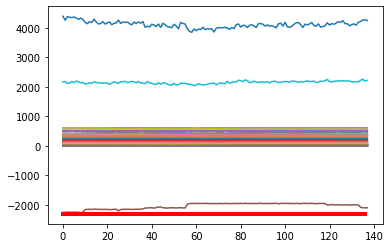

Predicción:  [[[0.93797284 0.0620272 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6699400e+01  9.7289000e+00  5.8945400e+01  7.5637200e+01
  6.0863830e+02  3.3817400e+01  1.0473500e+01  1.8701100e+02
  5.0000000e-04  7.2396200e+01  1.2746210e+02  7.9414000e+00
  6.6644800e+01  1.7842220e+02  2.1840700e+01  1.6196740e+02
  1.8610700e+02  7.0834800e+01 -4.0000000e-04  4.3976000e+00
  1.5469900e+01  6.9923000e+00  1.4997000e+00  7.2542800e+01
  1.4740000e+00  1.5422000e+00  9.2554600e+01  5.7469600e+01
  1.3491000e+00  1.2260000e+00  1.5758000e+00  1.3846000e+00
  1.5984320e+02  8.3500000e-01  8.4020000e-01 -2.1055987e+03
  2.0363630e+02  1.6350000e+00  1.4066000e+00  2.2066465e+03
  4.1902847e+03  1.8481450e+02  1.4201000e+00  1.4100000e+00
  8.0014000e+00  7.3995000e+00  1.7586000e+00  1.8260000e-01
  3.5732900e+01  5.2945110e+02  5.2050560e+02  5.1628430e+02
  5.1724010e+02  5.1730650e+02  3.1395100e+01  3.19

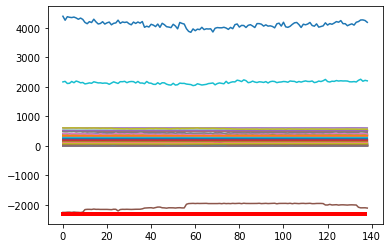

Predicción:  [[[0.93432075 0.0656793 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6589300e+01  9.9397000e+00  5.7565700e+01  7.6177500e+01
  6.1102440e+02  3.4479200e+01  1.0447000e+01  1.8705570e+02
  5.0000000e-04  7.2360700e+01  1.2718650e+02  7.9371000e+00
  6.6355300e+01  1.7959240e+02  2.2149900e+01  1.6220930e+02
  1.8616560e+02  7.1112200e+01 -4.0000000e-04  4.3986000e+00
  1.5556000e+01  6.9948000e+00  1.4999000e+00  7.2623700e+01
  1.4827000e+00  1.5520000e+00  9.3323500e+01  5.8166000e+01
  1.3569000e+00  1.2347000e+00  1.5811000e+00  1.3963000e+00
  1.5975380e+02  8.3610000e-01  8.3960000e-01 -2.0961361e+03
  2.0255000e+02  1.6465000e+00  1.4152000e+00  2.1727464e+03
  4.3906788e+03  1.8481450e+02  1.4312000e+00  1.4208000e+00
  7.9983000e+00  7.4006000e+00  1.7684000e+00  1.8760000e-01
  3.4709500e+01  5.3053120e+02  5.2080250e+02  5.1690260e+02
  5.1783450e+02  5.1790870e+02  3.1494900e+01  3.19

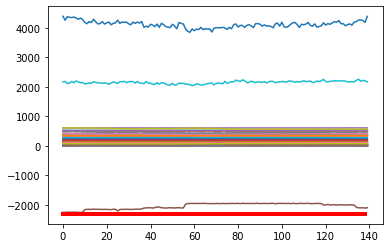

Predicción:  [[[0.9530299  0.04697018]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6463600e+01  9.8255000e+00  5.8849800e+01  7.6729000e+01
  6.0939890e+02  3.3738000e+01  1.0497400e+01  1.8693710e+02
  5.0000000e-04  7.2378600e+01  1.2731220e+02  8.0117000e+00
  6.6474400e+01  1.7891080e+02  2.2114100e+01  1.6225260e+02
  1.8593930e+02  7.1011900e+01 -4.0000000e-04  4.3959000e+00
  1.4661200e+01  7.0168000e+00  1.5001000e+00  7.2594400e+01
  1.4747000e+00  1.5423000e+00  9.1129500e+01  5.7833800e+01
  1.3504000e+00  1.2270000e+00  1.5762000e+00  1.3854000e+00
  1.5951230e+02  8.3490000e-01  8.3980000e-01 -2.1003031e+03
  2.0450360e+02  1.6324000e+00  1.4085000e+00  2.1646427e+03
  4.2256261e+03  1.8481450e+02  1.4201000e+00  1.4106000e+00
  8.0025000e+00  7.4040000e+00  1.7597000e+00  1.8350000e-01
  3.4947800e+01  5.2920000e+02  5.2046960e+02  5.1624060e+02
  5.1717580e+02  5.1721520e+02  3.1423000e+01  3.19

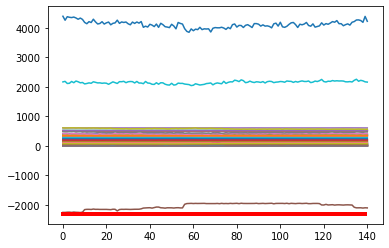

Predicción:  [[[0.93702805 0.06297196]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6652500e+01  9.9490000e+00  5.8292200e+01  7.5985700e+01
  6.1097420e+02  3.3864000e+01  1.0435100e+01  1.8700970e+02
  5.0000000e-04  7.1957700e+01  1.2734970e+02  8.0135000e+00
  6.6568000e+01  1.7814140e+02  2.2198300e+01  1.6225670e+02
  1.8608460e+02  7.1147000e+01 -4.0000000e-04  4.4121000e+00
  1.6234400e+01  6.9932000e+00  1.4998000e+00  7.2622000e+01
  1.4712000e+00  1.5376000e+00  9.1221200e+01  5.9177000e+01
  1.3473000e+00  1.2204000e+00  1.5725000e+00  1.3811000e+00
  1.6055970e+02  8.3660000e-01  8.3970000e-01 -2.1025219e+03
  2.0469850e+02  1.6302000e+00  1.4063000e+00  2.1676685e+03
  4.2881346e+03  1.8481450e+02  1.4163000e+00  1.4074000e+00
  7.9988000e+00  7.4010000e+00  1.7568000e+00  1.8430000e-01
  3.5204100e+01  5.2903540e+02  5.2023430e+02  5.1608980e+02
  5.1693270e+02  5.1703550e+02  3.1908100e+01  3.19

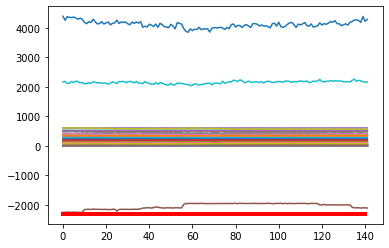

Predicción:  [[[0.9449007  0.05509927]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7094700e+01  9.9560000e+00  5.9370600e+01  7.4586100e+01
  6.0985460e+02  3.3911100e+01  1.0477400e+01  1.8701270e+02
  5.0000000e-04  7.1690000e+01  1.2761000e+02  8.0063000e+00
  6.6416400e+01  1.7783240e+02  2.2140100e+01  1.6192050e+02
  1.8615750e+02  7.0964400e+01 -4.0000000e-04  4.3975000e+00
  1.6971200e+01  6.9972000e+00  1.5014000e+00  7.2623900e+01
  1.4717000e+00  1.5401000e+00  9.0645300e+01  5.8831800e+01
  1.3491000e+00  1.2223000e+00  1.5723000e+00  1.3830000e+00
  1.6069700e+02  8.3700000e-01  8.4020000e-01 -2.1053924e+03
  2.0520720e+02  1.6307000e+00  1.4081000e+00  2.1370442e+03
  4.2410267e+03  1.8481450e+02  1.4182000e+00  1.4109000e+00
  8.0005000e+00  7.3931000e+00  1.7581000e+00  1.8580000e-01
  3.5236200e+01  5.2866450e+02  5.2004510e+02  5.1600090e+02
  5.1703060e+02  5.1706070e+02  3.1979700e+01  3.19

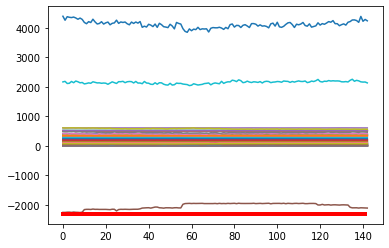

Predicción:  [[[0.9405878  0.05941217]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6999600e+01  1.0051400e+01  5.7701800e+01  7.5198300e+01
  6.1079710e+02  3.4469600e+01  1.0447800e+01  1.8702860e+02
  5.0000000e-04  7.1641700e+01  1.2742730e+02  8.1024000e+00
  6.6294900e+01  1.7888770e+02  2.2033200e+01  1.6184820e+02
  1.8632840e+02  7.0857900e+01 -4.0000000e-04  4.3018000e+00
  1.6449200e+01  7.0112000e+00  1.4994000e+00  7.2641500e+01
  1.4759000e+00  1.5442000e+00  9.1036300e+01  5.8857600e+01
  1.3488000e+00  1.2268000e+00  1.5716000e+00  1.3868000e+00
  1.6045240e+02  8.3780000e-01  8.3990000e-01 -2.1030517e+03
  2.0231050e+02  1.6345000e+00  1.4076000e+00  2.1706110e+03
  4.2490463e+03  1.8481450e+02  1.4211000e+00  1.4123000e+00
  7.9976000e+00  7.4035000e+00  1.7611000e+00  1.8960000e-01
  3.4174500e+01  5.2946660e+02  5.2049350e+02  5.1637350e+02
  5.1748540e+02  5.1737800e+02  3.1478100e+01  3.17

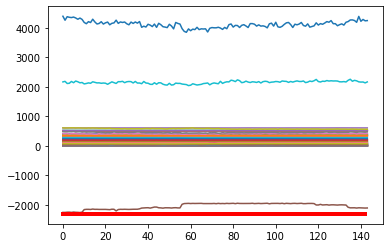

Predicción:  [[[0.94067675 0.05932328]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7168500e+01  9.9970000e+00  5.8611500e+01  7.6112600e+01
  6.1002470e+02  3.4537600e+01  1.0299900e+01  1.8698440e+02
  5.0000000e-04  7.1573300e+01  1.2740400e+02  8.0952000e+00
  6.6492500e+01  1.7965410e+02  2.2236200e+01  1.6175510e+02
  1.8595760e+02  7.1091100e+01 -4.0000000e-04  4.2982000e+00
  1.5902900e+01  6.9842000e+00  1.4998000e+00  7.2509800e+01
  1.4653000e+00  1.5371000e+00  9.2341100e+01  5.8683000e+01
  1.3379000e+00  1.2212000e+00  1.5591000e+00  1.3814000e+00
  1.5803190e+02  8.3510000e-01  8.3920000e-01 -2.1454538e+03
  2.0582540e+02  1.6295000e+00  1.3967000e+00  2.2011891e+03
  4.2992057e+03  1.8481450e+02  1.4147000e+00  1.4102000e+00
  8.0033000e+00  7.3972000e+00  1.7507000e+00  1.9150000e-01
  3.2931900e+01  5.2896890e+02  5.2086180e+02  5.1690020e+02
  5.1764050e+02  5.1760210e+02  3.1546000e+01  3.18

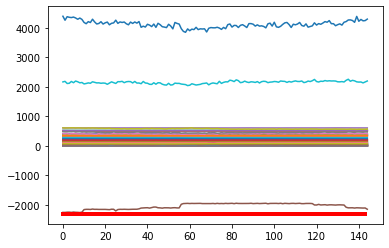

Predicción:  [[[0.9592867  0.04071331]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7227700e+01  1.0000900e+01  5.8405200e+01  7.4752800e+01
  6.1010630e+02  3.4038100e+01  1.0459100e+01  1.8694550e+02
  5.0000000e-04  7.1547200e+01  1.2795130e+02  8.0355000e+00
  6.6135700e+01  1.7694000e+02  2.1549700e+01  1.6206640e+02
  1.8600960e+02  7.0974400e+01 -4.0000000e-04  4.2996000e+00
  1.6116500e+01  7.0181000e+00  1.5003000e+00  7.2412000e+01
  1.4559000e+00  1.5231000e+00  8.9517600e+01  5.9584800e+01
  1.3316000e+00  1.2103000e+00  1.5554000e+00  1.3647000e+00
  1.5546460e+02  8.3270000e-01  8.3990000e-01 -2.1133999e+03
  2.0427170e+02  1.6127000e+00  1.3910000e+00  2.2061956e+03
  4.1859226e+03  1.8481450e+02  1.3999000e+00  1.3916000e+00
  7.9991000e+00  7.3979000e+00  1.7419000e+00  1.8630000e-01
  3.5360600e+01  5.2796670e+02  5.1960230e+02  5.1519790e+02
  5.1610670e+02  5.1609970e+02  3.1359000e+01  3.15

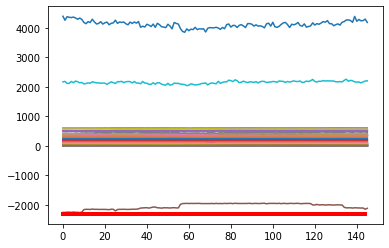

Predicción:  [[[0.93692946 0.06307054]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6664600e+01  1.0028200e+01  5.7985300e+01  7.4837900e+01
  6.0907280e+02  3.3390600e+01  1.0465700e+01  1.8697290e+02
  5.0000000e-04  7.1671100e+01  1.2757200e+02  7.9164000e+00
  6.6468700e+01  1.7583950e+02  2.1555000e+01  1.6202680e+02
  1.8638170e+02  7.0828100e+01 -4.0000000e-04  4.2981000e+00
  1.6614300e+01  6.9923000e+00  1.4987000e+00  7.2330900e+01
  1.4746000e+00  1.5406000e+00  9.1237500e+01  5.7905200e+01
  1.3477000e+00  1.2249000e+00  1.5762000e+00  1.3823000e+00
  1.5678370e+02  8.3340000e-01  8.3990000e-01 -2.1039902e+03
  2.0213120e+02  1.6321000e+00  1.4059000e+00  2.1446988e+03
  4.2100398e+03  1.8481450e+02  1.4183000e+00  1.4073000e+00
  7.9972000e+00  7.4017000e+00  1.7607000e+00  1.8420000e-01
  3.5840900e+01  5.2884890e+02  5.1974560e+02  5.1583020e+02
  5.1678350e+02  5.1687200e+02  3.1121800e+01  3.15

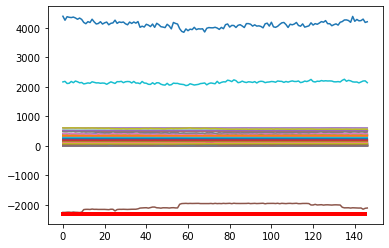

Predicción:  [[[0.93646413 0.06353585]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6669400e+01  9.9700000e+00  5.8098500e+01  7.6844900e+01
  6.1057920e+02  3.3366300e+01  1.0404000e+01  1.8696630e+02
  5.0000000e-04  7.1446000e+01  1.2769580e+02  8.0272000e+00
  6.6611900e+01  1.7636510e+02  2.2040100e+01  1.6208290e+02
  1.8635640e+02  7.0646800e+01 -4.0000000e-04  4.2187000e+00
  1.5144600e+01  6.9772000e+00  1.5003000e+00  7.2308100e+01
  1.4764000e+00  1.5445000e+00  9.2125300e+01  5.8355700e+01
  1.3515000e+00  1.2274000e+00  1.5787000e+00  1.3867000e+00
  1.5744210e+02  8.3420000e-01  8.3950000e-01 -2.1010041e+03
  2.0400950e+02  1.6364000e+00  1.4099000e+00  2.1937436e+03
  4.2896270e+03  1.8481450e+02  1.4232000e+00  1.4114000e+00
  8.0019000e+00  7.4051000e+00  1.7632000e+00  1.8440000e-01
  3.6254600e+01  5.2982280e+02  5.2070680e+02  5.1668730e+02
  5.1748490e+02  5.1770420e+02  3.1060600e+01  3.14

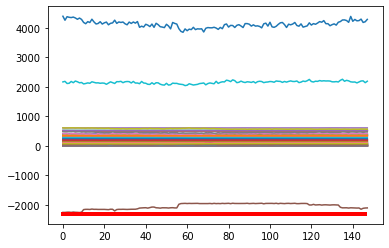

Predicción:  [[[0.9445471  0.05545292]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6577200e+01  1.0071500e+01  5.7066400e+01  7.6237900e+01
  6.1037230e+02  3.3827400e+01  1.0307600e+01  1.8703220e+02
  5.0000000e-04  7.1459400e+01  1.2746070e+02  9.0068000e+00
  6.6967800e+01  1.7741270e+02  2.2084600e+01  1.6194570e+02
  1.8611580e+02  7.0700600e+01 -4.0000000e-04  4.1467000e+00
  1.5853100e+01  6.9943000e+00  1.5003000e+00  7.2409900e+01
  1.4801000e+00  1.5486000e+00  9.0869000e+01  5.8659500e+01
  1.3560000e+00  1.2318000e+00  1.5766000e+00  1.3903000e+00
  1.5688860e+02  8.3440000e-01  8.3940000e-01 -2.0945559e+03
  2.0323320e+02  1.6398000e+00  1.4148000e+00  2.1933415e+03
  4.1749681e+03  1.8481450e+02  1.4248000e+00  1.4166000e+00
  8.0001000e+00  7.3904000e+00  1.7669000e+00  1.8990000e-01
  3.4554300e+01  5.2986670e+02  5.2087060e+02  5.1694640e+02
  5.1770320e+02  5.1785430e+02  3.1368900e+01  3.14

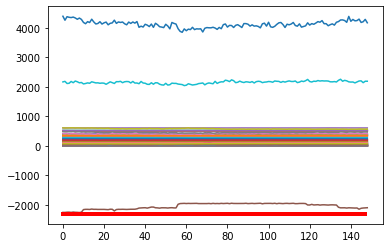

Predicción:  [[[0.9276986  0.07230137]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8449500e+01  1.0014700e+01  5.9913100e+01  7.5841000e+01
  6.1088560e+02  3.4779300e+01  1.0605200e+01  1.8702390e+02
  5.0000000e-04  7.1383300e+01  1.2697340e+02  8.9878000e+00
  6.5921100e+01  1.7898180e+02  2.1634500e+01  1.6225620e+02
  1.8563220e+02  7.0415200e+01 -4.0000000e-04  4.0990000e+00
  1.5063700e+01  7.0107000e+00  1.5001000e+00  7.2370900e+01
  1.4750000e+00  1.5433000e+00  9.1494200e+01  5.8272800e+01
  1.3507000e+00  1.2321000e+00  1.5650000e+00  1.3873000e+00
  1.5610240e+02  8.3320000e-01  8.3930000e-01 -2.0947055e+03
  2.0361330e+02  1.6340000e+00  1.4090000e+00  2.1986748e+03
  4.3121226e+03  1.8481450e+02  1.4190000e+00  1.4086000e+00
  8.0010000e+00  7.4056000e+00  1.7633000e+00  1.9870000e-01
  3.1869300e+01  5.2960220e+02  5.2084090e+02  5.1648150e+02
  5.1731210e+02  5.1754250e+02  2.9987600e+01  3.08

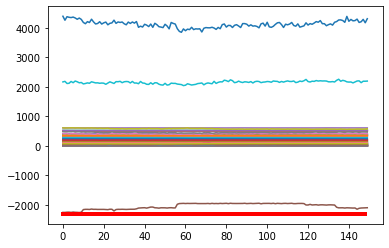

Predicción:  [[[0.9446587  0.05534128]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9795500e+01  1.0099500e+01  5.2960400e+01  7.6338200e+01
  6.0847100e+02  3.3922800e+01  1.0441900e+01  1.8701320e+02
  5.0000000e-04  7.0505700e+01  1.2666590e+02  9.0142000e+00
  6.4614100e+01  1.7701470e+02  2.1323200e+01  1.6187160e+02
  1.8597400e+02  7.0362300e+01 -4.0000000e-04  4.0928000e+00
  1.5306200e+01  7.0070000e+00  1.4980000e+00  7.2404900e+01
  1.4965000e+00  1.5625000e+00  9.1078500e+01  5.6772800e+01
  1.3694000e+00  1.2490000e+00  1.5890000e+00  1.4039000e+00
  1.5362630e+02  8.3330000e-01  8.4000000e-01 -2.1011573e+03
  2.0310170e+02  1.6535000e+00  1.4265000e+00  2.2047442e+03
  4.2286821e+03  1.8481450e+02  1.4372000e+00  1.4312000e+00
  8.0028000e+00  7.4011000e+00  1.7872000e+00  1.9840000e-01
  3.3196400e+01  5.2845110e+02  5.1989540e+02  5.1630830e+02
  5.1673760e+02  5.1727360e+02  2.9535700e+01  3.00

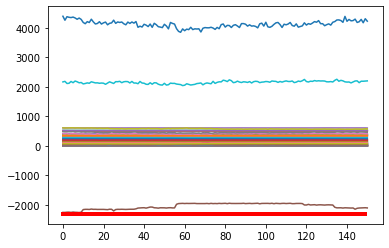

Predicción:  [[[0.93733203 0.06266801]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8707000e+01  1.0261800e+01  5.7617200e+01  7.7698700e+01
  6.1027200e+02  3.3996400e+01  1.0415700e+01  1.8694670e+02
  5.0000000e-04  6.8449900e+01  1.2634370e+02  9.0270000e+00
  6.6478900e+01  1.7466050e+02  2.1306000e+01  1.6195470e+02
  1.8606750e+02  7.0720100e+01 -4.0000000e-04  4.1002000e+00
  1.4342200e+01  7.0107000e+00  1.4994000e+00  7.2368200e+01
  1.4857000e+00  1.5512000e+00  9.1504000e+01  5.6895900e+01
  1.3613000e+00  1.2319000e+00  1.5859000e+00  1.3871000e+00
  1.5789820e+02  8.3390000e-01  8.4010000e-01 -2.1060243e+03
  2.0423900e+02  1.6432000e+00  1.4184000e+00  2.1881990e+03
  4.2267837e+03  1.8481450e+02  1.4197000e+00  1.4216000e+00
  8.0007000e+00  7.4009000e+00  1.7773000e+00  1.9140000e-01
  3.2977500e+01  5.2886670e+02  5.2031770e+02  5.1658280e+02
  5.1698360e+02  5.1761390e+02  3.0104700e+01  3.05

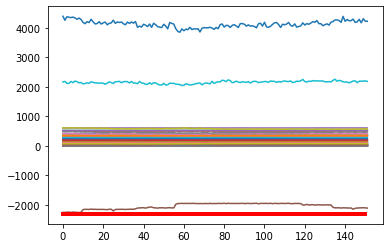

Predicción:  [[[0.9394573  0.06054262]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8222500e+01  1.0187200e+01  5.9532300e+01  7.6202100e+01
  6.1054180e+02  3.3786000e+01  1.0366700e+01  1.8701910e+02
  5.0000000e-04  6.8107500e+01  1.2623850e+02  9.0655000e+00
  6.5992300e+01  1.7269070e+02  2.1378600e+01  1.6209870e+02
  1.8598080e+02  7.0466800e+01 -4.0000000e-04  4.1008000e+00
  1.4621300e+01  6.9823000e+00  1.5000000e+00  7.2368900e+01
  1.4935000e+00  1.5606000e+00  9.2230100e+01  5.6661700e+01
  1.3685000e+00  1.2370000e+00  1.5970000e+00  1.3976000e+00
  1.5982200e+02  8.3450000e-01  8.4000000e-01 -2.0988722e+03
  2.0009630e+02  1.6531000e+00  1.4253000e+00  2.1857895e+03
  4.3358443e+03  1.8481450e+02  1.4313000e+00  1.4279000e+00
  7.9986000e+00  7.3990000e+00  1.7861000e+00  1.8960000e-01
  3.3338100e+01  5.2913330e+02  5.2097460e+02  5.1740030e+02
  5.1779100e+02  5.1833160e+02  3.0026400e+01  3.05

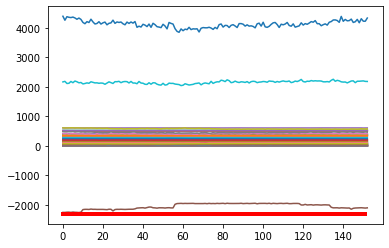

Predicción:  [[[0.9483651  0.05163487]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8130400e+01  1.0130400e+01  5.9081600e+01  7.6888700e+01
  6.1035460e+02  3.3778700e+01  1.0330700e+01  1.8700740e+02
  5.0000000e-04  6.7960800e+01  1.2606600e+02  9.0111000e+00
  6.6554900e+01  1.7298450e+02  2.1185100e+01  1.6159940e+02
  1.8599050e+02  7.0528200e+01 -4.0000000e-04  4.0868000e+00
  1.4664600e+01  7.0228000e+00  1.4989000e+00  7.2402900e+01
  1.4819000e+00  1.5473000e+00  9.1824200e+01  5.7336400e+01
  1.3572000e+00  1.2263000e+00  1.5846000e+00  1.3867000e+00
  1.5949650e+02  8.3650000e-01  8.3930000e-01 -2.1010547e+03
  2.0293180e+02  1.6401000e+00  1.4140000e+00  2.1370564e+03
  4.2741853e+03  1.8481450e+02  1.4227000e+00  1.4067000e+00
  7.9993000e+00  7.4006000e+00  1.7723000e+00  1.8770000e-01
  3.5928600e+01  5.2826670e+02  5.2003370e+02  5.1611490e+02
  5.1671620e+02  5.1725440e+02  3.0064500e+01  3.04

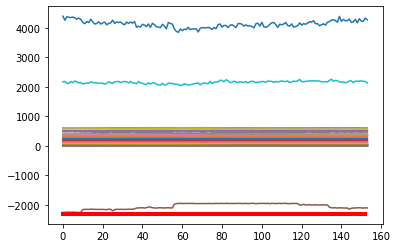

Predicción:  [[[0.9430306  0.05696942]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7731400e+01  9.9155000e+00  6.0034000e+01  7.7085000e+01
  6.0966960e+02  3.4685500e+01  1.0434400e+01  1.8706320e+02
  5.0000000e-04  6.7791800e+01  1.2588780e+02  8.8742000e+00
  6.6730400e+01  1.7248080e+02  2.1210900e+01  1.6201160e+02
  1.8609880e+02  7.0378600e+01 -4.0000000e-04  4.0969000e+00
  1.4820800e+01  6.9798000e+00  1.5001000e+00  7.2387300e+01
  1.4893000e+00  1.5525000e+00  9.0528400e+01  5.5752400e+01
  1.3639000e+00  1.2310000e+00  1.5932000e+00  1.3901000e+00
  1.6019590e+02  8.3550000e-01  8.4030000e-01 -2.1040488e+03
  2.0150620e+02  1.6436000e+00  1.4199000e+00  2.1655092e+03
  4.1700990e+03  1.8481450e+02  1.4260000e+00  1.4132000e+00
  8.0003000e+00  7.3984000e+00  1.7795000e+00  1.8540000e-01
  3.5777500e+01  5.2838230e+02  5.1978560e+02  5.1608590e+02
  5.1668140e+02  5.1723500e+02  2.9989400e+01  3.05

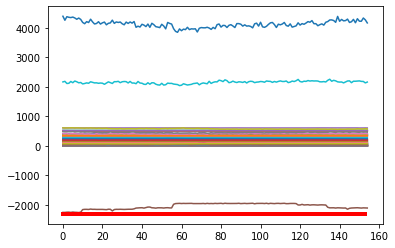

Predicción:  [[[0.9314385 0.0685615]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7332900e+01  9.8641000e+00  5.8578400e+01  7.6283600e+01
  6.0989010e+02  3.5999300e+01  1.0485400e+01  1.8700060e+02
  5.0000000e-04  6.8275200e+01  1.2601970e+02  9.0504000e+00
  6.6269000e+01  1.7249160e+02  2.1391600e+01  1.6210900e+02
  1.8617570e+02  7.0337500e+01 -4.0000000e-04  4.0890000e+00
  1.4839000e+01  7.0222000e+00  1.4992000e+00  7.2432500e+01
  1.5017000e+00  1.5683000e+00  9.0978300e+01  5.6177500e+01
  1.3769000e+00  1.2425000e+00  1.6057000e+00  1.4002000e+00
  1.5816680e+02  8.3640000e-01  8.3960000e-01 -2.1010143e+03
  2.0015540e+02  1.6597000e+00  1.4331000e+00  2.2128023e+03
  4.2279745e+03  1.8481450e+02  1.4363000e+00  1.4258000e+00
  7.9982000e+00  7.3919000e+00  1.7915000e+00  1.8570000e-01
  3.5959400e+01  5.2918440e+02  5.2066330e+02  5.1695340e+02
  5.1731230e+02  5.1775640e+02  3.0462500e+01  3.0654

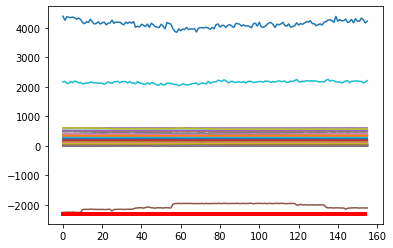

Predicción:  [[[0.9374699  0.06253011]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7262800e+01  9.8896000e+00  5.7388600e+01  7.5227600e+01
  6.1068770e+02  3.5312300e+01  1.0502700e+01  1.8700410e+02
  5.0000000e-04  6.8304700e+01  1.2545710e+02  8.9805000e+00
  6.6313400e+01  1.7327570e+02  2.1002900e+01  1.6164360e+02
  1.8634180e+02  6.9932700e+01 -4.0000000e-04  4.0970000e+00
  1.5818700e+01  6.9986000e+00  1.5000000e+00  7.2342700e+01
  1.5472000e+00  1.6103000e+00  9.0587400e+01  5.5619000e+01
  1.4167000e+00  1.2892000e+00  1.6493000e+00  1.4461000e+00
  1.5762020e+02  8.3740000e-01  8.4030000e-01 -2.1084372e+03
  1.9742490e+02  1.7029000e+00  1.4721000e+00  2.1997021e+03
  4.2604712e+03  1.8481450e+02  1.4815000e+00  1.4686000e+00
  8.0018000e+00  7.4047000e+00  1.8374000e+00  1.8770000e-01
  3.5487500e+01  5.2909780e+02  5.2104420e+02  5.1741900e+02
  5.1771500e+02  5.1814720e+02  3.0131700e+01  3.08

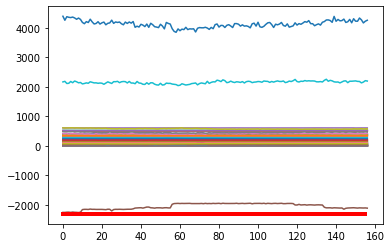

Predicción:  [[[0.9437049  0.05629506]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6769000e+01  1.0021400e+01  5.5108900e+01  7.8423400e+01
  6.0854890e+02  3.4819700e+01  1.0352700e+01  1.8704820e+02
  5.0000000e-04  6.8609900e+01  1.2636240e+02  8.8224000e+00
  6.6470000e+01  1.7443360e+02  2.1001700e+01  1.6202620e+02
  1.8597190e+02  7.0230300e+01 -4.0000000e-04  4.0859000e+00
  1.4716800e+01  7.0027000e+00  1.4999000e+00  7.2448200e+01
  1.5150000e+00  1.5794000e+00  9.3480500e+01  5.6932000e+01
  1.3896000e+00  1.2562000e+00  1.6143000e+00  1.4163000e+00
  1.6108130e+02  8.3820000e-01  8.4060000e-01 -2.0982698e+03
  2.0057360e+02  1.6716000e+00  1.4467000e+00  2.1828432e+03
  4.1802193e+03  1.8481450e+02  1.4516000e+00  1.4412000e+00
  8.0014000e+00  7.4094000e+00  1.8026000e+00  1.8860000e-01
  3.5292300e+01  5.2966660e+02  5.2144820e+02  5.1757220e+02
  5.1788800e+02  5.1829600e+02  3.0752700e+01  3.09

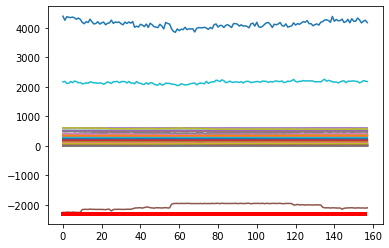

Predicción:  [[[0.9297874  0.07021255]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6707700e+01  1.0056000e+01  5.9297500e+01  7.7971100e+01
  6.1050640e+02  3.5416000e+01  1.0249700e+01  1.8696570e+02
  5.0000000e-04  6.7968200e+01  1.2620260e+02  8.9099000e+00
  6.6417400e+01  1.7498890e+02  2.0988200e+01  1.6183170e+02
  1.8561460e+02  7.0438100e+01 -4.0000000e-04  4.0986000e+00
  1.5655500e+01  6.9915000e+00  1.4994000e+00  7.2381400e+01
  1.4930000e+00  1.5573000e+00  9.0048000e+01  5.7604000e+01
  1.3675000e+00  1.2371000e+00  1.5903000e+00  1.3974000e+00
  1.6069010e+02  8.3670000e-01  8.3920000e-01 -2.0983791e+03
  2.0326200e+02  1.6477000e+00  1.4251000e+00  2.1925173e+03
  4.3193691e+03  1.8481450e+02  1.4287000e+00  1.4237000e+00
  7.9992000e+00  7.4009000e+00  1.7822000e+00  1.9150000e-01
  3.1521300e+01  5.2850220e+02  5.2032140e+02  5.1653910e+02
  5.1698490e+02  5.1726840e+02  3.1294900e+01  3.14

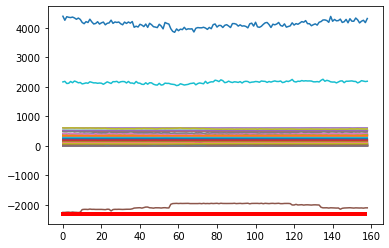

Predicción:  [[[0.946575   0.05342503]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7118000e+01  1.0012600e+01  5.6882900e+01  7.7041200e+01
  6.1004660e+02  3.5397700e+01  1.0277100e+01  1.8701890e+02
  5.0000000e-04  6.7983800e+01  1.2612520e+02  8.9170000e+00
  6.6319900e+01  1.7572540e+02  2.1364600e+01  1.6208930e+02
  1.8579470e+02  7.0520500e+01 -4.0000000e-04  4.1119000e+00
  1.5543400e+01  6.9980000e+00  1.5002000e+00  7.2398600e+01
  1.4849000e+00  1.5541000e+00  9.1807000e+01  5.7987000e+01
  1.3618000e+00  1.2356000e+00  1.5787000e+00  1.3949000e+00
  1.5872850e+02  8.3670000e-01  8.3980000e-01 -2.1011661e+03
  2.0177720e+02  1.6455000e+00  1.4199000e+00  2.2159248e+03
  4.3243828e+03  1.8481450e+02  1.4245000e+00  1.4217000e+00
  8.0019000e+00  7.4008000e+00  1.7742000e+00  1.9520000e-01
  2.9697300e+01  5.2866450e+02  5.2033010e+02  5.1663440e+02
  5.1719900e+02  5.1738170e+02  3.1622300e+01  3.19

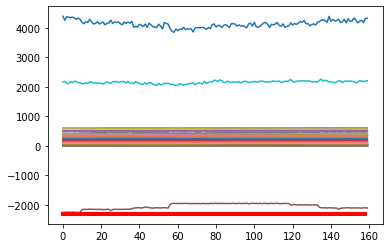

Predicción:  [[[0.9480711  0.05192888]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7264600e+01  1.0007600e+01  5.8964400e+01  7.7060900e+01
  6.1030710e+02  3.5110000e+01  1.0243400e+01  1.8703130e+02
  5.0000000e-04  6.7977400e+01  1.2593760e+02  8.9980000e+00
  6.6645600e+01  1.7594220e+02  2.1610900e+01  1.6180090e+02
  1.8603640e+02  7.0418500e+01 -4.0000000e-04  4.0952000e+00
  1.4677300e+01  6.9924000e+00  1.5013000e+00  7.2368500e+01
  1.4834000e+00  1.5527000e+00  9.1527000e+01  5.8268000e+01
  1.3588000e+00  1.2373000e+00  1.5782000e+00  1.3931000e+00
  1.5737490e+02  8.3830000e-01  8.4050000e-01 -2.1008289e+03
  2.0199390e+02  1.6439000e+00  1.4174000e+00  2.2442945e+03
  4.2988778e+03  1.8481450e+02  1.4237000e+00  1.4180000e+00
  7.9979000e+00  7.4003000e+00  1.7715000e+00  1.9320000e-01
  3.0789800e+01  5.2920220e+02  5.2080140e+02  5.1682730e+02
  5.1746420e+02  5.1766050e+02  3.1448400e+01  3.20

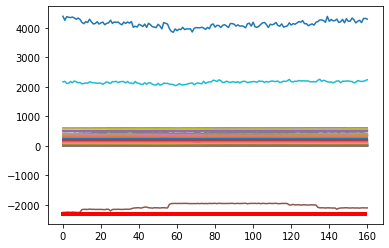

Predicción:  [[[0.9454389  0.05456106]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7763900e+01  1.0073000e+01  5.9250200e+01  7.7680800e+01
  6.1008440e+02  3.5492000e+01  1.0029300e+01  1.8699380e+02
  5.0000000e-04  6.7585100e+01  1.2591830e+02  9.1513000e+00
  6.5983900e+01  1.7676330e+02  2.1560900e+01  1.6191380e+02
  1.8624580e+02  7.0484200e+01 -4.0000000e-04  4.0937000e+00
  1.4637800e+01  6.9992000e+00  1.4994000e+00  7.2346300e+01
  1.4884000e+00  1.5580000e+00  9.1563000e+01  5.8446800e+01
  1.3639000e+00  1.2432000e+00  1.5816000e+00  1.4014000e+00
  1.5705480e+02  8.3820000e-01  8.3990000e-01 -2.0992454e+03
  2.0064430e+02  1.6504000e+00  1.4224000e+00  2.2386307e+03
  4.2981303e+03  1.8481450e+02  1.4364000e+00  1.4289000e+00
  8.0008000e+00  7.4017000e+00  1.7754000e+00  1.9380000e-01
  3.4852300e+01  5.3046440e+02  5.2137270e+02  5.1768200e+02
  5.1817510e+02  5.1835360e+02  3.1828700e+01  3.22

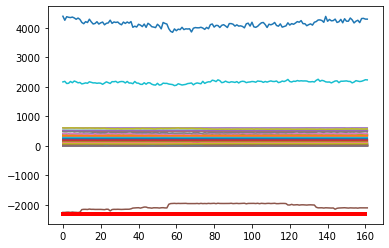

Predicción:  [[[0.9445261  0.05547398]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7983400e+01  9.9423000e+00  5.9942400e+01  7.9405500e+01
  6.1107360e+02  3.4925700e+01  1.0001600e+01  1.8706910e+02
  5.0000000e-04  6.7030100e+01  1.2559040e+02  8.9506000e+00
  6.5163700e+01  1.7600840e+02  2.2156600e+01  1.6173760e+02
  1.8602490e+02  7.0344000e+01 -4.0000000e-04  4.1047000e+00
  1.3951100e+01  6.9955000e+00  1.5004000e+00  7.2402700e+01
  1.4986000e+00  1.5670000e+00  9.2580100e+01  5.8370800e+01
  1.3744000e+00  1.2544000e+00  1.5942000e+00  1.4125000e+00
  1.5810760e+02  8.3830000e-01  8.3990000e-01 -2.1019781e+03
  2.0013170e+02  1.6585000e+00  1.4327000e+00  2.1956445e+03
  4.1958717e+03  1.8481450e+02  1.4492000e+00  1.4389000e+00
  8.0006000e+00  7.3977000e+00  1.7853000e+00  1.9120000e-01
  3.6497500e+01  5.3149780e+02  5.2235010e+02  5.1866480e+02
  5.1896520e+02  5.1914650e+02  3.1897200e+01  3.23

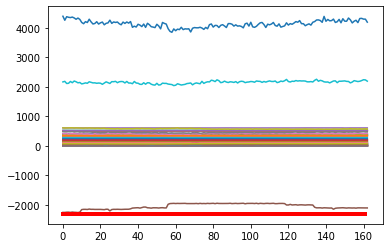

Predicción:  [[[0.93366253 0.06633744]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7977900e+01  9.8111000e+00  5.9362900e+01  7.7941200e+01
  6.1031270e+02  3.5136300e+01  1.0011100e+01  1.8701280e+02
  5.0000000e-04  6.6628500e+01  1.2604560e+02  9.0057000e+00
  6.6636500e+01  1.7500560e+02  2.2743200e+01  1.6177030e+02
  1.8587000e+02  7.0623300e+01 -4.0000000e-04  4.1097000e+00
  1.3723400e+01  7.0075000e+00  1.5000000e+00  7.2415500e+01
  1.4811000e+00  1.5538000e+00  9.2812900e+01  5.9328900e+01
  1.3569000e+00  1.2378000e+00  1.5802000e+00  1.3986000e+00
  1.5768730e+02  8.3830000e-01  8.3990000e-01 -2.0922807e+03
  2.0172120e+02  1.6467000e+00  1.4169000e+00  2.1675249e+03
  4.3702117e+03  1.8481450e+02  1.4339000e+00  1.4249000e+00
  7.9992000e+00  7.3975000e+00  1.7701000e+00  1.9010000e-01
  3.5279000e+01  5.3052000e+02  5.2148660e+02  5.1794570e+02
  5.1801070e+02  5.1831490e+02  3.2548600e+01  3.24

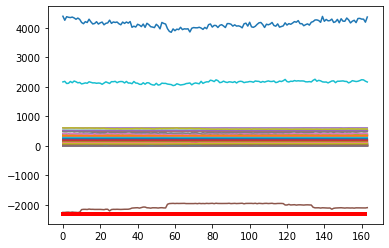

Predicción:  [[[0.94996405 0.05003598]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7574100e+01  9.9253000e+00  5.9724900e+01  7.5416000e+01
  6.1016950e+02  3.4880400e+01  9.9988000e+00  1.8698330e+02
  5.0000000e-04  6.6171100e+01  1.2607750e+02  9.0406000e+00
  6.6228500e+01  1.7542460e+02  2.2645400e+01  1.6220080e+02
  1.8595710e+02  7.0320500e+01 -4.0000000e-04  4.1040000e+00
  1.4650900e+01  6.9949000e+00  1.5000000e+00  7.2390100e+01
  1.4827000e+00  1.5530000e+00  9.1477100e+01  5.9138900e+01
  1.3587000e+00  1.2396000e+00  1.5807000e+00  1.3982000e+00
  1.5720510e+02  8.3750000e-01  8.4010000e-01 -2.0951460e+03
  2.0310480e+02  1.6450000e+00  1.4181000e+00  2.2201260e+03
  4.2372428e+03  1.8481450e+02  1.4308000e+00  1.4234000e+00
  8.0039000e+00  7.3999000e+00  1.7724000e+00  1.9200000e-01
  3.2531600e+01  5.2976670e+02  5.2107980e+02  5.1743420e+02
  5.1740000e+02  5.1781670e+02  3.2675700e+01  3.24

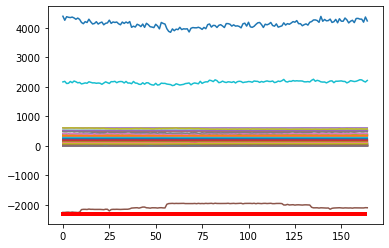

Predicción:  [[[0.9359833 0.0640167]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7928600e+01  9.7979000e+00  6.0027400e+01  7.6362200e+01
  6.1068060e+02  3.4679200e+01  1.0019900e+01  1.8698990e+02
  5.0000000e-04  6.4603900e+01  1.2611520e+02  8.8420000e+00
  6.6743300e+01  1.7267230e+02  2.2771000e+01  1.6236320e+02
  1.8583840e+02  7.0408300e+01 -4.0000000e-04  4.1305000e+00
  1.4800900e+01  6.9993000e+00  1.5004000e+00  7.2328900e+01
  1.4874000e+00  1.5546000e+00  9.1535300e+01  5.8474200e+01
  1.3624000e+00  1.2445000e+00  1.5887000e+00  1.3983000e+00
  1.5683270e+02  8.3680000e-01  8.4050000e-01 -2.1073749e+03
  2.0190400e+02  1.6458000e+00  1.4213000e+00  2.1749549e+03
  4.2625520e+03  1.8481450e+02  1.4302000e+00  1.4232000e+00
  8.0006000e+00  7.3936000e+00  1.7769000e+00  1.8840000e-01
  3.2221800e+01  5.3019780e+02  5.2148450e+02  5.1757460e+02
  5.1765530e+02  5.1811740e+02  3.2103300e+01  3.2501

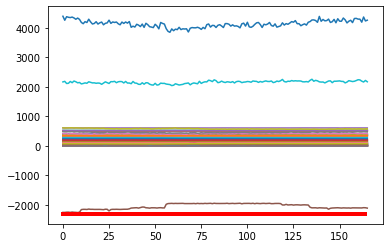

Predicción:  [[[0.9436989 0.0563012]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7797000e+01  9.5375000e+00  5.8634700e+01  7.6636900e+01
  6.0983180e+02  3.3455700e+01  1.0090300e+01  1.8705010e+02
  5.0000000e-04  6.4116100e+01  1.2611900e+02  8.8867000e+00
  6.6651800e+01  1.7073970e+02  2.3055900e+01  1.6194740e+02
  1.8556330e+02  7.0584600e+01 -4.0000000e-04  4.1992000e+00
  1.5063100e+01  6.9948000e+00  1.4993000e+00  7.2420600e+01
  1.4851000e+00  1.5546000e+00  9.2036500e+01  5.8530800e+01
  1.3645000e+00  1.2389000e+00  1.5906000e+00  1.4002000e+00
  1.6025750e+02  8.3780000e-01  8.4020000e-01 -2.1035919e+03
  2.0296540e+02  1.6461000e+00  1.4234000e+00  2.2425590e+03
  4.1961926e+03  1.8481450e+02  1.4327000e+00  1.4263000e+00
  7.9970000e+00  7.3994000e+00  1.7759000e+00  1.8530000e-01
  3.2471500e+01  5.2993330e+02  5.2139390e+02  5.1763110e+02
  5.1767170e+02  5.1811220e+02  3.2135000e+01  3.2356

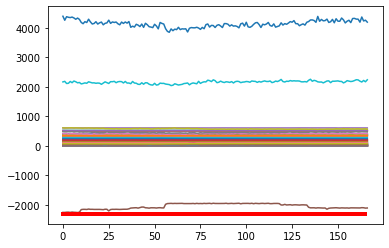

Predicción:  [[[0.93408287 0.06591712]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7865500e+01  9.4340000e+00  5.8593700e+01  7.7147500e+01
  6.1046280e+02  3.2660500e+01  1.0085500e+01  1.8703200e+02
  5.0000000e-04  6.4650400e+01  1.2606740e+02  9.0055000e+00
  6.6715200e+01  1.7001630e+02  2.3218600e+01  1.6157490e+02
  1.8542030e+02  7.0329300e+01 -4.0000000e-04  4.1838000e+00
  1.4233500e+01  7.0162000e+00  1.4997000e+00  7.2337100e+01
  1.5042000e+00  1.5740000e+00  9.1866300e+01  5.8177500e+01
  1.3793000e+00  1.2582000e+00  1.6125000e+00  1.4184000e+00
  1.6109070e+02  8.3820000e-01  8.4030000e-01 -2.0951582e+03
  2.0206830e+02  1.6664000e+00  1.4373000e+00  2.2159258e+03
  4.3101158e+03  1.8481450e+02  1.4509000e+00  1.4444000e+00
  7.9995000e+00  7.4004000e+00  1.7944000e+00  1.8190000e-01
  3.2690500e+01  5.3073550e+02  5.2163060e+02  5.1801570e+02
  5.1806780e+02  5.1851410e+02  3.2127500e+01  3.25

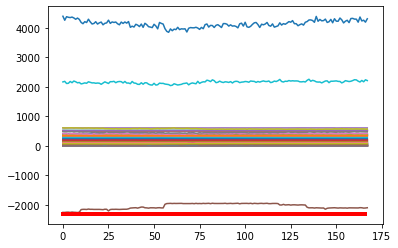

Predicción:  [[[0.9442435  0.05575647]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7647800e+01  9.2643000e+00  5.7775000e+01  7.8343300e+01
  6.0985930e+02  3.3140400e+01  1.0043800e+01  1.8710300e+02
  5.0000000e-04  6.4579400e+01  1.2613100e+02  9.2845000e+00
  6.7163900e+01  1.7085990e+02  2.3363800e+01  1.6002410e+02
  1.8513360e+02  7.0582400e+01 -4.0000000e-04  4.1152000e+00
  1.4194300e+01  6.9783000e+00  1.5005000e+00  7.2430100e+01
  1.4858000e+00  1.5580000e+00  9.1343600e+01  5.9480000e+01
  1.3657000e+00  1.2429000e+00  1.5917000e+00  1.4029000e+00
  1.5959380e+02  8.3800000e-01  8.3980000e-01 -2.0991113e+03
  2.0224390e+02  1.6498000e+00  1.4252000e+00  2.1920695e+03
  4.2572687e+03  1.8481450e+02  1.4340000e+00  1.4293000e+00
  8.0029000e+00  7.4011000e+00  1.7772000e+00  1.8560000e-01
  3.1344100e+01  5.3036450e+02  5.2184150e+02  5.1802640e+02
  5.1799520e+02  5.1851050e+02  3.2559200e+01  3.25

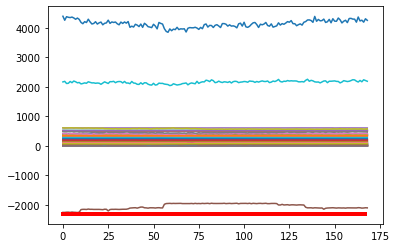

Predicción:  [[[0.9397683 0.0602317]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7381400e+01  9.1508000e+00  6.0115400e+01  7.6185900e+01
  6.0969380e+02  3.3528100e+01  1.0033700e+01  1.8707390e+02
  5.0000000e-04  6.4134700e+01  1.2583160e+02  9.0736000e+00
  6.6871600e+01  1.7147310e+02  2.3421100e+01  1.5994810e+02
  1.8491230e+02  7.0360200e+01 -4.0000000e-04  4.0958000e+00
  1.5395800e+01  7.0231000e+00  1.4998000e+00  7.2387400e+01
  1.4821000e+00  1.5516000e+00  9.0600900e+01  5.8342400e+01
  1.3613000e+00  1.2392000e+00  1.5849000e+00  1.3965000e+00
  1.5855910e+02  8.3820000e-01  8.4030000e-01 -2.1037172e+03
  2.0163640e+02  1.6428000e+00  1.4198000e+00  2.1936311e+03
  4.1309577e+03  1.8481450e+02  1.4269000e+00  1.4228000e+00
  7.9994000e+00  7.4018000e+00  1.7746000e+00  1.8970000e-01
  3.0558000e+01  5.2991300e+02  5.2147920e+02  5.1758160e+02
  5.1761760e+02  5.1806640e+02  3.3408500e+01  3.2703

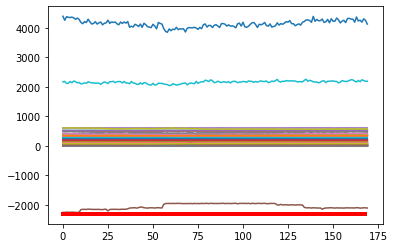

Predicción:  [[[0.9253432  0.07465675]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7577500e+01  9.2437000e+00  5.9758400e+01  7.4677200e+01
  6.1042320e+02  3.3569100e+01  1.0020000e+01  1.8702300e+02
  5.0000000e-04  6.4117300e+01  1.2629040e+02  8.9300000e+00
  6.7188800e+01  1.7166240e+02  2.3570400e+01  1.5988350e+02
  1.8505910e+02  7.0345100e+01 -4.0000000e-04  4.1048000e+00
  1.6131000e+01  7.0179000e+00  1.4985000e+00  7.2403400e+01
  1.4883000e+00  1.5575000e+00  9.1127700e+01  5.8952200e+01
  1.3674000e+00  1.2453000e+00  1.5882000e+00  1.4027000e+00
  1.5848490e+02  8.3840000e-01  8.3980000e-01 -2.1048865e+03
  2.0363560e+02  1.6483000e+00  1.4263000e+00  2.1944861e+03
  4.1935508e+03  1.8481450e+02  1.4329000e+00  1.4280000e+00
  7.9977000e+00  7.3997000e+00  1.7801000e+00  1.9190000e-01
  3.0455900e+01  5.2991930e+02  5.2112070e+02  5.1736020e+02
  5.1744950e+02  5.1788910e+02  3.3457700e+01  3.29

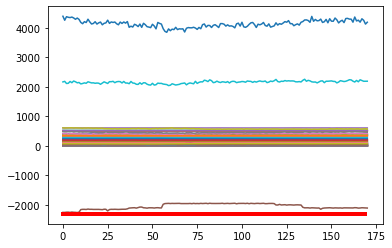

Predicción:  [[[0.9340401 0.0659598]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.6994400e+01  9.2093000e+00  6.0066700e+01  7.5851700e+01
  6.0968700e+02  3.3349800e+01  9.9716000e+00  1.8701440e+02
  5.0000000e-04  6.4324900e+01  1.2592290e+02  8.9162000e+00
  6.6853100e+01  1.7026660e+02  2.3489100e+01  1.6026900e+02
  1.8502350e+02  7.0430000e+01 -4.0000000e-04  4.1060000e+00
  1.5711800e+01  6.9931000e+00  1.4991000e+00  7.2403000e+01
  1.4903000e+00  1.5600000e+00  9.1433800e+01  5.8354300e+01
  1.3680000e+00  1.2497000e+00  1.5918000e+00  1.4068000e+00
  1.5779070e+02  8.3810000e-01  8.4010000e-01 -2.1002544e+03
  2.0262550e+02  1.6510000e+00  1.4274000e+00  2.1941302e+03
  4.2608091e+03  1.8481450e+02  1.4372000e+00  1.4320000e+00
  7.9990000e+00  7.4002000e+00  1.7804000e+00  1.8840000e-01
  3.0262700e+01  5.3078440e+02  5.2171050e+02  5.1798240e+02
  5.1810170e+02  5.1851280e+02  3.2919600e+01  3.3090

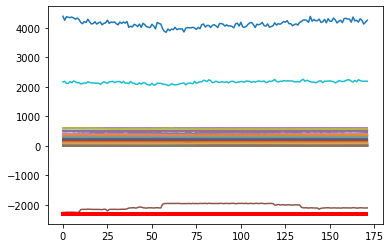

Predicción:  [[[0.940262   0.05973794]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7141400e+01  9.2406000e+00  5.9549800e+01  7.6733500e+01
  6.0956420e+02  3.4143700e+01  9.9941000e+00  1.8699780e+02
  5.0000000e-04  6.4540100e+01  1.2569370e+02  8.9821000e+00
  6.7092900e+01  1.7168270e+02  2.3341000e+01  1.6003000e+02
  1.8504030e+02  7.0397700e+01 -4.0000000e-04  4.0930000e+00
  1.5298300e+01  7.0134000e+00  1.4981000e+00  7.2405400e+01
  1.4798000e+00  1.5514000e+00  9.2038100e+01  5.9288400e+01
  1.3608000e+00  1.2409000e+00  1.5815000e+00  1.3972000e+00
  1.5706070e+02  8.3860000e-01  8.4000000e-01 -2.1018908e+03
  2.0219400e+02  1.6437000e+00  1.4203000e+00  2.2383226e+03
  4.2612198e+03  1.8481450e+02  1.4274000e+00  1.4213000e+00
  8.0016000e+00  7.3995000e+00  1.7689000e+00  1.8730000e-01
  3.0144600e+01  5.3006880e+02  5.2146490e+02  5.1775270e+02
  5.1786560e+02  5.1820450e+02  3.2831600e+01  3.29

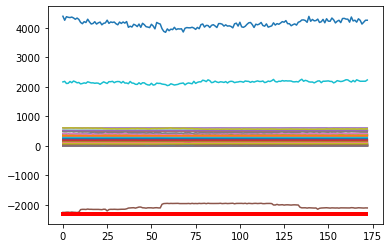

Predicción:  [[[0.94088334 0.05911665]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7332400e+01  9.1658000e+00  5.9740400e+01  7.6383700e+01
  6.0948890e+02  3.4773200e+01  9.9701000e+00  1.8695150e+02
  5.0000000e-04  6.4291600e+01  1.2592570e+02  8.9169000e+00
  6.6238500e+01  1.7307060e+02  2.2747800e+01  1.5986090e+02
  1.8491140e+02  7.0293900e+01 -4.0000000e-04  4.1085000e+00
  1.5979700e+01  6.9971000e+00  1.4995000e+00  7.2448400e+01
  1.4748000e+00  1.5473000e+00  9.0972400e+01  5.8200800e+01
  1.3572000e+00  1.2356000e+00  1.5715000e+00  1.3938000e+00
  1.5678200e+02  8.3720000e-01  8.3920000e-01 -2.0969766e+03
  2.0420370e+02  1.6391000e+00  1.4156000e+00  2.2202226e+03
  4.2097460e+03  1.8481450e+02  1.4244000e+00  1.4180000e+00
  8.0013000e+00  7.4024000e+00  1.7640000e+00  1.9230000e-01
  3.0406200e+01  5.2981340e+02  5.2129700e+02  5.1775570e+02
  5.1774030e+02  5.1801380e+02  3.2337500e+01  3.30

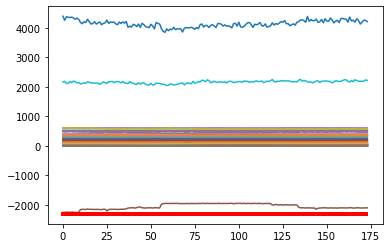

Predicción:  [[[0.9327889  0.06721103]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7277400e+01  9.1851000e+00  5.9993400e+01  7.5783200e+01
  6.0923430e+02  3.5617400e+01  9.9589000e+00  1.8696430e+02
  5.0000000e-04  6.3898200e+01  1.2547170e+02  9.0819000e+00
  6.6465800e+01  1.7310990e+02  2.2321600e+01  1.5975620e+02
  1.8486290e+02  7.0488600e+01 -4.0000000e-04  4.1000000e+00
  1.6639200e+01  7.0222000e+00  1.4997000e+00  7.2345000e+01
  1.4755000e+00  1.5510000e+00  9.2070100e+01  5.9458400e+01
  1.3576000e+00  1.2365000e+00  1.5730000e+00  1.3937000e+00
  1.5570690e+02  8.3840000e-01  8.3880000e-01 -2.1004515e+03
  2.0416250e+02  1.6436000e+00  1.4168000e+00  2.1599465e+03
  4.2823182e+03  1.8481450e+02  1.4236000e+00  1.4182000e+00
  7.9979000e+00  7.4045000e+00  1.7657000e+00  1.9280000e-01
  2.9884500e+01  5.2960440e+02  5.2104060e+02  5.1749840e+02
  5.1748110e+02  5.1772580e+02  3.2169900e+01  3.33

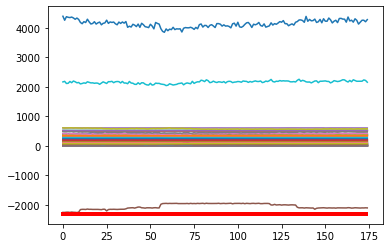

Predicción:  [[[0.9430219  0.05697814]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  175  - Datos Recibidos:  [ 5.6973800e+01  9.1882000e+00  6.0292100e+01  7.5754400e+01
  6.0966930e+02  3.5175200e+01  9.9567000e+00  1.8692220e+02
  5.0000000e-04  6.3668800e+01  1.2619620e+02  8.9987000e+00
  6.4862400e+01  1.7146590e+02  2.2137700e+01  1.5990740e+02
  1.8509430e+02  7.0533700e+01 -4.0000000e-04  4.1119000e+00
  1.6591400e+01  6.9795000e+00  1.5004000e+00  7.2397000e+01
  1.4790000e+00  1.5500000e+00  9.1914300e+01  5.9347000e+01
  1.3577000e+00  1.2408000e+00  1.5753000e+00  1.3976000e+00
  1.5667130e+02  8.3560000e-01  8.4020000e-01 -2.1014612e+03
  2.0343460e+02  1.6413000e+00  1.4169000e+00  2.1970819e+03
  4.3395284e+03  1.8481450e+02  1.4275000e+00  1.4190000e+00
  8.0019000e+00  7.3986000e+00  1.7673000e+00  1.9200000e-01
  2.9979700e+01  5.2946230e+02  5.2077680e+02  5.1733340e+02
  5.1741250e+02  5.1766510e+02  3.217330

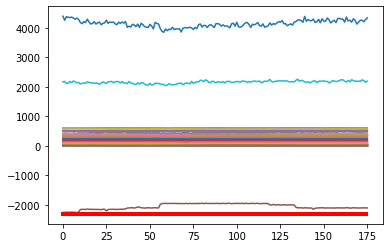

Predicción:  [[[0.9493667  0.05063332]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.6806400e+01  9.0714000e+00  5.7862000e+01  7.5348500e+01
  6.0985010e+02  3.5828100e+01  1.0043800e+01  1.8702780e+02
  5.0000000e-04  6.4079600e+01  1.2620740e+02  9.0355000e+00
  6.6090800e+01  1.7244140e+02  2.1711800e+01  1.5993660e+02
  1.8508390e+02  7.0527200e+01 -4.0000000e-04  4.1233000e+00
  1.5699800e+01  7.0006000e+00  1.4998000e+00  7.2450400e+01
  1.4641000e+00  1.5369000e+00  9.1691500e+01  5.9333000e+01
  1.3457000e+00  1.2234000e+00  1.5575000e+00  1.3822000e+00
  1.5812170e+02  8.3530000e-01  8.3950000e-01 -2.0979999e+03
  2.0213980e+02  1.6293000e+00  1.4048000e+00  2.2370001e+03
  4.2735215e+03  1.8481450e+02  1.4133000e+00  1.4076000e+00
  8.0014000e+00  7.4016000e+00  1.7536000e+00  1.9620000e-01
  3.0896200e+01  5.2942000e+02  5.2087940e+02  5.1704980e+02
  5.1705210e+02  5.1743610e+02  3.1670100e+01  3.28

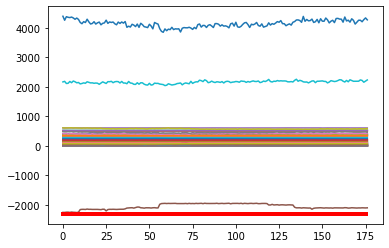

Predicción:  [[[0.94063705 0.0593629 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.6765400e+01  9.0332000e+00  5.8153800e+01  7.5245900e+01
  6.1008820e+02  3.4888100e+01  1.0095000e+01  1.8697280e+02
  5.0000000e-04  6.4618600e+01  1.2617590e+02  8.7767000e+00
  6.6326600e+01  1.7334140e+02  2.1565800e+01  1.6014450e+02
  1.8495860e+02  7.0286700e+01 -4.0000000e-04  4.1968000e+00
  1.6097800e+01  7.0148000e+00  1.5007000e+00  7.2376100e+01
  1.4928000e+00  1.5648000e+00  9.0157500e+01  5.8904100e+01
  1.3734000e+00  1.2498000e+00  1.5879000e+00  1.4087000e+00
  1.5922150e+02  8.3630000e-01  8.4060000e-01 -2.0985181e+03
  2.0146150e+02  1.6560000e+00  1.4320000e+00  2.2399732e+03
  4.2183668e+03  1.8481450e+02  1.4396000e+00  1.4309000e+00
  8.0007000e+00  7.3988000e+00  1.7822000e+00  1.9380000e-01
  3.1009800e+01  5.3049780e+02  5.2164200e+02  5.1798640e+02
  5.1801690e+02  5.1848430e+02  3.1619100e+01  3.26

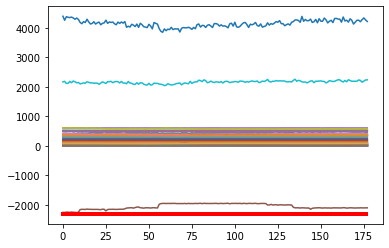

Predicción:  [[[0.93432933 0.06567062]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.6805300e+01  8.9493000e+00  5.7848000e+01  7.7395400e+01
  6.0936730e+02  3.4822700e+01  1.0107200e+01  1.8698510e+02
  5.0000000e-04  6.4328300e+01  1.2627900e+02  9.2598000e+00
  6.5795600e+01  1.7281580e+02  2.2086100e+01  1.6004000e+02
  1.8461330e+02  7.0353100e+01 -4.0000000e-04  4.1853000e+00
  1.5770800e+01  7.0126000e+00  1.5003000e+00  7.2367800e+01
  1.4882000e+00  1.5616000e+00  9.0315500e+01  5.8680700e+01
  1.3701000e+00  1.2450000e+00  1.5833000e+00  1.4039000e+00
  1.6023920e+02  8.3510000e-01  8.4000000e-01 -2.1061710e+03
  2.0286900e+02  1.6533000e+00  1.4288000e+00  2.2449273e+03
  4.2092007e+03  1.8481450e+02  1.4366000e+00  1.4285000e+00
  8.0003000e+00  7.4006000e+00  1.7775000e+00  1.9390000e-01
  3.2770700e+01  5.3036770e+02  5.2208550e+02  5.1835630e+02
  5.1836400e+02  5.1880010e+02  3.1409700e+01  3.26

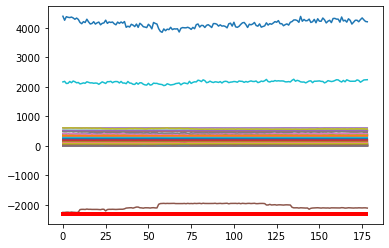

Predicción:  [[[0.9361643  0.06383569]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9512000e+01  9.0000000e+00  6.0016800e+01  7.6255100e+01
  6.1009990e+02  3.6314300e+01  1.0121900e+01  1.8704760e+02
  5.0000000e-04  6.6157300e+01  1.2637260e+02  9.1142000e+00
  6.5871100e+01  1.7501590e+02  2.1983200e+01  1.5923580e+02
  1.8455910e+02  7.0605100e+01 -4.0000000e-04  4.1992000e+00
  1.3167500e+01  6.9901000e+00  1.4988000e+00  7.2440900e+01
  1.4829000e+00  1.5551000e+00  9.1321000e+01  5.8618300e+01
  1.3589000e+00  1.2405000e+00  1.5740000e+00  1.4024000e+00
  1.6039400e+02  8.3450000e-01  8.4050000e-01 -2.0912314e+03
  2.0291930e+02  1.6464000e+00  1.4175000e+00  2.1906496e+03
  4.2233581e+03  1.8481450e+02  1.4349000e+00  1.4261000e+00
  8.0000000e+00  7.3999000e+00  1.7703000e+00  1.9630000e-01
  3.2256500e+01  5.2965110e+02  5.2171450e+02  5.1793230e+02
  5.1794490e+02  5.1830100e+02  3.1218800e+01  3.25

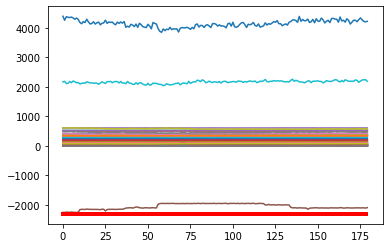

Predicción:  [[[0.9325262 0.0674739]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7224100e+01  7.7811000e+00  6.0285600e+01  7.5162100e+01
  6.1038760e+02  3.6148300e+01  1.0109000e+01  1.8693140e+02
  5.0000000e-04  6.7577300e+01  1.2587500e+02  9.0363000e+00
  6.5075300e+01  1.7661110e+02  2.1826300e+01  1.5499570e+02
  1.8351890e+02  7.0573300e+01 -4.0000000e-04  4.1629000e+00
  1.2096400e+01  7.0010000e+00  1.5003000e+00  7.2436200e+01
  1.4731000e+00  1.5463000e+00  9.1276900e+01  5.9577100e+01
  1.3503000e+00  1.2332000e+00  1.5664000e+00  1.3921000e+00
  1.5795930e+02  8.3490000e-01  8.3980000e-01 -2.0932168e+03
  2.0336130e+02  1.6379000e+00  1.4096000e+00  2.2489951e+03
  4.2875594e+03  1.8481450e+02  1.4258000e+00  1.4150000e+00
  7.9999000e+00  7.4002000e+00  1.7616000e+00  1.9540000e-01
  3.3327800e+01  5.2965110e+02  5.2124990e+02  5.1760920e+02
  5.1761110e+02  5.1801660e+02  3.1026500e+01  3.2276

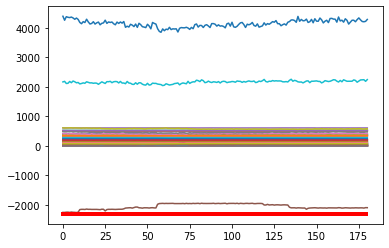

Predicción:  [[[0.9410824  0.05891758]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7178800e+01  9.5771000e+00  5.8699300e+01  7.4756000e+01
  6.1090240e+02  3.5641200e+01  1.0045000e+01  1.8701010e+02
  5.0000000e-04  6.7449300e+01  1.2562940e+02  9.1773000e+00
  6.4930000e+01  1.7642020e+02  2.0609100e+01  1.5745840e+02
  1.8541910e+02  7.0469400e+01 -4.0000000e-04  4.1069000e+00
  1.3292400e+01  6.9963000e+00  1.4986000e+00  7.2377600e+01
  1.4778000e+00  1.5485000e+00  9.1475700e+01  5.8756200e+01
  1.3572000e+00  1.2391000e+00  1.5680000e+00  1.3922000e+00
  1.5418980e+02  8.3400000e-01  8.3840000e-01 -2.1073419e+03
  2.0055840e+02  1.6398000e+00  1.4159000e+00  2.2055112e+03
  4.2581229e+03  1.8481450e+02  1.4265000e+00  1.4158000e+00
  7.9973000e+00  7.3895000e+00  1.7666000e+00  1.9870000e-01
  3.4586100e+01  5.2940000e+02  5.2083720e+02  5.1723850e+02
  5.1720120e+02  5.1755860e+02  3.1838800e+01  3.23

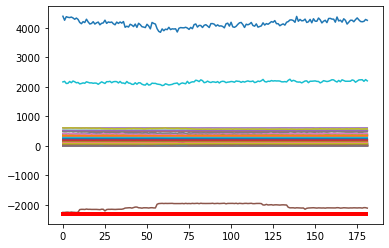

Predicción:  [[[0.943426   0.05657404]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7122400e+01  1.0264700e+01  5.6860400e+01  7.6239800e+01
  6.0965450e+02  3.5786400e+01  1.0093400e+01  1.8694360e+02
  5.0000000e-04  6.7408600e+01  1.2594290e+02  9.0273000e+00
  6.3794500e+01  1.7721620e+02  2.0010800e+01  1.5818420e+02
  1.8610960e+02  7.0354000e+01 -4.0000000e-04  4.2026000e+00
  1.3514300e+01  7.0083000e+00  1.4995000e+00  7.2358900e+01
  1.5005000e+00  1.5706000e+00  9.0220900e+01  5.7643800e+01
  1.3812000e+00  1.2624000e+00  1.5848000e+00  1.4137000e+00
  1.5347400e+02  8.3570000e-01  8.4110000e-01 -2.1018185e+03
  2.0081180e+02  1.6602000e+00  1.4391000e+00  2.2244473e+03
  4.2226124e+03  1.8481450e+02  1.4482000e+00  1.4362000e+00
  8.0006000e+00  7.4078000e+00  1.7885000e+00  2.0300000e-01
  3.4653900e+01  5.2923120e+02  5.2112670e+02  5.1748260e+02
  5.1746930e+02  5.1783670e+02  3.1279000e+01  3.18

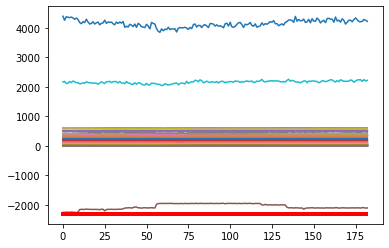

Predicción:  [[[0.93675685 0.06324315]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0957400e+01  1.0574400e+01  5.7475900e+01  7.8408800e+01
  6.1006600e+02  3.6017400e+01  1.0136400e+01  1.8706370e+02
  5.0000000e-04  6.6583300e+01  1.2614780e+02  8.9833000e+00
  6.4204200e+01  1.7735030e+02  2.0041900e+01  1.6000510e+02
  1.8639990e+02  7.0613400e+01 -4.0000000e-04  4.2205000e+00
  1.3741800e+01  7.0082000e+00  1.5010000e+00  7.2362800e+01
  1.4910000e+00  1.5624000e+00  9.1815300e+01  5.7781700e+01
  1.3679000e+00  1.2470000e+00  1.5746000e+00  1.4022000e+00
  1.5528570e+02  8.3640000e-01  8.4040000e-01 -2.0947993e+03
  2.0189100e+02  1.6542000e+00  1.4255000e+00  2.2093495e+03
  4.3374062e+03  1.8481450e+02  1.4377000e+00  1.4265000e+00
  8.0030000e+00  7.4063000e+00  1.7781000e+00  2.0380000e-01
  3.5411600e+01  5.2991550e+02  5.2147370e+02  5.1799930e+02
  5.1800430e+02  5.1843530e+02  3.1053800e+01  3.16

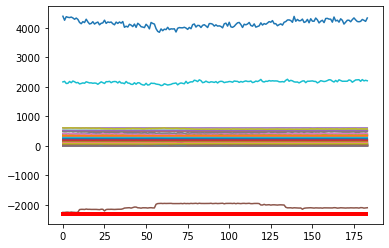

Predicción:  [[[0.94762105 0.05237889]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0902400e+01  1.0642800e+01  5.9345600e+01  7.9148100e+01
  6.0987200e+02  3.7119500e+01  1.0133500e+01  1.8694810e+02
  1.0000000e-02  6.5016700e+01  1.2557600e+02  8.9899000e+00
  6.4599100e+01  1.7766090e+02  2.0035400e+01  1.5987050e+02
  1.8636340e+02  7.0559100e+01 -4.0000000e-04  4.2016000e+00
  1.4714200e+01  7.0143000e+00  1.4990000e+00  7.2401600e+01
  1.4921000e+00  1.5626000e+00  9.1392000e+01  5.7392800e+01
  1.3747000e+00  1.2469000e+00  1.5712000e+00  1.4028000e+00
  1.5639420e+02  8.3600000e-01  8.3940000e-01 -2.1046063e+03
  2.0119630e+02  1.6545000e+00  1.4320000e+00  2.1925249e+03
  4.2404933e+03  1.8481450e+02  1.4392000e+00  1.4270000e+00
  7.9984000e+00  7.3983000e+00  1.7785000e+00  2.0730000e-01
  3.6489500e+01  5.3001780e+02  5.2158240e+02  5.1803550e+02
  5.1802660e+02  5.1842180e+02  3.0874200e+01  3.16

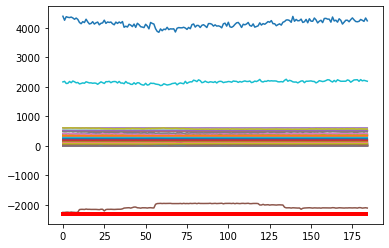

Predicción:  [[[0.94049966 0.05950035]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0824100e+01  1.0480800e+01  6.0023000e+01  7.9139600e+01
  6.0980060e+02  3.6812100e+01  1.0143500e+01  1.8697380e+02
  3.5500000e-02  6.4186500e+01  1.2600110e+02  8.9953000e+00
  6.4738800e+01  1.7645730e+02  2.0051300e+01  1.5990890e+02
  1.8624800e+02  7.0766900e+01 -4.0000000e-04  4.1919000e+00
  1.3612900e+01  6.9837000e+00  1.5009000e+00  7.2440500e+01
  1.4810000e+00  1.5552000e+00  9.1931000e+01  5.8998000e+01
  1.3634000e+00  1.2374000e+00  1.5642000e+00  1.3951000e+00
  1.5666840e+02  8.3600000e-01  8.3960000e-01 -2.0895351e+03
  2.0388920e+02  1.6461000e+00  1.4223000e+00  2.2082970e+03
  4.2547087e+03  1.8481450e+02  1.4322000e+00  1.4190000e+00
  7.9981000e+00  7.4006000e+00  1.7680000e+00  2.0360000e-01
  3.7056100e+01  5.3030220e+02  5.2175630e+02  5.1799980e+02
  5.1788770e+02  5.1843880e+02  3.0553800e+01  3.15

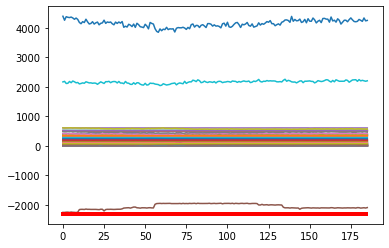

Predicción:  [[[0.93576664 0.06423336]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0760900e+01  1.0502900e+01  5.9995400e+01  7.8102200e+01
  6.0979920e+02  3.6858500e+01  1.0128000e+01  1.8696250e+02
  6.2600000e-02  6.4694900e+01  1.2602170e+02  9.0966000e+00
  6.4974000e+01  1.7718500e+02  2.0227400e+01  1.5994830e+02
  1.8636580e+02  7.0538200e+01 -4.0000000e-04  4.1727000e+00
  1.4026800e+01  7.0088000e+00  1.5001000e+00  7.2347700e+01
  1.4856000e+00  1.5578000e+00  9.1871200e+01  5.8632200e+01
  1.3633000e+00  1.2382000e+00  1.5644000e+00  1.3950000e+00
  1.5805610e+02  8.3550000e-01  8.4030000e-01 -2.1017617e+03
  2.0183910e+02  1.6508000e+00  1.4216000e+00  2.2620175e+03
  4.2332384e+03  1.8481450e+02  1.4318000e+00  1.4177000e+00
  7.9966000e+00  7.4010000e+00  1.7722000e+00  2.0760000e-01
  3.7050600e+01  5.2969790e+02  5.2148380e+02  5.1782940e+02
  5.1773140e+02  5.1821400e+02  3.0490500e+01  3.15

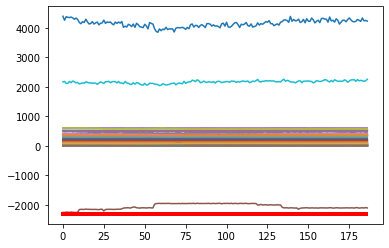

Predicción:  [[[0.9379336  0.06206645]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0796100e+01  1.0431200e+01  5.9146800e+01  7.7715800e+01
  6.1006250e+02  3.7101500e+01  9.6191000e+00  1.8705840e+02
  7.1200000e-02  6.4335700e+01  1.2660820e+02  9.1534000e+00
  6.5401700e+01  1.7644190e+02  2.0322100e+01  1.5978920e+02
  1.8625090e+02  7.0849900e+01 -4.0000000e-04  4.2171000e+00
  1.4030100e+01  7.0058000e+00  1.4993000e+00  7.2392100e+01
  1.4705000e+00  1.5410000e+00  9.1254200e+01  5.9154400e+01
  1.3487000e+00  1.2241000e+00  1.5496000e+00  1.3827000e+00
  1.5867350e+02  8.3570000e-01  8.4010000e-01 -2.0972600e+03
  2.0330130e+02  1.6326000e+00  1.4076000e+00  2.2116078e+03
  4.3496098e+03  1.8481450e+02  1.4192000e+00  1.4046000e+00
  8.0036000e+00  7.4032000e+00  1.7578000e+00  2.0810000e-01
  3.6587800e+01  5.2866890e+02  5.2162520e+02  5.1804030e+02
  5.1793990e+02  5.1835470e+02  3.0152500e+01  3.13

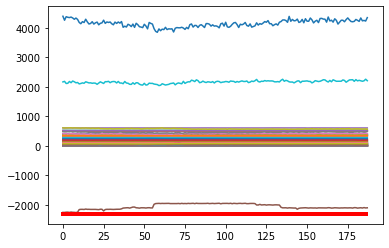

Predicción:  [[[0.94972444 0.05027562]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0798700e+01  1.0457600e+01  5.9899600e+01  7.6828500e+01
  6.0948560e+02  3.6328200e+01  9.4887000e+00  1.8705330e+02
  8.8300000e-02  6.2995900e+01  1.2618160e+02  9.0743000e+00
  6.4896800e+01  1.7472160e+02  2.0393500e+01  1.5991800e+02
  1.8613110e+02  7.0855700e+01 -4.0000000e-04  4.1834000e+00
  1.3654700e+01  6.9831000e+00  1.4992000e+00  7.2378200e+01
  1.4724000e+00  1.5415000e+00  8.9041800e+01  5.9181400e+01
  1.3487000e+00  1.2268000e+00  1.5581000e+00  1.3833000e+00
  1.5876670e+02  8.3600000e-01  8.4050000e-01 -2.1036456e+03
  2.0369070e+02  1.6306000e+00  1.4078000e+00  2.2006734e+03
  4.2346371e+03  1.8481450e+02  1.4199000e+00  1.4064000e+00
  7.9996000e+00  7.3991000e+00  1.7599000e+00  2.0210000e-01
  3.6670900e+01  5.2840000e+02  5.2186460e+02  5.1807170e+02
  5.1803490e+02  5.1841080e+02  2.9959000e+01  3.11

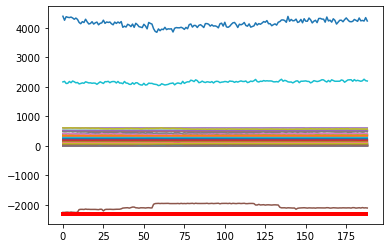

Predicción:  [[[0.9393684  0.06063162]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1181600e+01  1.0458000e+01  6.0023600e+01  7.7466600e+01
  6.1073330e+02  3.6689400e+01  1.0066300e+01  1.8694130e+02
  1.0240000e-01  6.2097500e+01  1.2577280e+02  8.9766000e+00
  6.4500000e+01  1.7388150e+02  2.0188200e+01  1.5995400e+02
  1.8618180e+02  7.0869900e+01 -4.0000000e-04  4.2148000e+00
  1.2636300e+01  7.0044000e+00  1.5003000e+00  7.2452300e+01
  1.4692000e+00  1.5396000e+00  8.9342700e+01  5.9450000e+01
  1.3437000e+00  1.2244000e+00  1.5575000e+00  1.3819000e+00
  1.5727080e+02  8.3500000e-01  8.3990000e-01 -2.0942858e+03
  2.0345380e+02  1.6299000e+00  1.4034000e+00  2.1810751e+03
  4.3451184e+03  1.8481450e+02  1.4186000e+00  1.4061000e+00
  8.0009000e+00  7.3981000e+00  1.7579000e+00  2.0030000e-01
  3.6753500e+01  5.2841780e+02  5.2158600e+02  5.1794410e+02
  5.1788250e+02  5.1828350e+02  2.9570000e+01  3.08

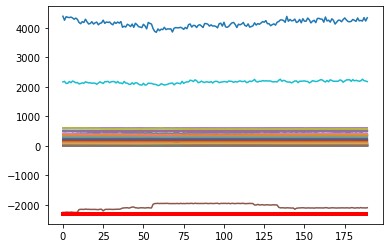

Predicción:  [[[0.9483216 0.0516784]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2812600e+01  1.1036100e+01  6.0078800e+01  7.8146900e+01
  6.1106460e+02  3.6408100e+01  1.0889400e+01  1.8695440e+02
  1.1590000e-01  6.2149800e+01  1.2621520e+02  8.9965000e+00
  6.5358200e+01  1.7363280e+02  2.0283800e+01  1.5998700e+02
  1.8685040e+02  7.0687600e+01 -4.0000000e-04  4.1804000e+00
  1.4583700e+01  6.9958000e+00  1.4986000e+00  7.2431200e+01
  1.4768000e+00  1.5460000e+00  9.0164900e+01  5.8509100e+01
  1.3514000e+00  1.2304000e+00  1.5616000e+00  1.3874000e+00
  1.5681360e+02  8.3510000e-01  8.4020000e-01 -2.1045519e+03
  2.0233120e+02  1.6366000e+00  1.4100000e+00  2.1638739e+03
  4.3212314e+03  1.8481450e+02  1.4220000e+00  1.4117000e+00
  8.0002000e+00  7.3990000e+00  1.7649000e+00  2.0340000e-01
  3.4577700e+01  5.2854890e+02  5.2154140e+02  5.1803660e+02
  5.1788390e+02  5.1837590e+02  2.9646200e+01  3.0902

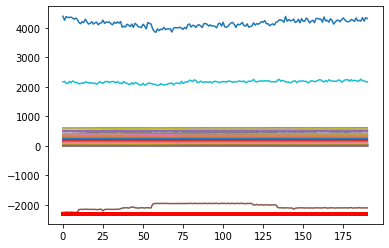

Predicción:  [[[0.94920105 0.05079898]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3245900e+01  1.1556300e+01  5.8587500e+01  7.8415000e+01
  6.0992420e+02  3.6107700e+01  1.0993100e+01  1.8700290e+02
  1.4490000e-01  6.2194800e+01  1.2620890e+02  9.0331000e+00
  6.4946100e+01  1.7420200e+02  2.0556700e+01  1.5964570e+02
  1.8745590e+02  7.0726000e+01 -4.0000000e-04  4.2026000e+00
  1.4800800e+01  7.0035000e+00  1.4992000e+00  7.2362600e+01
  1.4752000e+00  1.5429000e+00  9.1197800e+01  5.8952200e+01
  1.3545000e+00  1.2261000e+00  1.5561000e+00  1.3855000e+00
  1.5850540e+02  8.3570000e-01  8.3940000e-01 -2.1026331e+03
  2.0296730e+02  1.6344000e+00  1.4135000e+00  2.1773232e+03
  4.3283639e+03  1.8481450e+02  1.4215000e+00  1.4090000e+00
  7.9982000e+00  7.3996000e+00  1.7621000e+00  2.0590000e-01
  3.5675500e+01  5.2963330e+02  5.2238040e+02  5.1867500e+02
  5.1856940e+02  5.1904560e+02  2.9565900e+01  3.07

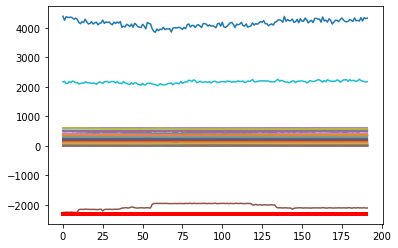

Predicción:  [[[0.94916326 0.05083679]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3580900e+01  1.1702000e+01  5.8376100e+01  7.7580200e+01
  6.1060530e+02  3.5135800e+01  1.0993600e+01  1.8706360e+02
  1.7240000e-01  6.2343100e+01  1.2608020e+02  9.0589000e+00
  6.5019900e+01  1.7362950e+02  2.0783200e+01  1.5977350e+02
  1.8746940e+02  7.0671500e+01 -4.0000000e-04  4.1887000e+00
  1.4872300e+01  7.0138000e+00  1.4995000e+00  7.2431800e+01
  1.4748000e+00  1.5434000e+00  9.1873200e+01  5.9289500e+01
  1.3571000e+00  1.2270000e+00  1.5585000e+00  1.3892000e+00
  1.5984980e+02  8.3640000e-01  8.4030000e-01 -2.1050032e+03
  2.0334880e+02  1.6347000e+00  1.4164000e+00  2.1989496e+03
  4.3533410e+03  1.8481450e+02  1.4237000e+00  1.4109000e+00
  8.0014000e+00  7.4008000e+00  1.7620000e+00  2.0330000e-01
  3.4336600e+01  5.2946450e+02  5.2233070e+02  5.1858290e+02
  5.1845710e+02  5.1896720e+02  2.9575200e+01  3.06

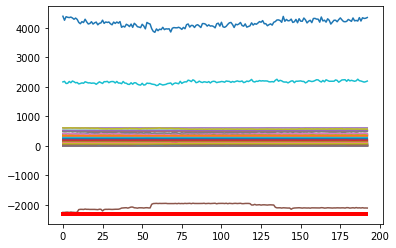

Predicción:  [[[0.9526102 0.0473898]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3772600e+01  1.1702300e+01  5.7966500e+01  7.7452500e+01
  6.0969080e+02  3.5878900e+01  1.0964500e+01  1.8700460e+02
  2.0010000e-01  6.2314500e+01  1.2596380e+02  8.8938000e+00
  6.5940400e+01  1.7349520e+02  2.0633600e+01  1.6009330e+02
  1.8729080e+02  7.0830600e+01 -4.0000000e-04  4.1845000e+00
  1.4269400e+01  6.9910000e+00  1.4999000e+00  7.2467900e+01
  1.4721000e+00  1.5417000e+00  9.0482800e+01  5.9076800e+01
  1.3498000e+00  1.2249000e+00  1.5572000e+00  1.3849000e+00
  1.5961760e+02  8.3620000e-01  8.3990000e-01 -2.0946810e+03
  2.0293410e+02  1.6314000e+00  1.4085000e+00  2.2018439e+03
  4.3549980e+03  1.8481450e+02  1.4185000e+00  1.4062000e+00
  8.0015000e+00  7.4002000e+00  1.7586000e+00  2.0150000e-01
  3.3511100e+01  5.2921780e+02  5.2232140e+02  5.1868020e+02
  5.1856370e+02  5.1909640e+02  2.9853000e+01  3.0776

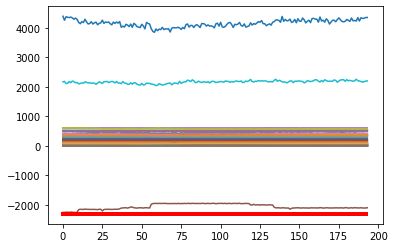

Predicción:  [[[0.94932973 0.05067024]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3569600e+01  1.1817600e+01  5.8669600e+01  7.6280600e+01
  6.0999700e+02  3.5362100e+01  1.1010200e+01  1.8699580e+02
  2.7200000e-01  6.2102900e+01  1.2606130e+02  9.0292000e+00
  6.5780500e+01  1.7279570e+02  2.0724600e+01  1.5991300e+02
  1.8737070e+02  7.0919900e+01 -4.0000000e-04  4.2065000e+00
  1.4948100e+01  6.9982000e+00  1.5004000e+00  7.2388900e+01
  1.4718000e+00  1.5459000e+00  9.1083700e+01  5.8973100e+01
  1.3510000e+00  1.2238000e+00  1.5570000e+00  1.3855000e+00
  1.6038360e+02  8.3570000e-01  8.3890000e-01 -2.1041549e+03
  2.0338480e+02  1.6375000e+00  1.4097000e+00  2.2443801e+03
  4.3640853e+03  1.8481450e+02  1.4199000e+00  1.4061000e+00
  7.9954000e+00  7.3985000e+00  1.7603000e+00  2.0320000e-01
  3.4233500e+01  5.2949780e+02  5.2217240e+02  5.1850240e+02
  5.1842880e+02  5.1886750e+02  3.0237900e+01  3.07

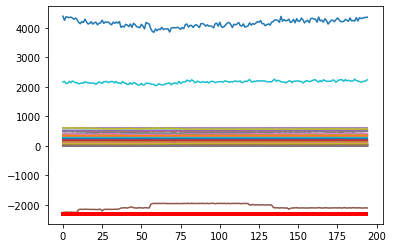

Predicción:  [[[0.95334107 0.04665894]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3522700e+01  1.1811000e+01  6.0520900e+01  7.6325900e+01
  6.1030540e+02  3.5977100e+01  1.1019900e+01  1.8698820e+02
  3.5550000e-01  6.1689500e+01  1.2589310e+02  8.9292000e+00
  6.5924300e+01  1.7296870e+02  2.0611400e+01  1.5986220e+02
  1.8736700e+02  7.0767600e+01 -4.0000000e-04  4.2071000e+00
  1.4891000e+01  7.0005000e+00  1.5007000e+00  7.2420300e+01
  1.4731000e+00  1.5399000e+00  9.1136900e+01  5.8718500e+01
  1.3509000e+00  1.2263000e+00  1.5564000e+00  1.3853000e+00
  1.6008400e+02  8.3450000e-01  8.4100000e-01 -2.1008004e+03
  2.0416620e+02  1.6294000e+00  1.4102000e+00  2.1561375e+03
  4.3707120e+03  1.8481450e+02  1.4200000e+00  1.4055000e+00
  8.0006000e+00  7.4002000e+00  1.7599000e+00  2.0340000e-01
  3.4734800e+01  5.2936880e+02  5.2227240e+02  5.1846020e+02
  5.1837150e+02  5.1885750e+02  2.9844300e+01  3.06

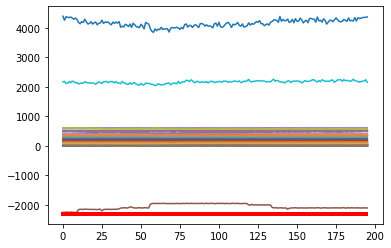

Predicción:  [[[0.9529268  0.04707324]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3709200e+01  1.1828600e+01  6.0548200e+01  7.7297600e+01
  6.1002280e+02  3.5798900e+01  1.1037800e+01  1.8702040e+02
  4.3930000e-01  6.2131000e+01  1.2618670e+02  9.0892000e+00
  6.6032800e+01  1.7278940e+02  2.0258000e+01  1.5995620e+02
  1.8758220e+02  7.0998700e+01 -4.0000000e-04  4.2111000e+00
  1.5416200e+01  6.9970000e+00  1.5000000e+00  7.2455600e+01
  1.4657000e+00  1.5364000e+00  8.9877300e+01  5.8705600e+01
  1.3413000e+00  1.2202000e+00  1.5485000e+00  1.3794000e+00
  1.5791640e+02  8.3450000e-01  8.4060000e-01 -2.0915332e+03
  2.0366560e+02  1.6282000e+00  1.4003000e+00  2.1776373e+03
  4.4032908e+03  1.8481450e+02  1.4152000e+00  1.4013000e+00
  8.0003000e+00  7.3999000e+00  1.7539000e+00  2.0550000e-01
  3.5596800e+01  5.2908440e+02  5.2181470e+02  5.1797040e+02
  5.1800070e+02  5.1848990e+02  2.9550800e+01  3.05

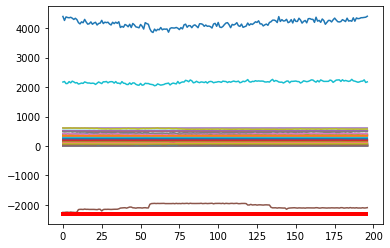

Predicción:  [[[0.9530421  0.04695791]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4022300e+01  1.1716700e+01  6.0291500e+01  7.7888400e+01
  6.1039300e+02  3.4695400e+01  1.1073200e+01  1.8693540e+02
  4.7190000e-01  6.2302900e+01  1.2579520e+02  8.9614000e+00
  6.6109700e+01  1.7197390e+02  2.0252000e+01  1.6008080e+02
  1.8755700e+02  7.0639000e+01 -4.0000000e-04  4.1948000e+00
  1.5130600e+01  6.9961000e+00  1.5003000e+00  7.2360800e+01
  1.4726000e+00  1.5425000e+00  8.9104300e+01  5.8162200e+01
  1.3508000e+00  1.2265000e+00  1.5582000e+00  1.3822000e+00
  1.5879110e+02  8.3350000e-01  8.4020000e-01 -2.1052727e+03
  2.0209610e+02  1.6321000e+00  1.4094000e+00  2.1814331e+03
  4.4042311e+03  1.8481450e+02  1.4177000e+00  1.4064000e+00
  7.9978000e+00  7.4002000e+00  1.7601000e+00  2.0130000e-01
  3.5838300e+01  5.2983120e+02  5.2222390e+02  5.1829970e+02
  5.1833980e+02  5.1885340e+02  2.9485500e+01  3.03

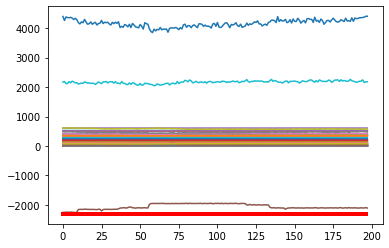

Predicción:  [[[0.95685846 0.04314152]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3901500e+01  1.1843600e+01  5.9781500e+01  7.8464000e+01
  6.0976010e+02  3.5405200e+01  1.1073800e+01  1.8702040e+02
  2.9430000e-01  6.2491200e+01  1.2588790e+02  8.9956000e+00
  6.5762400e+01  1.7233250e+02  2.0364000e+01  1.6023840e+02
  1.8760760e+02  7.0554300e+01 -4.0000000e-04  4.2020000e+00
  1.3696800e+01  7.0190000e+00  1.5006000e+00  7.2432300e+01
  1.4741000e+00  1.5472000e+00  9.1661100e+01  5.8512000e+01
  1.3532000e+00  1.2278000e+00  1.5615000e+00  1.3883000e+00
  1.5928610e+02  8.3490000e-01  8.3910000e-01 -2.1020130e+03
  2.0149630e+02  1.6384000e+00  1.4117000e+00  2.1850031e+03
  4.4080645e+03  1.8481450e+02  1.4246000e+00  1.4116000e+00
  8.0022000e+00  7.4011000e+00  1.7622000e+00  2.0080000e-01
  3.6394300e+01  5.3050000e+02  5.2274010e+02  5.1878760e+02
  5.1883450e+02  5.1934450e+02  2.9310300e+01  3.02

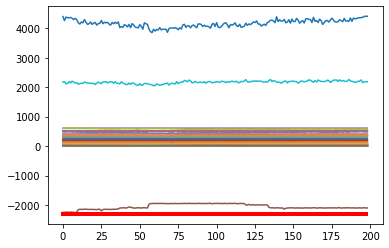

Predicción:  [[[0.95649606 0.04350391]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4306500e+01  1.1846500e+01  6.0512600e+01  7.7953500e+01
  6.1059400e+02  3.5413300e+01  1.1078000e+01  1.8745340e+02
  2.2740000e-01  6.2515000e+01  1.2616330e+02  8.8258000e+00
  6.5643800e+01  1.7334450e+02  2.0407000e+01  1.6011310e+02
  1.8779890e+02  7.0697100e+01 -4.0000000e-04  4.2219000e+00
  1.3861500e+01  6.9856000e+00  1.5024000e+00  7.2404500e+01
  1.4684000e+00  1.5407000e+00  9.1811500e+01  5.9165300e+01
  1.3475000e+00  1.2208000e+00  1.5535000e+00  1.3818000e+00
  1.6007850e+02  8.3630000e-01  8.3930000e-01 -2.0937742e+03
  2.0520490e+02  1.6325000e+00  1.4064000e+00  2.1774940e+03
  4.4119386e+03  1.8481450e+02  1.4177000e+00  1.4044000e+00
  7.9996000e+00  7.4034000e+00  1.7567000e+00  2.0320000e-01
  3.5790200e+01  5.3013560e+02  5.2259280e+02  5.1854870e+02
  5.1856840e+02  5.1906000e+02  2.9468500e+01  3.01

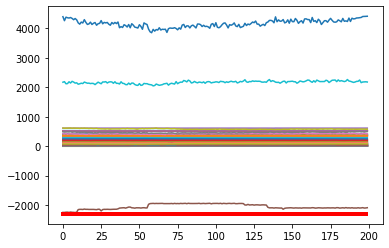

Predicción:  [[[0.95475125 0.04524875]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4331500e+01  1.1755300e+01  6.1491200e+01  7.7104100e+01
  6.0928360e+02  3.5157100e+01  1.1069100e+01  1.8806660e+02
  1.8760000e-01  6.2493600e+01  1.2579510e+02  8.9500000e+00
  6.6226400e+01  1.7375610e+02  2.0142300e+01  1.5977210e+02
  1.8835110e+02  7.0832800e+01 -4.0000000e-04  4.2026000e+00
  1.5289700e+01  7.0023000e+00  1.5011000e+00  7.2303300e+01
  1.4730000e+00  1.5448000e+00  9.0325200e+01  5.8968200e+01
  1.3440000e+00  1.2235000e+00  1.5540000e+00  1.3821000e+00
  1.5890320e+02  8.3640000e-01  8.4060000e-01 -2.0995957e+03
  2.0352250e+02  1.6358000e+00  1.4033000e+00  2.1770732e+03
  4.5276413e+03  1.8481450e+02  1.4184000e+00  1.4063000e+00
  8.0007000e+00  7.3905000e+00  1.7607000e+00  2.0640000e-01
  3.6114900e+01  5.2913110e+02  5.2158810e+02  5.1803920e+02
  5.1808960e+02  5.1852520e+02  2.9422400e+01  3.00

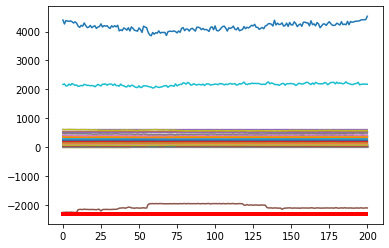

Predicción:  [[[0.9652326 0.0347674]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4169600e+01  1.1716100e+01  6.0044600e+01  7.7491200e+01
  6.0890360e+02  3.5134300e+01  1.1089000e+01  1.8805110e+02
  1.0760000e-01  6.2391100e+01  1.2584750e+02  8.9523000e+00
  6.6252700e+01  1.7380390e+02  2.0061200e+01  1.5998700e+02
  1.8838270e+02  7.0849100e+01 -4.0000000e-04  4.2023000e+00
  1.5762000e+01  6.9675000e+00  1.5010000e+00  7.2435600e+01
  1.4768000e+00  1.5496000e+00  9.0296400e+01  5.8939500e+01
  1.3530000e+00  1.2286000e+00  1.5546000e+00  1.3891000e+00
  1.5895050e+02  8.3480000e-01  8.3980000e-01 -2.0982402e+03
  2.0252760e+02  1.6402000e+00  1.4119000e+00  2.2075497e+03
  4.3858545e+03  1.8481450e+02  1.4248000e+00  1.4135000e+00
  8.0011000e+00  7.4068000e+00  1.7638000e+00  2.0980000e-01
  3.5597600e+01  5.2994890e+02  5.2232160e+02  5.1871100e+02
  5.1863980e+02  5.1912970e+02  2.8839700e+01  2.9935

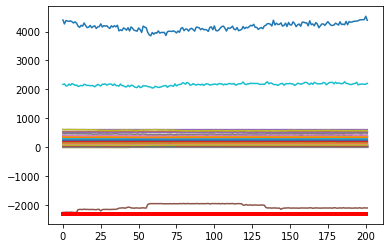

Predicción:  [[[0.95329857 0.04670141]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4159200e+01  1.1685100e+01  5.9126000e+01  7.8033900e+01
  6.0927080e+02  3.5078900e+01  1.1085000e+01  1.8795040e+02
  9.5100000e-02  6.1922500e+01  1.2585550e+02  8.9543000e+00
  6.5526000e+01  1.7412940e+02  2.0029000e+01  1.5993020e+02
  1.8828690e+02  7.0757200e+01 -4.0000000e-04  4.1900000e+00
  1.5227100e+01  7.0075000e+00  1.4999000e+00  7.2406000e+01
  1.4847000e+00  1.5571000e+00  9.0271400e+01  5.9086300e+01
  1.3643000e+00  1.2366000e+00  1.5616000e+00  1.3944000e+00
  1.5945710e+02  8.3570000e-01  8.4020000e-01 -2.1024073e+03
  2.0422190e+02  1.6472000e+00  1.4231000e+00  2.1960532e+03
  4.4185598e+03  1.8481450e+02  1.4305000e+00  1.4200000e+00
  7.9987000e+00  7.3999000e+00  1.7693000e+00  2.0770000e-01
  3.6366800e+01  5.3126660e+02  5.2306280e+02  5.1939140e+02
  5.1934910e+02  5.1982560e+02  2.8628100e+01  2.96

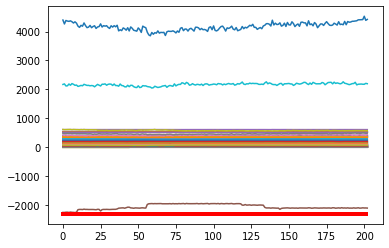

Predicción:  [[[0.9574456  0.04255441]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4230800e+01  1.1530100e+01  5.8723500e+01  7.8219200e+01
  6.1037950e+02  3.4875000e+01  1.1097100e+01  1.8804640e+02
  7.1300000e-02  6.2325400e+01  1.2600710e+02  8.9441000e+00
  6.5730900e+01  1.7321940e+02  2.0212800e+01  1.5999550e+02
  1.8785260e+02  7.0825000e+01 -4.0000000e-04  4.2022000e+00
  1.2878000e+01  7.0157000e+00  1.5000000e+00  7.2411100e+01
  1.4735000e+00  1.5469000e+00  9.0914700e+01  5.9566600e+01
  1.3509000e+00  1.2247000e+00  1.5564000e+00  1.3846000e+00
  1.6061860e+02  8.3480000e-01  8.4060000e-01 -2.0932052e+03
  2.0492390e+02  1.6384000e+00  1.4103000e+00  2.2181731e+03
  4.4786843e+03  1.8481450e+02  1.4209000e+00  1.4103000e+00
  7.9995000e+00  7.4002000e+00  1.7584000e+00  2.0220000e-01
  3.6533100e+01  5.3093560e+02  5.2364070e+02  5.1967370e+02
  5.1954640e+02  5.1999660e+02  2.8349900e+01  2.93

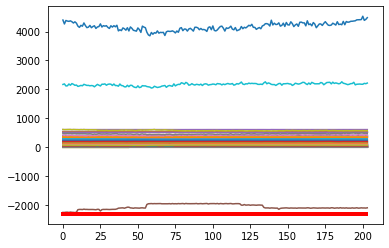

Predicción:  [[[0.95989347 0.04010655]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4086200e+01  1.1634900e+01  5.9833300e+01  7.7286400e+01
  6.1023090e+02  3.5101000e+01  1.1051300e+01  1.8808860e+02
  7.3500000e-02  6.2443200e+01  1.2616400e+02  8.9822000e+00
  6.5913500e+01  1.7407060e+02  2.0053700e+01  1.6010660e+02
  1.8792070e+02  7.0809500e+01 -4.0000000e-04  4.2115000e+00
  1.4649600e+01  6.9955000e+00  1.5020000e+00  7.2302000e+01
  1.4733000e+00  1.5438000e+00  9.0434000e+01  5.9499200e+01
  1.3484000e+00  1.2235000e+00  1.5516000e+00  1.3834000e+00
  1.5934750e+02  8.3520000e-01  8.3990000e-01 -2.1037343e+03
  2.0394390e+02  1.6339000e+00  1.4077000e+00  2.1808921e+03
  4.3763149e+03  1.8481450e+02  1.4191000e+00  1.4072000e+00
  7.9830000e+00  7.3998000e+00  1.7587000e+00  2.0720000e-01
  3.5729400e+01  5.2989780e+02  5.2232550e+02  5.1868610e+02
  5.1853100e+02  5.1901940e+02  2.8404100e+01  2.92

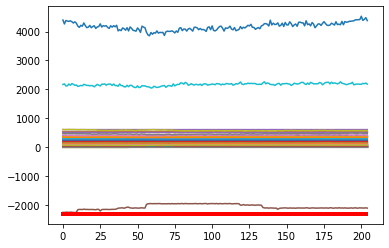

Predicción:  [[[0.9542828 0.0457172]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4008200e+01  1.1636400e+01  6.2003000e+01  7.8128000e+01
  6.1025850e+02  3.5018900e+01  1.1082300e+01  1.8808900e+02
  5.9000000e-02  6.2288500e+01  1.2593920e+02  9.3573000e+00
  6.6141900e+01  1.7395540e+02  2.0080300e+01  1.5974800e+02
  1.8796660e+02  7.0894100e+01 -4.0000000e-04  4.1986000e+00
  1.5023900e+01  6.9696000e+00  1.5011000e+00  7.2383100e+01
  1.4815000e+00  1.5529000e+00  9.0836300e+01  5.9083100e+01
  1.3588000e+00  1.2319000e+00  1.5577000e+00  1.3924000e+00
  1.5975590e+02  8.3500000e-01  8.4030000e-01 -2.0929601e+03
  2.0309170e+02  1.6433000e+00  1.4184000e+00  2.2035512e+03
  4.3401334e+03  1.8481450e+02  1.4281000e+00  1.4159000e+00
  8.0009000e+00  7.3995000e+00  1.7672000e+00  2.0920000e-01
  3.5569100e+01  5.3086890e+02  5.2302200e+02  5.1935670e+02
  5.1915780e+02  5.1977700e+02  2.8185100e+01  2.9293

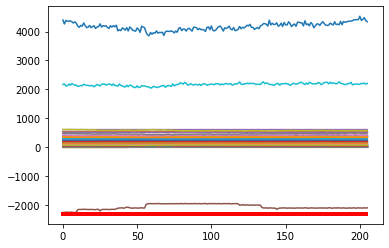

Predicción:  [[[0.9473704  0.05262954]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3978600e+01  1.1641400e+01  6.0940200e+01  7.8707400e+01
  6.1005590e+02  3.4438700e+01  1.1149200e+01  1.8791310e+02
  7.2300000e-02  6.2505700e+01  1.2588690e+02  9.0907000e+00
  6.5747100e+01  1.7353510e+02  1.9945700e+01  1.5999180e+02
  1.8807350e+02  7.0773200e+01 -4.0000000e-04  4.2029000e+00
  1.4701600e+01  7.0008000e+00  1.5004000e+00  7.2403600e+01
  1.4736000e+00  1.5415000e+00  9.0333200e+01  5.9892400e+01
  1.3519000e+00  1.2235000e+00  1.5529000e+00  1.3811000e+00
  1.5978850e+02  8.3680000e-01  8.3870000e-01 -2.1084388e+03
  2.0391590e+02  1.6325000e+00  1.4117000e+00  2.2233716e+03
  4.3208436e+03  1.8481450e+02  1.4142000e+00  1.4041000e+00
  7.9969000e+00  7.4000000e+00  1.7586000e+00  2.0560000e-01
  3.3263600e+01  5.3019780e+02  5.2265930e+02  5.1879560e+02
  5.1862810e+02  5.1927210e+02  2.8087100e+01  2.90

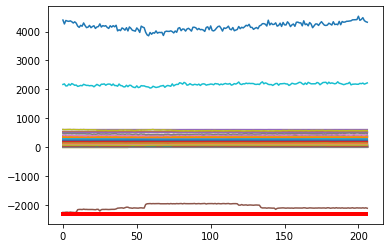

Predicción:  [[[0.95024264 0.04975732]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4103200e+01  1.1602700e+01  6.0836000e+01  7.6442200e+01
  6.0969560e+02  3.3745100e+01  1.1158500e+01  1.8797930e+02
  5.2400000e-02  6.1918600e+01  1.2576970e+02  8.9649000e+00
  6.5687800e+01  1.7181960e+02  2.0109500e+01  1.5993330e+02
  1.8810470e+02  7.0647500e+01 -4.0000000e-04  4.2118000e+00
  1.4759900e+01  7.0019000e+00  1.4988000e+00  7.2425300e+01
  1.4942000e+00  1.5644000e+00  9.0288700e+01  5.9185400e+01
  1.3669000e+00  1.2448000e+00  1.5758000e+00  1.4039000e+00
  1.5945330e+02  8.3650000e-01  8.3950000e-01 -2.1007782e+03
  2.0001630e+02  1.6558000e+00  1.4260000e+00  2.1952316e+03
  4.3837168e+03  1.8481450e+02  1.4360000e+00  1.4253000e+00
  7.9993000e+00  7.3870000e+00  1.7816000e+00  2.0590000e-01
  3.2081900e+01  5.3013550e+02  5.2248280e+02  5.1873280e+02
  5.1876440e+02  5.1926900e+02  2.8817600e+01  2.92

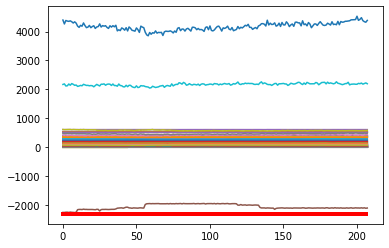

Predicción:  [[[0.95394415 0.04605587]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4105000e+01  1.1586900e+01  5.7929400e+01  7.7049000e+01
  6.1004410e+02  3.5793700e+01  1.1162400e+01  1.8797210e+02
  5.7100000e-02  5.8930000e+01  1.2619630e+02  9.2281000e+00
  6.6159400e+01  1.7109720e+02  2.0062600e+01  1.6002650e+02
  1.8804290e+02  7.0767300e+01 -4.0000000e-04  4.2134000e+00
  1.3109000e+01  6.9997000e+00  1.4998000e+00  7.2436700e+01
  1.4869000e+00  1.5567000e+00  8.9513900e+01  5.9292900e+01
  1.3628000e+00  1.2356000e+00  1.5722000e+00  1.3959000e+00
  1.6208920e+02  8.2790000e-01  8.3070000e-01 -2.0927571e+03
  2.0272830e+02  1.6472000e+00  1.4229000e+00  2.1489096e+03
  4.2197076e+03  1.8481450e+02  1.4283000e+00  1.4179000e+00
  8.0007000e+00  7.4093000e+00  1.7728000e+00  2.0050000e-01
  3.2331300e+01  5.3136440e+02  5.2338190e+02  5.1970140e+02
  5.1973110e+02  5.2029970e+02  2.7815600e+01  2.89

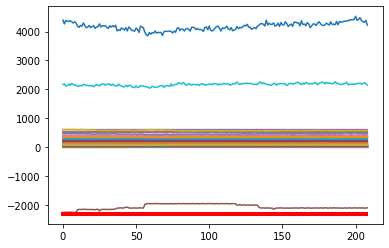

Predicción:  [[[0.9333922  0.06660772]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4127100e+01  1.1705100e+01  5.8715700e+01  7.7725300e+01
  6.0921360e+02  3.5078400e+01  1.1116900e+01  1.8796430e+02
  8.5200000e-02  5.8904400e+01  1.2616930e+02  8.9319000e+00
  6.5822600e+01  1.7027940e+02  2.0519600e+01  1.5986960e+02
  1.8785820e+02  7.0619200e+01 -4.0000000e-04  4.2066000e+00
  1.2169000e+01  6.9905000e+00  1.5020000e+00  7.2451600e+01
  1.4624000e+00  1.5368000e+00  9.1008900e+01  6.0289600e+01
  1.3372000e+00  1.2116000e+00  1.5542000e+00  1.3742000e+00
  1.6285790e+02  8.2730000e-01  8.3060000e-01 -2.0980476e+03
  2.0344770e+02  1.6282000e+00  1.3974000e+00  2.2181705e+03
  4.4875395e+03  1.8481450e+02  1.4053000e+00  1.3954000e+00
  8.0008000e+00  7.4058000e+00  1.7522000e+00  1.9810000e-01
  3.1332400e+01  5.3022960e+02  5.2292840e+02  5.1884070e+02
  5.1887500e+02  5.1935080e+02  2.8254000e+01  2.89

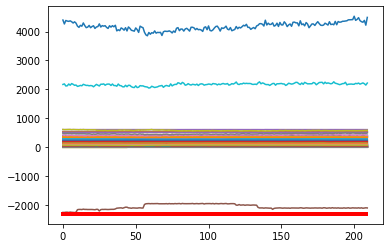

Predicción:  [[[0.9621092  0.03789077]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4147600e+01  1.1792500e+01  5.8968800e+01  7.8906300e+01
  6.0961650e+02  3.5482200e+01  1.1060900e+01  1.8800690e+02
  7.3700000e-02  5.8900500e+01  1.2635720e+02  9.0283000e+00
  6.6163100e+01  1.7205640e+02  2.0660400e+01  1.5992050e+02
  1.8814660e+02  7.0977900e+01 -4.0000000e-04  4.2083000e+00
  1.4654800e+01  6.9901000e+00  1.5011000e+00  7.2422500e+01
  1.4582000e+00  1.5294000e+00  9.1710100e+01  6.0749800e+01
  1.3337000e+00  1.2091000e+00  1.5404000e+00  1.3712000e+00
  1.6014250e+02  8.2770000e-01  8.3010000e-01 -2.0953791e+03
  2.0588430e+02  1.6200000e+00  1.3945000e+00  2.1367025e+03
  4.4104661e+03  1.8481450e+02  1.4008000e+00  1.3929000e+00
  7.9979000e+00  7.4009000e+00  1.7478000e+00  2.0760000e-01
  2.9432600e+01  5.2991210e+02  5.2201050e+02  5.1826940e+02
  5.1846250e+02  5.1890900e+02  2.9069900e+01  2.96

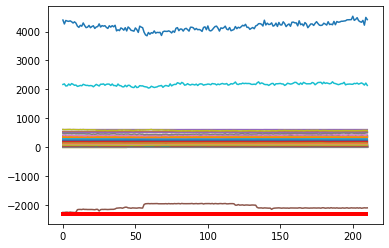

Predicción:  [[[0.95523834 0.0447616 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4212300e+01  1.1768500e+01  6.1561800e+01  7.8650200e+01
  6.0969930e+02  3.5406900e+01  1.1090700e+01  1.8799650e+02
  5.3700000e-02  5.8977200e+01  1.2584840e+02  9.1052000e+00
  6.5873000e+01  1.7209260e+02  2.1044000e+01  1.5977330e+02
  1.8827580e+02  7.0862400e+01 -4.0000000e-04  4.1735000e+00
  1.4932900e+01  6.9839000e+00  1.4972000e+00  7.2421100e+01
  1.4620000e+00  1.5349000e+00  9.2460600e+01  6.0050400e+01
  1.3381000e+00  1.2142000e+00  1.5428000e+00  1.3766000e+00
  1.6029910e+02  8.2760000e-01  8.3040000e-01 -2.0954781e+03
  2.0428220e+02  1.6259000e+00  1.3986000e+00  2.1749960e+03
  4.4422108e+03  1.8481450e+02  1.4062000e+00  1.3974000e+00
  8.0012000e+00  7.3995000e+00  1.7519000e+00  2.0940000e-01
  2.9259400e+01  5.3046660e+02  5.2244150e+02  5.1877350e+02
  5.1883130e+02  5.1934140e+02  2.9250100e+01  2.99

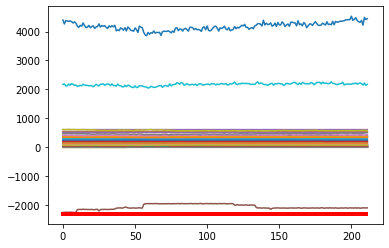

Predicción:  [[[0.95790106 0.04209895]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4259400e+01  1.1691900e+01  6.2014000e+01  7.7719900e+01
  6.1130840e+02  3.4981600e+01  1.1118600e+01  1.8788500e+02
  3.1200000e-02  5.9091300e+01  1.2575360e+02  8.9833000e+00
  6.5724100e+01  1.7116130e+02  2.1565000e+01  1.5991580e+02
  1.8819110e+02  7.0829600e+01 -4.0000000e-04  4.1968000e+00
  1.3619300e+01  7.0033000e+00  1.5012000e+00  7.2391400e+01
  1.4622000e+00  1.5388000e+00  9.2500400e+01  5.9420900e+01
  1.3412000e+00  1.2143000e+00  1.5488000e+00  1.3762000e+00
  1.6124570e+02  8.2750000e-01  8.3010000e-01 -2.0971768e+03
  2.0220850e+02  1.6316000e+00  1.4010000e+00  2.1374713e+03
  4.3413656e+03  1.8481450e+02  1.4059000e+00  1.3970000e+00
  8.0004000e+00  7.3983000e+00  1.7515000e+00  2.0280000e-01
  2.9739500e+01  5.3132610e+02  5.2314460e+02  5.1932300e+02
  5.1937420e+02  5.1985000e+02  2.9409900e+01  3.01

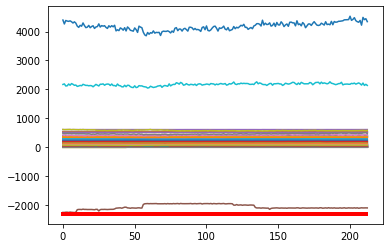

Predicción:  [[[0.9488386  0.05116143]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4226500e+01  1.1696900e+01  6.1122800e+01  7.7283800e+01
  6.0907710e+02  3.4335400e+01  1.1169500e+01  1.8795290e+02
  2.2900000e-02  5.9302400e+01  1.2630370e+02  8.9754000e+00
  6.6026500e+01  1.6990750e+02  2.1019700e+01  1.5979690e+02
  1.8818820e+02  7.0866300e+01 -4.0000000e-04  4.1889000e+00
  1.2701400e+01  7.0071000e+00  1.5004000e+00  7.2337300e+01
  1.4691000e+00  1.5381000e+00  9.1572800e+01  5.9084100e+01
  1.3434000e+00  1.2201000e+00  1.5587000e+00  1.3788000e+00
  1.6129710e+02  8.2740000e-01  8.3090000e-01 -2.1033815e+03
  2.0158640e+02  1.6291000e+00  1.4027000e+00  2.1991467e+03
  4.4900390e+03  1.8481450e+02  1.4079000e+00  1.3993000e+00
  7.9975000e+00  7.4008000e+00  1.7592000e+00  2.0090000e-01
  2.9446600e+01  5.3069890e+02  5.2269530e+02  5.1866870e+02
  5.1896820e+02  5.1923620e+02  2.9663000e+01  3.02

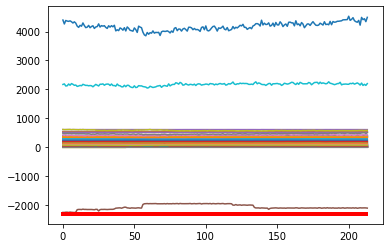

Predicción:  [[[0.9635943  0.03640568]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4305400e+01  1.1659900e+01  6.0815500e+01  7.8458100e+01
  6.0988140e+02  3.5717500e+01  1.1180400e+01  1.8800610e+02
  2.8200000e-02  5.9192900e+01  1.2593160e+02  9.2532000e+00
  6.5640000e+01  1.7245360e+02  2.1463300e+01  1.6013060e+02
  1.8819330e+02  7.0678000e+01 -4.0000000e-04  4.2135000e+00
  1.3882700e+01  7.0045000e+00  1.5013000e+00  7.2366300e+01
  1.4714000e+00  1.5424000e+00  9.1160400e+01  5.9734400e+01
  1.3480000e+00  1.2220000e+00  1.5538000e+00  1.3800000e+00
  1.6009920e+02  8.2830000e-01  8.3030000e-01 -2.1045915e+03
  2.0137820e+02  1.6336000e+00  1.4071000e+00  2.1834351e+03
  4.3613216e+03  1.8481450e+02  1.4094000e+00  1.4010000e+00
  7.9983000e+00  7.4008000e+00  1.7606000e+00  2.0700000e-01
  2.9411700e+01  5.3098220e+02  5.2297860e+02  5.1923880e+02
  5.1952990e+02  5.1972050e+02  2.9738400e+01  3.04

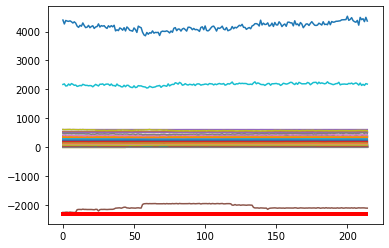

Predicción:  [[[0.9529647  0.04703531]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4490800e+01  1.1695000e+01  6.1514300e+01  7.7751700e+01
  6.1030120e+02  3.3023700e+01  1.1159700e+01  1.8802030e+02
  2.5800000e-02  5.9427800e+01  1.2594480e+02  9.0564000e+00
  6.5726400e+01  1.7007640e+02  2.1797900e+01  1.5973580e+02
  1.8801310e+02  7.0808900e+01 -4.0000000e-04  4.1989000e+00
  1.5145100e+01  7.0036000e+00  1.5000000e+00  7.2467500e+01
  1.4659000e+00  1.5383000e+00  9.1423200e+01  6.0044700e+01
  1.3448000e+00  1.2171000e+00  1.5567000e+00  1.3781000e+00
  1.6010470e+02  8.2770000e-01  8.3000000e-01 -2.0950800e+03
  2.0655540e+02  1.6303000e+00  1.4050000e+00  2.1767318e+03
  4.3073473e+03  1.8481450e+02  1.4076000e+00  1.3997000e+00
  8.0016000e+00  7.4012000e+00  1.7573000e+00  2.0060000e-01
  2.9407600e+01  5.3053560e+02  5.2278390e+02  5.1863700e+02
  5.1887240e+02  5.1916260e+02  2.9753400e+01  3.05

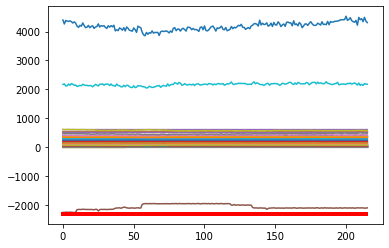

Predicción:  [[[0.9445898  0.05541028]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4606200e+01  1.1792500e+01  6.1372800e+01  7.7239600e+01
  6.0956770e+02  3.4283200e+01  1.1153500e+01  1.8798250e+02
  2.8100000e-02  5.9476000e+01  1.2634370e+02  9.0798000e+00
  6.6051000e+01  1.7041600e+02  2.2085600e+01  1.5983600e+02
  1.8824700e+02  7.0892300e+01 -4.0000000e-04  4.2083000e+00
  1.4266700e+01  7.0047000e+00  1.4983000e+00  7.2357000e+01
  1.4685000e+00  1.5414000e+00  9.1597300e+01  5.9282400e+01
  1.3471000e+00  1.2201000e+00  1.5620000e+00  1.3818000e+00
  1.6102720e+02  8.2800000e-01  8.3030000e-01 -2.1029497e+03
  2.0286150e+02  1.6336000e+00  1.4066000e+00  2.1774734e+03
  4.4659722e+03  1.8481450e+02  1.4106000e+00  1.4035000e+00
  8.0006000e+00  7.4006000e+00  1.7595000e+00  1.9730000e-01
  2.9204200e+01  5.3068220e+02  5.2265070e+02  5.1882350e+02
  5.1896190e+02  5.1928240e+02  2.9810200e+01  3.06

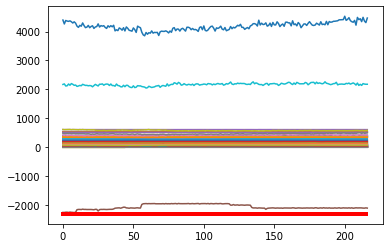

Predicción:  [[[0.9615481  0.03845189]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4855900e+01  1.2002200e+01  6.0812700e+01  7.6994600e+01
  6.0998110e+02  3.4364200e+01  1.1182400e+01  1.8795350e+02
  3.1800000e-02  5.9378500e+01  1.2605380e+02  8.9791000e+00
  6.6107400e+01  1.7054630e+02  2.1264900e+01  1.6010740e+02
  1.8833020e+02  7.0649500e+01 -4.0000000e-04  4.2033000e+00
  1.3815800e+01  6.9778000e+00  1.5011000e+00  7.2352100e+01
  1.4705000e+00  1.5443000e+00  9.2593500e+01  5.9187800e+01
  1.3487000e+00  1.2215000e+00  1.5633000e+00  1.3829000e+00
  1.6111000e+02  8.2720000e-01  8.2910000e-01 -2.1022942e+03
  2.0132450e+02  1.6368000e+00  1.4077000e+00  2.2046531e+03
  4.4900726e+03  1.8481450e+02  1.4126000e+00  1.4065000e+00
  7.9982000e+00  7.3986000e+00  1.7626000e+00  2.0000000e-01
  2.9518300e+01  5.3126770e+02  5.2299550e+02  5.1923510e+02
  5.1937320e+02  5.1972330e+02  2.9911300e+01  3.06

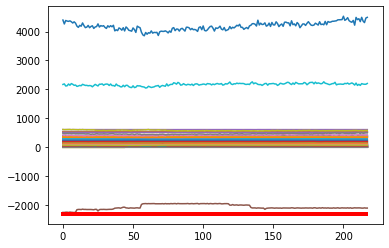

Predicción:  [[[0.9631476  0.03685245]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4987700e+01  1.2159800e+01  5.9686300e+01  7.7204500e+01
  6.0927600e+02  3.4516600e+01  1.1159700e+01  1.8800510e+02
  3.9400000e-02  5.9284000e+01  1.2588700e+02  9.1343000e+00
  6.5770400e+01  1.7142040e+02  2.1355200e+01  1.5995050e+02
  1.8835740e+02  7.0811100e+01 -4.0000000e-04  4.1428000e+00
  1.4676600e+01  7.0025000e+00  1.5003000e+00  7.2330600e+01
  1.4703000e+00  1.5413000e+00  9.1211800e+01  5.9330300e+01
  1.3472000e+00  1.2206000e+00  1.5610000e+00  1.3819000e+00
  1.6123250e+02  8.2800000e-01  8.3070000e-01 -2.0916169e+03
  2.0438800e+02  1.6329000e+00  1.4064000e+00  2.1868524e+03
  4.4378409e+03  1.8481450e+02  1.4112000e+00  1.4051000e+00
  7.9999000e+00  7.4017000e+00  1.7618000e+00  2.0060000e-01
  2.9379100e+01  5.3104890e+02  5.2293460e+02  5.1906080e+02
  5.1919650e+02  5.1955760e+02  2.9980500e+01  3.08

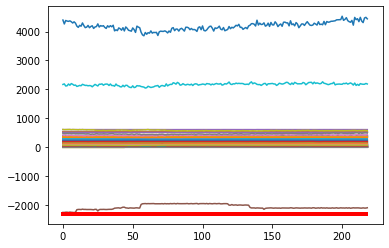

Predicción:  [[[0.9559942  0.04400583]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5112800e+01  1.2085900e+01  5.9593500e+01  7.5719000e+01
  6.0932470e+02  3.5980800e+01  1.1157400e+01  1.8798370e+02
  4.8400000e-02  5.8570800e+01  1.2623140e+02  8.7764000e+00
  6.5885600e+01  1.7221330e+02  2.1240200e+01  1.5993340e+02
  1.8816690e+02  7.0805600e+01 -4.0000000e-04  4.0890000e+00
  1.5361200e+01  7.0086000e+00  1.4998000e+00  7.2398200e+01
  1.4602000e+00  1.5302000e+00  9.1396000e+01  5.9376500e+01
  1.3362000e+00  1.2139000e+00  1.5472000e+00  1.3726000e+00
  1.5874870e+02  8.2830000e-01  8.3020000e-01 -2.1335450e+03
  2.0001380e+02  1.6206000e+00  1.3953000e+00  2.1865803e+03
  4.4685396e+03  1.8481450e+02  1.4015000e+00  1.3960000e+00
  7.9996000e+00  7.4005000e+00  1.7509000e+00  2.0390000e-01
  2.8994100e+01  5.2990220e+02  5.2237080e+02  5.1835010e+02
  5.1845440e+02  5.1880810e+02  3.0130000e+01  3.12

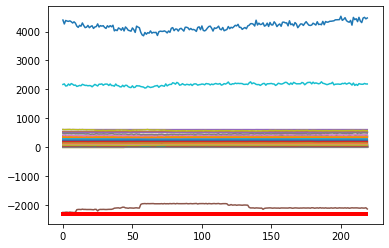

Predicción:  [[[0.96866065 0.03133931]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5106100e+01  1.1767500e+01  6.0103500e+01  7.5436000e+01
  6.1006270e+02  3.5446600e+01  1.1121300e+01  1.8795570e+02
  6.4300000e-02  5.7463500e+01  1.2612010e+02  8.9534000e+00
  6.5934800e+01  1.7033060e+02  2.1177500e+01  1.6023800e+02
  1.8797620e+02  7.0713100e+01 -4.0000000e-04  4.0081000e+00
  1.6271800e+01  6.9979000e+00  1.4998000e+00  7.2377200e+01
  1.4522000e+00  1.5254000e+00  9.1304100e+01  6.0041000e+01
  1.3189000e+00  1.2071000e+00  1.5421000e+00  1.3668000e+00
  1.5704800e+02  8.2830000e-01  8.3010000e-01 -2.1437712e+03
  2.0287310e+02  1.6164000e+00  1.3791000e+00  2.1954973e+03
  4.5648269e+03  1.8481450e+02  1.3959000e+00  1.3898000e+00
  8.0002000e+00  7.3982000e+00  1.7440000e+00  2.0220000e-01
  2.8936500e+01  5.2991550e+02  5.2179700e+02  5.1815530e+02
  5.1828400e+02  5.1865090e+02  3.0286100e+01  3.11

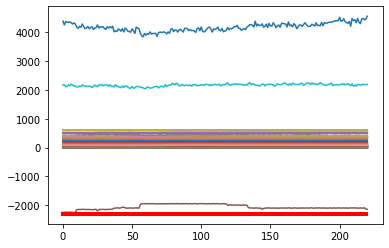

Predicción:  [[[0.97576743 0.02423265]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5153300e+01  1.1285000e+01  6.1664200e+01  7.4348100e+01
  6.0997130e+02  3.5435900e+01  1.1122900e+01  1.8799920e+02
  1.1210000e-01  5.7245500e+01  1.2614220e+02  8.9468000e+00
  6.5889400e+01  1.6920270e+02  2.1184400e+01  1.6008450e+02
  1.8762220e+02  7.0934000e+01 -4.0000000e-04  4.0059000e+00
  1.5781100e+01  6.9938000e+00  1.5004000e+00  7.2388700e+01
  1.4416000e+00  1.5102000e+00  9.1240800e+01  6.0719900e+01
  1.3090000e+00  1.1979000e+00  1.5340000e+00  1.3553000e+00
  1.5755240e+02  8.2900000e-01  8.3070000e-01 -2.1468863e+03
  2.0559560e+02  1.6008000e+00  1.3692000e+00  2.1969685e+03
  4.4633030e+03  1.8481450e+02  1.3841000e+00  1.3782000e+00
  8.0014000e+00  7.4014000e+00  1.7314000e+00  1.9750000e-01
  2.8987100e+01  5.2920010e+02  5.2151140e+02  5.1763680e+02
  5.1775800e+02  5.1814010e+02  3.0274000e+01  3.12

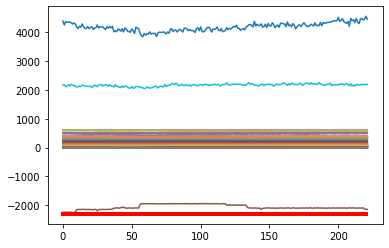

Predicción:  [[[0.97115225 0.02884782]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5136400e+01  1.1352100e+01  6.0059600e+01  7.4338800e+01
  6.1006740e+02  3.6130800e+01  1.1069100e+01  1.8800310e+02
  8.7600000e-02  5.7975300e+01  1.2709070e+02  9.6588000e+00
  6.6026000e+01  1.6929000e+02  2.1273500e+01  1.6003690e+02
  1.8782850e+02  7.0877900e+01 -4.0000000e-04  3.9687000e+00
  1.5808700e+01  7.0049000e+00  1.4997000e+00  7.2387500e+01
  1.4604000e+00  1.5330000e+00  8.9806400e+01  5.9702100e+01
  1.3291000e+00  1.2185000e+00  1.5522000e+00  1.3768000e+00
  1.5660430e+02  8.4340000e-01  8.4590000e-01 -2.1460369e+03
  2.0169570e+02  1.6242000e+00  1.3890000e+00  2.1877494e+03
  4.4696481e+03  1.8481450e+02  1.4059000e+00  1.3990000e+00
  7.9977000e+00  7.3986000e+00  1.7519000e+00  1.9940000e-01
  2.8944800e+01  5.2956670e+02  5.2133830e+02  5.1765860e+02
  5.1784500e+02  5.1821950e+02  3.0462300e+01  3.14

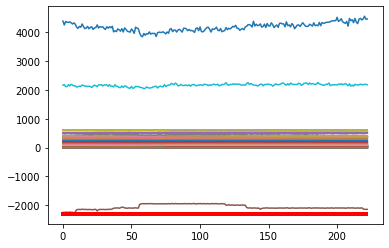

Predicción:  [[[0.9713307  0.02866931]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4879400e+01  1.1408300e+01  5.6546600e+01  7.5604900e+01
  6.1075070e+02  3.6636400e+01  1.1042700e+01  1.8797870e+02
  4.5400000e-02  6.0001700e+01  1.2872740e+02  9.9930000e+00
  6.6045700e+01  1.7229850e+02  2.1290400e+01  1.5982080e+02
  1.8780230e+02  7.0786600e+01 -4.0000000e-04  3.9082000e+00
  1.6292200e+01  6.9815000e+00  1.5014000e+00  7.2395900e+01
  1.4580000e+00  1.5273000e+00  9.0051100e+01  5.9638300e+01
  1.3303000e+00  1.2155000e+00  1.5434000e+00  1.3730000e+00
  1.5594710e+02  8.4840000e-01  8.5010000e-01 -2.1522107e+03
  2.0513890e+02  1.6174000e+00  1.3892000e+00  2.1812057e+03
  4.4271569e+03  1.8481450e+02  1.4014000e+00  1.3952000e+00
  8.0017000e+00  7.3995000e+00  1.7483000e+00  2.0480000e-01
  2.8250900e+01  5.2978220e+02  5.2143320e+02  5.1767350e+02
  5.1790070e+02  5.1823070e+02  3.0428700e+01  3.13

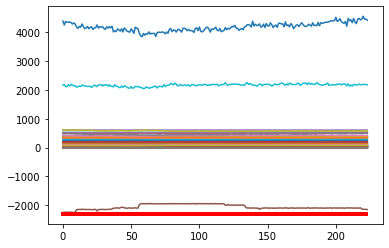

Predicción:  [[[0.9700796  0.02992037]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4814100e+01  1.1428000e+01  5.6051800e+01  7.6199000e+01
  6.0999300e+02  3.6970200e+01  1.1020300e+01  1.8804770e+02
  1.1300000e-02  5.9743800e+01  1.2830280e+02  1.0017600e+01
  6.6210500e+01  1.7121020e+02  2.1338000e+01  1.6002330e+02
  1.8760940e+02  7.0798000e+01 -4.0000000e-04  3.8926000e+00
  1.6071800e+01  7.0194000e+00  1.5012000e+00  7.2345000e+01
  1.4735000e+00  1.5419000e+00  9.0273300e+01  5.8728200e+01
  1.3421000e+00  1.2325000e+00  1.5607000e+00  1.3888000e+00
  1.5648210e+02  8.4850000e-01  8.4990000e-01 -2.1471200e+03
  2.0272640e+02  1.6310000e+00  1.4009000e+00  2.1920932e+03
  4.4491028e+03  1.8481450e+02  1.4165000e+00  1.4100000e+00
  7.9971000e+00  7.3998000e+00  1.7634000e+00  2.0270000e-01
  2.7754200e+01  5.2966660e+02  5.2152790e+02  5.1785690e+02
  5.1806980e+02  5.1842310e+02  3.0383700e+01  3.14

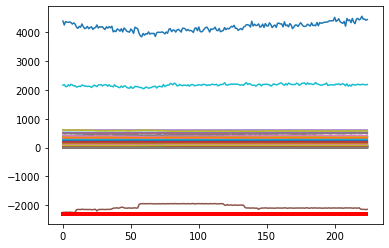

Predicción:  [[[0.9701877  0.02981229]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4772700e+01  1.1645300e+01  5.7545400e+01  7.7109800e+01
  6.0922280e+02  3.7252100e+01  1.0998200e+01  1.8790890e+02
  5.0000000e-04  5.9864600e+01  1.2801940e+02  9.8832000e+00
  6.5398000e+01  1.7229430e+02  2.1654700e+01  1.6019240e+02
  1.8771030e+02  7.0596300e+01 -4.0000000e-04  3.9027000e+00
  1.5684300e+01  7.2085000e+00  1.5000000e+00  7.2363500e+01
  1.4679000e+00  1.5404000e+00  9.0508300e+01  5.9217000e+01
  1.3395000e+00  1.2275000e+00  1.5518000e+00  1.3834000e+00
  1.5574910e+02  8.4880000e-01  8.5010000e-01 -2.1461636e+03
  2.0137210e+02  1.6307000e+00  1.3989000e+00  2.2160754e+03
  4.4916332e+03  1.8481450e+02  1.4115000e+00  1.4060000e+00
  8.0030000e+00  7.4001000e+00  1.7576000e+00  2.0570000e-01
  2.8221000e+01  5.2961780e+02  5.2181610e+02  5.1788710e+02
  5.1820230e+02  5.1844960e+02  3.0138000e+01  3.13

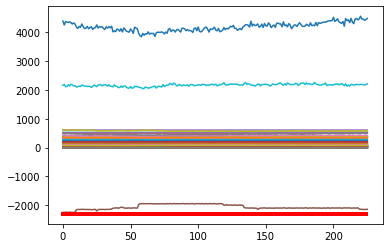

Predicción:  [[[0.9726519  0.02734807]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4717000e+01  1.1520800e+01  5.8102300e+01  7.5162300e+01
  6.0948900e+02  3.6697200e+01  1.0991800e+01  1.8809350e+02
  5.0000000e-04  5.9555300e+01  1.2803960e+02  1.0198100e+01
  6.5069800e+01  1.7177510e+02  2.1644500e+01  1.6002720e+02
  1.8760510e+02  7.0496000e+01 -4.0000000e-04  3.9141000e+00
  1.5729500e+01  7.1946000e+00  1.5010000e+00  7.2404700e+01
  1.4566000e+00  1.5268000e+00  8.9817700e+01  5.9452800e+01
  1.3270000e+00  1.2181000e+00  1.5434000e+00  1.3739000e+00
  1.5372060e+02  8.4800000e-01  8.5040000e-01 -2.1424911e+03
  2.0220220e+02  1.6170000e+00  1.3864000e+00  2.1863961e+03
  4.4552016e+03  1.8481450e+02  1.4024000e+00  1.3978000e+00
  7.9994000e+00  7.3964000e+00  1.7462000e+00  2.0240000e-01
  2.8343600e+01  5.2923550e+02  5.2141230e+02  5.1758020e+02
  5.1788750e+02  5.1817610e+02  3.0274100e+01  3.13

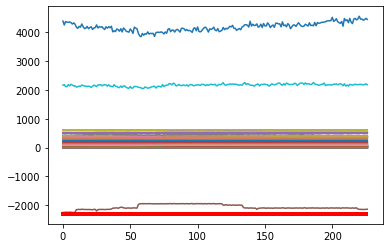

Predicción:  [[[0.9697473 0.0302527]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4640500e+01  1.1538700e+01  5.7540300e+01  7.3779600e+01
  6.1059320e+02  3.6572500e+01  1.0984400e+01  1.8790590e+02
  5.0000000e-04  5.9563700e+01  1.2806830e+02  9.8555000e+00
  6.4606300e+01  1.7059140e+02  2.1839200e+01  1.6014710e+02
  1.8763830e+02  7.0366200e+01 -4.0000000e-04  3.9067000e+00
  1.5781800e+01  7.2499000e+00  1.5009000e+00  7.2445600e+01
  1.4630000e+00  1.5324000e+00  8.9743400e+01  6.0034700e+01
  1.3316000e+00  1.2252000e+00  1.5520000e+00  1.3804000e+00
  1.5304340e+02  8.4860000e-01  8.4970000e-01 -2.1844661e+03
  2.0122250e+02  1.6225000e+00  1.3915000e+00  2.2216016e+03
  4.4416031e+03  1.8481450e+02  1.4093000e+00  1.4048000e+00
  8.0008000e+00  7.4095000e+00  1.7533000e+00  2.0100000e-01
  2.8684200e+01  5.2886450e+02  5.2118470e+02  5.1726650e+02
  5.1761640e+02  5.1784290e+02  3.0188200e+01  3.1290

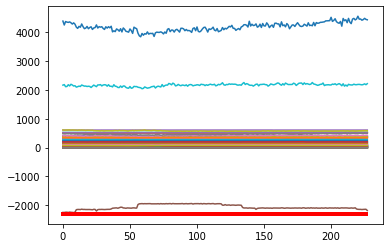

Predicción:  [[[0.97652924 0.02347073]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4869100e+01  1.1401400e+01  5.5554800e+01  7.6406600e+01
  6.0891920e+02  3.5172800e+01  1.0977400e+01  1.8799740e+02
  5.0000000e-04  5.9512000e+01  1.2794450e+02  1.0076600e+01
  6.4851200e+01  1.6861250e+02  2.0504000e+01  1.5987720e+02
  1.8758790e+02  7.0421100e+01 -4.0000000e-04  3.9051000e+00
  1.5070300e+01  7.3940000e+00  1.4995000e+00  7.2454500e+01
  1.4611000e+00  1.5341000e+00  8.9772500e+01  5.9342300e+01
  1.3332000e+00  1.2211000e+00  1.5537000e+00  1.3799000e+00
  1.5639140e+02  8.4820000e-01  8.4970000e-01 -2.1365259e+03
  2.0039060e+02  1.6247000e+00  1.3929000e+00  2.2381650e+03
  4.4472074e+03  1.8481450e+02  1.4087000e+00  1.4037000e+00
  7.9972000e+00  7.4929000e+00  1.7513000e+00  1.9780000e-01
  2.8674300e+01  5.2958220e+02  5.2154370e+02  5.1773140e+02
  5.1806770e+02  5.1831130e+02  2.9773700e+01  3.09

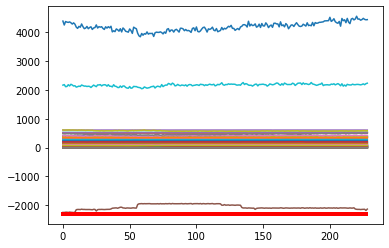

Predicción:  [[[0.9679339  0.03206609]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4741300e+01  1.2263200e+01  5.5466900e+01  7.6762400e+01
  6.1116660e+02  3.4669000e+01  1.0966300e+01  1.8827130e+02
  5.0000000e-04  5.9602900e+01  1.2814220e+02  1.0082000e+01
  6.5581900e+01  1.6797300e+02  2.0871100e+01  1.6003910e+02
  1.8843790e+02  7.0378700e+01 -4.0000000e-04  3.9126000e+00
  1.4075600e+01  7.3909000e+00  1.5000000e+00  7.2391900e+01
  1.4615000e+00  1.5331000e+00  8.9718900e+01  5.9655900e+01
  1.3327000e+00  1.2178000e+00  1.5568000e+00  1.3777000e+00
  1.5898590e+02  8.4830000e-01  8.4960000e-01 -2.1510959e+03
  2.0159260e+02  1.6227000e+00  1.3926000e+00  2.2537611e+03
  4.4803578e+03  1.8481450e+02  1.4074000e+00  1.4017000e+00
  8.0036000e+00  7.4976000e+00  1.7511000e+00  1.9460000e-01
  2.9572400e+01  5.2898660e+02  5.2159840e+02  5.1756710e+02
  5.1785000e+02  5.1812240e+02  2.9834500e+01  3.09

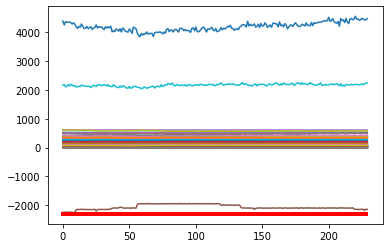

Predicción:  [[[0.97270447 0.02729557]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4815400e+01  1.2411900e+01  5.7165200e+01  7.6110600e+01
  6.1086670e+02  3.4231600e+01  1.0941500e+01  1.8881270e+02
  5.0000000e-04  5.9224000e+01  1.2815910e+02  9.8133000e+00
  6.5954100e+01  1.6986440e+02  2.1135200e+01  1.6005110e+02
  1.8915110e+02  6.8934600e+01 -4.0000000e-04  3.9040000e+00
  1.6659000e+01  7.4075000e+00  1.4996000e+00  7.2502800e+01
  1.4616000e+00  1.5322000e+00  8.9592400e+01  6.0300300e+01
  1.3360000e+00  1.2166000e+00  1.5502000e+00  1.3757000e+00
  1.5873530e+02  8.4820000e-01  8.4980000e-01 -2.1517302e+03
  2.0040080e+02  1.6221000e+00  1.3965000e+00  2.1940580e+03
  4.3905794e+03  1.8481450e+02  1.4055000e+00  1.3999000e+00
  7.9986000e+00  7.4999000e+00  1.7532000e+00  2.0310000e-01
  2.9427700e+01  5.2778230e+02  5.2090920e+02  5.1704060e+02
  5.1730930e+02  5.1757710e+02  2.9913500e+01  3.09

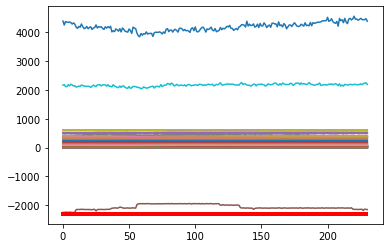

Predicción:  [[[0.96770465 0.03229531]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4742600e+01  1.2299200e+01  5.8630500e+01  7.5704000e+01
  6.0998810e+02  3.4705600e+01  1.0925200e+01  1.8907800e+02
  5.0000000e-04  5.9527600e+01  1.2800300e+02  9.9782000e+00
  6.5196200e+01  1.7097310e+02  2.1298400e+01  1.6015580e+02
  1.8939200e+02  6.9238100e+01 -4.0000000e-04  3.9198000e+00
  1.7077900e+01  7.3927000e+00  1.5006000e+00  7.2414300e+01
  1.4636000e+00  1.5369000e+00  9.0051200e+01  6.0381700e+01
  1.3358000e+00  1.2187000e+00  1.5473000e+00  1.3798000e+00
  1.5855530e+02  8.4770000e-01  8.5030000e-01 -2.1410390e+03
  2.0233020e+02  1.6284000e+00  1.3958000e+00  2.1832526e+03
  4.3668743e+03  1.8481450e+02  1.4107000e+00  1.4041000e+00
  8.0025000e+00  7.4997000e+00  1.7539000e+00  2.0660000e-01
  3.0686000e+01  5.2824890e+02  5.2105910e+02  5.1729910e+02
  5.1744580e+02  5.1783500e+02  2.9874000e+01  3.10

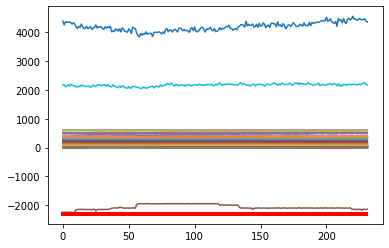

Predicción:  [[[0.9635092  0.03649077]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4634500e+01  1.2155000e+01  6.0393100e+01  7.6105000e+01
  6.1046630e+02  3.6202100e+01  1.0859800e+01  1.8891370e+02
  5.0000000e-04  5.9325400e+01  1.2717180e+02  9.9921000e+00
  6.6310000e+01  1.7247720e+02  2.1287500e+01  1.5986670e+02
  1.8946250e+02  6.9235300e+01 -4.0000000e-04  3.9037000e+00
  1.7044200e+01  7.4101000e+00  1.5005000e+00  7.2419600e+01
  1.4660000e+00  1.5366000e+00  8.9889400e+01  5.9645100e+01
  1.3425000e+00  1.2217000e+00  1.5437000e+00  1.3799000e+00
  1.5900750e+02  8.4530000e-01  8.4940000e-01 -2.1522367e+03
  2.0133300e+02  1.6271000e+00  1.4020000e+00  2.1868152e+03
  4.4577849e+03  1.8481450e+02  1.4113000e+00  1.4029000e+00
  7.9981000e+00  7.4999000e+00  1.7523000e+00  2.0820000e-01
  3.1607300e+01  5.2903330e+02  5.2163230e+02  5.1780320e+02
  5.1796250e+02  5.1833400e+02  2.9706300e+01  3.08

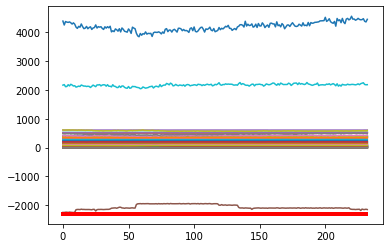

Predicción:  [[[0.97162 0.02838]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4376100e+01  1.2132300e+01  5.8355700e+01  7.5311000e+01
  6.1007170e+02  3.7537200e+01  1.0849100e+01  1.8894420e+02
  5.0000000e-04  6.0764000e+01  1.2730370e+02  1.0118200e+01
  6.6260600e+01  1.7234560e+02  2.0394800e+01  1.5983910e+02
  1.8946340e+02  6.9228000e+01 -4.0000000e-04  3.8956000e+00
  1.6985100e+01  7.3491000e+00  1.4993000e+00  7.2423100e+01
  1.4848000e+00  1.5523000e+00  8.9366500e+01  5.8706500e+01
  1.3580000e+00  1.2424000e+00  1.5633000e+00  1.3971000e+00
  1.5883110e+02  8.4600000e-01  8.4820000e-01 -2.1592512e+03
  2.0189650e+02  1.6420000e+00  1.4167000e+00  2.2216124e+03
  4.5250120e+03  1.8481450e+02  1.4290000e+00  1.4194000e+00
  8.0015000e+00  7.4938000e+00  1.7699000e+00  2.0680000e-01
  3.2383600e+01  5.2891560e+02  5.2154020e+02  5.1742750e+02
  5.1767420e+02  5.1796320e+02  3.1111300e+01  3.1227500e

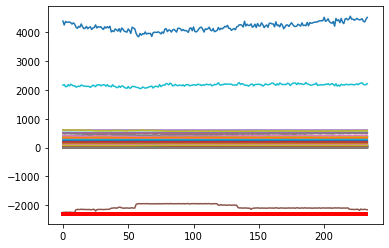

Predicción:  [[[0.9764056  0.02359437]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4426500e+01  1.2150400e+01  5.6536800e+01  7.6543100e+01
  6.1057170e+02  3.7482500e+01  1.0878600e+01  1.8896410e+02
  5.0000000e-04  6.4383500e+01  1.2782370e+02  9.8141000e+00
  6.6557000e+01  1.7538010e+02  1.9974200e+01  1.6009680e+02
  1.8935630e+02  6.9500800e+01 -4.0000000e-04  3.9115000e+00
  1.6510900e+01  7.3113000e+00  1.5014000e+00  7.2356000e+01
  1.4695000e+00  1.5386000e+00  9.0030300e+01  5.8884900e+01
  1.3389000e+00  1.2285000e+00  1.5354000e+00  1.3864000e+00
  1.5826740e+02  8.4530000e-01  8.4960000e-01 -2.1484125e+03
  2.0291380e+02  1.6296000e+00  1.3982000e+00  2.2428683e+03
  4.4488308e+03  1.8481450e+02  1.4188000e+00  1.4094000e+00
  8.0012000e+00  7.5076000e+00  1.7528000e+00  2.1770000e-01
  3.2200400e+01  5.2875330e+02  5.2177290e+02  5.1793330e+02
  5.1817510e+02  5.1844490e+02  2.9485100e+01  3.09

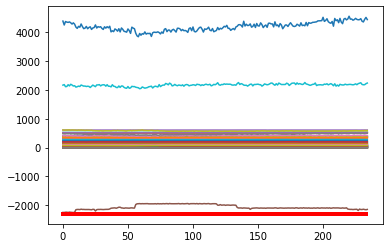

Predicción:  [[[0.97062355 0.02937647]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4369100e+01  1.2095800e+01  5.7777800e+01  7.7669300e+01
  6.0826280e+02  3.7057000e+01  1.0867700e+01  1.8896690e+02
  5.0000000e-04  6.4498400e+01  1.2756660e+02  1.0135000e+01
  6.6337700e+01  1.7261600e+02  2.0599400e+01  1.5996300e+02
  1.8910610e+02  6.9545100e+01 -4.0000000e-04  3.9033000e+00
  1.5190100e+01  7.3022000e+00  1.4993000e+00  7.2371000e+01
  1.4698000e+00  1.5385000e+00  9.0196400e+01  5.9185000e+01
  1.3396000e+00  1.2282000e+00  1.5438000e+00  1.3844000e+00
  1.5867930e+02  8.4600000e-01  8.5030000e-01 -2.1508102e+03
  2.0278850e+02  1.6307000e+00  1.3987000e+00  2.1923315e+03
  4.5634814e+03  1.8481450e+02  1.4166000e+00  1.4077000e+00
  8.0007000e+00  7.5025000e+00  1.7529000e+00  2.0920000e-01
  3.2595100e+01  5.2821770e+02  5.2128390e+02  5.1723460e+02
  5.1747920e+02  5.1768520e+02  2.9573800e+01  3.07

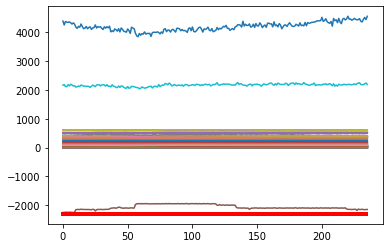

Predicción:  [[[0.9770653 0.0229347]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4350400e+01  1.2012900e+01  5.7954000e+01  7.7975600e+01
  6.0988440e+02  3.6479500e+01  1.0863000e+01  1.8885720e+02
  5.0000000e-04  6.4299500e+01  1.2810610e+02  9.9256000e+00
  6.6632000e+01  1.7261360e+02  2.1075300e+01  1.5979120e+02
  1.8918630e+02  6.9535700e+01 -4.0000000e-04  3.8929000e+00
  1.4656200e+01  7.3025000e+00  1.5005000e+00  7.2400000e+01
  1.4677000e+00  1.5357000e+00  9.0728900e+01  5.9578700e+01
  1.3383000e+00  1.2258000e+00  1.5451000e+00  1.3832000e+00
  1.5906400e+02  8.4500000e-01  8.5010000e-01 -2.1478972e+03
  2.0491180e+02  1.6259000e+00  1.3980000e+00  2.1860184e+03
  4.4944424e+03  1.8481450e+02  1.4163000e+00  1.4061000e+00
  7.9987000e+00  7.5005000e+00  1.7516000e+00  2.0630000e-01
  3.3264600e+01  5.2836450e+02  5.2144720e+02  5.1762200e+02
  5.1784550e+02  5.1802820e+02  2.9904400e+01  3.1034

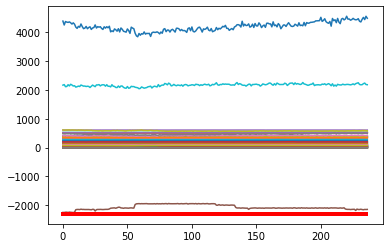

Predicción:  [[[0.9730646  0.02693543]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4269900e+01  1.1975400e+01  5.8478800e+01  7.7336800e+01
  6.1083800e+02  3.6472000e+01  1.0869100e+01  1.8902170e+02
  5.0000000e-04  6.3578500e+01  1.2807380e+02  9.9764000e+00
  6.5849800e+01  1.7405050e+02  2.1092200e+01  1.6000670e+02
  1.8908020e+02  6.9484300e+01 -4.0000000e-04  3.9056000e+00
  1.5369600e+01  7.3093000e+00  1.5008000e+00  7.2466900e+01
  1.4657000e+00  1.5350000e+00  9.1243400e+01  5.9211100e+01
  1.3402000e+00  1.2234000e+00  1.5389000e+00  1.3828000e+00
  1.5879380e+02  8.4320000e-01  8.4990000e-01 -2.1557272e+03
  2.0122450e+02  1.6256000e+00  1.3995000e+00  2.2337185e+03
  4.4812982e+03  1.8481450e+02  1.4171000e+00  1.4068000e+00
  8.0008000e+00  7.5005000e+00  1.7518000e+00  2.1290000e-01
  3.4189600e+01  5.2863330e+02  5.2165990e+02  5.1776070e+02
  5.1797480e+02  5.1821440e+02  2.9813100e+01  3.09

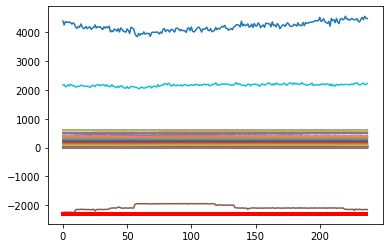

Predicción:  [[[0.97382313 0.02617686]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4678600e+01  1.1909700e+01  6.0782800e+01  7.7015100e+01
  6.0917820e+02  3.7214700e+01  1.0856500e+01  1.8905840e+02
  5.0000000e-04  6.2945700e+01  1.2717030e+02  1.0143700e+01
  6.6400400e+01  1.7502590e+02  2.1110500e+01  1.6035880e+02
  1.8904310e+02  6.9393300e+01 -4.0000000e-04  3.8994000e+00
  1.5874100e+01  7.2965000e+00  1.4998000e+00  7.2418500e+01
  1.4652000e+00  1.5339000e+00  9.0668800e+01  5.8864600e+01
  1.3394000e+00  1.2224000e+00  1.5343000e+00  1.3826000e+00
  1.5847200e+02  8.4340000e-01  8.4910000e-01 -2.1465449e+03
  2.0201890e+02  1.6241000e+00  1.3986000e+00  2.2033516e+03
  4.4096336e+03  1.8481450e+02  1.4170000e+00  1.4066000e+00
  7.9972000e+00  7.5012000e+00  1.7511000e+00  2.1650000e-01
  3.4244400e+01  5.2864890e+02  5.2138920e+02  5.1747530e+02
  5.1771060e+02  5.1787190e+02  2.9802600e+01  3.09

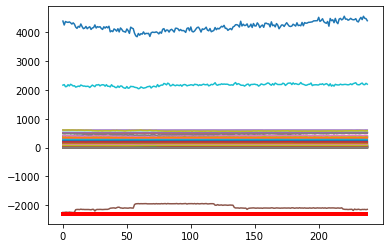

Predicción:  [[[0.9678515  0.03214854]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4877000e+01  1.1848400e+01  6.0224100e+01  7.7146800e+01
  6.1087540e+02  3.6748100e+01  1.0873000e+01  1.8898690e+02
  5.0000000e-04  6.3536100e+01  1.2726170e+02  9.8651000e+00
  6.6552400e+01  1.7378450e+02  2.0841700e+01  1.5975340e+02
  1.8909760e+02  6.9724600e+01 -4.0000000e-04  3.9002000e+00
  1.5905300e+01  7.3031000e+00  1.5000000e+00  7.2350100e+01
  1.4677000e+00  1.5387000e+00  8.9893200e+01  5.8847800e+01
  1.3378000e+00  1.2242000e+00  1.5385000e+00  1.3830000e+00
  1.5900440e+02  8.4290000e-01  8.4920000e-01 -2.1492650e+03
  2.0180900e+02  1.6289000e+00  1.3971000e+00  2.1825851e+03
  4.5233233e+03  1.8481450e+02  1.4182000e+00  1.4065000e+00
  8.0044000e+00  7.5004000e+00  1.7536000e+00  2.1550000e-01
  3.5496000e+01  5.2896890e+02  5.2131420e+02  5.1756610e+02
  5.1787900e+02  5.1793220e+02  2.9801900e+01  3.09

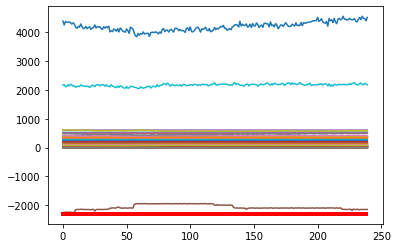

Predicción:  [[[0.9749086  0.02509143]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4635200e+01  1.1716700e+01  6.1212500e+01  7.7502900e+01
  6.1029950e+02  3.6338700e+01  1.0868300e+01  1.8983800e+02
  6.0000000e-04  6.5367800e+01  1.2713970e+02  9.9973000e+00
  6.6462400e+01  1.7534270e+02  2.0878200e+01  1.5974030e+02
  1.8979710e+02  6.9394600e+01 -4.0000000e-04  3.8963000e+00
  1.6146100e+01  7.3022000e+00  1.4990000e+00  7.2317900e+01
  1.4717000e+00  1.5390000e+00  9.0759000e+01  5.8537300e+01
  1.3410000e+00  1.2266000e+00  1.5372000e+00  1.3841000e+00
  1.5914460e+02  8.4380000e-01  8.5050000e-01 -2.1587300e+03
  2.0312780e+02  1.6299000e+00  1.3995000e+00  2.2491541e+03
  4.5436663e+03  1.8481450e+02  1.4199000e+00  1.4074000e+00
  7.9998000e+00  7.5004000e+00  1.7564000e+00  2.1960000e-01
  3.5853100e+01  5.2903110e+02  5.2128950e+02  5.1773570e+02
  5.1795880e+02  5.1804800e+02  2.9672800e+01  3.08

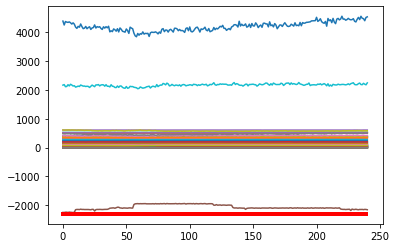

Predicción:  [[[0.9773362  0.02266381]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4374800e+01  1.1625900e+01  6.2152000e+01  7.7399600e+01
  6.0982910e+02  3.5269600e+01  1.0834700e+01  1.9003540e+02
  3.5000000e-03  6.5247500e+01  1.2725750e+02  9.9749000e+00
  6.6207300e+01  1.7537990e+02  2.1056400e+01  1.5955360e+02
  1.8989050e+02  6.9607400e+01 -4.0000000e-04  3.9018000e+00
  1.6651800e+01  7.2898000e+00  1.4991000e+00  7.2415100e+01
  1.4672000e+00  1.5371000e+00  9.0981700e+01  5.9012900e+01
  1.3398000e+00  1.2219000e+00  1.5326000e+00  1.3823000e+00
  1.5904150e+02  8.4390000e-01  8.4930000e-01 -2.1443458e+03
  2.0442000e+02  1.6279000e+00  1.3989000e+00  2.2215226e+03
  4.5188796e+03  1.8481450e+02  1.4187000e+00  1.4057000e+00
  7.9962000e+00  7.4994000e+00  1.7533000e+00  2.2080000e-01
  3.6244700e+01  5.2926880e+02  5.2116530e+02  5.1757100e+02
  5.1778510e+02  5.1785860e+02  2.9627100e+01  3.08

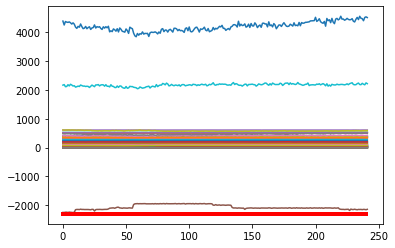

Predicción:  [[[0.973663   0.02633698]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4129900e+01  1.1533200e+01  5.8986600e+01  7.6428600e+01
  6.1077040e+02  3.5813300e+01  1.0827300e+01  1.9000230e+02
  7.7000000e-03  6.4931900e+01  1.2759490e+02  1.0033000e+01
  6.6281500e+01  1.7743220e+02  2.1297500e+01  1.6013860e+02
  1.8986840e+02  6.9534500e+01 -4.0000000e-04  3.9047000e+00
  1.7060100e+01  7.2990000e+00  1.5010000e+00  7.2416800e+01
  1.4648000e+00  1.5354000e+00  9.0694400e+01  5.9014200e+01
  1.3368000e+00  1.2185000e+00  1.5228000e+00  1.3788000e+00
  1.5894990e+02  8.4470000e-01  8.4950000e-01 -2.1443425e+03
  2.0408990e+02  1.6265000e+00  1.3957000e+00  2.2254048e+03
  4.4118784e+03  1.8481450e+02  1.4152000e+00  1.4024000e+00
  8.0019000e+00  7.4996000e+00  1.7494000e+00  2.2680000e-01
  3.6048200e+01  5.2898010e+02  5.2125190e+02  5.1764900e+02
  5.1785460e+02  5.1786790e+02  2.9604700e+01  3.08

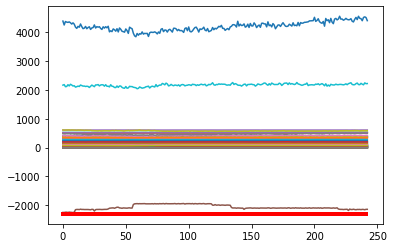

Predicción:  [[[0.9674415  0.03255854]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3988200e+01  1.1517800e+01  6.2246600e+01  7.5156900e+01
  6.0811690e+02  3.6993100e+01  1.0814100e+01  1.9005800e+02
  1.1900000e-02  6.4436400e+01  1.2707690e+02  9.8761000e+00
  6.6130400e+01  1.7772960e+02  2.1062700e+01  1.5998140e+02
  1.8973380e+02  6.9587700e+01 -4.0000000e-04  3.9004000e+00
  1.7444700e+01  7.2955000e+00  1.4991000e+00  7.2395100e+01
  1.4692000e+00  1.5421000e+00  9.0885000e+01  5.8759200e+01
  1.3418000e+00  1.2218000e+00  1.5222000e+00  1.3809000e+00
  1.5807960e+02  8.4550000e-01  8.4930000e-01 -2.1227015e+03
  2.0267450e+02  1.6338000e+00  1.4006000e+00  2.2063741e+03
  4.5450210e+03  1.8481450e+02  1.4170000e+00  1.4036000e+00
  8.0000000e+00  7.4998000e+00  1.7551000e+00  2.3280000e-01
  3.6220900e+01  5.2883330e+02  5.2115720e+02  5.1757700e+02
  5.1782390e+02  5.1787070e+02  2.9846600e+01  3.08

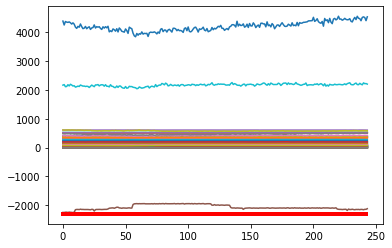

Predicción:  [[[0.9711363  0.02886369]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3971700e+01  1.1584800e+01  6.1937700e+01  7.6729700e+01
  6.0934950e+02  3.7190100e+01  1.0804600e+01  1.9009290e+02
  2.0200000e-02  6.4289600e+01  1.2707360e+02  1.0022300e+01
  6.6554800e+01  1.7701330e+02  2.1189500e+01  1.6026130e+02
  1.8998160e+02  6.9335100e+01 -4.0000000e-04  3.8953000e+00
  1.7530400e+01  7.3033000e+00  1.5010000e+00  7.2418700e+01
  1.4767000e+00  1.5469000e+00  9.1525900e+01  5.8479700e+01
  1.3555000e+00  1.2327000e+00  1.5281000e+00  1.3933000e+00
  1.5907020e+02  8.4630000e-01  8.4970000e-01 -2.0992652e+03
  2.0347700e+02  1.6371000e+00  1.4140000e+00  2.2072197e+03
  4.3512504e+03  1.8481450e+02  1.4288000e+00  1.4147000e+00
  7.9969000e+00  7.4980000e+00  1.7595000e+00  2.3100000e-01
  3.5225100e+01  5.2905330e+02  5.2146370e+02  5.1791910e+02
  5.1817150e+02  5.1816930e+02  2.9949800e+01  3.09

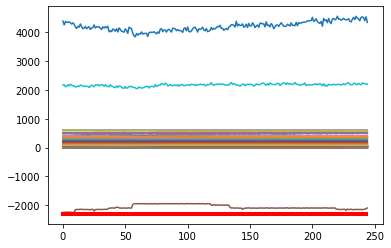

Predicción:  [[[0.9501421  0.04985784]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3906900e+01  1.1567400e+01  6.1127200e+01  7.7575500e+01
  6.0994790e+02  3.9089400e+01  1.0854800e+01  1.9003850e+02
  4.6400000e-02  6.4218400e+01  1.2739570e+02  1.0106900e+01
  6.6187400e+01  1.7853820e+02  2.1173200e+01  1.6018090e+02
  1.8996830e+02  6.9537500e+01 -4.0000000e-04  3.8944000e+00
  1.7052600e+01  7.2860000e+00  1.5005000e+00  7.2435600e+01
  1.4599000e+00  1.5307000e+00  9.0534400e+01  5.9157800e+01
  1.3401000e+00  1.2172000e+00  1.5036000e+00  1.3753000e+00
  1.5899750e+02  8.4390000e-01  8.4960000e-01 -2.0999683e+03
  2.0348820e+02  1.6212000e+00  1.3988000e+00  2.2066941e+03
  4.3502067e+03  1.8481450e+02  1.4106000e+00  1.4000000e+00
  8.0041000e+00  7.4986000e+00  1.7391000e+00  2.3550000e-01
  3.5128700e+01  5.2936670e+02  5.2181740e+02  5.1799580e+02
  5.1822120e+02  5.1833270e+02  2.9534700e+01  3.07

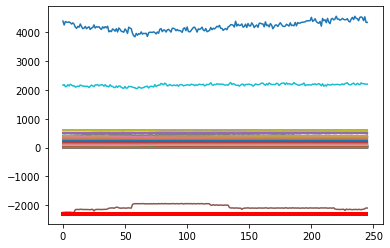

Predicción:  [[[0.9502755  0.04972448]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3778200e+01  1.1609800e+01  6.2261600e+01  7.6246000e+01
  6.0916520e+02  3.7853800e+01  1.0834500e+01  1.9008290e+02
  7.6400000e-02  6.4142800e+01  1.2709070e+02  9.8742000e+00
  6.6593800e+01  1.7772260e+02  2.1007400e+01  1.6068320e+02
  1.8976980e+02  6.9384200e+01 -4.0000000e-04  3.9021000e+00
  1.6934900e+01  7.2980000e+00  1.4998000e+00  7.2362300e+01
  1.4695000e+00  1.5363000e+00  9.0137100e+01  5.8925800e+01
  1.3459000e+00  1.2270000e+00  1.5156000e+00  1.3831000e+00
  1.5766760e+02  8.4360000e-01  8.5040000e-01 -2.1020720e+03
  2.0389670e+02  1.6263000e+00  1.4049000e+00  2.1701012e+03
  4.4056505e+03  1.8481450e+02  1.4185000e+00  1.4079000e+00
  7.9986000e+00  7.4966000e+00  1.7506000e+00  2.3510000e-01
  3.5433700e+01  5.2926670e+02  5.2165000e+02  5.1761020e+02
  5.1781170e+02  5.1803670e+02  2.9516700e+01  3.06

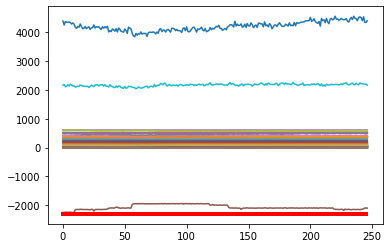

Predicción:  [[[0.95649844 0.04350162]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3767700e+01  1.1580600e+01  6.1025100e+01  7.7331000e+01
  6.0999170e+02  3.7181500e+01  1.0821000e+01  1.8995140e+02
  1.3620000e-01  6.4227500e+01  1.2715470e+02  1.0036000e+01
  6.7067500e+01  1.7619280e+02  2.0858800e+01  1.5950100e+02
  1.8981150e+02  6.9517100e+01 -4.0000000e-04  3.9033000e+00
  1.6222600e+01  7.2930000e+00  1.5003000e+00  7.2430800e+01
  1.4651000e+00  1.5368000e+00  9.0973700e+01  5.8838600e+01
  1.3426000e+00  1.2231000e+00  1.5142000e+00  1.3853000e+00
  1.5816060e+02  8.4340000e-01  8.4990000e-01 -2.0902814e+03
  2.0142090e+02  1.6280000e+00  1.4017000e+00  2.2180745e+03
  4.5221407e+03  1.8481450e+02  1.4213000e+00  1.4109000e+00
  8.0002000e+00  7.4998000e+00  1.7470000e+00  2.3260000e-01
  3.5739100e+01  5.2914890e+02  5.2138310e+02  5.1781900e+02
  5.1798440e+02  5.1816720e+02  2.9445300e+01  3.05

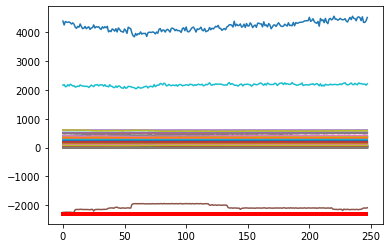

Predicción:  [[[0.9624887  0.03751132]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3560800e+01  1.1566800e+01  6.1122900e+01  7.7255100e+01
  6.1035640e+02  3.7329700e+01  1.0832000e+01  1.9002850e+02
  1.0760000e-01  6.4180600e+01  1.2739180e+02  1.0202200e+01
  6.6715000e+01  1.7636420e+02  2.0812400e+01  1.6011800e+02
  1.8983560e+02  6.9699700e+01 -4.0000000e-04  3.9187000e+00
  1.6275800e+01  7.2838000e+00  1.4996000e+00  7.2394900e+01
  1.4578000e+00  1.5296000e+00  9.3221500e+01  5.9385900e+01
  1.3327000e+00  1.2135000e+00  1.5065000e+00  1.3757000e+00
  1.5808260e+02  8.4350000e-01  8.4950000e-01 -2.0940729e+03
  2.0213180e+02  1.6215000e+00  1.3919000e+00  2.2451680e+03
  4.5768711e+03  1.8481450e+02  1.4123000e+00  1.4027000e+00
  7.9997000e+00  7.4992000e+00  1.7410000e+00  2.3460000e-01
  3.6095400e+01  5.2909780e+02  5.2140930e+02  5.1765940e+02
  5.1789530e+02  5.1810700e+02  2.9372300e+01  3.04

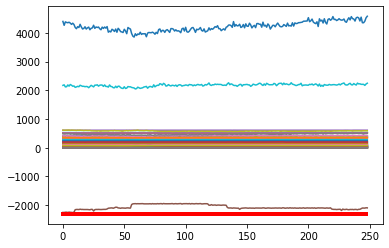

Predicción:  [[[0.96731424 0.03268578]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3762200e+01  1.1564600e+01  6.1849600e+01  7.5768600e+01
  6.1065920e+02  3.7654700e+01  1.0807700e+01  1.9006410e+02
  9.1900000e-02  6.4148900e+01  1.2722300e+02  1.0106100e+01
  6.6761400e+01  1.7838340e+02  2.0903300e+01  1.5981920e+02
  1.8977280e+02  6.9496400e+01 -4.0000000e-04  3.9047000e+00
  1.6888400e+01  7.3096000e+00  1.5001000e+00  7.2380200e+01
  1.4648000e+00  1.5339000e+00  9.2019600e+01  5.8782500e+01
  1.3436000e+00  1.2195000e+00  1.5086000e+00  1.3788000e+00
  1.5806090e+02  8.4740000e-01  8.5010000e-01 -2.1007420e+03
  2.0371540e+02  1.6249000e+00  1.4022000e+00  2.1886768e+03
  4.4784638e+03  1.8481450e+02  1.4142000e+00  1.4038000e+00
  7.9988000e+00  7.4993000e+00  1.7481000e+00  2.3960000e-01
  3.5421900e+01  5.2933340e+02  5.2170150e+02  5.1770510e+02
  5.1797330e+02  5.1811440e+02  2.9366400e+01  3.03

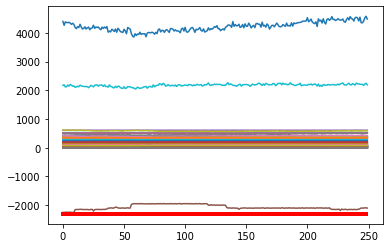

Predicción:  [[[0.962103   0.03789693]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3658900e+01  1.1555100e+01  6.1599600e+01  7.6598700e+01
  6.0914630e+02  3.7139900e+01  1.0830600e+01  1.9005520e+02
  7.7700000e-02  6.4509000e+01  1.2696220e+02  1.0159500e+01
  6.6997400e+01  1.7802040e+02  2.0961000e+01  1.6008080e+02
  1.8979070e+02  6.9451700e+01 -4.0000000e-04  3.9073000e+00
  1.7033200e+01  7.2823000e+00  1.5003000e+00  7.2407300e+01
  1.4662000e+00  1.5370000e+00  9.0683000e+01  5.8720800e+01
  1.3442000e+00  1.2232000e+00  1.5073000e+00  1.3822000e+00
  1.5760000e+02  8.4650000e-01  8.4980000e-01 -2.0943861e+03
  2.0178590e+02  1.6272000e+00  1.4032000e+00  2.2099346e+03
  4.4601107e+03  1.8481450e+02  1.4178000e+00  1.4086000e+00
  8.0035000e+00  7.5011000e+00  1.7488000e+00  2.4180000e-01
  3.5391900e+01  5.2903550e+02  5.2162210e+02  5.1763690e+02
  5.1793900e+02  5.1799510e+02  2.9336000e+01  3.03

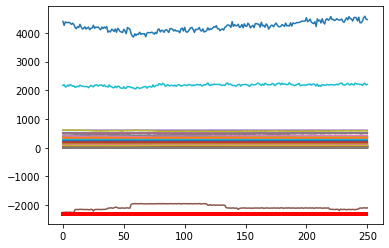

Predicción:  [[[0.95869344 0.04130657]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3699600e+01  1.1550200e+01  6.1758700e+01  7.7323600e+01
  6.1000770e+02  3.5857200e+01  1.0838600e+01  1.9015560e+02
  2.2800000e-02  6.4899900e+01  1.2700310e+02  1.0050700e+01
  6.6871100e+01  1.7628620e+02  2.0789900e+01  1.5998870e+02
  1.8975000e+02  6.9516800e+01 -4.0000000e-04  3.9071000e+00
  1.6850000e+01  7.2950000e+00  1.4985000e+00  7.2382800e+01
  1.4649000e+00  1.5359000e+00  9.0196700e+01  5.8430300e+01
  1.3413000e+00  1.2217000e+00  1.5097000e+00  1.3812000e+00
  1.5703360e+02  8.4470000e-01  8.5030000e-01 -2.0975803e+03
  2.0307490e+02  1.6267000e+00  1.4000000e+00  2.2036616e+03
  4.3830888e+03  1.8481450e+02  1.4175000e+00  1.4075000e+00
  8.0019000e+00  7.5050000e+00  1.7474000e+00  2.3770000e-01
  3.5968500e+01  5.2931770e+02  5.2148160e+02  5.1792090e+02
  5.1811110e+02  5.1827800e+02  2.9292700e+01  3.02

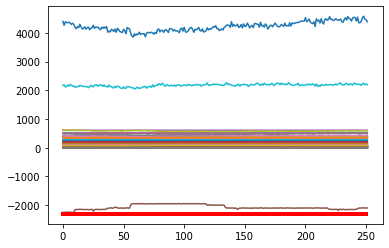

Predicción:  [[[0.9529324  0.04706761]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3548800e+01  1.1558700e+01  6.0622700e+01  7.6839100e+01
  6.1058220e+02  3.5913200e+01  1.0838700e+01  1.9003820e+02
  5.0000000e-04  6.5308100e+01  1.2694210e+02  9.9512000e+00
  6.7200700e+01  1.7541190e+02  2.0879800e+01  1.6008570e+02
  1.8977050e+02  6.9448400e+01 -4.0000000e-04  3.9013000e+00
  1.6403100e+01  7.3000000e+00  1.4986000e+00  7.2477600e+01
  1.4586000e+00  1.5311000e+00  9.0237400e+01  5.9182600e+01
  1.3362000e+00  1.2142000e+00  1.5076000e+00  1.3752000e+00
  1.5943240e+02  8.4330000e-01  8.4980000e-01 -2.0942449e+03
  2.0397690e+02  1.6219000e+00  1.3951000e+00  2.2428308e+03
  4.4997980e+03  1.8481450e+02  1.4112000e+00  1.4023000e+00
  7.9980000e+00  7.4888000e+00  1.7408000e+00  2.3340000e-01
  3.5962900e+01  5.2903110e+02  5.2150110e+02  5.1782710e+02
  5.1801490e+02  5.1810800e+02  2.9270200e+01  3.02

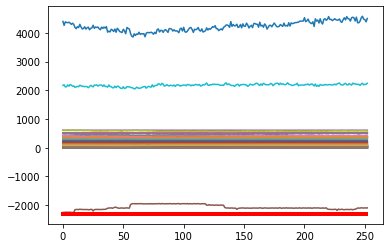

Predicción:  [[[0.96177506 0.03822488]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3512600e+01  1.1538000e+01  6.0177600e+01  7.6297400e+01
  6.1071770e+02  3.5820100e+01  1.0819300e+01  1.9000400e+02
  5.0000000e-04  6.5230400e+01  1.2735310e+02  1.0023700e+01
  6.6991100e+01  1.7605460e+02  2.0630800e+01  1.6021920e+02
  1.8966350e+02  6.9468900e+01 -4.0000000e-04  3.8860000e+00
  1.6535800e+01  7.2985000e+00  1.5001000e+00  7.2405500e+01
  1.4692000e+00  1.5376000e+00  9.1667800e+01  5.9604500e+01
  1.3455000e+00  1.2244000e+00  1.5159000e+00  1.3839000e+00
  1.5943910e+02  8.4390000e-01  8.5000000e-01 -2.0969760e+03
  2.0589620e+02  1.6282000e+00  1.4048000e+00  2.1760751e+03
  4.4678979e+03  1.8481450e+02  1.4197000e+00  1.4095000e+00
  8.0022000e+00  7.5088000e+00  1.7522000e+00  2.3600000e-01
  3.5717700e+01  5.2926890e+02  5.2175670e+02  5.1803080e+02
  5.1817180e+02  5.1831250e+02  2.9076000e+01  3.00

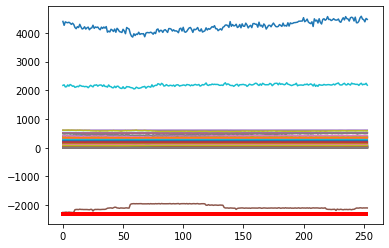

Predicción:  [[[0.96026874 0.03973128]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3554300e+01  1.1521800e+01  5.7741300e+01  7.7125300e+01
  6.0886940e+02  3.5863000e+01  1.0864500e+01  1.8998080e+02
  5.0000000e-04  6.5181000e+01  1.2818230e+02  9.9948000e+00
  6.7422900e+01  1.7620240e+02  2.0277500e+01  1.6002680e+02
  1.8955790e+02  6.9440200e+01 -4.0000000e-04  3.9121000e+00
  1.6405400e+01  7.3045000e+00  1.5009000e+00  7.2357100e+01
  1.4656000e+00  1.5343000e+00  9.1228800e+01  5.9887300e+01
  1.3422000e+00  1.2211000e+00  1.5128000e+00  1.3763000e+00
  1.5879770e+02  8.4650000e-01  8.5090000e-01 -2.1074618e+03
  2.0057460e+02  1.6252000e+00  1.4016000e+00  2.2632704e+03
  4.4355119e+03  1.8481450e+02  1.4084000e+00  1.4026000e+00
  7.9977000e+00  7.4999000e+00  1.7484000e+00  2.3520000e-01
  3.2633500e+01  5.2878220e+02  5.2137410e+02  5.1773660e+02
  5.1795810e+02  5.1806800e+02  2.8975700e+01  2.99

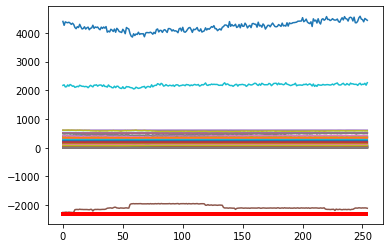

Predicción:  [[[0.96014565 0.03985441]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3469200e+01  1.1558400e+01  5.7722600e+01  7.7363200e+01
  6.1083170e+02  3.5731100e+01  1.0882800e+01  1.8999600e+02
  5.0000000e-04  6.4933800e+01  1.2797100e+02  9.9566000e+00
  6.7036700e+01  1.7591750e+02  2.0522300e+01  1.5982610e+02
  1.8957630e+02  6.9428300e+01 -4.0000000e-04  3.9144000e+00
  1.6375700e+01  7.3136000e+00  1.5000000e+00  7.2396800e+01
  1.4646000e+00  1.5360000e+00  9.1619500e+01  5.9744900e+01
  1.3420000e+00  1.2200000e+00  1.5127000e+00  1.3781000e+00
  1.5863160e+02  8.4710000e-01  8.5020000e-01 -2.0968215e+03
  2.0350610e+02  1.6275000e+00  1.4014000e+00  2.1569116e+03
  4.5533180e+03  1.8481450e+02  1.4091000e+00  1.4037000e+00
  8.0020000e+00  7.4999000e+00  1.7491000e+00  2.3640000e-01
  3.1255300e+01  5.2855110e+02  5.2127110e+02  5.1743810e+02
  5.1777210e+02  5.1792500e+02  2.9227700e+01  3.01

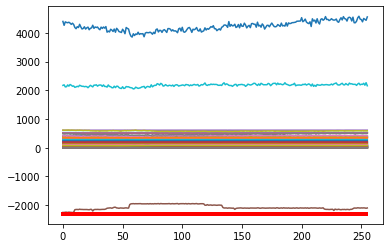

Predicción:  [[[0.9665619  0.03343806]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3240200e+01  1.1603600e+01  5.7834000e+01  7.7292500e+01
  6.0982120e+02  3.4402500e+01  1.0846900e+01  1.9005710e+02
  5.0000000e-04  6.4620000e+01  1.2735880e+02  9.9892000e+00
  6.6891800e+01  1.7362660e+02  2.0676900e+01  1.5986900e+02
  1.8952620e+02  6.9206900e+01 -4.0000000e-04  3.9052000e+00
  1.6523700e+01  7.2933000e+00  1.5005000e+00  7.2351500e+01
  1.4643000e+00  1.5346000e+00  9.1597900e+01  6.0334900e+01
  1.3410000e+00  1.2210000e+00  1.5198000e+00  1.3805000e+00
  1.5847410e+02  8.4820000e-01  8.5000000e-01 -2.1049372e+03
  2.0315560e+02  1.6258000e+00  1.4013000e+00  2.2157343e+03
  4.4637856e+03  1.8481450e+02  1.4105000e+00  1.4037000e+00
  8.0036000e+00  7.5003000e+00  1.7491000e+00  2.2950000e-01
  2.9879900e+01  5.2871550e+02  5.2132640e+02  5.1751140e+02
  5.1783950e+02  5.1812670e+02  2.9545800e+01  3.03

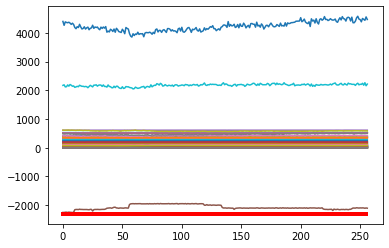

Predicción:  [[[0.96189946 0.03810056]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3323700e+01  1.1594700e+01  5.8455000e+01  7.6716300e+01
  6.0952050e+02  3.4592200e+01  1.0824700e+01  1.9002830e+02
  5.0000000e-04  6.4491900e+01  1.2783060e+02  1.0014300e+01
  6.7035600e+01  1.7343550e+02  2.0943600e+01  1.6000790e+02
  1.8957530e+02  6.9433900e+01 -4.0000000e-04  3.9170000e+00
  1.6564500e+01  7.2879000e+00  1.4977000e+00  7.2427700e+01
  1.4601000e+00  1.5340000e+00  9.1858900e+01  6.0871500e+01
  1.3350000e+00  1.2155000e+00  1.5153000e+00  1.3771000e+00
  1.5904780e+02  8.4780000e-01  8.5070000e-01 -2.0902277e+03
  2.0290750e+02  1.6259000e+00  1.3956000e+00  2.2507941e+03
  4.4625527e+03  1.8481450e+02  1.4072000e+00  1.4020000e+00
  7.9944000e+00  7.4993000e+00  1.7470000e+00  2.3180000e-01
  2.9934600e+01  5.2910000e+02  5.2156320e+02  5.1792620e+02
  5.1822100e+02  5.1849420e+02  2.9549600e+01  3.05

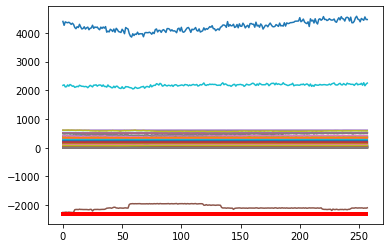

Predicción:  [[[0.95772773 0.0422723 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3511900e+01  1.1522800e+01  6.0077400e+01  7.5180800e+01
  6.0947360e+02  3.5438200e+01  1.0817000e+01  1.9001940e+02
  5.0000000e-04  6.4302700e+01  1.2815450e+02  9.9337000e+00
  6.6951900e+01  1.7615630e+02  2.0856600e+01  1.5994950e+02
  1.8959570e+02  6.9127700e+01 -4.0000000e-04  3.8823000e+00
  1.7280800e+01  7.3081000e+00  1.4993000e+00  7.2415100e+01
  1.4629000e+00  1.5339000e+00  9.0831500e+01  6.0383000e+01
  1.3410000e+00  1.2194000e+00  1.5114000e+00  1.3745000e+00
  1.5751290e+02  8.4810000e-01  8.4990000e-01 -2.1031232e+03
  2.0406040e+02  1.6251000e+00  1.4015000e+00  2.2405918e+03
  4.3716332e+03  1.8481450e+02  1.4034000e+00  1.3980000e+00
  8.0018000e+00  7.4936000e+00  1.7507000e+00  2.3960000e-01
  2.9235800e+01  5.2875110e+02  5.2153580e+02  5.1762060e+02
  5.1788720e+02  5.1807720e+02  2.9445000e+01  3.04

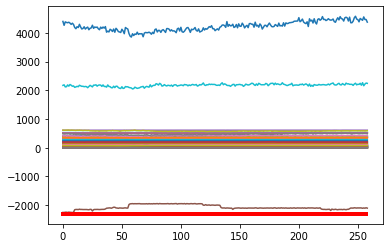

Predicción:  [[[0.9533167 0.0466833]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3467800e+01  1.1509600e+01  5.9522000e+01  7.4437900e+01
  6.1113490e+02  3.5579100e+01  1.0868000e+01  1.8997070e+02
  5.0000000e-04  6.4354600e+01  1.2802300e+02  9.9157000e+00
  6.7431100e+01  1.7624070e+02  2.0342900e+01  1.6006230e+02
  1.8963890e+02  6.9136300e+01 -4.0000000e-04  3.9100000e+00
  1.7607600e+01  7.3041000e+00  1.5006000e+00  7.2365700e+01
  1.4716000e+00  1.5422000e+00  9.0793700e+01  6.0431400e+01
  1.3468000e+00  1.2303000e+00  1.5184000e+00  1.3853000e+00
  1.5590820e+02  8.4870000e-01  8.5070000e-01 -2.1051116e+03
  2.0485720e+02  1.6335000e+00  1.4071000e+00  2.2343402e+03
  4.4152763e+03  1.8481450e+02  1.4141000e+00  1.4076000e+00
  7.9974000e+00  7.4984000e+00  1.7595000e+00  2.4120000e-01
  2.8846500e+01  5.2921560e+02  5.2125700e+02  5.1749060e+02
  5.1771810e+02  5.1798720e+02  3.0497600e+01  3.0954

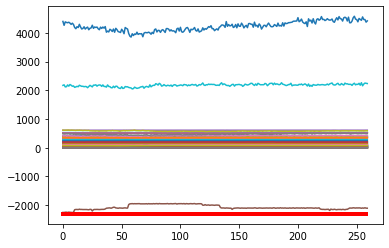

Predicción:  [[[0.9577285  0.04227151]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3408000e+01  1.1551200e+01  5.6749000e+01  7.4749400e+01
  6.1066630e+02  3.5500800e+01  1.0891300e+01  1.9000050e+02
  5.0000000e-04  6.4318700e+01  1.2793690e+02  1.0113700e+01
  6.6590400e+01  1.7592820e+02  2.0237500e+01  1.6001050e+02
  1.8957360e+02  6.9067100e+01 -4.0000000e-04  3.8916000e+00
  1.7908300e+01  7.3105000e+00  1.4993000e+00  7.2436100e+01
  1.4826000e+00  1.5514000e+00  9.0548000e+01  6.0411900e+01
  1.3547000e+00  1.2439000e+00  1.5296000e+00  1.3979000e+00
  1.5442210e+02  8.4660000e-01  8.4920000e-01 -2.0951787e+03
  2.0222040e+02  1.6425000e+00  1.4151000e+00  2.1794198e+03
  4.4490679e+03  1.8481450e+02  1.4267000e+00  1.4200000e+00
  8.0061000e+00  7.5053000e+00  1.7707000e+00  2.4110000e-01
  2.8911500e+01  5.2883340e+02  5.2142810e+02  5.1759080e+02
  5.1773480e+02  5.1801450e+02  2.9987200e+01  3.10

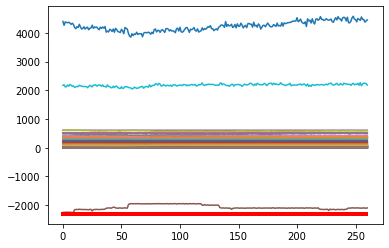

Predicción:  [[[0.95775926 0.04224077]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3449500e+01  1.1567400e+01  5.7382400e+01  7.6143500e+01
  6.0975280e+02  3.5133000e+01  1.0872000e+01  1.9003540e+02
  2.7000000e-03  6.6852900e+01  1.2772510e+02  9.9373000e+00
  6.7114500e+01  1.7692380e+02  2.0259000e+01  1.5991830e+02
  1.8949350e+02  6.9369000e+01 -4.0000000e-04  3.9191000e+00
  1.7776600e+01  7.2848000e+00  1.4993000e+00  7.2350700e+01
  1.4715000e+00  1.5390000e+00  9.1720800e+01  5.9881100e+01
  1.3422000e+00  1.2319000e+00  1.5120000e+00  1.3871000e+00
  1.5521500e+02  8.4860000e-01  8.5190000e-01 -2.0905249e+03
  2.0303360e+02  1.6310000e+00  1.4018000e+00  2.1560486e+03
  4.5500943e+03  1.8481450e+02  1.4164000e+00  1.4118000e+00
  8.0021000e+00  7.5042000e+00  1.7566000e+00  2.4490000e-01
  2.9126600e+01  5.2973330e+02  5.2182260e+02  5.1817670e+02
  5.1829740e+02  5.1864670e+02  3.0229800e+01  3.10

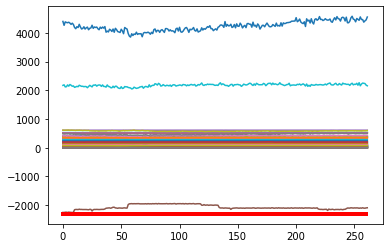

Predicción:  [[[0.96450347 0.03549655]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3522900e+01  1.1594600e+01  6.6205600e+01  7.7553300e+01
  6.0978110e+02  3.5253000e+01  1.0863700e+01  1.9003630e+02
  5.0000000e-04  6.7137000e+01  1.2158370e+02  9.9168000e+00
  6.7129800e+01  1.7577460e+02  2.0480200e+01  1.6032310e+02
  1.8937810e+02  6.9389500e+01 -4.0000000e-04  3.8957000e+00
  1.7617600e+01  7.3013000e+00  1.4999000e+00  7.2386900e+01
  1.4532000e+00  1.5222000e+00  9.1402500e+01  6.0866900e+01
  1.3280000e+00  1.2181000e+00  1.4990000e+00  1.3714000e+00
  1.5265570e+02  8.4810000e-01  8.5000000e-01 -2.1001457e+03
  2.0347920e+02  1.6137000e+00  1.3885000e+00  2.1780449e+03
  4.5446457e+03  1.8481450e+02  1.4008000e+00  1.3957000e+00
  7.9986000e+00  7.4999000e+00  1.7389000e+00  2.3980000e-01
  2.9603500e+01  5.2900000e+02  5.2124270e+02  5.1742220e+02
  5.1757590e+02  5.1792360e+02  3.1001600e+01  3.17

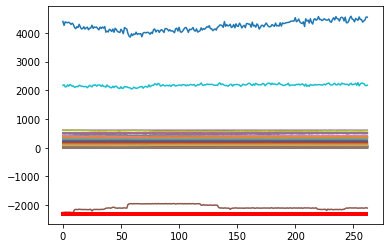

Predicción:  [[[0.96631247 0.03368754]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3665400e+01  1.1725500e+01  5.7189300e+01  7.5042500e+01
  6.1049610e+02  3.5482200e+01  1.0875900e+01  1.9002590e+02
  5.0000000e-04  6.6628600e+01  1.2869340e+02  1.0165900e+01
  6.6518500e+01  1.7612050e+02  2.0440800e+01  1.6015260e+02
  1.8977550e+02  6.9591700e+01 -4.0000000e-04  3.8800000e+00
  1.7704100e+01  7.3032000e+00  1.4988000e+00  7.2372600e+01
  1.4350000e+00  1.5037000e+00  9.2443400e+01  6.1064000e+01
  1.3107000e+00  1.1996000e+00  1.4818000e+00  1.3493000e+00
  1.5135210e+02  8.4810000e-01  8.5040000e-01 -2.1030926e+03
  2.0281690e+02  1.5954000e+00  1.3719000e+00  2.2153624e+03
  4.4438970e+03  1.8481450e+02  1.3781000e+00  1.3732000e+00
  7.9992000e+00  7.4997000e+00  1.7235000e+00  2.4210000e-01
  2.8993500e+01  5.2875110e+02  5.2120500e+02  5.1699180e+02
  5.1719990e+02  5.1761600e+02  3.1213100e+01  3.19

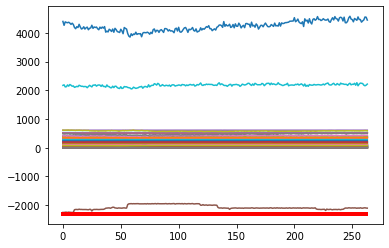

Predicción:  [[[0.9595113  0.04048875]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3948600e+01  1.1754000e+01  6.0695700e+01  7.3732700e+01
  6.1018600e+02  3.4675700e+01  1.0920500e+01  1.9003680e+02
  5.0000000e-04  6.6781800e+01  1.2813920e+02  1.0100200e+01
  6.6177100e+01  1.7648460e+02  2.0675100e+01  1.5984670e+02
  1.9002800e+02  6.9431500e+01 -4.0000000e-04  3.8873000e+00
  1.8125200e+01  7.3100000e+00  1.5002000e+00  7.2444600e+01
  1.4552000e+00  1.5284000e+00  9.1604400e+01  5.9997700e+01
  1.3316000e+00  1.2155000e+00  1.4972000e+00  1.3728000e+00
  1.5329220e+02  8.4850000e-01  8.4970000e-01 -2.1014134e+03
  2.0145680e+02  1.6178000e+00  1.3917000e+00  2.2086142e+03
  4.3664881e+03  1.8481450e+02  1.4023000e+00  1.3937000e+00
  7.9989000e+00  7.5002000e+00  1.7458000e+00  2.4860000e-01
  2.9259200e+01  5.2886440e+02  5.2060880e+02  5.1696710e+02
  5.1714320e+02  5.1747180e+02  3.1480100e+01  3.21

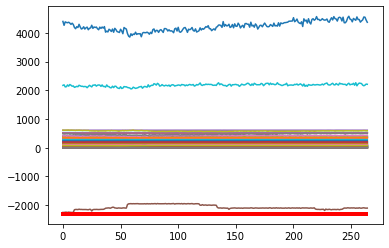

Predicción:  [[[0.9520537  0.04794627]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4146200e+01  1.1709600e+01  5.9928500e+01  7.6381700e+01
  6.0972340e+02  3.4696600e+01  1.0923500e+01  1.8985140e+02
  1.2000000e-03  6.7051600e+01  1.2752300e+02  9.9411000e+00
  6.5469400e+01  1.7549510e+02  2.0951300e+01  1.6039810e+02
  1.9002160e+02  6.8982700e+01  1.0143400e+01  3.8653000e+00
  1.8092000e+01  7.2813000e+00  1.4989000e+00  7.2319600e+01
  1.4673000e+00  1.5405000e+00  9.0168000e+01  5.9428600e+01
  1.3437000e+00  1.2282000e+00  1.5086000e+00  1.3787000e+00
  1.5577980e+02  8.4890000e-01  8.4940000e-01 -2.1161025e+03
  2.0523330e+02  1.6328000e+00  1.4033000e+00  2.2377154e+03
  4.4187897e+03  1.8481450e+02  1.4085000e+00  1.4033000e+00
  7.9991000e+00  7.4983000e+00  1.7555000e+00  2.4680000e-01
  2.9732200e+01  5.3123330e+02  5.2192570e+02  5.1875770e+02
  5.1879680e+02  5.1911450e+02  3.1515600e+01  3.24

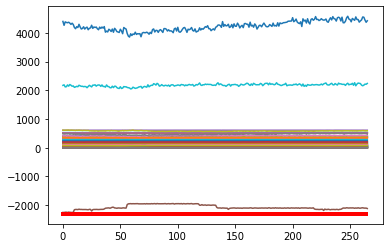

Predicción:  [[[0.9602858  0.03971422]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3809000e+01  1.1656500e+01  5.9355900e+01  7.5690100e+01
  6.1037120e+02  3.5696400e+01  1.0867300e+01  1.9006750e+02
  3.8000000e-03  6.7012400e+01  1.2819320e+02  1.0044600e+01
  6.6550000e+01  1.7611430e+02  2.0911000e+01  1.6004840e+02
  1.8985820e+02  6.9593400e+01  1.8920000e-01  3.7923000e+00
  1.7859600e+01  7.3152000e+00  1.4998000e+00  7.2364900e+01
  1.4491000e+00  1.5199000e+00  8.9494000e+01  6.1186600e+01
  1.3232000e+00  1.2112000e+00  1.4885000e+00  1.3640000e+00
  1.5447350e+02  8.4860000e-01  8.4990000e-01 -2.1043418e+03
  2.0158310e+02  1.6091000e+00  1.3840000e+00  2.2611284e+03
  4.4081020e+03  1.8481450e+02  1.3934000e+00  1.3897000e+00
  7.9986000e+00  7.4995000e+00  1.7367000e+00  2.4860000e-01
  2.9520700e+01  5.2996890e+02  5.2174950e+02  5.1770180e+02
  5.1773320e+02  5.1804050e+02  3.1452800e+01  3.23

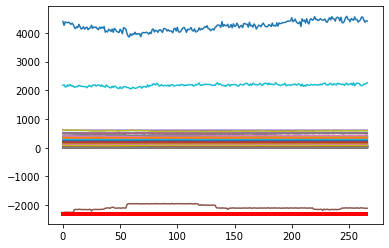

Predicción:  [[[0.9565065  0.04349351]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3884300e+01  1.1679200e+01  5.9918300e+01  7.4769500e+01
  6.1082990e+02  3.5480900e+01  1.0853900e+01  1.8999530e+02
  6.5000000e-03  6.7298600e+01  1.2778540e+02  1.0080200e+01
  6.7258600e+01  1.7762250e+02  2.0773900e+01  1.5983220e+02
  1.8979020e+02  6.9627300e+01 -4.0000000e-04  3.7871000e+00
  1.8103000e+01  7.2912000e+00  1.5014000e+00  7.2442600e+01
  1.4498000e+00  1.5181000e+00  9.0811300e+01  6.0547700e+01
  1.3264000e+00  1.2133000e+00  1.4841000e+00  1.3663000e+00
  1.5269590e+02  8.4880000e-01  8.5000000e-01 -2.1048474e+03
  2.0223880e+02  1.6080000e+00  1.3864000e+00  2.2151797e+03
  4.4222580e+03  1.8481450e+02  1.3947000e+00  1.3908000e+00
  8.0035000e+00  7.5010000e+00  1.7375000e+00  2.5340000e-01
  2.8498600e+01  5.2929990e+02  5.2101510e+02  5.1726250e+02
  5.1731640e+02  5.1770810e+02  3.1531100e+01  3.23

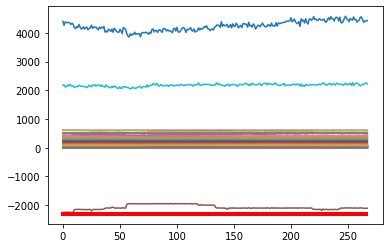

Predicción:  [[[0.95770437 0.04229567]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3881500e+01  1.1563800e+01  5.9076100e+01  7.5112400e+01
  6.0976080e+02  3.5729100e+01  1.0834800e+01  1.9015690e+02
  9.3000000e-03  6.7495000e+01  1.2834260e+02  1.0009200e+01
  6.7135200e+01  1.7712420e+02  2.0844500e+01  1.6042110e+02
  1.8978320e+02  6.9741000e+01 -4.0000000e-04  3.7821000e+00
  1.8106000e+01  7.2943000e+00  1.5016000e+00  7.2329300e+01
  1.4501000e+00  1.5189000e+00  9.0423000e+01  5.9984100e+01
  1.3266000e+00  1.2132000e+00  1.4857000e+00  1.3647000e+00
  1.5212460e+02  8.4850000e-01  8.4980000e-01 -2.1053799e+03
  2.0476520e+02  1.6088000e+00  1.3863000e+00  2.2046168e+03
  4.4191685e+03  1.8481450e+02  1.3939000e+00  1.3897000e+00
  7.9971000e+00  7.4998000e+00  1.7372000e+00  2.5130000e-01
  2.9193600e+01  5.2941340e+02  5.2106730e+02  5.1721210e+02
  5.1728250e+02  5.1774040e+02  3.1479200e+01  3.23

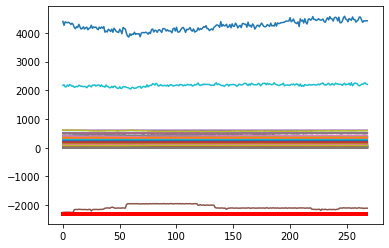

Predicción:  [[[0.9578692  0.04213081]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3857900e+01  1.1568500e+01  5.8752100e+01  7.5147100e+01
  6.1089640e+02  3.5961900e+01  1.0829600e+01  1.9005180e+02
  1.2300000e-02  6.7196100e+01  1.2785330e+02  1.0087800e+01
  6.7093500e+01  1.7740580e+02  2.1045700e+01  1.5988160e+02
  1.8970170e+02  6.9602800e+01 -4.0000000e-04  3.7780000e+00
  1.8098500e+01  7.3227000e+00  1.5011000e+00  7.2419000e+01
  1.4538000e+00  1.5223000e+00  8.9920900e+01  6.0234200e+01
  1.3293000e+00  1.2175000e+00  1.4879000e+00  1.3671000e+00
  1.5201840e+02  8.4890000e-01  8.5010000e-01 -2.0999026e+03
  2.0174930e+02  1.6121000e+00  1.3892000e+00  2.2096868e+03
  4.4281823e+03  1.8481450e+02  1.3960000e+00  1.3895000e+00
  8.0011000e+00  7.4997000e+00  1.7401000e+00  2.5220000e-01
  2.9162600e+01  5.3031780e+02  5.2152850e+02  5.1766140e+02
  5.1773050e+02  5.1809550e+02  3.1459800e+01  3.22

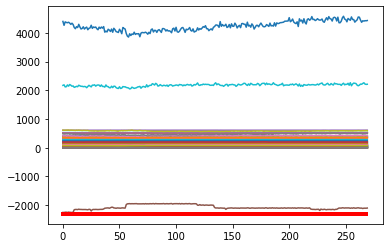

Predicción:  [[[0.9569838  0.04301623]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3787700e+01  1.1615800e+01  5.7067100e+01  7.4761300e+01
  6.0983530e+02  3.6148500e+01  1.0833700e+01  1.8997240e+02
  5.4000000e-03  6.7114000e+01  1.2843130e+02  1.0078200e+01
  6.7073700e+01  1.7730380e+02  2.1279400e+01  1.5991410e+02
  1.8962150e+02  6.9851700e+01 -4.0000000e-04  3.7868000e+00
  1.8091900e+01  7.2899000e+00  1.4991000e+00  7.2405500e+01
  1.4456000e+00  1.5138000e+00  9.0632700e+01  6.0434600e+01
  1.3189000e+00  1.2097000e+00  1.4783000e+00  1.3596000e+00
  1.5097260e+02  8.4890000e-01  8.5040000e-01 -2.0985757e+03
  2.0215270e+02  1.6034000e+00  1.3791000e+00  2.2475647e+03
  4.5130051e+03  1.8481450e+02  1.3882000e+00  1.3836000e+00
  7.9996000e+00  7.5011000e+00  1.7330000e+00  2.5440000e-01
  2.8970700e+01  5.2983560e+02  5.2111580e+02  5.1716360e+02
  5.1722150e+02  5.1756150e+02  3.1711500e+01  3.25

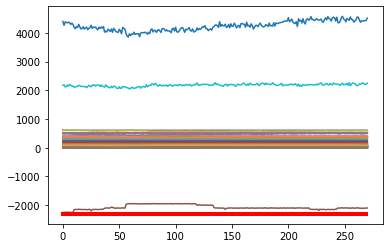

Predicción:  [[[0.96328795 0.03671209]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3672900e+01  1.1587100e+01  5.7444300e+01  7.4087400e+01
  6.0971350e+02  3.5858300e+01  1.0817000e+01  1.8997690e+02
  1.1100000e-02  6.6826300e+01  1.2867520e+02  9.9520000e+00
  6.6694800e+01  1.7682730e+02  2.1421400e+01  1.5974520e+02
  1.8962960e+02  6.9637800e+01 -4.0000000e-04  3.8041000e+00
  1.9694500e+01  7.3144000e+00  1.4996000e+00  7.2380500e+01
  1.4511000e+00  1.5205000e+00  9.0264600e+01  6.0109600e+01
  1.3277000e+00  1.2142000e+00  1.4785000e+00  1.3641000e+00
  1.5117100e+02  8.4870000e-01  8.5040000e-01 -2.1058413e+03
  2.0149800e+02  1.6097000e+00  1.3875000e+00  2.2310887e+03
  4.4229138e+03  1.8481450e+02  1.3937000e+00  1.3887000e+00
  7.9980000e+00  7.5004000e+00  1.7370000e+00  2.5850000e-01
  2.9600100e+01  5.2953940e+02  5.2131720e+02  5.1742440e+02
  5.1759650e+02  5.1791730e+02  3.1633400e+01  3.27

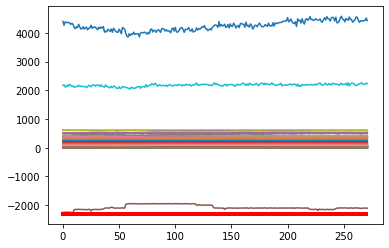

Predicción:  [[[0.9579884  0.04201167]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3436200e+01  1.1706500e+01  5.9182100e+01  7.3959400e+01
  6.1074270e+02  3.5477800e+01  1.0800500e+01  1.9004820e+02
  1.6700000e-02  6.7312300e+01  1.2785400e+02  9.8074000e+00
  6.6924400e+01  1.7407530e+02  2.1871600e+01  1.5992800e+02
  1.8976140e+02  6.9788500e+01 -4.0000000e-04  3.8169000e+00
  1.8893300e+01  7.3041000e+00  1.5002000e+00  7.2335200e+01
  1.4632000e+00  1.5345000e+00  8.9450000e+01  5.8982500e+01
  1.3309000e+00  1.2281000e+00  1.4937000e+00  1.3814000e+00
  1.5283330e+02  8.4520000e-01  8.4960000e-01 -2.1995635e+03
  2.0352550e+02  1.6243000e+00  1.3899000e+00  2.2252924e+03
  4.5575949e+03  1.8481450e+02  1.4113000e+00  1.4122000e+00
  7.9188000e+00  7.4987000e+00  1.7453000e+00  2.5150000e-01
  2.9823000e+01  5.3086660e+02  5.2255160e+02  5.1862480e+02
  5.1880030e+02  5.1914790e+02  3.1665800e+01  3.27

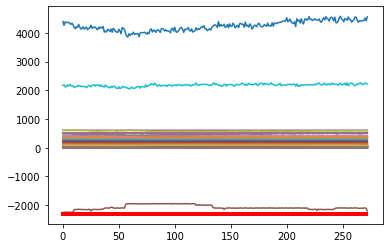

Predicción:  [[[0.9830671 0.0169329]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3350100e+01  1.1799900e+01  6.0714300e+01  7.4796200e+01
  6.0977140e+02  3.4961000e+01  1.0778200e+01  1.8999830e+02
  1.8300000e-02  6.7757100e+01  1.2778830e+02  1.0128700e+01
  6.6662600e+01  1.7196430e+02  2.1879000e+01  1.5981870e+02
  1.8999000e+02  6.9792200e+01 -4.0000000e-04  3.7869000e+00
  1.7505400e+01  7.2952000e+00  1.5008000e+00  7.2420400e+01
  1.4571000e+00  1.5270000e+00  8.9268400e+01  5.9576200e+01
  1.3256000e+00  1.2229000e+00  1.4969000e+00  1.3767000e+00
  1.5346850e+02  8.4560000e-01  8.5030000e-01 -2.1948191e+03
  2.0337600e+02  1.6156000e+00  1.3851000e+00  2.2155586e+03
  4.5356583e+03  1.8481450e+02  1.4060000e+00  1.4049000e+00
  7.9026000e+00  7.5001000e+00  1.7404000e+00  2.4370000e-01
  2.9016000e+01  5.3042280e+02  5.2214890e+02  5.1784510e+02
  5.1827880e+02  5.1860570e+02  3.1707300e+01  3.2726

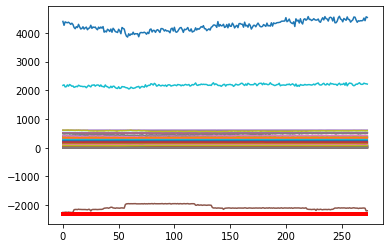

Predicción:  [[[0.9817816  0.01821837]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3410900e+01  1.1879500e+01  5.9659600e+01  7.4670800e+01
  6.0993830e+02  3.4254100e+01  1.0838500e+01  1.9006640e+02
  6.9000000e-03  6.7509200e+01  1.2793600e+02  9.9627000e+00
  6.6820900e+01  1.7427450e+02  2.2002300e+01  1.6051080e+02
  1.9023490e+02  6.9833900e+01 -4.0000000e-04  3.8157000e+00
  1.7029900e+01  7.2880000e+00  1.5002000e+00  7.2459800e+01
  1.4536000e+00  1.5275000e+00  8.9743700e+01  5.9836900e+01
  1.3242000e+00  1.2194000e+00  1.4885000e+00  1.3742000e+00
  1.5172140e+02  8.4580000e-01  8.4880000e-01 -2.1963266e+03
  2.0374530e+02  1.6192000e+00  1.3838000e+00  2.2088677e+03
  4.5805556e+03  1.8481450e+02  1.4039000e+00  1.4031000e+00
  7.8981000e+00  7.4959000e+00  1.7398000e+00  2.5150000e-01
  2.9462000e+01  5.3070220e+02  5.2243790e+02  5.1825550e+02
  5.1876090e+02  5.1894930e+02  3.1670700e+01  3.27

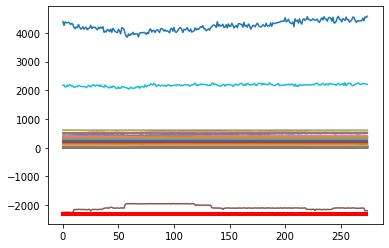

Predicción:  [[[0.98363644 0.01636356]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3309100e+01  1.1800100e+01  6.0012900e+01  7.3926900e+01
  6.0954090e+02  3.4078600e+01  1.0827300e+01  1.8992600e+02
  5.0000000e-04  6.7657800e+01  1.2763840e+02  9.8796000e+00
  6.6671300e+01  1.7544230e+02  2.1908000e+01  1.6009930e+02
  1.9014640e+02  6.9637100e+01 -4.0000000e-04  3.8107000e+00
  1.6907600e+01  7.3056000e+00  1.4987000e+00  7.2418500e+01
  1.4632000e+00  1.5317000e+00  8.8212900e+01  5.9375400e+01
  1.3288000e+00  1.2257000e+00  1.4982000e+00  1.3745000e+00
  1.5136190e+02  8.4560000e-01  8.5090000e-01 -2.2036635e+03
  2.0341340e+02  1.6198000e+00  1.3882000e+00  2.1786912e+03
  4.5635566e+03  1.8481450e+02  1.4040000e+00  1.4034000e+00
  7.8996000e+00  7.4990000e+00  1.7524000e+00  2.5400000e-01
  2.9580700e+01  5.3075610e+02  5.2223610e+02  5.1810390e+02
  5.1870410e+02  5.1881770e+02  3.1632700e+01  3.27

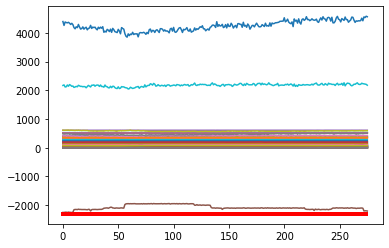

Predicción:  [[[0.9838786  0.01612145]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3284000e+01  1.1905400e+01  5.7827500e+01  7.4194800e+01
  6.0972930e+02  3.3943100e+01  1.0844400e+01  1.9002500e+02
  5.0000000e-04  6.7961100e+01  1.2820660e+02  9.9362000e+00
  6.6510100e+01  1.7657070e+02  2.1863800e+01  1.6035690e+02
  1.9035200e+02  6.9865100e+01 -4.0000000e-04  3.7908000e+00
  1.7463400e+01  7.3092000e+00  1.5006000e+00  7.2426300e+01
  1.4644000e+00  1.5366000e+00  8.8395500e+01  5.9200900e+01
  1.3317000e+00  1.2251000e+00  1.4933000e+00  1.3740000e+00
  1.5074920e+02  8.4430000e-01  8.4970000e-01 -2.2019935e+03
  2.0248490e+02  1.6244000e+00  1.3910000e+00  2.2471691e+03
  4.5637449e+03  1.8481450e+02  1.4033000e+00  1.4034000e+00
  7.9015000e+00  7.5000000e+00  1.7548000e+00  2.6160000e-01
  2.9399400e+01  5.3081770e+02  5.2254360e+02  5.1825900e+02
  5.1892020e+02  5.1895350e+02  3.1535400e+01  3.26

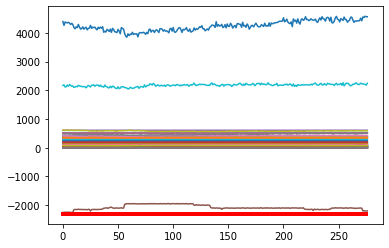

Predicción:  [[[0.98360324 0.01639676]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3343600e+01  1.1968900e+01  5.7906100e+01  7.5015800e+01
  6.1100170e+02  3.4374000e+01  1.0863200e+01  1.8990890e+02
  5.0000000e-04  6.7761900e+01  1.2801590e+02  9.9567000e+00
  6.6311200e+01  1.7711150e+02  2.1727400e+01  1.6012650e+02
  1.9021300e+02  6.9731700e+01 -4.0000000e-04  3.8103000e+00
  1.7645800e+01  7.3123000e+00  1.5006000e+00  7.2436300e+01
  1.4673000e+00  1.5365000e+00  8.8365300e+01  5.9291700e+01
  1.3287000e+00  1.2270000e+00  1.4934000e+00  1.3764000e+00
  1.5111060e+02  8.4580000e-01  8.5020000e-01 -2.2482773e+03
  2.0236770e+02  1.6230000e+00  1.3877000e+00  2.2323402e+03
  4.6760486e+03  1.8481450e+02  1.4064000e+00  1.4056000e+00
  7.9019000e+00  7.4993000e+00  1.7565000e+00  2.6310000e-01
  2.9878300e+01  5.3075840e+02  5.2284520e+02  5.1852370e+02
  5.1919100e+02  5.1912680e+02  3.1408800e+01  3.25

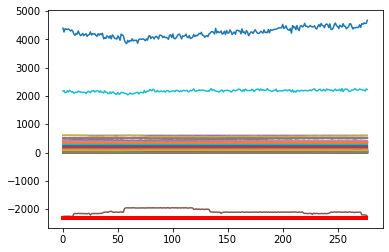

Predicción:  [[[0.990334   0.00966598]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3487000e+01  1.1983200e+01  5.9207400e+01  7.5692100e+01
  6.1053320e+02  3.4338500e+01  1.0843900e+01  1.9007330e+02
  5.0000000e-04  6.7718500e+01  1.2767540e+02  1.0006000e+01
  6.6244200e+01  1.7724960e+02  2.1791200e+01  1.5986510e+02
  1.9042210e+02  6.9802700e+01 -4.0000000e-04  3.7960000e+00
  1.7627800e+01  7.3045000e+00  1.5005000e+00  7.2411000e+01
  1.4720000e+00  1.5416000e+00  8.8797500e+01  5.8969600e+01
  1.3350000e+00  1.2316000e+00  1.4962000e+00  1.3849000e+00
  1.5230270e+02  8.4460000e-01  8.5000000e-01 -2.2538668e+03
  2.0474080e+02  1.6310000e+00  1.3939000e+00  2.2369355e+03
  4.5663327e+03  1.8481450e+02  1.4161000e+00  1.4147000e+00
  7.8959000e+00  7.5040000e+00  1.7610000e+00  2.6480000e-01
  3.1216500e+01  5.3138110e+02  5.2305460e+02  5.1898990e+02
  5.1965060e+02  5.1963760e+02  3.1234900e+01  3.23

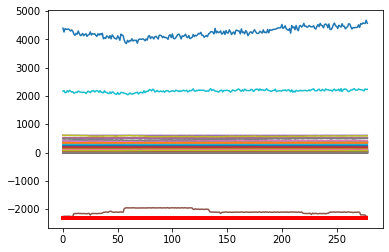

Predicción:  [[[0.98853266 0.01146739]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3161700e+01  1.1912600e+01  5.8532700e+01  7.4985900e+01
  6.0959820e+02  3.5784800e+01  1.0822300e+01  1.9003270e+02
  5.0000000e-04  6.7421300e+01  1.2760380e+02  1.0047400e+01
  6.6872200e+01  1.7800340e+02  2.1889500e+01  1.5978240e+02
  1.9039330e+02  6.9969300e+01 -4.0000000e-04  3.7887000e+00
  1.7430000e+01  7.2805000e+00  1.5002000e+00  7.2380900e+01
  1.4716000e+00  1.5414000e+00  9.0147100e+01  5.8516400e+01
  1.3329000e+00  1.2295000e+00  1.4889000e+00  1.3838000e+00
  1.5440040e+02  8.4370000e-01  8.5010000e-01 -2.2499314e+03
  2.0444980e+02  1.6309000e+00  1.3919000e+00  2.1693107e+03
  4.6729122e+03  1.8481450e+02  1.4183000e+00  1.4121000e+00
  7.8965000e+00  7.4971000e+00  1.7597000e+00  2.7060000e-01
  3.4294600e+01  5.3215110e+02  5.2376510e+02  5.1958890e+02
  5.2030590e+02  5.2026840e+02  3.0933500e+01  3.21

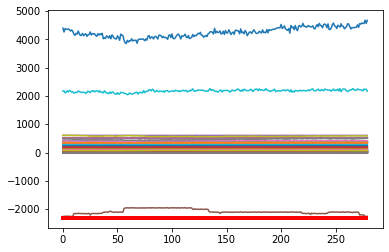

Predicción:  [[[0.9904248  0.00957521]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3168100e+01  1.1849400e+01  5.8063500e+01  7.4139200e+01
  6.0892960e+02  3.6586600e+01  1.0835400e+01  1.8993810e+02
  5.0000000e-04  6.6907500e+01  1.2799890e+02  1.0008800e+01
  6.6575100e+01  1.7959440e+02  2.1136600e+01  1.6003710e+02
  1.9033080e+02  6.9844500e+01 -4.0000000e-04  3.7842000e+00
  1.7409100e+01  7.3233000e+00  1.4992000e+00  7.2440700e+01
  1.4719000e+00  1.5430000e+00  8.9704400e+01  5.8971900e+01
  1.3366000e+00  1.2306000e+00  1.4861000e+00  1.3842000e+00
  1.5362020e+02  8.4280000e-01  8.4990000e-01 -2.2527179e+03
  2.0514660e+02  1.6325000e+00  1.3955000e+00  2.2396530e+03
  4.5422940e+03  1.8481450e+02  1.4205000e+00  1.4135000e+00
  7.9018000e+00  7.5000000e+00  1.7603000e+00  2.7390000e-01
  3.6192500e+01  5.3244170e+02  5.2387300e+02  5.1957990e+02
  5.2035790e+02  5.2032890e+02  3.0471500e+01  3.17

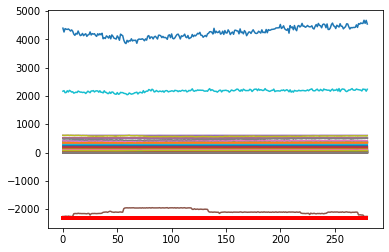

Predicción:  [[[0.9878693  0.01213062]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3184700e+01  1.1943900e+01  5.7041900e+01  7.5420100e+01
  6.1042340e+02  3.6400500e+01  1.0836300e+01  1.8998300e+02
  5.0000000e-04  6.7500300e+01  1.2821190e+02  9.5273000e+00
  6.6468500e+01  1.7896560e+02  2.1084600e+01  1.6004930e+02
  1.9041500e+02  7.0065200e+01 -4.0000000e-04  3.8058000e+00
  1.7111200e+01  7.2870000e+00  1.4992000e+00  7.2416200e+01
  1.4649000e+00  1.5353000e+00  9.0465300e+01  5.9306500e+01
  1.3258000e+00  1.2235000e+00  1.4773000e+00  1.3791000e+00
  1.5398340e+02  8.4350000e-01  8.5000000e-01 -2.2443361e+03
  2.0427330e+02  1.6237000e+00  1.3856000e+00  2.2096921e+03
  4.5827597e+03  1.8481450e+02  1.4151000e+00  1.4074000e+00
  7.9001000e+00  7.5005000e+00  1.7514000e+00  2.7450000e-01
  3.5981300e+01  5.3150950e+02  5.2358960e+02  5.1926320e+02
  5.2002780e+02  5.1998490e+02  3.0286800e+01  3.13

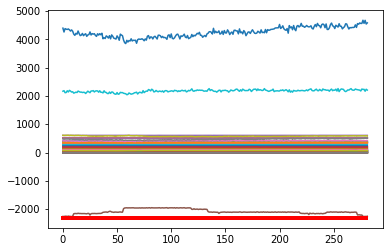

Predicción:  [[[0.9882825  0.01171754]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2889000e+01  1.1852800e+01  5.7707200e+01  7.6141600e+01
  6.1064320e+02  3.6196700e+01  1.0807300e+01  1.8997630e+02
  5.0000000e-04  6.7466500e+01  1.2769520e+02  1.0225100e+01
  6.7290700e+01  1.7899810e+02  2.1238600e+01  1.5998490e+02
  1.9026130e+02  6.9802200e+01 -4.0000000e-04  3.7871000e+00
  1.6962600e+01  7.3050000e+00  1.5005000e+00  7.2415200e+01
  1.4699000e+00  1.5410000e+00  9.1058600e+01  5.9799800e+01
  1.3312000e+00  1.2287000e+00  1.4832000e+00  1.3819000e+00
  1.5409890e+02  8.4320000e-01  8.5130000e-01 -2.2457227e+03
  2.0281650e+02  1.6317000e+00  1.3906000e+00  2.2391723e+03
  4.6375147e+03  1.8481450e+02  1.4186000e+00  1.4115000e+00
  7.8988000e+00  7.5025000e+00  1.7569000e+00  2.7350000e-01
  3.6697800e+01  5.3181450e+02  5.2377830e+02  5.1946920e+02
  5.2019670e+02  5.2021740e+02  3.0106100e+01  3.12

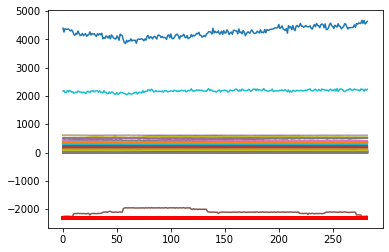

Predicción:  [[[0.9895906  0.01040946]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2492200e+01  1.1726500e+01  5.7637700e+01  7.4822300e+01
  6.0955720e+02  3.6151500e+01  1.0728700e+01  1.9006610e+02
  4.8000000e-03  6.7490100e+01  1.2764510e+02  9.7560000e+00
  6.6631300e+01  1.7864950e+02  2.1208800e+01  1.5998490e+02
  1.9012450e+02  7.0011800e+01 -4.0000000e-04  3.7337000e+00
  1.7142400e+01  7.2977000e+00  1.5005000e+00  7.2339800e+01
  1.4594000e+00  1.5294000e+00  9.0322900e+01  5.9092400e+01
  1.3195000e+00  1.2161000e+00  1.4721000e+00  1.3708000e+00
  1.5431720e+02  8.4360000e-01  8.5040000e-01 -2.2468015e+03
  2.0400560e+02  1.6190000e+00  1.3785000e+00  2.2174890e+03
  4.5974189e+03  1.8481450e+02  1.4076000e+00  1.3995000e+00
  7.9017000e+00  7.5008000e+00  1.7488000e+00  2.7680000e-01
  3.6922300e+01  5.3141160e+02  5.2355410e+02  5.1923730e+02
  5.2006570e+02  5.2003780e+02  2.9871100e+01  3.10

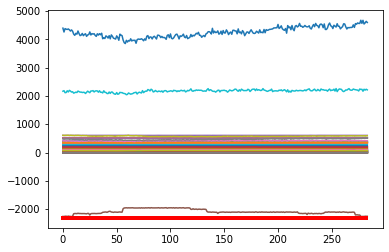

Predicción:  [[[0.988831   0.01116906]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2787500e+01  1.1742700e+01  5.7194400e+01  7.4871700e+01
  6.0973530e+02  3.5933300e+01  1.0745500e+01  1.8993800e+02
  1.3300000e-02  6.7396800e+01  1.2794770e+02  9.6031000e+00
  6.6490600e+01  1.7870240e+02  2.1329500e+01  1.6031160e+02
  1.9015830e+02  7.0063700e+01 -4.0000000e-04  3.6911000e+00
  1.7431100e+01  7.2729000e+00  1.4997000e+00  7.2366300e+01
  1.4705000e+00  1.5396000e+00  8.9980400e+01  5.9259800e+01
  1.3283000e+00  1.2267000e+00  1.4819000e+00  1.3823000e+00
  1.5468860e+02  8.4280000e-01  8.4990000e-01 -2.2488557e+03
  2.0400310e+02  1.6285000e+00  1.3878000e+00  2.2075004e+03
  4.5395967e+03  1.8481450e+02  1.4188000e+00  1.4103000e+00
  7.8982000e+00  7.4970000e+00  1.7603000e+00  2.7840000e-01
  3.6283800e+01  5.3191560e+02  5.2375420e+02  5.1956240e+02
  5.2040450e+02  5.2034090e+02  2.9582900e+01  3.08

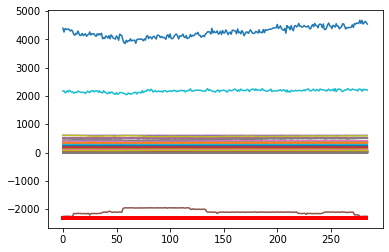

Predicción:  [[[0.9876068  0.01239314]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1833000e+01  1.1670500e+01  5.7061900e+01  7.4065900e+01
  6.1048490e+02  3.6291500e+01  1.0699400e+01  1.8997440e+02
  2.0500000e-02  6.7163800e+01  1.2806970e+02  9.8990000e+00
  6.6834500e+01  1.7933590e+02  2.0424600e+01  1.5965460e+02
  1.9024300e+02  6.9971000e+01 -4.0000000e-04  3.6863000e+00
  1.7470400e+01  7.3185000e+00  1.4984000e+00  7.2339000e+01
  1.4669000e+00  1.5327000e+00  8.9817100e+01  5.9128000e+01
  1.3260000e+00  1.2228000e+00  1.4764000e+00  1.3748000e+00
  1.5462630e+02  8.4440000e-01  8.4760000e-01 -2.2556824e+03
  2.0385650e+02  1.6223000e+00  1.3853000e+00  2.2024573e+03
  4.5984340e+03  1.8481450e+02  1.4114000e+00  1.4013000e+00
  7.9026000e+00  7.4883000e+00  1.7536000e+00  2.7700000e-01
  3.6923400e+01  5.3132980e+02  5.2352080e+02  5.1903960e+02
  5.1984690e+02  5.1985380e+02  3.0033600e+01  3.07

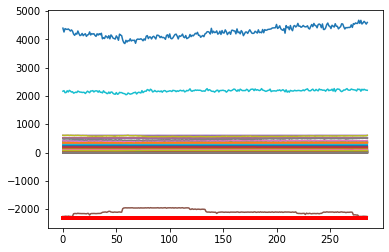

Predicción:  [[[0.98946613 0.01053382]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2525400e+01  1.1772000e+01  5.5805400e+01  7.4611300e+01
  6.1020280e+02  3.4743800e+01  1.0856100e+01  1.9003160e+02
  7.5000000e-03  6.7375400e+01  1.2771010e+02  1.0043900e+01
  6.6748400e+01  1.7799440e+02  2.0035500e+01  1.6009420e+02
  1.9047410e+02  6.9806900e+01 -4.0000000e-04  3.6995000e+00
  1.8576600e+01  7.2976000e+00  1.5010000e+00  7.2382400e+01
  1.4981000e+00  1.5620000e+00  8.9967300e+01  5.8610400e+01
  1.3575000e+00  1.2517000e+00  1.5075000e+00  1.4066000e+00
  1.5637200e+02  8.4620000e-01  8.5080000e-01 -2.2575295e+03
  2.0449840e+02  1.6522000e+00  1.4161000e+00  2.2138015e+03
  4.5334699e+03  1.8481450e+02  1.4423000e+00  1.4351000e+00
  7.8964000e+00  7.5054000e+00  1.7852000e+00  2.7780000e-01
  3.5841800e+01  5.3235240e+02  5.2389470e+02  5.1975640e+02
  5.2054730e+02  5.2046710e+02  2.9138600e+01  3.03

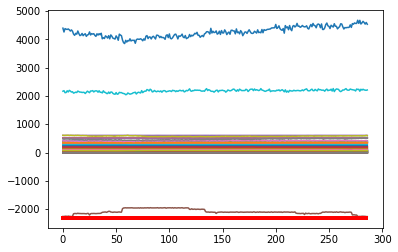

Predicción:  [[[0.9881125  0.01188746]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3297200e+01  1.1765700e+01  5.7348900e+01  7.8606100e+01
  6.1034580e+02  3.3642400e+01  1.0800500e+01  1.9004540e+02
  5.0000000e-04  6.8327300e+01  1.2763070e+02  9.9496000e+00
  6.6757000e+01  1.7046690e+02  2.0666000e+01  1.6016110e+02
  1.9008210e+02  7.0085000e+01 -4.0000000e-04  3.6825000e+00
  1.6052600e+01  7.3161000e+00  1.4984000e+00  7.2436500e+01
  1.4742000e+00  1.5385000e+00  8.9514700e+01  5.9412300e+01
  1.3338000e+00  1.2266000e+00  1.5006000e+00  1.3885000e+00
  1.6148050e+02  8.4370000e-01  8.5020000e-01 -2.2392090e+03
  2.0678620e+02  1.6284000e+00  1.3932000e+00  2.1270224e+03
  4.5236641e+03  1.8481450e+02  1.4237000e+00  1.4205000e+00
  7.9014000e+00  7.5024000e+00  1.7558000e+00  2.5500000e-01
  3.4937800e+01  5.3266670e+02  5.2500180e+02  5.2042510e+02
  5.2103880e+02  5.2117410e+02  2.8602400e+01  3.01

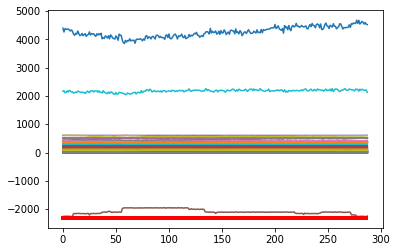

Predicción:  [[[0.9863587 0.0136413]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2419900e+01  1.1774800e+01  5.6700400e+01  7.6792600e+01
  6.1021170e+02  3.3920300e+01  1.0848300e+01  1.8995960e+02
  5.0000000e-04  6.8060300e+01  1.2813180e+02  9.8491000e+00
  6.6962200e+01  1.7343660e+02  2.0241600e+01  1.6002730e+02
  1.9036400e+02  7.0046400e+01 -4.0000000e-04  3.7140000e+00
  1.5636600e+01  7.2978000e+00  1.4972000e+00  7.2344700e+01
  1.4627000e+00  1.5257000e+00  8.9551200e+01  5.9454300e+01
  1.3214000e+00  1.2127000e+00  1.4880000e+00  1.3697000e+00
  1.6067410e+02  8.4520000e-01  8.5020000e-01 -2.2619372e+03
  2.0513500e+02  1.6145000e+00  1.3812000e+00  2.2055484e+03
  4.5688559e+03  1.8481450e+02  1.4064000e+00  1.3978000e+00
  7.8991000e+00  7.4999000e+00  1.7490000e+00  2.6090000e-01
  3.7184700e+01  5.3130110e+02  5.2380930e+02  5.1915840e+02
  5.1977990e+02  5.1994830e+02  2.8323300e+01  2.9874

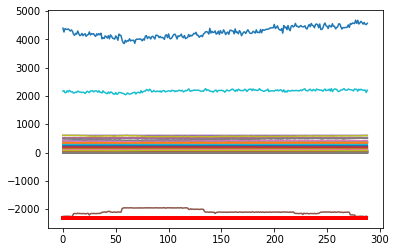

Predicción:  [[[0.9893856  0.01061434]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2241300e+01  1.1737000e+01  5.7032900e+01  7.6524100e+01
  6.0996300e+02  3.5176000e+01  1.0862700e+01  1.9002090e+02
  5.0000000e-04  6.7592600e+01  1.2799180e+02  9.7779000e+00
  6.6622200e+01  1.7765500e+02  2.0256800e+01  1.5963830e+02
  1.9038780e+02  7.0062400e+01 -4.0000000e-04  3.6814000e+00
  1.5899400e+01  7.3201000e+00  1.4993000e+00  7.2454900e+01
  1.4678000e+00  1.5329000e+00  8.9002500e+01  5.9195600e+01
  1.3274000e+00  1.2171000e+00  1.4798000e+00  1.3761000e+00
  1.5958930e+02  8.4350000e-01  8.5040000e-01 -2.2492285e+03
  2.0263200e+02  1.6227000e+00  1.3867000e+00  2.1614976e+03
  4.5421667e+03  1.8481450e+02  1.4116000e+00  1.4030000e+00
  7.8968000e+00  7.5002000e+00  1.7548000e+00  2.7520000e-01
  3.5665000e+01  5.3094650e+02  5.2328820e+02  5.1920710e+02
  5.1966860e+02  5.1996200e+02  2.8291400e+01  2.97

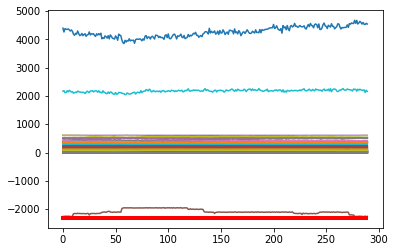

Predicción:  [[[0.98780113 0.01219887]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1415600e+01  1.1677700e+01  5.7599300e+01  7.7592100e+01
  6.0965350e+02  3.4332500e+01  1.0880800e+01  1.9003740e+02
  5.0000000e-04  6.7234600e+01  1.2776580e+02  1.0094000e+01
  6.6599900e+01  1.7633450e+02  2.0368700e+01  1.5988910e+02
  1.9042690e+02  7.0073500e+01 -4.0000000e-04  3.7750000e+00
  1.5573300e+01  7.3001000e+00  1.4979000e+00  7.2319700e+01
  1.4787000e+00  1.5447000e+00  9.0296500e+01  5.9973000e+01
  1.3350000e+00  1.2245000e+00  1.4956000e+00  1.3819000e+00
  1.6086210e+02  8.4380000e-01  8.4970000e-01 -2.2604359e+03
  2.0423930e+02  1.6354000e+00  1.3950000e+00  2.1721245e+03
  4.6209548e+03  1.8481450e+02  1.4187000e+00  1.4062000e+00
  7.9029000e+00  7.5008000e+00  1.7651000e+00  2.6940000e-01
  3.7093200e+01  5.3154300e+02  5.2400260e+02  5.1963420e+02
  5.1995600e+02  5.2036630e+02  2.7569300e+01  2.92

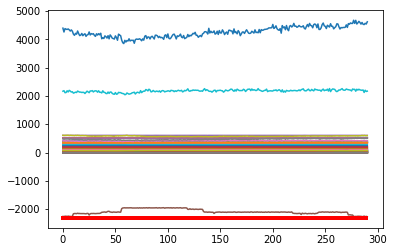

Predicción:  [[[0.990236   0.00976405]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2043700e+01  1.1466000e+01  5.9979400e+01  7.8807300e+01
  6.0910050e+02  3.4724000e+01  1.0811500e+01  1.8991740e+02
  5.0000000e-04  6.6179500e+01  1.2726860e+02  1.0062000e+01
  6.6833000e+01  1.7611210e+02  2.0616800e+01  1.5989380e+02
  1.9022100e+02  6.9987600e+01 -4.0000000e-04  3.8082000e+00
  1.5920200e+01  7.3119000e+00  1.4996000e+00  7.2405900e+01
  1.4851000e+00  1.5511000e+00  9.0619100e+01  6.0866700e+01
  1.3428000e+00  1.2293000e+00  1.5010000e+00  1.3912000e+00
  1.6155660e+02  8.4360000e-01  8.4990000e-01 -2.2450791e+03
  2.0310360e+02  1.6410000e+00  1.4033000e+00  2.1375980e+03
  4.6070999e+03  1.8481450e+02  1.4260000e+00  1.4157000e+00
  7.8995000e+00  7.5020000e+00  1.7723000e+00  2.7120000e-01
  3.4993100e+01  5.3261770e+02  5.2438620e+02  5.2035200e+02
  5.2067560e+02  5.2103690e+02  2.8032700e+01  2.94

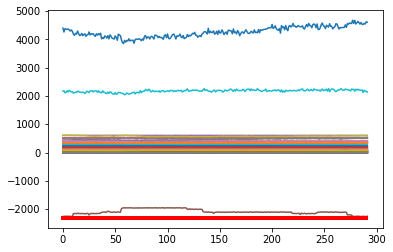

Predicción:  [[[0.9890114  0.01098854]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1551500e+01  1.1467200e+01  5.9852900e+01  7.7328700e+01
  6.1054880e+02  3.5842300e+01  1.0819200e+01  1.9006100e+02
  5.0000000e-04  6.5889600e+01  1.2739370e+02  9.9434000e+00
  6.7023400e+01  1.7839410e+02  2.0401700e+01  1.5992360e+02
  1.9022760e+02  7.0055200e+01 -4.0000000e-04  3.8074000e+00
  1.6920100e+01  7.3123000e+00  1.4979000e+00  7.2453600e+01
  1.4761000e+00  1.5427000e+00  9.0479700e+01  6.0725900e+01
  1.3338000e+00  1.2198000e+00  1.4797000e+00  1.3802000e+00
  1.6231280e+02  8.4400000e-01  8.5020000e-01 -2.2531070e+03
  2.0295970e+02  1.6338000e+00  1.3949000e+00  2.1698914e+03
  4.5588938e+03  1.8481450e+02  1.4160000e+00  1.4018000e+00
  7.8987000e+00  7.4991000e+00  1.7614000e+00  2.8180000e-01
  3.5954900e+01  5.3213340e+02  5.2409750e+02  5.1978020e+02
  5.2010590e+02  5.2053890e+02  2.7654900e+01  2.92

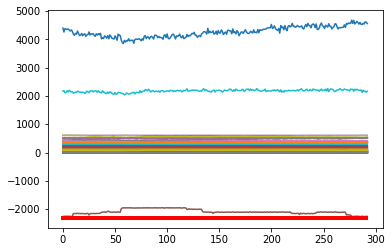

Predicción:  [[[0.9885366  0.01146336]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1527100e+01  1.1326100e+01  5.9825100e+01  7.8091800e+01
  6.1001250e+02  3.6132700e+01  1.0832500e+01  1.8997100e+02
  5.0000000e-04  6.5817200e+01  1.2713910e+02  1.0011200e+01
  6.6672700e+01  1.7769010e+02  2.0389300e+01  1.6002530e+02
  1.9005950e+02  7.0296700e+01 -4.0000000e-04  3.8071000e+00
  1.6137500e+01  7.3135000e+00  1.5002000e+00  7.2395800e+01
  1.4764000e+00  1.5439000e+00  9.1710800e+01  6.0798300e+01
  1.3331000e+00  1.2246000e+00  1.4823000e+00  1.3863000e+00
  1.6159440e+02  8.4290000e-01  8.5010000e-01 -2.2486163e+03
  2.0255170e+02  1.6348000e+00  1.3940000e+00  2.1863332e+03
  4.5984144e+03  1.8481450e+02  1.4228000e+00  1.4088000e+00
  7.9003000e+00  7.4973000e+00  1.7618000e+00  2.7990000e-01
  3.6635200e+01  5.3237500e+02  5.2396880e+02  5.1970320e+02
  5.2018930e+02  5.2057570e+02  2.7589900e+01  2.92

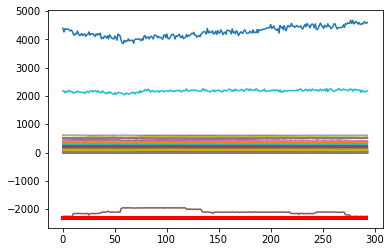

Predicción:  [[[0.9890988 0.0109012]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1268700e+01  1.1230600e+01  5.8142400e+01  7.7756500e+01
  6.0999110e+02  3.6190100e+01  1.0847300e+01  1.9005740e+02
  5.0000000e-04  6.6261600e+01  1.2781100e+02  9.8761000e+00
  6.6894900e+01  1.7804350e+02  2.0133700e+01  1.6015110e+02
  1.9017800e+02  7.0005100e+01 -4.0000000e-04  3.8047000e+00
  1.5359600e+01  7.2792000e+00  1.4994000e+00  7.2444400e+01
  1.4771000e+00  1.5446000e+00  9.0928100e+01  6.0579100e+01
  1.3345000e+00  1.2221000e+00  1.4841000e+00  1.3833000e+00
  1.6243510e+02  8.4320000e-01  8.5020000e-01 -2.2519934e+03
  2.0336410e+02  1.6368000e+00  1.3946000e+00  2.1941738e+03
  4.5959642e+03  1.8481450e+02  1.4197000e+00  1.4070000e+00
  7.9016000e+00  7.4991000e+00  1.7626000e+00  2.7860000e-01
  3.6659300e+01  5.3234890e+02  5.2404820e+02  5.1988690e+02
  5.2024960e+02  5.2068080e+02  2.6915700e+01  2.8676

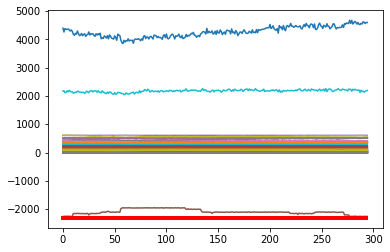

Predicción:  [[[0.9892792  0.01072078]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1270700e+01  1.1240000e+01  5.7109100e+01  7.7461600e+01
  6.0970260e+02  3.6255300e+01  1.0845700e+01  1.8992980e+02
  5.0000000e-04  6.6173700e+01  1.2784280e+02  1.0034100e+01
  6.6912700e+01  1.7908190e+02  2.0298700e+01  1.5957630e+02
  1.9016070e+02  7.0137600e+01 -4.0000000e-04  3.7961000e+00
  1.6032200e+01  7.3041000e+00  1.5004000e+00  7.2420100e+01
  1.4735000e+00  1.5425000e+00  9.1903300e+01  6.0157000e+01
  1.3293000e+00  1.2160000e+00  1.4719000e+00  1.3789000e+00
  1.6257150e+02  8.4320000e-01  8.5000000e-01 -2.2456787e+03
  2.0557470e+02  1.6342000e+00  1.3892000e+00  2.2206072e+03
  4.5048406e+03  1.8481450e+02  1.4150000e+00  1.4017000e+00
  7.9008000e+00  7.5005000e+00  1.7588000e+00  2.8640000e-01
  3.6009300e+01  5.3228450e+02  5.2397600e+02  5.1985900e+02
  5.2011260e+02  5.2054390e+02  2.6808800e+01  2.84

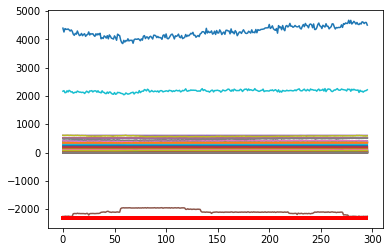

Predicción:  [[[0.98657787 0.01342211]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1620100e+01  1.1505800e+01  5.7203600e+01  7.7524400e+01
  6.1002240e+02  3.5556600e+01  1.0853400e+01  1.9003820e+02
  5.0000000e-04  6.6123000e+01  1.2762850e+02  1.0026000e+01
  6.6675200e+01  1.7898130e+02  2.0517100e+01  1.4959570e+02
  1.9036310e+02  7.0081500e+01 -4.0000000e-04  3.7929000e+00
  1.7001300e+01  7.2939000e+00  1.5013000e+00  7.2415600e+01
  1.4860000e+00  1.5527000e+00  9.2000300e+01  6.0149300e+01
  1.3438000e+00  1.2290000e+00  1.4802000e+00  1.3883000e+00
  1.6020520e+02  8.4400000e-01  8.5010000e-01 -2.2578593e+03
  2.0380230e+02  1.6456000e+00  1.4039000e+00  2.1803643e+03
  4.5713631e+03  1.8481450e+02  1.4231000e+00  1.4112000e+00
  7.9012000e+00  7.5005000e+00  1.7707000e+00  2.9030000e-01
  3.5076400e+01  5.3284890e+02  5.2418120e+02  5.2026910e+02
  5.2036850e+02  5.2088320e+02  2.6934700e+01  2.84

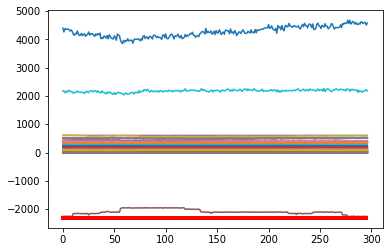

Predicción:  [[[0.98915124 0.01084875]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2022700e+01  1.1546300e+01  5.6515600e+01  7.9587900e+01
  6.1050880e+02  3.5034600e+01  1.0831800e+01  1.9001450e+02
  5.0000000e-04  6.6192900e+01  1.2820190e+02  9.8987000e+00
  6.6894500e+01  1.7751900e+02  2.0944800e+01  1.5833850e+02
  1.9016540e+02  7.0209900e+01 -4.0000000e-04  3.8022000e+00
  1.5527900e+01  7.3053000e+00  1.4983000e+00  7.2462400e+01
  1.4778000e+00  1.5434000e+00  9.0661400e+01  6.1873100e+01
  1.3363000e+00  1.2256000e+00  1.4783000e+00  1.3879000e+00
  1.6106350e+02  8.4530000e-01  8.5010000e-01 -2.2440540e+03
  2.0540720e+02  1.6345000e+00  1.3976000e+00  2.1687205e+03
  4.5475889e+03  1.8481450e+02  1.4214000e+00  1.4097000e+00
  7.8961000e+00  7.4994000e+00  1.7616000e+00  2.8320000e-01
  3.3410500e+01  5.3285110e+02  5.2468850e+02  5.2053800e+02
  5.2083180e+02  5.2120720e+02  2.7071600e+01  2.85

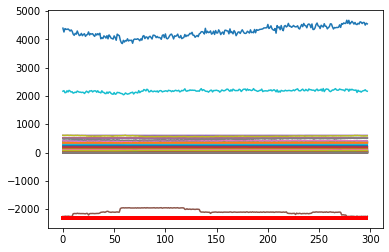

Predicción:  [[[0.9876003  0.01239962]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1844600e+01  1.1595300e+01  5.8842200e+01  7.8349500e+01
  6.0953710e+02  3.3956600e+01  1.0838800e+01  1.8998710e+02
  5.3000000e-03  6.6725100e+01  1.2777760e+02  9.8482000e+00
  6.6474500e+01  1.7532440e+02  2.0871300e+01  1.5575300e+02
  1.9012720e+02  7.0000700e+01 -4.0000000e-04  3.7912000e+00
  1.5345800e+01  7.3031000e+00  1.4993000e+00  7.2409500e+01
  1.4857000e+00  1.5494000e+00  9.0038500e+01  6.1442500e+01
  1.3413000e+00  1.2324000e+00  1.4988000e+00  1.3931000e+00
  1.6274470e+02  8.4690000e-01  8.4950000e-01 -2.2559563e+03
  2.0388990e+02  1.6392000e+00  1.4022000e+00  2.1838334e+03
  4.5322106e+03  1.8481450e+02  1.4256000e+00  1.4143000e+00
  7.8993000e+00  7.4974000e+00  1.7714000e+00  2.7260000e-01
  3.2982900e+01  5.3193330e+02  5.2410470e+02  5.1982910e+02
  5.2018980e+02  5.2058990e+02  2.7174100e+01  2.86

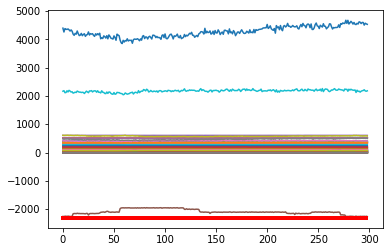

Predicción:  [[[0.98811716 0.01188277]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2205800e+01  1.1491000e+01  5.7114800e+01  7.9399400e+01
  6.1004260e+02  3.2785900e+01  1.0790600e+01  1.8999920e+02
  4.5400000e-02  6.7035700e+01  1.2784500e+02  9.8475000e+00
  6.6135000e+01  1.7241020e+02  2.1120500e+01  1.5613360e+02
  1.9009540e+02  7.0050800e+01 -4.0000000e-04  3.8133000e+00
  1.4839200e+01  7.3251000e+00  1.4989000e+00  7.2365100e+01
  1.4810000e+00  1.5422000e+00  8.9533200e+01  6.1108100e+01
  1.3372000e+00  1.2241000e+00  1.4987000e+00  1.3876000e+00
  1.6545090e+02  8.4590000e-01  8.4930000e-01 -2.2606130e+03
  2.0274840e+02  1.6319000e+00  1.3982000e+00  2.1793547e+03
  4.5790236e+03  1.8481450e+02  1.4213000e+00  1.4097000e+00
  7.8820000e+00  7.4979000e+00  1.7675000e+00  2.6900000e-01
  3.3688200e+01  5.3203330e+02  5.2397780e+02  5.1977170e+02
  5.2019780e+02  5.2054290e+02  2.7120900e+01  2.86

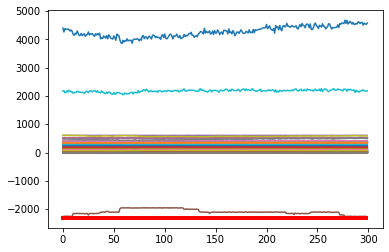

Predicción:  [[[0.98952943 0.01047063]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2090100e+01  1.1413900e+01  5.9549700e+01  7.8881500e+01
  6.0945680e+02  3.2446100e+01  1.0757300e+01  1.9005110e+02
  8.5600000e-02  6.7068500e+01  1.2734770e+02  1.0008200e+01
  6.7457000e+01  1.7271500e+02  2.1336800e+01  1.5701280e+02
  1.8997240e+02  7.0149900e+01 -4.0000000e-04  3.7425000e+00
  1.5087900e+01  7.2841000e+00  1.5005000e+00  7.2417500e+01
  1.4897000e+00  1.5551000e+00  8.9087600e+01  6.0144200e+01
  1.3464000e+00  1.2314000e+00  1.5077000e+00  1.3983000e+00
  1.6730980e+02  8.4560000e-01  8.4970000e-01 -2.2523058e+03
  2.0236740e+02  1.6452000e+00  1.4064000e+00  2.1711091e+03
  4.6190145e+03  1.8481450e+02  1.4321000e+00  1.4205000e+00
  7.8985000e+00  7.4994000e+00  1.7773000e+00  2.6970000e-01
  3.4042000e+01  5.3236670e+02  5.2436300e+02  5.2007900e+02
  5.2057600e+02  5.2085830e+02  2.6895500e+01  2.85

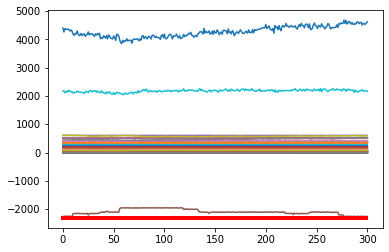

Predicción:  [[[0.9898274  0.01017257]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1999700e+01  1.1562500e+01  5.9187100e+01  7.9133300e+01
  6.1099620e+02  3.2445500e+01  1.0796400e+01  1.9002100e+02
  1.3570000e-01  6.6931500e+01  1.2801370e+02  9.9099000e+00
  6.6575000e+01  1.7312810e+02  2.1165300e+01  1.5755080e+02
  1.9011980e+02  7.0037600e+01 -4.0000000e-04  3.7018000e+00
  1.5124700e+01  7.3264000e+00  1.4989000e+00  7.2368500e+01
  1.4818000e+00  1.5497000e+00  8.9872600e+01  6.0672600e+01
  1.3384000e+00  1.2230000e+00  1.4976000e+00  1.3877000e+00
  1.6790510e+02  8.4610000e-01  8.4990000e-01 -2.2475827e+03
  2.0341330e+02  1.6393000e+00  1.3989000e+00  2.2111947e+03
  4.7612775e+03  1.8481450e+02  1.4208000e+00  1.4101000e+00
  7.9012000e+00  7.4989000e+00  1.7702000e+00  2.7260000e-01
  3.3622500e+01  5.3208440e+02  5.2426060e+02  5.1973980e+02
  5.2035820e+02  5.2057960e+02  2.6649900e+01  2.82

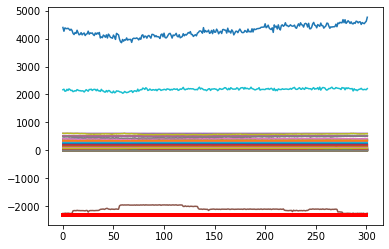

Predicción:  [[[0.9913551  0.00864493]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2305500e+01  1.1627300e+01  5.8661800e+01  7.8321700e+01
  6.0965460e+02  3.2488000e+01  1.0816100e+01  1.8993790e+02
  2.5290000e-01  6.6590200e+01  1.2762940e+02  9.9966000e+00
  6.6734400e+01  1.7434520e+02  2.0763600e+01  1.5721740e+02
  1.9029760e+02  6.9969600e+01 -4.0000000e-04  3.7085000e+00
  1.6115500e+01  7.2881000e+00  1.4987000e+00  7.2383600e+01
  1.4789000e+00  1.5433000e+00  9.0576300e+01  6.1648300e+01
  1.3341000e+00  1.2206000e+00  1.4864000e+00  1.3858000e+00
  1.6613610e+02  8.4640000e-01  8.5000000e-01 -2.2587989e+03
  2.0357290e+02  1.6347000e+00  1.3952000e+00  2.2060258e+03
  4.5880722e+03  1.8481450e+02  1.4187000e+00  1.4078000e+00
  7.8967000e+00  7.5023000e+00  1.7663000e+00  2.8030000e-01
  3.2998100e+01  5.3183110e+02  5.2358540e+02  5.1934530e+02
  5.1994670e+02  5.2023380e+02  2.6612700e+01  2.80

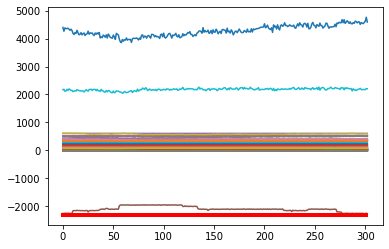

Predicción:  [[[0.9895784  0.01042157]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2439700e+01  1.1758800e+01  5.8535800e+01  7.8448600e+01
  6.0943840e+02  3.2755300e+01  1.0865000e+01  1.9010030e+02
  4.5120000e-01  6.6444300e+01  1.2774400e+02  1.0109400e+01
  6.6829800e+01  1.7360280e+02  2.0937800e+01  1.5680470e+02
  1.9043370e+02  7.0219300e+01 -4.0000000e-04  3.7039000e+00
  1.5312800e+01  7.3163000e+00  1.5015000e+00  7.2397900e+01
  1.4804000e+00  1.5475000e+00  8.9997500e+01  6.1322300e+01
  1.3359000e+00  1.2244000e+00  1.4923000e+00  1.3899000e+00
  1.6627680e+02  8.4710000e-01  8.5030000e-01 -2.2472297e+03
  2.0559970e+02  1.6385000e+00  1.3971000e+00  2.1238638e+03
  4.6286234e+03  1.8481450e+02  1.4209000e+00  1.4120000e+00
  7.8999000e+00  7.5039000e+00  1.7677000e+00  2.7540000e-01
  3.0955200e+01  5.3248330e+02  5.2404180e+02  5.1967670e+02
  5.2061630e+02  5.2078210e+02  2.6694800e+01  2.81

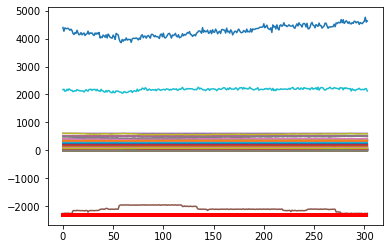

Predicción:  [[[0.9896115  0.01038857]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2597200e+01  1.1777800e+01  5.8887400e+01  7.9046800e+01
  6.1019230e+02  3.2732100e+01  1.0824500e+01  1.8990020e+02
  9.8560000e-01  6.6533700e+01  1.2739550e+02  1.0051400e+01
  6.6894700e+01  1.7373900e+02  2.1383100e+01  1.5677430e+02
  1.9045560e+02  7.0159200e+01 -4.0000000e-04  3.7053000e+00
  1.5615700e+01  7.2731000e+00  1.4990000e+00  7.2388400e+01
  1.4811000e+00  1.5457000e+00  9.1106200e+01  6.0952900e+01
  1.3380000e+00  1.2229000e+00  1.4899000e+00  1.3913000e+00
  1.6757280e+02  8.4790000e-01  8.4990000e-01 -2.2522205e+03
  2.0364670e+02  1.6361000e+00  1.3988000e+00  2.1797224e+03
  4.5609873e+03  1.8481450e+02  1.4221000e+00  1.4133000e+00
  7.9031000e+00  7.4947000e+00  1.7669000e+00  2.7660000e-01
  3.0741700e+01  5.3220000e+02  5.2412580e+02  5.1961720e+02
  5.2045680e+02  5.2077000e+02  2.6896300e+01  2.83

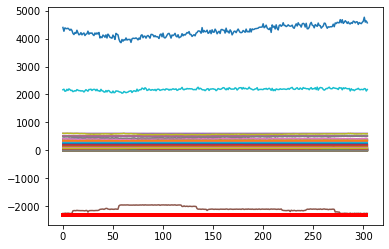

Predicción:  [[[0.98856527 0.01143471]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3077600e+01  1.1803100e+01  5.8633200e+01  7.8006600e+01
  6.1065730e+02  3.3227900e+01  1.0820800e+01  1.9002490e+02
  1.5168000e+00  6.6248100e+01  1.2733680e+02  9.9721000e+00
  6.6728500e+01  1.7312200e+02  2.1316200e+01  1.5669930e+02
  1.9043650e+02  6.9816800e+01 -4.0000000e-04  3.6806000e+00
  1.5939800e+01  7.3071000e+00  1.5000000e+00  7.2365800e+01
  1.4792000e+00  1.5443000e+00  9.0054100e+01  6.0108700e+01
  1.3358000e+00  1.2227000e+00  1.4892000e+00  1.3881000e+00
  1.6704860e+02  8.4780000e-01  8.4970000e-01 -2.2506103e+03
  2.0264530e+02  1.6339000e+00  1.3960000e+00  2.1700772e+03
  4.5994294e+03  1.8481450e+02  1.4194000e+00  1.4108000e+00
  7.8998000e+00  7.5037000e+00  1.7666000e+00  2.7730000e-01
  3.1150800e+01  5.3200940e+02  5.2373750e+02  5.1928060e+02
  5.2015690e+02  5.2039050e+02  2.7270400e+01  2.85

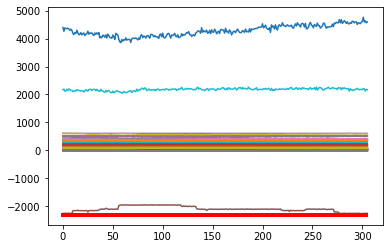

Predicción:  [[[0.98927397 0.01072607]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3189100e+01  1.1811000e+01  5.6862900e+01  7.7565000e+01
  6.0940200e+02  3.3347400e+01  1.0903200e+01  1.9000760e+02
  1.5219000e+00  6.6059200e+01  1.2796430e+02  1.0039000e+01
  6.6652300e+01  1.7385130e+02  2.0724100e+01  1.5637630e+02
  1.9072160e+02  6.9963600e+01 -4.0000000e-04  3.6924000e+00
  1.6439000e+01  7.3331000e+00  1.5013000e+00  7.2420400e+01
  1.4691000e+00  1.5336000e+00  9.0193000e+01  5.9710200e+01
  1.3275000e+00  1.2144000e+00  1.4749000e+00  1.3790000e+00
  1.6507150e+02  8.4790000e-01  8.4990000e-01 -2.2539778e+03
  2.0217120e+02  1.6234000e+00  1.3872000e+00  2.2069649e+03
  4.5446500e+03  1.8481450e+02  1.4104000e+00  1.4018000e+00
  7.8972000e+00  7.4984000e+00  1.7567000e+00  2.8170000e-01
  3.1206700e+01  5.3165000e+02  5.2350810e+02  5.1892020e+02
  5.1974810e+02  5.2007620e+02  2.7176200e+01  2.86

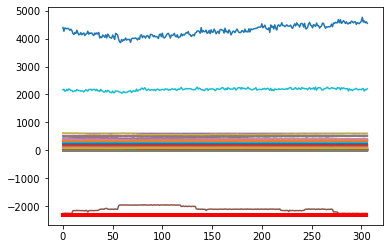

Predicción:  [[[0.9882597  0.01174028]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3126600e+01  1.1893300e+01  5.6646000e+01  7.7275600e+01
  6.0991690e+02  3.3358700e+01  1.0914300e+01  1.8989960e+02
  1.7864000e+00  6.6069700e+01  1.2808650e+02  1.0152500e+01
  6.6587800e+01  1.7363150e+02  2.0967000e+01  1.5623460e+02
  1.9092620e+02  6.9955000e+01 -4.0000000e-04  3.7627000e+00
  1.6486400e+01  7.2853000e+00  1.4997000e+00  7.2409600e+01
  1.4713000e+00  1.5384000e+00  9.0705800e+01  5.9926500e+01
  1.3279000e+00  1.2179000e+00  1.4777000e+00  1.3825000e+00
  1.6525640e+02  8.4800000e-01  8.5000000e-01 -2.2509963e+03
  2.0361780e+02  1.6296000e+00  1.3878000e+00  2.2363857e+03
  4.6640139e+03  1.8481450e+02  1.4129000e+00  1.4042000e+00
  7.9023000e+00  7.4991000e+00  1.7602000e+00  2.8210000e-01
  3.0399900e+01  5.3141770e+02  5.2310510e+02  5.1881470e+02
  5.1958140e+02  5.1983100e+02  2.7541300e+01  2.88

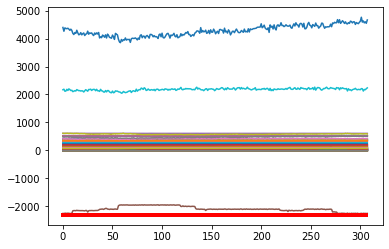

Predicción:  [[[0.99036574 0.00963429]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3396100e+01  1.1860100e+01  5.6720400e+01  7.6919300e+01
  6.1008920e+02  3.3827400e+01  1.1009500e+01  1.9009000e+02
  1.3263000e+00  6.6152200e+01  1.2760120e+02  1.0005400e+01
  6.6758000e+01  1.7299700e+02  2.1622700e+01  1.5628300e+02
  1.9105940e+02  7.0255200e+01 -4.0000000e-04  3.9112000e+00
  1.4900100e+01  7.3299000e+00  1.5009000e+00  7.3037000e+01
  1.4879000e+00  1.5532000e+00  9.0516000e+01  6.0249500e+01
  1.3571000e+00  1.2308000e+00  1.4986000e+00  1.3978000e+00
  1.6845110e+02  8.4870000e-01  8.5070000e-01 -2.1618681e+03
  2.0549250e+02  1.6435000e+00  1.4172000e+00  2.1837189e+03
  4.4350509e+03  1.8481450e+02  1.4290000e+00  1.4197000e+00
  7.9005000e+00  7.4994000e+00  1.7746000e+00  2.7570000e-01
  3.1501900e+01  5.3204890e+02  5.2425660e+02  5.2012620e+02
  5.2073020e+02  5.2094610e+02  2.7791000e+01  2.91

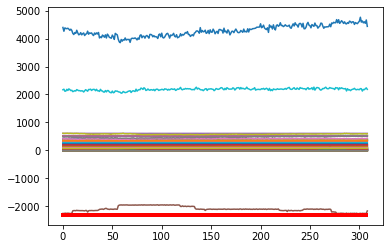

Predicción:  [[[0.97252685 0.02747311]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3570100e+01  1.1844000e+01  5.8761000e+01  7.6691500e+01
  6.1013150e+02  3.4037600e+01  1.0566300e+01  1.9004070e+02
  1.6105000e+00  6.6330300e+01  1.2731230e+02  1.0306500e+01
  6.6841300e+01  1.7427510e+02  2.1744200e+01  1.5654470e+02
  1.9080330e+02  7.0394600e+01 -4.0000000e-04  3.8990000e+00
  1.4973200e+01  7.3078000e+00  1.4987000e+00  7.2994100e+01
  1.4923000e+00  1.5608000e+00  9.0146600e+01  5.9997900e+01
  1.3596000e+00  1.2363000e+00  1.4992000e+00  1.4042000e+00
  1.6843930e+02  8.4790000e-01  8.4950000e-01 -2.1484202e+03
  2.0773500e+02  1.6516000e+00  1.4199000e+00  2.1851756e+03
  4.7076007e+03  1.8481450e+02  1.4365000e+00  1.4269000e+00
  7.8990000e+00  7.5047000e+00  1.7827000e+00  2.8360000e-01
  3.2208300e+01  5.3324890e+02  5.2504080e+02  5.2071180e+02
  5.2136200e+02  5.2134290e+02  2.7885300e+01  2.92

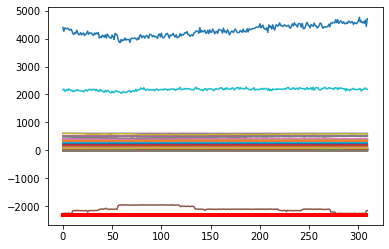

Predicción:  [[[0.98277354 0.01722645]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3243000e+01  1.1865600e+01  5.6894300e+01  7.7548600e+01
  6.0960660e+02  3.3695100e+01  1.0389500e+01  1.9008820e+02
  2.1852000e+00  6.5743900e+01  1.2772570e+02  9.9246000e+00
  6.7061300e+01  1.7342010e+02  2.1185600e+01  1.5718490e+02
  1.9050720e+02  7.0449900e+01 -4.0000000e-04  3.8995000e+00
  1.4857400e+01  7.3005000e+00  1.4981000e+00  7.3008900e+01
  1.4797000e+00  1.5458000e+00  8.9752600e+01  5.9828000e+01
  1.3443000e+00  1.2264000e+00  1.4856000e+00  1.3920000e+00
  1.6575140e+02  8.4820000e-01  8.5030000e-01 -2.1465993e+03
  2.0371340e+02  1.6352000e+00  1.4046000e+00  2.2043593e+03
  4.8511258e+03  1.8481450e+02  1.4234000e+00  1.4133000e+00
  7.8988000e+00  7.4997000e+00  1.7715000e+00  2.8620000e-01
  3.1565700e+01  5.3258660e+02  5.2418740e+02  5.1995470e+02
  5.2049390e+02  5.2037400e+02  2.7972500e+01  2.92

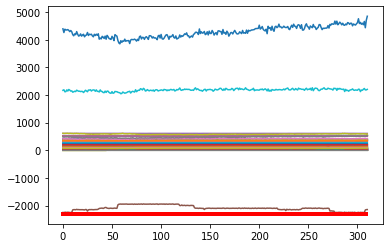

Predicción:  [[[0.9870964  0.01290356]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3341900e+01  1.1886100e+01  5.6655500e+01  7.6062700e+01
  6.0930020e+02  3.4206200e+01  1.0139500e+01  1.9007010e+02
  2.2679000e+00  6.5000600e+01  1.2807190e+02  9.9410000e+00
  6.7469200e+01  1.7424400e+02  2.1373100e+01  1.5723370e+02
  1.9065110e+02  7.1018000e+01 -4.0000000e-04  3.9061000e+00
  1.6595000e+01  7.3154000e+00  1.4994000e+00  7.3293800e+01
  1.4709000e+00  1.5356000e+00  8.8059500e+01  6.0675100e+01
  1.3379000e+00  1.2206000e+00  1.4690000e+00  1.3831000e+00
  1.6322340e+02  8.5000000e-01  8.5160000e-01 -2.1149191e+03
  2.0604760e+02  1.6238000e+00  1.3988000e+00  2.2093302e+03
  4.8117571e+03  1.8481450e+02  1.4142000e+00  1.4041000e+00
  7.8983000e+00  7.4961000e+00  1.7617000e+00  2.9260000e-01
  3.1139400e+01  5.3368280e+02  5.2330250e+02  5.1938630e+02
  5.2007000e+02  5.2012880e+02  2.9484400e+01  2.94

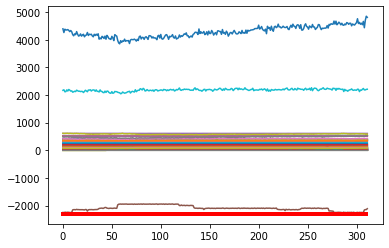

Predicción:  [[[0.9826286 0.0173714]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3566500e+01  1.1963600e+01  5.5393800e+01  7.5106800e+01
  6.0975690e+02  3.4348500e+01  9.9674000e+00  1.8999360e+02
  1.6325000e+00  6.5308900e+01  1.2857570e+02  1.0053600e+01
  6.7051600e+01  1.7203620e+02  2.0487600e+01  1.5711910e+02
  1.9072930e+02  7.1007900e+01 -4.0000000e-04  3.9087000e+00
  1.5052200e+01  7.2983000e+00  1.5003000e+00  7.3326000e+01
  1.4621000e+00  1.5256000e+00  8.8864200e+01  6.0524500e+01
  1.3324000e+00  1.2110000e+00  1.4713000e+00  1.3831000e+00
  1.6479090e+02  8.4560000e-01  8.4770000e-01 -2.0987505e+03
  2.0989820e+02  1.6134000e+00  1.3926000e+00  2.2506970e+03
  4.9604956e+03  1.8481450e+02  1.4154000e+00  1.4048000e+00
  7.8995000e+00  7.5027000e+00  1.7522000e+00  2.8070000e-01
  3.1750400e+01  5.3661780e+02  5.2428000e+02  5.1984470e+02
  5.2057660e+02  5.2070470e+02  2.8116700e+01  2.9589

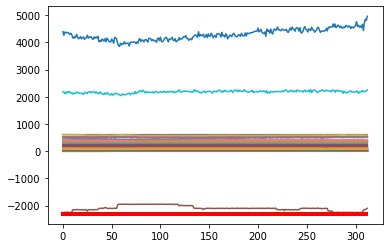

Predicción:  [[[0.9856645  0.01433548]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3625600e+01  1.1989400e+01  5.6162400e+01  7.7071800e+01
  6.1116460e+02  3.4082300e+01  9.9594000e+00  1.8999110e+02
  1.6090000e-01  6.5222100e+01  1.2773310e+02  1.0126700e+01
  6.6909200e+01  1.7286270e+02  2.1430800e+01  1.5725700e+02
  1.9060100e+02  7.0836800e+01 -4.0000000e-04  3.8936000e+00
  1.5124600e+01  7.2805000e+00  1.5008000e+00  7.3373200e+01
  1.4733000e+00  1.5385000e+00  8.9060200e+01  6.0754300e+01
  1.3394000e+00  1.2203000e+00  1.4795000e+00  1.3889000e+00
  1.6623870e+02  8.4910000e-01  8.5010000e-01 -2.1117077e+03
  2.0832170e+02  1.6270000e+00  1.4001000e+00  2.2317638e+03
  4.9453867e+03  1.8481450e+02  1.4211000e+00  1.4113000e+00
  7.9029000e+00  7.5024000e+00  1.7657000e+00  2.8650000e-01
  3.1820400e+01  5.3744660e+02  5.2423660e+02  5.2009940e+02
  5.2077740e+02  5.2099570e+02  2.8493200e+01  2.90

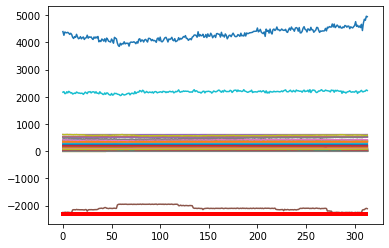

Predicción:  [[[0.9865385  0.01346147]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3625100e+01  1.1968800e+01  5.7074600e+01  7.8161700e+01
  6.1000520e+02  3.4080200e+01  9.9382000e+00  1.8992380e+02
  4.9400000e-02  6.5812200e+01  1.2791520e+02  1.0119500e+01
  6.7001200e+01  1.7201690e+02  2.1975600e+01  1.5648180e+02
  1.9047030e+02  7.0825900e+01 -4.0000000e-04  3.7944000e+00
  1.3827300e+01  7.2933000e+00  1.4980000e+00  7.3335200e+01
  1.4729000e+00  1.5379000e+00  8.8155200e+01  6.0874400e+01
  1.3317000e+00  1.2206000e+00  1.4849000e+00  1.3870000e+00
  1.6635590e+02  8.4740000e-01  8.4850000e-01 -2.2009454e+03
  2.0625400e+02  1.6265000e+00  1.3919000e+00  2.2289666e+03
  4.9638356e+03  1.8481450e+02  1.4180000e+00  1.4089000e+00
  7.8975000e+00  7.5001000e+00  1.7660000e+00  2.8060000e-01
  3.1145900e+01  5.3776060e+02  5.2429400e+02  5.2013330e+02
  5.2092170e+02  5.2106190e+02  2.9308500e+01  2.91

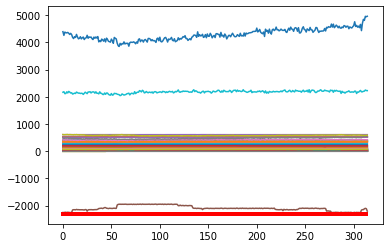

Predicción:  [[[0.9919069  0.00809319]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3595300e+01  1.1866700e+01  5.6509900e+01  7.7207300e+01
  6.1124570e+02  3.2865300e+01  9.9474000e+00  1.8996510e+02
  9.4000000e-03  6.5579500e+01  1.2834720e+02  9.8793000e+00
  6.6202800e+01  1.7311490e+02  2.1206800e+01  1.5527780e+02
  1.9041810e+02  7.0983600e+01 -4.0000000e-04  3.8616000e+00
  1.5923400e+01  7.3093000e+00  1.5005000e+00  7.3257900e+01
  1.4593000e+00  1.5230000e+00  8.6887900e+01  6.0949300e+01
  1.3178000e+00  1.2055000e+00  1.4604000e+00  1.3691000e+00
  1.6521440e+02  8.4800000e-01  8.4980000e-01 -2.2004757e+03
  2.0900110e+02  1.6108000e+00  1.3791000e+00  2.1869405e+03
  5.0076851e+03  1.8481450e+02  1.3995000e+00  1.3910000e+00
  7.9014000e+00  7.5029000e+00  1.7536000e+00  2.9320000e-01
  3.0415300e+01  5.3611520e+02  5.2335990e+02  5.1897980e+02
  5.1965090e+02  5.1989030e+02  2.8472900e+01  2.96

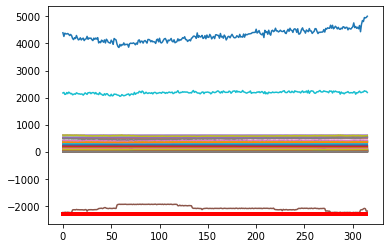

Predicción:  [[[0.9922375 0.0077625]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3649400e+01  1.1879600e+01  5.8235800e+01  7.7040800e+01
  6.0956830e+02  3.3216600e+01  9.9813000e+00  1.8998340e+02
  1.4000000e-02  6.5501500e+01  1.2804440e+02  1.0066300e+01
  6.7055100e+01  1.7329510e+02  2.1261700e+01  1.5283990e+02
  1.9074620e+02  7.0994800e+01 -4.0000000e-04  3.8852000e+00
  1.6059800e+01  7.2893000e+00  1.4993000e+00  7.3293200e+01
  1.4669000e+00  1.5345000e+00  8.9024900e+01  6.1083100e+01
  1.3247000e+00  1.2156000e+00  1.4641000e+00  1.3835000e+00
  1.6510170e+02  8.4880000e-01  8.4990000e-01 -2.1987924e+03
  2.1127080e+02  1.6233000e+00  1.3856000e+00  2.2259881e+03
  5.0827775e+03  1.8481450e+02  1.4125000e+00  1.4042000e+00
  7.9015000e+00  7.5020000e+00  1.7609000e+00  2.9710000e-01
  2.9023300e+01  5.3606100e+02  5.2300850e+02  5.1905760e+02
  5.1969500e+02  5.1996050e+02  2.8905000e+01  3.0047

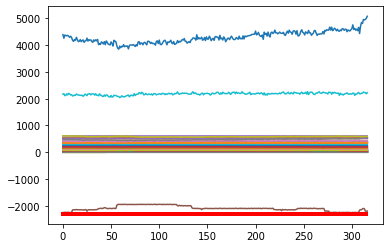

Predicción:  [[[0.9927532  0.00724673]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3699500e+01  1.1861900e+01  5.8594500e+01  7.8272900e+01
  6.0972960e+02  3.4272300e+01  9.9308000e+00  1.9003120e+02
  3.4400000e-02  6.5560000e+01  1.2761170e+02  1.0202600e+01
  6.6609300e+01  1.7237000e+02  2.1405600e+01  1.4787540e+02
  1.9077800e+02  7.0962100e+01 -4.0000000e-04  3.9105000e+00
  1.4075200e+01  7.2869000e+00  1.4986000e+00  7.3259700e+01
  1.4721000e+00  1.5369000e+00  8.8382100e+01  6.1218200e+01
  1.3299000e+00  1.2203000e+00  1.4749000e+00  1.3873000e+00
  1.6614960e+02  8.4900000e-01  8.5010000e-01 -2.1940019e+03
  2.0693980e+02  1.6249000e+00  1.3911000e+00  2.1686161e+03
  4.9749774e+03  1.8481450e+02  1.4174000e+00  1.4089000e+00
  7.9020000e+00  7.4980000e+00  1.7643000e+00  2.8970000e-01
  2.9732400e+01  5.3720940e+02  5.2428240e+02  5.2015300e+02
  5.2088130e+02  5.2111350e+02  2.8896500e+01  3.02

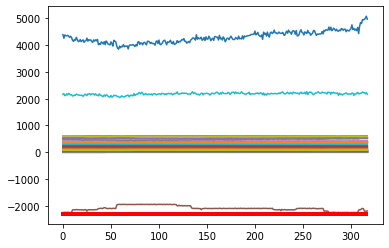

Predicción:  [[[0.99175465 0.00824529]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3487200e+01  1.1863200e+01  5.7970600e+01  7.6808200e+01
  6.0966450e+02  3.4059600e+01  9.9127000e+00  1.9002640e+02
  4.0500000e-02  6.5045500e+01  1.2845240e+02  9.8431000e+00
  6.5820900e+01  1.7383340e+02  2.1680900e+01  1.4380210e+02
  1.9059370e+02  7.0994800e+01 -4.0000000e-04  3.9092000e+00
  1.5898300e+01  7.3079000e+00  1.5015000e+00  7.3294100e+01
  1.4670000e+00  1.5350000e+00  8.8123100e+01  6.0615100e+01
  1.3247000e+00  1.2155000e+00  1.4627000e+00  1.3811000e+00
  1.6514590e+02  8.4880000e-01  8.5010000e-01 -2.1960545e+03
  2.0769490e+02  1.6229000e+00  1.3857000e+00  2.1587948e+03
  5.0741547e+03  1.8481450e+02  1.4107000e+00  1.4022000e+00
  7.8994000e+00  7.5025000e+00  1.7620000e+00  2.9930000e-01
  2.9655200e+01  5.3617610e+02  5.2403940e+02  5.1935720e+02
  5.2022040e+02  5.2040450e+02  2.8973900e+01  3.03

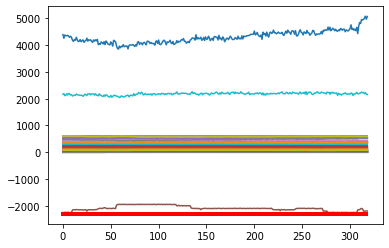

Predicción:  [[[0.99259996 0.00740005]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3413600e+01  1.1921300e+01  5.8712200e+01  7.6539000e+01
  6.0957640e+02  3.4177400e+01  9.8919000e+00  1.8997740e+02
  6.9900000e-02  6.4932400e+01  1.2723320e+02  9.9710000e+00
  6.5876800e+01  1.7202160e+02  2.1485000e+01  1.4395660e+02
  1.9043530e+02  7.1550400e+01 -4.0000000e-04  3.9059000e+00
  1.4887800e+01  7.2733000e+00  1.4988000e+00  7.3333000e+01
  1.4662000e+00  1.5373000e+00  8.8337500e+01  6.0304400e+01
  1.3260000e+00  1.2167000e+00  1.4662000e+00  1.3901000e+00
  1.6510100e+02  8.4810000e-01  8.5170000e-01 -2.1569465e+03
  2.0650690e+02  1.6246000e+00  1.3864000e+00  2.1377271e+03
  5.0520523e+03  1.8481450e+02  1.4199000e+00  1.4107000e+00
  7.9100000e+00  7.5021000e+00  1.7605000e+00  2.9440000e-01
  2.8842900e+01  5.3561520e+02  5.2340560e+02  5.1856160e+02
  5.1935740e+02  5.1963790e+02  2.8911900e+01  3.02

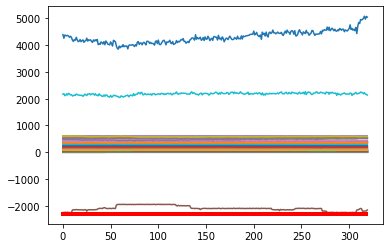

Predicción:  [[[0.99130017 0.0086998 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3351400e+01  1.1883100e+01  5.7636800e+01  7.6753400e+01
  6.0996180e+02  3.4132600e+01  9.8496000e+00  1.9009860e+02
  7.1800000e-02  6.4904400e+01  1.2734900e+02  1.1500700e+01
  6.6296300e+01  1.7298360e+02  2.1644300e+01  1.4389470e+02
  1.9059110e+02  7.1751600e+01 -4.0000000e-04  3.9013000e+00
  1.5862200e+01  7.2156000e+00  1.4984000e+00  7.3511100e+01
  1.4548000e+00  1.5236000e+00  8.4683900e+01  6.0828900e+01
  1.3133000e+00  1.2055000e+00  1.4522000e+00  1.3743000e+00
  1.6479840e+02  8.4780000e-01  8.5300000e-01 -2.1640177e+03
  2.0157620e+02  1.6101000e+00  1.3738000e+00  2.0521742e+03
  4.8834116e+03  1.8481450e+02  1.4045000e+00  1.3964000e+00
  7.9147000e+00  7.5040000e+00  1.7508000e+00  2.9860000e-01
  2.8959900e+01  5.3685700e+02  5.2341090e+02  5.1845420e+02
  5.1921310e+02  5.1956830e+02  2.8918700e+01  3.02

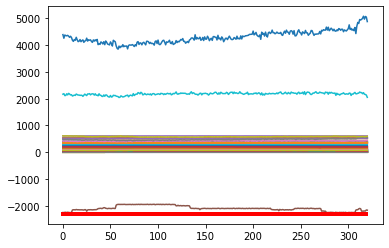

Predicción:  [[[0.98934144 0.0106586 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3579500e+01  1.1762800e+01  5.8728400e+01  7.5759500e+01
  6.1052420e+02  3.4574500e+01  9.9452000e+00  1.8991830e+02
  5.9200000e-02  6.4922000e+01  1.2835830e+02  9.9963000e+00
  6.7178300e+01  1.7360740e+02  2.2021000e+01  1.4104790e+02
  1.9069180e+02  7.0783400e+01 -4.0000000e-04  3.9058000e+00
  1.5530000e+01  7.3112000e+00  1.5000000e+00  7.3325700e+01
  1.4744000e+00  1.5404000e+00  8.6911300e+01  6.0073400e+01
  1.3338000e+00  1.2252000e+00  1.4675000e+00  1.3886000e+00
  1.6472960e+02  8.4890000e-01  8.5020000e-01 -2.2042253e+03
  2.0724840e+02  1.6277000e+00  1.3940000e+00  2.1948416e+03
  4.9500598e+03  1.8481450e+02  1.4174000e+00  1.4127000e+00
  7.8958000e+00  7.4984000e+00  1.7665000e+00  2.9910000e-01
  2.8844800e+01  5.3771500e+02  5.2368230e+02  5.1936100e+02
  5.2023880e+02  5.2046110e+02  2.8997300e+01  3.02

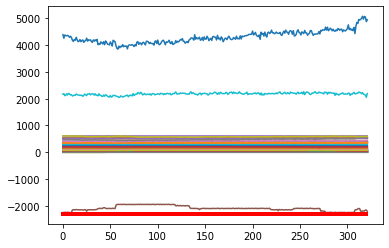

Predicción:  [[[0.99180675 0.00819328]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3411300e+01  1.1743800e+01  5.8338300e+01  7.6903200e+01
  6.1030330e+02  3.4478600e+01  9.9443000e+00  1.9001200e+02
  3.3600000e-02  6.4979200e+01  1.2782530e+02  9.8087000e+00
  6.6623500e+01  1.7303220e+02  2.2127600e+01  1.4090210e+02
  1.9069340e+02  7.0875900e+01 -4.0000000e-04  3.8982000e+00
  1.4538400e+01  7.3000000e+00  1.5004000e+00  7.3310000e+01
  1.4673000e+00  1.5334000e+00  8.8506200e+01  6.0117700e+01
  1.3272000e+00  1.2165000e+00  1.4654000e+00  1.3832000e+00
  1.6492490e+02  8.4890000e-01  8.4930000e-01 -2.1989029e+03
  2.0548650e+02  1.6204000e+00  1.3873000e+00  2.2306996e+03
  4.9968972e+03  1.8481450e+02  1.4129000e+00  1.4079000e+00
  7.9027000e+00  7.5018000e+00  1.7600000e+00  2.9480000e-01
  2.9602800e+01  5.3809060e+02  5.2386350e+02  5.1965770e+02
  5.2042060e+02  5.2067630e+02  2.8986900e+01  3.03

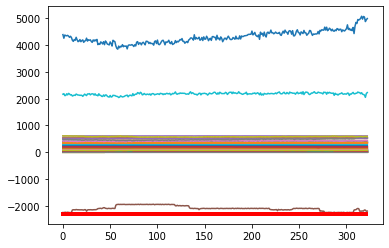

Predicción:  [[[0.9920997  0.00790029]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3475600e+01  1.1765500e+01  5.7535200e+01  7.5903000e+01
  6.1043180e+02  3.4128000e+01  9.9268000e+00  1.9012970e+02
  7.9800000e-02  6.4642500e+01  1.2831250e+02  9.9604000e+00
  6.6704800e+01  1.7488320e+02  2.2395300e+01  1.4220700e+02
  1.9066580e+02  7.0844000e+01 -4.0000000e-04  3.8936000e+00
  1.6502800e+01  7.2957000e+00  1.4996000e+00  7.3361600e+01
  1.4674000e+00  1.5332000e+00  8.7889100e+01  6.0353100e+01
  1.3276000e+00  1.2169000e+00  1.4540000e+00  1.3853000e+00
  1.6501010e+02  8.4840000e-01  8.4980000e-01 -2.1929026e+03
  2.0737450e+02  1.6213000e+00  1.3876000e+00  2.2445955e+03
  5.0427993e+03  1.8481450e+02  1.4150000e+00  1.4093000e+00
  7.8975000e+00  7.4957000e+00  1.7611000e+00  3.0710000e-01
  2.9186700e+01  5.3791990e+02  5.2379180e+02  5.1970280e+02
  5.2035370e+02  5.2063150e+02  2.9074300e+01  3.02

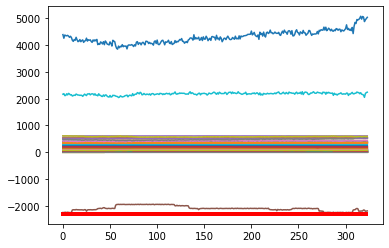

Predicción:  [[[0.9923218  0.00767825]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3414400e+01  1.1766400e+01  5.8364200e+01  7.5679500e+01
  6.1011940e+02  3.4267300e+01  9.9035000e+00  1.9001120e+02
  7.8700000e-02  6.5031300e+01  1.2797190e+02  1.0081000e+01
  6.6788700e+01  1.7334500e+02  2.2473700e+01  1.4189680e+02
  1.9058280e+02  7.0731700e+01 -4.0000000e-04  3.8865000e+00
  1.5281000e+01  7.2789000e+00  1.5001000e+00  7.3293300e+01
  1.4743000e+00  1.5392000e+00  8.7676200e+01  5.9725600e+01
  1.3337000e+00  1.2246000e+00  1.4676000e+00  1.3910000e+00
  1.6540640e+02  8.4870000e-01  8.5000000e-01 -2.1966440e+03
  2.0503330e+02  1.6268000e+00  1.3931000e+00  2.2226666e+03
  5.0891681e+03  1.8481450e+02  1.4204000e+00  1.4142000e+00
  7.9019000e+00  7.5013000e+00  1.7661000e+00  2.9850000e-01
  2.9362800e+01  5.3753340e+02  5.2342890e+02  5.1936700e+02
  5.1999270e+02  5.2028690e+02  2.9288300e+01  3.05

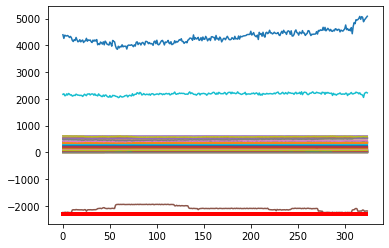

Predicción:  [[[0.992722   0.00727805]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3143000e+01  1.1791800e+01  5.8278900e+01  7.6610800e+01
  6.1001850e+02  3.3857600e+01  9.8121000e+00  1.8994950e+02
  9.0500000e-02  6.5162600e+01  1.2799310e+02  1.0254800e+01
  6.7075200e+01  1.7184460e+02  2.2622900e+01  1.4224630e+02
  1.9056270e+02  7.1004500e+01 -4.0000000e-04  3.7949000e+00
  1.4559900e+01  7.2956000e+00  1.5017000e+00  7.3284000e+01
  1.4757000e+00  1.5409000e+00  8.6680800e+01  5.9919300e+01
  1.3324000e+00  1.2261000e+00  1.4759000e+00  1.3926000e+00
  1.6531170e+02  8.4830000e-01  8.5020000e-01 -2.2020065e+03
  2.0899430e+02  1.6276000e+00  1.3924000e+00  2.2024706e+03
  4.9832830e+03  1.8481450e+02  1.4223000e+00  1.4147000e+00
  7.9032000e+00  7.4999000e+00  1.7675000e+00  2.9170000e-01
  2.9649300e+01  5.3802900e+02  5.2358980e+02  5.1957560e+02
  5.2026420e+02  5.2049360e+02  2.9394400e+01  3.06

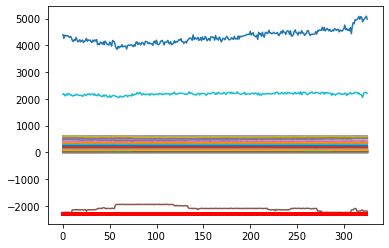

Predicción:  [[[0.9920758  0.00792416]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2935400e+01  1.1902600e+01  5.8018000e+01  7.6128100e+01
  6.1001810e+02  3.4922500e+01  9.7748000e+00  1.9003590e+02
  1.0810000e-01  6.5205900e+01  1.2805430e+02  1.0017700e+01
  6.6042400e+01  1.7346730e+02  2.2902500e+01  1.4073100e+02
  1.9060080e+02  7.0857000e+01 -4.0000000e-04  3.7839000e+00
  1.5226600e+01  7.2751000e+00  1.5007000e+00  7.3275800e+01
  1.4743000e+00  1.5421000e+00  8.7633000e+01  5.9888100e+01
  1.3326000e+00  1.2227000e+00  1.4633000e+00  1.3905000e+00
  1.6663070e+02  8.4510000e-01  8.4980000e-01 -2.1969596e+03
  2.0849580e+02  1.6301000e+00  1.3930000e+00  2.2103323e+03
  5.0194538e+03  1.8481450e+02  1.4208000e+00  1.4133000e+00
  7.8969000e+00  7.4964000e+00  1.7663000e+00  3.0310000e-01
  3.0133800e+01  5.3861770e+02  5.2401550e+02  5.1982050e+02
  5.2062590e+02  5.2086530e+02  2.9326300e+01  3.06

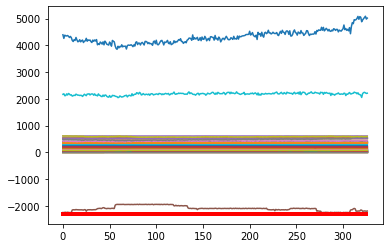

Predicción:  [[[0.99222094 0.00777904]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2977500e+01  1.1919500e+01  5.8746900e+01  7.5762500e+01
  6.0980650e+02  3.4248100e+01  9.7819000e+00  1.8984760e+02
  1.2800000e-01  6.5263700e+01  1.2773800e+02  9.9725000e+00
  6.6762100e+01  1.7258660e+02  2.2464400e+01  1.4120790e+02
  1.9045210e+02  7.0962500e+01 -4.0000000e-04  3.7978000e+00
  1.5902500e+01  7.3124000e+00  1.5006000e+00  7.3334700e+01
  1.4797000e+00  1.5445000e+00  8.7059100e+01  5.9977000e+01
  1.3388000e+00  1.2286000e+00  1.4656000e+00  1.3971000e+00
  1.6672780e+02  8.4330000e-01  8.4990000e-01 -2.1911633e+03
  2.0488380e+02  1.6312000e+00  1.3987000e+00  2.1839284e+03
  4.9232843e+03  1.8481450e+02  1.4267000e+00  1.4215000e+00
  7.8992000e+00  7.5017000e+00  1.7698000e+00  3.0430000e-01
  2.9773000e+01  5.3745440e+02  5.2359030e+02  5.1914600e+02
  5.2007280e+02  5.2028570e+02  2.9255000e+01  3.06

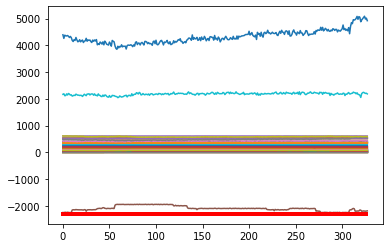

Predicción:  [[[0.9911573  0.00884278]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2677600e+01  1.1957100e+01  5.8465900e+01  7.7508100e+01
  6.0993490e+02  3.4198000e+01  9.7835000e+00  1.9000350e+02
  1.8830000e-01  6.5719700e+01  1.2794700e+02  1.0208900e+01
  6.5888500e+01  1.7103150e+02  2.2465800e+01  1.4054790e+02
  1.9049430e+02  7.0789500e+01 -4.0000000e-04  3.7798000e+00
  1.3084500e+01  7.3059000e+00  1.5008000e+00  7.3288000e+01
  1.4821000e+00  1.5494000e+00  8.7232800e+01  5.9459200e+01
  1.3416000e+00  1.2301000e+00  1.4812000e+00  1.4005000e+00
  1.6808830e+02  8.4300000e-01  8.4960000e-01 -2.1986392e+03
  2.0819090e+02  1.6373000e+00  1.4012000e+00  2.2352316e+03
  5.0189080e+03  1.8481450e+02  1.4305000e+00  1.4281000e+00
  7.9026000e+00  7.4990000e+00  1.7726000e+00  2.9160000e-01
  2.9867200e+01  5.3836440e+02  5.2378170e+02  5.1943360e+02
  5.2030780e+02  5.2062280e+02  2.8965800e+01  3.03

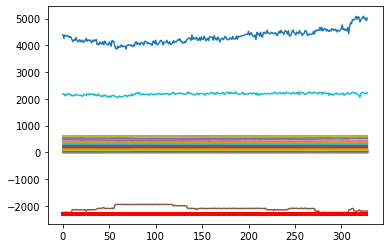

Predicción:  [[[0.9922742  0.00772574]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2709300e+01  1.1964400e+01  5.7242000e+01  7.7375100e+01
  6.0952260e+02  3.4181400e+01  9.7686000e+00  1.9008110e+02
  1.7470000e-01  6.5356900e+01  1.2818440e+02  9.8515000e+00
  6.6436700e+01  1.7301480e+02  2.2361800e+01  1.4128150e+02
  1.9052900e+02  7.0834700e+01 -4.0000000e-04  3.6932000e+00
  1.4628000e+01  7.2905000e+00  1.4997000e+00  7.3374900e+01
  1.4742000e+00  1.5409000e+00  8.7683400e+01  6.0569900e+01
  1.3310000e+00  1.2207000e+00  1.4632000e+00  1.3913000e+00
  1.6823790e+02  8.4360000e-01  8.4950000e-01 -2.1925262e+03
  2.0934680e+02  1.6287000e+00  1.3916000e+00  2.1528656e+03
  5.0029707e+03  1.8481450e+02  1.4227000e+00  1.4180000e+00
  7.8996000e+00  7.5017000e+00  1.7677000e+00  3.0460000e-01
  3.1188300e+01  5.3808220e+02  5.2384820e+02  5.1957620e+02
  5.2029610e+02  5.2065700e+02  2.8790300e+01  3.01

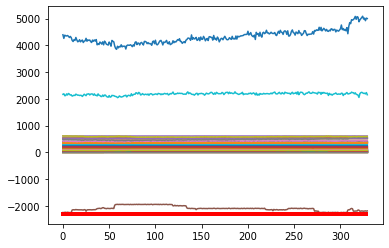

Predicción:  [[[0.99197924 0.00802072]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3035500e+01  1.1926400e+01  5.7585400e+01  7.7091100e+01
  6.1006530e+02  3.4095100e+01  9.7633000e+00  1.8999310e+02
  2.5600000e-01  6.3886000e+01  1.2808130e+02  9.8698000e+00
  6.7040300e+01  1.7146820e+02  2.1597100e+01  1.3925320e+02
  1.9052370e+02  7.0862200e+01 -4.0000000e-04  3.7036000e+00
  1.4698700e+01  7.2857000e+00  1.5003000e+00  7.3294500e+01
  1.4838000e+00  1.5469000e+00  8.7069200e+01  5.9955900e+01
  1.3388000e+00  1.2310000e+00  1.4738000e+00  1.3982000e+00
  1.6695670e+02  8.4420000e-01  8.4990000e-01 -2.1997905e+03
  2.0770460e+02  1.6338000e+00  1.3990000e+00  2.1960709e+03
  4.9448286e+03  1.8481450e+02  1.4301000e+00  1.4211000e+00
  7.8970000e+00  7.4997000e+00  1.7741000e+00  3.0020000e-01
  3.1600400e+01  5.3793340e+02  5.2347230e+02  5.1932650e+02
  5.2010610e+02  5.2037650e+02  2.8761300e+01  3.01

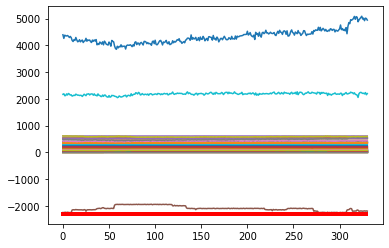

Predicción:  [[[0.9916659 0.0083341]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3628300e+01  1.1948500e+01  5.6348500e+01  7.8194700e+01
  6.1088320e+02  3.3649300e+01  9.7978000e+00  1.9008520e+02
  2.8950000e-01  6.4002100e+01  1.2830310e+02  1.0288800e+01
  6.6096000e+01  1.6977600e+02  2.1869300e+01  1.3975630e+02
  1.9067630e+02  7.0892700e+01 -4.0000000e-04  3.7123000e+00
  1.3608800e+01  7.3046000e+00  1.5003000e+00  7.3296800e+01
  1.4779000e+00  1.5432000e+00  8.6747100e+01  5.9787100e+01
  1.3348000e+00  1.2238000e+00  1.4777000e+00  1.3916000e+00
  1.6817480e+02  8.4750000e-01  8.5050000e-01 -2.1987396e+03
  2.0571380e+02  1.6301000e+00  1.3950000e+00  2.1924126e+03
  4.9189289e+03  1.8481450e+02  1.4247000e+00  1.4134000e+00
  7.9044000e+00  7.5072000e+00  1.7693000e+00  2.9170000e-01
  3.3145600e+01  5.3816880e+02  5.2379140e+02  5.1945930e+02
  5.2031890e+02  5.2053530e+02  2.8763000e+01  3.0029

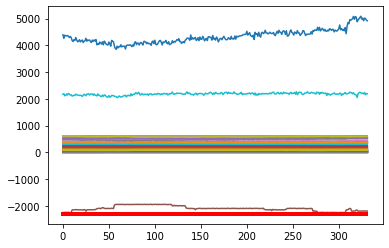

Predicción:  [[[0.99138606 0.00861402]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3205800e+01  1.1905600e+01  5.7864000e+01  7.7034600e+01
  6.1019960e+02  3.2396100e+01  9.7815000e+00  1.8991840e+02
  1.9530000e-01  6.3828800e+01  1.2800010e+02  9.9923000e+00
  6.6140300e+01  1.6963860e+02  2.1994400e+01  1.3870770e+02
  1.9057840e+02  7.0900200e+01 -4.0000000e-04  3.6943000e+00
  1.4638200e+01  7.2840000e+00  1.5009000e+00  7.3320700e+01
  1.4797000e+00  1.5458000e+00  8.7251500e+01  5.9981300e+01
  1.3365000e+00  1.2254000e+00  1.4783000e+00  1.3944000e+00
  1.6869910e+02  8.4760000e-01  8.5030000e-01 -2.1979327e+03
  2.0587410e+02  1.6327000e+00  1.3963000e+00  2.2254728e+03
  4.9391133e+03  1.8481450e+02  1.4289000e+00  1.4174000e+00
  7.8944000e+00  7.4981000e+00  1.7736000e+00  2.9530000e-01
  3.4439000e+01  5.3806450e+02  5.2381050e+02  5.1959890e+02
  5.2036380e+02  5.2062240e+02  2.8794100e+01  3.01

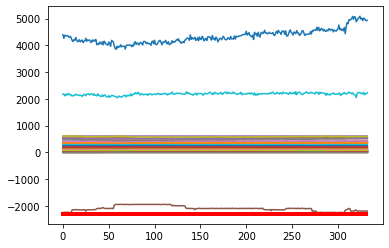

Predicción:  [[[0.99155325 0.0084467 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3065700e+01  1.1958500e+01  5.6836900e+01  7.6566800e+01
  6.1010790e+02  3.2450900e+01  9.7958000e+00  1.8990210e+02
  2.9600000e-01  6.3865900e+01  1.2818410e+02  9.9664000e+00
  6.6878000e+01  1.6991770e+02  2.1651400e+01  1.3976530e+02
  1.9062060e+02  7.0725000e+01 -4.0000000e-04  3.7022000e+00
  1.4204500e+01  7.3018000e+00  1.5008000e+00  7.3303100e+01
  1.4814000e+00  1.5465000e+00  8.7510300e+01  5.9614500e+01
  1.3402000e+00  1.2256000e+00  1.4810000e+00  1.3935000e+00
  1.6945960e+02  8.4710000e-01  8.4920000e-01 -2.2047750e+03
  2.0484690e+02  1.6339000e+00  1.3999000e+00  2.2276436e+03
  4.9196591e+03  1.8481450e+02  1.4274000e+00  1.4170000e+00
  7.9022000e+00  7.5002000e+00  1.7739000e+00  2.9280000e-01
  3.4375700e+01  5.3801560e+02  5.2376270e+02  5.1958260e+02
  5.2032180e+02  5.2056070e+02  2.8408100e+01  2.99

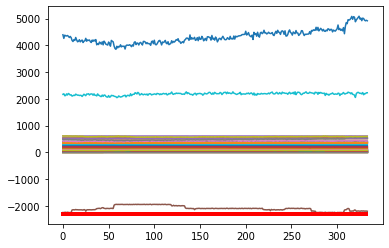

Predicción:  [[[0.99158317 0.00841687]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2982800e+01  1.1992100e+01  5.7200600e+01  7.7275400e+01
  6.1011950e+02  3.2886400e+01  9.8204000e+00  1.9002320e+02
  2.8530000e-01  6.3806600e+01  1.2807850e+02  1.0077300e+01
  6.6341300e+01  1.7021760e+02  2.1912500e+01  1.4075170e+02
  1.9054240e+02  7.0732100e+01 -4.0000000e-04  3.6767000e+00
  1.3971500e+01  7.3122000e+00  1.5023000e+00  7.3357500e+01
  1.4826000e+00  1.5469000e+00  8.7050500e+01  5.9529400e+01
  1.3409000e+00  1.2278000e+00  1.4807000e+00  1.3954000e+00
  1.6914100e+02  8.4730000e-01  8.4990000e-01 -2.1958705e+03
  2.0878690e+02  1.6337000e+00  1.4004000e+00  2.1929747e+03
  4.8872842e+03  1.8481450e+02  1.4288000e+00  1.4179000e+00
  7.8997000e+00  7.5013000e+00  1.7758000e+00  2.9530000e-01
  3.3667800e+01  5.3793770e+02  5.2412020e+02  5.1989660e+02
  5.2061960e+02  5.2082290e+02  2.8202300e+01  2.96

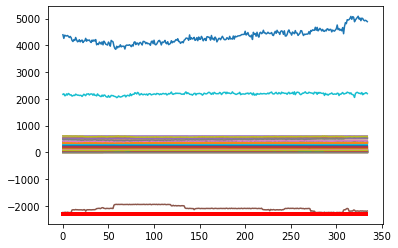

Predicción:  [[[0.99093163 0.00906831]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2988500e+01  1.1946300e+01  5.6941400e+01  7.7877000e+01
  6.0956660e+02  3.3716100e+01  9.7654000e+00  1.8994570e+02
  3.1650000e-01  6.3739800e+01  1.2798600e+02  9.9760000e+00
  6.7222300e+01  1.7196560e+02  2.2256300e+01  1.4109460e+02
  1.9040380e+02  7.0685500e+01 -4.0000000e-04  3.6007000e+00
  1.4078700e+01  7.3083000e+00  1.5012000e+00  7.3287400e+01
  1.4821000e+00  1.5454000e+00  8.6906500e+01  5.9535400e+01
  1.3423000e+00  1.2278000e+00  1.4757000e+00  1.3947000e+00
  1.6804510e+02  8.4290000e-01  8.4520000e-01 -2.2046845e+03
  2.0790500e+02  1.6317000e+00  1.4016000e+00  2.1774292e+03
  4.8897991e+03  1.8481450e+02  1.4292000e+00  1.4179000e+00
  7.9013000e+00  7.5025000e+00  1.7749000e+00  2.9930000e-01
  3.4477500e+01  5.3796450e+02  5.2418510e+02  5.2016020e+02
  5.2071350e+02  5.2095630e+02  2.8142700e+01  2.95

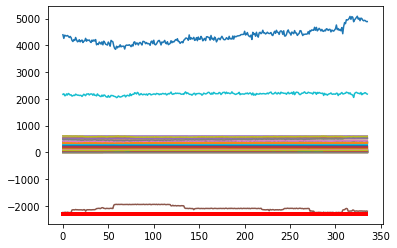

Predicción:  [[[0.9912629  0.00873704]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3214500e+01  1.2002000e+01  5.8495100e+01  7.7918500e+01
  6.0984900e+02  3.3845000e+01  9.7776000e+00  1.9008520e+02
  4.2680000e-01  6.3862700e+01  1.2784660e+02  1.0077300e+01
  6.6524100e+01  1.7114530e+02  2.2274300e+01  1.4174010e+02
  1.9030290e+02  7.0856300e+01 -4.0000000e-04  3.5967000e+00
  1.3467600e+01  7.3056000e+00  1.4984000e+00  7.3281500e+01
  1.4806000e+00  1.5440000e+00  8.7164300e+01  6.0704600e+01
  1.3381000e+00  1.2270000e+00  1.4761000e+00  1.3928000e+00
  1.6809600e+02  8.4230000e-01  8.4520000e-01 -2.2029511e+03
  2.0767500e+02  1.6304000e+00  1.3987000e+00  2.1850297e+03
  4.8326236e+03  1.8481450e+02  1.4267000e+00  1.4170000e+00
  7.8960000e+00  7.4989000e+00  1.7733000e+00  2.9710000e-01
  3.4163900e+01  5.3725330e+02  5.2397410e+02  5.1981700e+02
  5.2046270e+02  5.2055560e+02  2.8168300e+01  2.95

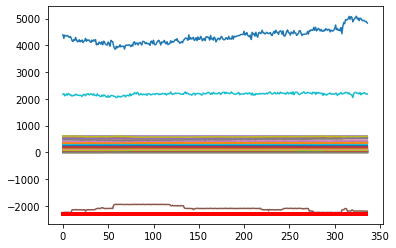

Predicción:  [[[0.9905911 0.0094089]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3134200e+01  1.2021500e+01  5.6611700e+01  7.6608100e+01
  6.1047960e+02  3.3171200e+01  9.7752000e+00  1.8997100e+02
  6.5390000e-01  6.3827300e+01  1.2816610e+02  1.0191600e+01
  6.6753600e+01  1.7083120e+02  2.0812300e+01  1.4174790e+02
  1.9056130e+02  7.0869900e+01 -4.0000000e-04  3.5921000e+00
  1.4544000e+01  7.3029000e+00  1.4988000e+00  7.3310300e+01
  1.4736000e+00  1.5388000e+00  8.8247800e+01  6.0930300e+01
  1.3313000e+00  1.2211000e+00  1.4668000e+00  1.3919000e+00
  1.6671300e+02  8.4070000e-01  8.4340000e-01 -2.1983629e+03
  2.0956490e+02  1.6264000e+00  1.3922000e+00  2.2138050e+03
  4.9306776e+03  1.8481450e+02  1.4260000e+00  1.4167000e+00
  7.8983000e+00  7.4907000e+00  1.7692000e+00  3.0250000e-01
  3.3812400e+01  5.3651340e+02  5.2300050e+02  5.1908340e+02
  5.1975650e+02  5.1989860e+02  2.9061400e+01  2.9850

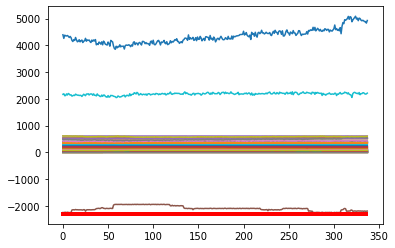

Predicción:  [[[0.99147874 0.00852124]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3138700e+01  1.1979200e+01  5.5475300e+01  7.8381400e+01
  6.1073150e+02  3.3466000e+01  9.7909000e+00  1.9000980e+02
  7.3650000e-01  6.3976200e+01  1.2810040e+02  1.0060600e+01
  6.7228100e+01  1.7029400e+02  2.0759100e+01  1.4030570e+02
  1.9046320e+02  7.0785200e+01 -4.0000000e-04  3.6013000e+00
  1.2604400e+01  7.3089000e+00  1.4975000e+00  7.3246900e+01
  1.4818000e+00  1.5457000e+00  8.7817800e+01  6.0412600e+01
  1.3404000e+00  1.2273000e+00  1.4801000e+00  1.3976000e+00
  1.6933520e+02  8.4140000e-01  8.4570000e-01 -2.1979311e+03
  2.0814980e+02  1.6332000e+00  1.4006000e+00  2.2376761e+03
  4.8316235e+03  1.8481450e+02  1.4320000e+00  1.4218000e+00
  7.9025000e+00  7.5044000e+00  1.7754000e+00  2.9500000e-01
  3.4200600e+01  5.3785110e+02  5.2403770e+02  5.2009430e+02
  5.2088440e+02  5.2094400e+02  2.8330100e+01  2.95

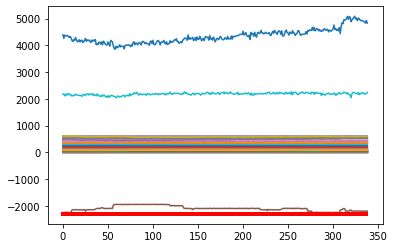

Predicción:  [[[0.99039394 0.00960604]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3163100e+01  1.2075200e+01  5.6889900e+01  7.8191800e+01
  6.1110390e+02  3.2721700e+01  9.8293000e+00  1.9000540e+02
  6.4140000e-01  6.2917900e+01  1.2801840e+02  9.9726000e+00
  6.7211000e+01  1.7027520e+02  2.1649000e+01  1.4098660e+02
  1.9038590e+02  7.0741000e+01 -4.0000000e-04  3.5990000e+00
  1.4216700e+01  7.2941000e+00  1.4972000e+00  7.3298200e+01
  1.4812000e+00  1.5484000e+00  8.7745200e+01  6.0621800e+01
  1.3367000e+00  1.2253000e+00  1.4769000e+00  1.3976000e+00
  1.6959260e+02  8.3730000e-01  8.4200000e-01 -2.2117414e+03
  2.0887490e+02  1.6355000e+00  1.3972000e+00  2.1933450e+03
  4.8899917e+03  1.8481450e+02  1.4334000e+00  1.4238000e+00
  7.9014000e+00  7.5044000e+00  1.7781000e+00  3.0090000e-01
  3.5509000e+01  5.3764890e+02  5.2395610e+02  5.1978570e+02
  5.2042090e+02  5.2057280e+02  2.8032200e+01  2.93

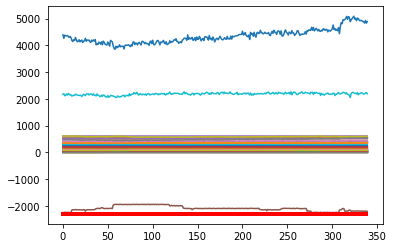

Predicción:  [[[0.991504 0.008496]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3338800e+01  1.2048400e+01  5.7542000e+01  7.9638100e+01
  6.1070410e+02  3.4758300e+01  9.8368000e+00  1.9003820e+02
  2.0540000e-01  6.1307800e+01  1.2772800e+02  1.0062900e+01
  6.5079800e+01  1.6935170e+02  2.2074200e+01  1.4299700e+02
  1.9035300e+02  7.1033600e+01 -4.0000000e-04  3.6068000e+00
  1.2239400e+01  7.2715000e+00  1.4996000e+00  7.3294400e+01
  1.4827000e+00  1.5506000e+00  8.8004100e+01  6.0901900e+01
  1.3341000e+00  1.2269000e+00  1.4866000e+00  1.3993000e+00
  1.6953760e+02  8.3430000e-01  8.4040000e-01 -2.2381584e+03
  2.0708450e+02  1.6387000e+00  1.3946000e+00  2.2045128e+03
  4.9105773e+03  1.8481450e+02  1.4353000e+00  1.4258000e+00
  7.8970000e+00  7.5011000e+00  1.7791000e+00  2.9250000e-01
  3.5804000e+01  5.3750220e+02  5.2404600e+02  5.1998950e+02
  5.2067400e+02  5.2073110e+02  2.8287500e+01  2.973570

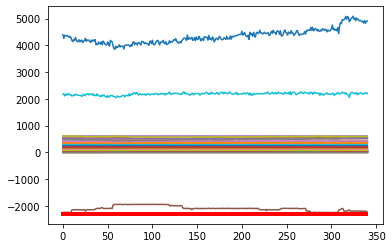

Predicción:  [[[0.9924148  0.00758522]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3210400e+01  1.2029000e+01  5.9048900e+01  7.7834800e+01
  6.1006790e+02  3.3517100e+01  9.8262000e+00  1.9000490e+02
  1.8720000e-01  6.1175500e+01  1.2771820e+02  9.9275000e+00
  6.5907800e+01  1.7037660e+02  2.2142400e+01  1.4512740e+02
  1.9046360e+02  7.0909600e+01 -4.0000000e-04  3.6003000e+00
  1.5189200e+01  7.3003000e+00  1.4990000e+00  7.3286400e+01
  1.4763000e+00  1.5418000e+00  8.7937100e+01  6.1218100e+01
  1.3273000e+00  1.2190000e+00  1.4695000e+00  1.3900000e+00
  1.6889670e+02  8.3380000e-01  8.3990000e-01 -2.2492741e+03
  2.0663330e+02  1.6298000e+00  1.3887000e+00  2.2080336e+03
  4.8385655e+03  1.8481450e+02  1.4267000e+00  1.4166000e+00
  7.8998000e+00  7.5010000e+00  1.7737000e+00  3.0400000e-01
  3.6366500e+01  5.3696440e+02  5.2377940e+02  5.1969540e+02
  5.2034170e+02  5.2046700e+02  2.8251900e+01  2.97

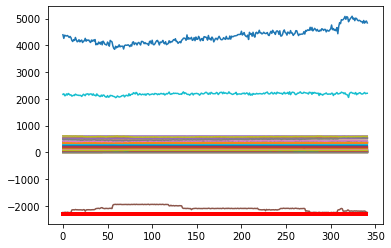

Predicción:  [[[0.9921312  0.00786887]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3047500e+01  1.2059300e+01  5.8581600e+01  7.7113600e+01
  6.1058300e+02  3.3506800e+01  9.7916000e+00  1.8989700e+02
  1.3920000e-01  6.1137000e+01  1.2770360e+02  9.9153000e+00
  6.5768200e+01  1.6974370e+02  2.2055500e+01  1.4479520e+02
  1.9054380e+02  7.0857200e+01 -4.0000000e-04  3.5982000e+00
  1.4360900e+01  7.2986000e+00  1.4988000e+00  7.3278500e+01
  1.4792000e+00  1.5446000e+00  8.7253200e+01  6.1226700e+01
  1.3316000e+00  1.2228000e+00  1.4750000e+00  1.3927000e+00
  1.6905860e+02  8.3380000e-01  8.3950000e-01 -2.2501335e+03
  2.1006110e+02  1.6317000e+00  1.3927000e+00  2.2074272e+03
  4.8759877e+03  1.8481450e+02  1.4289000e+00  1.4180000e+00
  7.9015000e+00  7.4999000e+00  1.7729000e+00  2.9800000e-01
  3.6136200e+01  5.3660000e+02  5.2357540e+02  5.1941870e+02
  5.2010630e+02  5.2024600e+02  2.8281000e+01  2.97

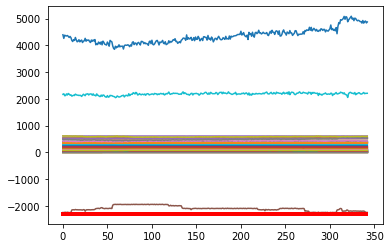

Predicción:  [[[0.99243355 0.00756642]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3083100e+01  1.2103800e+01  5.8838000e+01  7.8048400e+01
  6.0985870e+02  3.4041300e+01  9.7749000e+00  1.8995120e+02
  1.2820000e-01  6.1019700e+01  1.2768820e+02  1.0032200e+01
  6.5771200e+01  1.7079240e+02  2.1741000e+01  1.4447310e+02
  1.9063170e+02  7.0979500e+01 -4.0000000e-04  3.5883000e+00
  1.3995700e+01  7.2750000e+00  1.4985000e+00  7.3265200e+01
  1.4782000e+00  1.5458000e+00  8.7753300e+01  6.1188200e+01
  1.3324000e+00  1.2220000e+00  1.4710000e+00  1.3942000e+00
  1.6933070e+02  8.3360000e-01  8.3910000e-01 -2.2479193e+03
  2.0685040e+02  1.6341000e+00  1.3934000e+00  2.2066778e+03
  4.8986040e+03  1.8481450e+02  1.4306000e+00  1.4192000e+00
  7.9001000e+00  7.5009000e+00  1.7732000e+00  3.0250000e-01
  3.6242600e+01  5.3723550e+02  5.2381550e+02  5.1964380e+02
  5.2042170e+02  5.2056050e+02  2.8137900e+01  2.97

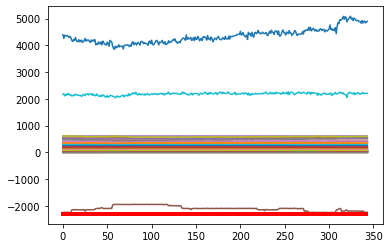

Predicción:  [[[0.9925453  0.00745473]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3166100e+01  1.2127400e+01  5.9177700e+01  7.8590100e+01
  6.0937700e+02  3.3037500e+01  9.7693000e+00  1.9004580e+02
  1.0950000e-01  6.1256500e+01  1.2782180e+02  1.0037600e+01
  6.6782500e+01  1.6946420e+02  2.1857300e+01  1.4383850e+02
  1.9052080e+02  7.0677300e+01 -4.0000000e-04  3.6090000e+00
  1.4094000e+01  7.2839000e+00  1.5002000e+00  7.3250900e+01
  1.4887000e+00  1.5550000e+00  8.7468600e+01  6.1156200e+01
  1.3385000e+00  1.2322000e+00  1.4866000e+00  1.4031000e+00
  1.6931230e+02  8.4030000e-01  8.4710000e-01 -2.2487503e+03
  2.0763860e+02  1.6425000e+00  1.4002000e+00  2.1796685e+03
  4.7511648e+03  1.8481450e+02  1.4398000e+00  1.4282000e+00
  7.8992000e+00  7.4986000e+00  1.7826000e+00  2.9600000e-01
  3.6477500e+01  5.3701560e+02  5.2379460e+02  5.1964560e+02
  5.2054310e+02  5.2056060e+02  2.8088700e+01  2.96

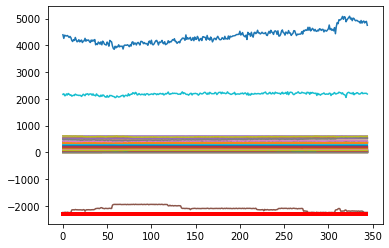

Predicción:  [[[0.99133027 0.00866971]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3137800e+01  1.2084400e+01  5.7758400e+01  7.8712900e+01
  6.0990310e+02  3.2299600e+01  9.7772000e+00  1.8993580e+02
  8.0800000e-02  6.1593900e+01  1.2783350e+02  1.0045000e+01
  6.6271000e+01  1.6849030e+02  2.1875100e+01  1.4504360e+02
  1.9052420e+02  7.0668600e+01 -4.0000000e-04  3.5882000e+00
  1.3724000e+01  7.3380000e+00  1.5001000e+00  7.3297400e+01
  1.4891000e+00  1.5519000e+00  8.7094300e+01  6.1825800e+01
  1.3397000e+00  1.2324000e+00  1.4911000e+00  1.3992000e+00
  1.6933090e+02  8.4330000e-01  8.4970000e-01 -2.2563449e+03
  2.0739020e+02  1.6391000e+00  1.4013000e+00  2.2140707e+03
  4.7091298e+03  1.8481450e+02  1.4354000e+00  1.4249000e+00
  7.8988000e+00  7.4998000e+00  1.7826000e+00  2.9160000e-01
  3.6442400e+01  5.3708000e+02  5.2367800e+02  5.1926910e+02
  5.2028610e+02  5.2021730e+02  2.7929500e+01  2.95

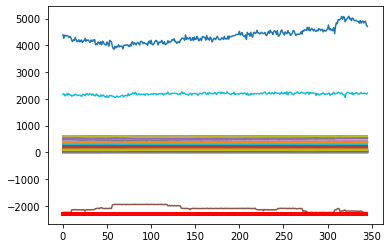

Predicción:  [[[0.99112964 0.00887037]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3053300e+01  1.2073300e+01  5.7446800e+01  7.8357500e+01
  6.1014120e+02  3.2583900e+01  9.7333000e+00  1.9005600e+02
  8.0500000e-02  6.1506200e+01  1.2772440e+02  1.0143800e+01
  6.5965000e+01  1.6960840e+02  2.2245600e+01  1.4487320e+02
  1.9036400e+02  7.0858300e+01 -4.0000000e-04  3.5149000e+00
  1.3964100e+01  7.2838000e+00  1.4992000e+00  7.3266900e+01
  1.4903000e+00  1.5544000e+00  8.8052500e+01  6.1191100e+01
  1.3420000e+00  1.2335000e+00  1.4897000e+00  1.4016000e+00
  1.6909970e+02  8.4420000e-01  8.4990000e-01 -2.2493570e+03
  2.0687990e+02  1.6409000e+00  1.4035000e+00  2.2100883e+03
  4.7638634e+03  1.8481450e+02  1.4380000e+00  1.4267000e+00
  7.9014000e+00  7.4993000e+00  1.7841000e+00  2.9410000e-01
  3.6559900e+01  5.3808440e+02  5.2412070e+02  5.1979830e+02
  5.2077590e+02  5.2073010e+02  2.7943800e+01  2.95

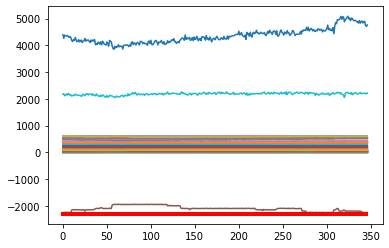

Predicción:  [[[0.99148107 0.0085189 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3096600e+01  1.2057300e+01  5.7449300e+01  7.7246900e+01
  6.1023960e+02  3.4828200e+01  9.7103000e+00  1.8989450e+02
  9.9600000e-02  6.1255400e+01  1.2804760e+02  9.9384000e+00
  6.6016500e+01  1.7232040e+02  2.2339200e+01  1.4589360e+02
  1.9029160e+02  7.1000100e+01 -4.0000000e-04  3.4473000e+00
  1.4287900e+01  7.3132000e+00  1.5001000e+00  7.3247900e+01
  1.4861000e+00  1.5474000e+00  8.7324100e+01  6.2066700e+01
  1.3335000e+00  1.2310000e+00  1.5356000e+00  1.3967000e+00
  1.6818070e+02  8.4450000e-01  8.5030000e-01 -2.2486715e+03
  2.0646990e+02  1.6344000e+00  1.3954000e+00  2.2037493e+03
  4.6993599e+03  1.8481450e+02  1.4323000e+00  1.4212000e+00
  7.9001000e+00  7.4994000e+00  1.7804000e+00  2.4480000e-01
  3.5988300e+01  5.3786890e+02  5.2412730e+02  5.1959500e+02
  5.2052890e+02  5.2047380e+02  2.7976700e+01  2.95

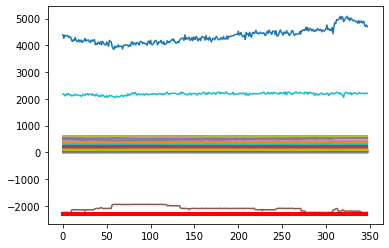

Predicción:  [[[0.9907726  0.00922744]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3008400e+01  1.2081800e+01  5.7191200e+01  7.6917500e+01
  6.0962240e+02  3.3633700e+01  9.6778000e+00  1.8998430e+02
  8.8300000e-02  6.0850100e+01  1.2792770e+02  1.0222800e+01
  6.6144900e+01  1.7008550e+02  2.2069900e+01  1.4550990e+02
  1.9029340e+02  7.0858600e+01 -4.0000000e-04  3.4001000e+00
  1.4459000e+01  7.3097000e+00  1.5007000e+00  7.3296900e+01
  1.4771000e+00  1.5389000e+00  8.7809700e+01  6.2297800e+01
  1.3230000e+00  1.2235000e+00  1.6855000e+00  1.3917000e+00
  1.6682570e+02  8.4400000e-01  8.5020000e-01 -2.2492342e+03
  2.0570580e+02  1.6264000e+00  1.3852000e+00  2.1933735e+03
  4.7891937e+03  1.8481450e+02  1.4280000e+00  1.4168000e+00
  7.8957000e+00  7.4995000e+00  1.7738000e+00  8.8200000e-02
  3.6030300e+01  5.3643330e+02  5.2321310e+02  5.1897100e+02
  5.1987990e+02  5.1989220e+02  2.8022800e+01  2.94

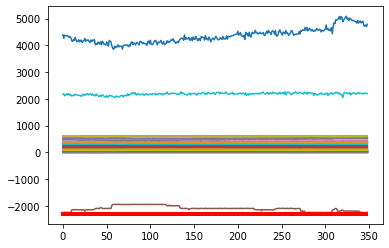

Predicción:  [[[0.99170566 0.00829438]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3306900e+01  1.2040900e+01  5.7280200e+01  7.7288900e+01
  6.0999230e+02  3.6497200e+01  9.6609000e+00  1.8998670e+02
  1.0970000e-01  6.0306500e+01  1.2777990e+02  1.0077000e+01
  6.6278600e+01  1.7150420e+02  2.2303700e+01  1.4562500e+02
  1.9038600e+02  7.0947100e+01 -4.0000000e-04  3.3921000e+00
  1.4918800e+01  7.2895000e+00  1.4997000e+00  7.3275500e+01
  1.4828000e+00  1.5437000e+00  8.7340000e+01  6.1979100e+01
  1.3290000e+00  1.2292000e+00  1.6855000e+00  1.3945000e+00
  1.6690480e+02  8.4590000e-01  8.5040000e-01 -2.2559422e+03
  2.0448960e+02  1.6309000e+00  1.3908000e+00  2.2236099e+03
  4.7223392e+03  1.8481450e+02  1.4303000e+00  1.4197000e+00
  7.8987000e+00  7.4997000e+00  1.7758000e+00  9.0400000e-02
  3.5895800e+01  5.3779780e+02  5.2349930e+02  5.1939680e+02
  5.2030600e+02  5.2023460e+02  2.7988900e+01  2.95

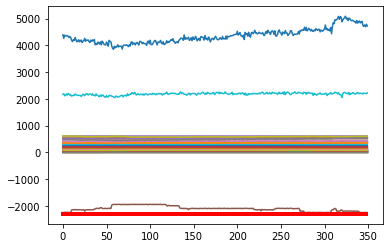

Predicción:  [[[0.9912513  0.00874867]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3432200e+01  1.1873900e+01  5.9187400e+01  7.7405300e+01
  6.1081260e+02  3.5943700e+01  9.7007000e+00  1.9006670e+02
  1.4510000e-01  7.0700200e+01  1.2785190e+02  9.8932000e+00
  6.7111500e+01  1.8144400e+02  2.2475100e+01  1.4696150e+02
  1.9044700e+02  7.0729300e+01 -4.0000000e-04  3.3901000e+00
  1.5173800e+01  7.3080000e+00  1.4991000e+00  7.3276400e+01
  1.4772000e+00  1.5387000e+00  8.7359800e+01  6.2185600e+01
  1.3265000e+00  1.2269000e+00  1.6641000e+00  1.3865000e+00
  1.6204210e+02  8.4640000e-01  8.4980000e-01 -2.2522291e+03
  2.0732800e+02  1.6261000e+00  1.3889000e+00  2.2008067e+03
  4.7268642e+03  1.8481450e+02  1.4202000e+00  1.4113000e+00
  7.9024000e+00  7.4990000e+00  1.7659000e+00  1.0160000e-01
  3.4252500e+01  5.3836890e+02  5.2372610e+02  5.1934880e+02
  5.2031460e+02  5.2035780e+02  2.7989900e+01  2.94

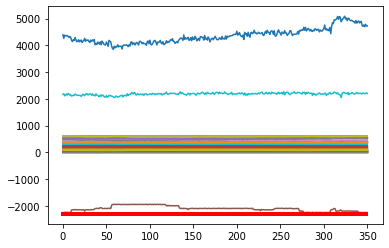

Predicción:  [[[0.9911754  0.00882453]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3029600e+01  1.1700600e+01  5.8995200e+01  7.7781400e+01
  6.0905520e+02  3.5120200e+01  9.6632000e+00  1.9005110e+02
  1.7660000e-01  7.0898100e+01  1.2758290e+02  9.7856000e+00
  6.4792900e+01  1.8332990e+02  2.2606300e+01  1.4814360e+02
  1.9014800e+02  7.0753700e+01 -4.0000000e-04  3.4128000e+00
  1.8306300e+01  7.2821000e+00  1.5009000e+00  7.3303400e+01
  1.4922000e+00  1.5548000e+00  8.6668400e+01  6.1741800e+01
  1.3426000e+00  1.2414000e+00  1.6770000e+00  1.4006000e+00
  1.5891730e+02  8.4760000e-01  8.5030000e-01 -2.2525120e+03
  2.0784770e+02  1.6417000e+00  1.4042000e+00  2.1564129e+03
  4.6753569e+03  1.8481450e+02  1.4325000e+00  1.4234000e+00
  7.8989000e+00  7.4981000e+00  1.7817000e+00  1.0450000e-01
  3.1894200e+01  5.3944890e+02  5.2383180e+02  5.1974300e+02
  5.2070220e+02  5.2068380e+02  2.8156900e+01  2.96

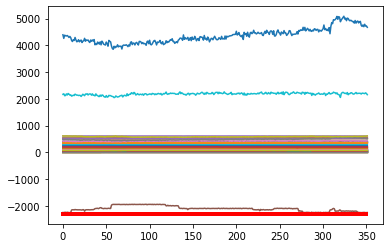

Predicción:  [[[0.9906061  0.00939385]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3002700e+01  1.1665000e+01  5.8277300e+01  7.8264800e+01
  6.0969280e+02  3.5513900e+01  9.6452000e+00  1.8994490e+02
  4.1360000e-01  7.0788600e+01  1.2782470e+02  1.0081400e+01
  6.5404600e+01  1.8124100e+02  2.2544000e+01  1.4767860e+02
  1.8999090e+02  7.0891000e+01 -4.0000000e-04  3.3956000e+00
  1.8308900e+01  7.3156000e+00  1.4995000e+00  7.3314100e+01
  1.4751000e+00  1.5391000e+00  8.7599100e+01  6.2133000e+01
  1.3241000e+00  1.2274000e+00  1.6607000e+00  1.3880000e+00
  1.5998650e+02  8.4780000e-01  8.5000000e-01 -2.2444841e+03
  2.0824440e+02  1.6275000e+00  1.3868000e+00  2.2367546e+03
  4.8392874e+03  1.8481450e+02  1.4193000e+00  1.4113000e+00
  7.8987000e+00  7.4976000e+00  1.7643000e+00  1.0360000e-01
  3.1554000e+01  5.3831560e+02  5.2373320e+02  5.1947510e+02
  5.2042790e+02  5.2032470e+02  2.8124700e+01  2.96

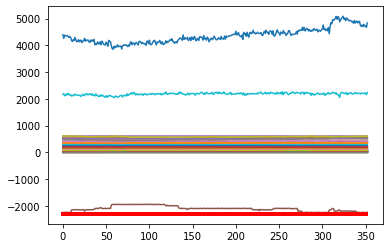

Predicción:  [[[0.9919886 0.0080114]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2876000e+01  1.1623100e+01  5.7470100e+01  7.6615800e+01
  6.0990940e+02  3.6072000e+01  9.6839000e+00  1.9006170e+02
  7.5750000e-01  7.3130400e+01  1.2817430e+02  9.9290000e+00
  6.6039100e+01  1.8348300e+02  2.2502600e+01  1.4796170e+02
  1.9000620e+02  7.0948600e+01 -4.0000000e-04  3.3893000e+00
  1.7548500e+01  7.2845000e+00  1.5001000e+00  7.3312300e+01
  1.4673000e+00  1.5319000e+00  8.7171000e+01  6.3491800e+01
  1.3171000e+00  1.2226000e+00  1.6474000e+00  1.3838000e+00
  1.5929570e+02  8.4820000e-01  8.5000000e-01 -2.2418204e+03
  2.0791090e+02  1.6193000e+00  1.3804000e+00  2.1918642e+03
  4.7346297e+03  1.8481450e+02  1.4133000e+00  1.4063000e+00
  7.8999000e+00  7.5011000e+00  1.7524000e+00  1.0490000e-01
  2.9217500e+01  5.3778440e+02  5.2318750e+02  5.1908790e+02
  5.2003420e+02  5.2001260e+02  2.8316800e+01  2.9682

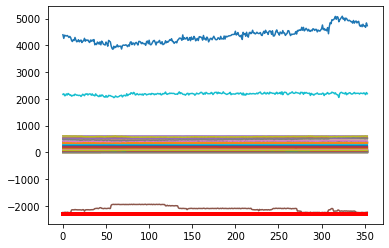

Predicción:  [[[0.99091536 0.00908462]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2775300e+01  1.1557900e+01  5.8354700e+01  7.6635200e+01
  6.1035980e+02  3.5199500e+01  9.6537000e+00  1.9008800e+02
  1.2434000e+00  7.3451100e+01  1.2773970e+02  1.0061900e+01
  6.5871100e+01  1.8280960e+02  2.2940700e+01  1.4751440e+02
  1.8999010e+02  7.0561400e+01 -4.0000000e-04  3.4118000e+00
  1.7018600e+01  7.2817000e+00  1.4999000e+00  7.3284700e+01
  1.4883000e+00  1.5511000e+00  8.6404600e+01  6.2735000e+01
  1.3378000e+00  1.2442000e+00  1.6678000e+00  1.4042000e+00
  1.5854380e+02  8.4870000e-01  8.5040000e-01 -2.2575978e+03
  2.0659260e+02  1.6377000e+00  1.4008000e+00  2.1827600e+03
  4.7023192e+03  1.8481450e+02  1.4330000e+00  1.4261000e+00
  7.8992000e+00  7.4993000e+00  1.7752000e+00  1.0780000e-01
  2.8635200e+01  5.3879780e+02  5.2368460e+02  5.1976200e+02
  5.2082960e+02  5.2070420e+02  2.8747200e+01  3.01

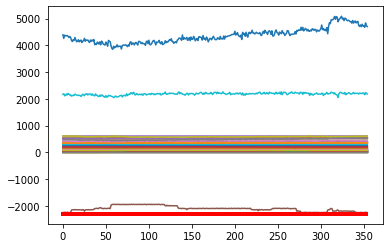

Predicción:  [[[0.99113 0.00887]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2709000e+01  1.1522100e+01  5.8291200e+01  7.6563100e+01
  6.1023150e+02  3.5949400e+01  9.6630000e+00  1.9000960e+02
  1.6610000e+00  7.3306500e+01  1.2809400e+02  9.9630000e+00
  6.6545200e+01  1.8363020e+02  2.2975000e+01  1.4686100e+02
  1.8988420e+02  7.0449100e+01 -4.0000000e-04  3.4016000e+00
  1.6253000e+01  7.3190000e+00  1.5017000e+00  7.3281100e+01
  1.4772000e+00  1.5426000e+00  8.5924200e+01  6.3164900e+01
  1.3277000e+00  1.2322000e+00  1.6604000e+00  1.3898000e+00
  1.5885430e+02  8.4830000e-01  8.4980000e-01 -2.2516653e+03
  2.0434080e+02  1.6287000e+00  1.3902000e+00  2.1500799e+03
  4.7329912e+03  1.8481450e+02  1.4176000e+00  1.4113000e+00
  7.8982000e+00  7.5048000e+00  1.7639000e+00  1.0370000e-01
  2.7664200e+01  5.3768440e+02  5.2374730e+02  5.1944700e+02
  5.2063870e+02  5.2042870e+02  2.8880900e+01  3.0244000e

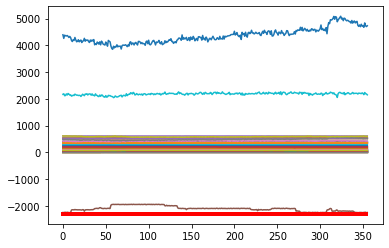

Predicción:  [[[0.9912334  0.00876664]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2418900e+01  1.1462400e+01  5.7965700e+01  7.6288200e+01
  6.1078670e+02  3.5230600e+01  9.6046000e+00  1.8998710e+02
  1.8774000e+00  7.2470600e+01  1.2836910e+02  9.9026000e+00
  6.7072200e+01  1.8204020e+02  2.2901000e+01  1.4553720e+02
  1.8982280e+02  7.0734000e+01 -4.0000000e-04  3.3935000e+00
  1.7473100e+01  7.3021000e+00  1.4996000e+00  7.3363500e+01
  1.4732000e+00  1.5373000e+00  8.5237900e+01  6.3097400e+01
  1.3254000e+00  1.2296000e+00  1.6552000e+00  1.3841000e+00
  1.5632350e+02  8.4900000e-01  8.4970000e-01 -2.2543283e+03
  2.0735910e+02  1.6221000e+00  1.3882000e+00  2.2206712e+03
  4.5694633e+03  1.8481450e+02  1.4113000e+00  1.4049000e+00
  7.8971000e+00  7.5005000e+00  1.7608000e+00  1.0550000e-01
  2.7435600e+01  5.3798660e+02  5.2298430e+02  5.1870720e+02
  5.1983330e+02  5.1959730e+02  2.9369400e+01  3.07

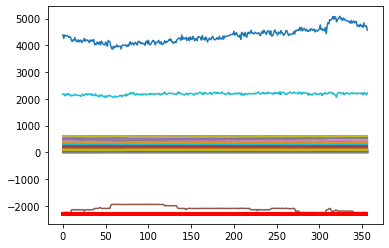

Predicción:  [[[0.9888819  0.01111809]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1988600e+01  1.1205800e+01  5.8149900e+01  7.6182100e+01
  6.0929160e+02  3.6647900e+01  9.5576000e+00  1.9001360e+02
  7.6060000e-01  7.1220400e+01  1.2777900e+02  9.9331000e+00
  6.7121700e+01  1.8169180e+02  2.2567200e+01  1.4164510e+02
  1.8961320e+02  7.0783000e+01 -4.0000000e-04  3.3942000e+00
  1.7495100e+01  7.2848000e+00  1.4982000e+00  7.3269800e+01
  1.4830000e+00  1.5507000e+00  8.5581200e+01  6.2184300e+01
  1.3299000e+00  1.2408000e+00  1.6619000e+00  1.3992000e+00
  1.5872190e+02  8.4790000e-01  8.5050000e-01 -2.2475765e+03
  2.0646360e+02  1.6368000e+00  1.3920000e+00  2.1840070e+03
  4.8364487e+03  1.8481450e+02  1.4273000e+00  1.4216000e+00
  7.9001000e+00  7.4999000e+00  1.7714000e+00  1.0910000e-01
  2.8016500e+01  5.3824890e+02  5.2271660e+02  5.1882350e+02
  5.1993900e+02  5.1960040e+02  2.9436900e+01  3.08

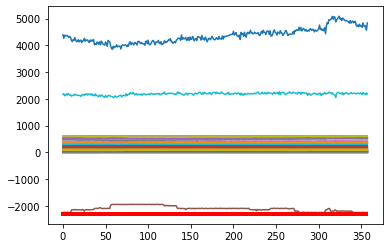

Predicción:  [[[0.99204856 0.00795142]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1204000e+01  1.0578400e+01  5.8182100e+01  7.6975200e+01
  6.1101190e+02  3.7052000e+01  9.3864000e+00  1.9004240e+02
  5.2250000e-01  7.1638700e+01  1.2802820e+02  9.8347000e+00
  6.7005100e+01  1.8048680e+02  2.2627100e+01  1.4099120e+02
  1.8889400e+02  7.0837200e+01 -4.0000000e-04  3.4352000e+00
  1.3059200e+01  7.2956000e+00  1.4989000e+00  7.3277000e+01
  1.4692000e+00  1.5375000e+00  8.7060900e+01  6.2233400e+01
  1.3193000e+00  1.2282000e+00  1.6486000e+00  1.3896000e+00
  1.6156660e+02  8.4340000e-01  8.4980000e-01 -2.2420743e+03
  2.0773890e+02  1.6242000e+00  1.3812000e+00  2.1624896e+03
  4.7251088e+03  1.8481450e+02  1.4195000e+00  1.4091000e+00
  7.9027000e+00  7.4980000e+00  1.7540000e+00  1.0520000e-01
  2.9789600e+01  5.3968010e+02  5.2373570e+02  5.1975950e+02
  5.2057480e+02  5.2043480e+02  2.8578900e+01  3.03

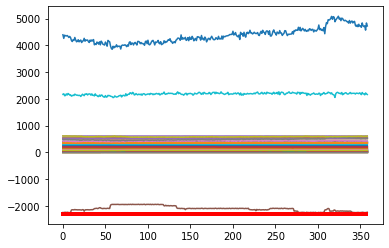

Predicción:  [[[0.99084693 0.00915311]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0123400e+01  1.0149500e+01  5.6267900e+01  7.6380500e+01
  6.0905660e+02  3.8067100e+01  9.5054000e+00  1.8999360e+02
  1.9394000e+00  7.1070800e+01  1.2794140e+02  1.0270900e+01
  6.5246300e+01  1.8123600e+02  2.1681400e+01  1.4313450e+02
  1.8840000e+02  7.0824500e+01 -4.0000000e-04  3.5975000e+00
  1.3023500e+01  7.3393000e+00  1.4998000e+00  7.3285100e+01
  1.4721000e+00  1.5344000e+00  8.8070300e+01  5.9442300e+01
  1.3230000e+00  1.2305000e+00  1.6544000e+00  1.3863000e+00
  1.5911770e+02  8.4230000e-01  8.5000000e-01 -2.2601423e+03
  2.0787960e+02  1.6232000e+00  1.3825000e+00  2.2021377e+03
  4.7065918e+03  1.8481450e+02  1.4192000e+00  1.4106000e+00
  7.8983000e+00  7.4994000e+00  1.7615000e+00  1.0690000e-01
  3.3150800e+01  5.3891780e+02  5.2348690e+02  5.1926510e+02
  5.1963890e+02  5.2014070e+02  2.7707500e+01  2.94

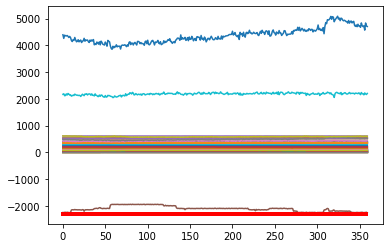

Predicción:  [[[0.9912397  0.00876029]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9914500e+01  1.0448400e+01  5.6412700e+01  7.8655700e+01
  6.0924740e+02  3.6696900e+01  9.5336000e+00  1.9002510e+02
  1.3783000e+00  7.1522500e+01  1.2786420e+02  9.9869000e+00
  6.4549900e+01  1.8086730e+02  2.1706300e+01  1.4237130e+02
  1.8877710e+02  7.0802500e+01 -4.0000000e-04  3.6759000e+00
  1.3862200e+01  7.2868000e+00  1.4992000e+00  7.3305200e+01
  1.4843000e+00  1.5506000e+00  8.7006200e+01  6.0404600e+01
  1.3371000e+00  1.2389000e+00  1.6684000e+00  1.4021000e+00
  1.5903270e+02  8.4390000e-01  8.5010000e-01 -2.2279446e+03
  2.0829430e+02  1.6377000e+00  1.3974000e+00  2.1819743e+03
  4.8218916e+03  1.8481450e+02  1.4345000e+00  1.4306000e+00
  7.9009000e+00  7.5012000e+00  1.7756000e+00  1.0730000e-01
  3.1777600e+01  5.3898440e+02  5.2329770e+02  5.1970940e+02
  5.1981810e+02  5.2045100e+02  2.7778400e+01  2.93

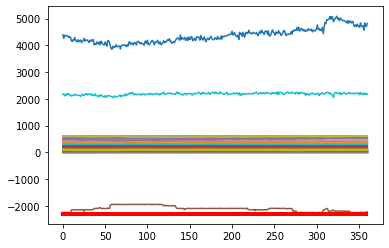

Predicción:  [[[0.99134606 0.00865391]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0646100e+01  1.0846700e+01  5.6615300e+01  7.9254300e+01
  6.0989570e+02  3.6792000e+01  9.4980000e+00  1.9001190e+02
  1.7045000e+00  7.1175700e+01  1.2811980e+02  9.9638000e+00
  6.4965800e+01  1.8209360e+02  2.2345200e+01  1.4108270e+02
  1.8926960e+02  7.0915700e+01 -4.0000000e-04  3.6022000e+00
  1.5153000e+01  7.3140000e+00  1.4996000e+00  7.3322800e+01
  1.4741000e+00  1.5398000e+00  8.7504000e+01  6.1922000e+01
  1.3351000e+00  1.2277000e+00  1.6539000e+00  1.3879000e+00
  1.6016810e+02  8.4080000e-01  8.4490000e-01 -2.1496991e+03
  2.0811790e+02  1.6267000e+00  1.3969000e+00  2.2240012e+03
  4.7885145e+03  1.8481450e+02  1.4180000e+00  1.4131000e+00
  7.9023000e+00  7.5017000e+00  1.7637000e+00  1.0980000e-01
  3.0265100e+01  5.3851560e+02  5.2366410e+02  5.1988940e+02
  5.1991720e+02  5.2064010e+02  2.8212200e+01  2.96

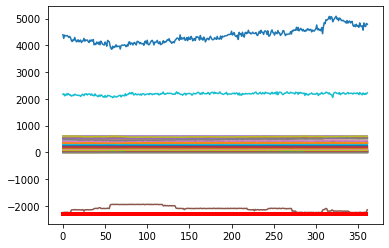

Predicción:  [[[0.98562235 0.01437763]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0806000e+01  1.0829600e+01  5.6598800e+01  7.6498700e+01
  6.0998110e+02  3.6171300e+01  9.4717000e+00  1.9009440e+02
  1.4466000e+00  7.0916000e+01  1.2826060e+02  1.0166600e+01
  6.8240900e+01  1.8190280e+02  2.2641300e+01  1.4089800e+02
  1.8924270e+02  7.0918600e+01 -4.0000000e-04  3.6090000e+00
  1.5437600e+01  7.2929000e+00  1.5001000e+00  7.3282400e+01
  1.4788000e+00  1.5459000e+00  8.6731200e+01  6.1100700e+01
  1.3368000e+00  1.2322000e+00  1.6597000e+00  1.3937000e+00
  1.6091720e+02  8.3840000e-01  8.4070000e-01 -2.1486421e+03
  2.0682490e+02  1.6329000e+00  1.3979000e+00  2.2800380e+03
  4.8945713e+03  1.8481450e+02  1.4234000e+00  1.4193000e+00
  7.8960000e+00  7.5007000e+00  1.7688000e+00  1.0920000e-01
  2.9635500e+01  5.3860000e+02  5.2366250e+02  5.1990700e+02
  5.1997780e+02  5.2068760e+02  2.8503300e+01  2.98

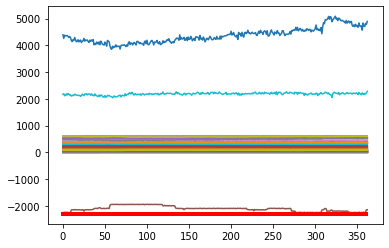

Predicción:  [[[0.9882684  0.01173163]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6235100e+01  1.0818000e+01  5.7597700e+01  7.6341700e+01
  6.1001080e+02  3.5593200e+01  9.3561000e+00  1.9009320e+02
  5.3920000e-01  7.1209800e+01  1.2804150e+02  9.9602000e+00
  6.7068400e+01  1.8019740e+02  2.2000600e+01  1.3964660e+02
  1.8926520e+02  7.0491300e+01 -4.0000000e-04  3.5999000e+00
  1.2726400e+01  7.2780000e+00  1.5013000e+00  7.3338400e+01
  1.4810000e+00  1.5483000e+00  8.6921900e+01  6.0933500e+01
  1.3436000e+00  1.2365000e+00  1.6634000e+00  1.3993000e+00
  1.6124130e+02  8.3740000e-01  8.4090000e-01 -2.1463126e+03
  2.0700120e+02  1.6361000e+00  1.4044000e+00  2.2587552e+03
  4.8559562e+03  1.8481450e+02  1.4282000e+00  1.4237000e+00
  7.8971000e+00  7.4948000e+00  1.7690000e+00  1.0570000e-01
  2.8757600e+01  5.3923340e+02  5.2366660e+02  5.1994970e+02
  5.2026170e+02  5.2073850e+02  2.9694900e+01  3.06

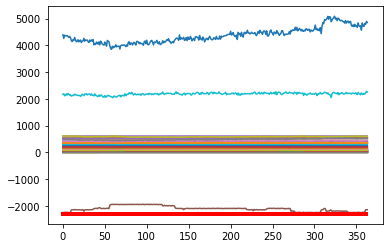

Predicción:  [[[0.987128   0.01287196]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0934300e+01  1.1152200e+01  5.6073800e+01  7.5594900e+01
  6.0985870e+02  3.5255600e+01  9.3706000e+00  1.8991420e+02
  4.2110000e-01  7.1970000e+01  1.2868490e+02  9.9478000e+00
  6.7047600e+01  1.7932330e+02  2.0504800e+01  1.3936270e+02
  1.8981500e+02  7.0323000e+01 -4.0000000e-04  3.5997000e+00
  5.4951000e+00  7.3323000e+00  1.4995000e+00  7.3287700e+01
  1.4727000e+00  1.5382000e+00  8.6291900e+01  5.9354500e+01
  1.3359000e+00  1.2297000e+00  1.6597000e+00  1.3872000e+00
  1.6126660e+02  8.3540000e-01  8.3890000e-01 -2.1572911e+03
  2.0517350e+02  1.6241000e+00  1.3955000e+00  2.2350455e+03
  4.7679417e+03  1.8481450e+02  1.4200000e+00  1.4125000e+00
  7.8996000e+00  7.4986000e+00  1.7596000e+00  9.9900000e-02
  3.2650200e+01  5.3762000e+02  5.2342260e+02  5.1889570e+02
  5.1942510e+02  5.1976210e+02  2.8858300e+01  3.02

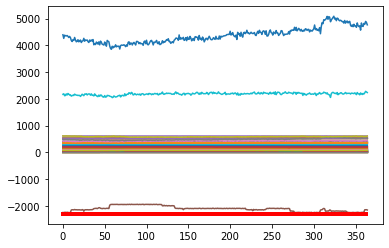

Predicción:  [[[0.98572296 0.01427707]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2237700e+01  1.1376300e+01  5.5521000e+01  7.9078300e+01
  6.1027510e+02  3.5172200e+01  9.4475000e+00  1.9005340e+02
  5.0010000e-01  7.1342200e+01  1.2829970e+02  1.0026200e+01
  6.7710900e+01  1.8170310e+02  2.0986600e+01  1.4045140e+02
  1.9006890e+02  7.0567100e+01 -4.0000000e-04  3.6166000e+00
  1.0185100e+01  7.3096000e+00  1.4998000e+00  7.3298500e+01
  1.4773000e+00  1.5424000e+00  8.7075100e+01  6.0679500e+01
  1.3406000e+00  1.2323000e+00  1.6612000e+00  1.3921000e+00
  1.6069340e+02  8.3770000e-01  8.4030000e-01 -2.1519871e+03
  2.0691970e+02  1.6300000e+00  1.4010000e+00  2.2677548e+03
  4.7927927e+03  1.8481450e+02  1.4257000e+00  1.4153000e+00
  7.9011000e+00  7.5037000e+00  1.7663000e+00  1.0520000e-01
  3.3448200e+01  5.3864450e+02  5.2322340e+02  5.1933900e+02
  5.1984400e+02  5.2014880e+02  2.8697900e+01  3.00

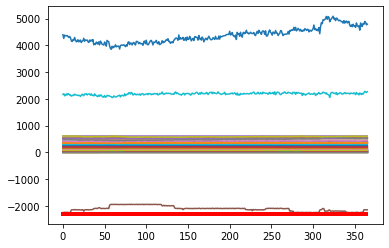

Predicción:  [[[0.9858402  0.01415984]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2959500e+01  1.1514100e+01  5.5919400e+01  7.9175800e+01
  6.1041880e+02  3.4738700e+01  9.4823000e+00  1.8997420e+02
  6.2160000e-01  7.1565100e+01  1.2812320e+02  1.0160900e+01
  6.6455400e+01  1.8205490e+02  2.1963700e+01  1.4296980e+02
  1.9015840e+02  7.0512700e+01 -4.0000000e-04  3.6051000e+00
  1.0167900e+01  7.3139000e+00  1.5002000e+00  7.3258200e+01
  1.4792000e+00  1.5456000e+00  8.6692900e+01  6.0879600e+01
  1.3440000e+00  1.2328000e+00  1.6655000e+00  1.3904000e+00
  1.6196390e+02  8.3860000e-01  8.4060000e-01 -2.1555585e+03
  2.0631320e+02  1.6323000e+00  1.4049000e+00  2.2421416e+03
  4.6990601e+03  1.8481450e+02  1.4248000e+00  1.4161000e+00
  7.9016000e+00  7.4992000e+00  1.7684000e+00  1.0280000e-01
  3.4696900e+01  5.4010210e+02  5.2401700e+02  5.1963920e+02
  5.2018560e+02  5.2059020e+02  2.9169300e+01  3.04

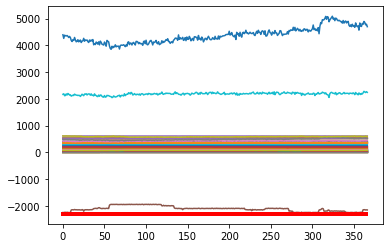

Predicción:  [[[0.9833014 0.0166986]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2797600e+01  1.1707400e+01  5.6372400e+01  7.7395200e+01
  6.0969220e+02  3.4590400e+01  9.4773000e+00  1.9008840e+02
  7.0040000e-01  7.1534600e+01  1.2796510e+02  1.0005200e+01
  6.7163300e+01  1.8281500e+02  2.2115700e+01  1.4325630e+02
  1.9027920e+02  7.0791100e+01 -4.0000000e-04  3.5924000e+00
  1.2265300e+01  7.2902000e+00  1.4990000e+00  7.3249400e+01
  1.4766000e+00  1.5454000e+00  8.7589500e+01  6.1794100e+01
  1.3368000e+00  1.2321000e+00  1.6578000e+00  1.3938000e+00
  1.6039620e+02  8.3890000e-01  8.4050000e-01 -2.1499660e+03
  2.0721350e+02  1.6322000e+00  1.3981000e+00  2.2139940e+03
  4.8638429e+03  1.8481450e+02  1.4275000e+00  1.4169000e+00
  7.8997000e+00  7.5018000e+00  1.7672000e+00  1.0930000e-01
  3.3910200e+01  5.3968010e+02  5.2320600e+02  5.1929360e+02
  5.1997640e+02  5.2022940e+02  2.9721400e+01  3.0831

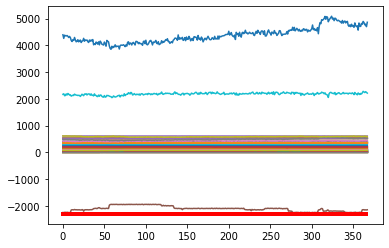

Predicción:  [[[0.98771393 0.01228608]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2986600e+01  1.1553700e+01  5.7865400e+01  7.7732200e+01
  6.1010230e+02  3.5199000e+01  9.4808000e+00  1.8993490e+02
  4.0690000e-01  7.1876000e+01  1.2736680e+02  1.0180000e+01
  6.6918700e+01  1.8320070e+02  2.2768100e+01  1.4137460e+02
  1.8997220e+02  7.0610000e+01 -4.0000000e-04  3.5919000e+00
  1.1397000e+01  7.2706000e+00  1.5001000e+00  7.3319500e+01
  1.4919000e+00  1.5642000e+00  8.7433500e+01  6.1525000e+01
  1.3564000e+00  1.2483000e+00  1.6702000e+00  1.4120000e+00
  1.6078190e+02  8.3710000e-01  8.4050000e-01 -2.1386138e+03
  2.0689270e+02  1.6516000e+00  1.4179000e+00  2.2329469e+03
  4.8752490e+03  1.8481450e+02  1.4411000e+00  1.4341000e+00
  7.9010000e+00  7.5010000e+00  1.7800000e+00  1.1010000e-01
  2.9053000e+01  5.4110220e+02  5.2400070e+02  5.2029760e+02
  5.2096280e+02  5.2111530e+02  2.9957100e+01  3.12

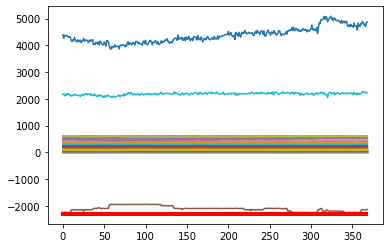

Predicción:  [[[0.9869573  0.01304274]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3568100e+01  1.1382200e+01  5.8234400e+01  7.8453500e+01
  6.0955140e+02  3.4220100e+01  9.4966000e+00  1.9012090e+02
  3.9860000e-01  7.1781700e+01  1.2728710e+02  9.8954000e+00
  6.6756800e+01  1.8209640e+02  2.2825100e+01  1.4099850e+02
  1.8941820e+02  7.0181900e+01 -4.0000000e-04  3.6156000e+00
  1.0000800e+01  7.3049000e+00  1.4989000e+00  7.3309500e+01
  1.4924000e+00  1.5609000e+00  8.6608000e+01  5.9612200e+01
  1.3652000e+00  1.2493000e+00  1.6721000e+00  1.4080000e+00
  1.6174880e+02  8.3490000e-01  8.4000000e-01 -2.1576629e+03
  2.0592360e+02  1.6477000e+00  1.4248000e+00  2.1994631e+03
  4.5667127e+03  1.8481450e+02  1.4352000e+00  1.4344000e+00
  7.8998000e+00  7.5000000e+00  1.7811000e+00  1.0870000e-01
  2.7337500e+01  5.4133120e+02  5.2483670e+02  5.2056850e+02
  5.2105750e+02  5.2123820e+02  2.9900100e+01  3.14

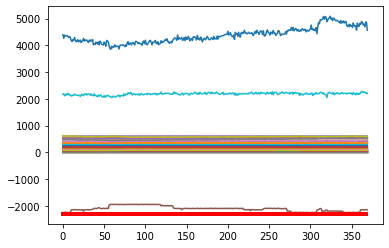

Predicción:  [[[0.9783839  0.02161612]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3990800e+01  1.1509800e+01  5.7897300e+01  7.7918800e+01
  6.1023380e+02  3.3716500e+01  9.4612000e+00  1.9003170e+02
  2.4880000e-01  7.1539100e+01  1.2761400e+02  1.0106600e+01
  6.7064700e+01  1.8169660e+02  2.3096000e+01  1.4079760e+02
  1.8909570e+02  7.0452200e+01 -4.0000000e-04  3.6049000e+00
  1.0114000e+01  7.3197000e+00  1.4986000e+00  7.3263100e+01
  1.4885000e+00  1.5590000e+00  8.8150200e+01  6.0589800e+01
  1.3565000e+00  1.2452000e+00  1.6704000e+00  1.4059000e+00
  1.6080940e+02  8.3710000e-01  8.4020000e-01 -2.1489879e+03
  2.0690870e+02  1.6469000e+00  1.4165000e+00  2.2178096e+03
  4.7782130e+03  1.8481450e+02  1.4340000e+00  1.4310000e+00
  7.9009000e+00  7.5004000e+00  1.7815000e+00  1.1060000e-01
  2.8111900e+01  5.4029610e+02  5.2452700e+02  5.2026720e+02
  5.2075360e+02  5.2096470e+02  3.0033200e+01  3.14

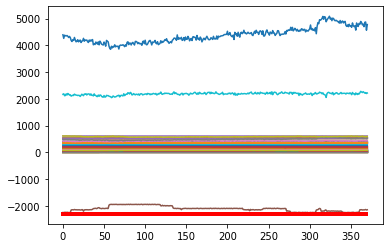

Predicción:  [[[0.9853027  0.01469736]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4040100e+01  1.1510900e+01  5.8686900e+01  7.7346900e+01
  6.1089010e+02  3.4246600e+01  9.4536000e+00  1.9001850e+02
  1.7420000e-01  7.0889300e+01  1.2788460e+02  9.9958000e+00
  6.6348900e+01  1.8197480e+02  2.2789300e+01  1.4122420e+02
  1.8915090e+02  7.0660500e+01 -4.0000000e-04  3.6139000e+00
  1.3694900e+01  7.2959000e+00  1.5009000e+00  7.3316700e+01
  1.4737000e+00  1.5424000e+00  8.7040100e+01  6.1237500e+01
  1.3402000e+00  1.2347000e+00  1.6555000e+00  1.3933000e+00
  1.5740860e+02  8.3700000e-01  8.3980000e-01 -2.1443194e+03
  2.0573240e+02  1.6290000e+00  1.4009000e+00  2.2173536e+03
  4.8175954e+03  1.8481450e+02  1.4205000e+00  1.4182000e+00
  7.8994000e+00  7.5017000e+00  1.7672000e+00  1.1200000e-01
  2.7204900e+01  5.3746670e+02  5.2286800e+02  5.1858140e+02
  5.1896610e+02  5.1931140e+02  3.0274200e+01  3.15

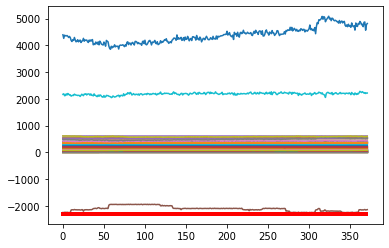

Predicción:  [[[0.98586684 0.01413309]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4076800e+01  1.1445800e+01  5.8364900e+01  7.7784300e+01
  6.1070170e+02  3.3665300e+01  9.4411000e+00  1.8997080e+02
  1.6860000e-01  7.0351900e+01  1.2767590e+02  9.9105000e+00
  6.6068100e+01  1.8036360e+02  2.2532300e+01  1.4159370e+02
  1.8940460e+02  7.0593400e+01 -4.0000000e-04  3.6065000e+00
  1.4145600e+01  7.3015000e+00  1.5001000e+00  7.3282900e+01
  1.4705000e+00  1.5385000e+00  8.7424800e+01  6.0489100e+01
  1.3369000e+00  1.2313000e+00  1.6502000e+00  1.3879000e+00
  1.5794680e+02  8.3800000e-01  8.3970000e-01 -2.1549140e+03
  2.0757020e+02  1.6256000e+00  1.3973000e+00  2.2343654e+03
  4.7693661e+03  1.8481450e+02  1.4155000e+00  1.4123000e+00
  7.9038000e+00  7.4982000e+00  1.7633000e+00  1.1300000e-01
  2.7571500e+01  5.3788440e+02  5.2276890e+02  5.1867400e+02
  5.1914830e+02  5.1944590e+02  2.9988500e+01  3.14

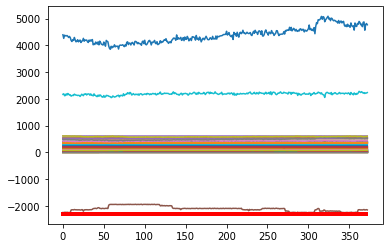

Predicción:  [[[0.9854232  0.01457678]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3924500e+01  1.1373400e+01  5.7199900e+01  7.7176700e+01
  6.1025040e+02  3.3652900e+01  9.4463000e+00  1.9013000e+02
  1.2640000e-01  7.0307100e+01  1.2784850e+02  9.9857000e+00
  6.6348300e+01  1.8033670e+02  2.2400500e+01  1.4109680e+02
  1.8951090e+02  7.0717500e+01 -4.0000000e-04  3.5897000e+00
  1.4444700e+01  7.2832000e+00  1.5000000e+00  7.3322100e+01
  1.4662000e+00  1.5346000e+00  8.7956800e+01  6.1125000e+01
  1.3287000e+00  1.2255000e+00  1.6453000e+00  1.3876000e+00
  1.5898820e+02  8.3860000e-01  8.4070000e-01 -2.1467003e+03
  2.0868060e+02  1.6226000e+00  1.3894000e+00  2.1909622e+03
  4.8631820e+03  1.8481450e+02  1.4173000e+00  1.4126000e+00
  7.8945000e+00  7.4983000e+00  1.7596000e+00  1.1470000e-01
  2.9434000e+01  5.3856450e+02  5.2297610e+02  5.1905740e+02
  5.1942000e+02  5.1978050e+02  2.9738900e+01  3.10

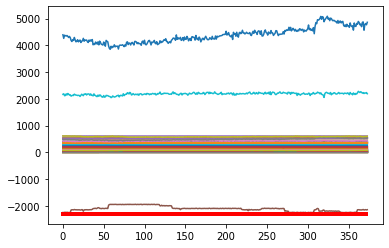

Predicción:  [[[0.9874605  0.01253958]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3849100e+01  1.1331600e+01  5.7643100e+01  7.7069900e+01
  6.0955880e+02  3.2542300e+01  9.4337000e+00  1.9004070e+02
  1.0980000e-01  7.0565700e+01  1.2776830e+02  9.8522000e+00
  6.7269800e+01  1.7903120e+02  2.2923800e+01  1.3943260e+02
  1.8944860e+02  7.0542500e+01 -4.0000000e-04  3.6142000e+00
  1.3446400e+01  7.3153000e+00  1.5003000e+00  7.3258800e+01
  1.4802000e+00  1.5500000e+00  8.6169100e+01  6.0440600e+01
  1.3450000e+00  1.2377000e+00  1.6622000e+00  1.3978000e+00
  1.6133380e+02  8.3800000e-01  8.4030000e-01 -2.1539502e+03
  2.0838670e+02  1.6363000e+00  1.4060000e+00  2.2171703e+03
  4.8143291e+03  1.8481450e+02  1.4267000e+00  1.4223000e+00
  7.9010000e+00  7.5001000e+00  1.7717000e+00  1.0950000e-01
  2.9116000e+01  5.3821560e+02  5.2349510e+02  5.1947300e+02
  5.1974080e+02  5.2018000e+02  2.9947100e+01  3.11

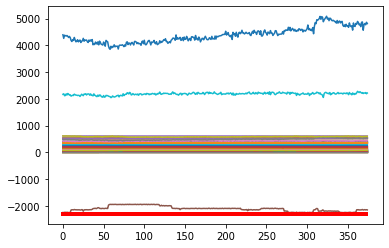

Predicción:  [[[0.9866741  0.01332594]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4045200e+01  1.1304200e+01  5.7969600e+01  7.6561200e+01
  6.1066870e+02  3.2171100e+01  9.4959000e+00  1.9005910e+02
  8.1400000e-02  7.0689500e+01  1.2774620e+02  9.9035000e+00
  6.6062900e+01  1.7844290e+02  2.3116800e+01  1.3846220e+02
  1.8954480e+02  7.0573700e+01 -4.0000000e-04  3.7732000e+00
  1.4116200e+01  7.2892000e+00  1.4990000e+00  7.3312900e+01
  1.4820000e+00  1.5498000e+00  8.7579600e+01  6.0279800e+01
  1.3481000e+00  1.2378000e+00  1.6651000e+00  1.3980000e+00
  1.6261420e+02  8.3610000e-01  8.4000000e-01 -2.1577131e+03
  2.0570700e+02  1.6368000e+00  1.4085000e+00  2.2893737e+03
  4.7962330e+03  1.8481450e+02  1.4260000e+00  1.4248000e+00
  7.9003000e+00  7.4991000e+00  1.7740000e+00  1.0880000e-01
  2.8173700e+01  5.3728440e+02  5.2334750e+02  5.1921200e+02
  5.1955200e+02  5.1991600e+02  2.9935300e+01  3.11

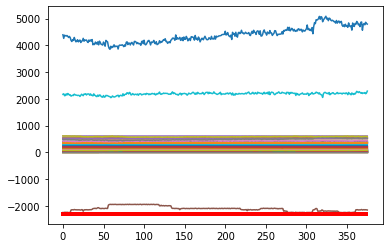

Predicción:  [[[0.98644954 0.01355044]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3811000e+01  1.1301600e+01  5.7929700e+01  7.7007400e+01
  6.1073400e+02  3.2136100e+01  9.5586000e+00  1.9001490e+02
  6.6400000e-02  7.0558500e+01  1.2738860e+02  9.8963000e+00
  6.6947700e+01  1.7738110e+02  2.3330200e+01  1.3896390e+02
  1.8952540e+02  7.0450600e+01 -4.0000000e-04  3.8977000e+00
  1.2901000e+01  7.3153000e+00  1.4997000e+00  7.3319500e+01
  1.4857000e+00  1.5560000e+00  8.6969500e+01  5.9760400e+01
  1.3561000e+00  1.2407000e+00  1.6674000e+00  1.4024000e+00
  1.6337630e+02  8.3360000e-01  8.3960000e-01 -2.1502107e+03
  2.0646830e+02  1.6430000e+00  1.4161000e+00  2.2106084e+03
  4.7719963e+03  1.8481450e+02  1.4310000e+00  1.4292000e+00
  7.9009000e+00  7.5004000e+00  1.7768000e+00  1.0920000e-01
  2.8733000e+01  5.3675330e+02  5.2324020e+02  5.1896700e+02
  5.1945690e+02  5.1985470e+02  2.9960700e+01  3.12

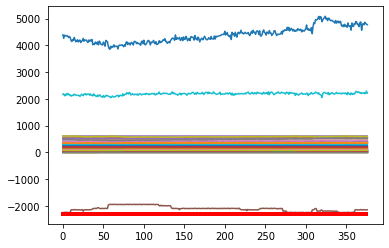

Predicción:  [[[0.98505265 0.01494738]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3766500e+01  1.1350900e+01  5.8424700e+01  7.7662700e+01
  6.0958400e+02  3.2478700e+01  9.5220000e+00  1.9001500e+02
  5.2200000e-02  7.0002600e+01  1.2739640e+02  1.0020000e+01
  6.6828600e+01  1.7772930e+02  2.3431700e+01  1.3895840e+02
  1.8966620e+02  7.0534500e+01 -4.0000000e-04  3.9066000e+00
  1.2990100e+01  7.3018000e+00  1.4977000e+00  7.3315100e+01
  1.4872000e+00  1.5582000e+00  8.7778000e+01  5.9949500e+01
  1.3562000e+00  1.2416000e+00  1.6701000e+00  1.4071000e+00
  1.6380810e+02  8.3440000e-01  8.4030000e-01 -2.1479152e+03
  2.0713740e+02  1.6455000e+00  1.4163000e+00  2.2264765e+03
  4.8861745e+03  1.8481450e+02  1.4374000e+00  1.4345000e+00
  7.8946000e+00  7.4966000e+00  1.7799000e+00  1.0990000e-01
  3.0112600e+01  5.3744890e+02  5.2357550e+02  5.1953590e+02
  5.1993920e+02  5.2037320e+02  2.9736100e+01  3.12

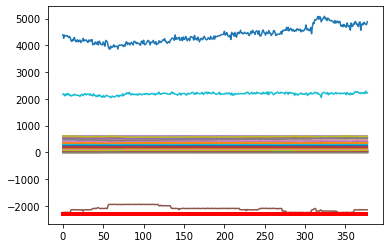

Predicción:  [[[0.9880136  0.01198645]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3532900e+01  1.1306700e+01  5.9078300e+01  7.7885300e+01
  6.0972750e+02  3.1792800e+01  9.5228000e+00  1.8995780e+02
  7.1200000e-02  6.9895100e+01  1.2717830e+02  9.8702000e+00
  6.7074800e+01  1.7656980e+02  2.3354200e+01  1.3855250e+02
  1.8956500e+02  7.0553900e+01 -4.0000000e-04  3.9049000e+00
  1.2421700e+01  7.2998000e+00  1.4994000e+00  7.3247700e+01
  1.4951000e+00  1.5666000e+00  8.7659700e+01  6.0353700e+01
  1.3632000e+00  1.2475000e+00  1.6765000e+00  1.4092000e+00
  1.6497150e+02  8.3400000e-01  8.4010000e-01 -2.1550832e+03
  2.0505570e+02  1.6544000e+00  1.4236000e+00  2.2372502e+03
  4.8516259e+03  1.8481450e+02  1.4392000e+00  1.4363000e+00
  7.9028000e+00  7.5001000e+00  1.7870000e+00  1.1050000e-01
  3.0641000e+01  5.3689780e+02  5.2367670e+02  5.1957440e+02
  5.1991560e+02  5.2029200e+02  2.9532000e+01  3.10

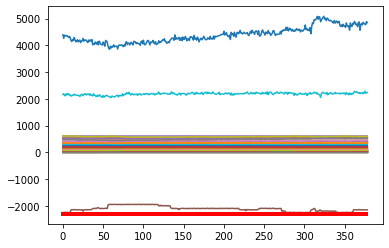

Predicción:  [[[0.9876774  0.01232253]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3361000e+01  1.1292800e+01  5.9307300e+01  7.9055500e+01
  6.0953920e+02  3.2598100e+01  9.5234000e+00  1.9001850e+02
  7.9900000e-02  6.9764200e+01  1.2706620e+02  1.0043500e+01
  6.6073100e+01  1.7741980e+02  2.3371300e+01  1.3871210e+02
  1.8951050e+02  7.0441000e+01 -4.0000000e-04  3.8946000e+00
  1.1664200e+01  7.3031000e+00  1.4983000e+00  7.3336700e+01
  1.5002000e+00  1.5689000e+00  8.6661900e+01  5.9911100e+01
  1.3715000e+00  1.2523000e+00  1.6784000e+00  1.4157000e+00
  1.6545870e+02  8.3370000e-01  8.3990000e-01 -2.1525254e+03
  2.0252010e+02  1.6561000e+00  1.4321000e+00  2.2115213e+03
  4.8934356e+03  1.8481450e+02  1.4465000e+00  1.4406000e+00
  7.8996000e+00  7.4991000e+00  1.7904000e+00  1.1200000e-01
  3.0975400e+01  5.3795110e+02  5.2412060e+02  5.1987790e+02
  5.2032370e+02  5.2070480e+02  2.9345700e+01  3.08

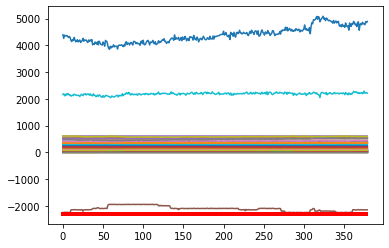

Predicción:  [[[0.98850864 0.01149133]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3536800e+01  1.1341800e+01  6.0036200e+01  7.8634300e+01
  6.0967320e+02  3.2283300e+01  9.5083000e+00  1.8998390e+02
  8.3900000e-02  6.9643800e+01  1.2647680e+02  9.9896000e+00
  6.5923200e+01  1.7695440e+02  2.3205700e+01  1.3878030e+02
  1.8943880e+02  7.0629000e+01 -4.0000000e-04  3.8903000e+00
  1.3151500e+01  7.3340000e+00  1.5005000e+00  7.3272000e+01
  1.4893000e+00  1.5580000e+00  8.7769000e+01  6.0085700e+01
  1.3596000e+00  1.2414000e+00  1.6702000e+00  1.4054000e+00
  1.6518170e+02  8.3280000e-01  8.3980000e-01 -2.1580278e+03
  2.0644680e+02  1.6461000e+00  1.4199000e+00  2.2177722e+03
  4.8225813e+03  1.8481450e+02  1.4374000e+00  1.4293000e+00
  7.8970000e+00  7.5009000e+00  1.7815000e+00  1.1100000e-01
  3.2059100e+01  5.3763330e+02  5.2358610e+02  5.1925630e+02
  5.1969700e+02  5.2009320e+02  2.9135600e+01  3.05

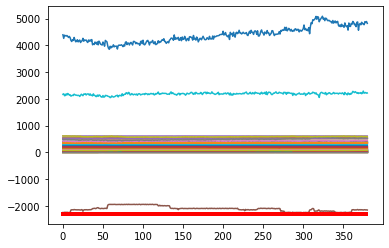

Predicción:  [[[0.98725224 0.01274774]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3730300e+01  1.1375700e+01  6.0571300e+01  7.7657000e+01
  6.1029400e+02  3.2011000e+01  9.4892000e+00  1.8999260e+02
  6.5600000e-02  6.9760600e+01  1.2566790e+02  9.9734000e+00
  6.6732600e+01  1.7647700e+02  2.2968100e+01  1.3913450e+02
  1.8961130e+02  7.0691500e+01 -4.0000000e-04  3.9004000e+00
  1.3401100e+01  7.2757000e+00  1.4993000e+00  7.3260700e+01
  1.4838000e+00  1.5545000e+00  8.7804600e+01  6.0006200e+01
  1.3497000e+00  1.2357000e+00  1.6647000e+00  1.4023000e+00
  1.6555060e+02  8.3590000e-01  8.3990000e-01 -2.1434706e+03
  2.0703400e+02  1.6430000e+00  1.4100000e+00  2.2064729e+03
  4.9180173e+03  1.8481450e+02  1.4357000e+00  1.4251000e+00
  7.9050000e+00  7.5055000e+00  1.7764000e+00  1.1170000e-01
  3.3429000e+01  5.3753560e+02  5.2316260e+02  5.1917280e+02
  5.1948210e+02  5.1995830e+02  2.9003200e+01  3.04

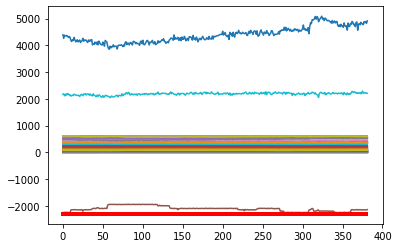

Predicción:  [[[0.9884101  0.01158986]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3556100e+01  1.1261900e+01  6.1483800e+01  7.7691500e+01
  6.1124060e+02  3.1804600e+01  9.5115000e+00  1.9003200e+02
  9.5100000e-02  7.0042400e+01  1.2524610e+02  9.9922000e+00
  6.7012200e+01  1.7706380e+02  2.2862900e+01  1.3896930e+02
  1.8963610e+02  7.0526500e+01 -4.0000000e-04  3.8952000e+00
  1.2954400e+01  7.3083000e+00  1.5000000e+00  7.3278700e+01
  1.4893000e+00  1.5613000e+00  8.7265800e+01  6.0625800e+01
  1.3575000e+00  1.2424000e+00  1.6701000e+00  1.4074000e+00
  1.6524270e+02  8.3780000e-01  8.3960000e-01 -2.1538315e+03
  2.0649640e+02  1.6492000e+00  1.4180000e+00  2.2270021e+03
  4.8949841e+03  1.8481450e+02  1.4420000e+00  1.4284000e+00
  7.8991000e+00  7.4990000e+00  1.7801000e+00  1.0980000e-01
  3.4940600e+01  5.3776660e+02  5.2362710e+02  5.1971120e+02
  5.2000950e+02  5.2052570e+02  2.8915700e+01  3.04

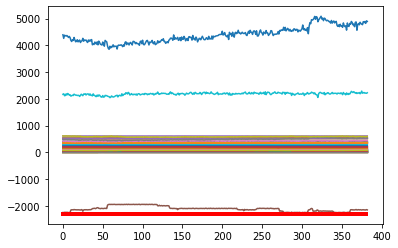

Predicción:  [[[0.9886679  0.01133209]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3389100e+01  1.1236400e+01  5.9909400e+01  7.8207700e+01
  6.0938970e+02  3.2243700e+01  9.5485000e+00  1.9003290e+02
  2.3450000e-01  7.0056000e+01  1.2506350e+02  1.0157500e+01
  6.6140100e+01  1.7848820e+02  2.2286400e+01  1.3962830e+02
  1.8958400e+02  7.0648800e+01 -4.0000000e-04  3.8964000e+00
  1.2756100e+01  7.3144000e+00  1.5002000e+00  7.3276100e+01
  1.4809000e+00  1.5510000e+00  8.8388700e+01  6.0727000e+01
  1.3481000e+00  1.2338000e+00  1.6580000e+00  1.3980000e+00
  1.6493470e+02  8.3670000e-01  8.3920000e-01 -2.1456124e+03
  2.0820140e+02  1.6392000e+00  1.4090000e+00  2.2495964e+03
  4.8714688e+03  1.8481450e+02  1.4327000e+00  1.4203000e+00
  7.9023000e+00  7.4995000e+00  1.7717000e+00  1.1350000e-01
  3.4901800e+01  5.3759570e+02  5.2377400e+02  5.1972040e+02
  5.1994040e+02  5.2041830e+02  2.8532700e+01  3.01

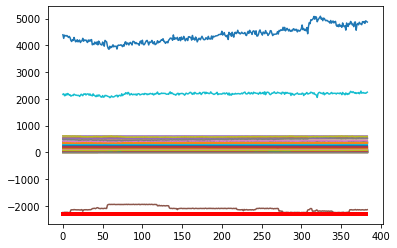

Predicción:  [[[0.9874441  0.01255598]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3359100e+01  1.1234200e+01  5.9491500e+01  7.8247300e+01
  6.1024160e+02  3.2964600e+01  9.5585000e+00  1.9004050e+02
  6.5080000e-01  6.9700700e+01  1.2528810e+02  1.0495400e+01
  6.6843000e+01  1.7875210e+02  2.1959100e+01  1.3998680e+02
  1.8942470e+02  7.0770000e+01 -4.0000000e-04  3.9042000e+00
  1.3451400e+01  7.2956000e+00  1.4998000e+00  7.3345800e+01
  1.4800000e+00  1.5471000e+00  8.8158200e+01  6.0525400e+01
  1.3477000e+00  1.2325000e+00  1.6578000e+00  1.3971000e+00
  1.6540500e+02  8.3690000e-01  8.3960000e-01 -2.1514422e+03
  2.0477290e+02  1.6354000e+00  1.4084000e+00  2.2490820e+03
  4.7880893e+03  1.8481450e+02  1.4318000e+00  1.4190000e+00
  7.8984000e+00  7.4997000e+00  1.7701000e+00  1.1220000e-01
  3.4717400e+01  5.3774610e+02  5.2386040e+02  5.1972000e+02
  5.1993900e+02  5.2032720e+02  2.8274100e+01  2.97

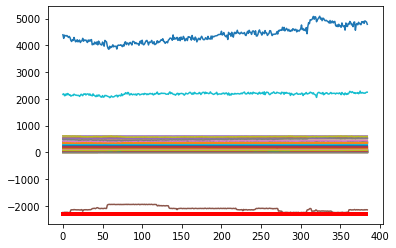

Predicción:  [[[0.98572    0.01428007]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3147500e+01  1.1273400e+01  5.9906700e+01  7.7835700e+01
  6.0970100e+02  3.2588200e+01  9.4710000e+00  1.9000560e+02
  1.0321000e+00  6.9751300e+01  1.2503230e+02  1.0270200e+01
  6.6713400e+01  1.7769070e+02  2.2134800e+01  1.4065260e+02
  1.8947890e+02  7.0895300e+01 -4.0000000e-04  3.9073000e+00
  1.3796800e+01  7.3105000e+00  1.5007000e+00  7.3269000e+01
  1.4735000e+00  1.5410000e+00  8.8214300e+01  6.0968500e+01
  1.3395000e+00  1.2263000e+00  1.6502000e+00  1.3919000e+00
  1.6533610e+02  8.3650000e-01  8.3990000e-01 -2.1518773e+03
  2.0834160e+02  1.6284000e+00  1.4002000e+00  2.2708886e+03
  4.8529199e+03  1.8481450e+02  1.4265000e+00  1.4139000e+00
  7.8976000e+00  7.5027000e+00  1.7646000e+00  1.1470000e-01
  3.4663200e+01  5.3743110e+02  5.2352220e+02  5.1950430e+02
  5.1966050e+02  5.2005450e+02  2.8185900e+01  2.97

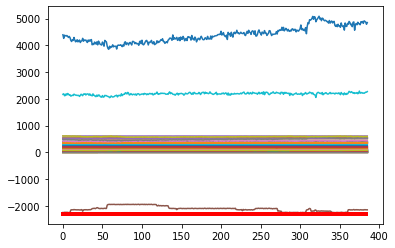

Predicción:  [[[0.98748374 0.01251629]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3300600e+01  1.1391100e+01  6.0043700e+01  7.7316800e+01
  6.1014830e+02  3.2632600e+01  9.5545000e+00  1.9001050e+02
  1.2823000e+00  7.0031100e+01  1.2501720e+02  1.0039200e+01
  6.7136800e+01  1.7707680e+02  2.2174000e+01  1.4088890e+02
  1.8954680e+02  7.0835200e+01 -4.0000000e-04  3.9097000e+00
  1.2399000e+01  7.2780000e+00  1.5009000e+00  7.3219300e+01
  1.4848000e+00  1.5548000e+00  8.8033800e+01  6.0084600e+01
  1.3474000e+00  1.2369000e+00  1.6623000e+00  1.4055000e+00
  1.6602440e+02  8.3420000e-01  8.4030000e-01 -2.1477182e+03
  2.0718660e+02  1.6429000e+00  1.4077000e+00  2.2517395e+03
  4.8744945e+03  1.8481450e+02  1.4397000e+00  1.4286000e+00
  7.9037000e+00  7.4994000e+00  1.7760000e+00  1.1360000e-01
  3.4083500e+01  5.3863330e+02  5.2384090e+02  5.1994680e+02
  5.2016370e+02  5.2068000e+02  2.7890800e+01  2.94

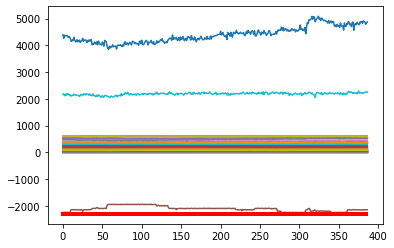

Predicción:  [[[0.98772764 0.0122724 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3686600e+01  1.1441800e+01  6.0159000e+01  7.8414800e+01
  6.1029060e+02  3.2609200e+01  9.5546000e+00  1.8997640e+02
  8.8810000e-01  6.9817300e+01  1.2525320e+02  9.8587000e+00
  6.7127900e+01  1.7819920e+02  2.2268400e+01  1.4121520e+02
  1.8950480e+02  7.0689800e+01 -4.0000000e-04  3.9043000e+00
  1.1977400e+01  7.2722000e+00  1.5005000e+00  7.3285000e+01
  1.4847000e+00  1.5544000e+00  8.6933400e+01  6.0526900e+01
  1.3499000e+00  1.2363000e+00  1.6613000e+00  1.4023000e+00
  1.6521260e+02  8.3320000e-01  8.4000000e-01 -2.1428060e+03
  2.0669210e+02  1.6429000e+00  1.4103000e+00  2.2537776e+03
  4.8387829e+03  1.8481450e+02  1.4338000e+00  1.4289000e+00
  7.8978000e+00  7.5016000e+00  1.7767000e+00  1.1530000e-01
  3.1603700e+01  5.3928220e+02  5.2421950e+02  5.2005620e+02
  5.2038870e+02  5.2085380e+02  2.7677400e+01  2.93

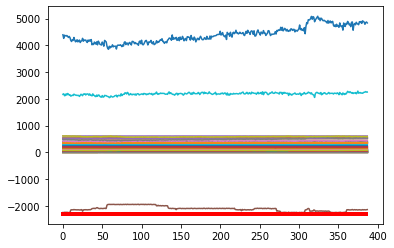

Predicción:  [[[0.9862752  0.01372484]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3541100e+01  1.1440100e+01  6.0155100e+01  7.8675300e+01
  6.1128640e+02  3.2788600e+01  9.5674000e+00  1.8999960e+02
  7.2490000e-01  6.9744200e+01  1.2498250e+02  9.8600000e+00
  6.5538600e+01  1.7782070e+02  2.2175100e+01  1.4166160e+02
  1.8949700e+02  7.1044300e+01 -4.0000000e-04  3.9578000e+00
  1.3064000e+01  7.2971000e+00  1.4993000e+00  7.3327200e+01
  1.4803000e+00  1.5466000e+00  8.8397500e+01  6.1017900e+01
  1.3426000e+00  1.2323000e+00  1.6553000e+00  1.3998000e+00
  1.6473640e+02  8.3440000e-01  8.4040000e-01 -2.1483931e+03
  2.0958010e+02  1.6351000e+00  1.4034000e+00  2.2250015e+03
  4.8965746e+03  1.8481450e+02  1.4297000e+00  1.4257000e+00
  7.8999000e+00  7.5013000e+00  1.7740000e+00  1.1840000e-01
  2.9749300e+01  5.3781560e+02  5.2376070e+02  5.1972080e+02
  5.2010030e+02  5.2056550e+02  2.7644000e+01  2.92

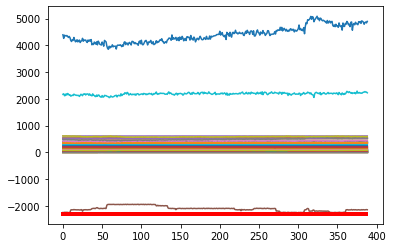

Predicción:  [[[0.98830473 0.01169522]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3268400e+01  1.1435500e+01  5.9830800e+01  7.8217900e+01
  6.0903790e+02  3.2492800e+01  9.5512000e+00  1.8998340e+02
  6.2510000e-01  6.9820800e+01  1.2503260e+02  9.7252000e+00
  6.6496500e+01  1.7644650e+02  2.1282900e+01  1.4087560e+02
  1.8952220e+02  7.0838600e+01 -4.0000000e-04  3.9433000e+00
  1.2202200e+01  7.3167000e+00  1.5011000e+00  7.3276700e+01
  1.4925000e+00  1.5581000e+00  8.8605500e+01  6.0444800e+01
  1.3551000e+00  1.2430000e+00  1.6682000e+00  1.4100000e+00
  1.6622520e+02  8.3440000e-01  8.3780000e-01 -2.1493190e+03
  2.0657960e+02  1.6463000e+00  1.4156000e+00  2.2693885e+03
  4.7900954e+03  1.8481450e+02  1.4395000e+00  1.4356000e+00
  7.8993000e+00  7.4887000e+00  1.7837000e+00  1.1580000e-01
  2.9298700e+01  5.4026450e+02  5.2434390e+02  5.2037640e+02
  5.2078660e+02  5.2124350e+02  2.8700700e+01  2.94

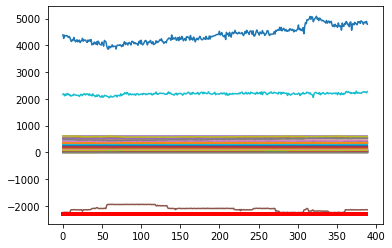

Predicción:  [[[0.985416   0.01458396]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2967100e+01  1.1479700e+01  5.8913500e+01  7.9904800e+01
  6.0941490e+02  3.2021000e+01  9.5331000e+00  1.8996370e+02
  4.8670000e-01  7.0074300e+01  1.2482790e+02  1.0050300e+01
  6.6972600e+01  1.7593420e+02  2.0620100e+01  1.4078520e+02
  1.8944660e+02  7.0857900e+01 -4.0000000e-04  3.9398000e+00
  1.1331600e+01  7.2961000e+00  1.4994000e+00  7.3348300e+01
  1.4830000e+00  1.5490000e+00  8.9308500e+01  6.0857100e+01
  1.3493000e+00  1.2309000e+00  1.6597000e+00  1.4023000e+00
  1.6843290e+02  8.3740000e-01  8.4080000e-01 -2.1444304e+03
  2.0822210e+02  1.6382000e+00  1.4106000e+00  2.1977033e+03
  4.8989226e+03  1.8481450e+02  1.4322000e+00  1.4281000e+00
  7.9001000e+00  7.5076000e+00  1.7752000e+00  1.1560000e-01
  2.9797700e+01  5.4053560e+02  5.2496360e+02  5.2062270e+02
  5.2100100e+02  5.2146720e+02  2.7686100e+01  2.91

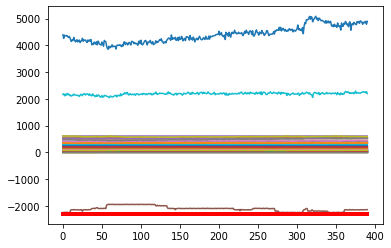

Predicción:  [[[0.9880541  0.01194592]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3047700e+01  1.1452000e+01  6.0498300e+01  7.9364600e+01
  6.0961650e+02  3.1869700e+01  9.5083000e+00  1.9004810e+02
  4.6130000e-01  6.9836100e+01  1.2498170e+02  1.0050500e+01
  6.7555400e+01  1.7652980e+02  2.1666300e+01  1.4104760e+02
  1.8924430e+02  7.0895100e+01 -4.0000000e-04  3.8981000e+00
  1.3342900e+01  7.2979000e+00  1.4996000e+00  7.3325800e+01
  1.4880000e+00  1.5528000e+00  8.8175600e+01  6.0852500e+01
  1.3530000e+00  1.2372000e+00  1.6610000e+00  1.4050000e+00
  1.6768150e+02  8.3720000e-01  8.3880000e-01 -2.1541481e+03
  2.0907640e+02  1.6404000e+00  1.4137000e+00  2.2285854e+03
  4.7871019e+03  1.8481450e+02  1.4356000e+00  1.4297000e+00
  7.8966000e+00  7.5007000e+00  1.7803000e+00  1.1900000e-01
  3.0442900e+01  5.3878440e+02  5.2437430e+02  5.2001880e+02
  5.2038600e+02  5.2082480e+02  2.7485100e+01  2.87

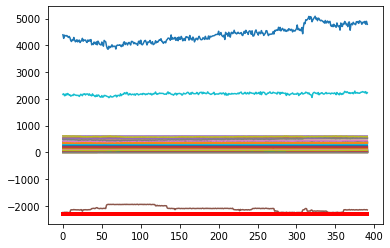

Predicción:  [[[0.98589754 0.01410247]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3126100e+01  1.1314400e+01  6.0686900e+01  7.9565300e+01
  6.0956890e+02  3.1487600e+01  9.4822000e+00  1.9006460e+02
  6.6030000e-01  6.9874800e+01  1.2495130e+02  9.8346000e+00
  6.6043900e+01  1.7559740e+02  2.1712000e+01  1.4112220e+02
  1.8928920e+02  7.0854500e+01 -4.0000000e-04  3.9042000e+00
  1.2283500e+01  7.2971000e+00  1.4997000e+00  7.3312400e+01
  1.4844000e+00  1.5499000e+00  8.7980700e+01  6.1573300e+01
  1.3469000e+00  1.2339000e+00  1.6591000e+00  1.4035000e+00
  1.6744290e+02  8.3660000e-01  8.3950000e-01 -2.1413800e+03
  2.0982790e+02  1.6377000e+00  1.4083000e+00  2.1844030e+03
  4.8061654e+03  1.8481450e+02  1.4362000e+00  1.4280000e+00
  7.9020000e+00  7.4995000e+00  1.7776000e+00  1.1840000e-01
  3.2293700e+01  5.3885330e+02  5.2412830e+02  5.1997460e+02
  5.2029120e+02  5.2074750e+02  2.7594200e+01  2.88

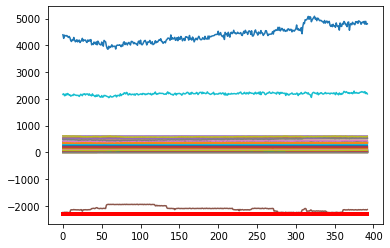

Predicción:  [[[0.98532134 0.01467865]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3052700e+01  1.1148600e+01  6.0472900e+01  8.0145500e+01
  6.0962160e+02  3.1563700e+01  9.4419000e+00  1.8996910e+02
  7.1040000e-01  6.9602000e+01  1.2487660e+02  9.8214000e+00
  6.7769300e+01  1.7537220e+02  2.1502700e+01  1.4111520e+02
  1.8912800e+02  7.0950300e+01 -4.0000000e-04  3.8742000e+00
  1.2484800e+01  7.2759000e+00  1.4998000e+00  7.3324300e+01
  1.4854000e+00  1.5508000e+00  8.7239400e+01  6.1105000e+01
  1.3494000e+00  1.2345000e+00  1.6614000e+00  1.4072000e+00
  1.6792120e+02  8.3600000e-01  8.3960000e-01 -2.1541940e+03
  2.0652830e+02  1.6390000e+00  1.4107000e+00  2.2041498e+03
  4.8673838e+03  1.8481450e+02  1.4420000e+00  1.4292000e+00
  7.8965000e+00  7.5004000e+00  1.7787000e+00  1.1720000e-01
  3.4581100e+01  5.3856230e+02  5.2403830e+02  5.2002930e+02
  5.2033200e+02  5.2082330e+02  2.7494900e+01  2.89

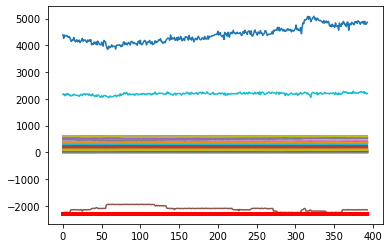

Predicción:  [[[0.9880983  0.01190162]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2944300e+01  1.1145600e+01  6.0910900e+01  8.0442800e+01
  6.1049350e+02  3.1201200e+01  9.4665000e+00  1.8998170e+02
  8.1110000e-01  6.9734700e+01  1.2489560e+02  1.0108500e+01
  6.7468000e+01  1.7466850e+02  2.2103500e+01  1.4133700e+02
  1.8896760e+02  7.0950100e+01 -4.0000000e-04  3.9134000e+00
  1.1749400e+01  7.3004000e+00  1.5006000e+00  7.3265200e+01
  1.4939000e+00  1.5587000e+00  8.6515000e+01  6.1003100e+01
  1.3538000e+00  1.2426000e+00  1.6675000e+00  1.4111000e+00
  1.6804000e+02  8.3580000e-01  8.4010000e-01 -2.1473046e+03
  2.0790170e+02  1.6464000e+00  1.4149000e+00  2.1877505e+03
  4.8576743e+03  1.8481450e+02  1.4464000e+00  1.4306000e+00
  7.9050000e+00  7.5012000e+00  1.7866000e+00  1.1890000e-01
  3.5287500e+01  5.3936880e+02  5.2423720e+02  5.2008470e+02
  5.2046990e+02  5.2084230e+02  2.7402300e+01  2.90

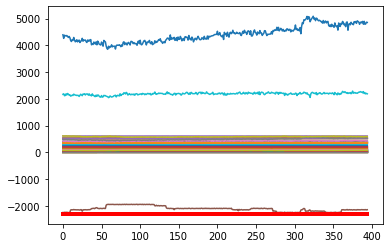

Predicción:  [[[0.98732984 0.0126702 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2936100e+01  1.1133400e+01  6.1509600e+01  8.0408600e+01
  6.1052620e+02  3.1054700e+01  9.4477000e+00  1.9005250e+02
  8.8110000e-01  6.9043500e+01  1.2500540e+02  9.8772000e+00
  6.5003100e+01  1.7498260e+02  2.1652900e+01  1.4136560e+02
  1.8885630e+02  7.1075900e+01 -4.0000000e-04  3.9073000e+00
  1.2396600e+01  7.3145000e+00  1.5005000e+00  7.3305400e+01
  1.4830000e+00  1.5464000e+00  8.7678900e+01  6.1562100e+01
  1.3439000e+00  1.2320000e+00  1.6584000e+00  1.3987000e+00
  1.6780220e+02  8.3440000e-01  8.3980000e-01 -2.1527422e+03
  2.0826600e+02  1.6337000e+00  1.4055000e+00  2.1838402e+03
  4.8222501e+03  1.8481450e+02  1.4339000e+00  1.4180000e+00
  7.8975000e+00  7.5017000e+00  1.7751000e+00  1.1680000e-01
  3.5240600e+01  5.3909770e+02  5.2419580e+02  5.1994570e+02
  5.2028360e+02  5.2072960e+02  2.7351700e+01  2.90

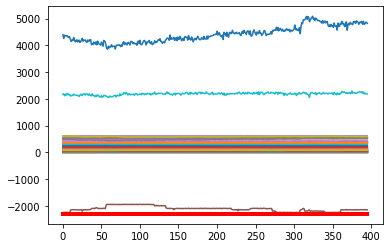

Predicción:  [[[0.9868417  0.01315829]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3099000e+01  1.1230300e+01  6.2352600e+01  7.9287200e+01
  6.1109430e+02  3.0911300e+01  9.4435000e+00  1.9000820e+02
  7.8950000e-01  6.8878200e+01  1.2485750e+02  1.0014900e+01
  6.7042600e+01  1.7559650e+02  2.1692300e+01  1.4152210e+02
  1.8899520e+02  7.0983500e+01 -4.0000000e-04  3.8972000e+00
  1.3753700e+01  7.2900000e+00  1.4982000e+00  7.3316000e+01
  1.4776000e+00  1.5423000e+00  8.7699400e+01  6.2255200e+01
  1.3371000e+00  1.2271000e+00  1.6487000e+00  1.3948000e+00
  1.6718030e+02  8.3660000e-01  8.3960000e-01 -2.1485088e+03
  2.0522540e+02  1.6305000e+00  1.3989000e+00  2.1855389e+03
  4.8888792e+03  1.8481450e+02  1.4302000e+00  1.4133000e+00
  7.8999000e+00  7.4993000e+00  1.7712000e+00  1.2240000e-01
  3.5282000e+01  5.3728890e+02  5.2369630e+02  5.1962850e+02
  5.1991090e+02  5.2035820e+02  2.7145700e+01  2.87

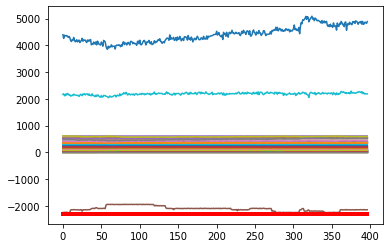

Predicción:  [[[0.9881733  0.01182665]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3116400e+01  1.1310200e+01  6.2204800e+01  7.9317000e+01
  6.1049170e+02  3.1064000e+01  9.4913000e+00  1.9008330e+02
  1.2080000e+00  6.8824000e+01  1.2502260e+02  9.7309000e+00
  6.6242000e+01  1.7387600e+02  2.1394100e+01  1.4044270e+02
  1.8923400e+02  7.0990600e+01 -4.0000000e-04  3.8954000e+00
  1.2139700e+01  7.3190000e+00  1.4999000e+00  7.3324400e+01
  1.4840000e+00  1.5472000e+00  8.7145600e+01  6.1806800e+01
  1.3420000e+00  1.2344000e+00  1.6569000e+00  1.4012000e+00
  1.6644600e+02  8.3650000e-01  8.4070000e-01 -2.1465248e+03
  2.0703490e+02  1.6348000e+00  1.4041000e+00  2.2224826e+03
  4.8567201e+03  1.8481450e+02  1.4365000e+00  1.4189000e+00
  7.8992000e+00  7.4971000e+00  1.7764000e+00  1.1980000e-01
  3.5313100e+01  5.3804680e+02  5.2333280e+02  5.1929040e+02
  5.1950400e+02  5.2014930e+02  2.7075000e+01  2.86

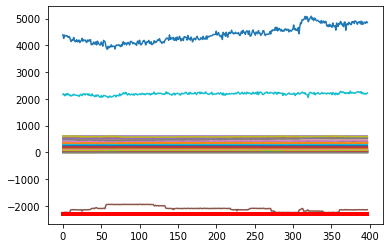

Predicción:  [[[0.98717725 0.01282274]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2810500e+01  1.1276800e+01  6.0209100e+01  7.9903600e+01
  6.1051820e+02  3.1111500e+01  9.4893000e+00  1.8999000e+02
  1.4250000e+00  6.8671500e+01  1.2535670e+02  1.0299500e+01
  6.6479100e+01  1.7495830e+02  2.2115300e+01  1.3970030e+02
  1.8914920e+02  7.1057700e+01 -4.0000000e-04  3.8970000e+00
  1.2507300e+01  7.2922000e+00  1.5006000e+00  7.3367500e+01
  1.4782000e+00  1.5423000e+00  8.8816700e+01  6.2020500e+01
  1.3397000e+00  1.2272000e+00  1.6506000e+00  1.3966000e+00
  1.6761810e+02  8.3740000e-01  8.4010000e-01 -2.1442905e+03
  2.0919730e+02  1.6304000e+00  1.4020000e+00  2.1836258e+03
  4.7628889e+03  1.8481450e+02  1.4286000e+00  1.4157000e+00
  7.9006000e+00  7.4995000e+00  1.7716000e+00  1.2130000e-01
  3.1986500e+01  5.3896660e+02  5.2422630e+02  5.2031080e+02
  5.2051050e+02  5.2109230e+02  2.7043200e+01  2.85

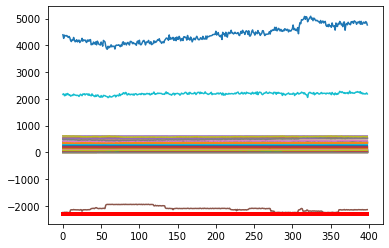

Predicción:  [[[0.98436326 0.01563672]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2710100e+01  1.1271300e+01  6.0486500e+01  7.8313100e+01
  6.1033470e+02  3.0399300e+01  9.5478000e+00  1.9000380e+02
  1.6007000e+00  6.9460800e+01  1.2490740e+02  9.8037000e+00
  6.6576200e+01  1.7643640e+02  2.2316600e+01  1.4017330e+02
  1.8901160e+02  7.0902300e+01 -4.0000000e-04  3.8964000e+00
  1.3494500e+01  7.2992000e+00  1.5016000e+00  7.3266500e+01
  1.4889000e+00  1.5538000e+00  8.7184800e+01  6.1681700e+01
  1.3491000e+00  1.2396000e+00  1.6579000e+00  1.4063000e+00
  1.6639090e+02  8.3610000e-01  8.4000000e-01 -2.1558151e+03
  2.0699870e+02  1.6420000e+00  1.4106000e+00  2.1750135e+03
  4.9006180e+03  1.8481450e+02  1.4356000e+00  1.4274000e+00
  7.9005000e+00  7.5006000e+00  1.7816000e+00  1.2370000e-01
  2.9320900e+01  5.3746660e+02  5.2404050e+02  5.1989040e+02
  5.2030490e+02  5.2080120e+02  2.7453100e+01  2.89

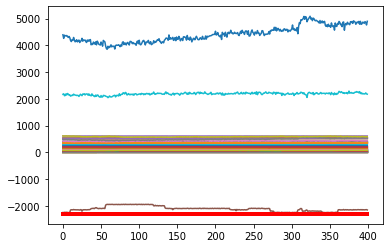

Predicción:  [[[0.9890322  0.01096785]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2584500e+01  1.1189700e+01  6.1442300e+01  7.9745900e+01
  6.0878870e+02  3.0748500e+01  9.4679000e+00  1.8981270e+02
  1.6269000e+00  6.9888800e+01  1.2488530e+02  1.0204100e+01
  6.7610800e+01  1.7451340e+02  2.2611600e+01  1.4032780e+02
  1.8892010e+02  7.0848200e+01 -4.0000000e-04  3.8974000e+00
  1.2156800e+01  7.2864000e+00  1.4995000e+00  7.3245300e+01
  1.4837000e+00  1.5450000e+00  8.7265700e+01  6.1655400e+01
  1.3461000e+00  1.2343000e+00  1.6533000e+00  1.3991000e+00
  1.6592230e+02  8.3750000e-01  8.3970000e-01 -2.1533297e+03
  2.0573430e+02  1.6327000e+00  1.4083000e+00  2.2288437e+03
  4.7139816e+03  1.8481450e+02  1.4277000e+00  1.4232000e+00
  7.8994000e+00  7.4999000e+00  1.7751000e+00  1.2200000e-01
  2.8882900e+01  5.3685110e+02  5.2400170e+02  5.1966610e+02
  5.2007950e+02  5.2066010e+02  2.7571300e+01  2.91

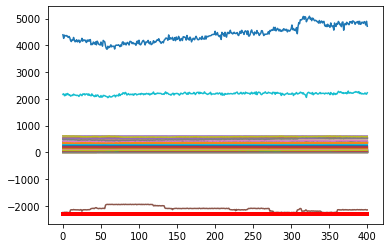

Predicción:  [[[0.98355746 0.01644253]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2802800e+01  1.1197700e+01  6.2007200e+01  7.8458200e+01
  6.0968660e+02  3.1124700e+01  9.5126000e+00  1.8998860e+02
  1.6958000e+00  6.9466500e+01  1.2505400e+02  9.8921000e+00
  6.8311200e+01  1.7713360e+02  2.2818700e+01  1.4243160e+02
  1.8898040e+02  7.0877900e+01 -4.0000000e-04  3.9109000e+00
  1.4590000e+01  7.3154000e+00  1.4996000e+00  7.3264500e+01
  1.4758000e+00  1.5406000e+00  8.8691300e+01  6.1382600e+01
  1.3401000e+00  1.2292000e+00  1.6440000e+00  1.3924000e+00
  1.6411500e+02  8.3770000e-01  8.3930000e-01 -2.1523438e+03
  2.0709260e+02  1.6289000e+00  1.4021000e+00  2.1919745e+03
  4.8165932e+03  1.8481450e+02  1.4209000e+00  1.4184000e+00
  7.8989000e+00  7.4983000e+00  1.7703000e+00  1.2610000e-01
  2.8508300e+01  5.3793560e+02  5.2389280e+02  5.1963500e+02
  5.2000060e+02  5.2058730e+02  2.7691900e+01  2.91

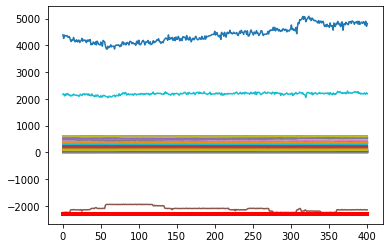

Predicción:  [[[0.9866111  0.01338889]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3083100e+01  1.1240500e+01  6.2092800e+01  7.8111500e+01
  6.0949080e+02  3.2560400e+01  9.5077000e+00  1.8996330e+02
  1.2941000e+00  6.9410200e+01  1.2477910e+02  1.0076900e+01
  6.5929600e+01  1.7616130e+02  2.2924700e+01  1.4112850e+02
  1.8901370e+02  7.0665100e+01 -4.0000000e-04  3.8945000e+00
  1.2612700e+01  7.3150000e+00  1.4987000e+00  7.3319700e+01
  1.4846000e+00  1.5480000e+00  8.7778700e+01  6.0575800e+01
  1.3486000e+00  1.2404000e+00  1.6501000e+00  1.4029000e+00
  1.6302690e+02  8.3790000e-01  8.3990000e-01 -2.1534795e+03
  2.0536600e+02  1.6357000e+00  1.4093000e+00  2.2261289e+03
  4.7192940e+03  1.8481450e+02  1.4312000e+00  1.4274000e+00
  7.8985000e+00  7.4967000e+00  1.7766000e+00  1.2640000e-01
  2.8168400e+01  5.3766440e+02  5.2385620e+02  5.1969790e+02
  5.2008750e+02  5.2056600e+02  2.7964500e+01  2.94

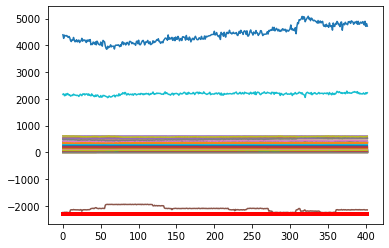

Predicción:  [[[0.98378074 0.01621923]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3278900e+01  1.1246500e+01  6.1494900e+01  7.8585400e+01
  6.1005870e+02  3.2103000e+01  9.5356000e+00  1.9001970e+02
  9.3000000e-01  6.9611800e+01  1.2502860e+02  9.9613000e+00
  6.7194200e+01  1.7593430e+02  2.2910700e+01  1.4007280e+02
  1.8893330e+02  7.0932800e+01 -4.0000000e-04  3.8903000e+00
  1.2528700e+01  7.3042000e+00  1.5014000e+00  7.3335600e+01
  1.4738000e+00  1.5408000e+00  8.9183000e+01  6.1088500e+01
  1.3383000e+00  1.2300000e+00  1.6422000e+00  1.3948000e+00
  1.6122760e+02  8.3760000e-01  8.3950000e-01 -2.1460813e+03
  2.0845520e+02  1.6293000e+00  1.3994000e+00  2.2201572e+03
  4.8392706e+03  1.8481450e+02  1.4238000e+00  1.4237000e+00
  7.9042000e+00  7.5009000e+00  1.7696000e+00  1.2740000e-01
  2.8679200e+01  5.3793340e+02  5.2388090e+02  5.1975430e+02
  5.2017910e+02  5.2061210e+02  2.7948900e+01  2.95

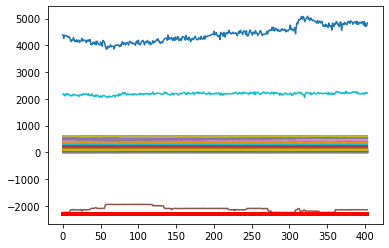

Predicción:  [[[0.9866888  0.01331125]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3126400e+01  1.1214700e+01  6.1431400e+01  7.7630800e+01
  6.0989550e+02  3.1734800e+01  9.5481000e+00  1.8998040e+02
  9.1990000e-01  6.9529900e+01  1.2481340e+02  1.0026800e+01
  6.7004900e+01  1.7630270e+02  2.2809000e+01  1.4083750e+02
  1.8896440e+02  7.0877300e+01 -4.0000000e-04  3.9004000e+00
  1.4158900e+01  7.2949000e+00  1.4987000e+00  7.3319700e+01
  1.4711000e+00  1.5361000e+00  8.8694700e+01  6.0578100e+01
  1.3350000e+00  1.2276000e+00  1.6392000e+00  1.3886000e+00
  1.6050470e+02  8.3800000e-01  8.3950000e-01 -2.1507958e+03
  2.0942120e+02  1.6243000e+00  1.3958000e+00  2.2277734e+03
  4.7345710e+03  1.8481450e+02  1.4177000e+00  1.4158000e+00
  7.9012000e+00  7.4991000e+00  1.7656000e+00  1.2640000e-01
  2.9190500e+01  5.3796450e+02  5.2339370e+02  5.1935940e+02
  5.1971360e+02  5.2013640e+02  2.7899800e+01  2.94

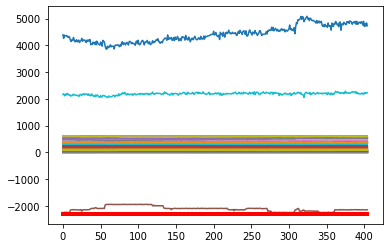

Predicción:  [[[0.9839191  0.01608085]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3156200e+01  1.1155700e+01  6.2371800e+01  7.7694600e+01
  6.1116730e+02  3.1611300e+01  9.5444000e+00  1.9003190e+02
  1.0263000e+00  6.9718400e+01  1.2500360e+02  9.9283000e+00
  6.7053800e+01  1.7581800e+02  2.2845000e+01  1.4086410e+02
  1.8900570e+02  7.0832200e+01 -4.0000000e-04  3.9138000e+00
  1.2877400e+01  7.3053000e+00  1.4980000e+00  7.3358600e+01
  1.4843000e+00  1.5465000e+00  8.7258100e+01  6.0421300e+01
  1.3494000e+00  1.2422000e+00  1.6502000e+00  1.4024000e+00
  1.6032090e+02  8.3800000e-01  8.4000000e-01 -2.1543000e+03
  2.0877760e+02  1.6336000e+00  1.4097000e+00  2.2168302e+03
  4.7777114e+03  1.8481450e+02  1.4310000e+00  1.4310000e+00
  7.8961000e+00  7.4985000e+00  1.7782000e+00  1.2800000e-01
  2.8499000e+01  5.3818440e+02  5.2348950e+02  5.1955320e+02
  5.1994750e+02  5.2038690e+02  2.7952700e+01  2.94

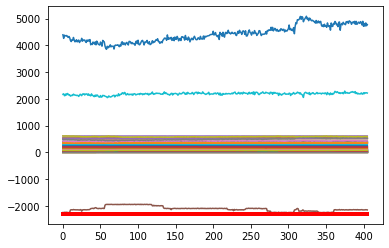

Predicción:  [[[0.98566365 0.01433632]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3280100e+01  1.1418100e+01  6.0270000e+01  7.9034300e+01
  6.1081760e+02  3.1564700e+01  9.5648000e+00  1.9001630e+02
  1.2113000e+00  6.9981000e+01  1.2506730e+02  9.9271000e+00
  6.7253200e+01  1.7609680e+02  2.3110800e+01  1.4117220e+02
  1.8926040e+02  7.0873700e+01 -4.0000000e-04  3.9059000e+00
  1.2463900e+01  7.3089000e+00  1.5012000e+00  7.3294600e+01
  1.4728000e+00  1.5377000e+00  8.7921200e+01  6.0259600e+01
  1.3376000e+00  1.2298000e+00  1.6418000e+00  1.3904000e+00
  1.6065830e+02  8.3800000e-01  8.3980000e-01 -2.1493724e+03
  2.0848280e+02  1.6263000e+00  1.3980000e+00  2.2167139e+03
  4.7346607e+03  1.8481450e+02  1.4192000e+00  1.4208000e+00
  7.9017000e+00  7.5003000e+00  1.7690000e+00  1.2700000e-01
  2.8698400e+01  5.3770000e+02  5.2394100e+02  5.1975860e+02
  5.2026740e+02  5.2055930e+02  2.7871300e+01  2.94

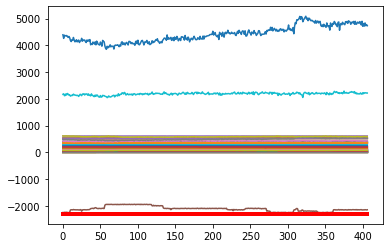

Predicción:  [[[0.9838378  0.01616227]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3375800e+01  1.1527500e+01  6.1099000e+01  7.7701700e+01
  6.1047240e+02  3.1191200e+01  9.5974000e+00  1.9013220e+02
  1.2421000e+00  6.9718000e+01  1.2506390e+02  9.8579000e+00
  6.6798700e+01  1.7699940e+02  2.3113200e+01  1.4177230e+02
  1.8936430e+02  7.0725000e+01 -4.0000000e-04  3.9155000e+00
  1.3758500e+01  7.3004000e+00  1.4993000e+00  7.3293800e+01
  1.4797000e+00  1.5443000e+00  8.7791700e+01  6.0072100e+01
  1.3425000e+00  1.2374000e+00  1.6463000e+00  1.3972000e+00
  1.5996350e+02  8.3830000e-01  8.4070000e-01 -2.1506955e+03
  2.0602120e+02  1.6323000e+00  1.4027000e+00  2.1920552e+03
  4.6998393e+03  1.8481450e+02  1.4277000e+00  1.4245000e+00
  7.9008000e+00  7.5045000e+00  1.7758000e+00  1.2940000e-01
  3.0336000e+01  5.3618450e+02  5.2327390e+02  5.1919810e+02
  5.1972980e+02  5.2000980e+02  2.8246800e+01  2.95

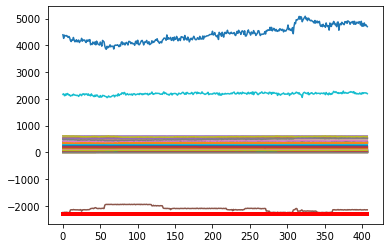

Predicción:  [[[0.98274994 0.01725006]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3932700e+01  1.1718100e+01  6.0233500e+01  7.8308700e+01
  6.1007610e+02  3.1764500e+01  9.6265000e+00  1.9005980e+02
  1.0847000e+00  6.9834000e+01  1.2516630e+02  1.0064500e+01
  6.6569500e+01  1.7644330e+02  2.3496100e+01  1.4082910e+02
  1.8961770e+02  7.0937800e+01 -4.0000000e-04  3.8833000e+00
  1.2207500e+01  7.3019000e+00  1.5004000e+00  7.3249500e+01
  1.4808000e+00  1.5464000e+00  8.8528000e+01  5.9571300e+01
  1.3416000e+00  1.2370000e+00  1.6469000e+00  1.4002000e+00
  1.6110530e+02  8.3840000e-01  8.4010000e-01 -2.1532030e+03
  2.0897110e+02  1.6353000e+00  1.4018000e+00  2.2572213e+03
  4.7584279e+03  1.8481450e+02  1.4308000e+00  1.4287000e+00
  7.8987000e+00  7.4974000e+00  1.7766000e+00  1.2970000e-01
  3.0320000e+01  5.3708220e+02  5.2351870e+02  5.1958800e+02
  5.2009140e+02  5.2039300e+02  2.8556700e+01  3.00

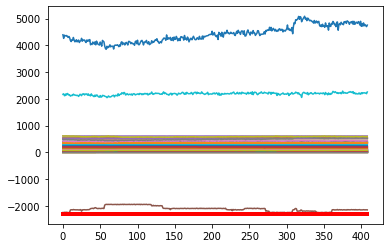

Predicción:  [[[0.9848571  0.01514296]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3586000e+01  1.1668800e+01  6.1466600e+01  7.8201700e+01
  6.1052170e+02  3.1357600e+01  9.6017000e+00  1.9004440e+02
  9.3120000e-01  6.9604800e+01  1.2513880e+02  9.9321000e+00
  6.6890200e+01  1.7670870e+02  2.3320100e+01  1.3906290e+02
  1.8944660e+02  7.0708300e+01 -4.0000000e-04  3.8840000e+00
  1.2818300e+01  7.2974000e+00  1.4985000e+00  7.3299400e+01
  1.4855000e+00  1.5514000e+00  8.7690200e+01  5.9889300e+01
  1.3518000e+00  1.2400000e+00  1.6485000e+00  1.3997000e+00
  1.6289730e+02  8.3740000e-01  8.3910000e-01 -2.1523173e+03
  2.0734960e+02  1.6394000e+00  1.4114000e+00  2.2372746e+03
  4.7927223e+03  1.8481450e+02  1.4309000e+00  1.4248000e+00
  7.8975000e+00  7.5005000e+00  1.7799000e+00  1.3150000e-01
  3.1491400e+01  5.3805110e+02  5.2394610e+02  5.1960310e+02
  5.2025130e+02  5.2046540e+02  2.8505900e+01  3.00

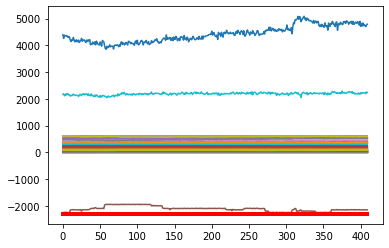

Predicción:  [[[0.9858196  0.01418042]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3923800e+01  1.1714300e+01  6.0307100e+01  7.8483700e+01
  6.1013150e+02  3.0972400e+01  9.6054000e+00  1.8994990e+02
  5.6380000e-01  6.9723500e+01  1.2512230e+02  9.9682000e+00
  6.6593100e+01  1.7554640e+02  2.3359000e+01  1.3930830e+02
  1.8934910e+02  7.0788100e+01 -4.0000000e-04  3.8960000e+00
  1.2376300e+01  7.3123000e+00  1.5000000e+00  7.3317000e+01
  1.4893000e+00  1.5542000e+00  8.8077200e+01  5.9902100e+01
  1.3523000e+00  1.2432000e+00  1.6548000e+00  1.4044000e+00
  1.6376670e+02  8.3900000e-01  8.4080000e-01 -2.1617374e+03
  2.0928070e+02  1.6419000e+00  1.4124000e+00  2.2067031e+03
  4.6697582e+03  1.8481450e+02  1.4367000e+00  1.4293000e+00
  7.8998000e+00  7.5028000e+00  1.7850000e+00  1.3040000e-01
  3.2803200e+01  5.3819770e+02  5.2379550e+02  5.1970140e+02
  5.2026060e+02  5.2048500e+02  2.8279000e+01  2.96

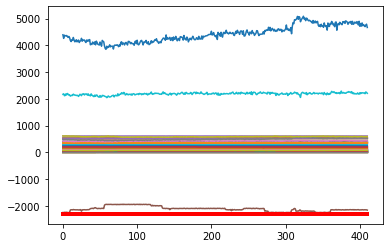

Predicción:  [[[0.98294985 0.01705017]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3580100e+01  1.1776800e+01  6.0023700e+01  7.8045200e+01
  6.1017940e+02  3.0903000e+01  9.6039000e+00  1.9010270e+02
  5.1120000e-01  6.9078000e+01  1.2502180e+02  1.0217000e+01
  6.7790800e+01  1.7554520e+02  2.3328300e+01  1.3870720e+02
  1.8935990e+02  7.0880500e+01 -4.0000000e-04  3.9071000e+00
  1.3850400e+01  7.3121000e+00  1.5008000e+00  7.3306200e+01
  1.4726000e+00  1.5381000e+00  8.8157300e+01  6.0148200e+01
  1.3365000e+00  1.2260000e+00  1.6363000e+00  1.3889000e+00
  1.6457280e+02  8.3730000e-01  8.3980000e-01 -2.1449579e+03
  2.0668450e+02  1.6256000e+00  1.3970000e+00  2.2114946e+03
  4.7015170e+03  1.8481450e+02  1.4231000e+00  1.4130000e+00
  7.8980000e+00  7.4999000e+00  1.7679000e+00  1.3150000e-01
  3.4200300e+01  5.3712000e+02  5.2342830e+02  5.1890500e+02
  5.1931610e+02  5.1964730e+02  2.8232300e+01  2.96

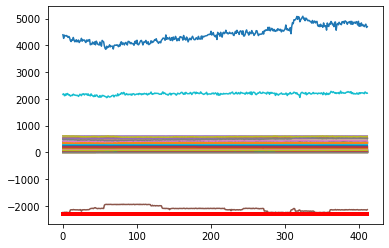

Predicción:  [[[0.98201895 0.01798109]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3529400e+01  1.1730200e+01  6.0672500e+01  7.7905400e+01
  6.1017730e+02  3.0942700e+01  9.6042000e+00  1.8998990e+02
  5.2100000e-01  6.9138800e+01  1.2484390e+02  9.8111000e+00
  6.6953500e+01  1.7468500e+02  2.3133400e+01  1.3886240e+02
  1.8945070e+02  7.0537400e+01 -4.0000000e-04  3.8975000e+00
  1.2755100e+01  7.3249000e+00  1.5002000e+00  7.3218200e+01
  1.4883000e+00  1.5545000e+00  8.6846600e+01  5.9735400e+01
  1.3536000e+00  1.2431000e+00  1.6515000e+00  1.4029000e+00
  1.6422770e+02  8.3840000e-01  8.4010000e-01 -2.1642812e+03
  2.0433700e+02  1.6421000e+00  1.4130000e+00  2.2400149e+03
  4.7702086e+03  1.8481450e+02  1.4353000e+00  1.4273000e+00
  7.8985000e+00  7.4979000e+00  1.7805000e+00  1.2910000e-01
  3.2857800e+01  5.3692900e+02  5.2307400e+02  5.1901010e+02
  5.1937130e+02  5.1982220e+02  2.8151200e+01  2.95

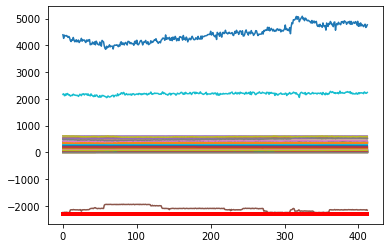

Predicción:  [[[0.9863077  0.01369235]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3698900e+01  1.1806200e+01  5.9921000e+01  7.9325000e+01
  6.1009270e+02  3.0211600e+01  9.6171000e+00  1.8998280e+02
  3.8800000e-01  6.9404300e+01  1.2505800e+02  1.0240700e+01
  6.6648900e+01  1.7426240e+02  2.3409500e+01  1.3940010e+02
  1.8941850e+02  7.0622400e+01 -4.0000000e-04  3.9226000e+00
  1.1563000e+01  7.2925000e+00  1.4996000e+00  7.3271400e+01
  1.4884000e+00  1.5541000e+00  8.7833700e+01  5.9225500e+01
  1.3534000e+00  1.2417000e+00  1.6538000e+00  1.4029000e+00
  1.6429940e+02  8.3880000e-01  8.4020000e-01 -2.1508573e+03
  2.0773330e+02  1.6414000e+00  1.4131000e+00  2.2049831e+03
  4.7354041e+03  1.8481450e+02  1.4337000e+00  1.4274000e+00
  7.9041000e+00  7.4997000e+00  1.7817000e+00  1.2770000e-01
  3.1148700e+01  5.3813550e+02  5.2414430e+02  5.1985310e+02
  5.2021390e+02  5.2067910e+02  2.8113600e+01  2.95

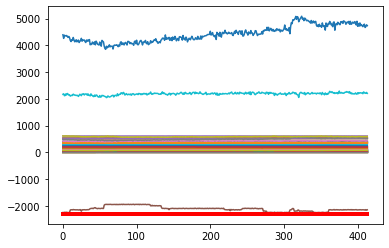

Predicción:  [[[0.98385954 0.01614039]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3091200e+01  1.1671800e+01  6.1195600e+01  7.8381600e+01
  6.1070040e+02  2.9875000e+01  9.6053000e+00  1.9006660e+02
  3.6620000e-01  6.9043800e+01  1.2496240e+02  1.0083300e+01
  6.7225300e+01  1.7449850e+02  2.3006300e+01  1.3866430e+02
  1.8929510e+02  7.0573600e+01 -4.0000000e-04  3.8991000e+00
  1.3088200e+01  7.3136000e+00  1.5001000e+00  7.3274900e+01
  1.4860000e+00  1.5512000e+00  8.8448900e+01  6.0062000e+01
  1.3491000e+00  1.2416000e+00  1.6489000e+00  1.4025000e+00
  1.6352790e+02  8.3950000e-01  8.4060000e-01 -2.1586838e+03
  2.0816460e+02  1.6392000e+00  1.4091000e+00  2.1883783e+03
  4.7344868e+03  1.8481450e+02  1.4340000e+00  1.4251000e+00
  7.8980000e+00  7.5011000e+00  1.7800000e+00  1.3100000e-01
  3.1693800e+01  5.3703330e+02  5.2347030e+02  5.1911240e+02
  5.1949260e+02  5.1997950e+02  2.8267100e+01  2.97

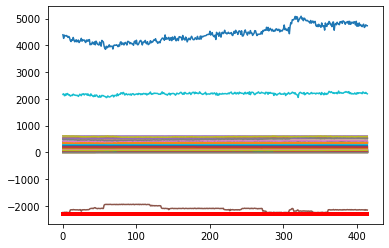

Predicción:  [[[0.98473513 0.01526488]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2972700e+01  1.1798700e+01  6.0517400e+01  7.8002600e+01
  6.0971800e+02  2.9271700e+01  9.5768000e+00  1.8995500e+02
  2.6080000e-01  6.9261200e+01  1.2506390e+02  9.8333000e+00
  6.6920400e+01  1.7325160e+02  2.2822100e+01  1.3714000e+02
  1.8942800e+02  7.0866800e+01 -4.0000000e-04  3.9012000e+00
  1.2049100e+01  7.3387000e+00  1.4984000e+00  7.3333600e+01
  1.4810000e+00  1.5458000e+00  8.7453800e+01  5.9978700e+01
  1.3491000e+00  1.2352000e+00  1.6463000e+00  1.3974000e+00
  1.6431850e+02  8.3930000e-01  8.4060000e-01 -2.1494070e+03
  2.0684350e+02  1.6326000e+00  1.4093000e+00  2.2376472e+03
  4.5913024e+03  1.8481450e+02  1.4272000e+00  1.4255000e+00
  7.8980000e+00  7.4921000e+00  1.7748000e+00  1.2830000e-01
  2.9924200e+01  5.3651560e+02  5.2378640e+02  5.1963680e+02
  5.1993900e+02  5.2038170e+02  2.8995700e+01  3.00

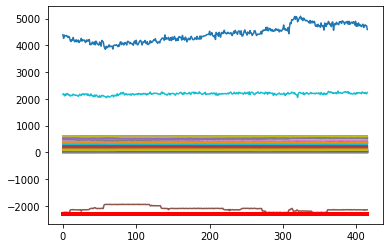

Predicción:  [[[0.9780638  0.02193619]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3089900e+01  1.1824700e+01  5.9773100e+01  7.7243300e+01
  6.1054080e+02  2.8891600e+01  9.5924000e+00  1.9004690e+02
  4.1000000e-01  6.9260600e+01  1.2495730e+02  1.0077200e+01
  6.6750900e+01  1.7336340e+02  2.0368400e+01  1.3568140e+02
  1.8941390e+02  7.0870600e+01 -4.0000000e-04  3.9019000e+00
  1.2693700e+01  7.2672000e+00  1.5005000e+00  7.3349000e+01
  1.4776000e+00  1.5466000e+00  8.8373200e+01  6.0615700e+01
  1.3449000e+00  1.2313000e+00  1.6426000e+00  1.3985000e+00
  1.6526640e+02  8.3410000e-01  8.3810000e-01 -2.1452653e+03
  2.0871400e+02  1.6343000e+00  1.4054000e+00  2.1782765e+03
  4.8043939e+03  1.8481450e+02  1.4273000e+00  1.4283000e+00
  7.9039000e+00  7.5060000e+00  1.7730000e+00  1.3050000e-01
  2.8718700e+01  5.3665330e+02  5.2391990e+02  5.1965580e+02
  5.1997000e+02  5.2038820e+02  2.8183700e+01  2.98

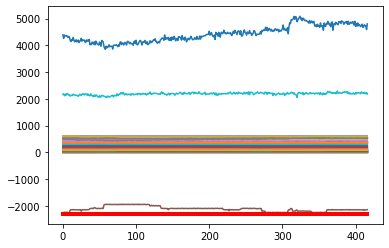

Predicción:  [[[0.9855563  0.01444367]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3059100e+01  1.1900600e+01  5.9734900e+01  7.9373700e+01
  6.1028720e+02  2.9852200e+01  9.6000000e+00  1.8997450e+02
  3.8970000e-01  6.8940300e+01  1.2497970e+02  9.9339000e+00
  6.6775900e+01  1.7411620e+02  2.1537500e+01  1.3431690e+02
  1.8944590e+02  7.0853600e+01 -4.0000000e-04  3.9046000e+00
  1.2769200e+01  7.2978000e+00  1.4983000e+00  7.3260900e+01
  1.4816000e+00  1.5479000e+00  8.7444500e+01  6.0509900e+01
  1.3458000e+00  1.2338000e+00  1.6450000e+00  1.3996000e+00
  1.6645750e+02  8.3820000e-01  8.4030000e-01 -2.1528182e+03
  2.0720130e+02  1.6358000e+00  1.4066000e+00  2.2162722e+03
  4.6582561e+03  1.8481450e+02  1.4283000e+00  1.4252000e+00
  7.8985000e+00  7.5032000e+00  1.7764000e+00  1.3180000e-01
  2.8610000e+01  5.3699990e+02  5.2341100e+02  5.1931210e+02
  5.1977960e+02  5.2013000e+02  2.8191500e+01  2.95

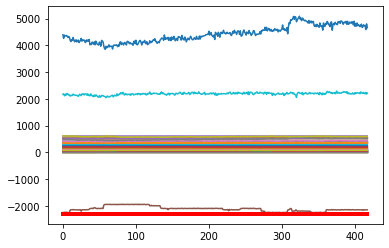

Predicción:  [[[0.9813679 0.0186321]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3135200e+01  1.1903600e+01  6.0612800e+01  7.9085000e+01
  6.0993390e+02  3.0960900e+01  9.5285000e+00  1.9003100e+02
  3.6840000e-01  6.9229000e+01  1.2487760e+02  1.0010100e+01
  6.7289400e+01  1.7636590e+02  2.2405800e+01  1.3520680e+02
  1.8939770e+02  7.0796200e+01 -4.0000000e-04  3.8736000e+00
  1.3340700e+01  7.3049000e+00  1.4995000e+00  7.3300400e+01
  1.4819000e+00  1.5494000e+00  8.8329200e+01  6.0881000e+01
  1.3488000e+00  1.2357000e+00  1.6423000e+00  1.4008000e+00
  1.6595480e+02  8.3850000e-01  8.3970000e-01 -2.1463267e+03
  2.0885550e+02  1.6377000e+00  1.4096000e+00  2.1649213e+03
  4.7329278e+03  1.8481450e+02  1.4311000e+00  1.4235000e+00
  7.8985000e+00  7.5010000e+00  1.7757000e+00  1.3340000e-01
  3.0243500e+01  5.3786680e+02  5.2384400e+02  5.1966920e+02
  5.2010220e+02  5.2040260e+02  2.8598000e+01  2.9822

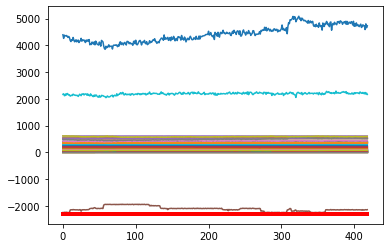

Predicción:  [[[0.98335695 0.0166431 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3250600e+01  1.1780900e+01  6.1247700e+01  7.7969300e+01
  6.1027730e+02  3.0745000e+01  9.5373000e+00  1.9004400e+02
  3.2640000e-01  6.9467600e+01  1.2473930e+02  1.0134800e+01
  6.6093400e+01  1.7619910e+02  2.2543800e+01  1.3677710e+02
  1.8928570e+02  7.0529600e+01 -4.0000000e-04  3.8135000e+00
  1.3106800e+01  7.3162000e+00  1.5002000e+00  7.3322800e+01
  1.4830000e+00  1.5516000e+00  8.8008300e+01  6.1642500e+01
  1.3475000e+00  1.2391000e+00  1.6415000e+00  1.4034000e+00
  1.6435640e+02  8.3850000e-01  8.4030000e-01 -2.1498647e+03
  2.0793500e+02  1.6402000e+00  1.4091000e+00  2.2085351e+03
  4.7126623e+03  1.8481450e+02  1.4361000e+00  1.4245000e+00
  7.9032000e+00  7.5001000e+00  1.7750000e+00  1.3380000e-01
  3.2591400e+01  5.3708220e+02  5.2342780e+02  5.1919950e+02
  5.1963680e+02  5.1991360e+02  2.8899900e+01  3.02

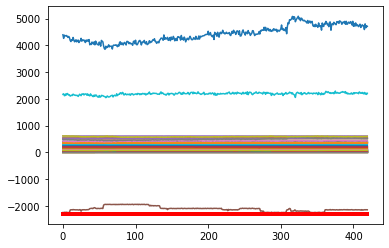

Predicción:  [[[0.98306364 0.01693635]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3491200e+01  1.1541900e+01  6.1605700e+01  7.9311200e+01
  6.1012080e+02  3.0278600e+01  9.4503000e+00  1.8986930e+02
  5.6150000e-01  6.9790100e+01  1.2495600e+02  9.9397000e+00
  6.6860600e+01  1.7414440e+02  2.2670300e+01  1.3754440e+02
  1.8902100e+02  7.0704000e+01 -4.0000000e-04  3.7891000e+00
  1.2211700e+01  7.3057000e+00  1.5005000e+00  7.3286100e+01
  1.4788000e+00  1.5482000e+00  8.6621900e+01  6.2300800e+01
  1.3411000e+00  1.2341000e+00  1.6389000e+00  1.3981000e+00
  1.6476790e+02  8.3860000e-01  8.4030000e-01 -2.1495874e+03
  2.0789670e+02  1.6354000e+00  1.4029000e+00  2.2708164e+03
  4.6294677e+03  1.8481450e+02  1.4321000e+00  1.4196000e+00
  7.8973000e+00  7.5017000e+00  1.7708000e+00  1.3160000e-01
  3.3999100e+01  5.3868000e+02  5.2354110e+02  5.1979460e+02
  5.2000360e+02  5.2030990e+02  2.8824400e+01  3.01

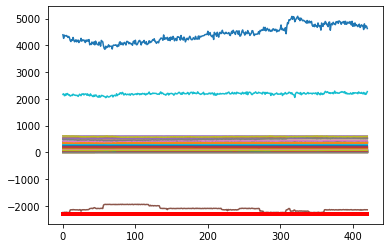

Predicción:  [[[0.9798188  0.02018117]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3052800e+01  1.1454300e+01  6.2191200e+01  7.8269300e+01
  6.1025320e+02  3.0650000e+01  9.4624000e+00  1.9004640e+02
  8.6130000e-01  6.9784600e+01  1.2465700e+02  1.0054000e+01
  6.6575900e+01  1.7388120e+02  2.1949300e+01  1.3650500e+02
  1.8895860e+02  7.0787900e+01 -4.0000000e-04  3.8030000e+00
  1.3086000e+01  7.2707000e+00  1.5004000e+00  7.3268000e+01
  1.4702000e+00  1.5390000e+00  8.7313300e+01  6.1537000e+01
  1.3362000e+00  1.2250000e+00  1.6309000e+00  1.3922000e+00
  1.6546780e+02  8.3820000e-01  8.3970000e-01 -2.1438307e+03
  2.0629010e+02  1.6266000e+00  1.3978000e+00  2.2526951e+03
  4.6940459e+03  1.8481450e+02  1.4262000e+00  1.4149000e+00
  7.9041000e+00  7.5010000e+00  1.7642000e+00  1.3350000e-01
  3.3870700e+01  5.3830440e+02  5.2338640e+02  5.1932490e+02
  5.1946440e+02  5.1980650e+02  2.8775200e+01  3.01

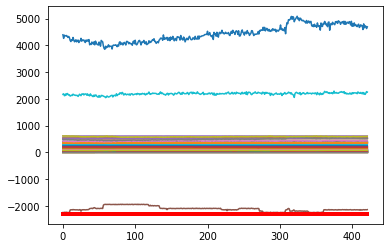

Predicción:  [[[0.9816457  0.01835437]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2685400e+01  1.1435900e+01  6.2461300e+01  7.8188300e+01
  6.0995780e+02  3.0355300e+01  9.3990000e+00  1.9008620e+02
  1.0711000e+00  7.0111100e+01  1.2496140e+02  1.0163700e+01
  6.6562900e+01  1.7449840e+02  2.2211800e+01  1.3536490e+02
  1.8900260e+02  7.0893900e+01 -4.0000000e-04  3.7945000e+00
  1.3716400e+01  7.2967000e+00  1.4991000e+00  7.3323000e+01
  1.4733000e+00  1.5435000e+00  8.6873000e+01  6.2683100e+01
  1.3369000e+00  1.2278000e+00  1.6337000e+00  1.3928000e+00
  1.6586790e+02  8.3840000e-01  8.4000000e-01 -2.1484442e+03
  2.0886260e+02  1.6311000e+00  1.3992000e+00  2.2208012e+03
  4.7114999e+03  1.8481450e+02  1.4268000e+00  1.4149000e+00
  7.8991000e+00  7.5005000e+00  1.7672000e+00  1.3360000e-01
  3.4210300e+01  5.3783330e+02  5.2312630e+02  5.1923320e+02
  5.1935460e+02  5.1973220e+02  2.8573600e+01  2.99

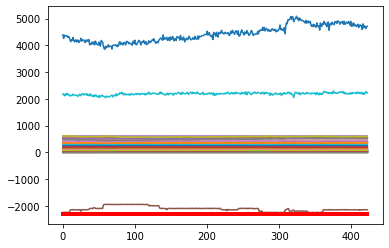

Predicción:  [[[0.9828478  0.01715224]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2608000e+01  1.1688600e+01  6.2153300e+01  7.8760800e+01
  6.1027880e+02  3.0377000e+01  9.3404000e+00  1.9009700e+02
  1.1726000e+00  7.0710900e+01  1.2511220e+02  1.0067200e+01
  6.6194600e+01  1.7423040e+02  2.2413800e+01  1.3425250e+02
  1.8918020e+02  7.0823500e+01 -4.0000000e-04  3.6556000e+00
  1.2786300e+01  7.3314000e+00  1.5012000e+00  7.3271600e+01
  1.4762000e+00  1.5455000e+00  8.6746600e+01  6.1568600e+01
  1.3405000e+00  1.2311000e+00  1.6368000e+00  1.3967000e+00
  1.6563390e+02  8.3540000e-01  8.4030000e-01 -2.1540909e+03
  2.0925590e+02  1.6324000e+00  1.4021000e+00  2.2005017e+03
  4.7423570e+03  1.8481450e+02  1.4299000e+00  1.4217000e+00
  7.8976000e+00  7.5012000e+00  1.7687000e+00  1.3180000e-01
  3.3032400e+01  5.3819560e+02  5.2361020e+02  5.1953670e+02
  5.1972090e+02  5.2021210e+02  2.8382200e+01  2.97

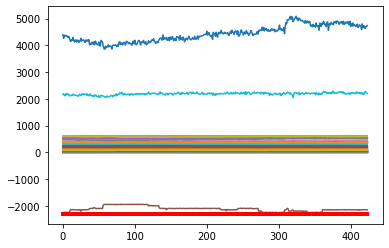

Predicción:  [[[0.9844908  0.01550917]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2796800e+01  1.1820300e+01  6.2084800e+01  7.8470500e+01
  6.1173120e+02  3.0438700e+01  9.3036000e+00  1.9003680e+02
  6.9710000e-01  7.0607000e+01  1.2488750e+02  9.9864000e+00
  6.6382900e+01  1.7559960e+02  2.2338500e+01  1.3411790e+02
  1.8934990e+02  7.1107500e+01 -4.0000000e-04  3.5950000e+00
  1.3445200e+01  7.2854000e+00  1.5012000e+00  7.3295400e+01
  1.4698000e+00  1.5396000e+00  8.7064200e+01  6.2449100e+01
  1.3307000e+00  1.2245000e+00  1.6278000e+00  1.3904000e+00
  1.6505130e+02  8.3450000e-01  8.4050000e-01 -2.1441068e+03
  2.0766170e+02  1.6277000e+00  1.3936000e+00  2.1972832e+03
  4.7693910e+03  1.8481450e+02  1.4248000e+00  1.4139000e+00
  7.9020000e+00  7.4996000e+00  1.7640000e+00  1.3610000e-01
  3.4347100e+01  5.3820000e+02  5.2341470e+02  5.1938480e+02
  5.1975940e+02  5.2019940e+02  2.8176800e+01  2.96

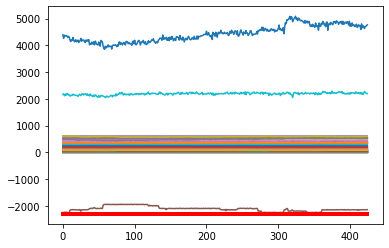

Predicción:  [[[0.9843758  0.01562425]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2757600e+01  1.1855700e+01  6.1149900e+01  7.8148100e+01
  6.1051610e+02  3.0559400e+01  9.2315000e+00  1.9005870e+02
  8.1030000e-01  7.0754300e+01  1.2522790e+02  1.0019200e+01
  6.6814100e+01  1.7512770e+02  2.2519900e+01  1.3355000e+02
  1.8938760e+02  7.0867300e+01 -4.0000000e-04  3.5987000e+00
  1.3592700e+01  7.2795000e+00  1.4994000e+00  7.3330100e+01
  1.4725000e+00  1.5400000e+00  8.6614300e+01  6.2302300e+01
  1.3359000e+00  1.2283000e+00  1.6283000e+00  1.3920000e+00
  1.6446500e+02  8.3480000e-01  8.4010000e-01 -2.1482593e+03
  2.0903140e+02  1.6268000e+00  1.3981000e+00  2.2173080e+03
  4.7308036e+03  1.8481450e+02  1.4260000e+00  1.4180000e+00
  7.8994000e+00  7.4988000e+00  1.7647000e+00  1.3640000e-01
  3.4073200e+01  5.3807100e+02  5.2343610e+02  5.1943160e+02
  5.1987520e+02  5.2018040e+02  2.8170700e+01  2.94

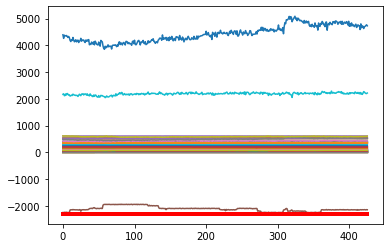

Predicción:  [[[0.9835323  0.01646772]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2642100e+01  1.1933400e+01  6.0883300e+01  7.7477000e+01
  6.0944540e+02  3.0034100e+01  9.2623000e+00  1.9001950e+02
  5.8010000e-01  7.0766700e+01  1.2511740e+02  9.8712000e+00
  6.6892100e+01  1.7429300e+02  2.2611600e+01  1.3342680e+02
  1.8941130e+02  7.1181100e+01 -4.0000000e-04  3.5934000e+00
  1.3883100e+01  7.3293000e+00  1.5022000e+00  7.3320100e+01
  1.4683000e+00  1.5354000e+00  8.5707700e+01  6.3952400e+01
  1.3295000e+00  1.2251000e+00  1.6248000e+00  1.3866000e+00
  1.6207730e+02  8.3780000e-01  8.4010000e-01 -2.1520864e+03
  2.0833960e+02  1.6214000e+00  1.3930000e+00  2.2481607e+03
  4.6819258e+03  1.8481450e+02  1.4188000e+00  1.4148000e+00
  7.8984000e+00  7.4993000e+00  1.7577000e+00  1.3290000e-01
  3.2316100e+01  5.3623340e+02  5.2304400e+02  5.1901770e+02
  5.1949740e+02  5.1958380e+02  2.8525400e+01  2.97

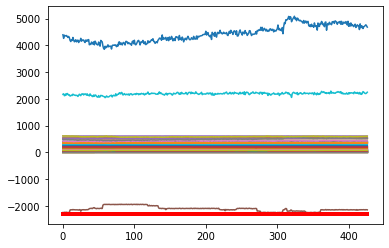

Predicción:  [[[0.98224014 0.01775987]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2710800e+01  1.1904400e+01  6.0927800e+01  7.7343700e+01
  6.0957260e+02  3.0838100e+01  9.3474000e+00  1.8996780e+02
  3.3810000e-01  7.0782000e+01  1.2487740e+02  1.0025600e+01
  6.6606600e+01  1.7424130e+02  2.2917000e+01  1.3362060e+02
  1.8954240e+02  7.1156700e+01 -4.0000000e-04  3.5979000e+00
  1.3329600e+01  7.3009000e+00  1.5009000e+00  7.3323200e+01
  1.4727000e+00  1.5423000e+00  8.4640300e+01  6.2824200e+01
  1.3331000e+00  1.2270000e+00  1.6245000e+00  1.3915000e+00
  1.6460930e+02  8.3760000e-01  8.4020000e-01 -2.1492188e+03
  2.1222010e+02  1.6271000e+00  1.3960000e+00  2.2118227e+03
  4.7318800e+03  1.8481450e+02  1.4236000e+00  1.4180000e+00
  7.8986000e+00  7.4992000e+00  1.7612000e+00  1.3670000e-01
  3.2118900e+01  5.3671560e+02  5.2331650e+02  5.1923980e+02
  5.1983710e+02  5.1977130e+02  2.8612200e+01  2.99

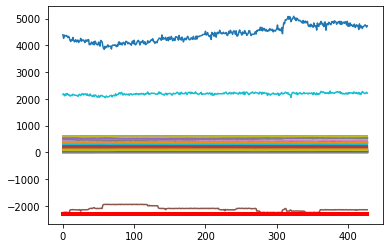

Predicción:  [[[0.98364395 0.01635605]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2947000e+01  1.1682600e+01  6.0601100e+01  7.7128100e+01
  6.0976070e+02  3.2512600e+01  9.3226000e+00  1.8996140e+02
  6.2140000e-01  7.0485200e+01  1.2499710e+02  1.0092500e+01
  6.7323800e+01  1.7691970e+02  2.2786400e+01  1.3481400e+02
  1.8948060e+02  7.0977400e+01 -4.0000000e-04  3.6054000e+00
  1.3969200e+01  7.2875000e+00  1.4995000e+00  7.3311300e+01
  1.4671000e+00  1.5339000e+00  8.6677100e+01  6.1813900e+01
  1.3297000e+00  1.2225000e+00  1.6150000e+00  1.3859000e+00
  1.6456030e+02  8.3520000e-01  8.4000000e-01 -2.1537198e+03
  2.0967820e+02  1.6206000e+00  1.3910000e+00  2.1758531e+03
  4.6083130e+03  1.8481450e+02  1.4210000e+00  1.4144000e+00
  7.8992000e+00  7.4999000e+00  1.7549000e+00  1.3980000e-01
  3.5112400e+01  5.3636880e+02  5.2288360e+02  5.1888120e+02
  5.1928750e+02  5.1937960e+02  2.8482800e+01  2.97

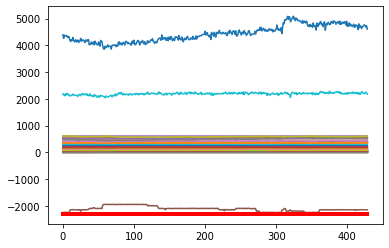

Predicción:  [[[0.9796317  0.02036829]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3334800e+01  1.1607000e+01  6.2317400e+01  7.6927300e+01
  6.1096190e+02  3.2372900e+01  9.3094000e+00  1.8993770e+02
  9.5190000e-01  7.0099300e+01  1.2483370e+02  9.9150000e+00
  6.6929000e+01  1.7636530e+02  2.2976600e+01  1.3576950e+02
  1.8963180e+02  7.0917000e+01 -4.0000000e-04  3.6009000e+00
  1.4241000e+01  7.3110000e+00  1.5004000e+00  7.3302500e+01
  1.4689000e+00  1.5346000e+00  8.7310700e+01  6.1682300e+01
  1.3318000e+00  1.2235000e+00  1.6149000e+00  1.3866000e+00
  1.6549280e+02  8.3540000e-01  8.4010000e-01 -2.1519744e+03
  2.0757970e+02  1.6210000e+00  1.3933000e+00  2.1854640e+03
  4.6567338e+03  1.8481450e+02  1.4221000e+00  1.4141000e+00
  7.9027000e+00  7.4941000e+00  1.7569000e+00  1.4140000e-01
  3.5557800e+01  5.3698220e+02  5.2283620e+02  5.1909430e+02
  5.1933380e+02  5.1946910e+02  2.8459900e+01  2.97

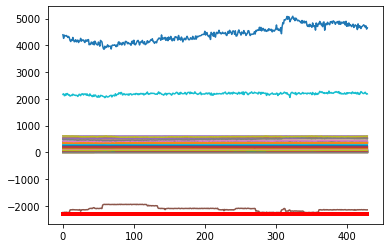

Predicción:  [[[0.9813362  0.01866383]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3850800e+01  1.1523400e+01  6.1761900e+01  7.7689600e+01
  6.0923610e+02  3.2825200e+01  9.3031000e+00  1.8996030e+02
  1.2245000e+00  6.9020800e+01  1.2488710e+02  9.9917000e+00
  6.6796200e+01  1.7440430e+02  2.2959600e+01  1.3531510e+02
  1.8961850e+02  7.0844600e+01 -4.0000000e-04  3.6110000e+00
  1.2808400e+01  7.3278000e+00  1.5008000e+00  7.3308100e+01
  1.4819000e+00  1.5456000e+00  8.6660800e+01  6.0619600e+01
  1.3437000e+00  1.2352000e+00  1.6314000e+00  1.3976000e+00
  1.6670930e+02  8.3510000e-01  8.4020000e-01 -2.1537954e+03
  2.0661150e+02  1.6316000e+00  1.4044000e+00  2.2734026e+03
  4.5854466e+03  1.8481450e+02  1.4337000e+00  1.4254000e+00
  7.8987000e+00  7.4993000e+00  1.7689000e+00  1.3760000e-01
  3.6384400e+01  5.3864670e+02  5.2348410e+02  5.1985990e+02
  5.1994510e+02  5.2003540e+02  2.8427900e+01  2.98

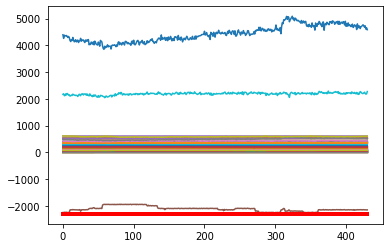

Predicción:  [[[0.97842854 0.02157146]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3518700e+01  1.1418200e+01  6.1008800e+01  7.8290500e+01
  6.1061360e+02  3.2187100e+01  9.2302000e+00  1.8998310e+02
  1.2924000e+00  6.8980200e+01  1.2493230e+02  1.0080700e+01
  6.6649200e+01  1.7444690e+02  2.2571500e+01  1.3559820e+02
  1.8933700e+02  7.1219400e+01 -4.0000000e-04  3.5971000e+00
  1.3144200e+01  7.2979000e+00  1.4998000e+00  7.3292000e+01
  1.4730000e+00  1.5421000e+00  8.7812100e+01  6.1664000e+01
  1.3350000e+00  1.2251000e+00  1.6282000e+00  1.3935000e+00
  1.6732240e+02  8.3740000e-01  8.3990000e-01 -2.1488343e+03
  2.0913900e+02  1.6292000e+00  1.3965000e+00  2.2008181e+03
  4.7951589e+03  1.8481450e+02  1.4300000e+00  1.4190000e+00
  7.9009000e+00  7.4998000e+00  1.7630000e+00  1.3460000e-01
  3.6544400e+01  5.3858220e+02  5.2386930e+02  5.2042140e+02
  5.2043900e+02  5.2051770e+02  2.8416600e+01  2.97

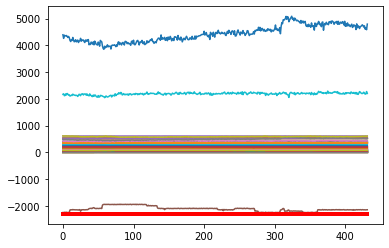

Predicción:  [[[0.9856468  0.01435323]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3575400e+01  1.1449500e+01  6.1061400e+01  7.7407800e+01
  6.1022650e+02  3.1551900e+01  9.2182000e+00  1.9009160e+02
  1.3679000e+00  6.8654300e+01  1.2500750e+02  1.0079800e+01
  6.7262900e+01  1.7336940e+02  2.2234600e+01  1.3494880e+02
  1.8930010e+02  7.0937300e+01 -4.0000000e-04  3.5982000e+00
  1.2957300e+01  7.2903000e+00  1.4994000e+00  7.3278200e+01
  1.4768000e+00  1.5463000e+00  8.6877600e+01  6.2151400e+01
  1.3377000e+00  1.2296000e+00  1.6301000e+00  1.3982000e+00
  1.6600360e+02  8.3700000e-01  8.3960000e-01 -2.1409623e+03
  2.0964960e+02  1.6343000e+00  1.3999000e+00  2.2347813e+03
  4.7795055e+03  1.8481450e+02  1.4346000e+00  1.4215000e+00
  7.8995000e+00  7.5014000e+00  1.7673000e+00  1.3750000e-01
  3.6475400e+01  5.3782360e+02  5.2329260e+02  5.1959890e+02
  5.1967170e+02  5.1973870e+02  2.8462000e+01  2.97

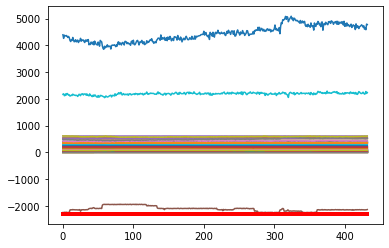

Predicción:  [[[0.9843647  0.01563535]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3428100e+01  1.1402600e+01  6.0444500e+01  7.8368800e+01
  6.0887580e+02  3.1687600e+01  9.2662000e+00  1.9002120e+02
  1.4154000e+00  6.8587500e+01  1.2483270e+02  9.9051000e+00
  6.7140800e+01  1.7375200e+02  2.2290700e+01  1.3518030e+02
  1.8935040e+02  7.1098200e+01 -4.0000000e-04  3.5782000e+00
  1.2521500e+01  7.3054000e+00  1.4999000e+00  7.3329200e+01
  1.4800000e+00  1.5507000e+00  8.7678200e+01  6.2083500e+01
  1.3423000e+00  1.2330000e+00  1.6343000e+00  1.4018000e+00
  1.6642980e+02  8.3800000e-01  8.3980000e-01 -2.1449567e+03
  2.0927850e+02  1.6383000e+00  1.4041000e+00  2.2098036e+03
  4.7395448e+03  1.8481450e+02  1.4386000e+00  1.4258000e+00
  7.9020000e+00  7.4998000e+00  1.7698000e+00  1.3540000e-01
  3.6680300e+01  5.3786190e+02  5.2338330e+02  5.1982010e+02
  5.2006860e+02  5.2009290e+02  2.8438000e+01  2.96

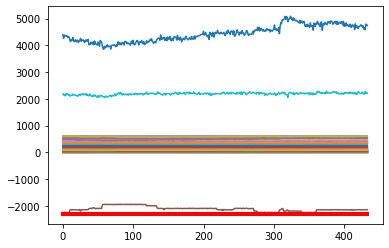

Predicción:  [[[0.983487   0.01651301]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3558800e+01  1.1461400e+01  5.9815100e+01  7.8054900e+01
  6.1004150e+02  3.2200500e+01  9.2535000e+00  1.8997540e+02
  1.5726000e+00  6.8445400e+01  1.2516750e+02  9.7447000e+00
  6.6302600e+01  1.7474970e+02  2.2338000e+01  1.3569190e+02
  1.8932200e+02  7.1097500e+01 -4.0000000e-04  3.5971000e+00
  1.3585400e+01  7.2841000e+00  1.4995000e+00  7.3251700e+01
  1.4738000e+00  1.5392000e+00  8.6984200e+01  6.1660600e+01
  1.3350000e+00  1.2260000e+00  1.6222000e+00  1.3905000e+00
  1.6643640e+02  8.3800000e-01  8.3990000e-01 -2.1495169e+03
  2.0807370e+02  1.6262000e+00  1.3968000e+00  2.1532552e+03
  4.6121058e+03  1.8481450e+02  1.4271000e+00  1.4157000e+00
  7.8995000e+00  7.5041000e+00  1.7628000e+00  1.4030000e-01
  3.6716800e+01  5.3804070e+02  5.2365700e+02  5.1991050e+02
  5.2006700e+02  5.2012010e+02  2.8334100e+01  2.96

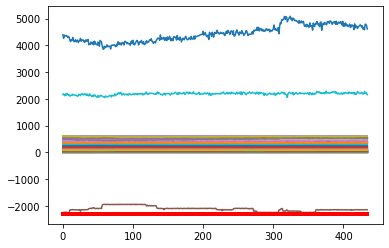

Predicción:  [[[0.9792411  0.02075887]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3021400e+01  1.1638400e+01  5.9947500e+01  7.6550600e+01
  6.1005710e+02  3.2382200e+01  9.2742000e+00  1.8989980e+02
  1.6560000e+00  6.8856800e+01  1.2501380e+02  9.7994000e+00
  6.6404000e+01  1.7464740e+02  2.2345300e+01  1.3502370e+02
  1.8945070e+02  7.0981500e+01 -4.0000000e-04  3.5989000e+00
  1.3808200e+01  7.3126000e+00  1.5019000e+00  7.3304400e+01
  1.4752000e+00  1.5402000e+00  8.7421500e+01  6.2800900e+01
  1.3344000e+00  1.2275000e+00  1.6243000e+00  1.3936000e+00
  1.6600580e+02  8.3810000e-01  8.4020000e-01 -2.1536992e+03
  2.0812510e+02  1.6277000e+00  1.3970000e+00  2.1973580e+03
  4.6820610e+03  1.8481450e+02  1.4301000e+00  1.4180000e+00
  7.8968000e+00  7.4924000e+00  1.7637000e+00  1.3950000e-01
  3.6539500e+01  5.3763330e+02  5.2322160e+02  5.1983430e+02
  5.1993810e+02  5.1995240e+02  2.8470700e+01  2.97

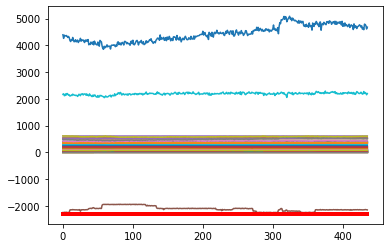

Predicción:  [[[0.9824493  0.01755072]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3024700e+01  1.1578900e+01  6.1131600e+01  7.7142800e+01
  6.1009470e+02  3.3113600e+01  9.2705000e+00  1.8992900e+02
  1.3157000e+00  6.9826000e+01  1.2505820e+02  9.8384000e+00
  6.7323800e+01  1.7641210e+02  2.2082800e+01  1.3366960e+02
  1.8947870e+02  7.1043900e+01 -4.0000000e-04  3.5981000e+00
  1.2542100e+01  7.3025000e+00  1.5000000e+00  7.3308300e+01
  1.4736000e+00  1.5395000e+00  8.7356200e+01  6.2977900e+01
  1.3336000e+00  1.2270000e+00  1.6211000e+00  1.3940000e+00
  1.6514250e+02  8.3720000e-01  8.3960000e-01 -2.1434726e+03
  2.0982890e+02  1.6271000e+00  1.3966000e+00  2.1779395e+03
  4.7240330e+03  1.8481450e+02  1.4302000e+00  1.4166000e+00
  7.8965000e+00  7.5043000e+00  1.7623000e+00  1.4150000e-01
  3.5929400e+01  5.3811770e+02  5.2344900e+02  5.1965320e+02
  5.1995770e+02  5.1998640e+02  2.8377400e+01  2.98

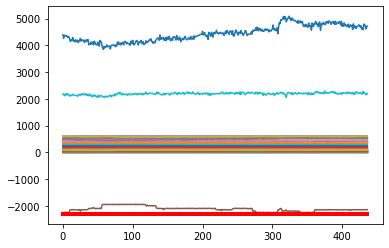

Predicción:  [[[0.98282224 0.01717774]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3344600e+01  1.1560000e+01  6.0407800e+01  7.7829400e+01
  6.1006640e+02  3.2348600e+01  9.2498000e+00  1.9001710e+02
  1.1105000e+00  7.1090200e+01  1.2489900e+02  1.0038700e+01
  6.6749300e+01  1.7725700e+02  2.1613000e+01  1.3416410e+02
  1.8952790e+02  7.1094700e+01 -4.0000000e-04  3.6001000e+00
  1.3400800e+01  7.3018000e+00  1.4997000e+00  7.3286700e+01
  1.4707000e+00  1.5355000e+00  8.7595400e+01  6.3499100e+01
  1.3282000e+00  1.2254000e+00  1.6164000e+00  1.3894000e+00
  1.6399690e+02  8.3730000e-01  8.4000000e-01 -2.1463329e+03
  2.0987710e+02  1.6228000e+00  1.3913000e+00  2.1871235e+03
  4.6393070e+03  1.8481450e+02  1.4249000e+00  1.4115000e+00
  7.9011000e+00  7.4993000e+00  1.7600000e+00  1.4340000e-01
  3.5479100e+01  5.3817070e+02  5.2343180e+02  5.1939160e+02
  5.1976260e+02  5.1979280e+02  2.8037500e+01  2.94

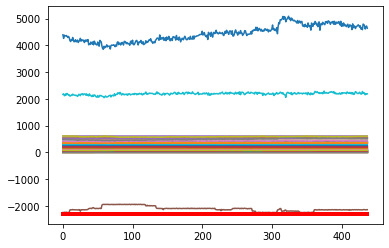

Predicción:  [[[0.9799699  0.02003011]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3964000e+01  1.1508300e+01  6.0596200e+01  7.7894400e+01
  6.0990250e+02  3.1966400e+01  9.2478000e+00  1.9011380e+02
  9.0300000e-01  7.1214500e+01  1.2483850e+02  1.0000400e+01
  6.6717900e+01  1.7703880e+02  2.1845800e+01  1.3444490e+02
  1.8944520e+02  7.1161600e+01 -4.0000000e-04  3.5969000e+00
  1.3721700e+01  7.2861000e+00  1.5002000e+00  7.3280300e+01
  1.4691000e+00  1.5356000e+00  8.6603000e+01  6.3437500e+01
  1.3281000e+00  1.2246000e+00  1.6129000e+00  1.3880000e+00
  1.6315890e+02  8.3750000e-01  8.3980000e-01 -2.1497819e+03
  2.1163080e+02  1.6225000e+00  1.3915000e+00  2.2203017e+03
  4.7541570e+03  1.8481450e+02  1.4231000e+00  1.4108000e+00
  7.9011000e+00  7.5019000e+00  1.7577000e+00  1.4470000e-01
  3.5251000e+01  5.3857930e+02  5.2358130e+02  5.1956530e+02
  5.1997170e+02  5.2002250e+02  2.8103900e+01  2.93

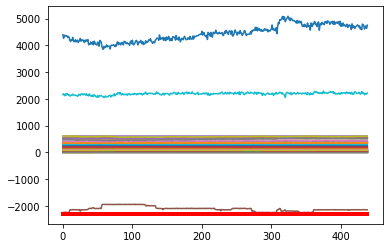

Predicción:  [[[0.98444104 0.01555901]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3652400e+01  1.1557600e+01  6.0230500e+01  7.7622000e+01
  6.0950510e+02  3.2207200e+01  9.2272000e+00  1.8998040e+02
  9.0430000e-01  7.1214300e+01  1.2499510e+02  1.0105400e+01
  6.6882400e+01  1.7734910e+02  2.1843000e+01  1.3476290e+02
  1.8952500e+02  7.0990600e+01 -4.0000000e-04  3.6097000e+00
  1.3838100e+01  7.2941000e+00  1.5009000e+00  7.3302200e+01
  1.4661000e+00  1.5286000e+00  8.6758600e+01  6.3924400e+01
  1.3262000e+00  1.2214000e+00  1.6076000e+00  1.3839000e+00
  1.6246490e+02  8.3690000e-01  8.3980000e-01 -2.1572386e+03
  2.1021090e+02  1.6156000e+00  1.3900000e+00  2.1788824e+03
  4.6617920e+03  1.8481450e+02  1.4175000e+00  1.4080000e+00
  7.8988000e+00  7.4989000e+00  1.7532000e+00  1.4530000e-01
  3.3964700e+01  5.3865950e+02  5.2328800e+02  5.1946040e+02
  5.1983610e+02  5.1985610e+02  2.8069100e+01  2.94

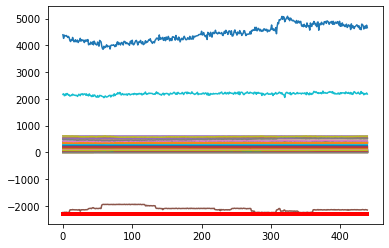

Predicción:  [[[0.982222   0.01777798]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3735000e+01  1.1425700e+01  6.0367800e+01  7.7305900e+01
  6.1056560e+02  3.1780300e+01  9.2735000e+00  1.8996700e+02
  7.6650000e-01  7.1016800e+01  1.2501140e+02  9.9416000e+00
  6.6824000e+01  1.7673540e+02  2.1928800e+01  1.3393990e+02
  1.8943900e+02  7.0989400e+01 -4.0000000e-04  3.6128000e+00
  1.2794500e+01  7.2995000e+00  1.5000000e+00  7.3324900e+01
  1.4742000e+00  1.5397000e+00  8.7347300e+01  6.3813200e+01
  1.3352000e+00  1.2292000e+00  1.6193000e+00  1.3960000e+00
  1.6376460e+02  8.3650000e-01  8.3950000e-01 -2.1455202e+03
  2.0821060e+02  1.6269000e+00  1.3991000e+00  2.2010515e+03
  4.6667097e+03  1.8481450e+02  1.4283000e+00  1.4195000e+00
  7.9027000e+00  7.5011000e+00  1.7620000e+00  1.4300000e-01
  3.2006200e+01  5.3806050e+02  5.2351930e+02  5.1973040e+02
  5.2016600e+02  5.2007670e+02  2.7968500e+01  2.93

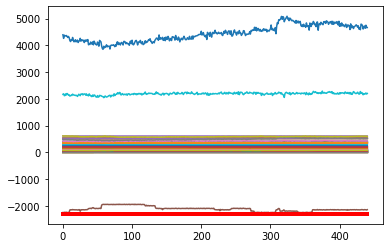

Predicción:  [[[0.9809986  0.01900141]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3177900e+01  1.1454500e+01  6.0047600e+01  7.7409300e+01
  6.1038370e+02  3.2606600e+01  9.2377000e+00  1.8996650e+02
  7.0310000e-01  7.1125200e+01  1.2500240e+02  1.0177900e+01
  6.6859000e+01  1.7726350e+02  2.1129500e+01  1.3391880e+02
  1.8951160e+02  7.0876300e+01 -4.0000000e-04  3.5971000e+00
  1.2369000e+01  7.3184000e+00  1.4998000e+00  7.3277300e+01
  1.4757000e+00  1.5400000e+00  8.6710800e+01  6.3831200e+01
  1.3337000e+00  1.2298000e+00  1.6195000e+00  1.3931000e+00
  1.6397560e+02  8.3610000e-01  8.3860000e-01 -2.1518683e+03
  2.0961930e+02  1.6266000e+00  1.3973000e+00  2.1927242e+03
  4.7093707e+03  1.8481450e+02  1.4265000e+00  1.4174000e+00
  7.8987000e+00  7.4893000e+00  1.7626000e+00  1.4320000e-01
  3.3345000e+01  5.3828110e+02  5.2367220e+02  5.1959460e+02
  5.2008400e+02  5.1997830e+02  2.8724700e+01  2.95

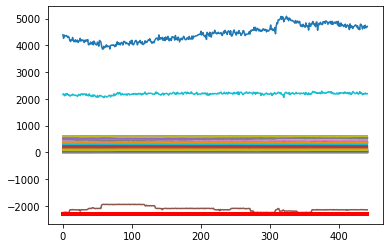

Predicción:  [[[0.983213   0.01678698]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3598600e+01  1.1525300e+01  5.9363100e+01  7.8438100e+01
  6.0958060e+02  3.1862200e+01  9.4535000e+00  1.9002140e+02
  8.0740000e-01  7.1232400e+01  1.2504720e+02  1.0050900e+01
  6.6679100e+01  1.7647490e+02  2.0670300e+01  1.3293040e+02
  1.8960660e+02  7.1012400e+01 -4.0000000e-04  3.5978000e+00
  1.2845000e+01  7.2840000e+00  1.5023000e+00  7.3338100e+01
  1.4698000e+00  1.5355000e+00  8.6436000e+01  6.3623100e+01
  1.3293000e+00  1.2238000e+00  1.6120000e+00  1.3873000e+00
  1.6507470e+02  8.3420000e-01  8.4040000e-01 -2.1546850e+03
  2.0706260e+02  1.6219000e+00  1.3930000e+00  2.2191597e+03
  4.6838572e+03  1.8481450e+02  1.4217000e+00  1.4135000e+00
  7.9005000e+00  7.5078000e+00  1.7580000e+00  1.4560000e-01
  3.4558100e+01  5.3730000e+02  5.2343150e+02  5.1967470e+02
  5.2021300e+02  5.2008380e+02  2.7981000e+01  2.91

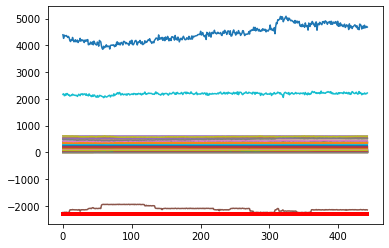

Predicción:  [[[0.9826622  0.01733778]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3649200e+01  1.1476900e+01  5.9606100e+01  7.9157300e+01
  6.1006520e+02  3.1832100e+01  9.2650000e+00  1.8997070e+02
  9.1140000e-01  7.1458600e+01  1.2494330e+02  1.0126600e+01
  6.6183000e+01  1.7742670e+02  2.2041900e+01  1.3386190e+02
  1.8943890e+02  7.0843000e+01 -4.0000000e-04  3.5921000e+00
  1.2785200e+01  7.3324000e+00  1.4999000e+00  7.3375400e+01
  1.4747000e+00  1.5375000e+00  8.5969600e+01  6.3669700e+01
  1.3348000e+00  1.2270000e+00  1.6165000e+00  1.3897000e+00
  1.6619390e+02  8.3670000e-01  8.4090000e-01 -2.1516922e+03
  2.0899790e+02  1.6239000e+00  1.3985000e+00  2.2393667e+03
  4.5562747e+03  1.8481450e+02  1.4242000e+00  1.4170000e+00
  7.9003000e+00  7.5018000e+00  1.7620000e+00  1.4570000e-01
  3.4687100e+01  5.3669060e+02  5.2386510e+02  5.1970400e+02
  5.2026940e+02  5.2012130e+02  2.7733400e+01  2.87

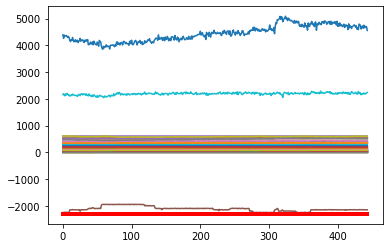

Predicción:  [[[0.97712326 0.02287679]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3690400e+01  1.1502400e+01  6.0634400e+01  7.7847000e+01
  6.0993430e+02  3.1631000e+01  9.2778000e+00  1.9007240e+02
  9.1720000e-01  7.1410100e+01  1.2504180e+02  9.9742000e+00
  6.7129500e+01  1.7759260e+02  2.2482300e+01  1.3523950e+02
  1.8938660e+02  7.1218100e+01 -4.0000000e-04  3.6125000e+00
  1.4018000e+01  7.2656000e+00  1.4982000e+00  7.3309600e+01
  1.4700000e+00  1.5338000e+00  8.7281600e+01  6.3941800e+01
  1.3276000e+00  1.2235000e+00  1.6113000e+00  1.3885000e+00
  1.6472740e+02  8.3680000e-01  8.4030000e-01 -2.1534244e+03
  2.0853490e+02  1.6205000e+00  1.3913000e+00  2.1645448e+03
  4.6899390e+03  1.8481450e+02  1.4230000e+00  1.4152000e+00
  7.9011000e+00  7.5002000e+00  1.7583000e+00  1.4710000e-01
  3.4631200e+01  5.3662490e+02  5.2320080e+02  5.1966970e+02
  5.2013010e+02  5.2003030e+02  2.8283100e+01  2.89

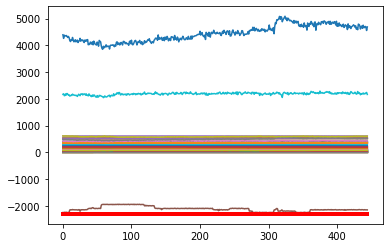

Predicción:  [[[0.9828395  0.01716045]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3583300e+01  1.1556500e+01  6.0547000e+01  7.8733600e+01
  6.1022250e+02  3.1006700e+01  9.2783000e+00  1.9002720e+02
  9.1800000e-01  7.1574400e+01  1.2493160e+02  9.9907000e+00
  6.6279100e+01  1.7539090e+02  2.2390100e+01  1.3597100e+02
  1.8956160e+02  7.1022600e+01 -4.0000000e-04  3.6100000e+00
  1.2019600e+01  7.2973000e+00  1.4990000e+00  7.3296200e+01
  1.4793000e+00  1.5442000e+00  8.7238300e+01  6.4016000e+01
  1.3396000e+00  1.2330000e+00  1.6260000e+00  1.3992000e+00
  1.6505340e+02  8.3600000e-01  8.3940000e-01 -2.1489568e+03
  2.0725490e+02  1.6313000e+00  1.4038000e+00  2.1932310e+03
  4.7145762e+03  1.8481450e+02  1.4336000e+00  1.4265000e+00
  7.9026000e+00  7.5020000e+00  1.7673000e+00  1.4100000e-01
  3.4506400e+01  5.3684280e+02  5.2347800e+02  5.1986660e+02
  5.2037380e+02  5.2033400e+02  2.8110000e+01  2.91

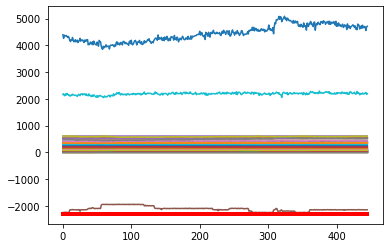

Predicción:  [[[0.9831834  0.01681659]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3538900e+01  1.1505500e+01  6.1626500e+01  7.9634000e+01
  6.0976940e+02  3.0692600e+01  9.3080000e+00  1.9002620e+02
  1.2022000e+00  7.1498700e+01  1.2497460e+02  1.0098900e+01
  6.7848800e+01  1.7647300e+02  2.2173600e+01  1.3799200e+02
  1.8954460e+02  7.0947700e+01 -4.0000000e-04  3.6088000e+00
  1.3009500e+01  7.3137000e+00  1.4997000e+00  7.3306000e+01
  1.4728000e+00  1.5381000e+00  8.7545100e+01  6.4761400e+01
  1.3320000e+00  1.2253000e+00  1.6148000e+00  1.3904000e+00
  1.6579370e+02  8.3680000e-01  8.4000000e-01 -2.1466813e+03
  2.0930830e+02  1.6260000e+00  1.3967000e+00  2.1932932e+03
  4.7214480e+03  1.8481450e+02  1.4211000e+00  1.4170000e+00
  7.8979000e+00  7.5006000e+00  1.7625000e+00  1.4770000e-01
  3.0863300e+01  5.3667720e+02  5.2391570e+02  5.1977320e+02
  5.2050110e+02  5.2046550e+02  2.7695400e+01  2.92

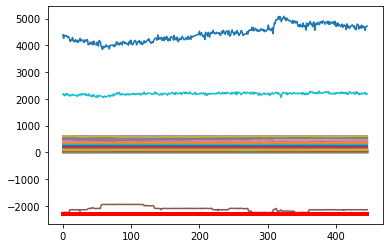

Predicción:  [[[0.9830799  0.01692004]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3372900e+01  1.1493000e+01  6.2868700e+01  7.8601700e+01
  6.1044830e+02  3.0491900e+01  9.3480000e+00  1.8992260e+02
  1.4268000e+00  7.1436700e+01  1.2488270e+02  1.0181200e+01
  6.6728700e+01  1.7643910e+02  2.1576800e+01  1.3896950e+02
  1.8956070e+02  7.0989200e+01 -4.0000000e-04  3.5977000e+00
  1.3401200e+01  7.2782000e+00  1.5000000e+00  7.3288500e+01
  1.4825000e+00  1.5488000e+00  8.7323000e+01  6.3801400e+01
  1.3413000e+00  1.2362000e+00  1.6241000e+00  1.4022000e+00
  1.6498480e+02  8.3700000e-01  8.4010000e-01 -2.1508065e+03
  2.0551720e+02  1.6366000e+00  1.4051000e+00  2.2157980e+03
  4.7350699e+03  1.8481450e+02  1.4322000e+00  1.4266000e+00
  7.8987000e+00  7.5015000e+00  1.7722000e+00  1.4810000e-01
  2.9952800e+01  5.3697060e+02  5.2324390e+02  5.1937860e+02
  5.2020350e+02  5.2026740e+02  2.7946000e+01  2.93

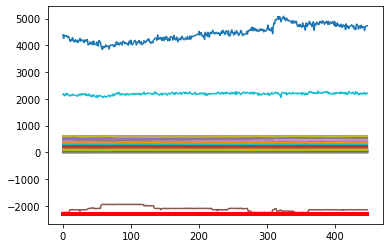

Predicción:  [[[0.9840051  0.01599491]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3553300e+01  1.1497900e+01  6.2017100e+01  8.0540000e+01
  6.1050220e+02  3.0520700e+01  9.3252000e+00  1.9000610e+02
  1.1846000e+00  7.1449700e+01  1.2512130e+02  1.0022600e+01
  6.5966600e+01  1.7532890e+02  2.1853200e+01  1.3894430e+02
  1.8961260e+02  7.0956400e+01 -4.0000000e-04  3.5611000e+00
  1.2174900e+01  7.3171000e+00  1.5001000e+00  7.3288900e+01
  1.4779000e+00  1.5421000e+00  8.6653900e+01  6.4098100e+01
  1.3392000e+00  1.2309000e+00  1.6203000e+00  1.3951000e+00
  1.6570690e+02  8.3830000e-01  8.4030000e-01 -2.1513827e+03
  2.0913800e+02  1.6292000e+00  1.4034000e+00  2.1884807e+03
  4.5563120e+03  1.8481450e+02  1.4235000e+00  1.4188000e+00
  7.9007000e+00  7.5002000e+00  1.7662000e+00  1.4570000e-01
  2.8471400e+01  5.3657720e+02  5.2355870e+02  5.1957310e+02
  5.2029140e+02  5.2045420e+02  2.7969500e+01  2.94

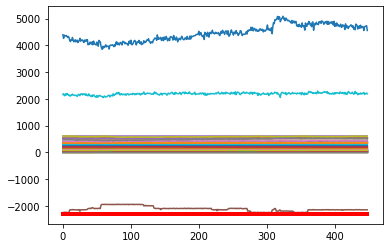

Predicción:  [[[0.9769388  0.02306119]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3515400e+01  1.1448400e+01  6.2219600e+01  7.8819200e+01
  6.0979350e+02  3.0658200e+01  9.3316000e+00  1.9000770e+02
  1.3423000e+00  7.1359000e+01  1.2486380e+02  9.9980000e+00
  6.6147700e+01  1.7668050e+02  2.1951200e+01  1.3966910e+02
  1.8953360e+02  7.0873700e+01 -4.0000000e-04  3.6016000e+00
  1.3908100e+01  7.3081000e+00  1.5006000e+00  7.3288900e+01
  1.4774000e+00  1.5424000e+00  8.7989500e+01  6.3788000e+01
  1.3430000e+00  1.2319000e+00  1.6172000e+00  1.3973000e+00
  1.6589110e+02  8.3740000e-01  8.4030000e-01 -2.1533466e+03
  2.0533420e+02  1.6302000e+00  1.4074000e+00  2.2015343e+03
  4.5622350e+03  1.8481450e+02  1.4255000e+00  1.4204000e+00
  7.8972000e+00  7.5013000e+00  1.7678000e+00  1.5040000e-01
  2.8315500e+01  5.3707370e+02  5.2414090e+02  5.2014940e+02
  5.2075690e+02  5.2097090e+02  2.8416000e+01  2.95

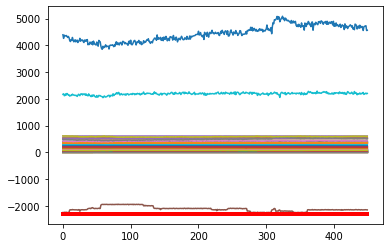

Predicción:  [[[0.9775415  0.02245852]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3382400e+01  1.1516700e+01  6.1199700e+01  7.7330800e+01
  6.1025970e+02  3.1197700e+01  9.2883000e+00  1.8990590e+02
  1.2848000e+00  7.1551900e+01  1.2497470e+02  9.9602000e+00
  6.6986600e+01  1.7704520e+02  2.1808500e+01  1.3809210e+02
  1.8947970e+02  7.0821100e+01 -4.0000000e-04  3.6020000e+00
  1.3904700e+01  7.2909000e+00  1.5001000e+00  7.3261200e+01
  1.4780000e+00  1.5438000e+00  8.7925700e+01  6.3344400e+01
  1.3401000e+00  1.2335000e+00  1.6141000e+00  1.3964000e+00
  1.6478970e+02  8.3800000e-01  8.4020000e-01 -2.1611417e+03
  2.0790580e+02  1.6312000e+00  1.4032000e+00  2.2012816e+03
  4.5509215e+03  1.8481450e+02  1.4241000e+00  1.4193000e+00
  7.8996000e+00  7.5000000e+00  1.7680000e+00  1.5390000e-01
  2.8119400e+01  5.3637410e+02  5.2334580e+02  5.1936430e+02
  5.1997790e+02  5.2004720e+02  2.8996000e+01  2.97

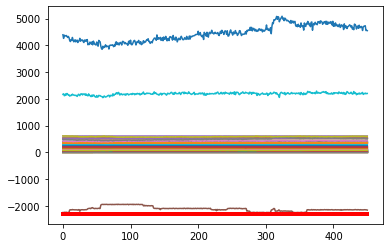

Predicción:  [[[0.9781691  0.02183095]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3384500e+01  1.1465600e+01  6.0362400e+01  7.8153900e+01
  6.0976460e+02  3.0830100e+01  9.2993000e+00  1.8998350e+02
  1.2874000e+00  7.2182200e+01  1.2525230e+02  1.0026600e+01
  6.6776800e+01  1.7620420e+02  2.2002300e+01  1.3649970e+02
  1.8941450e+02  7.0754600e+01 -4.0000000e-04  3.5972000e+00
  1.2762400e+01  7.3232000e+00  1.4989000e+00  7.3325800e+01
  1.4750000e+00  1.5381000e+00  8.7037600e+01  6.3225800e+01
  1.3389000e+00  1.2324000e+00  1.6137000e+00  1.3932000e+00
  1.6437310e+02  8.3850000e-01  8.4020000e-01 -2.1514678e+03
  2.0731940e+02  1.6253000e+00  1.4022000e+00  2.2189207e+03
  4.4963815e+03  1.8481450e+02  1.4203000e+00  1.4155000e+00
  7.8979000e+00  7.4984000e+00  1.7649000e+00  1.5120000e-01
  2.7424000e+01  5.3525330e+02  5.2298480e+02  5.1891440e+02
  5.1958140e+02  5.1971610e+02  2.9269800e+01  3.02

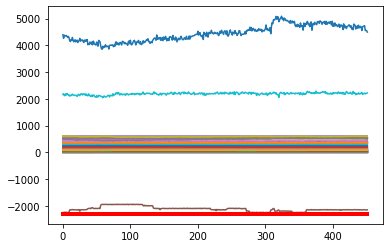

Predicción:  [[[0.9738134  0.02618652]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3310100e+01  1.1478000e+01  6.0966400e+01  7.7402800e+01
  6.0982580e+02  3.0479000e+01  9.3296000e+00  1.8994600e+02
  1.1577000e+00  7.2122500e+01  1.2479640e+02  9.9671000e+00
  6.5803700e+01  1.7567760e+02  2.2521700e+01  1.3691110e+02
  1.8942290e+02  7.0666100e+01 -4.0000000e-04  3.6280000e+00
  1.3151400e+01  7.2914000e+00  1.4992000e+00  7.3250800e+01
  1.4848000e+00  1.5523000e+00  8.7748900e+01  6.2478700e+01
  1.3478000e+00  1.2412000e+00  1.6227000e+00  1.4068000e+00
  1.6473970e+02  8.3820000e-01  8.4010000e-01 -2.1580878e+03
  2.0669000e+02  1.6406000e+00  1.4100000e+00  2.2522304e+03
  4.6461114e+03  1.8481450e+02  1.4351000e+00  1.4296000e+00
  7.9010000e+00  7.4954000e+00  1.7760000e+00  1.5320000e-01
  2.8256600e+01  5.3618330e+02  5.2341360e+02  5.1986080e+02
  5.2048990e+02  5.2060820e+02  2.9574700e+01  3.06

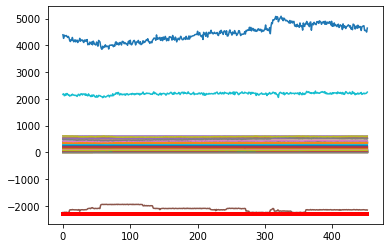

Predicción:  [[[0.98165166 0.01834836]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3286000e+01  1.1526700e+01  6.2056000e+01  7.7301100e+01
  6.0842960e+02  2.9667900e+01  9.3581000e+00  1.8991760e+02
  1.0382000e+00  7.2309400e+01  1.2484480e+02  1.0061900e+01
  6.5354300e+01  1.7569530e+02  2.2641200e+01  1.3813350e+02
  1.8936000e+02  7.0757100e+01 -4.0000000e-04  3.6181000e+00
  1.3550600e+01  7.3155000e+00  1.4990000e+00  7.3313000e+01
  1.4715000e+00  1.5393000e+00  8.8448800e+01  6.2700600e+01
  1.3339000e+00  1.2281000e+00  1.6099000e+00  1.3959000e+00
  1.6561240e+02  8.3610000e-01  8.4000000e-01 -2.1397271e+03
  2.0989720e+02  1.6275000e+00  1.3971000e+00  2.1819026e+03
  4.7143629e+03  1.8481450e+02  1.4245000e+00  1.4192000e+00
  7.9016000e+00  7.5008000e+00  1.7649000e+00  1.5510000e-01
  2.8332600e+01  5.3629170e+02  5.2368410e+02  5.1972400e+02
  5.2027660e+02  5.2044330e+02  2.9471600e+01  3.04

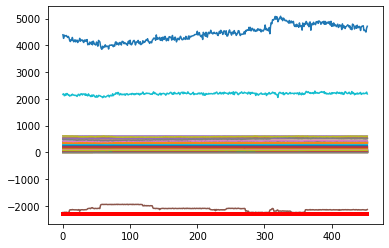

Predicción:  [[[0.9819873  0.01801273]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3130500e+01  1.1470100e+01  6.2376700e+01  7.6965600e+01
  6.0981850e+02  2.9651300e+01  9.3566000e+00  1.9008440e+02
  1.3174000e+00  7.2199900e+01  1.2500830e+02  1.0073800e+01
  6.6480700e+01  1.7549110e+02  2.2317300e+01  1.3982280e+02
  1.8935650e+02  7.0713300e+01 -4.0000000e-04  3.5858000e+00
  1.3911700e+01  7.2968000e+00  1.4987000e+00  7.3302800e+01
  1.4732000e+00  1.5392000e+00  8.8001600e+01  6.1440200e+01
  1.3373000e+00  1.2326000e+00  1.6081000e+00  1.3958000e+00
  1.6338570e+02  8.3730000e-01  8.4000000e-01 -2.1503248e+03
  2.0851180e+02  1.6271000e+00  1.3990000e+00  2.1988141e+03
  4.6713056e+03  1.8481450e+02  1.4254000e+00  1.4221000e+00
  7.8959000e+00  7.4964000e+00  1.7664000e+00  1.5830000e-01
  2.9415300e+01  5.3625830e+02  5.2320970e+02  5.1943670e+02
  5.1973300e+02  5.1993300e+02  2.9206000e+01  3.06

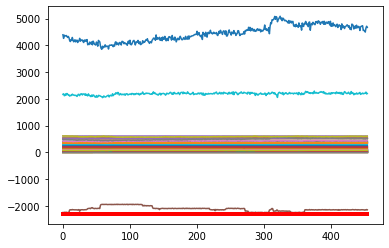

Predicción:  [[[0.98157376 0.01842624]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3517900e+01  1.1588600e+01  6.1862200e+01  7.7905300e+01
  6.0991850e+02  2.9716200e+01  9.3738000e+00  1.8996780e+02
  1.2251000e+00  7.2231200e+01  1.2501390e+02  9.9441000e+00
  6.6678900e+01  1.7580500e+02  2.2259300e+01  1.3970810e+02
  1.8953630e+02  7.1143500e+01 -4.0000000e-04  3.6051000e+00
  1.3938200e+01  7.2801000e+00  1.4999000e+00  7.3278900e+01
  1.4699000e+00  1.5381000e+00  8.7335900e+01  6.1830500e+01
  1.3326000e+00  1.2280000e+00  1.6050000e+00  1.3906000e+00
  1.6317380e+02  8.3800000e-01  8.3950000e-01 -2.1532354e+03
  2.0766560e+02  1.6254000e+00  1.3944000e+00  2.1949256e+03
  4.6541604e+03  1.8481450e+02  1.4206000e+00  1.4175000e+00
  7.9008000e+00  7.4987000e+00  1.7618000e+00  1.5650000e-01
  3.0296700e+01  5.3623330e+02  5.2308980e+02  5.1953380e+02
  5.1978800e+02  5.1990420e+02  2.9190700e+01  3.04

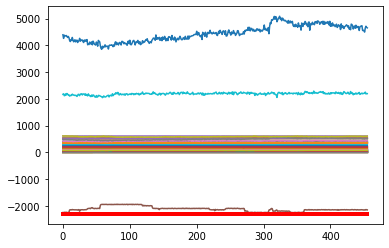

Predicción:  [[[0.9813254  0.01867455]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3817500e+01  1.1696900e+01  6.2274200e+01  7.7099100e+01
  6.1007140e+02  2.9872200e+01  9.3778000e+00  1.9008350e+02
  1.2485000e+00  7.2232200e+01  1.2512810e+02  9.9510000e+00
  6.6668600e+01  1.7608550e+02  2.2147800e+01  1.3845490e+02
  1.8970390e+02  7.0747500e+01 -4.0000000e-04  3.6128000e+00
  1.4517000e+01  7.3168000e+00  1.5001000e+00  7.3368200e+01
  1.4655000e+00  1.5326000e+00  8.6856100e+01  6.1817400e+01
  1.3273000e+00  1.2240000e+00  1.6003000e+00  1.3903000e+00
  1.6358820e+02  8.3830000e-01  8.4030000e-01 -2.1461337e+03
  2.0787960e+02  1.6203000e+00  1.3892000e+00  2.2423178e+03
  4.5878121e+03  1.8481450e+02  1.4200000e+00  1.4175000e+00
  7.8985000e+00  7.4992000e+00  1.7577000e+00  1.5780000e-01
  2.9613000e+01  5.3559060e+02  5.2272170e+02  5.1912720e+02
  5.1938590e+02  5.1955500e+02  2.9348400e+01  3.05

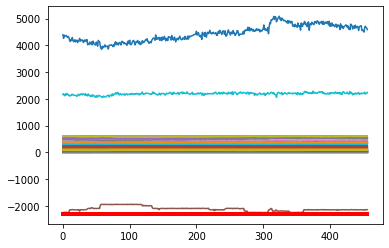

Predicción:  [[[0.9775484  0.02245161]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4007800e+01  1.1731700e+01  6.1394200e+01  7.7446400e+01
  6.0949630e+02  3.0098400e+01  9.3885000e+00  1.9000820e+02
  1.1232000e+00  7.2527100e+01  1.2501020e+02  9.8888000e+00
  6.6438500e+01  1.7507540e+02  2.2412500e+01  1.3601570e+02
  1.8986120e+02  7.0888800e+01 -4.0000000e-04  3.6066000e+00
  1.3137000e+01  7.3047000e+00  1.4993000e+00  7.3273700e+01
  1.4772000e+00  1.5430000e+00  8.7213400e+01  6.1866000e+01
  1.3415000e+00  1.2340000e+00  1.6109000e+00  1.3973000e+00
  1.6491470e+02  8.3840000e-01  8.4030000e-01 -2.1495825e+03
  2.0497130e+02  1.6300000e+00  1.4031000e+00  2.2013967e+03
  4.6145645e+03  1.8481450e+02  1.4268000e+00  1.4246000e+00
  7.9022000e+00  7.4990000e+00  1.7683000e+00  1.5760000e-01
  2.9820600e+01  5.3621190e+02  5.2317300e+02  5.1960090e+02
  5.1988800e+02  5.1989160e+02  2.9562700e+01  3.06

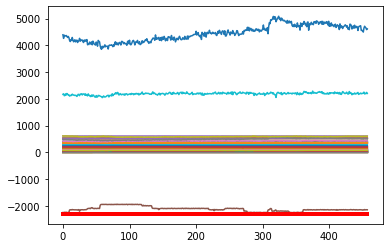

Predicción:  [[[0.97916037 0.02083962]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4089700e+01  1.1850700e+01  6.0966200e+01  7.6931800e+01
  6.0988540e+02  3.0920500e+01  9.4074000e+00  1.8994410e+02
  9.8890000e-01  7.2203000e+01  1.2489180e+02  1.0220800e+01
  6.6304700e+01  1.7642090e+02  2.2777500e+01  1.3618970e+02
  1.8980820e+02  7.0638000e+01 -4.0000000e-04  3.6020000e+00
  1.4391400e+01  7.3138000e+00  1.5010000e+00  7.3315600e+01
  1.4794000e+00  1.5448000e+00  8.6420300e+01  6.1481600e+01
  1.3429000e+00  1.2354000e+00  1.6100000e+00  1.3974000e+00
  1.6509700e+02  8.3810000e-01  8.4040000e-01 -2.1563353e+03
  2.0608400e+02  1.6312000e+00  1.4045000e+00  2.2011630e+03
  4.6477466e+03  1.8481450e+02  1.4267000e+00  1.4273000e+00
  7.8974000e+00  7.4978000e+00  1.7711000e+00  1.6140000e-01
  2.9587500e+01  5.3673820e+02  5.2377620e+02  5.1995710e+02
  5.2026800e+02  5.2027250e+02  3.0175300e+01  3.08

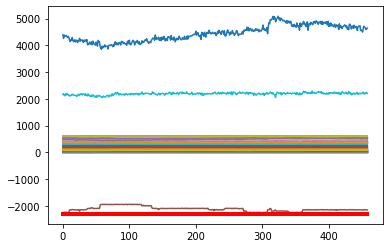

Predicción:  [[[0.9813457 0.0186543]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4106400e+01  1.1862900e+01  6.0614700e+01  7.6545100e+01
  6.0956150e+02  3.0548000e+01  9.4289000e+00  1.9000050e+02
  9.4050000e-01  7.2415300e+01  1.2509940e+02  9.8864000e+00
  6.7160600e+01  1.7569100e+02  2.2583300e+01  1.3627610e+02
  1.8962680e+02  7.0825400e+01 -4.0000000e-04  3.5841000e+00
  1.3806600e+01  7.2992000e+00  1.5008000e+00  7.3340300e+01
  1.4696000e+00  1.5358000e+00  8.6905600e+01  6.1957600e+01
  1.3342000e+00  1.2292000e+00  1.6010000e+00  1.3923000e+00
  1.6297760e+02  8.3820000e-01  8.3990000e-01 -2.1524409e+03
  2.0906180e+02  1.6228000e+00  1.3965000e+00  2.2436579e+03
  4.6297248e+03  1.8481450e+02  1.4215000e+00  1.4208000e+00
  7.9015000e+00  7.5047000e+00  1.7617000e+00  1.6050000e-01
  2.8956100e+01  5.3606890e+02  5.2307390e+02  5.1936720e+02
  5.1967480e+02  5.1969440e+02  3.0022400e+01  3.0973

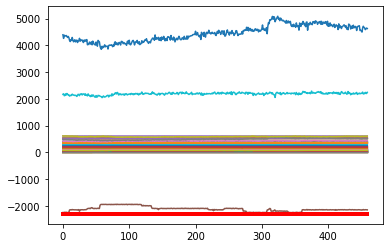

Predicción:  [[[0.9801619  0.01983808]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4039300e+01  1.1851000e+01  6.0266300e+01  7.7370300e+01
  6.0918960e+02  3.0545000e+01  9.4146000e+00  1.9007260e+02
  6.9880000e-01  7.2491000e+01  1.2518150e+02  1.0207900e+01
  6.6544600e+01  1.7554480e+02  2.2558700e+01  1.3629740e+02
  1.8975880e+02  7.0880800e+01 -4.0000000e-04  3.6159000e+00
  1.3204800e+01  7.2940000e+00  1.4995000e+00  7.3298200e+01
  1.4685000e+00  1.5353000e+00  8.6115200e+01  6.2650900e+01
  1.3275000e+00  1.2287000e+00  1.6000000e+00  1.3917000e+00
  1.6214010e+02  8.3850000e-01  8.4070000e-01 -2.1395916e+03
  2.0777240e+02  1.6213000e+00  1.3905000e+00  2.2362062e+03
  4.6760823e+03  1.8481450e+02  1.4197000e+00  1.4186000e+00
  7.8958000e+00  7.4979000e+00  1.7598000e+00  1.5990000e-01
  2.7810200e+01  5.3566450e+02  5.2276000e+02  5.1896850e+02
  5.1944610e+02  5.1946160e+02  2.9780300e+01  3.10

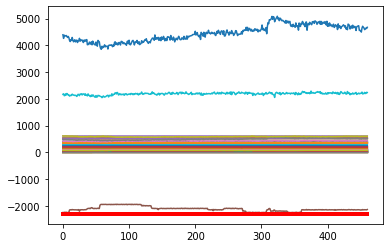

Predicción:  [[[0.9803068  0.01969317]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4189700e+01  1.1884800e+01  6.1079900e+01  7.6081100e+01
  6.1011440e+02  3.1353900e+01  9.4059000e+00  1.9001980e+02
  6.0360000e-01  7.2121200e+01  1.2490400e+02  1.0065700e+01
  6.6144000e+01  1.7761710e+02  2.2282600e+01  1.3652520e+02
  1.8984110e+02  7.0661100e+01 -4.0000000e-04  3.5981000e+00
  1.4602800e+01  7.2879000e+00  1.4996000e+00  7.3353800e+01
  1.4712000e+00  1.5383000e+00  8.6448000e+01  6.2521000e+01
  1.3351000e+00  1.2317000e+00  1.5992000e+00  1.3929000e+00
  1.6007990e+02  8.3920000e-01  8.3920000e-01 -2.1521214e+03
  2.0827910e+02  1.6240000e+00  1.3971000e+00  2.2827920e+03
  4.6177730e+03  1.8481450e+02  1.4224000e+00  1.4215000e+00
  7.9007000e+00  7.4992000e+00  1.7625000e+00  1.6350000e-01
  2.9254300e+01  5.3642940e+02  5.2355270e+02  5.1975000e+02
  5.2013100e+02  5.2010840e+02  2.9885900e+01  3.08

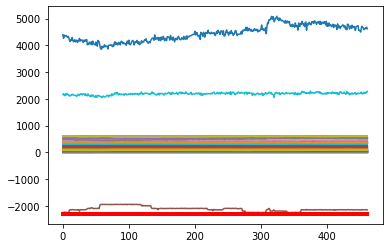

Predicción:  [[[0.9795131  0.02048689]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4071200e+01  1.1849800e+01  6.0411500e+01  7.6714800e+01
  6.0843200e+02  3.1820800e+01  9.4472000e+00  1.8997920e+02
  4.1590000e-01  7.2275600e+01  1.2508440e+02  1.0042700e+01
  6.7020700e+01  1.7715660e+02  2.2211900e+01  1.3538970e+02
  1.8975470e+02  7.0704000e+01 -4.0000000e-04  3.5985000e+00
  1.3457700e+01  7.3029000e+00  1.4989000e+00  7.3268500e+01
  1.4740000e+00  1.5423000e+00  8.6048200e+01  6.2571500e+01
  1.3358000e+00  1.2340000e+00  1.5977000e+00  1.3983000e+00
  1.6176760e+02  8.3880000e-01  8.4020000e-01 -2.1465840e+03
  2.0652940e+02  1.6291000e+00  1.3978000e+00  2.1930794e+03
  4.6556400e+03  1.8481450e+02  1.4268000e+00  1.4221000e+00
  7.9036000e+00  7.5013000e+00  1.7654000e+00  1.6810000e-01
  2.8343400e+01  5.3582170e+02  5.2315700e+02  5.1918120e+02
  5.1973730e+02  5.1972670e+02  2.9437500e+01  3.09

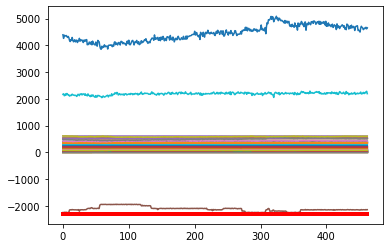

Predicción:  [[[0.9805064  0.01949356]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3945900e+01  1.1883700e+01  6.0831000e+01  7.6982500e+01
  6.1037910e+02  3.1321900e+01  9.4210000e+00  1.8990260e+02
  1.2930000e-01  7.2205500e+01  1.2494640e+02  9.8968000e+00
  6.6381900e+01  1.7623510e+02  2.2423300e+01  1.3438180e+02
  1.8978410e+02  7.0772100e+01 -4.0000000e-04  3.6046000e+00
  1.3570300e+01  7.3133000e+00  1.4987000e+00  7.3309400e+01
  1.4716000e+00  1.5385000e+00  8.5274300e+01  6.1893600e+01
  1.3343000e+00  1.2315000e+00  1.5944000e+00  1.3933000e+00
  1.6194050e+02  8.3890000e-01  8.4010000e-01 -2.1497564e+03
  2.0607970e+02  1.6242000e+00  1.3968000e+00  2.2086429e+03
  4.5831912e+03  1.8481450e+02  1.4213000e+00  1.4182000e+00
  7.8987000e+00  7.4986000e+00  1.7624000e+00  1.6830000e-01
  2.7963700e+01  5.3619170e+02  5.2312640e+02  5.1916330e+02
  5.1970320e+02  5.1982560e+02  2.9745900e+01  3.09

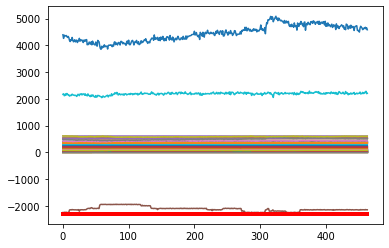

Predicción:  [[[0.9777892 0.0222108]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4061900e+01  1.1837600e+01  6.0631100e+01  7.6665500e+01
  6.0901590e+02  3.1155200e+01  9.3695000e+00  1.9003930e+02
  1.4380000e-01  7.1289600e+01  1.2484300e+02  9.8040000e+00
  6.7665600e+01  1.7569040e+02  2.2529200e+01  1.3476450e+02
  1.8977310e+02  7.0856200e+01 -4.0000000e-04  3.6117000e+00
  1.3992100e+01  7.2759000e+00  1.5015000e+00  7.3276300e+01
  1.4703000e+00  1.5378000e+00  8.5800500e+01  6.2600600e+01
  1.3328000e+00  1.2302000e+00  1.5925000e+00  1.3917000e+00
  1.6204970e+02  8.3830000e-01  8.4010000e-01 -2.1498221e+03
  2.0776580e+02  1.6240000e+00  1.3952000e+00  2.2630866e+03
  4.5959391e+03  1.8481450e+02  1.4202000e+00  1.4164000e+00
  7.8995000e+00  7.5008000e+00  1.7612000e+00  1.6910000e-01
  2.8601300e+01  5.3593330e+02  5.2326180e+02  5.1939120e+02
  5.1984590e+02  5.1986320e+02  2.9938800e+01  3.0999

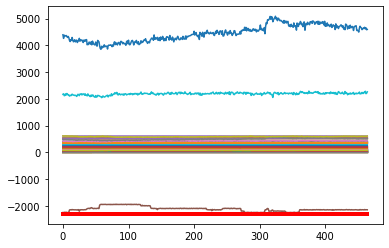

Predicción:  [[[0.97829187 0.02170816]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3894000e+01  1.2028000e+01  6.0280700e+01  7.5968100e+01
  6.1019770e+02  3.1296400e+01  9.4913000e+00  1.8989430e+02
  1.4190000e-01  7.1236400e+01  1.2510540e+02  1.0074500e+01
  6.6182900e+01  1.7684080e+02  2.2371000e+01  1.3445640e+02
  1.9004140e+02  7.0724400e+01 -4.0000000e-04  3.5809000e+00
  1.4083900e+01  7.3049000e+00  1.4996000e+00  7.3389000e+01
  1.4689000e+00  1.5391000e+00  8.5175700e+01  6.2520600e+01
  1.3323000e+00  1.2285000e+00  1.5897000e+00  1.3912000e+00
  1.6144710e+02  8.3840000e-01  8.4000000e-01 -2.1434028e+03
  2.0869310e+02  1.6243000e+00  1.3949000e+00  2.2511411e+03
  4.6270547e+03  1.8481450e+02  1.4196000e+00  1.4149000e+00
  7.9006000e+00  7.5011000e+00  1.7611000e+00  1.7150000e-01
  2.8262500e+01  5.3560840e+02  5.2281380e+02  5.1910220e+02
  5.1967810e+02  5.1956090e+02  3.0018300e+01  3.09

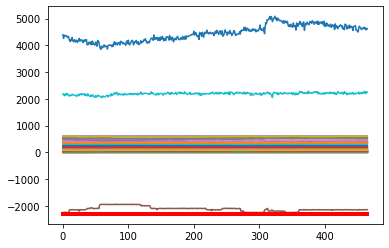

Predicción:  [[[0.9787779  0.02122206]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3768200e+01  1.2116900e+01  6.0291900e+01  7.5827600e+01
  6.0962060e+02  3.3012800e+01  9.3929000e+00  1.8999600e+02
  7.3900000e-02  7.1415500e+01  1.2503240e+02  1.0079700e+01
  6.6627000e+01  1.7868870e+02  2.2773300e+01  1.3440640e+02
  1.9007190e+02  7.0732700e+01 -4.0000000e-04  3.5927000e+00
  1.4279900e+01  7.2875000e+00  1.4977000e+00  7.3325700e+01
  1.4700000e+00  1.5394000e+00  8.4820300e+01  6.2948500e+01
  1.3334000e+00  1.2299000e+00  1.5864000e+00  1.3911000e+00
  1.6142110e+02  8.3900000e-01  8.4040000e-01 -2.1488575e+03
  2.0715770e+02  1.6245000e+00  1.3961000e+00  2.2224140e+03
  4.5718605e+03  1.8481450e+02  1.4187000e+00  1.4176000e+00
  7.9008000e+00  7.4987000e+00  1.7610000e+00  1.7460000e-01
  2.7613300e+01  5.3662280e+02  5.2352440e+02  5.1964710e+02
  5.2029810e+02  5.2008290e+02  2.9812400e+01  3.09

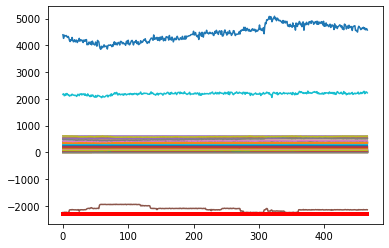

Predicción:  [[[0.9772061  0.02279388]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3622000e+01  1.1986500e+01  6.1137800e+01  7.4517500e+01
  6.1100430e+02  3.2955900e+01  9.3972000e+00  1.8999170e+02
  3.3100000e-02  7.1192600e+01  1.2488360e+02  9.9198000e+00
  6.6850400e+01  1.7844360e+02  2.2084400e+01  1.3409430e+02
  1.8984380e+02  7.0634100e+01 -4.0000000e-04  3.5948000e+00
  1.4553800e+01  7.3019000e+00  1.4995000e+00  7.3305400e+01
  1.4745000e+00  1.5444000e+00  8.4486100e+01  6.2303900e+01
  1.3394000e+00  1.2377000e+00  1.5890000e+00  1.3974000e+00
  1.5866500e+02  8.4040000e-01  8.4010000e-01 -2.1556092e+03
  2.0527550e+02  1.6291000e+00  1.4018000e+00  2.2084573e+03
  4.5517633e+03  1.8481450e+02  1.4245000e+00  1.4201000e+00
  7.8951000e+00  7.4938000e+00  1.7650000e+00  1.7600000e-01
  2.7042900e+01  5.3583440e+02  5.2303170e+02  5.1911200e+02
  5.1977160e+02  5.1949560e+02  3.1082300e+01  3.14

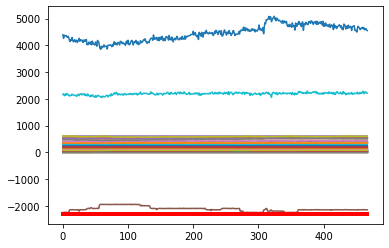

Predicción:  [[[0.9772735  0.02272649]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3719500e+01  1.1833500e+01  5.8833300e+01  7.6855400e+01
  6.1013540e+02  3.2382800e+01  9.3651000e+00  1.8997550e+02
  2.4000000e-03  7.1416100e+01  1.2509970e+02  1.0048800e+01
  6.6714400e+01  1.7719150e+02  2.0263700e+01  1.3182030e+02
  1.8978980e+02  7.0785100e+01 -4.0000000e-04  3.5963000e+00
  1.3153900e+01  7.3261000e+00  1.5004000e+00  7.3365500e+01
  1.4635000e+00  1.5345000e+00  8.4511800e+01  6.2500400e+01
  1.3283000e+00  1.2246000e+00  1.5831000e+00  1.3859000e+00
  1.6107220e+02  8.3440000e-01  8.3760000e-01 -2.1420618e+03
  2.0888950e+02  1.6189000e+00  1.3911000e+00  2.2344271e+03
  4.5709314e+03  1.8481450e+02  1.4133000e+00  1.4110000e+00
  7.9051000e+00  7.5067000e+00  1.7544000e+00  1.7140000e-01
  2.7469000e+01  5.3577830e+02  5.2329730e+02  5.1923910e+02
  5.1989960e+02  5.1961000e+02  3.0007200e+01  3.13

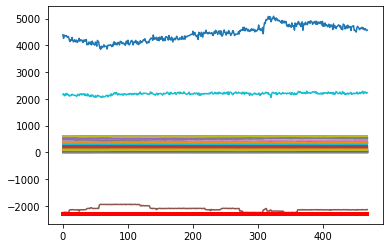

Predicción:  [[[0.9759955  0.02400449]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3695200e+01  1.1820800e+01  6.0517100e+01  7.7515400e+01
  6.0983700e+02  3.1380300e+01  9.3169000e+00  1.9006650e+02
  2.1500000e-02  7.1336400e+01  1.2485690e+02  9.8909000e+00
  6.7204500e+01  1.7677420e+02  2.1463300e+01  1.3248900e+02
  1.8965880e+02  7.0919300e+01 -4.0000000e-04  3.5878000e+00
  1.4204600e+01  7.2689000e+00  1.4999000e+00  7.3267500e+01
  1.4739000e+00  1.5467000e+00  8.4639700e+01  6.2371900e+01
  1.3347000e+00  1.2344000e+00  1.5898000e+00  1.3986000e+00
  1.6048690e+02  8.3970000e-01  8.4080000e-01 -2.1452405e+03
  2.0660480e+02  1.6307000e+00  1.3971000e+00  2.2322383e+03
  4.6293768e+03  1.8481450e+02  1.4265000e+00  1.4247000e+00
  7.8980000e+00  7.5028000e+00  1.7663000e+00  1.7630000e-01
  2.7672200e+01  5.3568110e+02  5.2288620e+02  5.1910130e+02
  5.1976620e+02  5.1945420e+02  2.9952900e+01  3.10

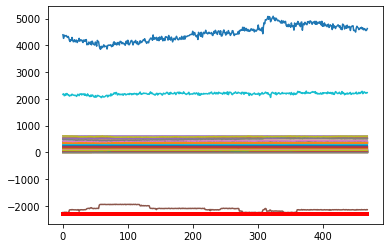

Predicción:  [[[0.9792253  0.02077473]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3590900e+01  1.1662400e+01  6.0112700e+01  7.7065400e+01
  6.1091840e+02  3.1020200e+01  9.2902000e+00  1.9002990e+02
  6.0800000e-02  7.1635100e+01  1.2492750e+02  1.0028800e+01
  6.6753600e+01  1.7605240e+02  2.1878200e+01  1.3130480e+02
  1.8967840e+02  7.0877700e+01 -4.0000000e-04  3.6003000e+00
  1.3913300e+01  7.2792000e+00  1.4985000e+00  7.3322200e+01
  1.4730000e+00  1.5456000e+00  8.3478300e+01  6.1845700e+01
  1.3348000e+00  1.2313000e+00  1.5902000e+00  1.3959000e+00
  1.6266830e+02  8.3900000e-01  8.4020000e-01 -2.1443998e+03
  2.1033270e+02  1.6286000e+00  1.3976000e+00  2.1821893e+03
  4.5125391e+03  1.8481450e+02  1.4239000e+00  1.4190000e+00
  7.9040000e+00  7.4975000e+00  1.7644000e+00  1.7360000e-01
  2.7640100e+01  5.3635000e+02  5.2294020e+02  5.1935530e+02
  5.1984410e+02  5.1957560e+02  3.0462200e+01  3.13

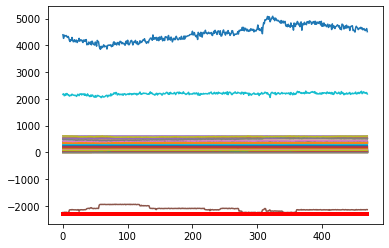

Predicción:  [[[0.9735016  0.02649841]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3625900e+01  1.1837700e+01  6.0875800e+01  7.6127100e+01
  6.1080820e+02  3.1610400e+01  9.2990000e+00  1.8991290e+02
  6.4800000e-02  7.1595200e+01  1.2499210e+02  9.9633000e+00
  6.7343900e+01  1.7655100e+02  2.2197100e+01  1.3303190e+02
  1.8982080e+02  7.0555900e+01 -4.0000000e-04  3.6011000e+00
  1.3679700e+01  7.3277000e+00  1.5002000e+00  7.3293500e+01
  1.4784000e+00  1.5475000e+00  8.4014700e+01  6.2121900e+01
  1.3426000e+00  1.2383000e+00  1.5928000e+00  1.3988000e+00
  1.6154980e+02  8.3470000e-01  8.3990000e-01 -2.1526082e+03
  2.0521330e+02  1.6316000e+00  1.4044000e+00  2.2265620e+03
  4.5067189e+03  1.8481450e+02  1.4317000e+00  1.4264000e+00
  7.8897000e+00  7.4998000e+00  1.7690000e+00  1.7660000e-01
  3.3004900e+01  5.3617000e+02  5.2319020e+02  5.1914660e+02
  5.1966420e+02  5.1951590e+02  3.0442300e+01  3.14

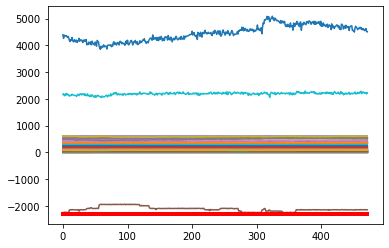

Predicción:  [[[0.97450477 0.02549526]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3551200e+01  1.2063700e+01  6.2306000e+01  7.6883000e+01
  6.0931140e+02  3.2012900e+01  9.3709000e+00  1.8988180e+02
  1.8510000e-01  7.1582900e+01  1.2510050e+02  1.0004000e+01
  6.7183800e+01  1.7769720e+02  2.2132000e+01  1.3436690e+02
  1.9028040e+02  7.0712600e+01 -4.0000000e-04  3.5953000e+00
  1.3611800e+01  7.3141000e+00  1.5012000e+00  7.3276900e+01
  1.4688000e+00  1.5367000e+00  8.3704800e+01  6.2157700e+01
  1.3351000e+00  1.2273000e+00  1.5779000e+00  1.3858000e+00
  1.6087440e+02  8.3440000e-01  8.4000000e-01 -2.1584324e+03
  2.0734890e+02  1.6203000e+00  1.3965000e+00  2.2620846e+03
  4.4905770e+03  1.8481450e+02  1.4199000e+00  1.4149000e+00
  7.9003000e+00  7.4987000e+00  1.7592000e+00  1.8130000e-01
  3.4264300e+01  5.3529780e+02  5.2247210e+02  5.1857270e+02
  5.1913910e+02  5.1907500e+02  3.0344100e+01  3.15

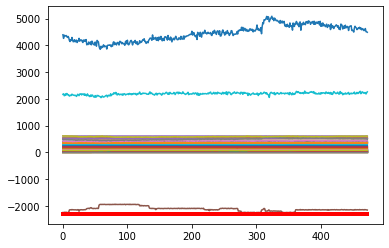

Predicción:  [[[0.97446793 0.02553203]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3324700e+01  1.2147000e+01  6.2391300e+01  7.6276700e+01
  6.0992920e+02  3.1800100e+01  9.4567000e+00  1.9005260e+02
  5.3440000e-01  7.1355400e+01  1.2514760e+02  9.6974000e+00
  6.6943800e+01  1.7965520e+02  2.1614500e+01  1.3746730e+02
  1.9071430e+02  7.0628700e+01 -4.0000000e-04  3.5994000e+00
  1.4497200e+01  7.3237000e+00  1.5007000e+00  7.3310600e+01
  1.4648000e+00  1.5335000e+00  8.3724000e+01  6.1999100e+01
  1.3292000e+00  1.2202000e+00  1.5698000e+00  1.3801000e+00
  1.6187290e+02  8.3420000e-01  8.3940000e-01 -2.1527563e+03
  2.0630380e+02  1.6175000e+00  1.3912000e+00  2.1664825e+03
  4.4299508e+03  1.8481450e+02  1.4135000e+00  1.4091000e+00
  7.8999000e+00  7.4993000e+00  1.7548000e+00  1.8520000e-01
  3.3610500e+01  5.3578810e+02  5.2247500e+02  5.1864180e+02
  5.1918360e+02  5.1926720e+02  2.9966500e+01  3.13

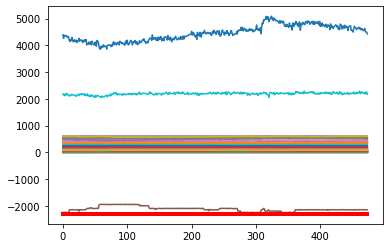

Predicción:  [[[0.9703764  0.02962362]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3323400e+01  1.2097100e+01  6.2780800e+01  7.6536700e+01
  6.1007330e+02  3.1497400e+01  9.4453000e+00  1.9006600e+02
  4.5960000e-01  6.9352500e+01  1.2481910e+02  9.9645000e+00
  6.6714300e+01  1.7806080e+02  2.1584300e+01  1.3679160e+02
  1.9084090e+02  7.0730100e+01 -4.0000000e-04  3.5999000e+00
  1.5045900e+01  7.2714000e+00  1.5008000e+00  7.3291200e+01
  1.4763000e+00  1.5449000e+00  8.4658400e+01  6.1860700e+01
  1.3356000e+00  1.2307000e+00  1.5831000e+00  1.3935000e+00
  1.6168980e+02  8.3400000e-01  8.4020000e-01 -2.1521016e+03
  2.1008350e+02  1.6300000e+00  1.3981000e+00  2.1970762e+03
  4.5255159e+03  1.8481450e+02  1.4283000e+00  1.4214000e+00
  7.9013000e+00  7.5016000e+00  1.7668000e+00  1.8410000e-01
  3.4677300e+01  5.3600970e+02  5.2241710e+02  5.1870180e+02
  5.1935680e+02  5.1929740e+02  2.9787900e+01  3.12

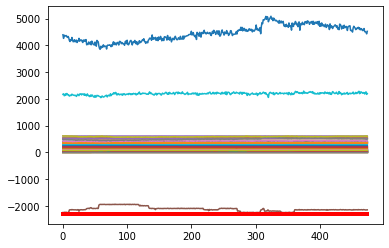

Predicción:  [[[0.9754293 0.0245707]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3316600e+01  1.2144900e+01  6.2098200e+01  7.8128700e+01
  6.0939050e+02  3.1204700e+01  9.4686000e+00  1.9001670e+02
  1.3590000e-01  6.9569300e+01  1.2492380e+02  1.0220900e+01
  6.7083500e+01  1.7556950e+02  2.2185200e+01  1.3713050e+02
  1.9089870e+02  7.0652200e+01 -4.0000000e-04  3.6122000e+00
  1.2968500e+01  7.3068000e+00  1.4996000e+00  7.3285100e+01
  1.4827000e+00  1.5509000e+00  8.5262100e+01  6.1289500e+01
  1.3469000e+00  1.2336000e+00  1.5928000e+00  1.3981000e+00
  1.6498280e+02  8.3340000e-01  8.3990000e-01 -2.1587685e+03
  2.0565850e+02  1.6353000e+00  1.4088000e+00  2.1949377e+03
  4.4696250e+03  1.8481450e+02  1.4335000e+00  1.4275000e+00
  7.8988000e+00  7.5019000e+00  1.7718000e+00  1.7910000e-01
  3.5600800e+01  5.3715940e+02  5.2377130e+02  5.1998520e+02
  5.2054030e+02  5.2063230e+02  2.9716700e+01  3.1111

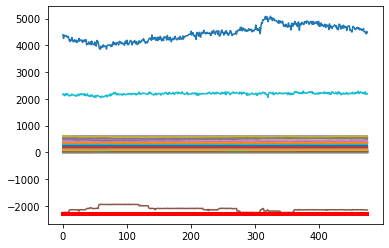

Predicción:  [[[0.97364205 0.02635792]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3304100e+01  1.2131700e+01  6.2650500e+01  7.6915900e+01
  6.0937410e+02  3.2752000e+01  9.4729000e+00  1.8994490e+02
  1.1800000e-01  6.8932900e+01  1.2476240e+02  9.8327000e+00
  6.6308700e+01  1.7871790e+02  2.2126000e+01  1.3783520e+02
  1.9079780e+02  7.0930700e+01 -4.0000000e-04  3.5984000e+00
  1.4778100e+01  7.3050000e+00  1.4978000e+00  7.3354600e+01
  1.4821000e+00  1.5508000e+00  8.5400100e+01  6.1486000e+01
  1.3442000e+00  1.2336000e+00  1.5839000e+00  1.3991000e+00
  1.6379310e+02  8.3440000e-01  8.3990000e-01 -2.1453975e+03
  2.0767260e+02  1.6354000e+00  1.4059000e+00  2.2414461e+03
  4.5541839e+03  1.8481450e+02  1.4344000e+00  1.4275000e+00
  7.8967000e+00  7.5025000e+00  1.7722000e+00  1.8830000e-01
  3.5255900e+01  5.3673120e+02  5.2336780e+02  5.1951340e+02
  5.2004450e+02  5.2019390e+02  2.9790100e+01  3.09

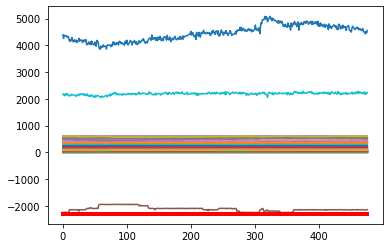

Predicción:  [[[0.97571427 0.02428575]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3326200e+01  1.2086500e+01  6.2375000e+01  7.7124200e+01
  6.0914280e+02  3.2766200e+01  9.4415000e+00  1.9003710e+02
  1.5670000e-01  6.8821100e+01  1.2488910e+02  9.8886000e+00
  6.7248700e+01  1.7775780e+02  2.2236400e+01  1.3807820e+02
  1.9048000e+02  7.0877800e+01 -4.0000000e-04  3.5928000e+00
  1.3624600e+01  7.2923000e+00  1.5009000e+00  7.3362500e+01
  1.4899000e+00  1.5578000e+00  8.4598500e+01  6.1725400e+01
  1.3536000e+00  1.2429000e+00  1.5945000e+00  1.4070000e+00
  1.6330120e+02  8.3530000e-01  8.4010000e-01 -2.1494374e+03
  2.0774620e+02  1.6426000e+00  1.4155000e+00  2.1611551e+03
  4.5436290e+03  1.8481450e+02  1.4413000e+00  1.4330000e+00
  7.9000000e+00  7.5018000e+00  1.7795000e+00  1.8500000e-01
  3.4521000e+01  5.3740000e+02  5.2369610e+02  5.1985080e+02
  5.2041280e+02  5.2038540e+02  2.9430500e+01  3.08

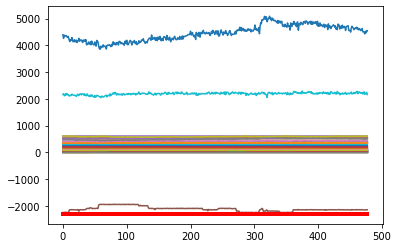

Predicción:  [[[0.97593415 0.02406584]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2848100e+01  1.1605100e+01  6.1197600e+01  7.8078800e+01
  6.1063110e+02  3.1142900e+01  9.3457000e+00  1.8999870e+02
  1.4660000e-01  6.9230400e+01  1.2501140e+02  1.0297700e+01
  6.6616200e+01  1.7472080e+02  2.2230800e+01  1.3655140e+02
  1.8991170e+02  7.0843000e+01 -4.0000000e-04  3.5973000e+00
  1.3127900e+01  7.3089000e+00  1.5011000e+00  7.3275600e+01
  1.4836000e+00  1.5494000e+00  8.4477700e+01  6.2383300e+01
  1.3459000e+00  1.2375000e+00  1.5924000e+00  1.3979000e+00
  1.6364410e+02  8.3660000e-01  8.4000000e-01 -2.1520204e+03
  2.0774140e+02  1.6331000e+00  1.4080000e+00  2.2434423e+03
  4.5104481e+03  1.8481450e+02  1.4277000e+00  1.4217000e+00
  7.9015000e+00  7.5015000e+00  1.7737000e+00  1.8120000e-01
  3.0084400e+01  5.3616050e+02  5.2313940e+02  5.1905010e+02
  5.1967640e+02  5.1966910e+02  2.9432100e+01  3.07

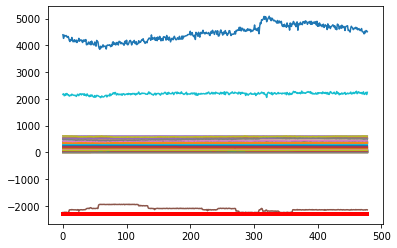

Predicción:  [[[0.9744348  0.02556522]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2566000e+01  1.1286200e+01  6.1153400e+01  7.7307700e+01
  6.0887070e+02  2.8327900e+01  9.2962000e+00  1.8998840e+02
  1.5620000e-01  6.9494200e+01  1.2503560e+02  1.0047400e+01
  6.7098200e+01  1.7279070e+02  2.2257800e+01  1.3641920e+02
  1.8959670e+02  7.0921100e+01 -4.0000000e-04  3.6039000e+00
  1.4243800e+01  7.3142000e+00  1.4997000e+00  7.3355100e+01
  1.4771000e+00  1.5433000e+00  8.3585400e+01  6.3123200e+01
  1.3379000e+00  1.2303000e+00  1.5909000e+00  1.3926000e+00
  1.6379840e+02  8.3520000e-01  8.4010000e-01 -2.1497736e+03
  2.0649180e+02  1.6272000e+00  1.4008000e+00  2.2062822e+03
  4.5520363e+03  1.8481450e+02  1.4236000e+00  1.4176000e+00
  7.9001000e+00  7.5002000e+00  1.7691000e+00  1.7830000e-01
  3.1243200e+01  5.3580010e+02  5.2302820e+02  5.1907600e+02
  5.1963240e+02  5.1961080e+02  2.9416300e+01  3.07

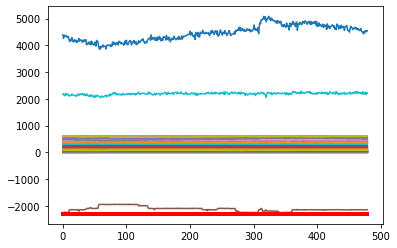

Predicción:  [[[0.97623444 0.02376553]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2624700e+01  1.1128800e+01  6.0340000e+01  7.6105000e+01
  6.0963680e+02  2.8988000e+01  9.3089000e+00  1.9003300e+02
  1.8240000e-01  6.9354700e+01  1.2474840e+02  9.9999000e+00
  6.7199300e+01  1.7383220e+02  2.2492600e+01  1.3616950e+02
  1.8952200e+02  7.0634000e+01 -4.0000000e-04  3.5994000e+00
  1.4630500e+01  7.3207000e+00  1.5004000e+00  7.3290700e+01
  1.4857000e+00  1.5516000e+00  8.4842300e+01  6.2245200e+01
  1.3484000e+00  1.2362000e+00  1.5936000e+00  1.4009000e+00
  1.6651000e+02  8.3720000e-01  8.3950000e-01 -2.1555658e+03
  2.0848140e+02  1.6364000e+00  1.4103000e+00  2.1983187e+03
  4.4920574e+03  1.8481450e+02  1.4309000e+00  1.4244000e+00
  7.8982000e+00  7.4954000e+00  1.7756000e+00  1.8220000e-01
  3.0240500e+01  5.3616660e+02  5.2355760e+02  5.1949310e+02
  5.2016500e+02  5.2001000e+02  2.9485600e+01  3.06

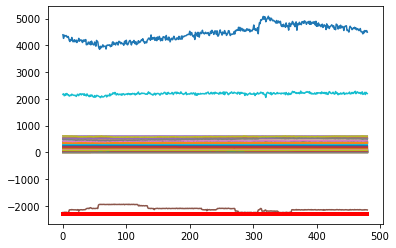

Predicción:  [[[0.97413117 0.02586882]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3128500e+01  1.0980900e+01  6.2167900e+01  7.6864300e+01
  6.1028380e+02  3.2670100e+01  9.2830000e+00  1.9008980e+02
  1.9210000e-01  6.9321500e+01  1.2491500e+02  9.8075000e+00
  6.6666400e+01  1.7707300e+02  2.2374800e+01  1.3586270e+02
  1.8933650e+02  7.0721900e+01 -4.0000000e-04  3.5788000e+00
  1.4614400e+01  7.3022000e+00  1.5017000e+00  7.3240500e+01
  1.4814000e+00  1.5477000e+00  8.5878200e+01  6.2467400e+01
  1.3417000e+00  1.2360000e+00  1.5801000e+00  1.3999000e+00
  1.6463780e+02  8.3650000e-01  8.4040000e-01 -2.1527672e+03
  2.0682540e+02  1.6339000e+00  1.4041000e+00  2.1949365e+03
  4.5723603e+03  1.8481450e+02  1.4336000e+00  1.4231000e+00
  7.8993000e+00  7.4987000e+00  1.7697000e+00  1.8950000e-01
  3.3817900e+01  5.3651550e+02  5.2321740e+02  5.1926220e+02
  5.1995640e+02  5.1974440e+02  2.9275900e+01  3.06

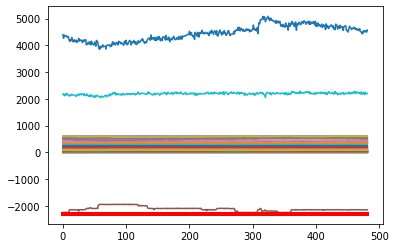

Predicción:  [[[0.97768843 0.0223115 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3082000e+01  1.0948100e+01  6.1397000e+01  7.7708400e+01
  6.1002630e+02  3.2062400e+01  9.2643000e+00  1.9000470e+02
  1.7690000e-01  6.9659500e+01  1.2493490e+02  9.9808000e+00
  6.7096300e+01  1.7542130e+02  2.2390300e+01  1.3568000e+02
  1.8944760e+02  7.0686700e+01 -4.0000000e-04  3.5996000e+00
  1.3483700e+01  7.3097000e+00  1.5004000e+00  7.3242000e+01
  1.4794000e+00  1.5455000e+00  8.5836500e+01  6.2637400e+01
  1.3421000e+00  1.2330000e+00  1.5819000e+00  1.3955000e+00
  1.6598010e+02  8.3560000e-01  8.4080000e-01 -2.1567413e+03
  2.0735760e+02  1.6316000e+00  1.4046000e+00  2.2544081e+03
  4.5256325e+03  1.8481450e+02  1.4294000e+00  1.4188000e+00
  7.8990000e+00  7.5015000e+00  1.7666000e+00  1.8480000e-01
  3.4551500e+01  5.3743330e+02  5.2320560e+02  5.1921780e+02
  5.1979980e+02  5.1963330e+02  2.9351300e+01  3.05

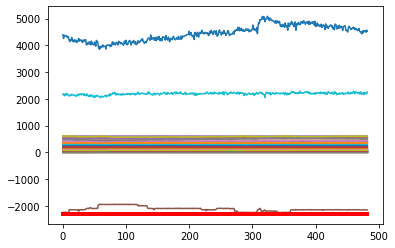

Predicción:  [[[0.9760184  0.02398158]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3143200e+01  1.0928000e+01  6.2064500e+01  7.6723500e+01
  6.1052790e+02  3.2388200e+01  9.2840000e+00  1.8995220e+02
  2.0480000e-01  6.9345700e+01  1.2498960e+02  1.0089400e+01
  6.7313500e+01  1.7636720e+02  2.2486000e+01  1.3573290e+02
  1.8947810e+02  7.0890500e+01 -4.0000000e-04  3.6102000e+00
  1.4606700e+01  7.3272000e+00  1.5004000e+00  7.3319900e+01
  1.4768000e+00  1.5423000e+00  8.6655400e+01  6.2732100e+01
  1.3399000e+00  1.2290000e+00  1.5770000e+00  1.3956000e+00
  1.6752750e+02  8.3460000e-01  8.3970000e-01 -2.1511769e+03
  2.0792110e+02  1.6292000e+00  1.4027000e+00  2.2423209e+03
  4.5668034e+03  1.8481450e+02  1.4299000e+00  1.4187000e+00
  7.8991000e+00  7.4987000e+00  1.7657000e+00  1.8860000e-01
  3.4429700e+01  5.3685110e+02  5.2339840e+02  5.1941130e+02
  5.1995590e+02  5.1979660e+02  2.9553300e+01  3.04

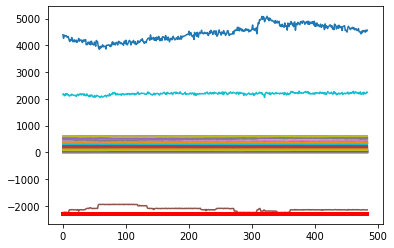

Predicción:  [[[0.9772257  0.02277431]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3395400e+01  1.0910900e+01  6.1256600e+01  7.7167900e+01
  6.1005110e+02  3.2796200e+01  9.2844000e+00  1.9004920e+02
  2.0700000e-01  6.9232000e+01  1.2495400e+02  1.0046300e+01
  6.6785200e+01  1.7612530e+02  2.2226600e+01  1.3562600e+02
  1.8951380e+02  7.0856200e+01 -4.0000000e-04  3.6102000e+00
  1.3553900e+01  7.2729000e+00  1.4992000e+00  7.3288700e+01
  1.4831000e+00  1.5501000e+00  8.6331800e+01  6.2636100e+01
  1.3436000e+00  1.2369000e+00  1.5820000e+00  1.4035000e+00
  1.6645460e+02  8.3510000e-01  8.4020000e-01 -2.1480633e+03
  2.0760450e+02  1.6368000e+00  1.4059000e+00  2.2516993e+03
  4.5937994e+03  1.8481450e+02  1.4381000e+00  1.4265000e+00
  7.9041000e+00  7.4989000e+00  1.7713000e+00  1.8930000e-01
  3.4401800e+01  5.3668010e+02  5.2335520e+02  5.1953330e+02
  5.2010340e+02  5.1997060e+02  2.9150500e+01  3.03

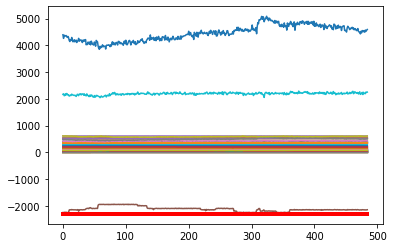

Predicción:  [[[0.97799814 0.02200187]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3204100e+01  1.0955900e+01  6.1556900e+01  7.8177100e+01
  6.1057980e+02  3.2587200e+01  9.3019000e+00  1.8992610e+02
  1.8730000e-01  6.9328900e+01  1.2500070e+02  9.9173000e+00
  6.5767400e+01  1.7574890e+02  2.2252700e+01  1.3564590e+02
  1.8952160e+02  7.0990500e+01 -4.0000000e-04  3.6216000e+00
  1.3462100e+01  7.3028000e+00  1.5008000e+00  7.3330200e+01
  1.4808000e+00  1.5473000e+00  8.7359700e+01  6.2393100e+01
  1.3434000e+00  1.2343000e+00  1.5818000e+00  1.4006000e+00
  1.6707210e+02  8.3560000e-01  8.3960000e-01 -2.1467334e+03
  2.0631850e+02  1.6337000e+00  1.4058000e+00  2.2275619e+03
  4.6024153e+03  1.8481450e+02  1.4353000e+00  1.4239000e+00
  7.8989000e+00  7.5030000e+00  1.7701000e+00  1.8830000e-01
  3.4634100e+01  5.3748650e+02  5.2347860e+02  5.1968550e+02
  5.2020070e+02  5.2008100e+02  2.8882700e+01  3.03

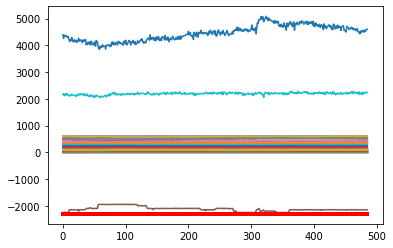

Predicción:  [[[0.97821873 0.02178133]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3083600e+01  1.0928500e+01  6.1235200e+01  7.7714200e+01
  6.1011620e+02  3.2224500e+01  9.2882000e+00  1.9001610e+02
  1.8500000e-01  6.9917700e+01  1.2489870e+02  1.0060200e+01
  6.5454800e+01  1.7691880e+02  2.2329400e+01  1.3759800e+02
  1.8944130e+02  7.0868000e+01 -4.0000000e-04  3.6011000e+00
  1.4818300e+01  7.3165000e+00  1.5007000e+00  7.3303500e+01
  1.4804000e+00  1.5470000e+00  8.6462800e+01  6.2090200e+01
  1.3457000e+00  1.2324000e+00  1.5757000e+00  1.3977000e+00
  1.6731930e+02  8.3550000e-01  8.3970000e-01 -2.1581499e+03
  2.0606210e+02  1.6336000e+00  1.4078000e+00  2.2149485e+03
  4.5371276e+03  1.8481450e+02  1.4328000e+00  1.4214000e+00
  7.9026000e+00  7.4952000e+00  1.7694000e+00  1.9330000e-01
  3.5046200e+01  5.3733330e+02  5.2387160e+02  5.1990360e+02
  5.2040810e+02  5.2032740e+02  2.8960900e+01  3.01

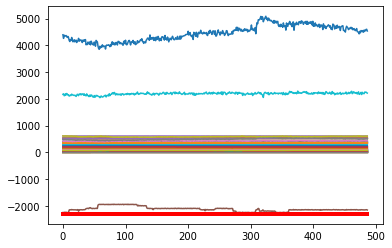

Predicción:  [[[0.97694844 0.02305157]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2938200e+01  1.0972700e+01  6.1206100e+01  7.6539000e+01
  6.0931570e+02  3.1941600e+01  9.2824000e+00  1.8993780e+02
  3.8540000e-01  7.0687900e+01  1.2471150e+02  9.9993000e+00
  6.5566100e+01  1.7750900e+02  2.1980900e+01  1.3899480e+02
  1.8945280e+02  7.0756700e+01 -4.0000000e-04  3.5970000e+00
  1.5408900e+01  7.2795000e+00  1.5005000e+00  7.3281900e+01
  1.4791000e+00  1.5458000e+00  8.6498600e+01  6.2033700e+01
  1.3390000e+00  1.2326000e+00  1.5707000e+00  1.3990000e+00
  1.6592920e+02  8.3700000e-01  8.3940000e-01 -2.1538207e+03
  2.0645450e+02  1.6326000e+00  1.4009000e+00  2.1996219e+03
  4.6392955e+03  1.8481450e+02  1.4339000e+00  1.4227000e+00
  7.8999000e+00  7.5087000e+00  1.7687000e+00  1.9750000e-01
  3.4819000e+01  5.3614890e+02  5.2324870e+02  5.1946590e+02
  5.1988850e+02  5.1989480e+02  2.8837700e+01  3.00

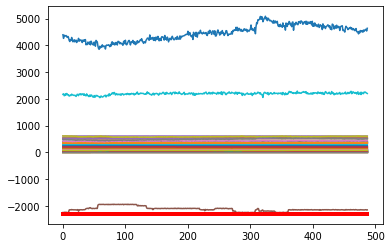

Predicción:  [[[0.9807107 0.0192893]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2984700e+01  1.0964100e+01  5.9473200e+01  7.8180900e+01
  6.1048960e+02  3.2648900e+01  9.2483000e+00  1.8984860e+02
  7.1590000e-01  7.0743400e+01  1.2531430e+02  9.8669000e+00
  6.4704400e+01  1.7613320e+02  2.0946000e+01  1.3807690e+02
  1.8953090e+02  7.0995900e+01 -4.0000000e-04  3.5982000e+00
  1.3850400e+01  7.3061000e+00  1.5003000e+00  7.3317800e+01
  1.4666000e+00  1.5325000e+00  8.6615700e+01  6.3053800e+01
  1.3287000e+00  1.2212000e+00  1.5604000e+00  1.3848000e+00
  1.6509040e+02  8.3580000e-01  8.3960000e-01 -2.1436762e+03
  2.0709240e+02  1.6196000e+00  1.3915000e+00  2.2411900e+03
  4.5708895e+03  1.8481450e+02  1.4191000e+00  1.4088000e+00
  7.8992000e+00  7.4978000e+00  1.7536000e+00  1.9360000e-01
  3.4663300e+01  5.3576670e+02  5.2282720e+02  5.1882020e+02
  5.1928020e+02  5.1918930e+02  2.8150000e+01  2.9664

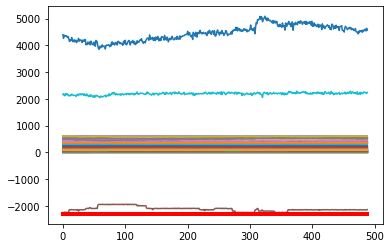

Predicción:  [[[0.9762996  0.02370044]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3078500e+01  1.0990600e+01  6.0063100e+01  7.8134700e+01
  6.1067020e+02  3.2482300e+01  9.2271000e+00  1.8992530e+02
  4.6310000e-01  7.0616500e+01  1.2502940e+02  1.0265200e+01
  6.4821700e+01  1.7729260e+02  2.1673000e+01  1.3729010e+02
  1.8965690e+02  7.0928300e+01 -4.0000000e-04  3.5826000e+00
  1.5145700e+01  7.3321000e+00  1.4998000e+00  7.3285500e+01
  1.4744000e+00  1.5396000e+00  8.6436700e+01  6.3088000e+01
  1.3360000e+00  1.2272000e+00  1.5596000e+00  1.3913000e+00
  1.6597740e+02  8.3610000e-01  8.4000000e-01 -2.1619439e+03
  2.0902410e+02  1.6254000e+00  1.3992000e+00  2.2141931e+03
  4.5463384e+03  1.8481450e+02  1.4259000e+00  1.4150000e+00
  7.8964000e+00  7.5038000e+00  1.7623000e+00  2.0260000e-01
  3.4841800e+01  5.3633550e+02  5.2322570e+02  5.1951010e+02
  5.2003470e+02  5.1988160e+02  2.8555100e+01  2.95

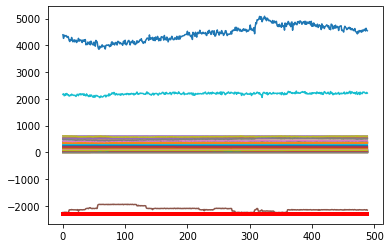

Predicción:  [[[0.9780688 0.0219312]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3187700e+01  1.1054100e+01  6.1151700e+01  7.7603300e+01
  6.0940430e+02  3.2056200e+01  9.2456000e+00  1.9002070e+02
  1.5900000e-01  7.0980000e+01  1.2487210e+02  1.0013900e+01
  6.5596000e+01  1.7566830e+02  2.1966700e+01  1.3688910e+02
  1.8960000e+02  7.0932600e+01 -4.0000000e-04  3.6081000e+00
  1.3326600e+01  7.2947000e+00  1.5005000e+00  7.3317100e+01
  1.4900000e+00  1.5539000e+00  8.7106000e+01  6.3061600e+01
  1.3518000e+00  1.2407000e+00  1.5754000e+00  1.4078000e+00
  1.6752150e+02  8.3570000e-01  8.4010000e-01 -2.1501381e+03
  2.0852010e+02  1.6405000e+00  1.4145000e+00  2.2172952e+03
  4.5805726e+03  1.8481450e+02  1.4427000e+00  1.4320000e+00
  7.8999000e+00  7.5014000e+00  1.7760000e+00  2.0060000e-01
  3.4998100e+01  5.3694890e+02  5.2395900e+02  5.2014330e+02
  5.2070180e+02  5.2048930e+02  2.8415100e+01  2.9677

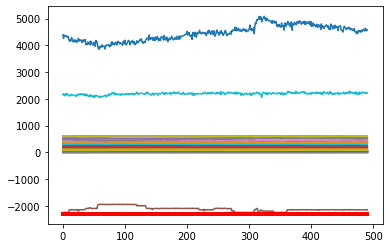

Predicción:  [[[0.97780126 0.02219871]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2584600e+01  1.0994200e+01  6.1500700e+01  7.8147100e+01
  6.0995400e+02  3.4730200e+01  9.2464000e+00  1.9003290e+02
  1.0360000e-01  7.0114500e+01  1.2495840e+02  1.0171800e+01
  6.6586500e+01  1.7849700e+02  2.1821200e+01  1.3812810e+02
  1.8952540e+02  7.1023600e+01 -4.0000000e-04  3.5982000e+00
  1.3625900e+01  7.3060000e+00  1.4999000e+00  7.3237200e+01
  1.4834000e+00  1.5482000e+00  8.5646300e+01  6.3166700e+01
  1.3411000e+00  1.2356000e+00  1.5638000e+00  1.3974000e+00
  1.6489340e+02  8.3330000e-01  8.3970000e-01 -2.1542288e+03
  2.0726370e+02  1.6343000e+00  1.4041000e+00  2.2037913e+03
  4.5791186e+03  1.8481450e+02  1.4283000e+00  1.4222000e+00
  7.9009000e+00  7.5003000e+00  1.7718000e+00  2.0810000e-01
  3.1329000e+01  5.3631780e+02  5.2372850e+02  5.1963080e+02
  5.2028790e+02  5.2010560e+02  2.8226600e+01  2.96

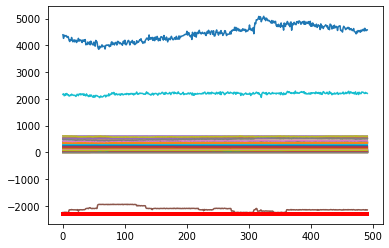

Predicción:  [[[0.97832435 0.02167569]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1992600e+01  1.0934700e+01  6.1169400e+01  7.6953700e+01
  6.0974560e+02  3.2116900e+01  9.2434000e+00  1.8996510e+02
  7.5100000e-02  6.9044500e+01  1.2500330e+02  1.0142300e+01
  6.6078500e+01  1.7542070e+02  2.0931300e+01  1.3850740e+02
  1.8941390e+02  7.0893600e+01 -4.0000000e-04  3.5990000e+00
  1.4918300e+01  7.2858000e+00  1.4992000e+00  7.3331000e+01
  1.4807000e+00  1.5463000e+00  8.6162000e+01  6.3357800e+01
  1.3389000e+00  1.2330000e+00  1.5625000e+00  1.3997000e+00
  1.6534260e+02  8.3500000e-01  8.3930000e-01 -2.1452215e+03
  2.0814550e+02  1.6329000e+00  1.4022000e+00  2.2038401e+03
  4.6113963e+03  1.8481450e+02  1.4309000e+00  1.4225000e+00
  7.9014000e+00  7.4876000e+00  1.7713000e+00  2.0850000e-01
  3.1151300e+01  5.3559780e+02  5.2292110e+02  5.1902620e+02
  5.1969980e+02  5.1965190e+02  2.8962300e+01  2.96

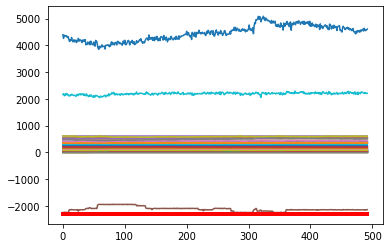

Predicción:  [[[0.9785125  0.02148741]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2169500e+01  1.0838200e+01  5.8823600e+01  7.7775200e+01
  6.1000830e+02  3.1730700e+01  9.2161000e+00  1.9005410e+02
  7.1300000e-02  6.9329800e+01  1.2497180e+02  9.9943000e+00
  6.5842500e+01  1.7361370e+02  2.0112700e+01  1.3729740e+02
  1.8943360e+02  7.1093300e+01 -4.0000000e-04  3.5985000e+00
  1.2739600e+01  7.2923000e+00  1.5012000e+00  7.3288300e+01
  1.4839000e+00  1.5505000e+00  8.6992400e+01  6.3049000e+01
  1.3410000e+00  1.2330000e+00  1.5730000e+00  1.4024000e+00
  1.6771810e+02  8.3570000e-01  8.3970000e-01 -2.1475297e+03
  2.0593250e+02  1.6370000e+00  1.4047000e+00  2.2192396e+03
  4.6727984e+03  1.8481450e+02  1.4337000e+00  1.4278000e+00
  7.8990000e+00  7.5098000e+00  1.7731000e+00  2.0000000e-01
  3.1004200e+01  5.3648660e+02  5.2375190e+02  5.1988400e+02
  5.2055730e+02  5.2067350e+02  2.8323900e+01  2.95

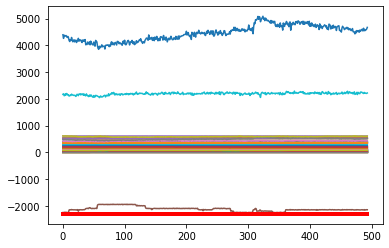

Predicción:  [[[0.9813483 0.0186518]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2849100e+01  1.1324000e+01  6.1670700e+01  7.9218100e+01
  6.1033270e+02  3.1254900e+01  9.3305000e+00  1.8995240e+02
  8.7100000e-02  6.8686200e+01  1.2491840e+02  1.0118100e+01
  6.5930100e+01  1.7540600e+02  2.0537800e+01  1.3807440e+02
  1.8978960e+02  7.1105500e+01 -4.0000000e-04  3.6058000e+00
  1.4314800e+01  7.2952000e+00  1.4993000e+00  7.3315100e+01
  1.4777000e+00  1.5440000e+00  8.6367400e+01  6.3342300e+01
  1.3384000e+00  1.2288000e+00  1.5626000e+00  1.3942000e+00
  1.6536860e+02  8.3790000e-01  8.4100000e-01 -2.1482871e+03
  2.0914620e+02  1.6305000e+00  1.4020000e+00  2.2051687e+03
  4.6857994e+03  1.8481450e+02  1.4291000e+00  1.4222000e+00
  7.9012000e+00  7.5054000e+00  1.7691000e+00  2.0670000e-01
  3.4791400e+01  5.3508440e+02  5.2266370e+02  5.1865450e+02
  5.1926840e+02  5.1956830e+02  2.8088900e+01  2.9303

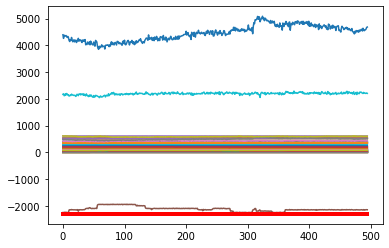

Predicción:  [[[0.98195434 0.01804564]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2558700e+01  1.1146400e+01  6.2011400e+01  7.9754800e+01
  6.1028360e+02  3.1149400e+01  9.4231000e+00  1.8997790e+02
  1.2320000e-01  6.8744800e+01  1.2487210e+02  9.8996000e+00
  6.7138900e+01  1.7468010e+02  2.1117100e+01  1.3978330e+02
  1.8992570e+02  7.0669100e+01 -4.0000000e-04  3.5976000e+00
  1.4583300e+01  7.3330000e+00  1.4990000e+00  7.3245100e+01
  1.4937000e+00  1.5590000e+00  8.5856700e+01  6.2608300e+01
  1.3538000e+00  1.2420000e+00  1.5775000e+00  1.4063000e+00
  1.6535530e+02  8.3850000e-01  8.4110000e-01 -2.1604521e+03
  2.0833780e+02  1.6449000e+00  1.4165000e+00  2.2252936e+03
  4.5318197e+03  1.8481450e+02  1.4374000e+00  1.4314000e+00
  7.9012000e+00  7.5003000e+00  1.7837000e+00  2.0650000e-01
  3.1659600e+01  5.3629350e+02  5.2287950e+02  5.1900260e+02
  5.1987900e+02  5.2006060e+02  2.8652800e+01  2.97

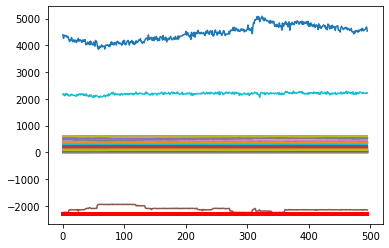

Predicción:  [[[0.9771722  0.02282783]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2711800e+01  1.0874900e+01  6.1153900e+01  8.0528200e+01
  6.0995140e+02  3.2279900e+01  9.3258000e+00  1.8995830e+02
  1.0940000e-01  6.8878800e+01  1.2481830e+02  1.0246400e+01
  6.3601400e+01  1.7409080e+02  2.2018000e+01  1.3963120e+02
  1.8946420e+02  7.0714600e+01 -6.6615000e+00  3.6009000e+00
  1.3291500e+01  7.3023000e+00  1.4997000e+00  7.3274700e+01
  1.4937000e+00  1.5596000e+00  8.5876900e+01  6.3218000e+01
  1.3560000e+00  1.2434000e+00  1.5781000e+00  1.4075000e+00
  1.6604460e+02  8.3880000e-01  8.4030000e-01 -2.1520925e+03
  2.0853920e+02  1.6463000e+00  1.4191000e+00  2.2306128e+03
  4.6258623e+03  1.8481450e+02  1.4372000e+00  1.4329000e+00
  7.9013000e+00  7.5015000e+00  1.7818000e+00  2.0370000e-01
  3.0035300e+01  5.3698660e+02  5.2410430e+02  5.1989630e+02
  5.2083720e+02  5.2091500e+02  2.8850200e+01  3.00

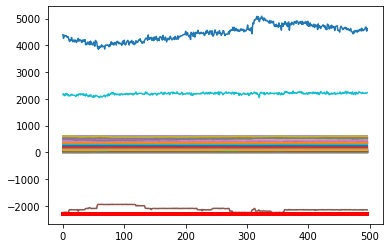

Predicción:  [[[0.9799318  0.02006819]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  497  - Datos Recibidos:  [ 4.3151700e+01  1.0960500e+01  6.2445100e+01  7.8341200e+01
  6.0991710e+02  3.2065000e+01  9.2493000e+00  1.9006050e+02
  1.0390000e-01  6.8519900e+01  1.2508880e+02  9.9299000e+00
  6.3682500e+01  1.7494680e+02  2.1774600e+01  1.4069450e+02
  1.8938560e+02  7.0762500e+01 -6.8991000e+00  3.6471000e+00
  1.4770400e+01  7.3033000e+00  1.4989000e+00  7.3327400e+01
  1.4789000e+00  1.5479000e+00  8.5888400e+01  6.4064700e+01
  1.3416000e+00  1.2351000e+00  1.5633000e+00  1.4003000e+00
  1.6287690e+02  8.3750000e-01  8.3980000e-01 -2.1416475e+03
  2.0728320e+02  1.6335000e+00  1.4057000e+00  2.2109017e+03
  4.6573606e+03  1.8481450e+02  1.4302000e+00  1.4275000e+00
  7.8985000e+00  7.4990000e+00  1.7719000e+00  2.0800000e-01
  2.9662800e+01  5.3595330e+02  5.2331700e+02  5.1917550e+02
  5.2006690e+02  5.2023450e+02  2.929030

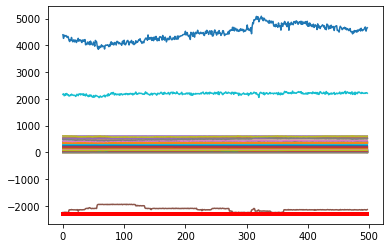

Predicción:  [[[0.97993934 0.02006062]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3151700e+01  1.0960500e+01  6.2445100e+01  7.8341200e+01
  6.0991710e+02  3.2065000e+01  9.2493000e+00  1.9006050e+02
  1.0390000e-01  6.8519900e+01  1.2508880e+02  9.9299000e+00
  6.3682500e+01  1.7494680e+02  2.1774600e+01  1.4069450e+02
  1.8938560e+02  7.0762500e+01 -6.8991000e+00  3.6471000e+00
  1.4770400e+01  7.3033000e+00  1.4989000e+00  7.3327400e+01
  1.4789000e+00  1.5479000e+00  8.5888400e+01  6.4064700e+01
  1.3416000e+00  1.2351000e+00  1.5633000e+00  1.4003000e+00
  1.6287690e+02  8.3750000e-01  8.3980000e-01 -2.1416475e+03
  2.0728320e+02  1.6335000e+00  1.4057000e+00  2.2109017e+03
  4.6573606e+03  1.8481450e+02  1.4302000e+00  1.4275000e+00
  7.8985000e+00  7.4990000e+00  1.7719000e+00  2.0800000e-01
  2.9662800e+01  5.3595330e+02  5.2331700e+02  5.1917550e+02
  5.2006690e+02  5.2023450e+02  2.9290300e+01  3.03

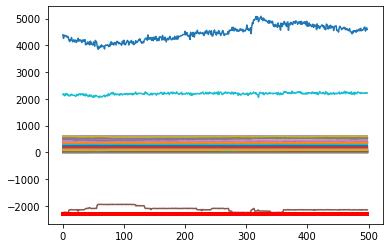

Predicción:  [[[0.979081   0.02091908]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2535500e+01  1.1279500e+01  6.2705500e+01  7.7621400e+01
  6.1073050e+02  3.3485200e+01  9.3134000e+00  1.8996900e+02
  7.0900000e-02  6.8195800e+01  1.2519100e+02  9.9800000e+00
  6.5963800e+01  1.7603040e+02  2.1868400e+01  1.3712390e+02
  1.9012530e+02  7.0738900e+01 -6.8991000e+00  3.6037000e+00
  1.5573600e+01  7.2873000e+00  1.5003000e+00  7.3351200e+01
  1.4741000e+00  1.5422000e+00  8.5973700e+01  6.3498000e+01
  1.3373000e+00  1.2296000e+00  1.5525000e+00  1.3923000e+00
  1.6259330e+02  8.3890000e-01  8.3980000e-01 -2.1506611e+03
  2.0605630e+02  1.6278000e+00  1.4009000e+00  2.2665525e+03
  4.6017921e+03  1.8481450e+02  1.4215000e+00  1.4187000e+00
  7.8997000e+00  7.5031000e+00  1.7667000e+00  2.1460000e-01
  2.9139000e+01  5.3588670e+02  5.2279420e+02  5.1874130e+02
  5.1966270e+02  5.1982640e+02  2.9999800e+01  3.08

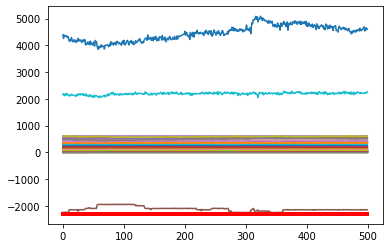

Predicción:  [[[0.9787369  0.02126315]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2588600e+01  1.1168400e+01  6.2607300e+01  7.7024800e+01
  6.0985200e+02  3.4816900e+01  9.3426000e+00  1.8994190e+02
  5.9700000e-02  6.8268500e+01  1.2479820e+02  9.9802000e+00
  6.5927400e+01  1.7720260e+02  2.2140100e+01  1.3691590e+02
  1.9005390e+02  7.0517800e+01 -6.8991000e+00  3.5863000e+00
  1.4909800e+01  7.3021000e+00  1.5015000e+00  7.3281400e+01
  1.4902000e+00  1.5583000e+00  8.4906000e+01  6.2383100e+01
  1.3520000e+00  1.2474000e+00  1.5612000e+00  1.4079000e+00
  1.6209780e+02  8.3880000e-01  8.4020000e-01 -2.1589652e+03
  2.0652580e+02  1.6430000e+00  1.4141000e+00  2.2685210e+03
  4.5445923e+03  1.8481450e+02  1.4373000e+00  1.4330000e+00
  7.9011000e+00  7.5017000e+00  1.7797000e+00  2.1850000e-01
  2.9530200e+01  5.3628000e+02  5.2299210e+02  5.1913630e+02
  5.2001420e+02  5.2008390e+02  2.9696800e+01  3.10

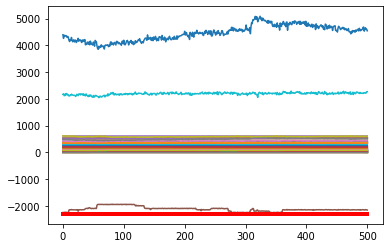

Predicción:  [[[0.9772819  0.02271803]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2960100e+01  1.1159900e+01  6.2346500e+01  7.8015000e+01
  6.1008000e+02  3.4627700e+01  9.3433000e+00  1.9003530e+02
  4.8500000e-02  6.8499300e+01  1.2506140e+02  1.0015600e+01
  6.5673600e+01  1.7500020e+02  2.2425000e+01  1.3619590e+02
  1.9004620e+02  7.0603100e+01 -6.8991000e+00  3.6126000e+00
  1.3421200e+01  7.2958000e+00  1.5010000e+00  7.3297900e+01
  1.4900000e+00  1.5593000e+00  8.5444400e+01  6.2330100e+01
  1.3516000e+00  1.2467000e+00  1.5677000e+00  1.4098000e+00
  1.6343260e+02  8.3860000e-01  8.4040000e-01 -2.1505101e+03
  2.0762670e+02  1.6449000e+00  1.4139000e+00  2.2484906e+03
  4.5665331e+03  1.8481450e+02  1.4390000e+00  1.4336000e+00
  7.8999000e+00  7.4997000e+00  1.7809000e+00  2.1320000e-01
  2.9211700e+01  5.3654890e+02  5.2317860e+02  5.1925310e+02
  5.2007010e+02  5.2005920e+02  3.0071100e+01  3.13

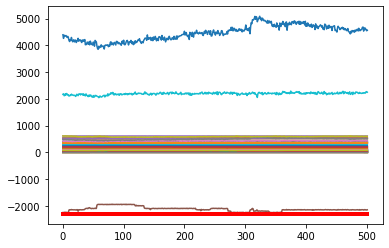

Predicción:  [[[0.9770733  0.02292676]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3397400e+01  1.1060600e+01  6.1834300e+01  7.8070900e+01
  6.1006700e+02  3.3913200e+01  9.3901000e+00  1.9005300e+02
  3.8600000e-02  6.8419400e+01  1.2511470e+02  1.0139400e+01
  6.5587400e+01  1.7528560e+02  2.2455800e+01  1.3554630e+02
  1.8986910e+02  7.0713300e+01 -6.8991000e+00  3.6191000e+00
  1.4206600e+01  7.3152000e+00  1.4990000e+00  7.3329300e+01
  1.4854000e+00  1.5556000e+00  8.6768300e+01  6.1822700e+01
  1.3487000e+00  1.2416000e+00  1.5637000e+00  1.4075000e+00
  1.6516640e+02  8.3690000e-01  8.3990000e-01 -2.1490266e+03
  2.0593470e+02  1.6425000e+00  1.4104000e+00  2.2369226e+03
  4.6466006e+03  1.8481450e+02  1.4393000e+00  1.4315000e+00
  7.9020000e+00  7.4970000e+00  1.7773000e+00  2.1380000e-01
  3.1510100e+01  5.3641560e+02  5.2346270e+02  5.1948580e+02
  5.2027350e+02  5.2028130e+02  3.0082500e+01  3.13

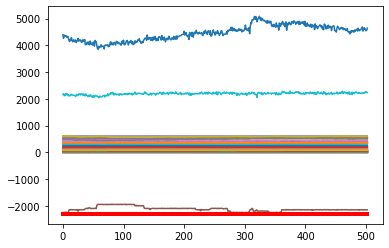

Predicción:  [[[0.980293 0.019707]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3759100e+01  1.1347000e+01  6.1775900e+01  7.6456100e+01
  6.0985070e+02  3.3430400e+01  9.3870000e+00  1.8997420e+02
  3.3800000e-02  6.8251800e+01  1.2504260e+02  1.0002800e+01
  6.5770100e+01  1.7523160e+02  2.2461100e+01  1.3558610e+02
  1.8998000e+02  7.0826300e+01 -6.8991000e+00  3.6240000e+00
  1.5179700e+01  7.3032000e+00  1.4996000e+00  7.3291300e+01
  1.4791000e+00  1.5481000e+00  8.6199100e+01  6.2784100e+01
  1.3411000e+00  1.2348000e+00  1.5536000e+00  1.3993000e+00
  1.6429640e+02  8.3820000e-01  8.4010000e-01 -2.1484171e+03
  2.0499130e+02  1.6344000e+00  1.4035000e+00  2.2395187e+03
  4.5036604e+03  1.8481450e+02  1.4336000e+00  1.4282000e+00
  7.8973000e+00  7.4993000e+00  1.7713000e+00  2.1760000e-01
  3.4349200e+01  5.3585330e+02  5.2296400e+02  5.1890850e+02
  5.1963050e+02  5.1968920e+02  3.0702500e+01  3.140600

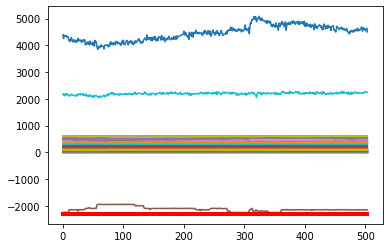

Predicción:  [[[0.9735541  0.02644592]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3986900e+01  1.1541600e+01  6.1622500e+01  7.6680100e+01
  6.1043500e+02  3.2978400e+01  9.3958000e+00  1.8998880e+02
  2.9400000e-02  6.8460800e+01  1.2476950e+02  9.7960000e+00
  6.6574900e+01  1.7334240e+02  2.2625500e+01  1.3264720e+02
  1.9032320e+02  7.0434700e+01 -6.8991000e+00  3.5984000e+00
  1.4069600e+01  7.2744000e+00  1.4996000e+00  7.3285300e+01
  1.4873000e+00  1.5549000e+00  8.5337800e+01  6.1895500e+01
  1.3498000e+00  1.2419000e+00  1.5663000e+00  1.4008000e+00
  1.6591610e+02  8.3880000e-01  8.4060000e-01 -2.1523770e+03
  2.0481830e+02  1.6399000e+00  1.4119000e+00  2.2489487e+03
  4.5175657e+03  1.8481450e+02  1.4340000e+00  1.4278000e+00
  7.9167000e+00  7.4997000e+00  1.7788000e+00  2.1200000e-01
  3.3146100e+01  5.3616230e+02  5.2263140e+02  5.1881400e+02
  5.1952740e+02  5.1971680e+02  3.0537400e+01  3.16

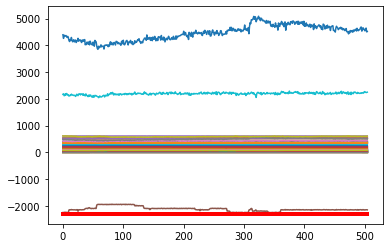

Predicción:  [[[0.9748206  0.02517941]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4048100e+01  1.1614200e+01  6.2170000e+01  7.7785600e+01
  6.0976450e+02  3.2753000e+01  9.4336000e+00  1.8999680e+02
  2.5100000e-02  6.8662200e+01  1.2495370e+02  1.0007400e+01
  6.6036800e+01  1.7346950e+02  2.3407600e+01  1.3150300e+02
  1.9045900e+02  7.0599100e+01 -6.8991000e+00  3.5905000e+00
  1.4028700e+01  7.3208000e+00  1.4994000e+00  7.3280300e+01
  1.4901000e+00  1.5596000e+00  8.5001900e+01  6.2224500e+01
  1.3515000e+00  1.2419000e+00  1.5674000e+00  1.4094000e+00
  1.6819590e+02  8.3850000e-01  8.4110000e-01 -2.1522761e+03
  2.0626620e+02  1.6442000e+00  1.4133000e+00  2.2756201e+03
  4.5819083e+03  1.8481450e+02  1.4438000e+00  1.4341000e+00
  7.8971000e+00  7.4959000e+00  1.7826000e+00  2.1550000e-01
  3.4322400e+01  5.3688440e+02  5.2314940e+02  5.1941330e+02
  5.2012720e+02  5.2016900e+02  3.0798600e+01  3.19

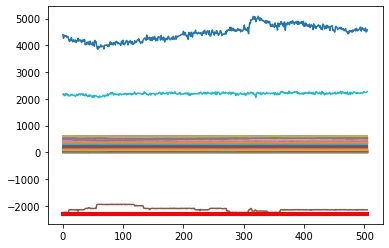

Predicción:  [[[0.97787774 0.02212219]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3971100e+01  1.1630600e+01  6.2740500e+01  7.5783000e+01
  6.1089500e+02  3.2528700e+01  9.3676000e+00  1.8998720e+02
  2.2200000e-02  6.9782200e+01  1.2508590e+02  1.0027100e+01
  6.6791000e+01  1.7577110e+02  2.3250100e+01  1.3104920e+02
  1.9053490e+02  7.0432100e+01 -6.8991000e+00  3.6036000e+00
  1.5740000e+01  7.3050000e+00  1.5001000e+00  7.3228400e+01
  1.4829000e+00  1.5532000e+00  8.5092700e+01  6.2285000e+01
  1.3454000e+00  1.2362000e+00  1.5493000e+00  1.4040000e+00
  1.6684240e+02  8.3870000e-01  8.3960000e-01 -2.1460588e+03
  2.0607250e+02  1.6392000e+00  1.4073000e+00  2.1689845e+03
  4.6379736e+03  1.8481450e+02  1.4378000e+00  1.4305000e+00
  7.8961000e+00  7.5008000e+00  1.7748000e+00  2.2550000e-01
  3.3913600e+01  5.3633550e+02  5.2304740e+02  5.1909490e+02
  5.1974330e+02  5.1976130e+02  3.1055800e+01  3.19

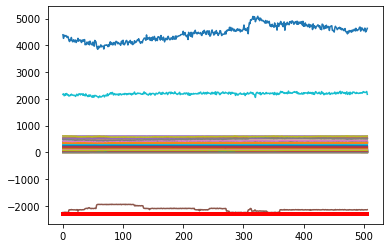

Predicción:  [[[0.97953826 0.02046178]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3849700e+01  1.1600000e+01  6.2772500e+01  7.6540200e+01
  6.0960380e+02  3.2666600e+01  9.5263000e+00  1.9000220e+02
  2.4900000e-02  6.9720700e+01  1.2484300e+02  9.9676000e+00
  6.5528700e+01  1.7450930e+02  2.2971300e+01  1.2941050e+02
  1.9064370e+02  7.0647000e+01 -6.8991000e+00  3.7103000e+00
  1.4427200e+01  7.2872000e+00  1.5009000e+00  7.3334700e+01
  1.4921000e+00  1.5634000e+00  8.5404500e+01  6.0734700e+01
  1.3584000e+00  1.2457000e+00  1.5580000e+00  1.4144000e+00
  1.6814360e+02  8.3840000e-01  8.4020000e-01 -2.1519036e+03
  2.0460590e+02  1.6483000e+00  1.4194000e+00  2.2407532e+03
  4.5908773e+03  1.8481450e+02  1.4482000e+00  1.4391000e+00
  7.8998000e+00  7.4995000e+00  1.7820000e+00  2.2350000e-01
  3.3839800e+01  5.3659780e+02  5.2251010e+02  5.1869720e+02
  5.1928380e+02  5.1936040e+02  3.0687100e+01  3.20

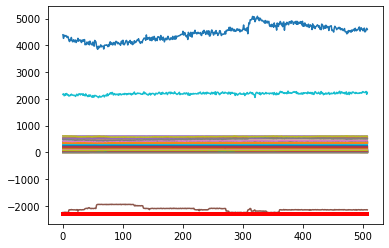

Predicción:  [[[0.9781878 0.0218122]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4009000e+01  1.1666200e+01  6.1351200e+01  7.7840200e+01
  6.0940110e+02  3.3325200e+01  9.4877000e+00  1.8993200e+02
  2.8200000e-02  6.9750900e+01  1.2507890e+02  9.9190000e+00
  6.6375500e+01  1.7433390e+02  2.3088900e+01  1.2874460e+02
  1.9061700e+02  7.0413300e+01 -6.8991000e+00  3.7022000e+00
  1.3585700e+01  7.2902000e+00  1.4995000e+00  7.3280000e+01
  1.4966000e+00  1.5653000e+00  8.6123000e+01  6.0528200e+01
  1.3640000e+00  1.2461000e+00  1.5673000e+00  1.4171000e+00
  1.7138510e+02  8.3900000e-01  8.3980000e-01 -2.1541968e+03
  2.0664210e+02  1.6512000e+00  1.4244000e+00  2.2534344e+03
  4.5127159e+03  1.8481450e+02  1.4509000e+00  1.4436000e+00
  7.9034000e+00  7.5009000e+00  1.7855000e+00  2.1840000e-01
  3.3895600e+01  5.3735110e+02  5.2375370e+02  5.1982770e+02
  5.2030290e+02  5.2035570e+02  3.0659500e+01  3.1831

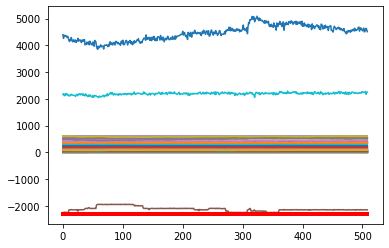

Predicción:  [[[0.97485924 0.02514075]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4136400e+01  1.1644400e+01  6.2039800e+01  7.7095000e+01
  6.0937570e+02  3.3369400e+01  9.5066000e+00  1.9005920e+02
  3.1500000e-02  6.9610100e+01  1.2506240e+02  1.0037900e+01
  6.5364000e+01  1.7513850e+02  2.3256600e+01  1.3052350e+02
  1.9038170e+02  7.0326700e+01 -6.8991000e+00  3.7263000e+00
  1.5048000e+01  7.3204000e+00  1.5009000e+00  7.3306900e+01
  1.5014000e+00  1.5677000e+00  8.6237800e+01  6.0210300e+01
  1.3700000e+00  1.2535000e+00  1.5667000e+00  1.4200000e+00
  1.7018190e+02  8.3870000e-01  8.3990000e-01 -2.1555377e+03
  2.0524580e+02  1.6537000e+00  1.4298000e+00  2.2870982e+03
  4.4558260e+03  1.8481450e+02  1.4520000e+00  1.4439000e+00
  7.8961000e+00  7.5012000e+00  1.7909000e+00  2.2420000e-01
  3.2303800e+01  5.3720220e+02  5.2329420e+02  5.1933400e+02
  5.1969770e+02  5.1976000e+02  3.1130300e+01  3.19

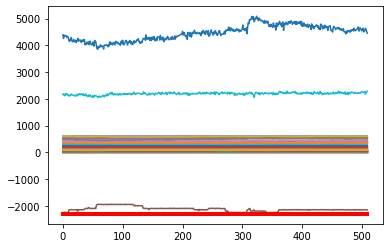

Predicción:  [[[0.971904  0.0280961]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4226600e+01  1.1608300e+01  6.2276400e+01  7.7351700e+01
  6.0994480e+02  3.3849900e+01  9.4896000e+00  1.8992690e+02
  2.9800000e-02  6.9662600e+01  1.2493650e+02  9.9352000e+00
  6.5764600e+01  1.7531600e+02  2.3290700e+01  1.3100390e+02
  1.9037040e+02  7.0407900e+01 -6.8991000e+00  3.7094000e+00
  1.3765500e+01  7.3078000e+00  1.5012000e+00  7.3284500e+01
  1.4947000e+00  1.5618000e+00  8.6736000e+01  6.1444600e+01
  1.3597000e+00  1.2498000e+00  1.5596000e+00  1.4162000e+00
  1.6727730e+02  8.3870000e-01  8.4010000e-01 -2.1537577e+03
  2.0561870e+02  1.6481000e+00  1.4208000e+00  2.2443040e+03
  4.5821351e+03  1.8481450e+02  1.4468000e+00  1.4409000e+00
  7.9016000e+00  7.5027000e+00  1.7842000e+00  2.2430000e-01
  3.0537100e+01  5.3621560e+02  5.2298720e+02  5.1908770e+02
  5.1945210e+02  5.1956340e+02  3.1132500e+01  3.2119

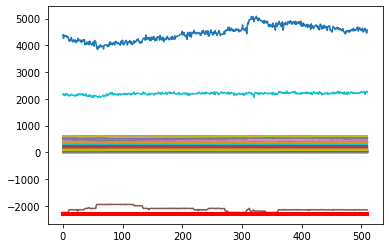

Predicción:  [[[0.9781466  0.02185337]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4331700e+01  1.1578400e+01  6.1779800e+01  7.7467500e+01
  6.0940430e+02  3.3500600e+01  9.4847000e+00  1.9002450e+02
  1.1000000e-02  6.9229300e+01  1.2497460e+02  9.9606000e+00
  6.5522300e+01  1.7448410e+02  2.3434100e+01  1.3179040e+02
  1.9032320e+02  7.0372100e+01 -6.8991000e+00  3.7028000e+00
  1.3653100e+01  7.2771000e+00  1.4993000e+00  7.3314700e+01
  1.5009000e+00  1.5701000e+00  8.6269500e+01  6.0911900e+01
  1.3623000e+00  1.2549000e+00  1.5670000e+00  1.4258000e+00
  1.6787660e+02  8.3920000e-01  8.4010000e-01 -2.1482436e+03
  2.0328950e+02  1.6562000e+00  1.4234000e+00  2.2416687e+03
  4.6646994e+03  1.8481450e+02  1.4566000e+00  1.4504000e+00
  7.9034000e+00  7.4937000e+00  1.7916000e+00  2.2460000e-01
  3.0634900e+01  5.3689990e+02  5.2306720e+02  5.1947710e+02
  5.1992450e+02  5.1991910e+02  3.1098000e+01  3.21

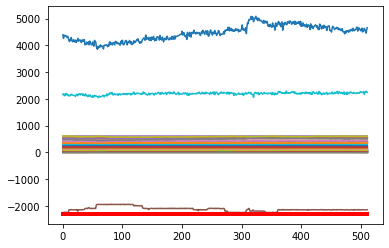

Predicción:  [[[0.9807748  0.01922523]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4330200e+01  1.1641600e+01  6.1948900e+01  7.7610700e+01
  6.0924360e+02  3.2357000e+01  9.4854000e+00  1.9004130e+02
  5.0000000e-04  6.9453500e+01  1.2497400e+02  9.9178000e+00
  6.6447200e+01  1.7305500e+02  2.3036500e+01  1.3149840e+02
  1.9034470e+02  7.0613500e+01 -6.8991000e+00  3.6873000e+00
  1.2791700e+01  7.2968000e+00  1.5010000e+00  7.3299800e+01
  1.5001000e+00  1.5704000e+00  8.4700600e+01  6.1510600e+01
  1.3625000e+00  1.2539000e+00  1.5689000e+00  1.4229000e+00
  1.6848210e+02  8.3860000e-01  8.3980000e-01 -2.1451841e+03
  2.0375580e+02  1.6551000e+00  1.4240000e+00  2.2722244e+03
  4.5924778e+03  1.8481450e+02  1.4523000e+00  1.4479000e+00
  7.9004000e+00  7.5067000e+00  1.7911000e+00  2.2240000e-01
  2.9179300e+01  5.3714890e+02  5.2308010e+02  5.1918380e+02
  5.1972670e+02  5.1971500e+02  3.1094800e+01  3.20

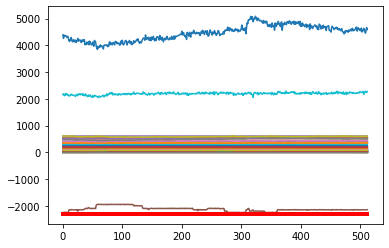

Predicción:  [[[0.9771742  0.02282581]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4238300e+01  1.1604500e+01  6.0647800e+01  7.7003200e+01
  6.0996560e+02  3.0646400e+01  9.4778000e+00  1.9002390e+02
  5.0000000e-04  6.9610200e+01  1.2505610e+02  1.0130800e+01
  6.5303500e+01  1.7254880e+02  2.3092200e+01  1.2876470e+02
  1.9022880e+02  7.0266300e+01 -6.8991000e+00  3.6820000e+00
  1.4347800e+01  7.3172000e+00  1.4989000e+00  7.3321500e+01
  1.4974000e+00  1.5658000e+00  8.5457600e+01  6.0964200e+01
  1.3610000e+00  1.2486000e+00  1.5637000e+00  1.4172000e+00
  1.7114540e+02  8.3900000e-01  8.4030000e-01 -2.1546770e+03
  2.0419570e+02  1.6509000e+00  1.4223000e+00  2.2373214e+03
  4.4990110e+03  1.8481450e+02  1.4469000e+00  1.4415000e+00
  7.8979000e+00  7.4984000e+00  1.7884000e+00  2.2470000e-01
  2.9881200e+01  5.3645330e+02  5.2299010e+02  5.1904590e+02
  5.1968250e+02  5.1963480e+02  3.0930100e+01  3.19

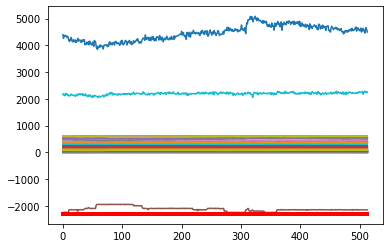

Predicción:  [[[0.97423416 0.02576581]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4341200e+01  1.1549900e+01  6.0516100e+01  7.6253700e+01
  6.1039220e+02  3.0445300e+01  9.4533000e+00  1.9003630e+02
  5.0000000e-04  6.9575500e+01  1.2518000e+02  1.0046200e+01
  6.5518500e+01  1.7251800e+02  2.3287400e+01  1.2775770e+02
  1.9012620e+02  7.0514700e+01 -6.8991000e+00  3.7145000e+00
  1.4321700e+01  7.2968000e+00  1.4993000e+00  7.3323400e+01
  1.4942000e+00  1.5623000e+00  8.5387000e+01  6.1616600e+01
  1.3570000e+00  1.2466000e+00  1.5610000e+00  1.4155000e+00
  1.7060400e+02  8.3860000e-01  8.3940000e-01 -2.1450696e+03
  2.0559150e+02  1.6479000e+00  1.4190000e+00  2.2034508e+03
  4.5905279e+03  1.8481450e+02  1.4452000e+00  1.4394000e+00
  7.8987000e+00  7.5013000e+00  1.7857000e+00  2.2470000e-01
  2.9907500e+01  5.3578230e+02  5.2304480e+02  5.1896320e+02
  5.1953710e+02  5.1947510e+02  3.0926600e+01  3.19

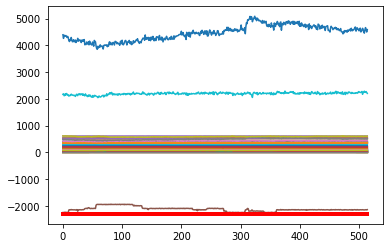

Predicción:  [[[0.9772594  0.02274065]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4056100e+01  1.1526600e+01  6.1859700e+01  7.6380900e+01
  6.0939870e+02  3.0639700e+01  9.4431000e+00  1.8997090e+02
  5.0000000e-04  6.9297600e+01  1.2470160e+02  9.8994000e+00
  6.5295800e+01  1.7210540e+02  2.3439900e+01  1.2592340e+02
  1.9010520e+02  7.0304800e+01 -6.8991000e+00  3.7169000e+00
  1.3773700e+01  7.2893000e+00  1.4994000e+00  7.3300200e+01
  1.5005000e+00  1.5688000e+00  8.4991500e+01  6.1796100e+01
  1.3631000e+00  1.2522000e+00  1.5665000e+00  1.4223000e+00
  1.7093410e+02  8.3930000e-01  8.4030000e-01 -2.1607496e+03
  2.0435240e+02  1.6534000e+00  1.4247000e+00  2.2430157e+03
  4.5614085e+03  1.8481450e+02  1.4508000e+00  1.4458000e+00
  7.9024000e+00  7.4999000e+00  1.7911000e+00  2.2470000e-01
  2.8732200e+01  5.3623110e+02  5.2318980e+02  5.1928380e+02
  5.1985620e+02  5.1981800e+02  3.0854200e+01  3.20

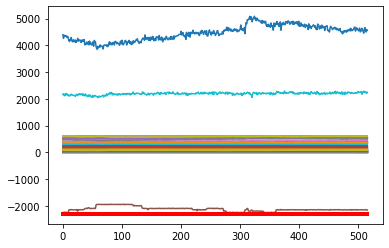

Predicción:  [[[0.9781374  0.02186263]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3820200e+01  1.1415800e+01  6.1576900e+01  7.5883500e+01
  6.1046880e+02  3.0442700e+01  9.4527000e+00  1.9011540e+02
  5.0000000e-04  6.9209600e+01  1.2518800e+02  9.8638000e+00
  6.5780600e+01  1.7265820e+02  2.3395200e+01  1.2440340e+02
  1.9004110e+02  7.0494300e+01 -6.8991000e+00  3.7211000e+00
  1.4867200e+01  7.3191000e+00  1.4982000e+00  7.3278100e+01
  1.4916000e+00  1.5625000e+00  8.5295700e+01  6.1258600e+01
  1.3548000e+00  1.2422000e+00  1.5557000e+00  1.4156000e+00
  1.7238890e+02  8.3840000e-01  8.3970000e-01 -2.1488258e+03
  2.0556110e+02  1.6471000e+00  1.4166000e+00  2.2525043e+03
  4.5888095e+03  1.8481450e+02  1.4439000e+00  1.4387000e+00
  7.8981000e+00  7.5004000e+00  1.7842000e+00  2.2830000e-01
  2.8263300e+01  5.3655110e+02  5.2298150e+02  5.1908420e+02
  5.1963740e+02  5.1946230e+02  3.0748000e+01  3.19

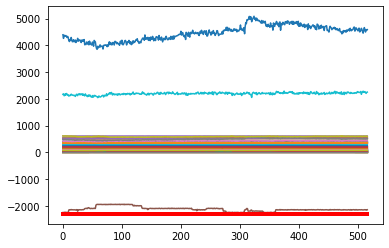

Predicción:  [[[0.9777018  0.02229826]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3917200e+01  1.1353500e+01  6.2210100e+01  7.6659100e+01
  6.0956150e+02  3.0987000e+01  9.4309000e+00  1.9002130e+02
  5.0000000e-04  6.9183100e+01  1.2481480e+02  9.8823000e+00
  6.6100900e+01  1.7221270e+02  2.3398700e+01  1.2356690e+02
  1.9010380e+02  7.0376100e+01 -6.8991000e+00  3.7126000e+00
  1.3677400e+01  7.2915000e+00  1.4988000e+00  7.3316300e+01
  1.5074000e+00  1.5758000e+00  8.3536600e+01  6.0969200e+01
  1.3707000e+00  1.2583000e+00  1.5705000e+00  1.4313000e+00
  1.7203760e+02  8.3920000e-01  8.4020000e-01 -2.1536937e+03
  2.0628940e+02  1.6602000e+00  1.4317000e+00  2.2463375e+03
  4.5555952e+03  1.8481450e+02  1.4604000e+00  1.4546000e+00
  7.9002000e+00  7.4989000e+00  1.7969000e+00  2.2640000e-01
  2.8708800e+01  5.3679780e+02  5.2322090e+02  5.1949670e+02
  5.2008970e+02  5.1988080e+02  3.0386300e+01  3.19

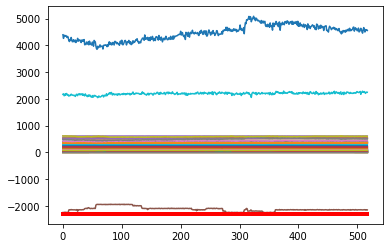

Predicción:  [[[0.97682524 0.0231747 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3851800e+01  1.1389900e+01  5.9836800e+01  7.7088700e+01
  6.0968510e+02  3.0978500e+01  9.3745000e+00  1.9001540e+02
  5.0000000e-04  6.9330500e+01  1.2518420e+02  9.8133000e+00
  6.5925000e+01  1.7157480e+02  2.2600200e+01  1.2292710e+02
  1.9000820e+02  7.0537300e+01 -6.8991000e+00  3.7065000e+00
  1.3327000e+01  7.3066000e+00  1.4992000e+00  7.3338300e+01
  1.4932000e+00  1.5646000e+00  8.4200100e+01  6.1838200e+01
  1.3552000e+00  1.2437000e+00  1.5586000e+00  1.4157000e+00
  1.7153870e+02  8.3720000e-01  8.3920000e-01 -2.1468885e+03
  2.0525150e+02  1.6488000e+00  1.4171000e+00  2.2665268e+03
  4.6222281e+03  1.8481450e+02  1.4444000e+00  1.4383000e+00
  7.9004000e+00  7.4906000e+00  1.7847000e+00  2.2610000e-01
  2.8779500e+01  5.3734890e+02  5.2314900e+02  5.1923020e+02
  5.1979280e+02  5.1955430e+02  3.1710100e+01  3.24

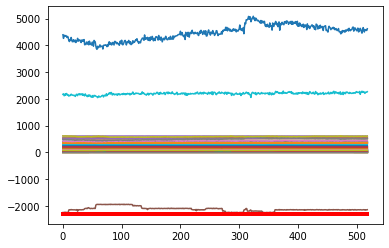

Predicción:  [[[0.9788658  0.02113414]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3495400e+01  1.1465900e+01  6.0448600e+01  7.5704100e+01
  6.0985150e+02  3.0998800e+01  9.3977000e+00  1.9003310e+02
  5.0000000e-04  6.9179100e+01  1.2494210e+02  9.9803000e+00
  6.5945500e+01  1.7376870e+02  2.0933600e+01  1.2351970e+02
  1.9012090e+02  7.0572800e+01 -6.8991000e+00  3.7031000e+00
  1.4256100e+01  7.3042000e+00  1.5004000e+00  7.3252900e+01
  1.4928000e+00  1.5612000e+00  8.3315600e+01  6.1512500e+01
  1.3557000e+00  1.2428000e+00  1.5516000e+00  1.4115000e+00
  1.7076380e+02  8.3630000e-01  8.4070000e-01 -2.1547086e+03
  2.0562830e+02  1.6441000e+00  1.4169000e+00  2.2342258e+03
  4.5166754e+03  1.8481450e+02  1.4404000e+00  1.4364000e+00
  7.9013000e+00  7.5105000e+00  1.7840000e+00  2.3260000e-01
  2.8984600e+01  5.3688670e+02  5.2309080e+02  5.1925090e+02
  5.1977130e+02  5.1963110e+02  3.0529700e+01  3.21

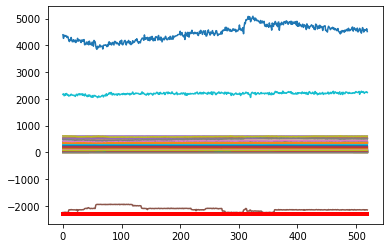

Predicción:  [[[0.9752206  0.02477942]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3415600e+01  1.1529800e+01  6.1892800e+01  7.7350000e+01
  6.0975020e+02  3.2054500e+01  9.4006000e+00  1.9000230e+02
  3.4000000e-03  6.8841900e+01  1.2492830e+02  1.0054700e+01
  6.6194100e+01  1.7418070e+02  2.1957200e+01  1.2688750e+02
  1.9015580e+02  7.0716900e+01 -6.8991000e+00  3.6977000e+00
  1.3921500e+01  7.3060000e+00  1.4986000e+00  7.3333700e+01
  1.4949000e+00  1.5671000e+00  8.4143300e+01  6.1672700e+01
  1.3594000e+00  1.2473000e+00  1.5526000e+00  1.4167000e+00
  1.6883320e+02  8.3400000e-01  8.3950000e-01 -2.1401575e+03
  2.0656990e+02  1.6503000e+00  1.4212000e+00  2.2204074e+03
  4.5804573e+03  1.8481450e+02  1.4470000e+00  1.4401000e+00
  7.8967000e+00  7.5059000e+00  1.7877000e+00  2.3520000e-01
  2.9979000e+01  5.3606890e+02  5.2262340e+02  5.1866700e+02
  5.1916880e+02  5.1910120e+02  3.0618700e+01  3.18

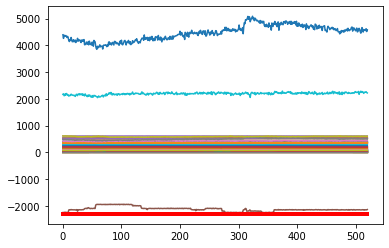

Predicción:  [[[0.9759779  0.02402209]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3519900e+01  1.1704400e+01  6.2319700e+01  7.8959900e+01
  6.1026200e+02  3.2248900e+01  9.4116000e+00  1.8996710e+02
  9.3000000e-03  6.8571500e+01  1.2466460e+02  9.9208000e+00
  6.6090500e+01  1.7336720e+02  2.2055800e+01  1.2974900e+02
  1.9062020e+02  7.0656300e+01 -6.8991000e+00  3.7059000e+00
  1.3243800e+01  7.2923000e+00  1.4973000e+00  7.3324900e+01
  1.5071000e+00  1.5779000e+00  8.4630400e+01  6.0879400e+01
  1.3714000e+00  1.2598000e+00  1.5645000e+00  1.4270000e+00
  1.6734590e+02  8.3480000e-01  8.4060000e-01 -2.1595931e+03
  2.0644580e+02  1.6623000e+00  1.4322000e+00  2.2565350e+03
  4.5654610e+03  1.8481450e+02  1.4618000e+00  1.4526000e+00
  7.9003000e+00  7.4986000e+00  1.7982000e+00  2.3410000e-01
  3.4903100e+01  5.3749450e+02  5.2245090e+02  5.1886780e+02
  5.1938690e+02  5.1934620e+02  3.0624900e+01  3.20

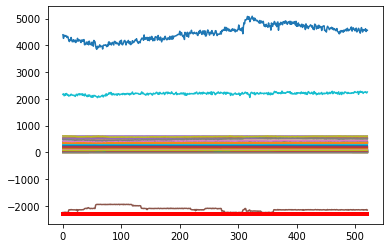

Predicción:  [[[0.97825295 0.02174706]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3280800e+01  1.1823700e+01  6.2340500e+01  7.8756800e+01
  6.1267320e+02  3.3155200e+01  9.4466000e+00  1.8997610e+02
  1.5300000e-02  6.8399000e+01  1.2527520e+02  9.7793000e+00
  6.5579500e+01  1.7494750e+02  2.2206500e+01  1.3305950e+02
  1.9070390e+02  7.0742000e+01 -6.8991000e+00  3.6991000e+00
  1.2315700e+01  7.2743000e+00  1.5002000e+00  7.3293800e+01
  1.4953000e+00  1.5664000e+00  8.4572800e+01  6.1163000e+01
  1.3606000e+00  1.2438000e+00  1.5469000e+00  1.4132000e+00
  1.6961920e+02  8.3330000e-01  8.3980000e-01 -2.1464610e+03
  2.0612170e+02  1.6512000e+00  1.4209000e+00  2.2715112e+03
  4.5167688e+03  1.8481450e+02  1.4484000e+00  1.4403000e+00
  7.9020000e+00  7.4992000e+00  1.7862000e+00  2.3930000e-01
  3.5131400e+01  5.3765330e+02  5.2355570e+02  5.1951950e+02
  5.1998510e+02  5.1999020e+02  3.0630900e+01  3.17

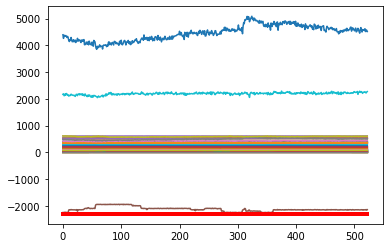

Predicción:  [[[0.9737983 0.0262017]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3264600e+01  1.1965800e+01  6.1801500e+01  7.6873800e+01
  6.1428060e+02  3.2147000e+01  9.5222000e+00  1.9002180e+02
  2.8900000e-02  6.8210300e+01  1.2499900e+02  9.9372000e+00
  6.6739500e+01  1.7481630e+02  2.2191000e+01  1.3364140e+02
  1.9083330e+02  7.0494800e+01 -6.8991000e+00  3.7064000e+00
  1.3537600e+01  7.3113000e+00  1.4987000e+00  7.3320300e+01
  1.5030000e+00  1.5718000e+00  8.3200100e+01  6.0472200e+01
  1.3692000e+00  1.2531000e+00  1.5504000e+00  1.4184000e+00
  1.6686270e+02  8.3420000e-01  8.3980000e-01 -2.1552309e+03
  2.0679150e+02  1.6554000e+00  1.4298000e+00  2.2090763e+03
  4.4772405e+03  1.8481450e+02  1.4531000e+00  1.4441000e+00
  7.8981000e+00  7.4987000e+00  1.7940000e+00  2.4370000e-01
  3.4931100e+01  5.3677500e+02  5.2212340e+02  5.1834740e+02
  5.1888700e+02  5.1886350e+02  3.1028100e+01  3.1909

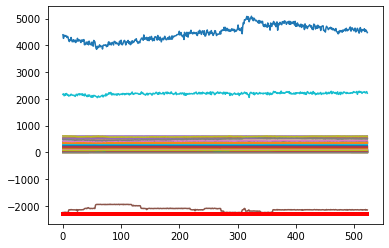

Predicción:  [[[0.9733901  0.02660988]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3081500e+01  1.1928200e+01  6.2205500e+01  7.7546000e+01
  6.1511770e+02  3.1831500e+01  9.4923000e+00  1.9010620e+02
  6.3900000e-02  6.8543100e+01  1.2495030e+02  1.0014900e+01
  6.6879300e+01  1.7270740e+02  2.2248300e+01  1.3131660e+02
  1.9085240e+02  7.0671700e+01 -6.8991000e+00  3.6998000e+00
  1.2405000e+01  7.2683000e+00  1.5000000e+00  7.3344900e+01
  1.5038000e+00  1.5747000e+00  8.5713000e+01  6.1097900e+01
  1.3692000e+00  1.2501000e+00  1.5572000e+00  1.4247000e+00
  1.7075960e+02  8.3750000e-01  8.3990000e-01 -2.1481050e+03
  2.0744470e+02  1.6602000e+00  1.4301000e+00  2.2159722e+03
  4.5486741e+03  1.8481450e+02  1.4572000e+00  1.4494000e+00
  7.9002000e+00  7.5010000e+00  1.7956000e+00  2.3830000e-01
  3.2141000e+01  5.3832670e+02  5.2329770e+02  5.1979720e+02
  5.2041090e+02  5.2033370e+02  3.0804000e+01  3.19

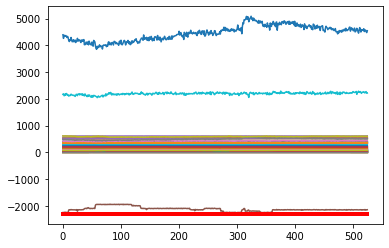

Predicción:  [[[0.9758389  0.02416104]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3045700e+01  1.1673600e+01  6.3153100e+01  7.7533500e+01
  6.1531620e+02  3.1594600e+01  9.3985000e+00  1.8994940e+02
  7.0200000e-02  6.8829700e+01  1.2496110e+02  1.0075300e+01
  6.7484900e+01  1.7360260e+02  2.2636800e+01  1.2913110e+02
  1.9033280e+02  7.0408200e+01 -6.8991000e+00  3.7057000e+00
  1.2182100e+01  7.3109000e+00  1.5012000e+00  7.3295800e+01
  1.5149000e+00  1.5837000e+00  8.4071700e+01  6.0958500e+01
  1.3788000e+00  1.2611000e+00  1.5663000e+00  1.4303000e+00
  1.7187370e+02  8.3690000e-01  8.4010000e-01 -2.1471321e+03
  2.0489220e+02  1.6677000e+00  1.4396000e+00  2.2569543e+03
  4.4749622e+03  1.8481450e+02  1.4603000e+00  1.4541000e+00
  7.9045000e+00  7.5016000e+00  1.8057000e+00  2.3980000e-01
  3.0261200e+01  5.3909710e+02  5.2398050e+02  5.1998400e+02
  5.2066940e+02  5.2058610e+02  3.0639800e+01  3.19

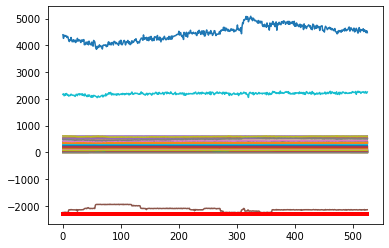

Predicción:  [[[0.9715729  0.02842706]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3013400e+01  1.1676100e+01  6.2324400e+01  7.7955400e+01
  6.1495340e+02  3.1201800e+01  9.3824000e+00  1.9006380e+02
  6.7600000e-02  6.6103800e+01  1.2498110e+02  1.0150900e+01
  6.7068900e+01  1.7016320e+02  2.2272000e+01  1.3051300e+02
  1.9022070e+02  7.0584200e+01 -6.8991000e+00  3.7034000e+00
  1.2389200e+01  7.2986000e+00  1.4996000e+00  7.3296700e+01
  1.4983000e+00  1.5680000e+00  8.5235500e+01  6.1435600e+01
  1.3632000e+00  1.2465000e+00  1.5565000e+00  1.4193000e+00
  1.7082170e+02  8.3480000e-01  8.4010000e-01 -2.1501834e+03
  2.0379660e+02  1.6524000e+00  1.4242000e+00  2.2111012e+03
  4.5416967e+03  1.8481450e+02  1.4517000e+00  1.4462000e+00
  7.8981000e+00  7.5044000e+00  1.7923000e+00  2.3610000e-01
  3.1919200e+01  5.3691780e+02  5.2299580e+02  5.1900200e+02
  5.1956470e+02  5.1953880e+02  3.0341000e+01  3.19

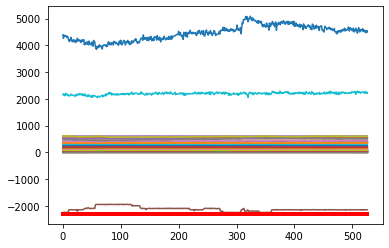

Predicción:  [[[0.9758744  0.02412554]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3237800e+01  1.1915700e+01  6.2613600e+01  7.8352900e+01
  6.1524950e+02  2.9876800e+01  9.4659000e+00  1.8996320e+02
  6.5400000e-02  6.5809800e+01  1.2490850e+02  9.9591000e+00
  6.7002700e+01  1.6968970e+02  2.2002800e+01  1.3375550e+02
  1.9065790e+02  7.0499900e+01 -6.8991000e+00  3.6884000e+00
  1.3089300e+01  7.3033000e+00  1.5001000e+00  7.3350100e+01
  1.4981000e+00  1.5652000e+00  8.4488200e+01  6.0613800e+01
  1.3627000e+00  1.2466000e+00  1.5541000e+00  1.4152000e+00
  1.6913070e+02  8.3460000e-01  8.4030000e-01 -2.1511530e+03
  2.0742520e+02  1.6487000e+00  1.4236000e+00  2.2299259e+03
  4.4423755e+03  1.8481450e+02  1.4501000e+00  1.4447000e+00
  7.8991000e+00  7.4993000e+00  1.7918000e+00  2.3780000e-01
  3.4895400e+01  5.3645110e+02  5.2229890e+02  5.1857620e+02
  5.1912550e+02  5.1915820e+02  3.0060500e+01  3.16

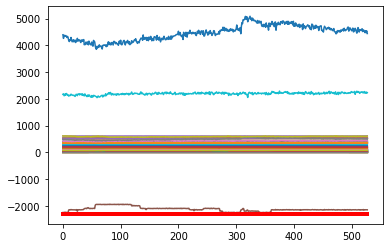

Predicción:  [[[0.9706527  0.02934731]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3235600e+01  1.1991800e+01  6.2383300e+01  7.9458100e+01
  6.1426130e+02  3.0083500e+01  9.4885000e+00  1.8985350e+02
  6.7000000e-02  6.6185800e+01  1.2485980e+02  9.8802000e+00
  6.6720000e+01  1.6917930e+02  2.2178900e+01  1.3428280e+02
  1.9088900e+02  7.0504400e+01 -6.8991000e+00  3.6973000e+00
  1.1936000e+01  7.3281000e+00  1.5002000e+00  7.3323100e+01
  1.5009000e+00  1.5698000e+00  8.4868100e+01  6.1297400e+01
  1.3660000e+00  1.2486000e+00  1.5563000e+00  1.4170000e+00
  1.6971590e+02  8.3410000e-01  8.4010000e-01 -2.1492045e+03
  2.0747190e+02  1.6538000e+00  1.4270000e+00  2.2540037e+03
  4.5621501e+03  1.8481450e+02  1.4506000e+00  1.4449000e+00
  7.9016000e+00  7.4995000e+00  1.7935000e+00  2.3690000e-01
  3.3854300e+01  5.3685110e+02  5.2300540e+02  5.1909370e+02
  5.1971790e+02  5.1974120e+02  2.9951800e+01  3.13

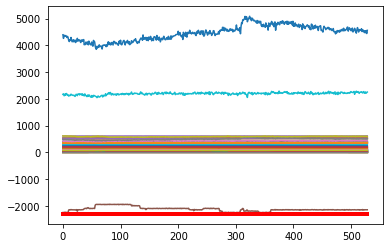

Predicción:  [[[0.9765801  0.02341996]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3197800e+01  1.1790900e+01  6.2860200e+01  7.8508900e+01
  6.1575140e+02  2.9783600e+01  9.4361000e+00  1.8994140e+02
  6.9500000e-02  6.6303100e+01  1.2492750e+02  1.0237000e+01
  6.6985900e+01  1.6987110e+02  2.2477100e+01  1.3457610e+02
  1.9062000e+02  7.0398100e+01 -6.8991000e+00  3.7043000e+00
  1.2708400e+01  7.2804000e+00  1.5004000e+00  7.3275100e+01
  1.5109000e+00  1.5818000e+00  8.5624100e+01  6.0944500e+01
  1.3745000e+00  1.2569000e+00  1.5649000e+00  1.4297000e+00
  1.7167830e+02  8.3430000e-01  8.4010000e-01 -2.1521814e+03
  2.0505310e+02  1.6676000e+00  1.4354000e+00  2.2346633e+03
  4.6311241e+03  1.8481450e+02  1.4623000e+00  1.4562000e+00
  7.8999000e+00  7.4991000e+00  1.8048000e+00  2.3980000e-01
  3.2478100e+01  5.3783620e+02  5.2339270e+02  5.1968990e+02
  5.2030750e+02  5.2029110e+02  3.0438100e+01  3.12

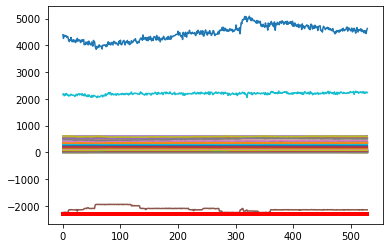

Predicción:  [[[0.98015255 0.01984746]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3337000e+01  1.1676000e+01  6.1472300e+01  7.8050000e+01
  6.1503910e+02  2.9217000e+01  9.4229000e+00  1.9013950e+02
  7.1900000e-02  6.6564100e+01  1.2494370e+02  1.0061700e+01
  6.6809700e+01  1.6799920e+02  2.2585600e+01  1.3399910e+02
  1.9027000e+02  7.0683500e+01 -6.8991000e+00  3.7012000e+00
  1.1871300e+01  7.3007000e+00  1.5008000e+00  7.3306000e+01
  1.5059000e+00  1.5770000e+00  8.5240900e+01  6.0981000e+01
  1.3688000e+00  1.2519000e+00  1.5637000e+00  1.4240000e+00
  1.7112830e+02  8.3540000e-01  8.4000000e-01 -2.1421649e+03
  2.0793790e+02  1.6616000e+00  1.4303000e+00  2.2190402e+03
  4.6008208e+03  1.8481450e+02  1.4585000e+00  1.4527000e+00
  7.8982000e+00  7.4977000e+00  1.8000000e+00  2.3640000e-01
  3.4411700e+01  5.3813550e+02  5.2328120e+02  5.1942980e+02
  5.1997910e+02  5.1997280e+02  3.0337100e+01  3.12

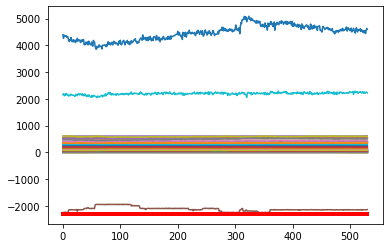

Predicción:  [[[0.9775394  0.02246053]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3380400e+01  1.1774500e+01  6.1439900e+01  7.6852900e+01
  6.1474110e+02  2.8988700e+01  9.4309000e+00  1.8990880e+02
  7.4000000e-02  6.6437700e+01  1.2477420e+02  1.0103600e+01
  6.6835700e+01  1.6872200e+02  2.2707000e+01  1.3348730e+02
  1.9018940e+02  7.0647700e+01 -6.8991000e+00  3.7045000e+00
  1.2612700e+01  7.2988000e+00  1.4997000e+00  7.3333300e+01
  1.5023000e+00  1.5728000e+00  8.6069300e+01  6.1771600e+01
  1.3676000e+00  1.2490000e+00  1.5548000e+00  1.4212000e+00
  1.7060780e+02  8.3490000e-01  8.4000000e-01 -2.1476917e+03
  2.0586480e+02  1.6573000e+00  1.4292000e+00  2.2204873e+03
  4.5587365e+03  1.8481450e+02  1.4560000e+00  1.4497000e+00
  7.9041000e+00  7.4915000e+00  1.7964000e+00  2.4160000e-01
  3.4738800e+01  5.3774890e+02  5.2328000e+02  5.1944050e+02
  5.2000410e+02  5.2000990e+02  3.0365600e+01  3.13

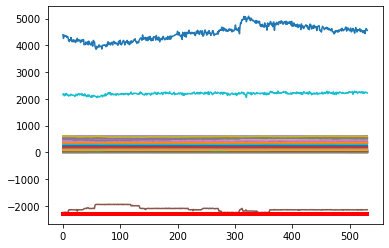

Predicción:  [[[0.9762245  0.02377557]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2839700e+01  1.1512600e+01  6.1601900e+01  7.6565900e+01
  6.1399010e+02  2.9121300e+01  9.3776000e+00  1.9008210e+02
  7.2800000e-02  6.6459200e+01  1.2511190e+02  9.8480000e+00
  6.6584700e+01  1.6895040e+02  2.2832300e+01  1.3333040e+02
  1.8989440e+02  7.0576500e+01 -6.8991000e+00  3.6886000e+00
  1.2578200e+01  7.2935000e+00  1.4993000e+00  7.3322800e+01
  1.5003000e+00  1.5694000e+00  8.4452100e+01  6.1931700e+01
  1.3656000e+00  1.2478000e+00  1.5496000e+00  1.4174000e+00
  1.7022400e+02  8.3390000e-01  8.3980000e-01 -2.1560587e+03
  2.0535620e+02  1.6539000e+00  1.4271000e+00  2.2485443e+03
  4.4990039e+03  1.8481450e+02  1.4515000e+00  1.4454000e+00
  7.8985000e+00  7.5045000e+00  1.7936000e+00  2.4360000e-01
  3.3900400e+01  5.3693550e+02  5.2333360e+02  5.1950980e+02
  5.2002640e+02  5.2006070e+02  3.0203600e+01  3.13

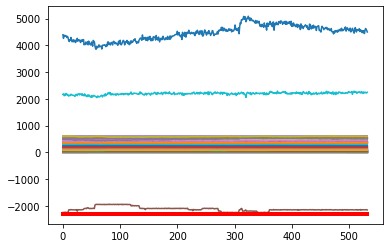

Predicción:  [[[0.9745283  0.02547167]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2876100e+01  1.1515800e+01  6.3313200e+01  7.6254700e+01
  6.1636960e+02  2.9591500e+01  9.4000000e+00  1.8990170e+02
  7.0900000e-02  6.6337900e+01  1.2479590e+02  9.9609000e+00
  6.6709600e+01  1.7026950e+02  2.2609000e+01  1.3284540e+02
  1.9003420e+02  7.0674100e+01 -6.8991000e+00  3.7000000e+00
  1.3452000e+01  7.3045000e+00  1.4993000e+00  7.3274900e+01
  1.4930000e+00  1.5622000e+00  8.3874500e+01  6.2380800e+01
  1.3561000e+00  1.2403000e+00  1.5351000e+00  1.4089000e+00
  1.6918630e+02  8.3410000e-01  8.3990000e-01 -2.1476576e+03
  2.0740010e+02  1.6461000e+00  1.4186000e+00  2.2163563e+03
  4.5219815e+03  1.8481450e+02  1.4449000e+00  1.4387000e+00
  7.9010000e+00  7.5014000e+00  1.7859000e+00  2.5080000e-01
  3.6094700e+01  5.3626670e+02  5.2284050e+02  5.1887700e+02
  5.1941410e+02  5.1946270e+02  3.0055300e+01  3.12

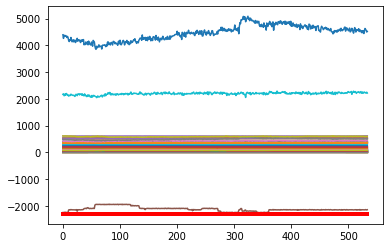

Predicción:  [[[0.97447836 0.02552168]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2636200e+01  1.1365000e+01  6.3409600e+01  7.7317400e+01
  6.1529470e+02  3.0764100e+01  9.4057000e+00  1.9001070e+02
  6.9000000e-02  6.6846100e+01  1.2495560e+02  9.9299000e+00
  6.6668200e+01  1.7104900e+02  2.2820200e+01  1.3262290e+02
  1.8999690e+02  7.0615400e+01 -6.8991000e+00  3.6919000e+00
  1.2823800e+01  7.2897000e+00  1.4987000e+00  7.3280900e+01
  1.5024000e+00  1.5740000e+00  8.5042900e+01  6.1549000e+01
  1.3671000e+00  1.2507000e+00  1.5411000e+00  1.4212000e+00
  1.6960240e+02  8.3760000e-01  8.3990000e-01 -2.1495642e+03
  2.0344550e+02  1.6581000e+00  1.4284000e+00  2.2467815e+03
  4.5723563e+03  1.8481450e+02  1.4532000e+00  1.4460000e+00
  7.8984000e+00  7.4990000e+00  1.7938000e+00  2.5220000e-01
  3.2143000e+01  5.3764670e+02  5.2301450e+02  5.1923650e+02
  5.1988530e+02  5.1983830e+02  2.9855600e+01  3.11

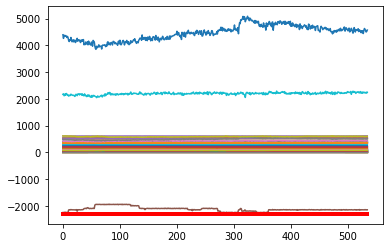

Predicción:  [[[0.977238   0.02276201]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2645600e+01  1.1140500e+01  6.2829000e+01  7.8767200e+01
  6.1496250e+02  3.3197100e+01  9.3398000e+00  1.8994330e+02
  6.7800000e-02  6.6833500e+01  1.2496110e+02  9.8506000e+00
  6.6682000e+01  1.7261540e+02  2.2866200e+01  1.3280150e+02
  1.8968740e+02  7.0696100e+01 -6.8991000e+00  3.7001000e+00
  1.2262000e+01  7.2905000e+00  1.5007000e+00  7.3274500e+01
  1.5030000e+00  1.5716000e+00  8.5780600e+01  6.1576700e+01
  1.3673000e+00  1.2519000e+00  1.5361000e+00  1.4222000e+00
  1.7027930e+02  8.3790000e-01  8.3990000e-01 -2.1455078e+03
  2.0580580e+02  1.6580000e+00  1.4289000e+00  2.2645150e+03
  4.5908151e+03  1.8481450e+02  1.4555000e+00  1.4462000e+00
  7.8997000e+00  7.5004000e+00  1.7937000e+00  2.5720000e-01
  3.3149500e+01  5.3885110e+02  5.2385080e+02  5.1998310e+02
  5.2057560e+02  5.2043760e+02  2.9942500e+01  3.11

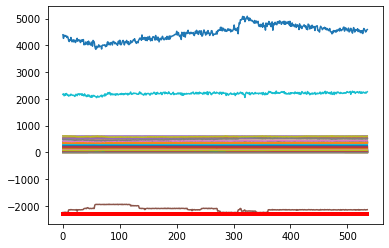

Predicción:  [[[0.97736925 0.02263069]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2618300e+01  1.0943200e+01  6.2532700e+01  7.8467300e+01
  6.1486300e+02  3.2555900e+01  9.3326000e+00  1.8998810e+02
  7.2200000e-02  6.6651800e+01  1.2504230e+02  1.0024200e+01
  6.7099000e+01  1.7138640e+02  2.2630500e+01  1.3352420e+02
  1.8941480e+02  7.0788900e+01 -6.8991000e+00  3.7040000e+00
  1.2570500e+01  7.2938000e+00  1.4996000e+00  7.3301300e+01
  1.4958000e+00  1.5639000e+00  8.5899000e+01  6.1612000e+01
  1.3589000e+00  1.2463000e+00  1.5302000e+00  1.4164000e+00
  1.6884650e+02  8.3780000e-01  8.4020000e-01 -2.1490097e+03
  2.0682080e+02  1.6501000e+00  1.4204000e+00  2.2541172e+03
  4.5907447e+03  1.8481450e+02  1.4498000e+00  1.4398000e+00
  7.9022000e+00  7.5015000e+00  1.7870000e+00  2.5710000e-01
  3.3197100e+01  5.3754890e+02  5.2310010e+02  5.1933130e+02
  5.1989290e+02  5.1970160e+02  2.9773500e+01  3.11

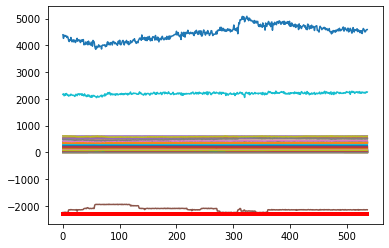

Predicción:  [[[0.97795606 0.02204395]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3323300e+01  1.0867500e+01  6.1828400e+01  7.8275000e+01
  6.1517620e+02  3.2403000e+01  9.3386000e+00  1.9001240e+02
  7.7900000e-02  6.6252000e+01  1.2495260e+02  9.8880000e+00
  6.6198200e+01  1.7075420e+02  2.2556900e+01  1.3348250e+02
  1.8931690e+02  7.0446600e+01 -6.8991000e+00  3.6921000e+00
  1.2323400e+01  7.3041000e+00  1.4998000e+00  7.3302700e+01
  1.5001000e+00  1.5649000e+00  8.5759200e+01  6.1593200e+01
  1.3627000e+00  1.2491000e+00  1.5363000e+00  1.4148000e+00
  1.6998560e+02  8.3700000e-01  8.4010000e-01 -2.1553713e+03
  2.0503280e+02  1.6509000e+00  1.4246000e+00  2.2612115e+03
  4.4925597e+03  1.8481450e+02  1.4493000e+00  1.4395000e+00
  7.8997000e+00  7.4897000e+00  1.7895000e+00  2.5310000e-01
  3.4758300e+01  5.3814890e+02  5.2305080e+02  5.1912280e+02
  5.1970390e+02  5.1963610e+02  2.9796700e+01  3.09

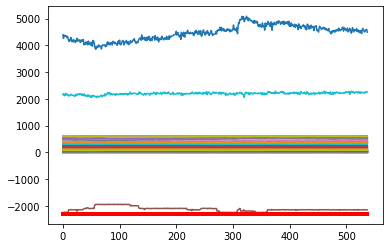

Predicción:  [[[0.974212   0.02578808]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3204900e+01  1.0988600e+01  6.1786500e+01  7.8277300e+01
  6.1469800e+02  3.2565800e+01  9.3703000e+00  1.9002270e+02
  8.3600000e-02  6.7170400e+01  1.2480170e+02  1.0168400e+01
  6.6660100e+01  1.7110440e+02  2.2628500e+01  1.3334360e+02
  1.8937890e+02  7.0244400e+01 -6.8991000e+00  3.7098000e+00
  1.1821100e+01  7.3115000e+00  1.5010000e+00  7.3347900e+01
  1.5025000e+00  1.5721000e+00  8.5793000e+01  6.1993300e+01
  1.3657000e+00  1.2514000e+00  1.5351000e+00  1.4229000e+00
  1.7180390e+02  8.3580000e-01  8.3950000e-01 -2.1519927e+03
  2.0558370e+02  1.6594000e+00  1.4275000e+00  2.2081347e+03
  4.6492280e+03  1.8481450e+02  1.4574000e+00  1.4516000e+00
  7.8968000e+00  7.5059000e+00  1.7935000e+00  2.5850000e-01
  3.4642400e+01  5.3903330e+02  5.2343690e+02  5.1967770e+02
  5.2020800e+02  5.2015410e+02  2.9676900e+01  3.08

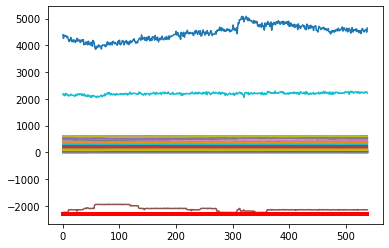

Predicción:  [[[0.980876   0.01912397]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3331100e+01  1.0952100e+01  6.0375900e+01  7.7990000e+01
  6.2056250e+02  3.2891400e+01  9.3362000e+00  1.9008270e+02
  9.0700000e-02  6.8665900e+01  1.2509100e+02  9.8129000e+00
  6.6876800e+01  1.7347170e+02  2.1563800e+01  1.3433660e+02
  1.8937120e+02  7.0871100e+01 -6.8991000e+00  3.7112000e+00
  1.2541000e+01  7.3070000e+00  1.4997000e+00  7.3338800e+01
  1.4899000e+00  1.5605000e+00  8.6864200e+01  6.1392900e+01
  1.3564000e+00  1.2422000e+00  1.5117000e+00  1.4121000e+00
  1.6911660e+02  8.3590000e-01  8.3950000e-01 -2.1449116e+03
  2.0751750e+02  1.6473000e+00  1.4180000e+00  2.2547356e+03
  4.5814678e+03  1.8481450e+02  1.4464000e+00  1.4408000e+00
  7.8995000e+00  7.4994000e+00  1.7800000e+00  2.6810000e-01
  3.4406000e+01  5.3847110e+02  5.2355660e+02  5.1963360e+02
  5.1996510e+02  5.2006690e+02  2.9689000e+01  3.04

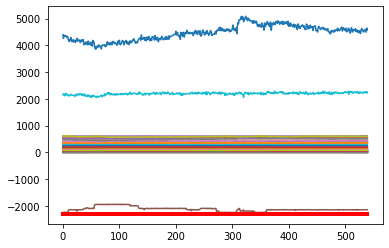

Predicción:  [[[0.9771423  0.02285779]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3528400e+01  1.1032500e+01  6.0755400e+01  7.8695400e+01
  6.1946150e+02  3.3063700e+01  9.2914000e+00  1.9008020e+02
  1.0090000e-01  6.8699400e+01  1.2488350e+02  9.9677000e+00
  6.5834700e+01  1.7333490e+02  2.1956200e+01  1.3391590e+02
  1.8935500e+02  7.0862600e+01 -6.8991000e+00  3.6986000e+00
  1.1964900e+01  7.2971000e+00  1.5007000e+00  7.3248400e+01
  1.4871000e+00  1.5563000e+00  8.7117100e+01  6.2484700e+01
  1.3486000e+00  1.2403000e+00  1.5093000e+00  1.4073000e+00
  1.6705860e+02  8.3580000e-01  8.3990000e-01 -2.1516799e+03
  2.0504570e+02  1.6433000e+00  1.4107000e+00  2.2335728e+03
  4.6403984e+03  1.8481450e+02  1.4411000e+00  1.4334000e+00
  7.8985000e+00  7.5003000e+00  1.7768000e+00  2.6750000e-01
  3.3789500e+01  5.3743110e+02  5.2295330e+02  5.1921110e+02
  5.1963330e+02  5.1966310e+02  2.9809400e+01  3.04

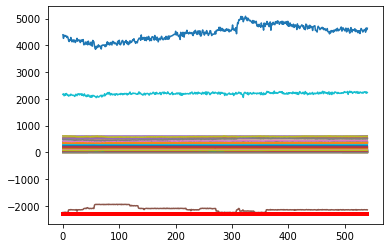

Predicción:  [[[0.9805675  0.01943247]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3693300e+01  1.0918800e+01  6.1262300e+01  7.7296800e+01
  6.1997230e+02  3.2809400e+01  9.2979000e+00  1.9001560e+02
  1.0460000e-01  6.9110400e+01  1.2496670e+02  1.0179200e+01
  6.7135900e+01  1.7272670e+02  2.2151000e+01  1.3296860e+02
  1.8940310e+02  7.0777700e+01 -6.8991000e+00  3.7046000e+00
  1.2352100e+01  7.2826000e+00  1.4997000e+00  7.3328900e+01
  1.4932000e+00  1.5619000e+00  8.7774200e+01  6.2719600e+01
  1.3533000e+00  1.2438000e+00  1.5129000e+00  1.4133000e+00
  1.6722850e+02  8.3580000e-01  8.4010000e-01 -2.1451557e+03
  2.0454060e+02  1.6495000e+00  1.4169000e+00  2.2283991e+03
  4.6121346e+03  1.8481450e+02  1.4457000e+00  1.4386000e+00
  7.9034000e+00  7.5019000e+00  1.7842000e+00  2.7110000e-01
  3.2353800e+01  5.3926230e+02  5.2338900e+02  5.1964960e+02
  5.2025650e+02  5.2020420e+02  2.9970000e+01  3.04

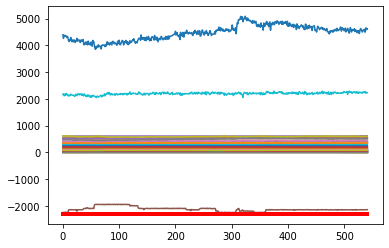

Predicción:  [[[0.9785241  0.02147597]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3603000e+01  1.1066800e+01  6.1223500e+01  7.6987900e+01
  6.1970900e+02  3.2761600e+01  9.3180000e+00  1.9010630e+02
  9.7900000e-02  6.9045700e+01  1.2493730e+02  9.8937000e+00
  6.7473700e+01  1.7267370e+02  2.2206500e+01  1.3339040e+02
  1.8940130e+02  7.0670000e+01 -6.8991000e+00  3.6977000e+00
  1.1815400e+01  7.2839000e+00  1.5013000e+00  7.3341600e+01
  1.4980000e+00  1.5672000e+00  8.6963000e+01  6.2979800e+01
  1.3620000e+00  1.2493000e+00  1.5163000e+00  1.4199000e+00
  1.6745330e+02  8.3780000e-01  8.3990000e-01 -2.1451275e+03
  2.0720750e+02  1.6552000e+00  1.4250000e+00  2.2333489e+03
  4.6099418e+03  1.8481450e+02  1.4495000e+00  1.4443000e+00
  7.8983000e+00  7.5002000e+00  1.7878000e+00  2.7130000e-01
  2.9491300e+01  5.3941990e+02  5.2367410e+02  5.1985290e+02
  5.2055030e+02  5.2045250e+02  2.9766800e+01  3.03

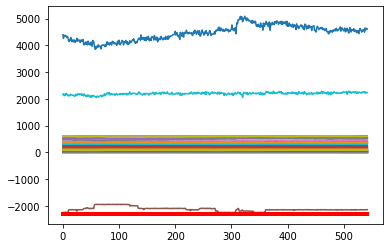

Predicción:  [[[0.9784509  0.02154906]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3727900e+01  1.1108900e+01  6.1703300e+01  7.8208600e+01
  6.1969850e+02  3.3739600e+01  9.4308000e+00  1.8995800e+02
  9.1100000e-02  6.8722800e+01  1.2497010e+02  9.9701000e+00
  6.6940100e+01  1.7400870e+02  2.2262900e+01  1.3417640e+02
  1.8933050e+02  7.0712000e+01 -6.8991000e+00  3.6970000e+00
  1.1772400e+01  7.2892000e+00  1.5006000e+00  7.3256900e+01
  1.5041000e+00  1.5712000e+00  8.6311300e+01  6.2534900e+01
  1.3673000e+00  1.2576000e+00  1.5187000e+00  1.4220000e+00
  1.6647100e+02  8.3710000e-01  8.4070000e-01 -2.1566193e+03
  2.0596920e+02  1.6577000e+00  1.4298000e+00  2.2241912e+03
  4.4915481e+03  1.8481450e+02  1.4504000e+00  1.4450000e+00
  7.9003000e+00  7.5001000e+00  1.7931000e+00  2.7430000e-01
  2.8407900e+01  5.3914890e+02  5.2346280e+02  5.1937250e+02
  5.2021370e+02  5.2027420e+02  2.9609500e+01  3.04

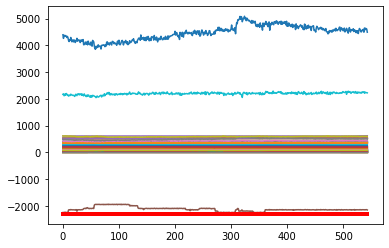

Predicción:  [[[0.9745404  0.02545965]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3417500e+01  1.1137800e+01  6.1497200e+01  7.8517900e+01
  6.1997030e+02  3.2118000e+01  9.3917000e+00  1.9006110e+02
  8.4200000e-02  6.8867900e+01  1.2512510e+02  1.0169000e+01
  6.6822200e+01  1.7245960e+02  2.1465100e+01  1.3416650e+02
  1.8936200e+02  7.0574000e+01 -6.8991000e+00  3.7217000e+00
  1.1670800e+01  7.2994000e+00  1.4991000e+00  7.3289400e+01
  1.4930000e+00  1.5631000e+00  8.6621300e+01  6.3013600e+01
  1.3566000e+00  1.2479000e+00  1.5112000e+00  1.4117000e+00
  1.6443230e+02  8.3700000e-01  8.3940000e-01 -2.1491777e+03
  2.0793020e+02  1.6497000e+00  1.4197000e+00  2.2346996e+03
  4.5819736e+03  1.8481450e+02  1.4403000e+00  1.4356000e+00
  7.8999000e+00  7.4943000e+00  1.7835000e+00  2.7200000e-01
  2.8575900e+01  5.3986660e+02  5.2311750e+02  5.1888170e+02
  5.1974860e+02  5.1987580e+02  3.0524700e+01  3.09

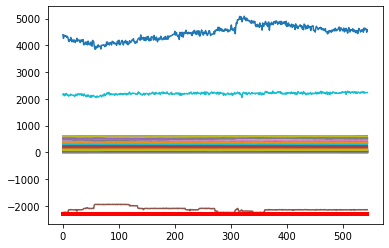

Predicción:  [[[0.9777558  0.02224425]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3554500e+01  1.1215700e+01  5.9657800e+01  7.8914900e+01
  6.1944230e+02  3.1082700e+01  9.3954000e+00  1.8999550e+02
  7.5500000e-02  6.9015500e+01  1.2497680e+02  1.0078500e+01
  6.6707300e+01  1.7107970e+02  2.0653800e+01  1.3303600e+02
  1.8966590e+02  7.0561200e+01 -6.8991000e+00  3.6868000e+00
  1.2037800e+01  7.2991000e+00  1.5003000e+00  7.3285700e+01
  1.4966000e+00  1.5676000e+00  8.6357600e+01  6.2791400e+01
  1.3617000e+00  1.2509000e+00  1.5170000e+00  1.4218000e+00
  1.6755480e+02  8.3580000e-01  8.4020000e-01 -2.1521554e+03
  2.0374940e+02  1.6534000e+00  1.4247000e+00  2.1970901e+03
  4.6519161e+03  1.8481450e+02  1.4517000e+00  1.4455000e+00
  7.8996000e+00  7.5092000e+00  1.7889000e+00  2.7200000e-01
  2.9826400e+01  5.4076450e+02  5.2308950e+02  5.1924370e+02
  5.2018380e+02  5.2028690e+02  3.0142000e+01  3.11

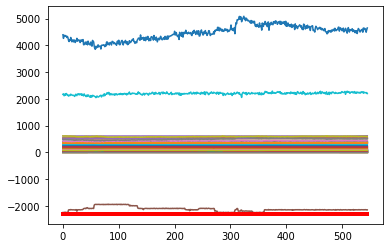

Predicción:  [[[0.9811065  0.01889346]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3681100e+01  1.1194200e+01  6.1253100e+01  8.0176600e+01
  6.2027590e+02  3.1123700e+01  9.3846000e+00  1.8991730e+02
  6.3900000e-02  6.9236600e+01  1.2497260e+02  9.8884000e+00
  6.7055300e+01  1.7119420e+02  2.1806500e+01  1.3224550e+02
  1.8948970e+02  7.0219600e+01 -6.8991000e+00  3.6927000e+00
  1.1290900e+01  7.2924000e+00  1.4993000e+00  7.3268900e+01
  1.5031000e+00  1.5738000e+00  8.6256600e+01  6.1943200e+01
  1.3671000e+00  1.2557000e+00  1.5242000e+00  1.4255000e+00
  1.6935640e+02  8.3880000e-01  8.4060000e-01 -2.1527729e+03
  2.0702570e+02  1.6601000e+00  1.4291000e+00  2.2328338e+03
  4.6207753e+03  1.8481450e+02  1.4553000e+00  1.4492000e+00
  7.9001000e+00  7.5022000e+00  1.7956000e+00  2.7110000e-01
  2.9673500e+01  5.4111550e+02  5.2316770e+02  5.1922220e+02
  5.2008920e+02  5.2020410e+02  3.0184200e+01  3.10

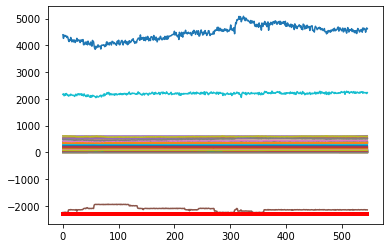

Predicción:  [[[0.9799264  0.02007359]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3881700e+01  1.1261400e+01  6.1839200e+01  7.8079500e+01
  6.1970960e+02  3.1330500e+01  9.4065000e+00  1.9005690e+02
  5.2100000e-02  6.9138100e+01  1.2507230e+02  1.0070500e+01
  6.6878800e+01  1.7067010e+02  2.2301600e+01  1.3115260e+02
  1.8957150e+02  7.0401500e+01 -6.8991000e+00  3.6831000e+00
  1.2151700e+01  7.2698000e+00  1.4993000e+00  7.3294200e+01
  1.5045000e+00  1.5764000e+00  8.7401400e+01  6.2026300e+01
  1.3688000e+00  1.2572000e+00  1.5240000e+00  1.4287000e+00
  1.6985980e+02  8.3760000e-01  8.3970000e-01 -2.1464081e+03
  2.0603640e+02  1.6636000e+00  1.4308000e+00  2.2503512e+03
  4.6887780e+03  1.8481450e+02  1.4579000e+00  1.4519000e+00
  7.8988000e+00  7.5014000e+00  1.7991000e+00  2.7520000e-01
  2.9413300e+01  5.3967100e+02  5.2294590e+02  5.1891910e+02
  5.1981540e+02  5.1990620e+02  3.1291300e+01  3.15

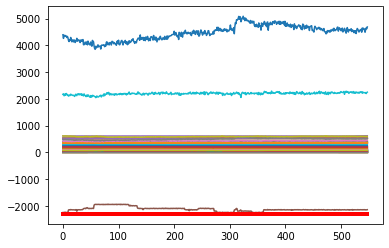

Predicción:  [[[0.98172265 0.01827729]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3957800e+01  1.1233800e+01  6.1186000e+01  7.9209200e+01
  6.1935030e+02  3.1545100e+01  9.4498000e+00  1.8998520e+02
  4.0400000e-02  6.9364300e+01  1.2533750e+02  9.9625000e+00
  6.6862100e+01  1.7118310e+02  2.2489400e+01  1.2929320e+02
  1.8961100e+02  7.0204400e+01 -6.8991000e+00  3.6722000e+00
  9.6803000e+00  7.2883000e+00  1.4991000e+00  7.3168100e+01
  1.5099000e+00  1.5806000e+00  8.6253900e+01  6.0909200e+01
  1.3719000e+00  1.2634000e+00  1.5335000e+00  1.4360000e+00
  1.6994290e+02  8.3760000e-01  8.3970000e-01 -2.1748239e+03
  2.0545060e+02  1.6671000e+00  1.4329000e+00  2.2818123e+03
  4.6399401e+03  1.8481450e+02  1.4648000e+00  1.4590000e+00
  7.9046000e+00  7.7040000e+00  1.8020000e+00  2.6870000e-01
  2.8526200e+01  5.4031350e+02  5.2313000e+02  5.1932410e+02
  5.2004640e+02  5.2025550e+02  3.1362500e+01  3.20

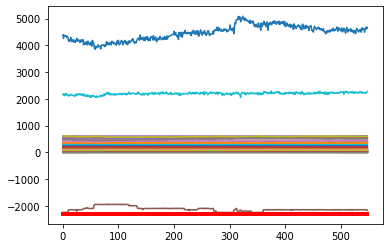

Predicción:  [[[0.9832403  0.01675965]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4016500e+01  1.1264300e+01  6.3281800e+01  7.8797600e+01
  6.1955950e+02  3.0702600e+01  9.4482000e+00  1.8996020e+02
  3.0000000e-02  6.9076100e+01  1.2490630e+02  9.9070000e+00
  6.7457000e+01  1.7066100e+02  2.2424900e+01  1.2666250e+02
  1.8971360e+02  7.0110500e+01 -6.8991000e+00  3.7092000e+00
  1.2122100e+01  7.2826000e+00  1.4984000e+00  7.2934700e+01
  1.5061000e+00  1.5777000e+00  8.7068600e+01  6.0674600e+01
  1.3636000e+00  1.2571000e+00  1.5257000e+00  1.4281000e+00
  1.7125670e+02  8.3890000e-01  8.4050000e-01 -2.2218015e+03
  2.0334290e+02  1.6653000e+00  1.4242000e+00  2.3015220e+03
  4.6532283e+03  1.8481450e+02  1.4566000e+00  1.4519000e+00
  7.8963000e+00  7.8012000e+00  1.8014000e+00  2.7530000e-01
  2.8643000e+01  5.4021770e+02  5.2261530e+02  5.1874700e+02
  5.1945810e+02  5.1975410e+02  3.1632600e+01  3.21

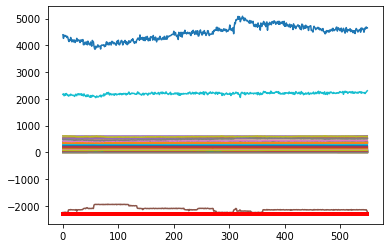

Predicción:  [[[0.9881946  0.01180546]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4001600e+01  1.1287700e+01  6.3120200e+01  7.7641700e+01
  6.1948680e+02  3.1248000e+01  9.4371000e+00  1.8992380e+02
  2.1600000e-02  6.8857800e+01  1.2526040e+02  1.0018700e+01
  6.6604900e+01  1.7046090e+02  2.2013300e+01  1.2509440e+02
  1.8990440e+02  6.9999500e+01 -6.8991000e+00  3.6933000e+00
  1.2729900e+01  7.3107000e+00  1.5001000e+00  7.2986300e+01
  1.5005000e+00  1.5714000e+00  8.7048800e+01  6.0916800e+01
  1.3581000e+00  1.2516000e+00  1.5167000e+00  1.4189000e+00
  1.7139570e+02  8.3840000e-01  8.3960000e-01 -2.2576138e+03
  2.0483290e+02  1.6583000e+00  1.4194000e+00  2.2543755e+03
  4.5916122e+03  1.8481450e+02  1.4473000e+00  1.4432000e+00
  7.9025000e+00  7.7990000e+00  1.7945000e+00  2.7790000e-01
  2.8783400e+01  5.3878440e+02  5.2261380e+02  5.1865440e+02
  5.1927310e+02  5.1942020e+02  3.1792500e+01  3.22

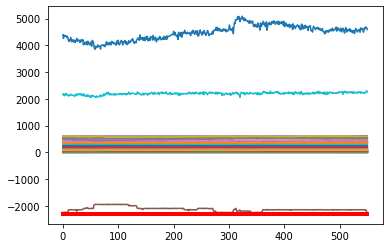

Predicción:  [[[0.98952264 0.01047737]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4200300e+01  1.1407800e+01  6.2157700e+01  7.7773600e+01
  6.1829250e+02  3.1324000e+01  9.4760000e+00  1.8999260e+02
  1.3200000e-02  6.8019300e+01  1.2510990e+02  1.0127400e+01
  6.6746100e+01  1.6992640e+02  2.2243100e+01  1.2305820e+02
  1.9010820e+02  6.9953800e+01 -6.8991000e+00  3.6999000e+00
  1.2576100e+01  7.3013000e+00  1.5008000e+00  7.2911800e+01
  1.5045000e+00  1.5765000e+00  8.6031100e+01  6.0662500e+01
  1.3626000e+00  1.2562000e+00  1.5211000e+00  1.4269000e+00
  1.7259740e+02  8.3900000e-01  8.4070000e-01 -2.2595950e+03
  2.0092810e+02  1.6634000e+00  1.4234000e+00  2.2519160e+03
  4.6732681e+03  1.8481450e+02  1.4549000e+00  1.4514000e+00
  7.9005000e+00  7.8005000e+00  1.7987000e+00  2.7740000e-01
  2.8223800e+01  5.3916890e+02  5.2267610e+02  5.1879330e+02
  5.1940430e+02  5.1951950e+02  3.1937200e+01  3.23

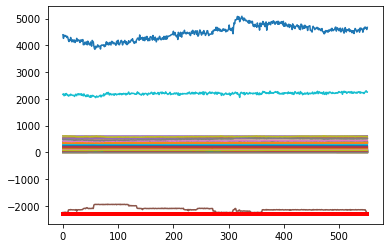

Predicción:  [[[0.99082583 0.00917414]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4539700e+01  1.1603000e+01  6.2837200e+01  7.8477800e+01
  6.1962460e+02  3.1086000e+01  9.4750000e+00  1.8992960e+02
  4.8000000e-03  6.8124300e+01  1.2486830e+02  1.0033800e+01
  6.6909600e+01  1.6990640e+02  2.2349200e+01  1.2232090e+02
  1.9038380e+02  6.9909500e+01 -6.8991000e+00  3.6762000e+00
  1.2450900e+01  7.2819000e+00  1.4989000e+00  7.2708800e+01
  1.5041000e+00  1.5751000e+00  8.5198200e+01  6.0322300e+01
  1.3579000e+00  1.2541000e+00  1.5186000e+00  1.4262000e+00
  1.7282850e+02  8.3910000e-01  8.4080000e-01 -2.2545310e+03
  1.9947190e+02  1.6603000e+00  1.4182000e+00  2.2705758e+03
  4.5853236e+03  1.8481450e+02  1.4559000e+00  1.4520000e+00
  7.9007000e+00  7.8004000e+00  1.7982000e+00  2.7930000e-01
  2.9487100e+01  5.3969340e+02  5.2261890e+02  5.1874710e+02
  5.1942300e+02  5.1960500e+02  3.2086000e+01  3.25

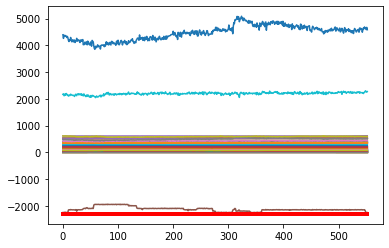

Predicción:  [[[0.98911357 0.01088638]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4502400e+01  1.1694100e+01  6.2894400e+01  7.7845400e+01
  6.1921010e+02  3.1212800e+01  9.5217000e+00  1.9002130e+02
  5.0000000e-04  6.8088100e+01  1.2511810e+02  1.0025100e+01
  6.6658500e+01  1.7023920e+02  2.2561200e+01  1.2117830e+02
  1.9057700e+02  6.9469500e+01 -6.8991000e+00  3.6936000e+00
  1.2384500e+01  7.3000000e+00  1.4995000e+00  7.2611900e+01
  1.5065000e+00  1.5797000e+00  8.5186400e+01  6.0354400e+01
  1.3621000e+00  1.2552000e+00  1.5192000e+00  1.4275000e+00
  1.7274200e+02  8.3880000e-01  8.4000000e-01 -2.2522973e+03
  2.0141300e+02  1.6651000e+00  1.4223000e+00  2.2753913e+03
  4.6713915e+03  1.8481450e+02  1.4563000e+00  1.4539000e+00
  7.8974000e+00  7.8004000e+00  1.8010000e+00  2.8150000e-01
  2.9049700e+01  5.4006880e+02  5.2301780e+02  5.1919260e+02
  5.1980090e+02  5.1993330e+02  3.2525100e+01  3.25

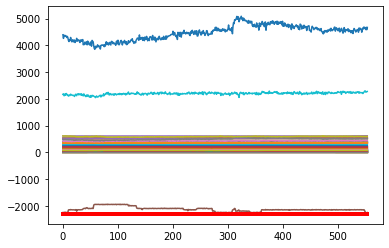

Predicción:  [[[0.9904861 0.0095139]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4644800e+01  1.1670800e+01  6.1522100e+01  7.6952000e+01
  6.2032150e+02  3.1376200e+01  9.5655000e+00  1.9004320e+02
  5.0000000e-04  6.7465200e+01  1.2506660e+02  9.9761000e+00
  6.6724100e+01  1.7099200e+02  2.2727700e+01  1.2019690e+02
  1.9054860e+02  6.9412800e+01 -6.8991000e+00  3.6979000e+00
  1.3185500e+01  7.2913000e+00  1.5003000e+00  7.2532100e+01
  1.5106000e+00  1.5824000e+00  8.4216700e+01  6.0018900e+01
  1.3662000e+00  1.2586000e+00  1.5184000e+00  1.4297000e+00
  1.7419200e+02  8.3840000e-01  8.4040000e-01 -2.2584543e+03
  2.0103380e+02  1.6672000e+00  1.4263000e+00  2.2612770e+03
  4.5220795e+03  1.8481450e+02  1.4578000e+00  1.4537000e+00
  7.8985000e+00  7.7997000e+00  1.8041000e+00  2.8550000e-01
  2.8512800e+01  5.4047720e+02  5.2295550e+02  5.1902180e+02
  5.1962570e+02  5.1974880e+02  3.2696400e+01  3.2716

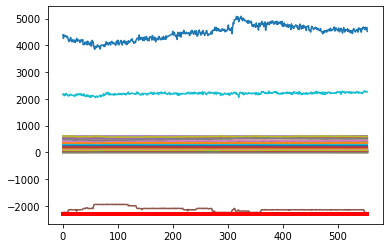

Predicción:  [[[0.9878968  0.01210325]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4853500e+01  1.1666700e+01  6.2099000e+01  7.7032900e+01
  6.1939460e+02  3.1297200e+01  9.5260000e+00  1.9004530e+02
  5.0000000e-04  6.7526600e+01  1.2522200e+02  9.9928000e+00
  6.6465700e+01  1.7002920e+02  2.2869900e+01  1.1891580e+02
  1.9045970e+02  6.9453300e+01 -6.8991000e+00  3.7115000e+00
  1.2719300e+01  7.3218000e+00  1.4987000e+00  7.2584800e+01
  1.4998000e+00  1.5736000e+00  8.5020000e+01  6.0086000e+01
  1.3571000e+00  1.2475000e+00  1.5099000e+00  1.4222000e+00
  1.7568500e+02  8.3290000e-01  8.3420000e-01 -2.2498113e+03
  2.0173320e+02  1.6583000e+00  1.4174000e+00  2.2585132e+03
  4.6497761e+03  1.8481450e+02  1.4507000e+00  1.4462000e+00
  7.9009000e+00  7.8008000e+00  1.7932000e+00  2.8310000e-01
  2.8478400e+01  5.3973110e+02  5.2315740e+02  5.1923040e+02
  5.1968660e+02  5.1987970e+02  3.2493000e+01  3.27

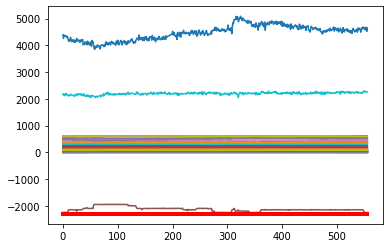

Predicción:  [[[0.99005604 0.00994404]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4667200e+01  1.1744000e+01  6.2804200e+01  7.7178800e+01
  6.2021910e+02  3.1792900e+01  9.5687000e+00  1.9009670e+02
  5.0000000e-04  6.7846300e+01  1.2494650e+02  1.0070200e+01
  6.6593700e+01  1.7079080e+02  2.2911400e+01  1.1848300e+02
  1.9049720e+02  6.9641900e+01 -6.8991000e+00  3.7180000e+00
  1.2769700e+01  7.3170000e+00  1.4995000e+00  7.2585000e+01
  1.4991000e+00  1.5722000e+00  8.5605300e+01  6.0168000e+01
  1.3617000e+00  1.2476000e+00  1.5039000e+00  1.4243000e+00
  1.7582330e+02  8.2830000e-01  8.2880000e-01 -2.2525656e+03
  2.0110880e+02  1.6577000e+00  1.4216000e+00  2.3119199e+03
  4.5474509e+03  1.8481450e+02  1.4527000e+00  1.4483000e+00
  7.9026000e+00  7.8007000e+00  1.7920000e+00  2.8820000e-01
  2.8442900e+01  5.3974390e+02  5.2343110e+02  5.1944740e+02
  5.1986980e+02  5.2008280e+02  3.2643600e+01  3.29

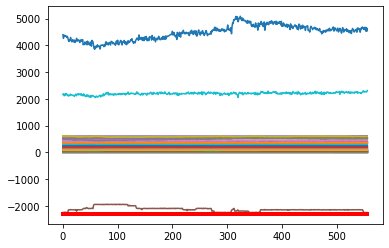

Predicción:  [[[0.9880464  0.01195363]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4707300e+01  1.1696100e+01  6.1711700e+01  7.6227500e+01
  6.2028460e+02  3.1690800e+01  9.4750000e+00  1.8989360e+02
  5.0000000e-04  6.8695400e+01  1.2530100e+02  9.8425000e+00
  6.7021900e+01  1.7117810e+02  2.2190200e+01  1.1828430e+02
  1.9039960e+02  6.9847900e+01 -6.8991000e+00  3.7207000e+00
  1.4568500e+01  7.2783000e+00  1.4994000e+00  7.2624300e+01
  1.4812000e+00  1.5559000e+00  8.6006900e+01  6.0875400e+01
  1.3407000e+00  1.2319000e+00  1.4797000e+00  1.4049000e+00
  1.7231200e+02  8.2910000e-01  8.2970000e-01 -2.2485759e+03
  2.0262670e+02  1.6418000e+00  1.4019000e+00  2.2460947e+03
  4.6427619e+03  1.8481450e+02  1.4333000e+00  1.4294000e+00
  7.8965000e+00  7.7934000e+00  1.7749000e+00  2.9520000e-01
  2.8644900e+01  5.3831770e+02  5.2282670e+02  5.1896180e+02
  5.1924500e+02  5.1954910e+02  3.2774600e+01  3.29

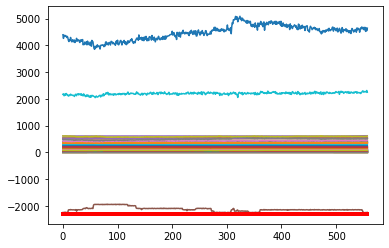

Predicción:  [[[0.98987573 0.01012426]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4618800e+01  1.1718700e+01  6.1045300e+01  7.5849900e+01
  6.2041770e+02  3.0207000e+01  9.5080000e+00  1.8997320e+02
  5.0000000e-04  6.8904600e+01  1.2506860e+02  1.0103800e+01
  6.6742200e+01  1.6871600e+02  2.2135300e+01  1.1686890e+02
  1.9045530e+02  6.9474700e+01 -6.8991000e+00  3.7099000e+00
  1.3224300e+01  7.4341000e+00  1.5007000e+00  7.2617000e+01
  1.4891000e+00  1.5630000e+00  8.4044300e+01  6.0513600e+01
  1.3472000e+00  1.2408000e+00  1.4976000e+00  1.4130000e+00
  1.7153240e+02  8.3000000e-01  8.3000000e-01 -2.2527048e+03
  2.0177380e+02  1.6476000e+00  1.4077000e+00  2.2967471e+03
  4.5961762e+03  1.8481450e+02  1.4415000e+00  1.4390000e+00
  7.8994000e+00  7.7984000e+00  1.7817000e+00  2.8400000e-01
  2.8485700e+01  5.3770220e+02  5.2262930e+02  5.1886440e+02
  5.1926260e+02  5.1948610e+02  3.2880800e+01  3.31

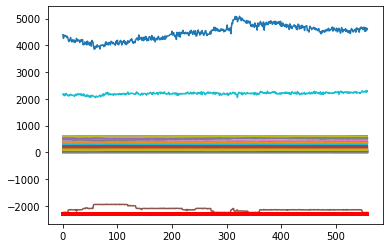

Predicción:  [[[0.9891901 0.0108099]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4390300e+01  1.1649800e+01  6.1864300e+01  7.7128700e+01
  6.2010940e+02  3.1706900e+01  9.5484000e+00  1.8998940e+02
  5.0000000e-04  7.4592900e+01  1.2495050e+02  9.8248000e+00
  6.6956800e+01  1.7481130e+02  2.2651400e+01  1.1684530e+02
  1.9057610e+02  6.9348800e+01 -6.8991000e+00  3.6778000e+00
  1.2532200e+01  7.5004000e+00  1.5001000e+00  7.2628600e+01
  1.4913000e+00  1.5655000e+00  8.4280800e+01  6.0239000e+01
  1.3582000e+00  1.2448000e+00  1.4817000e+00  1.4156000e+00
  1.7099170e+02  8.3020000e-01  8.2930000e-01 -2.2484676e+03
  2.0200230e+02  1.6494000e+00  1.4177000e+00  2.3180707e+03
  4.5169599e+03  1.8481450e+02  1.4432000e+00  1.4389000e+00
  7.9022000e+00  7.8056000e+00  1.7828000e+00  3.0120000e-01
  2.7384700e+01  5.3761780e+02  5.2319560e+02  5.1935510e+02
  5.1987200e+02  5.1998540e+02  3.2954200e+01  3.3183

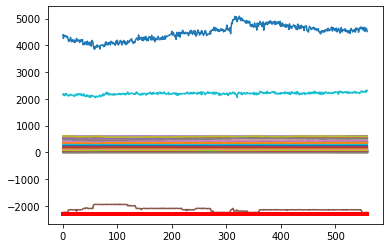

Predicción:  [[[0.986865 0.013135]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4400400e+01  1.1649700e+01  6.2501700e+01  7.5958900e+01
  6.2112480e+02  3.1671900e+01  9.4930000e+00  1.9001250e+02
  5.0000000e-04  7.6791900e+01  1.2517360e+02  1.0002800e+01
  6.7144000e+01  1.7929650e+02  2.2917100e+01  1.1966190e+02
  1.9032390e+02  6.9210900e+01 -6.8991000e+00  3.6880000e+00
  1.4936200e+01  7.5015000e+00  1.5003000e+00  7.2558100e+01
  1.4895000e+00  1.5656000e+00  8.3974300e+01  6.0365700e+01
  1.3506000e+00  1.2458000e+00  1.4531000e+00  1.4129000e+00
  1.6664190e+02  8.2960000e-01  8.3060000e-01 -2.2499390e+03
  2.0019810e+02  1.6501000e+00  1.4111000e+00  2.2901186e+03
  4.6161037e+03  1.8481450e+02  1.4403000e+00  1.4357000e+00
  7.9000000e+00  7.8012000e+00  1.7808000e+00  3.2760000e-01
  2.7065800e+01  5.3788220e+02  5.2369260e+02  5.1979770e+02
  5.2029840e+02  5.2033240e+02  3.2766700e+01  3.314010

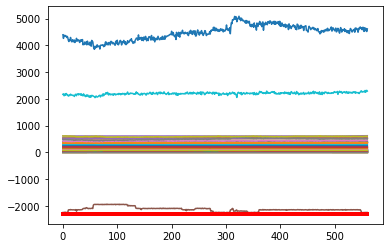

Predicción:  [[[0.9893939  0.01060607]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4270600e+01  1.1790000e+01  6.1675300e+01  7.5226500e+01
  6.2053730e+02  3.1038900e+01  9.5069000e+00  1.9001040e+02
  5.0000000e-04  7.6990400e+01  1.2521640e+02  9.9945000e+00
  6.6651900e+01  1.7651480e+02  2.2206200e+01  1.2257090e+02
  1.9048630e+02  6.9695300e+01 -6.8991000e+00  3.6987000e+00
  1.3506400e+01  7.5275000e+00  1.5008000e+00  7.2633900e+01
  1.4705000e+00  1.5443000e+00  8.3922000e+01  6.0794200e+01
  1.3326000e+00  1.2319000e+00  1.4463000e+00  1.3918000e+00
  1.6203480e+02  8.2760000e-01  8.2980000e-01 -2.2468764e+03
  2.0126840e+02  1.6277000e+00  1.3934000e+00  2.2853263e+03
  4.4840430e+03  1.8481450e+02  1.4193000e+00  1.4171000e+00
  7.9009000e+00  7.7981000e+00  1.7606000e+00  3.1440000e-01
  2.7769400e+01  5.3607110e+02  5.2242740e+02  5.1828050e+02
  5.1880320e+02  5.1892660e+02  3.2859400e+01  3.32

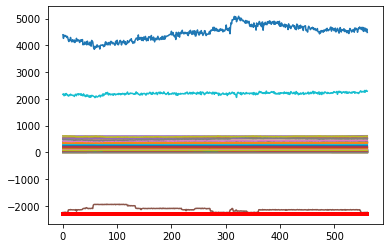

Predicción:  [[[0.9858349  0.01416511]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4160100e+01  1.1758000e+01  6.2489700e+01  7.6433200e+01
  6.1968420e+02  3.0790100e+01  9.5749000e+00  1.9000030e+02
  5.0000000e-04  7.6834900e+01  1.2507560e+02  1.0169800e+01
  6.7109600e+01  1.7661240e+02  2.2213200e+01  1.2277170e+02
  1.9075390e+02  6.9673900e+01 -6.8991000e+00  3.6889000e+00
  1.3646800e+01  7.5240000e+00  1.5012000e+00  7.2629600e+01
  1.4770000e+00  1.5534000e+00  8.1858000e+01  6.0542400e+01
  1.3443000e+00  1.2400000e+00  1.4498000e+00  1.3996000e+00
  1.6102230e+02  8.2930000e-01  8.2760000e-01 -2.2471409e+03
  2.0320240e+02  1.6358000e+00  1.4043000e+00  2.2604156e+03
  4.4406966e+03  1.8481450e+02  1.4263000e+00  1.4230000e+00
  7.8993000e+00  7.8027000e+00  1.7669000e+00  3.1710000e-01
  2.6759100e+01  5.3584560e+02  5.2230880e+02  5.1795510e+02
  5.1864030e+02  5.1862840e+02  3.2975200e+01  3.31

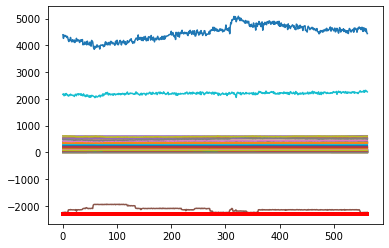

Predicción:  [[[0.9844946  0.01550542]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4039400e+01  1.1675500e+01  6.1777100e+01  7.8337400e+01
  6.2142180e+02  3.0793200e+01  9.4481000e+00  1.9004900e+02
  5.0000000e-04  7.7885400e+01  1.2519620e+02  1.0002400e+01
  6.6705400e+01  1.7733460e+02  2.2941500e+01  1.2263220e+02
  1.9068400e+02  6.9593400e+01 -6.8991000e+00  3.6964000e+00
  1.2283600e+01  7.4866000e+00  1.4985000e+00  7.2616500e+01
  1.4820000e+00  1.5583000e+00  8.3746500e+01  6.0073500e+01
  1.3479000e+00  1.2419000e+00  1.4580000e+00  1.4051000e+00
  1.6394690e+02  8.2870000e-01  8.2980000e-01 -2.2477046e+03
  2.0360510e+02  1.6425000e+00  1.4082000e+00  2.2838022e+03
  4.5415640e+03  1.8481450e+02  1.4317000e+00  1.4298000e+00
  7.9009000e+00  7.7937000e+00  1.7716000e+00  3.1410000e-01
  2.6748300e+01  5.3804890e+02  5.2372830e+02  5.1984700e+02
  5.2041980e+02  5.2038100e+02  3.2873900e+01  3.31

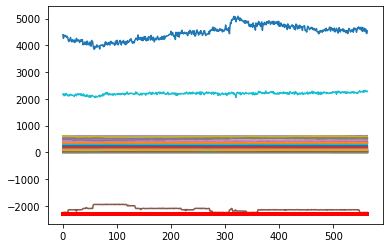

Predicción:  [[[0.98749405 0.01250599]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3788900e+01  1.2145800e+01  6.2933300e+01  7.5377500e+01
  6.1864110e+02  3.0783100e+01  9.4864000e+00  1.9004810e+02
  5.0000000e-04  7.7525800e+01  1.2500460e+02  1.0078500e+01
  6.6981300e+01  1.7806060e+02  2.2287800e+01  1.2355070e+02
  1.9091270e+02  6.9448000e+01 -6.8991000e+00  3.7135000e+00
  1.3045800e+01  7.5153000e+00  1.5016000e+00  7.2567700e+01
  1.4896000e+00  1.5653000e+00  8.4201400e+01  6.0291100e+01
  1.3525000e+00  1.2501000e+00  1.4564000e+00  1.4123000e+00
  1.6250820e+02  8.2780000e-01  8.2970000e-01 -2.2473867e+03
  1.9908840e+02  1.6495000e+00  1.4124000e+00  2.2721830e+03
  4.6432212e+03  1.8481450e+02  1.4404000e+00  1.4382000e+00
  7.9011000e+00  7.8061000e+00  1.7803000e+00  3.2390000e-01
  2.7947000e+01  5.3735330e+02  5.2337340e+02  5.1931750e+02
  5.1981030e+02  5.1978420e+02  3.2432800e+01  3.30

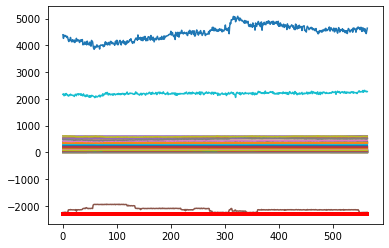

Predicción:  [[[0.98978794 0.01021212]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  565  - Datos Recibidos:  [ 4.3756800e+01  1.2518200e+01  6.0045600e+01  7.5904300e+01
  6.2039260e+02  3.3368300e+01  9.5732000e+00  1.9000470e+02
  3.3000000e-03  7.7271400e+01  1.2519490e+02  1.0135300e+01
  6.7048100e+01  1.8306230e+02  2.1698600e+01  1.2348940e+02
  1.9156360e+02  6.9696600e+01 -6.8991000e+00  3.7055000e+00
  1.3340000e+01  7.5162000e+00  1.5004000e+00  7.2613600e+01
  1.4653000e+00  1.5413000e+00  8.3543400e+01  6.0835900e+01
  1.3267000e+00  1.2236000e+00  1.4606000e+00  1.3836000e+00
  1.6189120e+02  8.2520000e-01  8.3010000e-01 -2.2537162e+03
  2.0339910e+02  1.6245000e+00  1.3878000e+00  2.3075718e+03
  4.5024406e+03  1.8481450e+02  1.4151000e+00  1.4098000e+00
  7.8997000e+00  7.7999000e+00  1.7549000e+00  2.9440000e-01
  3.1585900e+01  5.3596450e+02  5.2152770e+02  5.1776710e+02
  5.1835170e+02  5.1844690e+02  3.220830

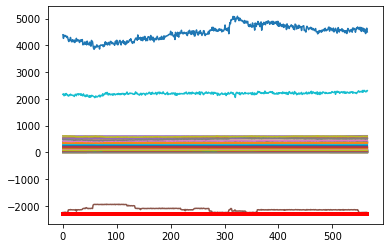

Predicción:  [[[0.9870301  0.01296994]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3756800e+01  1.2518200e+01  6.0045600e+01  7.5904300e+01
  6.2039260e+02  3.3368300e+01  9.5732000e+00  1.9000470e+02
  3.3000000e-03  7.7271400e+01  1.2519490e+02  1.0135300e+01
  6.7048100e+01  1.8306230e+02  2.1698600e+01  1.2348940e+02
  1.9156360e+02  6.9696600e+01 -6.8991000e+00  3.7055000e+00
  1.3340000e+01  7.5162000e+00  1.5004000e+00  7.2613600e+01
  1.4653000e+00  1.5413000e+00  8.3543400e+01  6.0835900e+01
  1.3267000e+00  1.2236000e+00  1.4606000e+00  1.3836000e+00
  1.6189120e+02  8.2520000e-01  8.3010000e-01 -2.2537162e+03
  2.0339910e+02  1.6245000e+00  1.3878000e+00  2.3075718e+03
  4.5024406e+03  1.8481450e+02  1.4151000e+00  1.4098000e+00
  7.8997000e+00  7.7999000e+00  1.7549000e+00  2.9440000e-01
  3.1585900e+01  5.3596450e+02  5.2152770e+02  5.1776710e+02
  5.1835170e+02  5.1844690e+02  3.2208300e+01  3.26

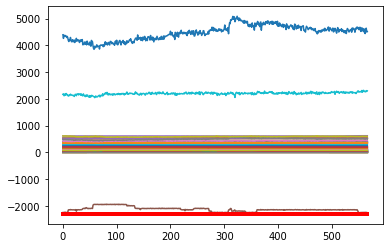

Predicción:  [[[0.9874626  0.01253745]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3248000e+01  1.2749500e+01  6.0392600e+01  7.7507000e+01
  6.1958010e+02  3.3385400e+01  9.5868000e+00  1.8914840e+02
  2.8900000e-02  7.5194800e+01  1.2496600e+02  9.9338000e+00
  6.6681600e+01  1.8029370e+02  2.2199600e+01  1.2513390e+02
  1.9116540e+02  6.9427400e+01 -6.8991000e+00  3.6876000e+00
  1.2774900e+01  7.5100000e+00  1.5002000e+00  7.2647700e+01
  1.4844000e+00  1.5610000e+00  8.2836700e+01  5.9897700e+01
  1.3467000e+00  1.2432000e+00  1.6694000e+00  1.4054000e+00
  1.6277300e+02  8.2490000e-01  8.3060000e-01 -2.2533141e+03
  2.0170850e+02  1.6436000e+00  1.4065000e+00  2.2502815e+03
  4.5852782e+03  1.8481450e+02  1.4380000e+00  1.4273000e+00
  7.9028000e+00  7.7991000e+00  1.7713000e+00  1.0190000e-01
  3.2650900e+01  5.3753110e+02  5.2297280e+02  5.1895350e+02
  5.1970490e+02  5.1982920e+02  3.2354800e+01  3.25

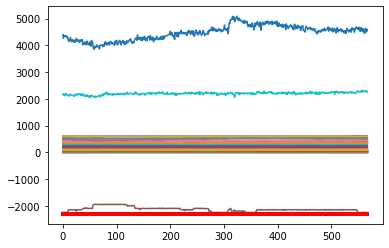

Predicción:  [[[0.9890057  0.01099429]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3368800e+01  1.2892300e+01  5.8884200e+01  7.7237300e+01
  6.2100570e+02  3.4547600e+01  9.6037000e+00  1.8868400e+02
  4.2200000e-02  7.2527700e+01  1.2503350e+02  9.8100000e+00
  6.6841800e+01  1.7725860e+02  2.2311500e+01  1.2660020e+02
  1.9078660e+02  6.9446000e+01 -6.8991000e+00  3.7064000e+00
  9.9404000e+00  7.5174000e+00  1.4983000e+00  7.2627800e+01
  1.4797000e+00  1.5573000e+00  8.3798100e+01  5.9530400e+01
  1.3441000e+00  1.2361000e+00  1.6757000e+00  1.4012000e+00
  1.6509600e+02  8.2440000e-01  8.2970000e-01 -2.2463138e+03
  2.0274480e+02  1.6411000e+00  1.4040000e+00  2.2591570e+03
  4.5797432e+03  1.8481450e+02  1.4343000e+00  1.4242000e+00
  7.9042000e+00  7.8006000e+00  1.7692000e+00  9.3500000e-02
  3.3085400e+01  5.3788440e+02  5.2329300e+02  5.1914520e+02
  5.1986890e+02  5.2000660e+02  3.2282000e+01  3.25

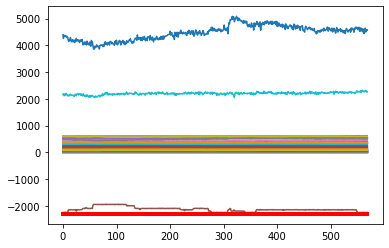

Predicción:  [[[0.9883503 0.0116498]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3614000e+01  1.2992300e+01  5.9706700e+01  7.5850600e+01
  6.1974890e+02  3.4573600e+01  9.6055000e+00  1.8810350e+02
  5.5800000e-02  7.2085600e+01  1.2502880e+02  9.7836000e+00
  6.6621900e+01  1.7921380e+02  2.1931000e+01  1.2874710e+02
  1.9040880e+02  6.9399400e+01 -6.8991000e+00  3.7105000e+00
  1.3085000e+01  7.4889000e+00  1.5000000e+00  7.2589500e+01
  1.4842000e+00  1.5580000e+00  8.4526200e+01  5.9698600e+01
  1.3447000e+00  1.2413000e+00  1.6757000e+00  1.4053000e+00
  1.6286810e+02  8.2490000e-01  8.3030000e-01 -2.2492499e+03
  2.0117170e+02  1.6420000e+00  1.4050000e+00  2.2493166e+03
  4.5476729e+03  1.8481450e+02  1.4381000e+00  1.4297000e+00
  7.8978000e+00  7.8015000e+00  1.7748000e+00  9.9000000e-02
  3.2944400e+01  5.3746670e+02  5.2283500e+02  5.1884990e+02
  5.1960570e+02  5.1974970e+02  3.2372000e+01  3.2356

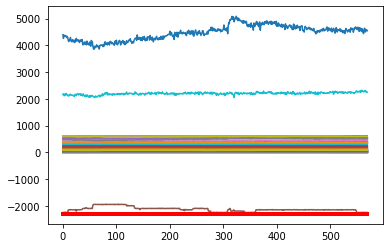

Predicción:  [[[0.9878479  0.01215205]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3821300e+01  1.2898100e+01  5.8997500e+01  7.7326200e+01
  6.2023070e+02  3.4403400e+01  9.6121000e+00  1.8806430e+02
  7.0200000e-02  7.2862500e+01  1.2495290e+02  1.0140000e+01
  6.7302500e+01  1.7849480e+02  2.2099500e+01  1.2884750e+02
  1.9023480e+02  6.9650200e+01 -6.8991000e+00  3.7152000e+00
  1.0999100e+01  7.4856000e+00  1.5005000e+00  7.2592600e+01
  1.4854000e+00  1.5607000e+00  8.4439800e+01  6.0368000e+01
  1.3442000e+00  1.2414000e+00  1.6775000e+00  1.4071000e+00
  1.6470580e+02  8.2440000e-01  8.3060000e-01 -2.2436168e+03
  2.0301730e+02  1.6451000e+00  1.4045000e+00  2.2809883e+03
  4.6004242e+03  1.8481450e+02  1.4401000e+00  1.4331000e+00
  7.8989000e+00  7.7990000e+00  1.7743000e+00  9.7100000e-02
  3.2777900e+01  5.3826660e+02  5.2332260e+02  5.1944890e+02
  5.2023120e+02  5.2039470e+02  3.1948200e+01  3.22

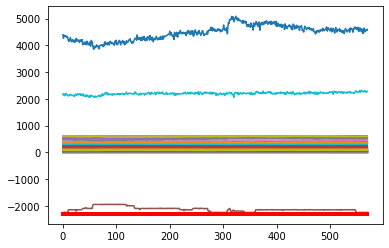

Predicción:  [[[0.98865217 0.01134782]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3740000e+01  1.2818700e+01  5.8665200e+01  7.4755000e+01
  6.2055980e+02  3.4097500e+01  9.6208000e+00  1.8794760e+02
  7.4700000e-02  7.2892800e+01  1.2497270e+02  1.0298900e+01
  6.7289900e+01  1.7891510e+02  2.1272100e+01  1.2926060e+02
  1.9009120e+02  6.9666400e+01 -6.8991000e+00  3.7075000e+00
  1.1713100e+01  7.4779000e+00  1.5004000e+00  7.2581300e+01
  1.4858000e+00  1.5578000e+00  8.3685900e+01  5.9580700e+01
  1.3454000e+00  1.2413000e+00  1.6741000e+00  1.4047000e+00
  1.6463590e+02  8.2780000e-01  8.3210000e-01 -2.2524116e+03
  2.0254210e+02  1.6422000e+00  1.4055000e+00  2.2972660e+03
  4.5336462e+03  1.8481450e+02  1.4374000e+00  1.4301000e+00
  7.8973000e+00  7.7933000e+00  1.7759000e+00  1.0170000e-01
  3.3017400e+01  5.3768230e+02  5.2308900e+02  5.1897880e+02
  5.1980800e+02  5.1994830e+02  3.2472100e+01  3.23

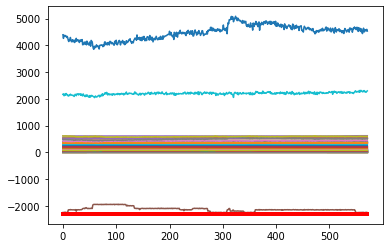

Predicción:  [[[0.98769265 0.01230739]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3593700e+01  1.2813200e+01  5.7075800e+01  7.6434700e+01
  6.2069140e+02  3.2344100e+01  9.6547000e+00  1.8794050e+02
  8.0600000e-02  7.2998400e+01  1.2533690e+02  9.8785000e+00
  6.6853000e+01  1.7740060e+02  2.0728700e+01  1.2812730e+02
  1.9010780e+02  6.9559800e+01 -6.8991000e+00  3.7109000e+00
  1.0844600e+01  7.5189000e+00  1.5001000e+00  7.2592400e+01
  1.4818000e+00  1.5546000e+00  8.4811500e+01  6.0582800e+01
  1.3413000e+00  1.2373000e+00  1.6738000e+00  1.4015000e+00
  1.6528650e+02  8.2620000e-01  8.2870000e-01 -2.2473010e+03
  2.0360760e+02  1.6375000e+00  1.4017000e+00  2.2186842e+03
  4.6426177e+03  1.8481450e+02  1.4341000e+00  1.4277000e+00
  7.8981000e+00  7.8030000e+00  1.7716000e+00  9.7500000e-02
  3.2581800e+01  5.3838220e+02  5.2315420e+02  5.1926350e+02
  5.2006990e+02  5.2013480e+02  3.1245100e+01  3.25

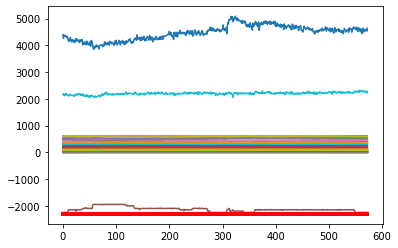

Predicción:  [[[0.9898206  0.01017943]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3552700e+01  1.2718100e+01  5.7969900e+01  7.8920700e+01
  6.1983240e+02  3.3934300e+01  9.6469000e+00  1.8776130e+02
  7.9900000e-02  7.2974600e+01  1.2487040e+02  9.9217000e+00
  6.7066600e+01  1.7948080e+02  2.1444000e+01  1.3013860e+02
  1.8969630e+02  6.9514100e+01 -6.8991000e+00  3.6953000e+00
  1.0963700e+01  7.5142000e+00  1.5007000e+00  7.2572900e+01
  1.4812000e+00  1.5534000e+00  8.3501400e+01  6.0856600e+01
  1.3373000e+00  1.2362000e+00  1.6716000e+00  1.3984000e+00
  1.6345420e+02  8.2790000e-01  8.3040000e-01 -2.2541535e+03
  1.9974610e+02  1.6368000e+00  1.3981000e+00  2.3001106e+03
  4.6632563e+03  1.8481450e+02  1.4314000e+00  1.4254000e+00
  7.9010000e+00  7.8020000e+00  1.7714000e+00  9.9600000e-02
  3.2944100e+01  5.3781270e+02  5.2307020e+02  5.1904680e+02
  5.1994240e+02  5.1983200e+02  3.0185200e+01  3.17

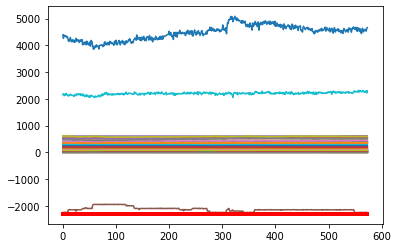

Predicción:  [[[0.99048084 0.00951914]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3296700e+01  1.2537900e+01  5.7760200e+01  7.8319200e+01
  6.2021870e+02  3.3390400e+01  9.5880000e+00  1.8706720e+02
  7.9400000e-02  7.3219500e+01  1.2476430e+02  1.0064400e+01
  6.6293800e+01  1.7928350e+02  2.1811300e+01  1.3120000e+02
  1.8886180e+02  6.9486700e+01 -6.8991000e+00  3.7014000e+00
  1.1544700e+01  7.4846000e+00  1.5001000e+00  7.2617000e+01
  1.4908000e+00  1.5651000e+00  8.3868300e+01  6.0380300e+01
  1.3449000e+00  1.2472000e+00  1.6798000e+00  1.4123000e+00
  1.6260040e+02  8.2760000e-01  8.3030000e-01 -2.2438552e+03
  2.0518630e+02  1.6488000e+00  1.4051000e+00  2.2469968e+03
  4.6805734e+03  1.8481450e+02  1.4452000e+00  1.4359000e+00
  7.9014000e+00  7.8001000e+00  1.7823000e+00  1.0220000e-01
  3.2650000e+01  5.3861560e+02  5.2330570e+02  5.1983170e+02
  5.2064970e+02  5.2044240e+02  3.0534100e+01  3.20

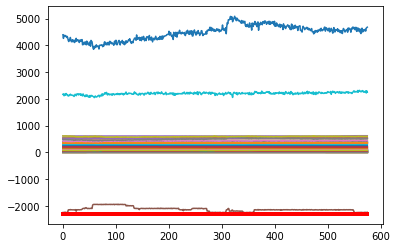

Predicción:  [[[0.99028945 0.00971058]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3261100e+01  1.2411200e+01  5.7349500e+01  7.7992700e+01
  6.2044590e+02  3.2154300e+01  9.5623000e+00  1.8644230e+02
  7.8300000e-02  7.3649600e+01  1.2471060e+02  9.9360000e+00
  6.7371400e+01  1.7817910e+02  2.1823600e+01  1.3057570e+02
  1.8790100e+02  6.9580100e+01 -6.8991000e+00  3.6973000e+00
  1.0678400e+01  7.5054000e+00  1.4999000e+00  7.2580900e+01
  1.4997000e+00  1.5726000e+00  8.2748300e+01  5.9950700e+01
  1.3576000e+00  1.2583000e+00  1.6921000e+00  1.4181000e+00
  1.6160440e+02  8.2850000e-01  8.2970000e-01 -2.2557757e+03
  2.0165280e+02  1.6551000e+00  1.4178000e+00  2.2723882e+03
  4.5562096e+03  1.8481450e+02  1.4484000e+00  1.4416000e+00
  7.8994000e+00  7.8008000e+00  1.7904000e+00  9.8300000e-02
  3.0638100e+01  5.3898010e+02  5.2400970e+02  5.2023570e+02
  5.2103350e+02  5.2073480e+02  3.1326000e+01  3.19

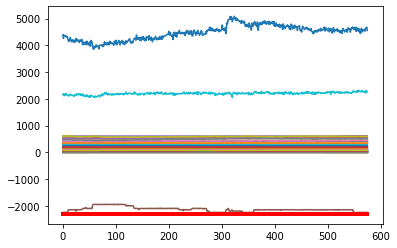

Predicción:  [[[0.9885212  0.01147879]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2705000e+01  1.2116100e+01  5.6177200e+01  7.8426000e+01
  6.1993480e+02  3.1417200e+01  9.4321000e+00  1.8567230e+02
  6.4200000e-02  7.4127200e+01  1.2517640e+02  9.8051000e+00
  6.6952800e+01  1.7712660e+02  2.1819200e+01  1.3061530e+02
  1.8658870e+02  6.9707200e+01 -6.8991000e+00  3.6803000e+00
  9.4254000e+00  7.4926000e+00  1.4986000e+00  7.2614800e+01
  1.4865000e+00  1.5623000e+00  8.2998200e+01  6.0827500e+01
  1.3463000e+00  1.2493000e+00  1.6831000e+00  1.4100000e+00
  1.5983100e+02  8.2710000e-01  8.2940000e-01 -2.2467150e+03
  2.0316450e+02  1.6459000e+00  1.4072000e+00  2.2091436e+03
  4.6527033e+03  1.8481450e+02  1.4381000e+00  1.4337000e+00
  7.8981000e+00  7.8013000e+00  1.7792000e+00  9.6000000e-02
  2.8137200e+01  5.3777110e+02  5.2404800e+02  5.2009680e+02
  5.2078150e+02  5.2054770e+02  3.2529000e+01  3.21

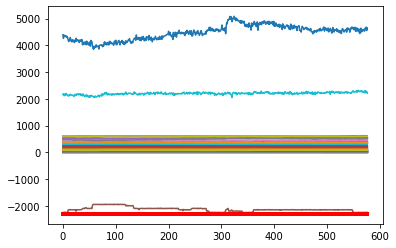

Predicción:  [[[0.9900205  0.00997954]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2933500e+01  1.2167500e+01  5.8531300e+01  7.7218400e+01
  6.1934500e+02  3.1379800e+01  9.4504000e+00  1.8505950e+02
  4.5400000e-02  7.4227100e+01  1.2393630e+02  1.0110000e+01
  6.6690100e+01  1.7581520e+02  2.1121100e+01  1.3110830e+02
  1.8602810e+02  6.9744500e+01 -6.8991000e+00  3.7070000e+00
  1.0540200e+01  7.5138000e+00  1.4999000e+00  7.2548000e+01
  1.4789000e+00  1.5511000e+00  8.3224500e+01  6.1071000e+01
  1.3337000e+00  1.2432000e+00  1.6740000e+00  1.4003000e+00
  1.5778770e+02  8.2530000e-01  8.2920000e-01 -2.2523330e+03
  2.0270230e+02  1.6334000e+00  1.3949000e+00  2.1885280e+03
  4.5446167e+03  1.8481450e+02  1.4306000e+00  1.4279000e+00
  7.8997000e+00  7.8004000e+00  1.7721000e+00  9.8200000e-02
  3.0425100e+01  5.3673330e+02  5.2283520e+02  5.1900930e+02
  5.1959080e+02  5.1940650e+02  3.2443200e+01  3.21

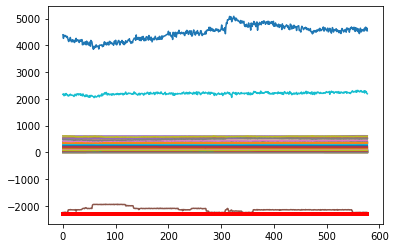

Predicción:  [[[0.98806316 0.01193686]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3106000e+01  1.2244400e+01  5.7800800e+01  7.6982700e+01
  6.1919620e+02  3.1793400e+01  9.4696000e+00  1.8442490e+02
  2.9800000e-02  7.4600400e+01  1.2355010e+02  1.0128500e+01
  6.7205300e+01  1.7708380e+02  2.1364000e+01  1.3171290e+02
  1.8559560e+02  6.9867700e+01 -6.8991000e+00  3.7159000e+00
  1.1540100e+01  7.5217000e+00  1.5003000e+00  7.2627100e+01
  1.4683000e+00  1.5395000e+00  8.2149800e+01  6.1643700e+01
  1.3237000e+00  1.2324000e+00  1.6612000e+00  1.3888000e+00
  1.5754750e+02  8.2500000e-01  8.3020000e-01 -2.2533585e+03
  2.0170610e+02  1.6214000e+00  1.3853000e+00  2.2754953e+03
  4.6145520e+03  1.8481450e+02  1.4189000e+00  1.4156000e+00
  7.9024000e+00  7.8021000e+00  1.7617000e+00  1.0040000e-01
  3.0197200e+01  5.3763340e+02  5.2292470e+02  5.1919070e+02
  5.1969470e+02  5.1962170e+02  3.2331100e+01  3.20

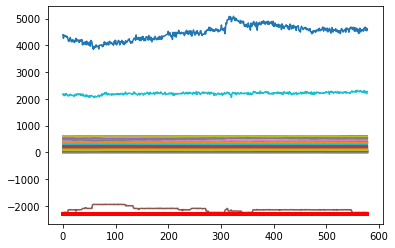

Predicción:  [[[0.9896373  0.01036271]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3260200e+01  1.2249600e+01  5.7854100e+01  7.6325600e+01
  6.1956510e+02  3.1617100e+01  9.4767000e+00  1.8376080e+02
  3.8300000e-02  7.5181000e+01  1.2308660e+02  9.8598000e+00
  6.7071100e+01  1.7681200e+02  2.1613800e+01  1.3114950e+02
  1.8515240e+02  6.9625000e+01 -6.8991000e+00  3.7095000e+00
  1.1933700e+01  7.4758000e+00  1.5008000e+00  7.2592300e+01
  1.4796000e+00  1.5528000e+00  8.3003700e+01  6.1299800e+01
  1.3289000e+00  1.2446000e+00  1.6734000e+00  1.4042000e+00
  1.5643330e+02  8.2460000e-01  8.3070000e-01 -2.2444117e+03
  2.0316300e+02  1.6357000e+00  1.3902000e+00  2.2645945e+03
  4.7318088e+03  1.8481450e+02  1.4342000e+00  1.4302000e+00
  7.9014000e+00  7.7986000e+00  1.7735000e+00  9.9800000e-02
  2.9568300e+01  5.3781110e+02  5.2299840e+02  5.1958560e+02
  5.2004280e+02  5.1999610e+02  3.2359300e+01  3.19

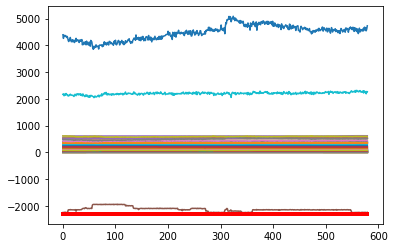

Predicción:  [[[0.9909321  0.00906783]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3201700e+01  1.2130900e+01  5.7676500e+01  7.7060800e+01
  6.1995480e+02  3.1484400e+01  9.5123000e+00  1.8307120e+02
  5.1700000e-02  7.5304700e+01  1.2237890e+02  9.9213000e+00
  6.6722000e+01  1.7574840e+02  2.1739200e+01  1.3077050e+02
  1.8428860e+02  6.9998600e+01 -6.8991000e+00  3.6900000e+00
  1.1204300e+01  7.5065000e+00  1.4992000e+00  7.2643400e+01
  1.4758000e+00  1.5476000e+00  8.2184500e+01  6.1726800e+01
  1.3282000e+00  1.2413000e+00  1.6683000e+00  1.3985000e+00
  1.5622740e+02  8.2590000e-01  8.3000000e-01 -2.2462502e+03
  2.0117050e+02  1.6292000e+00  1.3895000e+00  2.2335214e+03
  4.6746397e+03  1.8481450e+02  1.4288000e+00  1.4246000e+00
  7.8999000e+00  7.7994000e+00  1.7688000e+00  1.0030000e-01
  3.0226800e+01  5.3815330e+02  5.2331630e+02  5.1957920e+02
  5.2008990e+02  5.2003900e+02  3.2178800e+01  3.19

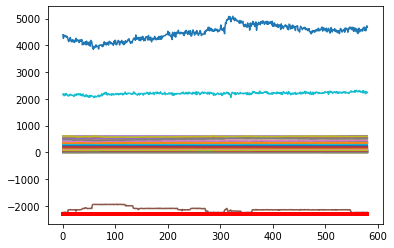

Predicción:  [[[0.9903081  0.00969189]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9562600e+01  1.0740400e+01  5.8757500e+01  7.7048100e+01
  6.2105180e+02  3.1431400e+01  9.3858000e+00  1.8240830e+02
  4.8500000e-02  7.5426800e+01  1.2085400e+02  1.0141200e+01
  6.6035900e+01  1.7584080e+02  2.2402400e+01  1.3016670e+02
  1.8194410e+02  6.9630500e+01 -6.8991000e+00  3.7138000e+00
  8.6302000e+00  7.4859000e+00  1.4991000e+00  7.2609400e+01
  1.4886000e+00  1.5614000e+00  8.1541900e+01  6.0655200e+01
  1.3440000e+00  1.2572000e+00  1.6838000e+00  1.4111000e+00
  1.5536460e+02  8.2830000e-01  8.3020000e-01 -2.2559275e+03
  2.0207070e+02  1.6426000e+00  1.4049000e+00  2.2643394e+03
  4.5784516e+03  1.8481450e+02  1.4371000e+00  1.4354000e+00
  7.8967000e+00  7.7974000e+00  1.7806000e+00  9.6900000e-02
  2.6309000e+01  5.4041560e+02  5.2471130e+02  5.2108880e+02
  5.2161670e+02  5.2141970e+02  3.2003500e+01  3.18

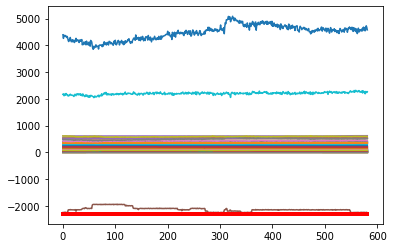

Predicción:  [[[0.9891186  0.01088146]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8913300e+01  1.0234900e+01  5.9503800e+01  7.6757000e+01
  6.2004680e+02  3.0627800e+01  9.3561000e+00  1.8207650e+02
  2.9700000e-02  7.5957900e+01  1.1901770e+02  9.9068000e+00
  6.5002500e+01  1.7424670e+02  2.2111300e+01  1.3054570e+02
  1.8060410e+02  6.9609500e+01 -6.8991000e+00  3.6982000e+00
  7.6964000e+00  7.5269000e+00  1.4993000e+00  7.2481600e+01
  1.4710000e+00  1.5442000e+00  8.1125800e+01  6.1882300e+01
  1.3214000e+00  1.2422000e+00  1.6709000e+00  1.3946000e+00
  1.5321460e+02  8.2810000e-01  8.2970000e-01 -2.2413542e+03
  2.0321340e+02  1.6258000e+00  1.3827000e+00  2.2559580e+03
  4.7775380e+03  1.8481450e+02  1.4197000e+00  1.4164000e+00
  7.9005000e+00  7.8024000e+00  1.7664000e+00  9.5300000e-02
  2.5435600e+01  5.3762220e+02  5.2392180e+02  5.1972180e+02
  5.2031640e+02  5.2003940e+02  3.2007600e+01  3.18

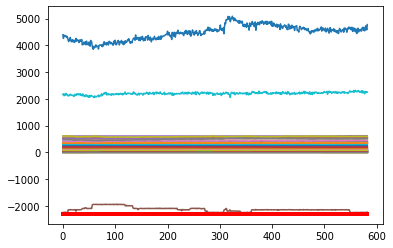

Predicción:  [[[0.9912747 0.0087253]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9055000e+01  1.0326900e+01  6.0067800e+01  7.6073400e+01
  6.2041150e+02  3.0677000e+01  9.3592000e+00  1.8122980e+02
  1.0900000e-02  7.7205300e+01  1.1823110e+02  1.0005700e+01
  6.4206800e+01  1.7454190e+02  2.1643100e+01  1.3180980e+02
  1.8024790e+02  6.9874600e+01 -6.8991000e+00  3.7077000e+00
  9.9975000e+00  7.5020000e+00  1.5010000e+00  7.2404800e+01
  1.4474000e+00  1.5156000e+00  8.0728900e+01  6.1923300e+01
  1.2966000e+00  1.2233000e+00  1.6460000e+00  1.3727000e+00
  1.4926210e+02  8.2780000e-01  8.3000000e-01 -2.2526631e+03
  2.0311580e+02  1.5966000e+00  1.3587000e+00  2.2027683e+03
  4.6014198e+03  1.8481450e+02  1.3984000e+00  1.3961000e+00
  7.8984000e+00  7.7993000e+00  1.7437000e+00  9.7400000e-02
  2.5595900e+01  5.3493550e+02  5.2215560e+02  5.1851090e+02
  5.1901340e+02  5.1879760e+02  3.1897600e+01  3.1873

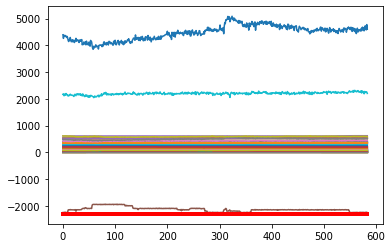

Predicción:  [[[0.98939717 0.01060285]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9530800e+01  1.0291400e+01  5.9412800e+01  7.5451000e+01
  6.2165780e+02  3.2622800e+01  9.3401000e+00  1.8053690e+02
  9.0000000e-04  7.6932800e+01  1.1917900e+02  9.9167000e+00
  6.2623900e+01  1.7619640e+02  2.1938800e+01  1.3194980e+02
  1.7999420e+02  6.9783200e+01 -6.8991000e+00  3.7144000e+00
  1.0447600e+01  7.4767000e+00  1.5004000e+00  7.2421400e+01
  1.4579000e+00  1.5265000e+00  8.2454900e+01  6.1795300e+01
  1.3055000e+00  1.2319000e+00  1.6512000e+00  1.3843000e+00
  1.5152170e+02  8.2750000e-01  8.3040000e-01 -2.2532093e+03
  2.0294630e+02  1.6091000e+00  1.3667000e+00  2.2240030e+03
  4.6805380e+03  1.8481450e+02  1.4130000e+00  1.4041000e+00
  7.9007000e+00  7.7998000e+00  1.7525000e+00  1.0140000e-01
  2.8515400e+01  5.3808890e+02  5.2309300e+02  5.1969720e+02
  5.2010920e+02  5.1994920e+02  3.1954900e+01  3.17

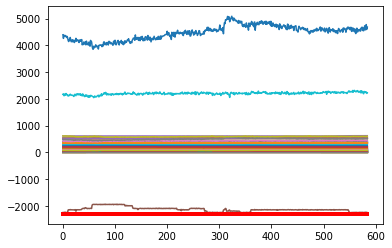

Predicción:  [[[0.99067515 0.00932483]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0186400e+01  1.0250300e+01  5.8058600e+01  7.5470800e+01
  6.2016390e+02  3.3066200e+01  9.3342000e+00  1.7997000e+02
  1.8000000e-03  7.6775100e+01  1.1961860e+02  1.0214700e+01
  6.1695500e+01  1.7591010e+02  2.2012800e+01  1.3189750e+02
  1.7920530e+02  6.9694300e+01 -6.8991000e+00  3.6902000e+00
  1.0121400e+01  7.4956000e+00  1.5002000e+00  7.2467400e+01
  1.4675000e+00  1.5335000e+00  8.2264900e+01  6.1722600e+01
  1.3149000e+00  1.2423000e+00  1.6616000e+00  1.3923000e+00
  1.5027850e+02  8.2830000e-01  8.3000000e-01 -2.2491605e+03
  2.0169720e+02  1.6150000e+00  1.3766000e+00  2.2211639e+03
  4.6336465e+03  1.8481450e+02  1.4190000e+00  1.4126000e+00
  7.9008000e+00  7.7989000e+00  1.7613000e+00  9.9900000e-02
  2.6680400e+01  5.3866890e+02  5.2360630e+02  5.1991930e+02
  5.2035340e+02  5.2021830e+02  3.1986700e+01  3.17

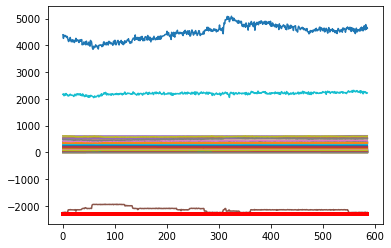

Predicción:  [[[0.98980415 0.01019582]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0753100e+01  9.8749000e+00  5.7335400e+01  7.6048200e+01
  6.1990130e+02  3.3280300e+01  9.3284000e+00  1.8005600e+02
  2.8000000e-03  7.5980400e+01  1.1992260e+02  9.9405000e+00
  5.9718200e+01  1.7558710e+02  2.2090600e+01  1.3342670e+02
  1.7865120e+02  6.9736900e+01 -6.8991000e+00  3.7028000e+00
  9.5584000e+00  7.5155000e+00  1.4996000e+00  7.2441700e+01
  1.4576000e+00  1.5253000e+00  8.1322200e+01  6.2010600e+01
  1.3084000e+00  1.2318000e+00  1.6540000e+00  1.3820000e+00
  1.5192550e+02  8.2800000e-01  8.2990000e-01 -2.2534098e+03
  2.0317880e+02  1.6069000e+00  1.3705000e+00  2.2152168e+03
  4.5755147e+03  1.8481450e+02  1.4088000e+00  1.4019000e+00
  7.8959000e+00  7.7975000e+00  1.7526000e+00  9.8300000e-02
  2.6920800e+01  5.3803550e+02  5.2377620e+02  5.1987760e+02
  5.2028020e+02  5.2003400e+02  3.1828500e+01  3.18

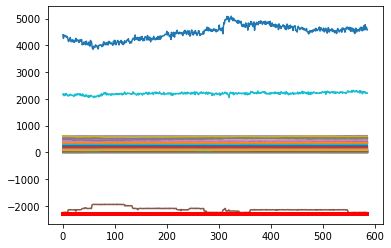

Predicción:  [[[0.9888249  0.01117515]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0474800e+01  1.0019900e+01  5.6720200e+01  7.5657300e+01
  6.1952850e+02  3.1671300e+01  9.3300000e+00  1.8001540e+02
  3.5000000e-03  7.5967900e+01  1.2012910e+02  9.9789000e+00
  5.9852300e+01  1.7361880e+02  2.1909900e+01  1.3372920e+02
  1.7858700e+02  6.9534800e+01 -6.8991000e+00  3.6977000e+00
  8.7470000e+00  7.4834000e+00  1.4987000e+00  7.2179200e+01
  1.4592000e+00  1.5283000e+00  8.2633700e+01  6.1423100e+01
  1.3088000e+00  1.2323000e+00  1.6591000e+00  1.3871000e+00
  1.5263810e+02  8.2800000e-01  8.2950000e-01 -2.2442438e+03
  2.0179270e+02  1.6105000e+00  1.3704000e+00  2.2667017e+03
  4.6827106e+03  1.8481450e+02  1.4129000e+00  1.4088000e+00
  7.8998000e+00  7.8003000e+00  1.7552000e+00  9.5900000e-02
  2.5948600e+01  5.3673560e+02  5.2320740e+02  5.1940490e+02
  5.1986200e+02  5.1968810e+02  3.1699800e+01  3.17

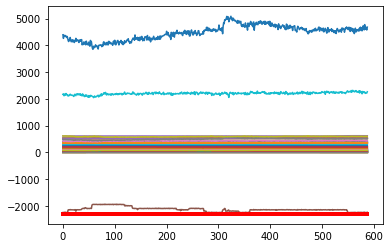

Predicción:  [[[0.99031806 0.00968194]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0577300e+01  1.0015600e+01  5.7427200e+01  7.5694500e+01
  6.2086560e+02  3.1526300e+01  9.3318000e+00  1.7989790e+02
  3.0000000e-03  7.6213000e+01  1.2008650e+02  9.9833000e+00
  6.0073700e+01  1.7352010e+02  2.1630400e+01  1.3461740e+02
  1.7869820e+02  6.9531500e+01 -6.8991000e+00  3.7017000e+00
  9.3768000e+00  7.5124000e+00  1.5005000e+00  7.2175500e+01
  1.4514000e+00  1.5167000e+00  8.0907300e+01  6.1627900e+01
  1.3017000e+00  1.2251000e+00  1.6532000e+00  1.3804000e+00
  1.5267430e+02  8.2810000e-01  8.2990000e-01 -2.2540675e+03
  2.0299420e+02  1.5982000e+00  1.3630000e+00  2.2599227e+03
  4.5516910e+03  1.8481450e+02  1.4073000e+00  1.4022000e+00
  7.8995000e+00  7.7992000e+00  1.7481000e+00  9.4900000e-02
  2.6438100e+01  5.3668000e+02  5.2265430e+02  5.1893180e+02
  5.1934620e+02  5.1918270e+02  3.1698400e+01  3.17

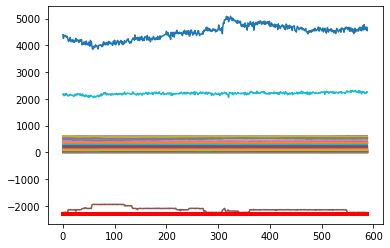

Predicción:  [[[0.98835784 0.01164218]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0808400e+01  1.0055300e+01  5.7352900e+01  7.6209600e+01
  6.2015090e+02  3.0869600e+01  9.3498000e+00  1.7990280e+02
  2.2000000e-03  7.6399700e+01  1.1991690e+02  1.0062600e+01
  5.9359900e+01  1.7302460e+02  2.1691100e+01  1.3475320e+02
  1.7895360e+02  6.9375500e+01 -6.8991000e+00  3.7015000e+00
  9.0028000e+00  7.5049000e+00  1.5009000e+00  7.1963700e+01
  1.4607000e+00  1.5266000e+00  8.1282600e+01  6.0839400e+01
  1.3073000e+00  1.2333000e+00  1.6626000e+00  1.3857000e+00
  1.5235640e+02  8.2840000e-01  8.3010000e-01 -2.2532325e+03
  2.0375310e+02  1.6077000e+00  1.3688000e+00  2.2596997e+03
  4.6186872e+03  1.8481450e+02  1.4117000e+00  1.4070000e+00
  7.8991000e+00  7.8031000e+00  1.7562000e+00  9.3500000e-02
  2.6146000e+01  5.3776890e+02  5.2262810e+02  5.1903820e+02
  5.1953900e+02  5.1944010e+02  3.1795100e+01  3.17

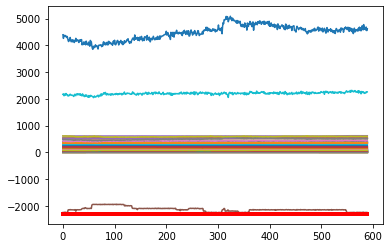

Predicción:  [[[0.9897453  0.01025475]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9939100e+01  1.0182300e+01  5.6447500e+01  7.6384400e+01
  6.1931060e+02  3.1295900e+01  9.3498000e+00  1.7998700e+02
  1.4000000e-03  7.6340100e+01  1.2012650e+02  1.0135500e+01
  5.9754100e+01  1.7379700e+02  2.2236300e+01  1.3370460e+02
  1.7913100e+02  6.9326700e+01 -6.8991000e+00  3.7060000e+00
  8.5785000e+00  7.5181000e+00  1.4997000e+00  7.2010500e+01
  1.4589000e+00  1.5253000e+00  8.0949000e+01  6.1920000e+01
  1.3071000e+00  1.2308000e+00  1.6569000e+00  1.3861000e+00
  1.5351760e+02  8.2830000e-01  8.2960000e-01 -2.2501097e+03
  2.0063990e+02  1.6056000e+00  1.3692000e+00  2.2656690e+03
  4.5914438e+03  1.8481450e+02  1.4120000e+00  1.4072000e+00
  7.9021000e+00  7.7926000e+00  1.7545000e+00  9.7600000e-02
  2.5757300e+01  5.3736670e+02  5.2338540e+02  5.1960850e+02
  5.2002700e+02  5.1997080e+02  3.1805100e+01  3.18

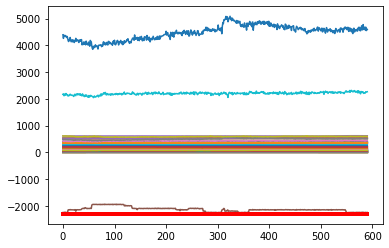

Predicción:  [[[0.9889227  0.01107727]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0026300e+01  1.0457700e+01  5.6545200e+01  7.6026100e+01
  6.1937580e+02  3.1540700e+01  9.4487000e+00  1.7987150e+02
  6.0000000e-04  7.6193000e+01  1.1995700e+02  9.9676000e+00
  5.9496600e+01  1.7362280e+02  2.2043800e+01  1.3133380e+02
  1.7934320e+02  6.9125500e+01 -6.8991000e+00  3.6995000e+00
  9.1504000e+00  7.4762000e+00  1.4992000e+00  7.1811700e+01
  1.4660000e+00  1.5323000e+00  8.2344700e+01  6.1469300e+01
  1.3138000e+00  1.2375000e+00  1.6647000e+00  1.3912000e+00
  1.5452370e+02  8.2840000e-01  8.2900000e-01 -2.2533526e+03
  1.9752960e+02  1.6142000e+00  1.3755000e+00  2.2632991e+03
  4.6507065e+03  1.8481450e+02  1.4156000e+00  1.4113000e+00
  7.9002000e+00  7.8079000e+00  1.7623000e+00  9.7500000e-02
  2.4692700e+01  5.3664890e+02  5.2288280e+02  5.1918750e+02
  5.1973500e+02  5.1967070e+02  3.2058100e+01  3.19

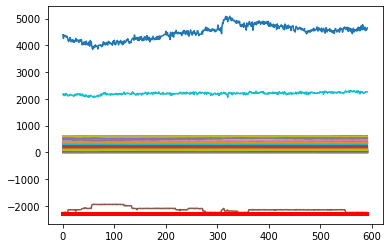

Predicción:  [[[0.99027646 0.00972356]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0320000e+01  1.0969000e+01  5.5833100e+01  7.6753200e+01
  6.1938570e+02  3.1692800e+01  9.4255000e+00  1.8005270e+02
  5.0000000e-04  7.6371500e+01  1.2010850e+02  9.8892000e+00
  6.0388800e+01  1.7425060e+02  2.1344600e+01  1.2799430e+02
  1.7993340e+02  6.8842500e+01 -6.8991000e+00  3.7021000e+00
  9.5436000e+00  7.5282000e+00  1.5020000e+00  7.1844100e+01
  1.4623000e+00  1.5294000e+00  8.2197600e+01  6.2083800e+01
  1.3092000e+00  1.2331000e+00  1.6603000e+00  1.3911000e+00
  1.5556940e+02  8.2820000e-01  8.3020000e-01 -2.2460848e+03
  1.9949180e+02  1.6111000e+00  1.3708000e+00  2.2718613e+03
  4.6089004e+03  1.8481450e+02  1.4163000e+00  1.4118000e+00
  7.9002000e+00  7.8011000e+00  1.7585000e+00  9.8100000e-02
  2.5103900e+01  5.3748220e+02  5.2272970e+02  5.1917540e+02
  5.1978380e+02  5.1984920e+02  3.1654200e+01  3.17

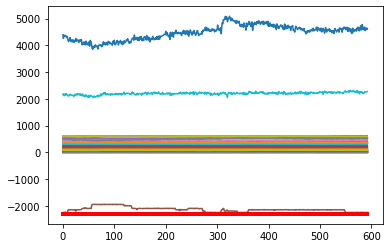

Predicción:  [[[0.9889952  0.01100479]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0377200e+01  1.0969100e+01  5.5318100e+01  7.6996200e+01
  6.1927660e+02  3.3996100e+01  9.3310000e+00  1.7993040e+02
  5.0000000e-04  7.5884500e+01  1.2011400e+02  9.8422000e+00
  6.0090300e+01  1.7654600e+02  2.1556000e+01  1.2700970e+02
  1.8003010e+02  6.9047700e+01 -6.8991000e+00  3.6968000e+00
  1.3087400e+01  7.5030000e+00  1.4992000e+00  7.1828600e+01
  1.4551000e+00  1.5217000e+00  8.1137300e+01  6.2064300e+01
  1.3061000e+00  1.2275000e+00  1.6477000e+00  1.3844000e+00
  1.5487300e+02  8.2840000e-01  8.3010000e-01 -2.2524372e+03
  2.0159810e+02  1.6031000e+00  1.3681000e+00  2.2901217e+03
  4.5583872e+03  1.8481450e+02  1.4112000e+00  1.4045000e+00
  7.9008000e+00  7.8015000e+00  1.7512000e+00  1.0370000e-01
  2.6542100e+01  5.3796890e+02  5.2287260e+02  5.1905440e+02
  5.1967910e+02  5.1969740e+02  3.2094700e+01  3.19

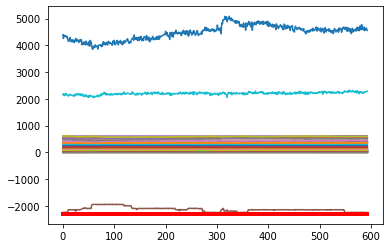

Predicción:  [[[0.9882653  0.01173479]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0671600e+01  1.0880600e+01  5.6070300e+01  7.5714000e+01
  6.2031660e+02  3.4493100e+01  9.3272000e+00  1.8004920e+02
  5.0000000e-04  7.5877900e+01  1.2026540e+02  1.0243100e+01
  5.9435600e+01  1.7642830e+02  2.1869100e+01  1.2500220e+02
  1.7979850e+02  6.8998600e+01 -6.8991000e+00  3.6974000e+00
  1.2634500e+01  7.4843000e+00  1.4991000e+00  7.1767900e+01
  1.4635000e+00  1.5303000e+00  8.0998000e+01  6.1962300e+01
  1.3098000e+00  1.2372000e+00  1.6558000e+00  1.3907000e+00
  1.5394330e+02  8.2860000e-01  8.3070000e-01 -2.2508188e+03
  1.9921670e+02  1.6125000e+00  1.3711000e+00  2.2166696e+03
  4.5861787e+03  1.8481450e+02  1.4174000e+00  1.4107000e+00
  7.9001000e+00  7.7998000e+00  1.7585000e+00  1.0230000e-01
  2.6692700e+01  5.3828000e+02  5.2314440e+02  5.1943530e+02
  5.2006930e+02  5.2016860e+02  3.2312500e+01  3.21

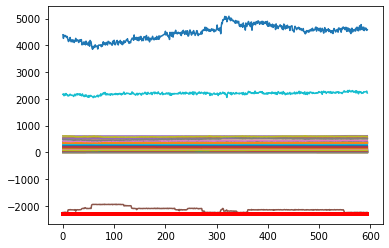

Predicción:  [[[0.9888291  0.01117093]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0757100e+01  1.0906100e+01  5.5622500e+01  7.6166600e+01
  6.2001890e+02  3.4637600e+01  9.3781000e+00  1.7999250e+02
  5.0000000e-04  7.5781900e+01  1.1969790e+02  1.0029600e+01
  6.0440800e+01  1.7634910e+02  2.1978800e+01  1.2295530e+02
  1.7984880e+02  6.8987100e+01 -6.8991000e+00  3.7152000e+00
  1.1924200e+01  7.5026000e+00  1.5005000e+00  7.1827600e+01
  1.4627000e+00  1.5299000e+00  8.1372000e+01  6.1464500e+01
  1.3094000e+00  1.2349000e+00  1.6536000e+00  1.3883000e+00
  1.5548520e+02  8.2820000e-01  8.2970000e-01 -2.2466262e+03
  2.0140860e+02  1.6114000e+00  1.3709000e+00  2.2456519e+03
  4.5804432e+03  1.8481450e+02  1.4143000e+00  1.4082000e+00
  7.9021000e+00  7.8009000e+00  1.7579000e+00  1.0420000e-01
  2.6292500e+01  5.3767110e+02  5.2300750e+02  5.1938950e+02
  5.1997910e+02  5.2002230e+02  3.2457000e+01  3.23

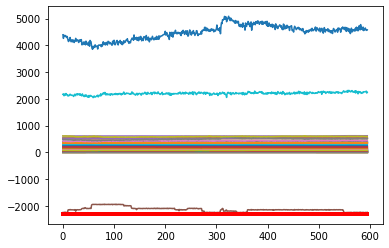

Predicción:  [[[0.98840374 0.01159634]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0621700e+01  1.1008400e+01  5.6848500e+01  7.5286300e+01
  6.2003230e+02  3.2796800e+01  9.3667000e+00  1.7993780e+02
  5.0000000e-04  7.5960500e+01  1.2026600e+02  9.9427000e+00
  6.1110800e+01  1.7410230e+02  2.2015000e+01  1.2233220e+02
  1.7988140e+02  6.8670100e+01 -6.8991000e+00  3.7061000e+00
  1.1909700e+01  7.5142000e+00  1.5012000e+00  7.1790300e+01
  1.4602000e+00  1.5276000e+00  8.1348400e+01  6.1070400e+01
  1.3088000e+00  1.2323000e+00  1.6542000e+00  1.3894000e+00
  1.5636070e+02  8.2900000e-01  8.3000000e-01 -2.2551644e+03
  1.9910650e+02  1.6089000e+00  1.3697000e+00  2.2683391e+03
  4.5608594e+03  1.8481450e+02  1.4149000e+00  1.4094000e+00
  7.8962000e+00  7.7994000e+00  1.7564000e+00  1.0210000e-01
  2.5481500e+01  5.3759560e+02  5.2274910e+02  5.1896790e+02
  5.1947790e+02  5.1953030e+02  3.2569000e+01  3.26

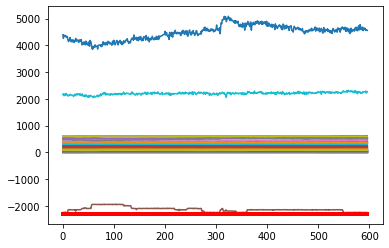

Predicción:  [[[0.98849094 0.01150908]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0253400e+01  1.1074300e+01  5.5692900e+01  7.4001700e+01
  6.2037840e+02  3.3010400e+01  9.3406000e+00  1.8003680e+02
  5.0000000e-04  7.6616800e+01  1.2006340e+02  9.9849000e+00
  6.3060000e+01  1.7400680e+02  2.1339900e+01  1.2106370e+02
  1.7998470e+02  6.8952800e+01 -6.8991000e+00  3.6931000e+00
  1.0461700e+01  7.5068000e+00  1.5005000e+00  7.1809600e+01
  1.4594000e+00  1.5278000e+00  8.1265600e+01  6.0672300e+01
  1.3090000e+00  1.2293000e+00  1.6580000e+00  1.3883000e+00
  1.5875650e+02  8.2590000e-01  8.3060000e-01 -2.2479942e+03
  1.9960040e+02  1.6088000e+00  1.3698000e+00  2.2087194e+03
  4.6322789e+03  1.8481450e+02  1.4179000e+00  1.4090000e+00
  7.9037000e+00  7.7938000e+00  1.7553000e+00  9.7300000e-02
  2.9249600e+01  5.3825100e+02  5.2307500e+02  5.1935910e+02
  5.1985440e+02  5.1979570e+02  3.3405800e+01  3.28

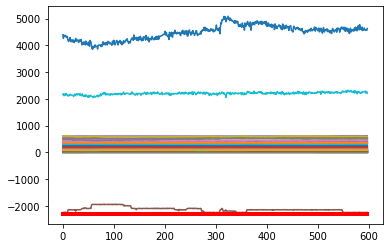

Predicción:  [[[0.98961616 0.0103838 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0042500e+01  1.1634500e+01  5.5074400e+01  7.3074400e+01
  6.2071950e+02  3.3260300e+01  9.3074000e+00  1.8005980e+02
  5.0000000e-04  7.5956400e+01  1.2007710e+02  9.9566000e+00
  6.3943900e+01  1.7395030e+02  2.0624400e+01  1.1930180e+02
  1.8056690e+02  6.8958800e+01 -6.8991000e+00  3.7135000e+00
  9.4901000e+00  7.4939000e+00  1.5000000e+00  7.1768000e+01
  1.4592000e+00  1.5262000e+00  8.2160000e+01  6.0347200e+01
  1.3067000e+00  1.2258000e+00  1.6551000e+00  1.3876000e+00
  1.6182720e+02  8.2460000e-01  8.3040000e-01 -2.2495272e+03
  1.9927400e+02  1.6079000e+00  1.3676000e+00  2.2613327e+03
  4.5420912e+03  1.8481450e+02  1.4183000e+00  1.4102000e+00
  7.8988000e+00  7.8036000e+00  1.7543000e+00  9.9100000e-02
  3.0905800e+01  5.3790000e+02  5.2317790e+02  5.1971420e+02
  5.2000470e+02  5.2009660e+02  3.2585100e+01  3.26

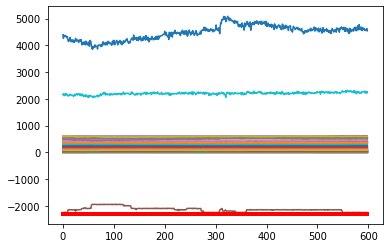

Predicción:  [[[0.98766136 0.0123386 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0057100e+01  1.2247500e+01  5.5525500e+01  7.4133000e+01
  6.2011430e+02  3.3221000e+01  9.3868000e+00  1.7990990e+02
  1.9000000e-03  7.5538900e+01  1.2009030e+02  9.7155000e+00
  6.4220000e+01  1.7345880e+02  2.0812000e+01  1.2020650e+02
  1.8084900e+02  6.9292900e+01 -6.8991000e+00  3.6939000e+00
  7.9929000e+00  7.5385000e+00  1.5002000e+00  7.1818900e+01
  1.4586000e+00  1.5243000e+00  8.2993000e+01  5.8180600e+01
  1.3093000e+00  1.2240000e+00  1.6529000e+00  1.3822000e+00
  1.6128100e+02  8.2260000e-01  8.2910000e-01 -2.2521052e+03
  2.0161740e+02  1.6072000e+00  1.3677000e+00  2.2287446e+03
  4.5970243e+03  1.8481450e+02  1.4135000e+00  1.4047000e+00
  7.9023000e+00  7.8037000e+00  1.7566000e+00  1.0370000e-01
  3.1343200e+01  5.3728670e+02  5.2321770e+02  5.1898090e+02
  5.1920740e+02  5.1955820e+02  3.1739900e+01  3.17

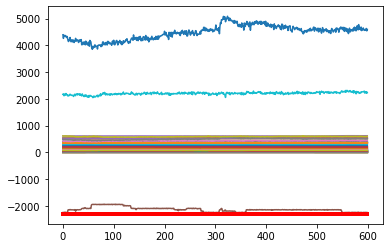

Predicción:  [[[0.9891957  0.01080431]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9967100e+01  1.2114800e+01  5.5682300e+01  7.5102900e+01
  6.2074690e+02  3.4652300e+01  9.4031000e+00  1.8014850e+02
  1.6300000e-02  7.5112100e+01  1.2030380e+02  9.8234000e+00
  6.3384400e+01  1.7523120e+02  2.0898500e+01  1.2092920e+02
  1.8094020e+02  6.9146100e+01 -6.8991000e+00  3.7042000e+00
  8.6513000e+00  7.4683000e+00  1.4995000e+00  7.1816700e+01
  1.4629000e+00  1.5289000e+00  8.3117100e+01  5.8692200e+01
  1.3136000e+00  1.2268000e+00  1.6605000e+00  1.3861000e+00
  1.6027790e+02  8.2260000e-01  8.3030000e-01 -2.2475384e+03
  2.0184760e+02  1.6113000e+00  1.3727000e+00  2.2072829e+03
  4.5163658e+03  1.8481450e+02  1.4144000e+00  1.4083000e+00
  7.8995000e+00  7.7999000e+00  1.7610000e+00  1.0060000e-01
  2.8650800e+01  5.3783330e+02  5.2339500e+02  5.1956510e+02
  5.1994760e+02  5.2031190e+02  3.1550800e+01  3.17

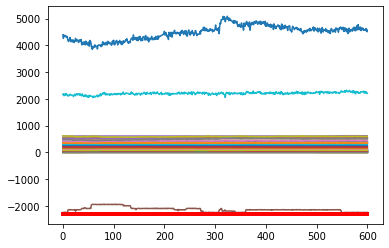

Predicción:  [[[0.98690367 0.01309634]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9586900e+01  1.2061600e+01  5.5719400e+01  7.5880500e+01
  6.2006330e+02  3.4429800e+01  9.3610000e+00  1.7998860e+02
  5.5800000e-02  7.4885300e+01  1.1995600e+02  9.9136000e+00
  6.4062100e+01  1.7646080e+02  2.0896100e+01  1.2330020e+02
  1.8085640e+02  6.8990600e+01 -6.8991000e+00  3.6932000e+00
  1.0016400e+01  7.5092000e+00  1.5000000e+00  7.1800800e+01
  1.4543000e+00  1.5218000e+00  8.3304200e+01  5.9631000e+01
  1.3061000e+00  1.2200000e+00  1.6471000e+00  1.3771000e+00
  1.5837460e+02  8.2470000e-01  8.2940000e-01 -2.2524974e+03
  2.0265390e+02  1.6052000e+00  1.3655000e+00  2.2081308e+03
  4.6477543e+03  1.8481450e+02  1.4045000e+00  1.3978000e+00
  7.8982000e+00  7.8005000e+00  1.7511000e+00  1.0390000e-01
  2.7419300e+01  5.3600000e+02  5.2325510e+02  5.1910360e+02
  5.1959400e+02  5.1986320e+02  3.1304300e+01  3.15

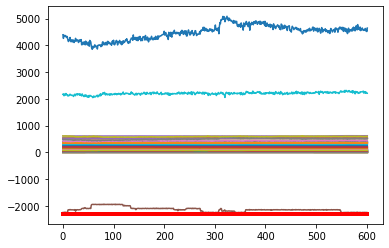

Predicción:  [[[0.99020725 0.00979276]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0406300e+01  1.1859000e+01  5.8172300e+01  7.5869400e+01
  6.2020380e+02  3.3044700e+01  9.4310000e+00  1.8010430e+02
  9.4200000e-02  7.5118800e+01  1.1992030e+02  1.0156400e+01
  6.3487300e+01  1.7485740e+02  2.0748600e+01  1.2615060e+02
  1.8071100e+02  6.9144100e+01 -6.8991000e+00  3.6977000e+00
  9.1497000e+00  7.4969000e+00  1.5000000e+00  7.1840300e+01
  1.4552000e+00  1.5224000e+00  8.3623300e+01  5.8082000e+01
  1.3078000e+00  1.2208000e+00  1.6521000e+00  1.3779000e+00
  1.5783630e+02  8.2320000e-01  8.2960000e-01 -2.2488607e+03
  2.0037470e+02  1.6059000e+00  1.3654000e+00  2.2379626e+03
  4.6290153e+03  1.8481450e+02  1.4081000e+00  1.4029000e+00
  7.8995000e+00  7.7993000e+00  1.7540000e+00  1.0170000e-01
  2.9821700e+01  5.3626670e+02  5.2350190e+02  5.1955640e+02
  5.1991940e+02  5.2030720e+02  3.0859900e+01  3.13

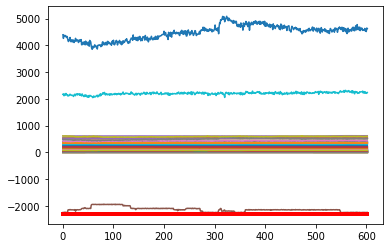

Predicción:  [[[0.9896404  0.01035956]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0313600e+01  1.2218200e+01  5.7700400e+01  7.6365400e+01
  6.2075760e+02  3.2007400e+01  9.4423000e+00  1.8001030e+02
  1.6710000e-01  7.4957600e+01  1.1991110e+02  1.0051400e+01
  6.3341100e+01  1.7483300e+02  2.0040200e+01  1.2999240e+02
  1.8133530e+02  6.9134600e+01 -6.8991000e+00  3.7081000e+00
  9.7339000e+00  7.5117000e+00  1.5008000e+00  7.1769500e+01
  1.4518000e+00  1.5180000e+00  8.0835700e+01  5.9038000e+01
  1.3025000e+00  1.2173000e+00  1.6478000e+00  1.3726000e+00
  1.5621360e+02  8.2520000e-01  8.2970000e-01 -2.2497241e+03
  2.0004050e+02  1.5994000e+00  1.3615000e+00  2.2303755e+03
  4.6204986e+03  1.8481450e+02  1.4035000e+00  1.3963000e+00
  7.8985000e+00  7.7994000e+00  1.7508000e+00  1.0260000e-01
  3.0865100e+01  5.3456670e+02  5.2295510e+02  5.1907770e+02
  5.1933770e+02  5.1971500e+02  3.0478500e+01  3.10

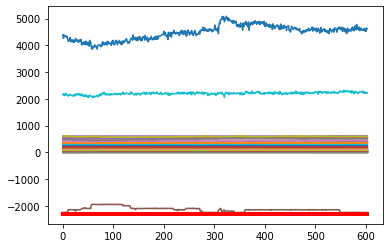

Predicción:  [[[0.9895219  0.01047811]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8922600e+01  1.2243200e+01  5.7849700e+01  7.6294400e+01
  6.1955770e+02  3.0591100e+01  9.4418000e+00  1.7999000e+02
  2.2110000e-01  7.4950000e+01  1.1976840e+02  1.0188000e+01
  6.4030900e+01  1.7451610e+02  2.0133500e+01  1.3205180e+02
  1.8173660e+02  6.9065400e+01 -6.8991000e+00  3.6837000e+00
  1.0935700e+01  7.4911000e+00  1.4994000e+00  7.1810000e+01
  1.4499000e+00  1.5183000e+00  8.0751000e+01  5.8772200e+01
  1.3003000e+00  1.2140000e+00  1.6431000e+00  1.3706000e+00
  1.5585460e+02  8.2630000e-01  8.2990000e-01 -2.2501015e+03
  2.0192080e+02  1.6000000e+00  1.3588000e+00  2.2338677e+03
  4.6914126e+03  1.8481450e+02  1.4019000e+00  1.3896000e+00
  7.8998000e+00  7.8001000e+00  1.7484000e+00  1.0530000e-01
  3.1383700e+01  5.3509170e+02  5.2260250e+02  5.1891980e+02
  5.1906500e+02  5.1952620e+02  3.0913900e+01  3.10

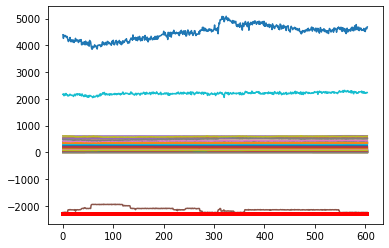

Predicción:  [[[0.99067605 0.0093239 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8591000e+01  1.2361300e+01  5.7441600e+01  7.6500300e+01
  6.1945270e+02  3.0771500e+01  9.4222000e+00  1.7988340e+02
  1.8830000e-01  7.5080900e+01  1.2012870e+02  1.0184000e+01
  6.3032900e+01  1.7401810e+02  2.0270300e+01  1.3212570e+02
  1.8191080e+02  6.9023600e+01 -6.8991000e+00  3.7153000e+00
  1.0312500e+01  7.4951000e+00  1.5003000e+00  7.1774300e+01
  1.4505000e+00  1.5170000e+00  8.2103700e+01  5.7916900e+01
  1.3025000e+00  1.2141000e+00  1.6440000e+00  1.3700000e+00
  1.5706830e+02  8.2680000e-01  8.3030000e-01 -2.2524041e+03
  1.9880560e+02  1.5992000e+00  1.3604000e+00  2.2332441e+03
  4.5858864e+03  1.8481450e+02  1.4008000e+00  1.3876000e+00
  7.9003000e+00  7.8008000e+00  1.7468000e+00  1.0280000e-01
  3.0972500e+01  5.3600000e+02  5.2346370e+02  5.1973230e+02
  5.1985680e+02  5.2035580e+02  3.0613200e+01  3.10

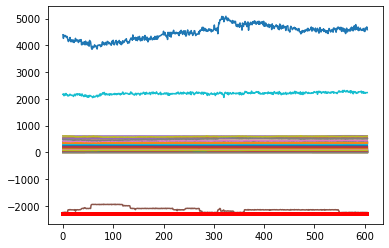

Predicción:  [[[0.98899764 0.0110023 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9633600e+01  1.2619500e+01  5.7906700e+01  7.5072500e+01
  6.1968750e+02  3.1336900e+01  9.5379000e+00  1.7997180e+02
  1.2250000e-01  7.4826800e+01  1.1991940e+02  9.8471000e+00
  6.3684400e+01  1.7598170e+02  2.0373500e+01  1.3407690e+02
  1.8233700e+02  6.8944100e+01 -6.8991000e+00  3.7121000e+00
  1.1513900e+01  7.5021000e+00  1.5005000e+00  7.1817600e+01
  1.4407000e+00  1.5059000e+00  8.4638800e+01  5.7657100e+01
  1.2936000e+00  1.2036000e+00  1.6315000e+00  1.3599000e+00
  1.5659630e+02  8.2830000e-01  8.3040000e-01 -2.2538137e+03
  2.0033570e+02  1.5902000e+00  1.3512000e+00  2.2422574e+03
  4.5487104e+03  1.8481450e+02  1.3920000e+00  1.3767000e+00
  7.8995000e+00  7.7983000e+00  1.7340000e+00  1.0250000e-01
  3.2091200e+01  5.3611550e+02  5.2313800e+02  5.1936380e+02
  5.1946580e+02  5.2000900e+02  3.0700500e+01  3.09

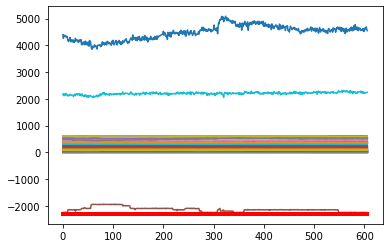

Predicción:  [[[0.98825336 0.01174664]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9694900e+01  1.2905000e+01  5.6869900e+01  7.4665500e+01
  6.1939340e+02  3.1786400e+01  9.6657000e+00  1.7997530e+02
  1.3460000e-01  7.4661800e+01  1.1998660e+02  9.9671000e+00
  6.3965300e+01  1.7646910e+02  2.0431700e+01  1.3734860e+02
  1.8265780e+02  6.9313600e+01 -6.8991000e+00  3.6963000e+00
  1.0898100e+01  7.4971000e+00  1.5005000e+00  7.1827800e+01
  1.4443000e+00  1.5128000e+00  8.4171000e+01  5.9122100e+01
  1.2933000e+00  1.2085000e+00  1.6343000e+00  1.3651000e+00
  1.5555230e+02  8.2830000e-01  8.2950000e-01 -2.2409133e+03
  2.0130150e+02  1.5967000e+00  1.3525000e+00  2.2298954e+03
  4.7112592e+03  1.8481450e+02  1.3972000e+00  1.3826000e+00
  7.9019000e+00  7.7994000e+00  1.7382000e+00  1.0400000e-01
  3.1984800e+01  5.3630000e+02  5.2354510e+02  5.1956960e+02
  5.1980230e+02  5.2022320e+02  3.0736900e+01  3.07

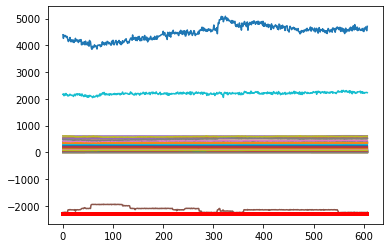

Predicción:  [[[0.99059474 0.00940525]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9199700e+01  1.3013700e+01  5.6750900e+01  7.6162600e+01
  6.1942270e+02  3.0939900e+01  9.5873000e+00  1.8003600e+02
  1.8220000e-01  7.4790400e+01  1.2006370e+02  1.0351100e+01
  6.3884100e+01  1.7575180e+02  2.0883300e+01  1.3607910e+02
  1.8257350e+02  6.9150600e+01 -6.8991000e+00  3.7117000e+00
  1.1960600e+01  7.4986000e+00  1.4997000e+00  7.1757300e+01
  1.4487000e+00  1.5208000e+00  8.3742600e+01  5.9485200e+01
  1.2958000e+00  1.2138000e+00  1.6433000e+00  1.3727000e+00
  1.5487310e+02  8.2840000e-01  8.2980000e-01 -2.2445902e+03
  1.9800480e+02  1.6051000e+00  1.3554000e+00  2.2132782e+03
  4.7367146e+03  1.8481450e+02  1.4024000e+00  1.3926000e+00
  7.8957000e+00  7.8017000e+00  1.7455000e+00  1.0210000e-01
  2.9659400e+01  5.3541780e+02  5.2265630e+02  5.1922440e+02
  5.1957800e+02  5.1984830e+02  3.0727500e+01  3.11

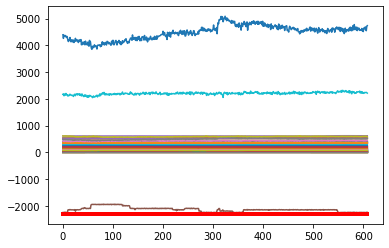

Predicción:  [[[0.99099475 0.00900525]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9135600e+01  1.2841300e+01  5.5868600e+01  7.6239500e+01
  6.1919690e+02  3.0527300e+01  9.5331000e+00  1.8008340e+02
  1.4300000e-01  7.4818200e+01  1.2012900e+02  1.0018500e+01
  6.3638600e+01  1.7408720e+02  2.1216000e+01  1.3163420e+02
  1.8215370e+02  6.9255300e+01 -6.8991000e+00  3.6930000e+00
  1.0090100e+01  7.5034000e+00  1.4987000e+00  7.1794900e+01
  1.4375000e+00  1.5056000e+00  8.3312100e+01  5.9815000e+01
  1.2844000e+00  1.2037000e+00  1.6319000e+00  1.3611000e+00
  1.5647590e+02  8.2830000e-01  8.3000000e-01 -2.2489811e+03
  2.0001600e+02  1.5885000e+00  1.3443000e+00  2.2636806e+03
  4.5896804e+03  1.8481450e+02  1.3874000e+00  1.3825000e+00
  7.9030000e+00  7.7987000e+00  1.7333000e+00  1.0130000e-01
  2.6393300e+01  5.3554890e+02  5.2271930e+02  5.1889520e+02
  5.1944710e+02  5.1960060e+02  3.1140500e+01  3.12

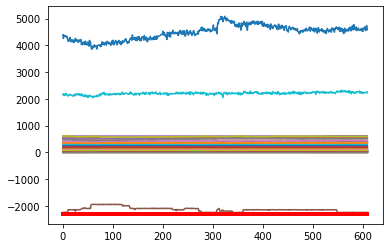

Predicción:  [[[0.9888601  0.01113986]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9244800e+01  1.2612600e+01  5.7586500e+01  7.4000000e+01
  6.2001440e+02  3.0099100e+01  9.5227000e+00  1.8012760e+02
  8.4800000e-02  7.4753600e+01  1.1996580e+02  1.0187900e+01
  6.3927300e+01  1.7328400e+02  2.1017300e+01  1.2778020e+02
  1.8187210e+02  6.9277900e+01 -6.8991000e+00  3.6937000e+00
  1.0813800e+01  7.5079000e+00  1.5007000e+00  7.1828000e+01
  1.4355000e+00  1.5025000e+00  8.2502900e+01  6.0018500e+01
  1.2853000e+00  1.2016000e+00  1.6316000e+00  1.3586000e+00
  1.5597200e+02  8.2770000e-01  8.2930000e-01 -2.2453016e+03
  2.0347440e+02  1.5843000e+00  1.3451000e+00  2.2474602e+03
  4.5964364e+03  1.8481450e+02  1.3845000e+00  1.3834000e+00
  7.8975000e+00  7.7981000e+00  1.7325000e+00  1.0120000e-01
  2.5945000e+01  5.3430660e+02  5.2197610e+02  5.1768380e+02
  5.1846140e+02  5.1857480e+02  3.1584900e+01  3.14

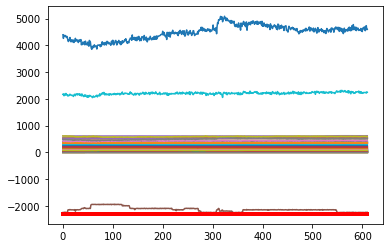

Predicción:  [[[0.98875076 0.01124929]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5808900e+01  1.2233100e+01  5.6981600e+01  7.4067800e+01
  6.2006090e+02  3.0387600e+01  9.5469000e+00  1.7988900e+02
  4.9400000e-02  7.4681400e+01  1.1995770e+02  1.0031100e+01
  6.3471800e+01  1.7322230e+02  2.1064600e+01  1.2690140e+02
  1.8192940e+02  6.9185100e+01 -6.8991000e+00  3.7019000e+00
  1.2884000e+01  7.4949000e+00  1.5009000e+00  7.1765700e+01
  1.4407000e+00  1.5064000e+00  8.3196000e+01  6.0596800e+01
  1.2882000e+00  1.2068000e+00  1.6329000e+00  1.3600000e+00
  1.5407980e+02  8.2820000e-01  8.3040000e-01 -2.2552680e+03
  2.0051380e+02  1.5882000e+00  1.3489000e+00  2.2511138e+03
  4.6037453e+03  1.8481450e+02  1.3857000e+00  1.3845000e+00
  7.8959000e+00  7.7981000e+00  1.7375000e+00  1.0450000e-01
  2.5828900e+01  5.3396230e+02  5.2115560e+02  5.1750460e+02
  5.1826420e+02  5.1847670e+02  3.1457800e+01  3.14

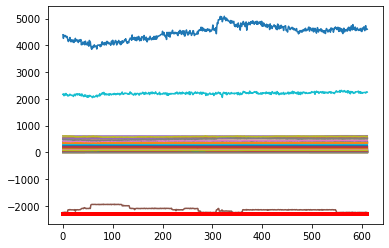

Predicción:  [[[0.9895941  0.01040592]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1783200e+01  1.2146200e+01  5.6966600e+01  7.4317300e+01
  6.1993810e+02  2.9881500e+01  9.6095000e+00  1.7999290e+02
  1.9600000e-02  7.4329400e+01  1.1996930e+02  9.8516000e+00
  6.4526000e+01  1.7320990e+02  2.1434600e+01  1.2795360e+02
  1.8165980e+02  6.8783200e+01 -6.8991000e+00  3.6987000e+00
  1.8374800e+01  7.4984000e+00  1.5015000e+00  7.1834600e+01
  1.4640000e+00  1.5324000e+00  8.2982000e+01  5.8934100e+01
  1.3182000e+00  1.2154000e+00  1.6494000e+00  1.3708000e+00
  1.5640500e+02  8.2730000e-01  8.2990000e-01 -2.2523206e+03
  1.9904010e+02  1.6139000e+00  1.3775000e+00  2.2848558e+03
  4.5924748e+03  1.8481450e+02  1.3959000e+00  1.3969000e+00
  7.9034000e+00  7.8009000e+00  1.7596000e+00  1.1000000e-01
  2.5371700e+01  5.3711550e+02  5.2380920e+02  5.1947640e+02
  5.2012330e+02  5.2040830e+02  3.1213400e+01  3.14

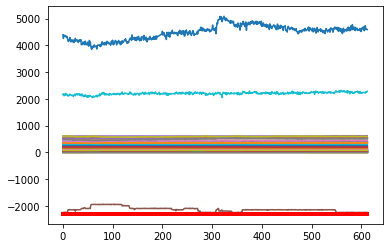

Predicción:  [[[0.9890155  0.01098449]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3850400e+01  1.2522400e+01  5.7978500e+01  7.3710000e+01
  6.1994240e+02  3.0000900e+01  9.5320000e+00  1.8012420e+02
  1.4800000e-02  7.4439500e+01  1.1980400e+02  1.0077400e+01
  6.4894700e+01  1.7320710e+02  2.1194200e+01  1.2886090e+02
  1.8160880e+02  6.9230100e+01 -6.8991000e+00  3.6878000e+00
  1.4406700e+01  7.5123000e+00  1.5002000e+00  7.1774800e+01
  1.4469000e+00  1.5128000e+00  8.2588400e+01  5.9949800e+01
  1.2923000e+00  1.2135000e+00  1.6317000e+00  1.3719000e+00
  1.5742250e+02  8.2530000e-01  8.3050000e-01 -2.2454162e+03
  2.0237530e+02  1.5963000e+00  1.3523000e+00  2.2623714e+03
  4.7008167e+03  1.8481450e+02  1.3981000e+00  1.3999000e+00
  7.8981000e+00  7.7979000e+00  1.7386000e+00  1.0670000e-01
  2.5802900e+01  5.3641340e+02  5.2308410e+02  5.1887870e+02
  5.1943170e+02  5.1970810e+02  3.1204600e+01  3.12

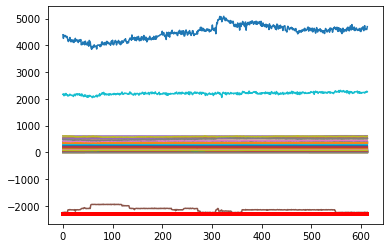

Predicción:  [[[0.990617   0.00938307]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3503400e+01  1.2556700e+01  5.6064700e+01  7.4430400e+01
  6.1997950e+02  3.0154400e+01  9.5530000e+00  1.7998230e+02
  1.3800000e-02  7.5106400e+01  1.1998330e+02  1.0052800e+01
  6.5750000e+01  1.6921040e+02  2.0736400e+01  1.3012930e+02
  1.8176570e+02  6.9411200e+01 -6.8991000e+00  3.6999000e+00
  7.4711000e+00  7.4876000e+00  1.5016000e+00  7.1798300e+01
  1.4386000e+00  1.5032000e+00  8.3467000e+01  5.9980500e+01
  1.2836000e+00  1.2056000e+00  1.6373000e+00  1.3657000e+00
  1.5729330e+02  8.2320000e-01  8.2940000e-01 -2.2419418e+03
  2.0191990e+02  1.5861000e+00  1.3438000e+00  2.2886603e+03
  4.6808319e+03  1.8481450e+02  1.3929000e+00  1.3953000e+00
  7.9001000e+00  7.7983000e+00  1.7329000e+00  9.5800000e-02
  2.6940700e+01  5.3602000e+02  5.2225390e+02  5.1817790e+02
  5.1876590e+02  5.1903260e+02  3.0629300e+01  3.10

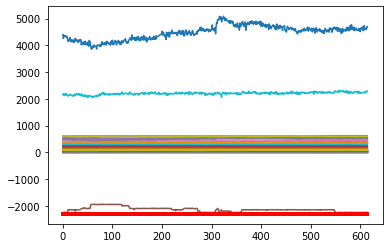

Predicción:  [[[0.9902159  0.00978405]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4569300e+01  1.2514500e+01  5.6021200e+01  7.4929800e+01
  6.1922860e+02  2.9510000e+01  9.5586000e+00  1.8006550e+02
  1.2900000e-02  7.4914100e+01  1.1996520e+02  9.9020000e+00
  6.4109000e+01  1.7072510e+02  2.0885000e+01  1.3128350e+02
  1.8176480e+02  6.9224800e+01 -6.8991000e+00  3.6908000e+00
  8.9926000e+00  7.4909000e+00  1.5018000e+00  7.1757100e+01
  1.4446000e+00  1.5092000e+00  8.3025700e+01  5.9668300e+01
  1.2919000e+00  1.2088000e+00  1.6440000e+00  1.3642000e+00
  1.5791380e+02  8.2330000e-01  8.3030000e-01 -2.2588415e+03
  1.9966930e+02  1.5927000e+00  1.3517000e+00  2.2965492e+03
  4.6465171e+03  1.8481450e+02  1.3921000e+00  1.3938000e+00
  7.8991000e+00  7.8034000e+00  1.7427000e+00  9.8800000e-02
  2.7937700e+01  5.3534890e+02  5.2256370e+02  5.1851300e+02
  5.1908780e+02  5.1932070e+02  3.0657400e+01  3.08

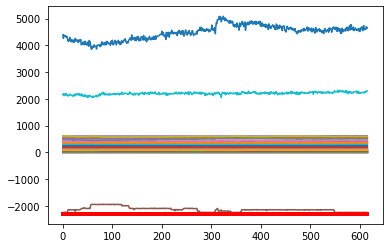

Predicción:  [[[0.99046725 0.00953277]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0802200e+01  1.2561300e+01  5.7622200e+01  7.5308700e+01
  6.1977120e+02  2.9992600e+01  9.4691000e+00  1.7997630e+02
  1.8500000e-02  7.4802000e+01  1.2011700e+02  9.9419000e+00
  6.5153900e+01  1.7232740e+02  2.0569200e+01  1.3169750e+02
  1.8185370e+02  6.9135000e+01 -6.8991000e+00  3.7071000e+00
  9.8835000e+00  7.5053000e+00  1.5009000e+00  7.1794500e+01
  1.4352000e+00  1.4999000e+00  8.1902600e+01  6.0090700e+01
  1.2823000e+00  1.2017000e+00  1.6330000e+00  1.3581000e+00
  1.5593380e+02  8.2420000e-01  8.3020000e-01 -2.2462146e+03
  2.0249670e+02  1.5820000e+00  1.3428000e+00  2.2199250e+03
  4.5912908e+03  1.8481450e+02  1.3886000e+00  1.3837000e+00
  7.8967000e+00  7.7963000e+00  1.7324000e+00  9.9300000e-02
  3.0296300e+01  5.3478440e+02  5.2243560e+02  5.1835920e+02
  5.1887550e+02  5.1911730e+02  3.0143100e+01  3.06

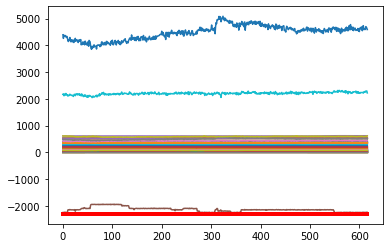

Predicción:  [[[0.98866045 0.01133958]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0702800e+01  1.2652200e+01  5.5591900e+01  7.5266100e+01
  6.2041470e+02  3.0514000e+01  9.5809000e+00  1.7998420e+02
  2.8900000e-02  7.4365100e+01  1.1991850e+02  1.0018400e+01
  6.3959400e+01  1.7369800e+02  2.0012500e+01  1.3421190e+02
  1.8213140e+02  6.9358400e+01 -6.8991000e+00  3.6893000e+00
  1.0744700e+01  7.5167000e+00  1.5001000e+00  7.1814400e+01
  1.4359000e+00  1.5025000e+00  8.2433100e+01  6.0383700e+01
  1.2820000e+00  1.2011000e+00  1.6307000e+00  1.3547000e+00
  1.5521250e+02  8.2370000e-01  8.3020000e-01 -2.2517102e+03
  2.0217610e+02  1.5849000e+00  1.3423000e+00  2.2475094e+03
  4.6400435e+03  1.8481450e+02  1.3858000e+00  1.3808000e+00
  7.9017000e+00  7.8002000e+00  1.7329000e+00  1.0230000e-01
  3.1316900e+01  5.3498440e+02  5.2231570e+02  5.1839560e+02
  5.1890720e+02  5.1910590e+02  2.9865500e+01  3.03

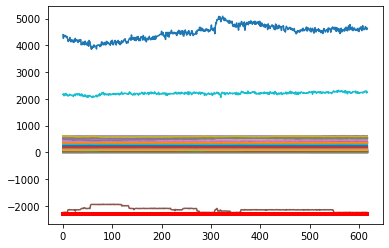

Predicción:  [[[0.99007964 0.00992041]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1393500e+01  1.2680400e+01  5.5755500e+01  7.5643900e+01
  6.1966740e+02  3.0033500e+01  9.5254000e+00  1.7994180e+02
  3.9500000e-02  7.4371500e+01  1.2010650e+02  9.9515000e+00
  6.5942900e+01  1.7284180e+02  2.0098100e+01  1.3537140e+02
  1.8205530e+02  6.9435300e+01 -6.8991000e+00  3.7136000e+00
  9.9122000e+00  7.4911000e+00  1.5001000e+00  7.1871400e+01
  1.4339000e+00  1.4973000e+00  8.2016800e+01  6.0537500e+01
  1.2817000e+00  1.1995000e+00  1.6282000e+00  1.3527000e+00
  1.5549290e+02  8.2470000e-01  8.2960000e-01 -2.2526824e+03
  2.0276010e+02  1.5796000e+00  1.3420000e+00  2.2449226e+03
  4.5240902e+03  1.8481450e+02  1.3841000e+00  1.3809000e+00
  7.8975000e+00  7.7974000e+00  1.7295000e+00  1.0140000e-01
  3.1439400e+01  5.3461780e+02  5.2268090e+02  5.1885830e+02
  5.1928250e+02  5.1951340e+02  2.9056800e+01  2.99

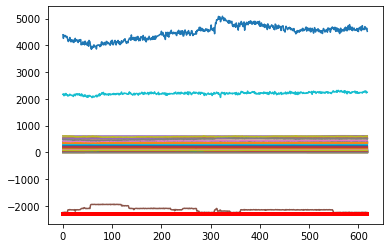

Predicción:  [[[0.9875329  0.01246706]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9453700e+01  1.2731800e+01  5.5829400e+01  7.5824600e+01
  6.2074770e+02  3.0349800e+01  9.6147000e+00  1.7999750e+02
  5.6200000e-02  7.4015700e+01  1.1995180e+02  1.0221300e+01
  6.4589900e+01  1.7357220e+02  2.0409100e+01  1.3631430e+02
  1.8210420e+02  6.9323700e+01 -6.8991000e+00  3.7730000e+00
  9.7062000e+00  7.5185000e+00  1.4991000e+00  7.1781300e+01
  1.4325000e+00  1.5012000e+00  8.3071500e+01  6.0726300e+01
  1.2777000e+00  1.1970000e+00  1.6296000e+00  1.3544000e+00
  1.5584370e+02  8.2560000e-01  8.3070000e-01 -2.2416767e+03
  2.0147130e+02  1.5842000e+00  1.3380000e+00  2.2706167e+03
  4.7075046e+03  1.8481450e+02  1.3863000e+00  1.3800000e+00
  7.9010000e+00  7.8004000e+00  1.7289000e+00  9.9400000e-02
  3.1670800e+01  5.3434890e+02  5.2291940e+02  5.1898050e+02
  5.1935830e+02  5.1962750e+02  2.8142100e+01  2.96

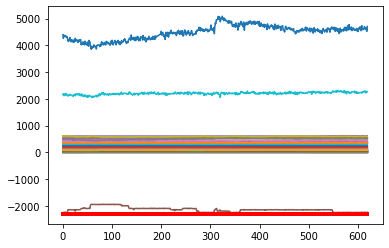

Predicción:  [[[0.9905822 0.0094178]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7057500e+01  1.2721500e+01  5.5818800e+01  7.6100900e+01
  6.2034770e+02  3.1527700e+01  9.6015000e+00  1.7992680e+02
  4.9200000e-02  7.3633700e+01  1.2020800e+02  1.0326600e+01
  6.4561800e+01  1.7473360e+02  2.0687600e+01  1.3789220e+02
  1.8211510e+02  6.9262000e+01 -6.8991000e+00  3.7855000e+00
  1.0245700e+01  7.4813000e+00  1.5002000e+00  7.1785000e+01
  1.4313000e+00  1.4965000e+00  8.2953900e+01  6.0491900e+01
  1.2784000e+00  1.1962000e+00  1.6233000e+00  1.3503000e+00
  1.5499030e+02  8.2410000e-01  8.2950000e-01 -2.2557753e+03
  2.0195090e+02  1.5790000e+00  1.3386000e+00  2.2503806e+03
  4.6150206e+03  1.8481450e+02  1.3813000e+00  1.3756000e+00
  7.8985000e+00  7.7981000e+00  1.7256000e+00  1.0230000e-01
  3.1232400e+01  5.3448220e+02  5.2235330e+02  5.1864340e+02
  5.1890740e+02  5.1913490e+02  2.7614300e+01  2.9478

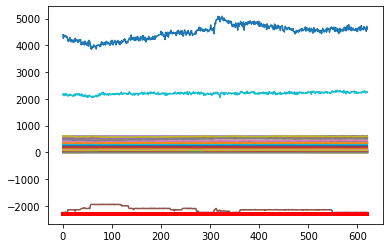

Predicción:  [[[0.989912  0.0100881]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7406500e+01  1.2754200e+01  5.5209200e+01  7.6720400e+01
  6.2047700e+02  3.0806800e+01  9.5818000e+00  1.8009490e+02
  3.6200000e-02  7.4090100e+01  1.2017160e+02  9.9102000e+00
  6.4354500e+01  1.7426680e+02  2.0724500e+01  1.3916100e+02
  1.8210300e+02  6.9465700e+01 -6.8991000e+00  3.7922000e+00
  9.3719000e+00  7.5390000e+00  1.5011000e+00  7.1789900e+01
  1.4339000e+00  1.4983000e+00  8.2656300e+01  6.0501000e+01
  1.2806000e+00  1.1990000e+00  1.6252000e+00  1.3520000e+00
  1.5551790e+02  8.2320000e-01  8.3000000e-01 -2.2495224e+03
  2.0297090e+02  1.5811000e+00  1.3409000e+00  2.2751550e+03
  4.5661988e+03  1.8481450e+02  1.3833000e+00  1.3762000e+00
  7.9001000e+00  7.8008000e+00  1.7275000e+00  1.0260000e-01
  3.1323400e+01  5.3533550e+02  5.2269140e+02  5.1891630e+02
  5.1913590e+02  5.1932270e+02  2.7476400e+01  2.9303

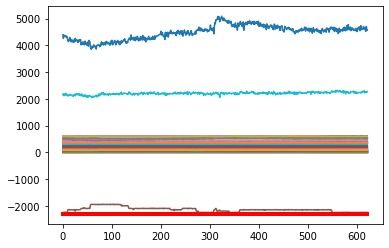

Predicción:  [[[0.98835677 0.01164327]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8005200e+01  1.2684500e+01  5.5967300e+01  7.6559000e+01
  6.1980520e+02  3.0878200e+01  9.5462000e+00  1.7999060e+02
  2.5300000e-02  7.4850900e+01  1.2003430e+02  1.0008500e+01
  6.4743200e+01  1.7460720e+02  2.0949000e+01  1.4002350e+02
  1.8187350e+02  6.9296800e+01 -6.8991000e+00  3.8146000e+00
  9.6768000e+00  7.4659000e+00  1.5013000e+00  7.1744900e+01
  1.4372000e+00  1.5022000e+00  8.2826400e+01  6.0016100e+01
  1.2841000e+00  1.2032000e+00  1.6286000e+00  1.3580000e+00
  1.5516330e+02  8.2360000e-01  8.3030000e-01 -2.2498660e+03
  2.0134890e+02  1.5858000e+00  1.3443000e+00  2.2251296e+03
  4.5891401e+03  1.8481450e+02  1.3892000e+00  1.3818000e+00
  7.8997000e+00  7.7985000e+00  1.7321000e+00  1.0340000e-01
  3.1189200e+01  5.3494890e+02  5.2315920e+02  5.1945990e+02
  5.1982100e+02  5.2005460e+02  2.7278800e+01  2.92

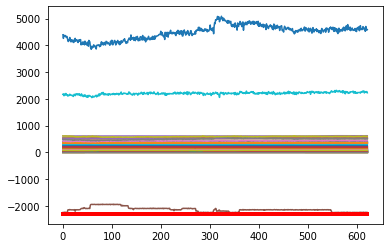

Predicción:  [[[0.9889444  0.01105564]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8675400e+01  1.2732400e+01  5.5141500e+01  7.5427400e+01
  6.2000520e+02  3.0875400e+01  9.6063000e+00  1.8016340e+02
  1.4700000e-02  7.5277400e+01  1.1998180e+02  1.0003400e+01
  6.4458000e+01  1.7492670e+02  2.1402100e+01  1.4080520e+02
  1.8182610e+02  6.9663200e+01 -6.8991000e+00  3.7871000e+00
  1.0192100e+01  7.5150000e+00  1.5005000e+00  7.1824400e+01
  1.4280000e+00  1.4946000e+00  8.3999100e+01  6.1229000e+01
  1.2742000e+00  1.1947000e+00  1.6173000e+00  1.3502000e+00
  1.5378600e+02  8.2520000e-01  8.2950000e-01 -2.2458004e+03
  2.0227220e+02  1.5785000e+00  1.3354000e+00  2.2504288e+03
  4.6330016e+03  1.8481450e+02  1.3800000e+00  1.3751000e+00
  7.9029000e+00  7.7937000e+00  1.7226000e+00  1.0540000e-01
  2.9708900e+01  5.3453340e+02  5.2278910e+02  5.1894120e+02
  5.1939780e+02  5.1956260e+02  2.8750900e+01  2.91

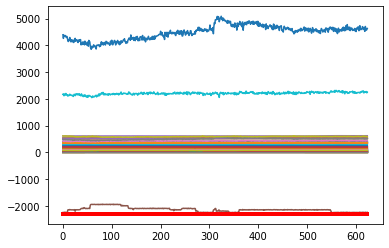

Predicción:  [[[0.98961747 0.01038255]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8198500e+01  1.2638500e+01  5.4443500e+01  7.5850100e+01
  6.1962630e+02  3.1029300e+01  9.5542000e+00  1.7991290e+02
  3.6000000e-03  7.5633800e+01  1.1999510e+02  9.9194000e+00
  6.4211400e+01  1.7560850e+02  2.1389400e+01  1.4071250e+02
  1.8183430e+02  6.9370600e+01 -6.8991000e+00  3.7926000e+00
  1.0385500e+01  7.5203000e+00  1.4994000e+00  7.1751700e+01
  1.4266000e+00  1.4910000e+00  8.3001300e+01  6.1105100e+01
  1.2705000e+00  1.1942000e+00  1.6131000e+00  1.3452000e+00
  1.5412670e+02  8.2690000e-01  8.3110000e-01 -2.2534568e+03
  2.0186120e+02  1.5731000e+00  1.3317000e+00  2.2321499e+03
  4.6204511e+03  1.8481450e+02  1.3751000e+00  1.3694000e+00
  7.8974000e+00  7.8049000e+00  1.7208000e+00  1.0770000e-01
  3.0067300e+01  5.3496660e+02  5.2287590e+02  5.1891830e+02
  5.1941530e+02  5.1955700e+02  2.8838100e+01  2.87

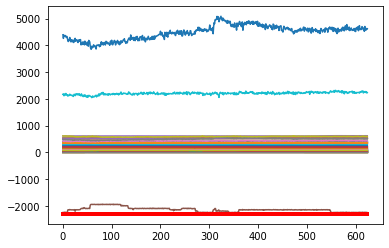

Predicción:  [[[0.98988324 0.01011676]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7107400e+01  1.2720100e+01  5.4914200e+01  7.6791900e+01
  6.1907200e+02  3.1146900e+01  9.5707000e+00  1.8002140e+02
  8.7000000e-03  7.5745700e+01  1.2008380e+02  1.0074900e+01
  6.3769500e+01  1.7555120e+02  2.1423700e+01  1.4009870e+02
  1.8172420e+02  6.9631800e+01 -6.8991000e+00  3.7887000e+00
  9.5702000e+00  7.4789000e+00  1.5008000e+00  7.1816500e+01
  1.4287000e+00  1.4948000e+00  8.3460000e+01  6.1122100e+01
  1.2765000e+00  1.1952000e+00  1.6169000e+00  1.3498000e+00
  1.5418190e+02  8.2560000e-01  8.2910000e-01 -2.2470888e+03
  2.0151820e+02  1.5780000e+00  1.3375000e+00  2.2325940e+03
  4.6280546e+03  1.8481450e+02  1.3798000e+00  1.3754000e+00
  7.9007000e+00  7.8014000e+00  1.7220000e+00  1.0520000e-01
  2.9794500e+01  5.3401780e+02  5.2255590e+02  5.1868330e+02
  5.1908720e+02  5.1923900e+02  2.8597400e+01  2.85

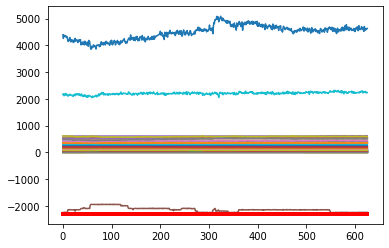

Predicción:  [[[0.9896288  0.01037123]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6486200e+01  1.2515400e+01  5.5582200e+01  7.8205900e+01
  6.1997700e+02  3.0966200e+01  9.5222000e+00  1.7994680e+02
  1.8300000e-02  7.5922200e+01  1.2004700e+02  9.9522000e+00
  6.3472300e+01  1.7508190e+02  2.1132700e+01  1.3866760e+02
  1.8153910e+02  6.9374100e+01 -6.8991000e+00  3.8139000e+00
  8.4582000e+00  7.5159000e+00  1.5007000e+00  7.1839100e+01
  1.4372000e+00  1.5053000e+00  8.3867700e+01  6.0732000e+01
  1.2846000e+00  1.2027000e+00  1.6285000e+00  1.3607000e+00
  1.5587730e+02  8.2440000e-01  8.2930000e-01 -2.2519709e+03
  2.0407640e+02  1.5889000e+00  1.3450000e+00  2.2893126e+03
  4.6908525e+03  1.8481450e+02  1.3909000e+00  1.3863000e+00
  7.9012000e+00  7.7988000e+00  1.7316000e+00  1.0300000e-01
  2.9826000e+01  5.3468220e+02  5.2312460e+02  5.1933370e+02
  5.1981540e+02  5.1993430e+02  2.8146900e+01  2.89

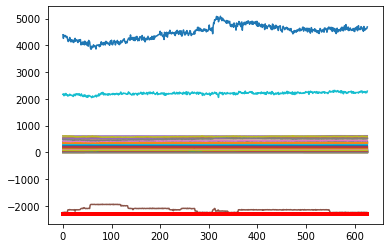

Predicción:  [[[0.99079835 0.00920161]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9001800e+01  1.2429900e+01  5.5114700e+01  7.7714200e+01
  6.2016000e+02  3.0850200e+01  9.5636000e+00  1.8006600e+02
  2.8400000e-02  7.5915900e+01  1.2012390e+02  1.0094600e+01
  6.3645800e+01  1.7485810e+02  2.1398100e+01  1.3875060e+02
  1.8131480e+02  6.9547300e+01 -6.8991000e+00  3.8021000e+00
  9.0810000e+00  7.5197000e+00  1.4992000e+00  7.1785700e+01
  1.4308000e+00  1.4979000e+00  8.3705200e+01  6.1485200e+01
  1.2773000e+00  1.1949000e+00  1.6192000e+00  1.3510000e+00
  1.5642050e+02  8.2350000e-01  8.2970000e-01 -2.2470322e+03
  2.0172180e+02  1.5813000e+00  1.3388000e+00  2.2215806e+03
  4.7232162e+03  1.8481450e+02  1.3806000e+00  1.3780000e+00
  7.8971000e+00  7.7999000e+00  1.7254000e+00  1.0610000e-01
  2.9930800e+01  5.3483550e+02  5.2285300e+02  5.1872880e+02
  5.1921530e+02  5.1936960e+02  2.8132500e+01  2.90

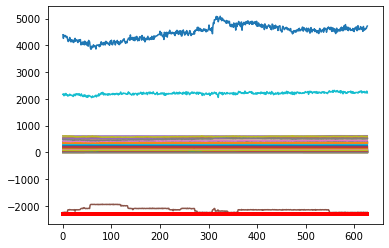

Predicción:  [[[0.9909458  0.00905415]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8494800e+01  1.2445400e+01  5.5877600e+01  7.6380300e+01
  6.2044210e+02  3.0916400e+01  9.5396000e+00  1.7996130e+02
  3.8500000e-02  7.5655000e+01  1.1985110e+02  9.9312000e+00
  6.3764300e+01  1.7614040e+02  2.1553300e+01  1.3937410e+02
  1.8128720e+02  6.9120800e+01 -6.8991000e+00  3.8072000e+00
  1.0521800e+01  7.4925000e+00  1.4991000e+00  7.1765200e+01
  1.4372000e+00  1.5046000e+00  8.4005300e+01  6.0741600e+01
  1.2807000e+00  1.2025000e+00  1.6254000e+00  1.3584000e+00
  1.5550140e+02  8.2400000e-01  8.3040000e-01 -2.2473104e+03
  2.0437470e+02  1.5887000e+00  1.3413000e+00  2.2619509e+03
  4.7117544e+03  1.8481450e+02  1.3860000e+00  1.3873000e+00
  7.9042000e+00  7.8024000e+00  1.7330000e+00  1.0770000e-01
  2.7625800e+01  5.3496230e+02  5.2272510e+02  5.1885760e+02
  5.1936060e+02  5.1962100e+02  2.8169200e+01  2.90

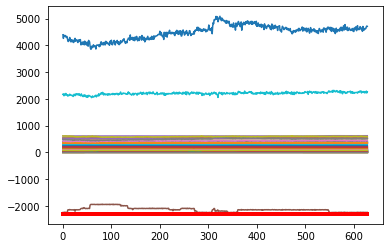

Predicción:  [[[0.9908462  0.00915381]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8982300e+01  1.2348100e+01  5.6713800e+01  7.7279500e+01
  6.1961770e+02  3.0292800e+01  9.5233000e+00  1.8005410e+02
  6.4900000e-02  7.5861000e+01  1.1994260e+02  1.0035200e+01
  6.3033000e+01  1.7505640e+02  2.1199700e+01  1.4095870e+02
  1.8126670e+02  6.9395300e+01 -6.8991000e+00  3.7935000e+00
  9.2317000e+00  7.4833000e+00  1.4998000e+00  7.1766600e+01
  1.4376000e+00  1.5052000e+00  8.3116400e+01  6.1158400e+01
  1.2829000e+00  1.2035000e+00  1.6264000e+00  1.3578000e+00
  1.5517990e+02  8.2330000e-01  8.3040000e-01 -2.2479441e+03
  2.0262420e+02  1.5885000e+00  1.3439000e+00  2.2590174e+03
  4.6570656e+03  1.8481450e+02  1.3847000e+00  1.3878000e+00
  7.8986000e+00  7.7996000e+00  1.7341000e+00  1.0770000e-01
  2.7009600e+01  5.3375550e+02  5.2284610e+02  5.1895120e+02
  5.1955510e+02  5.1965760e+02  2.8155500e+01  2.90

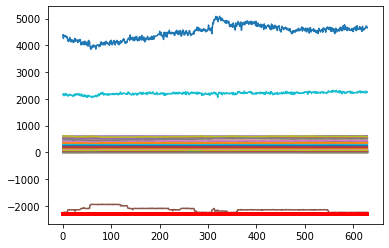

Predicción:  [[[0.9901703 0.0098297]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9394200e+01  1.2313100e+01  5.6900600e+01  7.8139700e+01
  6.1995840e+02  3.0386700e+01  9.5371000e+00  1.7999490e+02
  1.0800000e-01  7.6137700e+01  1.1985650e+02  1.0140000e+01
  6.4205600e+01  1.7461850e+02  2.1460800e+01  1.4379540e+02
  1.8113560e+02  6.9199800e+01 -6.8991000e+00  3.8396000e+00
  9.1384000e+00  7.4838000e+00  1.4992000e+00  7.1787900e+01
  1.4346000e+00  1.5021000e+00  8.3014000e+01  6.1219000e+01
  1.2820000e+00  1.2002000e+00  1.6222000e+00  1.3558000e+00
  1.5504970e+02  8.2340000e-01  8.3060000e-01 -2.2465190e+03
  2.0081670e+02  1.5852000e+00  1.3432000e+00  2.2291418e+03
  4.6207347e+03  1.8481450e+02  1.3831000e+00  1.3849000e+00
  7.8991000e+00  7.7977000e+00  1.7306000e+00  1.0820000e-01
  2.7276000e+01  5.3384450e+02  5.2277830e+02  5.1860750e+02
  5.1910450e+02  5.1928010e+02  2.7924900e+01  2.8949

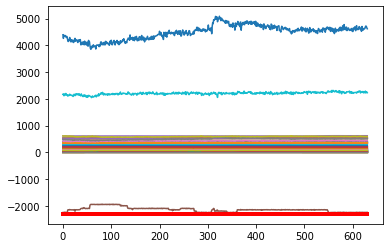

Predicción:  [[[0.98944116 0.01055876]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9522500e+01  1.2352200e+01  5.7569400e+01  7.7642200e+01
  6.2055180e+02  3.0542900e+01  9.5200000e+00  1.7995950e+02
  1.5300000e-01  7.5933000e+01  1.1993640e+02  9.9172000e+00
  6.3224700e+01  1.7508760e+02  2.1349100e+01  1.4559190e+02
  1.8122600e+02  6.9259600e+01 -6.8991000e+00  3.7905000e+00
  1.0072300e+01  7.5124000e+00  1.4985000e+00  7.1841300e+01
  1.4325000e+00  1.5008000e+00  8.3619200e+01  6.0713900e+01
  1.2791000e+00  1.1983000e+00  1.6193000e+00  1.3521000e+00
  1.5415220e+02  8.2420000e-01  8.3010000e-01 -2.2483983e+03
  2.0195940e+02  1.5835000e+00  1.3401000e+00  2.2235893e+03
  4.6764598e+03  1.8481450e+02  1.3812000e+00  1.3795000e+00
  7.9016000e+00  7.8000000e+00  1.7283000e+00  1.0890000e-01
  2.9062000e+01  5.3402000e+02  5.2253970e+02  5.1854590e+02
  5.1905400e+02  5.1923710e+02  2.7714000e+01  2.87

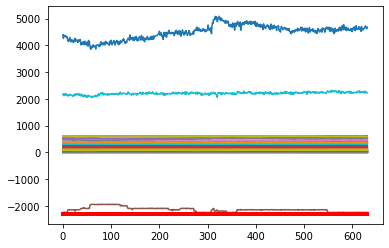

Predicción:  [[[0.99047613 0.00952389]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9438400e+01  1.2316000e+01  5.7078500e+01  7.7509600e+01
  6.1994530e+02  3.1019300e+01  9.5364000e+00  1.8015110e+02
  2.4920000e-01  7.5788000e+01  1.1994480e+02  9.9203000e+00
  6.3588700e+01  1.7625740e+02  2.1329700e+01  1.4598570e+02
  1.8134230e+02  6.9393300e+01 -6.8991000e+00  3.8216000e+00
  1.0939000e+01  7.5123000e+00  1.5018000e+00  7.1806200e+01
  1.4318000e+00  1.4995000e+00  8.3277100e+01  6.1415900e+01
  1.2777000e+00  1.1983000e+00  1.6183000e+00  1.3508000e+00
  1.5274650e+02  8.2450000e-01  8.2940000e-01 -2.2521441e+03
  2.0177610e+02  1.5826000e+00  1.3387000e+00  2.2170294e+03
  4.6833123e+03  1.8481450e+02  1.3824000e+00  1.3777000e+00
  7.8973000e+00  7.7987000e+00  1.7264000e+00  1.0830000e-01
  3.1722100e+01  5.3350220e+02  5.2277570e+02  5.1877900e+02
  5.1925130e+02  5.1947900e+02  2.7671000e+01  2.86

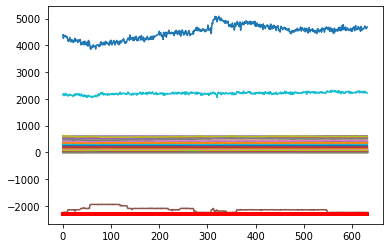

Predicción:  [[[0.99073166 0.00926839]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9187800e+01  1.2394100e+01  5.6848000e+01  7.7165900e+01
  6.2048760e+02  3.0538100e+01  9.5733000e+00  1.8004760e+02
  2.7620000e-01  7.5692300e+01  1.1998180e+02  9.6377000e+00
  6.2851700e+01  1.7549620e+02  2.1257500e+01  1.4683570e+02
  1.8165590e+02  6.9489200e+01 -6.8991000e+00  3.8032000e+00
  1.1518100e+01  7.5064000e+00  1.4994000e+00  7.1807900e+01
  1.4271000e+00  1.4927000e+00  8.2770100e+01  6.2328300e+01
  1.2731000e+00  1.1933000e+00  1.6120000e+00  1.3458000e+00
  1.5243420e+02  8.2380000e-01  8.3040000e-01 -2.2542009e+03
  2.0156400e+02  1.5757000e+00  1.3357000e+00  2.2283033e+03
  4.6107893e+03  1.8481450e+02  1.3775000e+00  1.3737000e+00
  7.8993000e+00  7.8001000e+00  1.7211000e+00  1.0900000e-01
  3.1893600e+01  5.3296670e+02  5.2235750e+02  5.1843600e+02
  5.1884800e+02  5.1908740e+02  2.7621700e+01  2.85

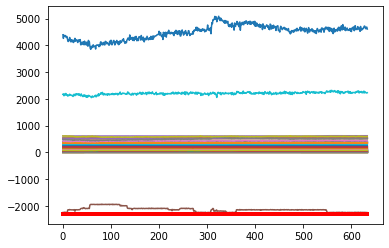

Predicción:  [[[0.9897983  0.01020171]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  634  - Datos Recibidos:  [ 3.9190300e+01  1.2446000e+01  5.5780000e+01  7.7724600e+01
  6.2020460e+02  3.1704500e+01  9.5878000e+00  1.7996530e+02
  2.5670000e-01  7.5681000e+01  1.2022080e+02  1.0038600e+01
  6.2305200e+01  1.7719050e+02  2.1831400e+01  1.4640190e+02
  1.8158520e+02  6.9168500e+01 -6.8991000e+00  3.8061000e+00
  1.0312900e+01  7.4935000e+00  1.4997000e+00  7.1785900e+01
  1.4393000e+00  1.5071000e+00  8.2718800e+01  6.1304200e+01
  1.2864000e+00  1.2057000e+00  1.6243000e+00  1.3575000e+00
  1.5273110e+02  8.2360000e-01  8.3010000e-01 -2.2520991e+03
  2.0262600e+02  1.5902000e+00  1.3474000e+00  2.2278363e+03
  4.6569535e+03  1.8481450e+02  1.3892000e+00  1.3865000e+00
  7.8996000e+00  7.8001000e+00  1.7330000e+00  1.0910000e-01
  3.1926400e+01  5.3346450e+02  5.2300740e+02  5.1904250e+02
  5.1947310e+02  5.1973110e+02  2.757190

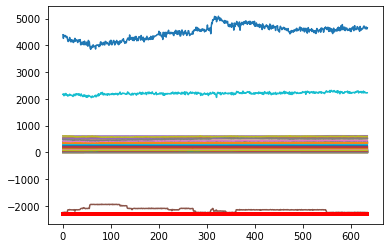

Predicción:  [[[0.99037874 0.00962126]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8947900e+01  1.2474600e+01  5.6067000e+01  7.7802300e+01
  6.2025190e+02  3.2162400e+01  9.5386000e+00  1.8005510e+02
  2.6870000e-01  7.5446300e+01  1.2007320e+02  1.0194700e+01
  6.2424100e+01  1.7674270e+02  2.1990500e+01  1.4653670e+02
  1.8138310e+02  6.9313100e+01 -6.8991000e+00  3.8116000e+00
  1.0520400e+01  7.5085000e+00  1.5000000e+00  7.1821400e+01
  1.4315000e+00  1.4982000e+00  8.2704200e+01  6.1760400e+01
  1.2787000e+00  1.1975000e+00  1.6141000e+00  1.3510000e+00
  1.5368810e+02  8.2310000e-01  8.3030000e-01 -2.2594951e+03
  2.0133420e+02  1.5812000e+00  1.3400000e+00  2.2528123e+03
  4.6970944e+03  1.8481450e+02  1.3824000e+00  1.3785000e+00
  7.8991000e+00  7.8002000e+00  1.7258000e+00  1.1170000e-01
  3.1365200e+01  5.3278220e+02  5.2277010e+02  5.1881010e+02
  5.1917350e+02  5.1944920e+02  2.7228100e+01  2.86

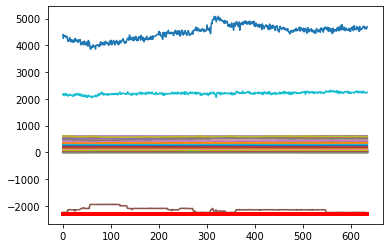

Predicción:  [[[0.9911048  0.00889515]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8838400e+01  1.2458800e+01  5.7789600e+01  7.7239300e+01
  6.2077610e+02  3.2452100e+01  9.5657000e+00  1.7992160e+02
  2.4340000e-01  7.4818100e+01  1.1999710e+02  9.9458000e+00
  6.4210500e+01  1.7597680e+02  2.1725200e+01  1.4425550e+02
  1.8144220e+02  6.9389600e+01 -6.8991000e+00  3.7951000e+00
  9.6152000e+00  7.4941000e+00  1.5003000e+00  7.1798300e+01
  1.4354000e+00  1.5034000e+00  8.2520800e+01  6.1788400e+01
  1.2814000e+00  1.2012000e+00  1.6214000e+00  1.3559000e+00
  1.5393650e+02  8.2390000e-01  8.3010000e-01 -2.2458169e+03
  2.0016340e+02  1.5867000e+00  1.3434000e+00  2.1959516e+03
  4.6236884e+03  1.8481450e+02  1.3855000e+00  1.3847000e+00
  7.9017000e+00  7.7992000e+00  1.7301000e+00  1.0870000e-01
  2.9698400e+01  5.3281780e+02  5.2264980e+02  5.1879370e+02
  5.1928710e+02  5.1950690e+02  2.7158600e+01  2.87

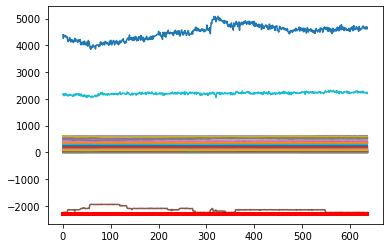

Predicción:  [[[0.98949534 0.01050467]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0739400e+01  1.2289600e+01  5.7185500e+01  7.7364400e+01
  6.2109060e+02  3.2771000e+01  9.5432000e+00  1.8011780e+02
  1.4880000e-01  7.4521800e+01  1.1996940e+02  1.0123500e+01
  6.3865900e+01  1.7621340e+02  2.1836200e+01  1.4437460e+02
  1.8122930e+02  6.9328000e+01 -6.8991000e+00  3.7921000e+00
  1.0298600e+01  7.4948000e+00  1.4986000e+00  7.1773200e+01
  1.4382000e+00  1.5059000e+00  8.2330300e+01  6.1299800e+01
  1.2849000e+00  1.2030000e+00  1.6227000e+00  1.3576000e+00
  1.5504110e+02  8.2430000e-01  8.3010000e-01 -2.2464632e+03
  2.0579150e+02  1.5891000e+00  1.3464000e+00  2.2092613e+03
  4.6329797e+03  1.8481450e+02  1.3855000e+00  1.3863000e+00
  7.9034000e+00  7.8003000e+00  1.7338000e+00  1.1140000e-01
  2.7940400e+01  5.3350000e+02  5.2333790e+02  5.1933450e+02
  5.1984550e+02  5.2011210e+02  2.7072900e+01  2.87

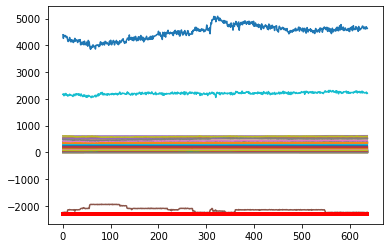

Predicción:  [[[0.9896941  0.01030587]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  638  - Datos Recibidos:  [ 4.1761900e+01  1.2140300e+01  5.6753500e+01  7.6457500e+01
  6.1948110e+02  3.2505100e+01  9.5019000e+00  1.8002100e+02
  1.0990000e-01  7.4426400e+01  1.2017130e+02  9.9117000e+00
  6.3439700e+01  1.7592240e+02  2.1572100e+01  1.4616750e+02
  1.8107890e+02  6.9539700e+01 -6.8991000e+00  3.7922000e+00
  1.1829400e+01  7.4925000e+00  1.4992000e+00  7.1802900e+01
  1.4241000e+00  1.4921000e+00  8.2748400e+01  6.2187100e+01
  1.2699000e+00  1.1901000e+00  1.6082000e+00  1.3451000e+00
  1.5408160e+02  8.2440000e-01  8.2990000e-01 -2.2441069e+03
  2.0277800e+02  1.5750000e+00  1.3321000e+00  2.2320104e+03
  4.6629109e+03  1.8481450e+02  1.3737000e+00  1.3729000e+00
  7.8973000e+00  7.7982000e+00  1.7201000e+00  1.1180000e-01
  2.8269100e+01  5.3238660e+02  5.2260410e+02  5.1841310e+02
  5.1892310e+02  5.1922280e+02  2.702590

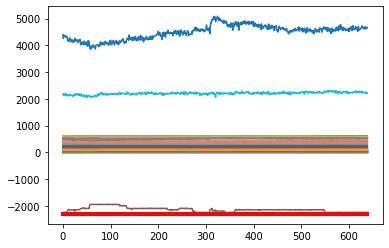

Predicción:  [[[0.99010044 0.00989963]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9031500e+01  1.2304900e+01  5.7510600e+01  7.7201300e+01
  6.1940580e+02  3.2676500e+01  9.5200000e+00  1.7999700e+02
  1.0920000e-01  7.4596900e+01  1.1994310e+02  1.0028900e+01
  6.2532800e+01  1.7577540e+02  2.1498400e+01  1.4634350e+02
  1.8128030e+02  6.9167900e+01 -6.8991000e+00  3.7936000e+00
  1.0178800e+01  7.4958000e+00  1.4983000e+00  7.1838500e+01
  1.4395000e+00  1.5088000e+00  8.2610100e+01  6.0480600e+01
  1.2888000e+00  1.2056000e+00  1.6239000e+00  1.3602000e+00
  1.5423950e+02  8.2470000e-01  8.3030000e-01 -2.2485880e+03
  2.0269980e+02  1.5912000e+00  1.3496000e+00  2.2835455e+03
  4.6615498e+03  1.8481450e+02  1.3889000e+00  1.3877000e+00
  7.8989000e+00  7.7996000e+00  1.7333000e+00  1.0940000e-01
  2.8708800e+01  5.3292890e+02  5.2243180e+02  5.1853320e+02
  5.1904600e+02  5.1943510e+02  2.7093200e+01  2.86

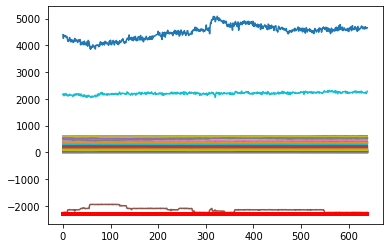

Predicción:  [[[0.99026805 0.00973199]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0540100e+01  1.2273300e+01  5.6835800e+01  7.8719300e+01
  6.1968980e+02  3.2871300e+01  9.5135000e+00  1.7994970e+02
  1.1430000e-01  7.4613400e+01  1.1994190e+02  1.0050200e+01
  6.2697200e+01  1.7561560e+02  2.2076300e+01  1.4643520e+02
  1.8121380e+02  6.9258300e+01 -6.8991000e+00  3.7846000e+00
  9.9248000e+00  7.4940000e+00  1.5002000e+00  7.1819100e+01
  1.4364000e+00  1.5039000e+00  8.2883700e+01  6.0725500e+01
  1.2852000e+00  1.2018000e+00  1.6222000e+00  1.3571000e+00
  1.5563600e+02  8.2570000e-01  8.3050000e-01 -2.2501392e+03
  2.0140740e+02  1.5871000e+00  1.3464000e+00  2.2193551e+03
  4.5828058e+03  1.8481450e+02  1.3846000e+00  1.3848000e+00
  7.9013000e+00  7.7977000e+00  1.7318000e+00  1.0950000e-01
  2.7497300e+01  5.3321780e+02  5.2266920e+02  5.1862610e+02
  5.1923460e+02  5.1961720e+02  2.7138600e+01  2.87

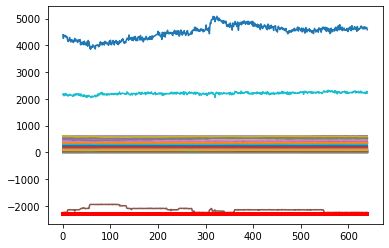

Predicción:  [[[0.98882663 0.0111733 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1329000e+01  1.2249300e+01  5.7240400e+01  7.7626300e+01
  6.2088070e+02  3.2676900e+01  9.5479000e+00  1.8000670e+02
  1.1160000e-01  7.4514000e+01  1.2003240e+02  9.8780000e+00
  6.3143700e+01  1.7513640e+02  2.1797400e+01  1.4397140e+02
  1.8132310e+02  6.9343500e+01 -6.8991000e+00  3.7947000e+00
  1.0893500e+01  7.5022000e+00  1.5008000e+00  7.1768000e+01
  1.4366000e+00  1.5026000e+00  8.2423700e+01  6.1191600e+01
  1.2814000e+00  1.2010000e+00  1.6238000e+00  1.3553000e+00
  1.5533990e+02  8.2610000e-01  8.2990000e-01 -2.2506293e+03
  2.0109820e+02  1.5861000e+00  1.3425000e+00  2.2806855e+03
  4.6439601e+03  1.8481450e+02  1.3835000e+00  1.3838000e+00
  7.8997000e+00  7.8054000e+00  1.7333000e+00  1.0940000e-01
  2.8391500e+01  5.3291780e+02  5.2239100e+02  5.1839510e+02
  5.1908070e+02  5.1940730e+02  2.7285300e+01  2.88

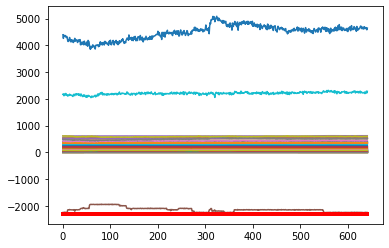

Predicción:  [[[0.9900865 0.0099135]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0227300e+01  1.2318900e+01  5.7401400e+01  7.6510700e+01
  6.2085720e+02  3.2428600e+01  9.5392000e+00  1.7994160e+02
  1.2270000e-01  7.4607800e+01  1.2011620e+02  9.9780000e+00
  6.3118200e+01  1.7547110e+02  2.1682500e+01  1.4318850e+02
  1.8149390e+02  6.9335200e+01 -6.8991000e+00  3.8010000e+00
  1.0754100e+01  7.5021000e+00  1.4993000e+00  7.1756700e+01
  1.4317000e+00  1.4972000e+00  8.3186800e+01  6.1660200e+01
  1.2768000e+00  1.1960000e+00  1.6156000e+00  1.3497000e+00
  1.5558560e+02  8.2720000e-01  8.2980000e-01 -2.2501551e+03
  2.0062350e+02  1.5800000e+00  1.3380000e+00  2.2366873e+03
  4.5950005e+03  1.8481450e+02  1.3772000e+00  1.3776000e+00
  7.9020000e+00  7.7947000e+00  1.7266000e+00  1.1090000e-01
  2.7530600e+01  5.3280000e+02  5.2277050e+02  5.1861030e+02
  5.1936270e+02  5.1958830e+02  2.7464000e+01  2.8902

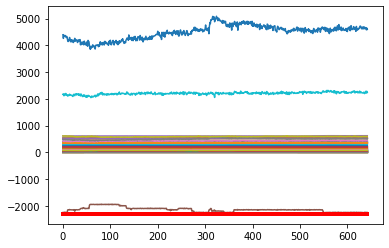

Predicción:  [[[0.989106   0.01089404]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9462200e+01  1.2352800e+01  5.6406700e+01  7.5783200e+01
  6.2001210e+02  3.2472100e+01  9.5570000e+00  1.8004180e+02
  1.2400000e-01  7.4465400e+01  1.1991300e+02  9.9311000e+00
  6.3249300e+01  1.7569270e+02  2.0953100e+01  1.4387020e+02
  1.8177000e+02  6.9029500e+01 -6.8991000e+00  3.8048000e+00
  1.1455200e+01  7.5068000e+00  1.4999000e+00  7.1824100e+01
  1.4236000e+00  1.4916000e+00  8.3330400e+01  6.1606600e+01
  1.2700000e+00  1.1890000e+00  1.6094000e+00  1.3437000e+00
  1.5399240e+02  8.2710000e-01  8.3040000e-01 -2.2492939e+03
  1.9952920e+02  1.5753000e+00  1.3319000e+00  2.2643158e+03
  4.6598833e+03  1.8481450e+02  1.3718000e+00  1.3710000e+00
  7.9021000e+00  7.8085000e+00  1.7184000e+00  1.0900000e-01
  2.8019100e+01  5.3225100e+02  5.2205490e+02  5.1792330e+02
  5.1870350e+02  5.1888850e+02  2.7390300e+01  2.89

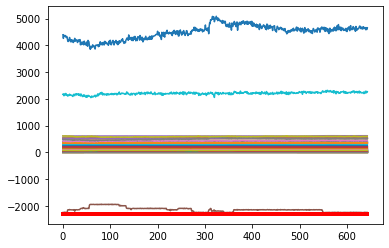

Predicción:  [[[0.9902766  0.00972344]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9758200e+01  1.2399600e+01  5.4882900e+01  7.6864500e+01
  6.1925420e+02  3.2880800e+01  9.5596000e+00  1.8003040e+02
  1.1970000e-01  7.4439300e+01  1.1986140e+02  9.9877000e+00
  6.3732000e+01  1.7627930e+02  2.0487200e+01  1.4398920e+02
  1.8193100e+02  6.9325400e+01 -6.8991000e+00  3.7947000e+00
  1.0895300e+01  7.4947000e+00  1.4994000e+00  7.1791500e+01
  1.4302000e+00  1.4978000e+00  8.3234600e+01  6.1206200e+01
  1.2751000e+00  1.1963000e+00  1.6111000e+00  1.3508000e+00
  1.5390830e+02  8.2790000e-01  8.3070000e-01 -2.2463063e+03
  2.0108230e+02  1.5809000e+00  1.3359000e+00  2.2425370e+03
  4.6435426e+03  1.8481450e+02  1.3787000e+00  1.3759000e+00
  7.8987000e+00  7.8003000e+00  1.7243000e+00  1.1320000e-01
  2.7803800e+01  5.3263340e+02  5.2256430e+02  5.1861030e+02
  5.1932280e+02  5.1949530e+02  2.7300300e+01  2.88

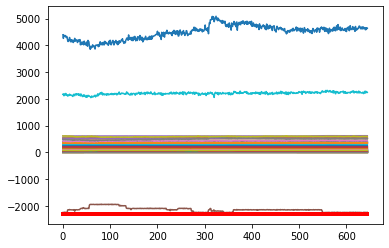

Predicción:  [[[0.9898492  0.01015081]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7570400e+01  1.2490000e+01  5.5056700e+01  7.8521200e+01
  6.2068280e+02  3.3484600e+01  9.5508000e+00  1.8004750e+02
  1.0160000e-01  7.4517400e+01  1.2004750e+02  9.9967000e+00
  6.2551800e+01  1.7650700e+02  2.1273600e+01  1.4281730e+02
  1.8181970e+02  6.9226800e+01 -6.8991000e+00  3.7992000e+00
  9.2592000e+00  7.5043000e+00  1.5004000e+00  7.1805400e+01
  1.4313000e+00  1.4975000e+00  8.2647800e+01  6.0246700e+01
  1.2807000e+00  1.1979000e+00  1.6148000e+00  1.3536000e+00
  1.5412250e+02  8.2780000e-01  8.2950000e-01 -2.2511485e+03
  2.0268950e+02  1.5803000e+00  1.3411000e+00  2.2468379e+03
  4.6612791e+03  1.8481450e+02  1.3810000e+00  1.3790000e+00
  7.9004000e+00  7.7989000e+00  1.7246000e+00  1.0960000e-01
  2.6926200e+01  5.3318220e+02  5.2250820e+02  5.1857590e+02
  5.1923940e+02  5.1943850e+02  2.7474500e+01  2.90

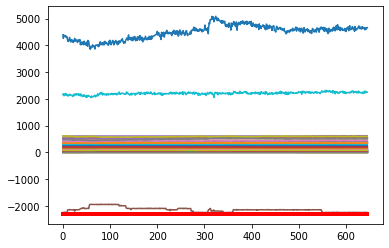

Predicción:  [[[0.99039596 0.00960407]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5679600e+01  1.2655300e+01  5.5679500e+01  7.7459500e+01
  6.2007440e+02  3.3873400e+01  9.6844000e+00  1.8013630e+02
  8.7200000e-02  7.4091300e+01  1.2010510e+02  1.0100900e+01
  6.4646500e+01  1.7805940e+02  2.1427300e+01  1.4088070e+02
  1.8201260e+02  6.9029900e+01 -6.8991000e+00  3.7940000e+00
  1.0507000e+01  7.4917000e+00  1.4990000e+00  7.1762700e+01
  1.4335000e+00  1.5002000e+00  8.2838800e+01  5.9922700e+01
  1.2821000e+00  1.1986000e+00  1.6151000e+00  1.3534000e+00
  1.5482870e+02  8.2810000e-01  8.3060000e-01 -2.2512559e+03
  2.0229430e+02  1.5827000e+00  1.3424000e+00  2.2860331e+03
  4.6143159e+03  1.8481450e+02  1.3810000e+00  1.3770000e+00
  7.8976000e+00  7.8011000e+00  1.7274000e+00  1.1230000e-01
  2.7465900e+01  5.3303330e+02  5.2250530e+02  5.1870120e+02
  5.1923180e+02  5.1955570e+02  2.7710200e+01  2.90

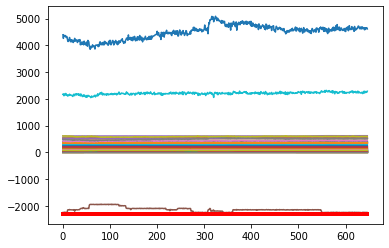

Predicción:  [[[0.98958975 0.01041028]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6121100e+01  1.2758300e+01  5.5457200e+01  7.6639000e+01
  6.1943130e+02  3.4544800e+01  9.7268000e+00  1.7998420e+02
  7.2700000e-02  7.3820900e+01  1.2021390e+02  9.6804000e+00
  6.3869700e+01  1.7816760e+02  2.1371500e+01  1.4013070e+02
  1.8220280e+02  6.9168400e+01 -6.8991000e+00  3.8036000e+00
  1.0512400e+01  7.5000000e+00  1.4984000e+00  7.1825500e+01
  1.4251000e+00  1.4926000e+00  8.3383200e+01  6.0400800e+01
  1.2729000e+00  1.1914000e+00  1.6062000e+00  1.3459000e+00
  1.5395320e+02  8.2810000e-01  8.2950000e-01 -2.2441159e+03
  2.0363150e+02  1.5758000e+00  1.3334000e+00  2.2306813e+03
  4.7278504e+03  1.8481450e+02  1.3728000e+00  1.3688000e+00
  7.9015000e+00  7.7996000e+00  1.7190000e+00  1.1280000e-01
  2.6932900e+01  5.3263340e+02  5.2214200e+02  5.1827330e+02
  5.1864020e+02  5.1904320e+02  2.7989000e+01  2.92

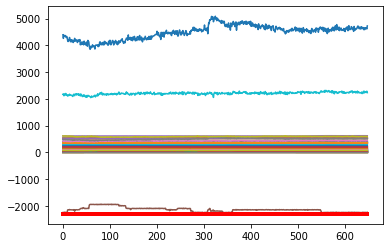

Predicción:  [[[0.99088657 0.00911342]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5626700e+01  1.2536100e+01  5.5159300e+01  7.5841400e+01
  6.2042740e+02  3.4367500e+01  9.7764000e+00  1.8006570e+02
  5.8900000e-02  7.3460900e+01  1.2003570e+02  9.8721000e+00
  5.5913000e+01  1.7805560e+02  2.1476100e+01  1.4146080e+02
  1.8202370e+02  6.9108800e+01 -6.8991000e+00  3.7775000e+00
  1.4141800e+01  7.4950000e+00  1.5003000e+00  7.1802200e+01
  1.4327000e+00  1.5012000e+00  8.3089600e+01  5.9541500e+01
  1.2802000e+00  1.1930000e+00  1.6108000e+00  1.3477000e+00
  1.5363880e+02  8.2810000e-01  8.3040000e-01 -2.2490381e+03
  2.0191800e+02  1.5848000e+00  1.3399000e+00  2.2537245e+03
  4.6863910e+03  1.8481450e+02  1.3752000e+00  1.3707000e+00
  7.8955000e+00  7.7994000e+00  1.7262000e+00  1.1520000e-01
  2.7382800e+01  5.3328220e+02  5.2220590e+02  5.1871590e+02
  5.1896170e+02  5.1933240e+02  2.8151200e+01  2.94

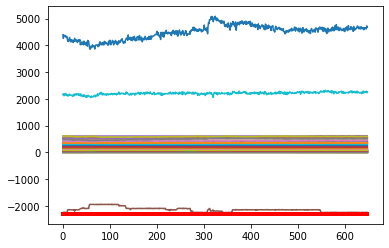

Predicción:  [[[0.99059695 0.00940299]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1012800e+01  1.2653600e+01  5.5362800e+01  7.4786200e+01
  6.2045670e+02  3.3757000e+01  9.7591000e+00  1.8009850e+02
  4.7000000e-02  7.3323100e+01  1.1987120e+02  9.9924000e+00
  6.0190400e+01  1.7852260e+02  2.1025000e+01  1.4385620e+02
  1.8209810e+02  6.8921100e+01 -6.8991000e+00  3.8080000e+00
  1.6671300e+01  7.5037000e+00  1.5000000e+00  7.1779300e+01
  1.4556000e+00  1.5227000e+00  8.2036300e+01  5.9270400e+01
  1.3030000e+00  1.2137000e+00  1.6280000e+00  1.3738000e+00
  1.5568370e+02  8.2720000e-01  8.2990000e-01 -2.2502674e+03
  2.0004460e+02  1.6061000e+00  1.3622000e+00  2.2907446e+03
  4.6763495e+03  1.8481450e+02  1.4010000e+00  1.3960000e+00
  7.9017000e+00  7.7949000e+00  1.7479000e+00  1.1990000e-01
  2.7089400e+01  5.3383330e+02  5.2278990e+02  5.1908470e+02
  5.1933990e+02  5.1965760e+02  2.8711600e+01  2.96

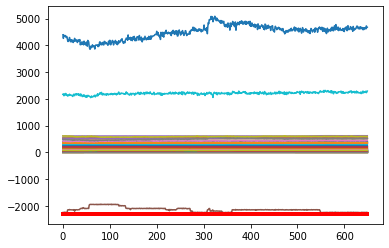

Predicción:  [[[0.99050105 0.00949896]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2457000e+01  1.2519000e+01  5.4205400e+01  7.8095900e+01
  6.1952360e+02  3.3850900e+01  9.7512000e+00  1.8006990e+02
  3.5300000e-02  7.3531700e+01  1.2015090e+02  1.0098900e+01
  6.0126900e+01  1.7505960e+02  2.0488200e+01  1.4227840e+02
  1.8183990e+02  6.9184300e+01 -6.8991000e+00  3.8058000e+00
  1.2660800e+01  7.4709000e+00  1.4998000e+00  7.1835900e+01
  1.4371000e+00  1.5017000e+00  8.2837300e+01  5.9928400e+01
  1.2856000e+00  1.2019000e+00  1.6157000e+00  1.3569000e+00
  1.5721410e+02  8.2730000e-01  8.3060000e-01 -2.2495322e+03
  1.9987040e+02  1.5843000e+00  1.3456000e+00  2.2451075e+03
  4.6147423e+03  1.8481450e+02  1.3829000e+00  1.3798000e+00
  7.8988000e+00  7.8045000e+00  1.7269000e+00  1.1130000e-01
  2.5902700e+01  5.3381560e+02  5.2315430e+02  5.1950130e+02
  5.1968080e+02  5.1999790e+02  2.8341200e+01  2.98

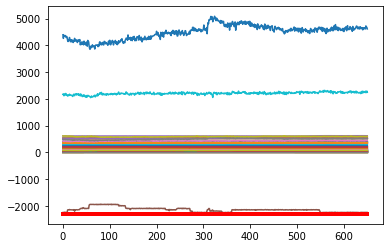

Predicción:  [[[0.9894763  0.01052373]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4071700e+01  1.2506400e+01  5.5466100e+01  7.7407500e+01
  6.2003520e+02  3.3136500e+01  9.7967000e+00  1.7998850e+02
  3.0400000e-02  7.3636800e+01  1.1995020e+02  9.9634000e+00
  5.9828300e+01  1.7394920e+02  2.1006100e+01  1.4101840e+02
  1.8181800e+02  6.9192700e+01 -6.8991000e+00  3.7910000e+00
  1.2411700e+01  7.4976000e+00  1.5020000e+00  7.1793600e+01
  1.4388000e+00  1.5035000e+00  8.3010900e+01  5.9294300e+01
  1.2857000e+00  1.2011000e+00  1.6207000e+00  1.3582000e+00
  1.5777330e+02  8.2800000e-01  8.3020000e-01 -2.2534720e+03
  2.0043720e+02  1.5864000e+00  1.3458000e+00  2.2922135e+03
  4.6120200e+03  1.8481450e+02  1.3840000e+00  1.3807000e+00
  7.9010000e+00  7.8017000e+00  1.7318000e+00  1.1090000e-01
  2.5960100e+01  5.3340210e+02  5.2246420e+02  5.1863230e+02
  5.1890060e+02  5.1915330e+02  2.8249000e+01  2.97

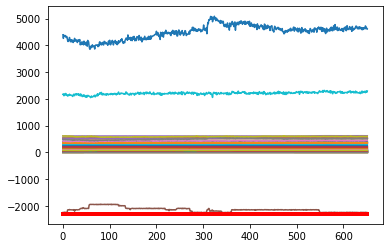

Predicción:  [[[0.98964465 0.01035533]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4803300e+01  1.1822300e+01  5.6477700e+01  7.7019500e+01
  6.2054880e+02  3.1725900e+01  8.8751000e+00  1.7998060e+02
  3.7300000e-02  7.3802900e+01  1.1998300e+02  9.7714000e+00
  5.9259500e+01  1.7284270e+02  2.1400500e+01  1.3899430e+02
  1.8145360e+02  6.8828100e+01 -6.8991000e+00  3.7736000e+00
  1.3024500e+01  7.5380000e+00  1.4996000e+00  7.1912900e+01
  1.4446000e+00  1.5143000e+00  8.4370800e+01  5.9515500e+01
  1.2903000e+00  1.2049000e+00  1.6313000e+00  1.3654000e+00
  1.5902730e+02  8.2750000e-01  8.3130000e-01 -2.2377970e+03
  2.0192590e+02  1.5980000e+00  1.3491000e+00  2.3446577e+03
  4.7463385e+03  1.8481450e+02  1.3915000e+00  1.3884000e+00
  7.9051000e+00  7.8017000e+00  1.7402000e+00  1.0880000e-01
  2.5768800e+01  5.3258120e+02  5.2210840e+02  5.1813010e+02
  5.1827400e+02  5.1860760e+02  2.8837700e+01  3.01

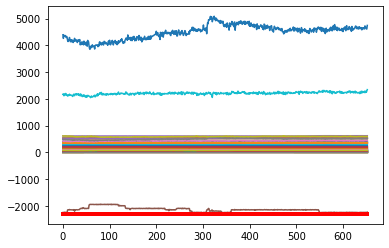

Predicción:  [[[0.99089944 0.00910056]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9367500e+01  1.1408300e+01  5.5530500e+01  7.7023700e+01
  6.2074440e+02  3.2511000e+01  8.3469000e+00  1.8001710e+02
  4.4200000e-02  7.3843900e+01  1.2011520e+02  1.0316300e+01
  5.9656900e+01  1.7326130e+02  2.2089100e+01  1.3993560e+02
  1.8100620e+02  6.9068900e+01 -6.8991000e+00  3.8010000e+00
  1.3353100e+01  7.4800000e+00  1.5016000e+00  7.1785900e+01
  1.4578000e+00  1.5227000e+00  8.2919300e+01  5.8779900e+01
  1.3033000e+00  1.2174000e+00  1.6378000e+00  1.3753000e+00
  1.6012580e+02  8.2800000e-01  8.3020000e-01 -2.2459211e+03
  2.0141830e+02  1.6055000e+00  1.3624000e+00  2.2584761e+03
  4.6339188e+03  1.8481450e+02  1.4011000e+00  1.3979000e+00
  7.9002000e+00  7.8001000e+00  1.7522000e+00  1.1470000e-01
  2.6185100e+01  5.3449640e+02  5.2348630e+02  5.1980240e+02
  5.1998490e+02  5.2022950e+02  2.8967400e+01  3.03

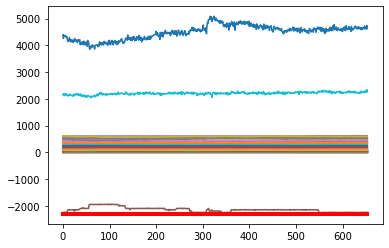

Predicción:  [[[0.9895886  0.01041143]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8014600e+01  1.1426500e+01  5.5631900e+01  7.6507100e+01
  6.2073470e+02  3.4624700e+01  8.3211000e+00  1.8013850e+02
  4.9400000e-02  7.3199200e+01  1.2004530e+02  9.9171000e+00
  5.9444100e+01  1.7385870e+02  2.2148400e+01  1.4096660e+02
  1.8073090e+02  6.9008300e+01 -6.8991000e+00  3.7872000e+00
  1.3163500e+01  7.5039000e+00  1.5004000e+00  7.1816400e+01
  1.4505000e+00  1.5160000e+00  8.2476200e+01  5.9228000e+01
  1.3001000e+00  1.2111000e+00  1.6304000e+00  1.3699000e+00
  1.5889480e+02  8.2780000e-01  8.2930000e-01 -2.2551814e+03
  2.0320330e+02  1.5990000e+00  1.3592000e+00  2.2513777e+03
  4.6582346e+03  1.8481450e+02  1.3966000e+00  1.3928000e+00
  7.9040000e+00  7.8012000e+00  1.7443000e+00  1.1380000e-01
  2.6631700e+01  5.3385690e+02  5.2318480e+02  5.1925630e+02
  5.1953800e+02  5.1970130e+02  2.9131200e+01  3.04

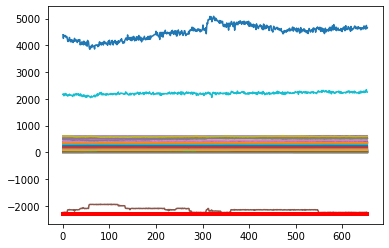

Predicción:  [[[0.9905075  0.00949255]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5493200e+01  1.1342400e+01  5.7269300e+01  7.6925000e+01
  6.2037830e+02  3.4557200e+01  8.3582000e+00  1.7998700e+02
  5.4200000e-02  7.2737800e+01  1.2004590e+02  9.8182000e+00
  5.8996900e+01  1.7390890e+02  2.1519200e+01  1.4175160e+02
  1.8074680e+02  6.8909400e+01 -6.8991000e+00  3.7977000e+00
  1.3258800e+01  7.5006000e+00  1.4992000e+00  7.1846500e+01
  1.4486000e+00  1.5132000e+00  8.2722800e+01  5.8842300e+01
  1.2961000e+00  1.2103000e+00  1.6313000e+00  1.3662000e+00
  1.5719860e+02  8.2830000e-01  8.3090000e-01 -2.2519021e+03
  2.0019490e+02  1.5961000e+00  1.3554000e+00  2.2614717e+03
  4.5929666e+03  1.8481450e+02  1.3932000e+00  1.3890000e+00
  7.8960000e+00  7.8014000e+00  1.7431000e+00  1.1160000e-01
  2.6822500e+01  5.3309780e+02  5.2245920e+02  5.1862510e+02
  5.1899060e+02  5.1923170e+02  2.9155300e+01  3.04

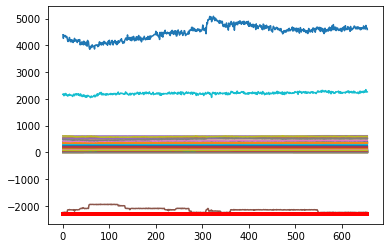

Predicción:  [[[0.9891635  0.01083655]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8911900e+01  1.1219500e+01  5.7516500e+01  7.7736400e+01
  6.1954970e+02  2.9837200e+01  8.3718000e+00  1.7999750e+02
  5.8100000e-02  7.3313500e+01  1.2005710e+02  9.9017000e+00
  6.0024400e+01  1.6888190e+02  2.1642300e+01  1.4190500e+02
  1.8069840e+02  6.8854000e+01 -6.8991000e+00  3.8732000e+00
  1.3194800e+01  7.5028000e+00  1.4999000e+00  7.1817400e+01
  1.4493000e+00  1.5140000e+00  8.2343200e+01  5.8784500e+01
  1.2996000e+00  1.2099000e+00  1.6365000e+00  1.3698000e+00
  1.5869080e+02  8.2780000e-01  8.2950000e-01 -2.2505595e+03
  2.0067730e+02  1.5970000e+00  1.3586000e+00  2.2831279e+03
  4.6455792e+03  1.8481450e+02  1.3976000e+00  1.3928000e+00
  7.9014000e+00  7.8003000e+00  1.7444000e+00  1.0830000e-01
  2.7786500e+01  5.3293550e+02  5.2232670e+02  5.1841510e+02
  5.1879430e+02  5.1892690e+02  2.9137500e+01  3.05

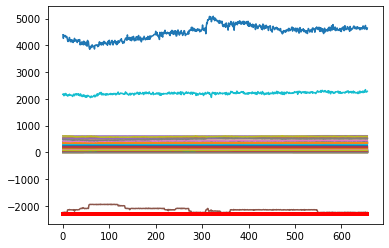

Predicción:  [[[0.9900781  0.00992188]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2786300e+01  1.1093300e+01  5.7216500e+01  7.7519800e+01
  6.1976250e+02  2.9617700e+01  8.3633000e+00  1.7993530e+02
  5.4600000e-02  7.3658500e+01  1.1993600e+02  1.0124900e+01
  5.8686600e+01  1.6916930e+02  2.2164100e+01  1.4226430e+02
  1.8073710e+02  6.9115600e+01 -6.8991000e+00  3.9030000e+00
  1.3898700e+01  7.5136000e+00  1.4998000e+00  7.1768200e+01
  1.4490000e+00  1.5153000e+00  8.1914900e+01  5.9391200e+01
  1.2962000e+00  1.2062000e+00  1.6358000e+00  1.3660000e+00
  1.6123140e+02  8.2840000e-01  8.3060000e-01 -2.2523141e+03
  2.0005000e+02  1.5976000e+00  1.3557000e+00  2.2704724e+03
  4.5706169e+03  1.8481450e+02  1.3929000e+00  1.3891000e+00
  7.8983000e+00  7.7993000e+00  1.7453000e+00  1.0970000e-01
  2.7121200e+01  5.3376340e+02  5.2241440e+02  5.1871870e+02
  5.1914350e+02  5.1923620e+02  2.9121000e+01  3.05

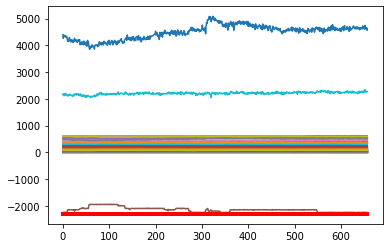

Predicción:  [[[0.98866814 0.01133182]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3708200e+01  1.0987500e+01  5.7309000e+01  7.5825500e+01
  6.2048270e+02  2.9261500e+01  8.3603000e+00  1.7997260e+02
  4.9400000e-02  7.3526900e+01  1.2014070e+02  9.9085000e+00
  5.9212800e+01  1.6938490e+02  2.2002200e+01  1.4078230e+02
  1.8074790e+02  6.8885900e+01 -6.8991000e+00  3.8955000e+00
  1.4509100e+01  7.4928000e+00  1.4992000e+00  7.1758800e+01
  1.4587000e+00  1.5245000e+00  8.3271400e+01  5.8768500e+01
  1.3066000e+00  1.2150000e+00  1.6428000e+00  1.3783000e+00
  1.6222230e+02  8.2800000e-01  8.3000000e-01 -2.2460354e+03
  1.9861830e+02  1.6074000e+00  1.3659000e+00  2.2968381e+03
  4.6517524e+03  1.8481450e+02  1.4057000e+00  1.4014000e+00
  7.8988000e+00  7.7972000e+00  1.7538000e+00  1.1080000e-01
  2.7205600e+01  5.3436890e+02  5.2266360e+02  5.1890260e+02
  5.1935790e+02  5.1956640e+02  2.9109700e+01  3.03

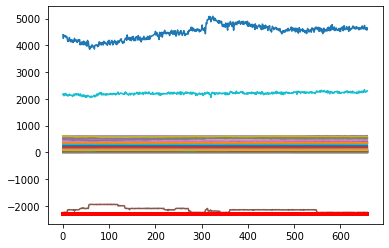

Predicción:  [[[0.9899102  0.01008974]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2779300e+01  1.1103000e+01  5.6994600e+01  7.7720400e+01
  6.2020880e+02  2.6890600e+01  8.5542000e+00  1.8011410e+02
  4.6900000e-02  7.3956000e+01  1.1995950e+02  1.0053100e+01
  5.7120400e+01  1.6573120e+02  2.2253800e+01  1.4022720e+02
  1.8063860e+02  6.8693300e+01 -6.8991000e+00  3.8945000e+00
  1.3173000e+01  7.5143000e+00  1.5001000e+00  7.1816200e+01
  1.4728000e+00  1.5354000e+00  8.2717400e+01  5.8482600e+01
  1.3211000e+00  1.2276000e+00  1.6638000e+00  1.3910000e+00
  1.6462100e+02  8.2830000e-01  8.3030000e-01 -2.2537124e+03
  1.9987110e+02  1.6172000e+00  1.3799000e+00  2.2868605e+03
  4.6102441e+03  1.8481450e+02  1.4190000e+00  1.4155000e+00
  7.9022000e+00  7.7996000e+00  1.7673000e+00  1.0360000e-01
  2.7884000e+01  5.3462280e+02  5.2310220e+02  5.1914460e+02
  5.1959560e+02  5.1986470e+02  2.9065500e+01  3.04

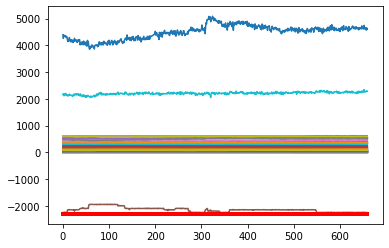

Predicción:  [[[0.9895517  0.01044825]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.1765900e+01  1.0803600e+01  5.6424700e+01  7.7674000e+01
  6.2083410e+02  2.6153400e+01  8.6632000e+00  1.7991620e+02
  6.1700000e-02  7.3687500e+01  1.2010240e+02  9.9068000e+00
  5.5413600e+01  1.6625380e+02  2.2195500e+01  1.4053760e+02
  1.8041310e+02  6.8754600e+01 -6.8991000e+00  3.9067000e+00
  1.5830200e+01  7.5001000e+00  1.5009000e+00  7.1764300e+01
  1.4630000e+00  1.5309000e+00  8.3032500e+01  5.8679800e+01
  1.3121000e+00  1.2125000e+00  1.6525000e+00  1.3815000e+00
  1.6662530e+02  8.2780000e-01  8.2990000e-01 -2.2503900e+03
  1.9972420e+02  1.6139000e+00  1.3709000e+00  2.2975809e+03
  4.6879610e+03  1.8481450e+02  1.4103000e+00  1.4056000e+00
  7.8978000e+00  7.8011000e+00  1.7602000e+00  1.0780000e-01
  2.8566700e+01  5.3380110e+02  5.2267120e+02  5.1839200e+02
  5.1920530e+02  5.1934910e+02  2.9122900e+01  3.05

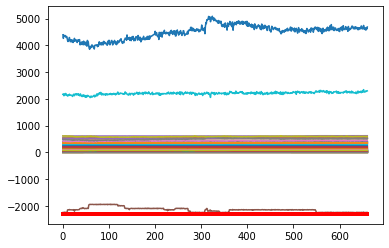

Predicción:  [[[0.9906652  0.00933476]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.9134600e+01  1.1295500e+01  5.8287000e+01  7.7456100e+01
  6.1913660e+02  2.6798200e+01  8.7259000e+00  1.8003030e+02
  7.9700000e-02  7.3487000e+01  1.1961640e+02  9.9788000e+00
  5.4958800e+01  1.6553270e+02  2.2308900e+01  1.4122200e+02
  1.8096020e+02  6.8730800e+01 -6.8991000e+00  3.9872000e+00
  1.7250700e+01  7.4964000e+00  1.5001000e+00  7.1722300e+01
  1.4827000e+00  1.5507000e+00  8.2170500e+01  5.8160700e+01
  1.3302000e+00  1.2309000e+00  1.6700000e+00  1.3993000e+00
  1.6824340e+02  8.2810000e-01  8.3040000e-01 -2.2539856e+03
  1.9833260e+02  1.6337000e+00  1.3882000e+00  2.2894544e+03
  4.7015757e+03  1.8481450e+02  1.4282000e+00  1.4235000e+00
  7.9004000e+00  7.7997000e+00  1.7784000e+00  1.0820000e-01
  2.9285800e+01  5.3397390e+02  5.2219030e+02  5.1811780e+02
  5.1890180e+02  5.1903770e+02  2.9230300e+01  3.05

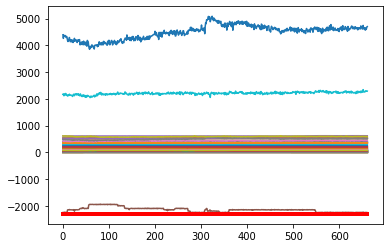

Predicción:  [[[0.99092394 0.00907605]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.4416300e+01  1.1176500e+01  5.6541600e+01  7.8563700e+01
  6.1990520e+02  2.6753000e+01  8.7331000e+00  1.7987050e+02
  9.8900000e-02  7.3908600e+01  1.2016860e+02  1.0017000e+01
  5.4630100e+01  1.6272260e+02  2.2506400e+01  1.4123550e+02
  1.8079390e+02  6.8919500e+01 -6.8991000e+00  3.9874000e+00
  1.5795600e+01  7.5023000e+00  1.5012000e+00  7.1808500e+01
  1.4736000e+00  1.5391000e+00  8.2619400e+01  5.8558100e+01
  1.3239000e+00  1.2189000e+00  1.6638000e+00  1.3921000e+00
  1.7188490e+02  8.2740000e-01  8.2970000e-01 -2.2472652e+03
  1.9775610e+02  1.6225000e+00  1.3822000e+00  2.2799598e+03
  4.6030427e+03  1.8481450e+02  1.4226000e+00  1.4179000e+00
  7.9010000e+00  7.7969000e+00  1.7672000e+00  1.0350000e-01
  3.0462600e+01  5.3424890e+02  5.2302560e+02  5.1874140e+02
  5.1956270e+02  5.1965910e+02  2.9018100e+01  3.04

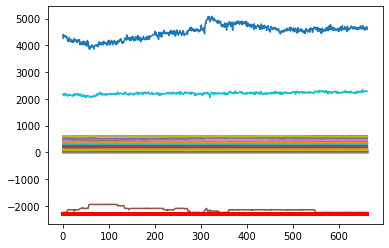

Predicción:  [[[0.9889846  0.01101538]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.3437900e+01  1.1138200e+01  5.6170300e+01  7.6822500e+01
  6.2071190e+02  2.7049200e+01  8.7158000e+00  1.7999160e+02
  9.1100000e-02  7.3632400e+01  1.2009130e+02  1.0073700e+01
  5.4972700e+01  1.6374810e+02  2.2129700e+01  1.4240510e+02
  1.8072990e+02  6.8942500e+01 -6.8991000e+00  3.9997000e+00
  1.7101000e+01  7.4907000e+00  1.4994000e+00  7.1776200e+01
  1.4806000e+00  1.5468000e+00  8.2126000e+01  5.7411700e+01
  1.3307000e+00  1.2242000e+00  1.6706000e+00  1.3957000e+00
  1.7163050e+02  8.2740000e-01  8.3010000e-01 -2.2555158e+03
  1.9910210e+02  1.6286000e+00  1.3887000e+00  2.2988499e+03
  4.6282740e+03  1.8481450e+02  1.4264000e+00  1.4231000e+00
  7.9002000e+00  7.7988000e+00  1.7756000e+00  1.0520000e-01
  3.0424000e+01  5.3474890e+02  5.2283860e+02  5.1865220e+02
  5.1936020e+02  5.1957420e+02  2.8859900e+01  3.01

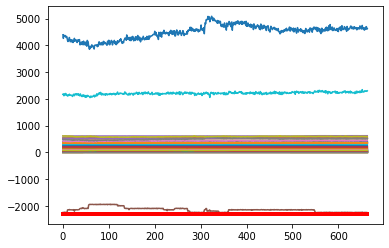

Predicción:  [[[0.9899929  0.01000703]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.5930600e+01  1.1083600e+01  5.6827400e+01  7.8607700e+01
  6.1977320e+02  2.7331400e+01  8.7043000e+00  1.8001240e+02
  6.9600000e-02  7.3863700e+01  1.1986610e+02  1.0177700e+01
  5.4807400e+01  1.6167760e+02  2.2246300e+01  1.4428730e+02
  1.8036240e+02  6.8807500e+01 -6.8991000e+00  4.0025000e+00
  1.4990700e+01  7.5074000e+00  1.5005000e+00  7.1806400e+01
  1.4879000e+00  1.5546000e+00  8.2893400e+01  5.7595800e+01
  1.3355000e+00  1.2306000e+00  1.6799000e+00  1.4066000e+00
  1.7363960e+02  8.2650000e-01  8.3040000e-01 -2.2407651e+03
  1.9956420e+02  1.6377000e+00  1.3930000e+00  2.3039124e+03
  4.7054906e+03  1.8481450e+02  1.4373000e+00  1.4348000e+00
  7.9010000e+00  7.7997000e+00  1.7821000e+00  1.0230000e-01
  3.0592900e+01  5.3451990e+02  5.2305170e+02  5.1901280e+02
  5.1975430e+02  5.1988980e+02  2.8679900e+01  3.01

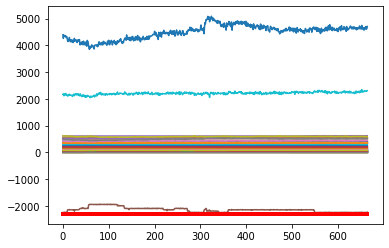

Predicción:  [[[0.9904227  0.00957725]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.6835200e+01  1.0991000e+01  5.6709000e+01  7.7964400e+01
  6.2026290e+02  2.7614200e+01  8.7293000e+00  1.8001330e+02
  4.8100000e-02  7.3658300e+01  1.2002430e+02  9.9721000e+00
  5.4596800e+01  1.6265800e+02  2.2156800e+01  1.4805000e+02
  1.8022800e+02  6.8715200e+01 -6.8991000e+00  4.0024000e+00
  1.6311000e+01  7.4685000e+00  1.5003000e+00  7.1810300e+01
  1.4816000e+00  1.5471000e+00  8.1900400e+01  5.7401300e+01
  1.3316000e+00  1.2238000e+00  1.6706000e+00  1.3959000e+00
  1.7209250e+02  8.2630000e-01  8.3020000e-01 -2.2488155e+03
  1.9994240e+02  1.6293000e+00  1.3892000e+00  2.2738358e+03
  4.5868139e+03  1.8481450e+02  1.4270000e+00  1.4237000e+00
  7.8982000e+00  7.8003000e+00  1.7764000e+00  1.0590000e-01
  3.1019500e+01  5.3414060e+02  5.2254710e+02  5.1832950e+02
  5.1907360e+02  5.1924310e+02  2.8660100e+01  3.00

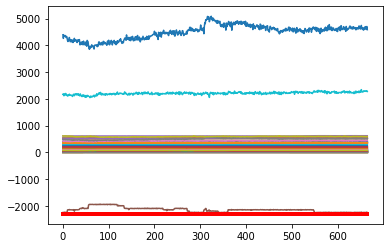

Predicción:  [[[0.9887271  0.01127287]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.6430400e+01  1.1080700e+01  5.5814400e+01  7.8126000e+01
  6.1996420e+02  2.8705300e+01  8.7340000e+00  1.8002750e+02
  2.6600000e-02  7.3587400e+01  1.1998420e+02  1.0205000e+01
  5.5108200e+01  1.6351060e+02  2.2327400e+01  1.4889070e+02
  1.8045780e+02  6.8709100e+01 -6.8991000e+00  4.0107000e+00
  1.6093200e+01  7.5310000e+00  1.5016000e+00  7.1844800e+01
  1.4842000e+00  1.5488000e+00  8.1992300e+01  5.6854900e+01
  1.3361000e+00  1.2279000e+00  1.6705000e+00  1.3975000e+00
  1.7054770e+02  8.2600000e-01  8.3020000e-01 -2.2593664e+03
  2.0059570e+02  1.6305000e+00  1.3941000e+00  2.2845209e+03
  4.6500966e+03  1.8481450e+02  1.4293000e+00  1.4254000e+00
  7.9009000e+00  7.8002000e+00  1.7778000e+00  1.0750000e-01
  3.1767800e+01  5.3459890e+02  5.2282330e+02  5.1892150e+02
  5.1947680e+02  5.1977810e+02  2.8604000e+01  2.99

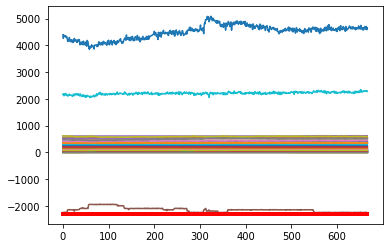

Predicción:  [[[0.9905267  0.00947336]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.7256300e+01  1.1268800e+01  5.6679900e+01  7.8839600e+01
  6.1514160e+02  2.8681100e+01  8.7522000e+00  1.7997380e+02
  1.8200000e-02  7.3694000e+01  1.1992410e+02  9.9623000e+00
  5.5158000e+01  1.6362050e+02  2.2241200e+01  1.4886780e+02
  1.8073520e+02  6.8999500e+01 -6.8991000e+00  4.0144000e+00
  1.4674900e+01  7.4916000e+00  1.5002000e+00  7.1841600e+01
  1.4848000e+00  1.5516000e+00  8.2045000e+01  5.7760600e+01
  1.3360000e+00  1.2302000e+00  1.6754000e+00  1.4022000e+00
  1.7015670e+02  8.2410000e-01  8.2940000e-01 -2.2392134e+03
  1.9833750e+02  1.6338000e+00  1.3935000e+00  2.2725940e+03
  4.6020219e+03  1.8481450e+02  1.4351000e+00  1.4311000e+00
  7.9025000e+00  7.8007000e+00  1.7792000e+00  1.0360000e-01
  3.2661200e+01  5.3509170e+02  5.2387630e+02  5.1974940e+02
  5.2033810e+02  5.2065190e+02  2.8431300e+01  2.99

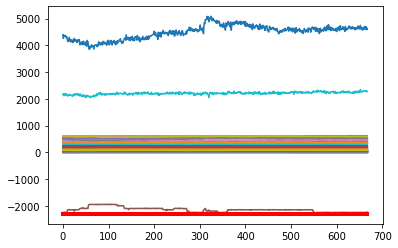

Predicción:  [[[0.9883277  0.01167232]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.7882000e+01  1.1178800e+01  5.6335100e+01  7.9426200e+01
  6.1486000e+02  2.9209300e+01  8.7831000e+00  1.7982370e+02
  2.0600000e-02  7.3541600e+01  1.1998670e+02  1.0285300e+01
  5.5211100e+01  1.6491420e+02  2.2280000e+01  1.4894620e+02
  1.8073110e+02  6.8679600e+01 -6.8991000e+00  4.0130000e+00
  1.4586400e+01  7.5031000e+00  1.5001000e+00  7.1775300e+01
  1.4897000e+00  1.5568000e+00  8.3280000e+01  5.7773800e+01
  1.3389000e+00  1.2320000e+00  1.6784000e+00  1.4027000e+00
  1.7116770e+02  8.2380000e-01  8.3000000e-01 -2.2579444e+03
  1.9889230e+02  1.6396000e+00  1.3965000e+00  2.2795892e+03
  4.6031915e+03  1.8481450e+02  1.4375000e+00  1.4320000e+00
  7.8978000e+00  7.7946000e+00  1.7841000e+00  1.0570000e-01
  3.5080300e+01  5.3616660e+02  5.2432590e+02  5.2035440e+02
  5.2075650e+02  5.2111440e+02  2.8097200e+01  2.95

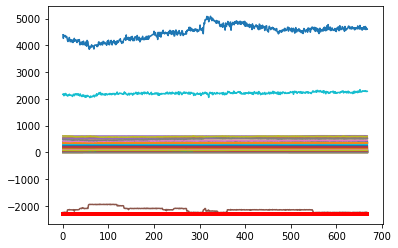

Predicción:  [[[0.9897244  0.01027561]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.9118600e+01  1.1143700e+01  5.5896900e+01  7.8348800e+01
  6.1489050e+02  2.7664800e+01  8.7820000e+00  1.8000150e+02
  2.4100000e-02  7.3722800e+01  1.1994670e+02  9.8532000e+00
  5.4564800e+01  1.6395310e+02  2.1883500e+01  1.4818720e+02
  1.8042600e+02  6.8755700e+01 -6.8991000e+00  3.9976000e+00
  1.5055200e+01  7.5066000e+00  1.5008000e+00  7.1770200e+01
  1.4865000e+00  1.5520000e+00  8.2695000e+01  5.8485200e+01
  1.3376000e+00  1.2247000e+00  1.6716000e+00  1.3977000e+00
  1.7383920e+02  8.2360000e-01  8.2930000e-01 -2.2529999e+03
  1.9966630e+02  1.6344000e+00  1.3961000e+00  2.2419814e+03
  4.5613433e+03  1.8481450e+02  1.4329000e+00  1.4280000e+00
  7.9031000e+00  7.8092000e+00  1.7804000e+00  1.0900000e-01
  3.5544900e+01  5.3534280e+02  5.2399080e+02  5.2013930e+02
  5.2044750e+02  5.2079930e+02  2.7946400e+01  2.94

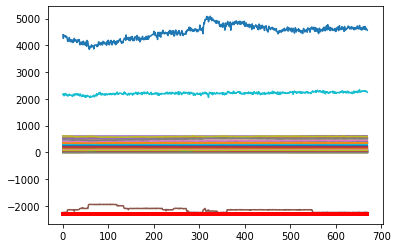

Predicción:  [[[0.9884305  0.01156955]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.0343500e+01  1.0999400e+01  5.6164600e+01  7.7798400e+01
  6.1521140e+02  2.6945200e+01  8.6968000e+00  1.8009780e+02
  3.7500000e-02  7.3782500e+01  1.2004510e+02  1.0040300e+01
  5.4499500e+01  1.6297990e+02  2.1698300e+01  1.5040340e+02
  1.8036150e+02  6.8740000e+01 -6.8991000e+00  3.9058000e+00
  1.6459800e+01  7.4967000e+00  1.5003000e+00  7.1851000e+01
  1.4875000e+00  1.5559000e+00  8.2905600e+01  5.7421700e+01
  1.3391000e+00  1.2244000e+00  1.6789000e+00  1.3991000e+00
  1.7345760e+02  8.2440000e-01  8.3040000e-01 -2.2450918e+03
  1.9969530e+02  1.6388000e+00  1.3966000e+00  2.2899862e+03
  4.7082637e+03  1.8481450e+02  1.4348000e+00  1.4278000e+00
  7.8981000e+00  7.7996000e+00  1.7832000e+00  1.0450000e-01
  3.5431900e+01  5.3491780e+02  5.2335000e+02  5.1974330e+02
  5.2010000e+02  5.2040090e+02  2.7490500e+01  2.90

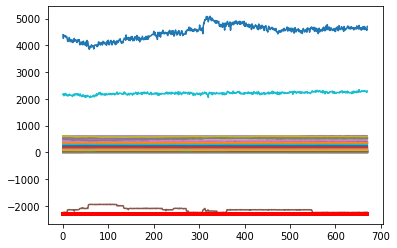

Predicción:  [[[0.99067104 0.00932892]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.1679900e+01  1.1056500e+01  5.4653300e+01  7.9010200e+01
  6.1453520e+02  2.6018500e+01  8.6851000e+00  1.7998870e+02
  4.7900000e-02  7.3925500e+01  1.1983730e+02  1.0225500e+01
  5.4556900e+01  1.6183140e+02  2.2061200e+01  1.5247200e+02
  1.8012910e+02  6.8842700e+01 -6.8991000e+00  3.8943000e+00
  1.5650800e+01  7.5044000e+00  1.4996000e+00  7.1798300e+01
  1.4923000e+00  1.5594000e+00  8.3254800e+01  5.8467600e+01
  1.3424000e+00  1.2328000e+00  1.6793000e+00  1.4072000e+00
  1.7277430e+02  8.2360000e-01  8.2990000e-01 -2.2489506e+03
  1.9816270e+02  1.6419000e+00  1.4005000e+00  2.2704947e+03
  4.6505980e+03  1.8481450e+02  1.4418000e+00  1.4381000e+00
  7.9004000e+00  7.8004000e+00  1.7868000e+00  1.0770000e-01
  3.4441500e+01  5.3617280e+02  5.2439630e+02  5.2031760e+02
  5.2098120e+02  5.2124690e+02  2.7338100e+01  2.88

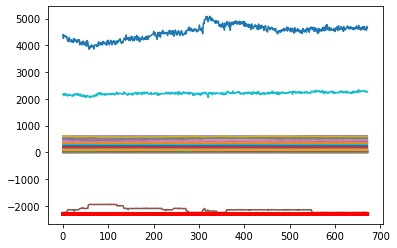

Predicción:  [[[0.99007064 0.00992938]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.2875000e+01  1.1033000e+01  5.5552200e+01  7.9405700e+01
  6.1464510e+02  2.7217000e+01  8.7019000e+00  1.7999350e+02
  4.4600000e-02  7.3992100e+01  1.2009620e+02  9.8866000e+00
  5.4700900e+01  1.6253370e+02  2.2195400e+01  1.5363050e+02
  1.7987690e+02  6.8715900e+01 -6.8991000e+00  3.9033000e+00
  1.4949900e+01  7.5216000e+00  1.5006000e+00  7.1787300e+01
  1.4882000e+00  1.5530000e+00  8.1177400e+01  5.8897700e+01
  1.3383000e+00  1.2294000e+00  1.6722000e+00  1.3969000e+00
  1.7073610e+02  8.2550000e-01  8.2980000e-01 -2.2484636e+03
  2.0312760e+02  1.6359000e+00  1.3971000e+00  2.2816155e+03
  4.4990990e+03  1.8481450e+02  1.4287000e+00  1.4271000e+00
  7.9014000e+00  7.8017000e+00  1.7817000e+00  1.0950000e-01
  3.2175700e+01  5.3585120e+02  5.2468740e+02  5.2010190e+02
  5.2088620e+02  5.2111010e+02  2.7508100e+01  2.89

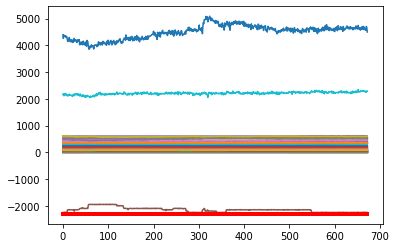

Predicción:  [[[0.9863944  0.01360562]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.8505300e+01  1.1122400e+01  5.5401800e+01  7.7587100e+01
  6.1421960e+02  2.7396200e+01  8.6844000e+00  1.7987330e+02
  3.6700000e-02  7.4100100e+01  1.1999300e+02  9.7563000e+00
  5.9349700e+01  1.6232630e+02  2.1938500e+01  1.5408210e+02
  1.7989650e+02  6.8936600e+01 -6.8991000e+00  3.9073000e+00
  1.3992400e+01  7.4825000e+00  1.4986000e+00  7.1811000e+01
  1.4779000e+00  1.5444000e+00  8.2261800e+01  5.9338200e+01
  1.3261000e+00  1.2216000e+00  1.6657000e+00  1.3910000e+00
  1.6899100e+02  8.2390000e-01  8.3050000e-01 -2.2551623e+03
  1.9953440e+02  1.6258000e+00  1.3857000e+00  2.2474407e+03
  4.6334813e+03  1.8481450e+02  1.4223000e+00  1.4211000e+00
  7.9003000e+00  7.7996000e+00  1.7726000e+00  1.0690000e-01
  3.1378500e+01  5.3404280e+02  5.2330240e+02  5.1881340e+02
  5.1964960e+02  5.1991610e+02  2.7478900e+01  2.89

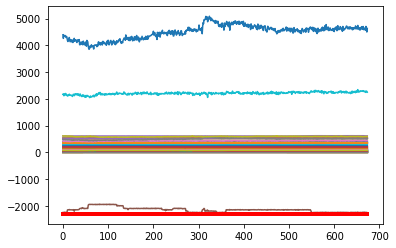

Predicción:  [[[0.99013454 0.0098655 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.5316400e+01  1.1337000e+01  5.4739800e+01  7.8384300e+01
  6.1460270e+02  2.7632000e+01  8.6942000e+00  1.7989280e+02
  4.7700000e-02  7.4922600e+01  1.2015410e+02  9.9683000e+00
  6.0265700e+01  1.6133710e+02  2.2009000e+01  1.5161060e+02
  1.8029240e+02  6.9099500e+01 -6.8991000e+00  3.9245000e+00
  9.3636000e+00  7.5266000e+00  1.4987000e+00  7.1798200e+01
  1.4829000e+00  1.5487000e+00  8.2338100e+01  5.9444700e+01
  1.3324000e+00  1.2276000e+00  1.6755000e+00  1.3979000e+00
  1.7112790e+02  8.2400000e-01  8.2920000e-01 -2.2553176e+03
  2.0065030e+02  1.6313000e+00  1.3915000e+00  2.2513852e+03
  4.6400488e+03  1.8481450e+02  1.4278000e+00  1.4277000e+00
  7.9026000e+00  7.7995000e+00  1.7777000e+00  1.0210000e-01
  3.0052600e+01  5.3412600e+02  5.2323180e+02  5.1884020e+02
  5.1974060e+02  5.1997910e+02  2.7366700e+01  2.88

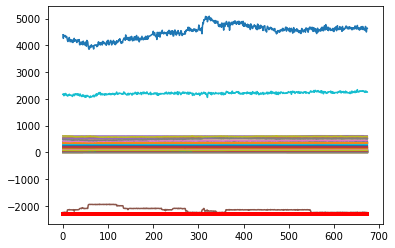

Predicción:  [[[0.99017066 0.00982933]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.2833400e+01  1.1455500e+01  5.5450400e+01  7.8335000e+01
  6.1458530e+02  2.7172000e+01  8.6931000e+00  1.8000690e+02
  5.9900000e-02  7.4771200e+01  1.1987900e+02  1.0064100e+01
  5.9053300e+01  1.6468540e+02  2.1645600e+01  1.5124860e+02
  1.8049160e+02  6.9315500e+01 -6.8991000e+00  3.8891000e+00
  1.2171200e+01  7.5046000e+00  1.5005000e+00  7.1786200e+01
  1.4767000e+00  1.5424000e+00  8.2269500e+01  5.9575900e+01
  1.3271000e+00  1.2228000e+00  1.6691000e+00  1.3911000e+00
  1.6977430e+02  8.2770000e-01  8.3150000e-01 -2.2564959e+03
  2.0095750e+02  1.6246000e+00  1.3867000e+00  2.2410991e+03
  4.5818129e+03  1.8481450e+02  1.4203000e+00  1.4209000e+00
  7.8942000e+00  7.7914000e+00  1.7741000e+00  1.0480000e-01
  2.9422000e+01  5.3409890e+02  5.2356580e+02  5.1911800e+02
  5.1976490e+02  5.2013290e+02  2.8345500e+01  2.93

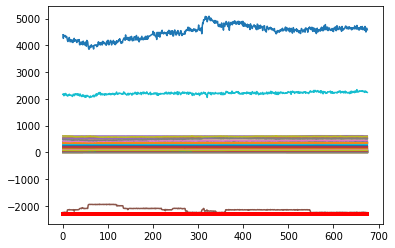

Predicción:  [[[0.9891565  0.01084346]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.1083700e+01  1.1482500e+01  5.4422500e+01  7.8000500e+01
  6.1508170e+02  2.6968200e+01  8.6854000e+00  1.7989240e+02
  7.2200000e-02  7.4752500e+01  1.2000400e+02  1.0021100e+01
  5.9488900e+01  1.6405210e+02  2.0144200e+01  1.4876940e+02
  1.8057830e+02  6.8777500e+01 -6.8991000e+00  3.8802000e+00
  1.2735200e+01  7.4864000e+00  1.4987000e+00  7.1797300e+01
  1.4806000e+00  1.5469000e+00  8.1914200e+01  5.9745300e+01
  1.3306000e+00  1.2263000e+00  1.6682000e+00  1.3963000e+00
  1.7037830e+02  8.2330000e-01  8.2860000e-01 -2.2517427e+03
  2.0351390e+02  1.6289000e+00  1.3903000e+00  2.2441883e+03
  4.5195383e+03  1.8481450e+02  1.4259000e+00  1.4257000e+00
  7.8999000e+00  7.8051000e+00  1.7766000e+00  1.0840000e-01
  2.9523500e+01  5.3513110e+02  5.2406660e+02  5.1984680e+02
  5.2036660e+02  5.2082170e+02  2.7616000e+01  2.92

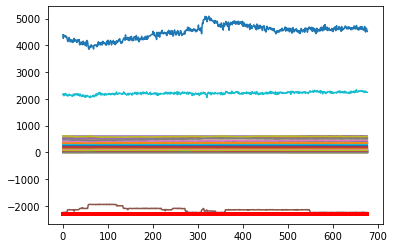

Predicción:  [[[0.98732275 0.01267723]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.1563900e+01  1.1420700e+01  5.4799800e+01  7.9010600e+01
  6.1554650e+02  2.7257500e+01  8.7154000e+00  1.7997280e+02
  8.5900000e-02  7.5019000e+01  1.2011280e+02  9.9780000e+00
  5.9433200e+01  1.6289640e+02  2.0672500e+01  1.4676830e+02
  1.8038750e+02  6.9068200e+01 -6.8991000e+00  3.9037000e+00
  1.0957900e+01  7.5185000e+00  1.4999000e+00  7.1770600e+01
  1.4784000e+00  1.5442000e+00  8.2472600e+01  5.9854300e+01
  1.3274000e+00  1.2238000e+00  1.6662000e+00  1.3931000e+00
  1.7110020e+02  8.2480000e-01  8.3010000e-01 -2.2540469e+03
  1.9930900e+02  1.6259000e+00  1.3876000e+00  2.2361858e+03
  4.5714622e+03  1.8481450e+02  1.4228000e+00  1.4227000e+00
  7.9026000e+00  7.8028000e+00  1.7739000e+00  1.0780000e-01
  2.9948900e+01  5.3511990e+02  5.2428610e+02  5.1978930e+02
  5.2027440e+02  5.2079770e+02  2.7425700e+01  2.89

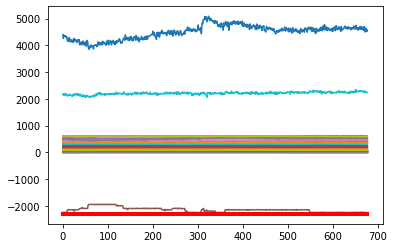

Predicción:  [[[0.9887579  0.01124215]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.8848100e+01  1.1508900e+01  5.5532200e+01  7.9118000e+01
  6.1575110e+02  2.6972800e+01  8.7137000e+00  1.8010250e+02
  1.0400000e-01  7.9034600e+01  1.1989420e+02  9.7958000e+00
  5.9331200e+01  1.6729180e+02  2.0714200e+01  1.4757990e+02
  1.8066560e+02  6.9119700e+01 -6.8991000e+00  3.8993000e+00
  1.2656600e+01  7.5087000e+00  1.5015000e+00  7.1760100e+01
  1.4718000e+00  1.5399000e+00  8.2748200e+01  5.9701600e+01
  1.3223000e+00  1.2193000e+00  1.6526000e+00  1.3857000e+00
  1.6831790e+02  8.2400000e-01  8.3050000e-01 -2.2518274e+03
  2.0115860e+02  1.6227000e+00  1.3823000e+00  2.2377137e+03
  4.5695995e+03  1.8481450e+02  1.4151000e+00  1.4144000e+00
  7.9018000e+00  7.8014000e+00  1.7675000e+00  1.1470000e-01
  2.9737400e+01  5.3364900e+02  5.2316720e+02  5.1872170e+02
  5.1919970e+02  5.1974470e+02  2.7843800e+01  2.92

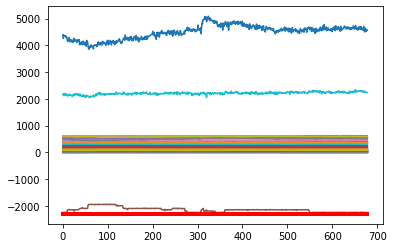

Predicción:  [[[0.9885932  0.01140673]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4394300e+01  1.1631700e+01  5.5558800e+01  7.9506400e+01
  6.1395220e+02  2.7108000e+01  8.6952000e+00  1.8011400e+02
  1.2130000e-01  8.2413700e+01  1.2000840e+02  9.8306000e+00
  6.0010000e+01  1.7069000e+02  2.1119900e+01  1.5061090e+02
  1.8091640e+02  6.9122600e+01 -6.8991000e+00  3.9003000e+00
  1.1611300e+01  7.5033000e+00  1.5013000e+00  7.1778200e+01
  1.4733000e+00  1.5416000e+00  8.3125800e+01  5.9617100e+01
  1.3232000e+00  1.2261000e+00  1.6514000e+00  1.3894000e+00
  1.6413160e+02  8.2410000e-01  8.3040000e-01 -2.2513787e+03
  2.0026610e+02  1.6245000e+00  1.3828000e+00  2.2621875e+03
  4.6147063e+03  1.8481450e+02  1.4184000e+00  1.4175000e+00
  7.8986000e+00  7.7986000e+00  1.7681000e+00  1.1680000e-01
  2.8931400e+01  5.3466660e+02  5.2357330e+02  5.1940610e+02
  5.1990990e+02  5.2044950e+02  2.8022400e+01  2.94

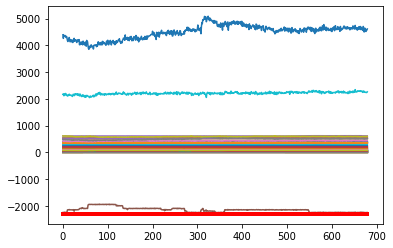

Predicción:  [[[0.9895779  0.01042218]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2446000e+01  1.1753000e+01  5.5549400e+01  7.9431900e+01
  6.1543940e+02  2.7313500e+01  8.6980000e+00  1.7990580e+02
  1.2240000e-01  8.2502300e+01  1.1989760e+02  1.0011100e+01
  6.0311000e+01  1.7099180e+02  2.1699000e+01  1.5377440e+02
  1.8086740e+02  6.9148200e+01 -6.8991000e+00  3.9055000e+00
  1.1154400e+01  7.4853000e+00  1.4998000e+00  7.1820700e+01
  1.4713000e+00  1.5396000e+00  8.3111800e+01  6.0388400e+01
  1.3236000e+00  1.2271000e+00  1.6501000e+00  1.3891000e+00
  1.6206890e+02  8.2420000e-01  8.2930000e-01 -2.2472979e+03
  2.0113870e+02  1.6222000e+00  1.3837000e+00  2.2287058e+03
  4.6263951e+03  1.8481450e+02  1.4175000e+00  1.4169000e+00
  7.9027000e+00  7.8021000e+00  1.7656000e+00  1.1560000e-01
  2.8430000e+01  5.3503560e+02  5.2416030e+02  5.1984440e+02
  5.2041810e+02  5.2081840e+02  2.7930800e+01  2.95

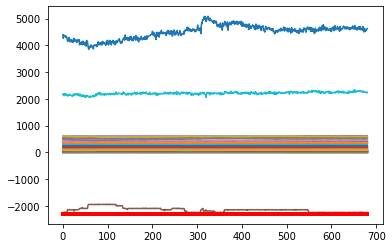

Predicción:  [[[0.9895671  0.01043285]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1054600e+01  1.1805500e+01  5.6804800e+01  7.9025700e+01
  6.1372070e+02  2.7127400e+01  8.6912000e+00  1.7996160e+02
  1.1830000e-01  8.2219000e+01  1.2008440e+02  9.9954000e+00
  6.0045900e+01  1.7211250e+02  2.1195900e+01  1.5567930e+02
  1.8092140e+02  6.9306800e+01 -6.8991000e+00  3.8949000e+00
  1.1529400e+01  7.5129000e+00  1.4995000e+00  7.1840900e+01
  1.4613000e+00  1.5291000e+00  8.2516300e+01  6.0857200e+01
  1.3116000e+00  1.2199000e+00  1.6387000e+00  1.3797000e+00
  1.5988890e+02  8.2520000e-01  8.3040000e-01 -2.2454710e+03
  2.0201850e+02  1.6124000e+00  1.3725000e+00  2.2694121e+03
  4.6755725e+03  1.8481450e+02  1.4073000e+00  1.4063000e+00
  7.9018000e+00  7.8005000e+00  1.7562000e+00  1.1730000e-01
  2.7688000e+01  5.3434060e+02  5.2376620e+02  5.1948890e+02
  5.2013980e+02  5.2043220e+02  2.8057400e+01  2.96

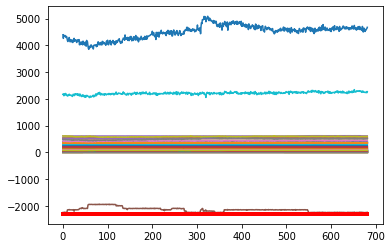

Predicción:  [[[0.9902924  0.00970764]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9390300e+01  1.1776500e+01  5.6545400e+01  7.8560000e+01
  6.1438830e+02  2.7372900e+01  8.7116000e+00  1.7991930e+02
  1.1710000e-01  8.2017200e+01  1.2004410e+02  9.7694000e+00
  6.0594600e+01  1.7243690e+02  2.1221100e+01  1.5565590e+02
  1.8099100e+02  6.9312800e+01 -6.8991000e+00  3.9112000e+00
  1.1864400e+01  7.5179000e+00  1.4993000e+00  7.1783600e+01
  1.4606000e+00  1.5286000e+00  8.2199400e+01  6.0855900e+01
  1.3107000e+00  1.2198000e+00  1.6372000e+00  1.3756000e+00
  1.5868410e+02  8.2410000e-01  8.2990000e-01 -2.2598208e+03
  2.0229990e+02  1.6114000e+00  1.3707000e+00  2.2829412e+03
  4.6668176e+03  1.8481450e+02  1.4028000e+00  1.4023000e+00
  7.8952000e+00  7.8002000e+00  1.7549000e+00  1.1770000e-01
  2.7642700e+01  5.3371550e+02  5.2329870e+02  5.1895250e+02
  5.1958340e+02  5.1992600e+02  2.7988900e+01  2.96

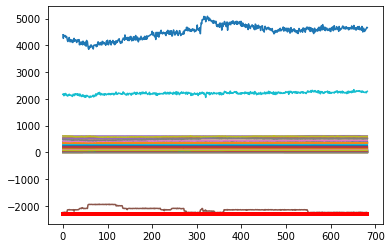

Predicción:  [[[0.99074394 0.00925612]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7917700e+01  1.1733200e+01  5.6664000e+01  7.8900000e+01
  6.1377930e+02  2.7708400e+01  8.7021000e+00  1.8003210e+02
  1.1960000e-01  8.2123800e+01  1.1993160e+02  9.8063000e+00
  6.0041700e+01  1.7193790e+02  2.1368100e+01  1.5620710e+02
  1.8102580e+02  6.9150400e+01 -6.8991000e+00  3.9026000e+00
  1.1131300e+01  7.5076000e+00  1.4999000e+00  7.1791700e+01
  1.4636000e+00  1.5301000e+00  8.3268300e+01  6.0412600e+01
  1.3138000e+00  1.2227000e+00  1.6391000e+00  1.3817000e+00
  1.5881850e+02  8.2430000e-01  8.2950000e-01 -2.2553845e+03
  1.9997970e+02  1.6142000e+00  1.3741000e+00  2.2265233e+03
  4.6220522e+03  1.8481450e+02  1.4099000e+00  1.4089000e+00
  7.8989000e+00  7.7981000e+00  1.7569000e+00  1.1770000e-01
  2.8194300e+01  5.3405720e+02  5.2326950e+02  5.1910630e+02
  5.1962130e+02  5.2001950e+02  2.7801300e+01  2.95

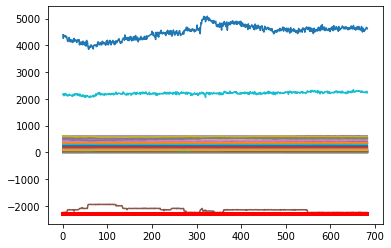

Predicción:  [[[0.9899685  0.01003148]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8181300e+01  1.1805000e+01  5.6767800e+01  7.9537100e+01
  6.1547520e+02  2.7972000e+01  8.7030000e+00  1.7997570e+02
  1.2240000e-01  8.2619700e+01  1.2012640e+02  1.0038700e+01
  5.9965800e+01  1.7355010e+02  2.1867700e+01  1.5667250e+02
  1.8119610e+02  6.9249800e+01 -6.8991000e+00  3.9042000e+00
  1.1116400e+01  7.4792000e+00  1.4982000e+00  7.1791300e+01
  1.4681000e+00  1.5358000e+00  8.3151700e+01  6.0717200e+01
  1.3169000e+00  1.2286000e+00  1.6432000e+00  1.3857000e+00
  1.5857880e+02  8.2430000e-01  8.3070000e-01 -2.2481998e+03
  2.0244050e+02  1.6193000e+00  1.3775000e+00  2.2662756e+03
  4.6662979e+03  1.8481450e+02  1.4132000e+00  1.4125000e+00
  7.9025000e+00  7.7997000e+00  1.7623000e+00  1.1900000e-01
  2.7687200e+01  5.3495730e+02  5.2423510e+02  5.1982250e+02
  5.2029680e+02  5.2077510e+02  2.7651700e+01  2.94

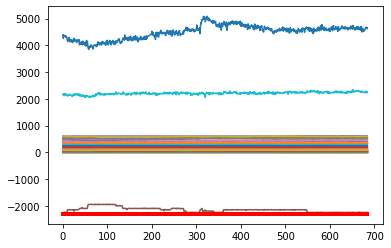

Predicción:  [[[0.9902856  0.00971446]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8568500e+01  1.1746000e+01  5.6871200e+01  7.8786000e+01
  6.1504230e+02  2.7606600e+01  8.7139000e+00  1.7995360e+02
  1.3060000e-01  8.2851900e+01  1.2018700e+02  1.0082800e+01
  6.0370300e+01  1.7370000e+02  2.2065000e+01  1.5519930e+02
  1.8091350e+02  6.9286700e+01 -6.8991000e+00  3.8986000e+00
  1.0946200e+01  7.5254000e+00  1.4996000e+00  7.1839900e+01
  1.4607000e+00  1.5287000e+00  8.4181300e+01  6.0943800e+01
  1.3129000e+00  1.2222000e+00  1.6348000e+00  1.3807000e+00
  1.5768120e+02  8.2340000e-01  8.2960000e-01 -2.2443835e+03
  2.0130510e+02  1.6125000e+00  1.3738000e+00  2.1862194e+03
  4.6917300e+03  1.8481450e+02  1.4078000e+00  1.4074000e+00
  7.9002000e+00  7.8002000e+00  1.7548000e+00  1.2010000e-01
  2.7232400e+01  5.3475330e+02  5.2432600e+02  5.1989170e+02
  5.2034370e+02  5.2080860e+02  2.7691600e+01  2.93

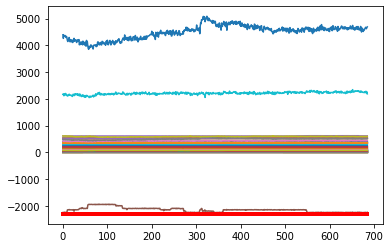

Predicción:  [[[0.99046105 0.00953891]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8476200e+01  1.1781700e+01  5.5951600e+01  7.6654300e+01
  6.1590810e+02  2.7621100e+01  8.7364000e+00  1.7991410e+02
  1.2890000e-01  8.2293600e+01  1.1992300e+02  9.9071000e+00
  5.9912000e+01  1.7435170e+02  2.1858800e+01  1.5352840e+02
  1.8100050e+02  6.9351200e+01 -6.8991000e+00  3.8919000e+00
  1.4010100e+01  7.4843000e+00  1.4984000e+00  7.1785600e+01
  1.4447000e+00  1.5141000e+00  8.2418700e+01  6.0996100e+01
  1.2961000e+00  1.2060000e+00  1.6147000e+00  1.3637000e+00
  1.5718520e+02  8.2380000e-01  8.2990000e-01 -2.2510094e+03
  2.0121090e+02  1.5974000e+00  1.3572000e+00  2.2202672e+03
  4.6437951e+03  1.8481450e+02  1.3907000e+00  1.3904000e+00
  7.9002000e+00  7.8001000e+00  1.7390000e+00  1.2440000e-01
  2.6903100e+01  5.3365610e+02  5.2319200e+02  5.1894410e+02
  5.1942420e+02  5.1991120e+02  2.7741300e+01  2.92

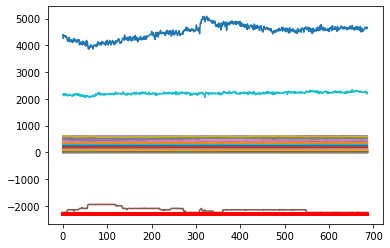

Predicción:  [[[0.9900994  0.00990067]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6966200e+01  1.1882600e+01  5.5740800e+01  7.6371200e+01
  6.1508680e+02  2.8147300e+01  8.7480000e+00  1.8013290e+02
  1.3450000e-01  8.2583600e+01  1.1991970e+02  9.8968000e+00
  6.0111900e+01  1.7347960e+02  2.2100200e+01  1.5167710e+02
  1.8114610e+02  6.9337700e+01 -6.8991000e+00  3.9022000e+00
  1.1581200e+01  7.4930000e+00  1.5000000e+00  7.1733600e+01
  1.4628000e+00  1.5307000e+00  8.3527800e+01  6.0587100e+01
  1.3101000e+00  1.2242000e+00  1.6340000e+00  1.3826000e+00
  1.5802740e+02  8.2650000e-01  8.3010000e-01 -2.2559792e+03
  2.0220920e+02  1.6141000e+00  1.3708000e+00  2.1935589e+03
  4.6374252e+03  1.8481450e+02  1.4095000e+00  1.4087000e+00
  7.9002000e+00  7.7989000e+00  1.7557000e+00  1.2220000e-01
  2.6829500e+01  5.3427710e+02  5.2340420e+02  5.1925260e+02
  5.1992450e+02  5.2026710e+02  2.7894000e+01  2.95

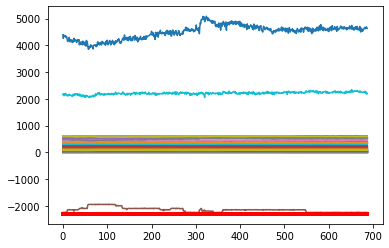

Predicción:  [[[0.9902478  0.00975221]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5851500e+01  1.1985400e+01  5.7403400e+01  7.9567100e+01
  6.1542220e+02  2.7825600e+01  8.7211000e+00  1.8002480e+02
  1.3290000e-01  8.3044700e+01  1.1986510e+02  9.9762000e+00
  5.9856000e+01  1.7335000e+02  2.2535300e+01  1.4952340e+02
  1.8128990e+02  6.9010600e+01 -6.8991000e+00  3.8785000e+00
  1.0174500e+01  7.5267000e+00  1.4989000e+00  7.1801000e+01
  1.4689000e+00  1.5365000e+00  8.3415500e+01  6.0210100e+01
  1.3203000e+00  1.2302000e+00  1.6419000e+00  1.3879000e+00
  1.5863440e+02  8.2710000e-01  8.3000000e-01 -2.2513616e+03
  2.0014180e+02  1.6203000e+00  1.3802000e+00  2.2993746e+03
  4.6598219e+03  1.8481450e+02  1.4139000e+00  1.4136000e+00
  7.8983000e+00  7.7972000e+00  1.7625000e+00  1.2060000e-01
  2.6226300e+01  5.3421450e+02  5.2363320e+02  5.1921410e+02
  5.1993400e+02  5.2035560e+02  2.8010000e+01  2.97

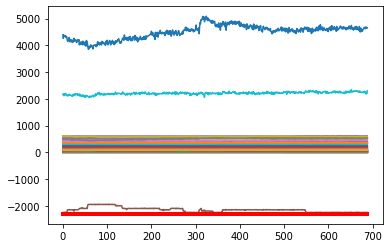

Predicción:  [[[0.99033725 0.00966273]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7194800e+01  1.1936300e+01  5.7111300e+01  7.9544400e+01
  6.1597150e+02  2.7617500e+01  8.7179000e+00  1.7993560e+02
  1.1600000e-01  8.3080000e+01  1.1998600e+02  9.9443000e+00
  5.9879600e+01  1.7453550e+02  2.2570200e+01  1.4770370e+02
  1.8139150e+02  6.9130100e+01 -6.8991000e+00  3.9134000e+00
  1.1972400e+01  7.4936000e+00  1.4998000e+00  7.1786400e+01
  1.4632000e+00  1.5310000e+00  8.2740400e+01  6.0461000e+01
  1.3155000e+00  1.2258000e+00  1.6334000e+00  1.3830000e+00
  1.5759070e+02  8.2740000e-01  8.3020000e-01 -2.2480253e+03
  2.0146790e+02  1.6144000e+00  1.3756000e+00  2.2591445e+03
  4.5625282e+03  1.8481450e+02  1.4088000e+00  1.4078000e+00
  7.9017000e+00  7.7975000e+00  1.7590000e+00  1.2540000e-01
  2.5882900e+01  5.3509160e+02  5.2399710e+02  5.1976420e+02
  5.2049070e+02  5.2099950e+02  2.8252700e+01  2.97

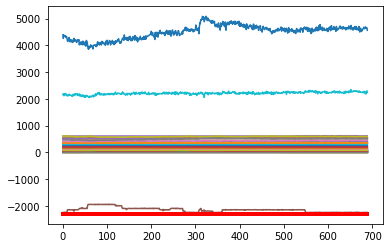

Predicción:  [[[0.98805773 0.01194234]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5865700e+01  1.1913800e+01  5.6429600e+01  7.7306000e+01
  6.1636380e+02  2.7929200e+01  8.6521000e+00  1.8005240e+02
  1.0020000e-01  8.2985800e+01  1.2018520e+02  9.8732000e+00
  5.9667600e+01  1.7565990e+02  2.2350800e+01  1.4533520e+02
  1.8140000e+02  6.9170500e+01 -6.8991000e+00  3.8907000e+00
  1.2659800e+01  7.5121000e+00  1.5015000e+00  7.1775200e+01
  1.4531000e+00  1.5209000e+00  8.2645600e+01  5.9743100e+01
  1.3063000e+00  1.2171000e+00  1.6199000e+00  1.3741000e+00
  1.5685920e+02  8.2790000e-01  8.3000000e-01 -2.2501240e+03
  1.9986660e+02  1.6037000e+00  1.3663000e+00  2.2945851e+03
  4.6543866e+03  1.8481450e+02  1.4028000e+00  1.3949000e+00
  7.9011000e+00  7.7993000e+00  1.7477000e+00  1.2800000e-01
  2.8501700e+01  5.3405730e+02  5.2390630e+02  5.1928730e+02
  5.2003140e+02  5.2050090e+02  2.8548100e+01  2.99

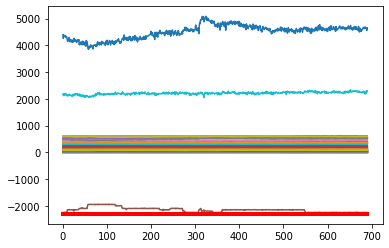

Predicción:  [[[0.99018914 0.00981082]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7177400e+01  1.1939000e+01  5.7164100e+01  7.5640700e+01
  6.1443090e+02  2.7980400e+01  8.7204000e+00  1.8012520e+02
  8.4400000e-02  8.2806200e+01  1.2009720e+02  1.0108000e+01
  6.0153500e+01  1.7553440e+02  2.2191600e+01  1.4417070e+02
  1.8146950e+02  6.9232800e+01 -6.8991000e+00  3.8959000e+00
  1.3622600e+01  7.5126000e+00  1.5003000e+00  7.1837900e+01
  1.4501000e+00  1.5177000e+00  8.3649700e+01  6.0114300e+01
  1.3046000e+00  1.2139000e+00  1.6161000e+00  1.3700000e+00
  1.5521480e+02  8.2790000e-01  8.2960000e-01 -2.2540899e+03
  2.0022750e+02  1.6005000e+00  1.3640000e+00  2.2519253e+03
  4.5502392e+03  1.8481450e+02  1.3980000e+00  1.3950000e+00
  7.8978000e+00  7.8000000e+00  1.7441000e+00  1.2780000e-01
  2.8085300e+01  5.3369390e+02  5.2322240e+02  5.1882550e+02
  5.1962170e+02  5.2004690e+02  2.8176300e+01  3.00

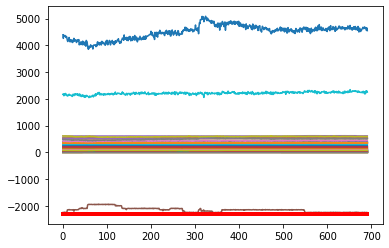

Predicción:  [[[0.9883349  0.01166517]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6030400e+01  1.1973400e+01  5.7710300e+01  7.6741800e+01
  6.1540770e+02  2.8054400e+01  8.7134000e+00  1.8006450e+02
  7.3000000e-02  8.3313400e+01  1.1984380e+02  9.9925000e+00
  6.0214100e+01  1.7433410e+02  2.2626100e+01  1.4588010e+02
  1.8148970e+02  6.9056800e+01 -6.8991000e+00  3.9060000e+00
  1.1712500e+01  7.4592000e+00  1.4991000e+00  7.1812300e+01
  1.4711000e+00  1.5404000e+00  8.3117300e+01  5.8324500e+01
  1.3230000e+00  1.2351000e+00  1.6429000e+00  1.3935000e+00
  1.5625260e+02  8.2810000e-01  8.3010000e-01 -2.2559892e+03
  1.9983590e+02  1.6237000e+00  1.3815000e+00  2.2662311e+03
  4.6191388e+03  1.8481450e+02  1.4206000e+00  1.4182000e+00
  7.9012000e+00  7.7977000e+00  1.7658000e+00  1.2290000e-01
  2.6949200e+01  5.3493840e+02  5.2360960e+02  5.1953990e+02
  5.2030920e+02  5.2065910e+02  2.7698000e+01  3.02

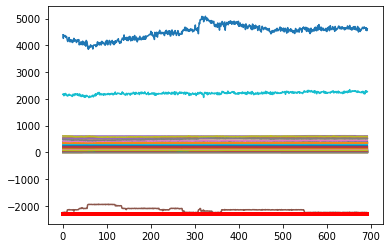

Predicción:  [[[0.98990566 0.01009436]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6580700e+01  1.1884400e+01  5.7206800e+01  7.8811000e+01
  6.1463750e+02  2.8014500e+01  8.6748000e+00  1.7997530e+02
  6.5600000e-02  8.3311500e+01  1.2024310e+02  9.8903000e+00
  5.9880400e+01  1.7423720e+02  2.3197000e+01  1.4747480e+02
  1.8136930e+02  6.8775100e+01 -6.8991000e+00  3.8941000e+00
  1.0652400e+01  7.5036000e+00  1.5003000e+00  7.1743600e+01
  1.4704000e+00  1.5391000e+00  8.2782000e+01  5.8528100e+01
  1.3227000e+00  1.2342000e+00  1.6410000e+00  1.3918000e+00
  1.5738660e+02  8.2810000e-01  8.3000000e-01 -2.2461001e+03
  2.0135530e+02  1.6224000e+00  1.3810000e+00  2.2556966e+03
  4.6631710e+03  1.8481450e+02  1.4194000e+00  1.4141000e+00
  7.9003000e+00  7.8033000e+00  1.7652000e+00  1.2440000e-01
  2.7626800e+01  5.3509380e+02  5.2424730e+02  5.1985200e+02
  5.2065770e+02  5.2087550e+02  2.7791800e+01  3.03

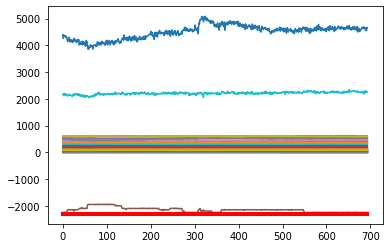

Predicción:  [[[0.99010825 0.00989169]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5840600e+01  1.1952700e+01  5.7999500e+01  7.7570000e+01
  6.1576990e+02  2.7738400e+01  8.7337000e+00  1.7990010e+02
  5.8300000e-02  8.3096400e+01  1.2021020e+02  1.0041100e+01
  6.0056500e+01  1.7543830e+02  2.3335900e+01  1.4610350e+02
  1.8131310e+02  6.8958400e+01 -6.8991000e+00  3.8992000e+00
  1.2746000e+01  7.5218000e+00  1.4988000e+00  7.1803300e+01
  1.4668000e+00  1.5337000e+00  8.3023700e+01  5.8578200e+01
  1.3199000e+00  1.2306000e+00  1.6341000e+00  1.3864000e+00
  1.5692000e+02  8.2810000e-01  8.2990000e-01 -2.2499826e+03
  1.9964400e+02  1.6166000e+00  1.3783000e+00  2.3039553e+03
  4.6244478e+03  1.8481450e+02  1.4159000e+00  1.4091000e+00
  7.8992000e+00  7.8013000e+00  1.7619000e+00  1.2780000e-01
  2.9500300e+01  5.3447620e+02  5.2399390e+02  5.1954410e+02
  5.2022010e+02  5.2052140e+02  2.8150400e+01  3.04

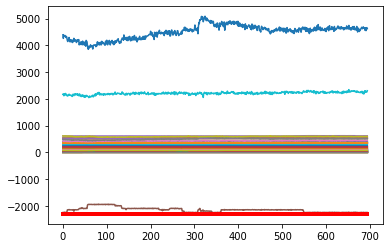

Predicción:  [[[0.9896032  0.01039682]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.4113100e+01  1.1937100e+01  5.6288400e+01  7.7117100e+01
  6.1449910e+02  2.7718900e+01  8.7005000e+00  1.7995150e+02
  5.0900000e-02  8.3475100e+01  1.1993670e+02  1.0097400e+01
  6.1722200e+01  1.7451860e+02  2.2539800e+01  1.4232990e+02
  1.8133400e+02  6.9070300e+01 -6.8991000e+00  3.9210000e+00
  1.1423700e+01  7.5005000e+00  1.4994000e+00  7.1768200e+01
  1.4541000e+00  1.5213000e+00  8.2319000e+01  5.9044100e+01
  1.3060000e+00  1.2176000e+00  1.6222000e+00  1.3750000e+00
  1.5841420e+02  8.2810000e-01  8.2920000e-01 -2.2587858e+03
  2.0026360e+02  1.6043000e+00  1.3653000e+00  2.2285265e+03
  4.5892431e+03  1.8481450e+02  1.4060000e+00  1.3968000e+00
  7.9004000e+00  7.7995000e+00  1.7489000e+00  1.2670000e-01
  3.1072000e+01  5.3387490e+02  5.2329970e+02  5.1894920e+02
  5.1963450e+02  5.1987210e+02  2.7709500e+01  3.02

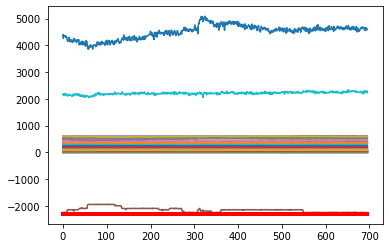

Predicción:  [[[0.98953235 0.01046768]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5020600e+01  1.1884400e+01  5.7165000e+01  7.6920900e+01
  6.1520190e+02  2.7830900e+01  8.7129000e+00  1.8005780e+02
  4.4100000e-02  8.3762300e+01  1.2003130e+02  9.9725000e+00
  5.6299700e+01  1.7511180e+02  2.2465400e+01  1.3980090e+02
  1.8126380e+02  6.8987800e+01 -6.8991000e+00  3.8973000e+00
  1.1233600e+01  7.4962000e+00  1.5000000e+00  7.1821400e+01
  1.4656000e+00  1.5354000e+00  8.3418200e+01  5.8403100e+01
  1.3188000e+00  1.2291000e+00  1.6353000e+00  1.3901000e+00
  1.5879090e+02  8.2820000e-01  8.3020000e-01 -2.2504027e+03
  1.9871630e+02  1.6189000e+00  1.3774000e+00  2.2623987e+03
  4.6742538e+03  1.8481450e+02  1.4215000e+00  1.4129000e+00
  7.9011000e+00  7.8020000e+00  1.7621000e+00  1.2660000e-01
  3.1189200e+01  5.3472610e+02  5.2345710e+02  5.1954160e+02
  5.2016380e+02  5.2037960e+02  2.7753200e+01  3.00

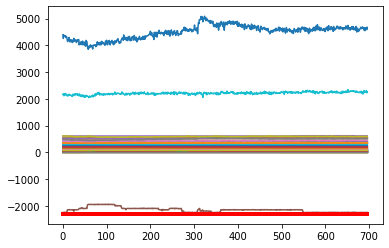

Predicción:  [[[0.9904881  0.00951186]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2517000e+01  1.1945800e+01  5.5010000e+01  7.7586600e+01
  6.1438170e+02  2.8350900e+01  8.3656000e+00  1.7992800e+02
  3.7900000e-02  8.3864400e+01  1.2013530e+02  9.8301000e+00
  6.4366400e+01  1.7520880e+02  2.3182600e+01  1.3891660e+02
  1.8124620e+02  6.9108000e+01 -6.8991000e+00  3.8914000e+00
  9.8037000e+00  7.4984000e+00  1.4986000e+00  7.1793500e+01
  1.4544000e+00  1.5249000e+00  8.3552900e+01  5.8194000e+01
  1.3094000e+00  1.2180000e+00  1.6248000e+00  1.3757000e+00
  1.5812690e+02  8.2830000e-01  8.3020000e-01 -2.2450251e+03
  2.0164850e+02  1.6086000e+00  1.3674000e+00  2.3207762e+03
  4.6449694e+03  1.8481450e+02  1.4050000e+00  1.3998000e+00
  7.8981000e+00  7.8007000e+00  1.7509000e+00  1.2640000e-01
  2.9667700e+01  5.3488850e+02  5.2374760e+02  5.1956610e+02
  5.2016160e+02  5.2031220e+02  2.8325300e+01  3.01

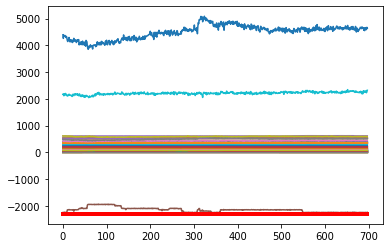

Predicción:  [[[0.98969483 0.01030514]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9760900e+01  1.2101900e+01  5.6065300e+01  7.6766000e+01
  6.1441000e+02  2.8791800e+01  8.3819000e+00  1.8010600e+02
  3.1600000e-02  8.4044800e+01  1.2007730e+02  1.0017300e+01
  6.5012700e+01  1.7574550e+02  2.3255300e+01  1.3751560e+02
  1.8116230e+02  6.9012200e+01 -6.8991000e+00  3.9154000e+00
  7.7583000e+00  7.5168000e+00  1.4997000e+00  7.1769300e+01
  1.4635000e+00  1.5352000e+00  8.3500900e+01  5.8167300e+01
  1.3184000e+00  1.2292000e+00  1.6364000e+00  1.3876000e+00
  1.5787030e+02  8.2800000e-01  8.3010000e-01 -2.2472013e+03
  1.9803630e+02  1.6188000e+00  1.3767000e+00  2.2535212e+03
  4.6563841e+03  1.8481450e+02  1.4161000e+00  1.4096000e+00
  7.9002000e+00  7.7995000e+00  1.7598000e+00  1.2360000e-01
  2.8626600e+01  5.3455320e+02  5.2381500e+02  5.1965380e+02
  5.2019070e+02  5.2037070e+02  2.8531200e+01  3.01

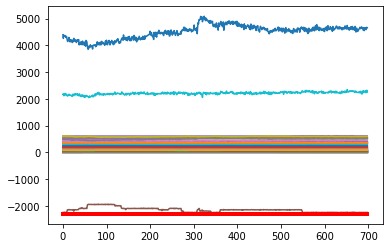

Predicción:  [[[0.99006265 0.00993729]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9979800e+01  1.2152100e+01  5.6216300e+01  7.6595300e+01
  6.1422840e+02  2.8994400e+01  8.3173000e+00  1.8011830e+02
  2.5300000e-02  8.3832700e+01  1.2003480e+02  9.9903000e+00
  6.5466200e+01  1.7663060e+02  2.3099300e+01  1.3706730e+02
  1.8122640e+02  6.9155500e+01 -6.8991000e+00  3.8931000e+00
  9.4322000e+00  7.5045000e+00  1.4995000e+00  7.1769000e+01
  1.4485000e+00  1.5196000e+00  8.3901500e+01  5.9019700e+01
  1.3003000e+00  1.2162000e+00  1.6198000e+00  1.3725000e+00
  1.5559600e+02  8.2840000e-01  8.3060000e-01 -2.2488282e+03
  2.0113830e+02  1.6029000e+00  1.3592000e+00  2.2413179e+03
  4.6465693e+03  1.8481450e+02  1.4002000e+00  1.3935000e+00
  7.9000000e+00  7.8009000e+00  1.7459000e+00  1.2640000e-01
  2.7654200e+01  5.3429310e+02  5.2340610e+02  5.1921730e+02
  5.1987090e+02  5.2003410e+02  2.8705700e+01  3.02

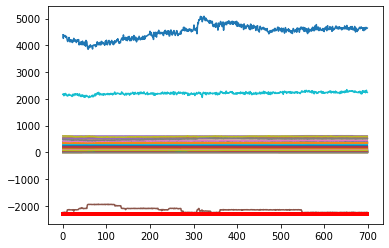

Predicción:  [[[0.98994875 0.01005122]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9121500e+01  1.2164000e+01  5.6644200e+01  7.5424400e+01
  6.1449080e+02  2.8813300e+01  8.3190000e+00  1.8024820e+02
  2.1400000e-02  8.3679700e+01  1.2009850e+02  9.7941000e+00
  6.4066000e+01  1.7706370e+02  2.2624500e+01  1.3664850e+02
  1.8133400e+02  6.9049100e+01 -6.8991000e+00  3.8669000e+00
  1.0065000e+01  7.4745000e+00  1.5036000e+00  7.1810600e+01
  1.4498000e+00  1.5234000e+00  8.3714600e+01  5.8358900e+01
  1.3013000e+00  1.2190000e+00  1.6210000e+00  1.3752000e+00
  1.5502480e+02  8.2790000e-01  8.2820000e-01 -2.2449597e+03
  2.0179190e+02  1.6061000e+00  1.3600000e+00  2.2973487e+03
  4.6691816e+03  1.8481450e+02  1.4023000e+00  1.3958000e+00
  7.9007000e+00  7.7996000e+00  1.7467000e+00  1.2600000e-01
  2.7155300e+01  5.3363700e+02  5.2341120e+02  5.1865890e+02
  5.1923110e+02  5.1961130e+02  2.8690100e+01  3.02

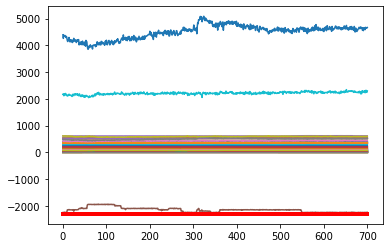

Predicción:  [[[0.9901315  0.00986849]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8622900e+01  1.2206900e+01  5.5244600e+01  7.6056800e+01
  6.1512610e+02  2.8605100e+01  8.3158000e+00  1.7998510e+02
  1.9800000e-02  8.4151100e+01  1.2029780e+02  9.7276000e+00
  6.3445500e+01  1.7611380e+02  2.2093400e+01  1.3693310e+02
  1.8135710e+02  6.9099100e+01 -6.8991000e+00  3.8790000e+00
  7.8828000e+00  7.4915000e+00  1.5006000e+00  7.1778600e+01
  1.4490000e+00  1.5200000e+00  8.3320000e+01  5.8335300e+01
  1.3055000e+00  1.2193000e+00  1.6199000e+00  1.3733000e+00
  1.5422830e+02  8.3110000e-01  8.3300000e-01 -2.2492370e+03
  2.0004790e+02  1.6031000e+00  1.3644000e+00  2.2593848e+03
  4.6267737e+03  1.8481450e+02  1.3992000e+00  1.3947000e+00
  7.8979000e+00  7.7927000e+00  1.7447000e+00  1.2520000e-01
  2.6138100e+01  5.3498660e+02  5.2357460e+02  5.1955080e+02
  5.2004110e+02  5.2043180e+02  2.9401300e+01  3.06

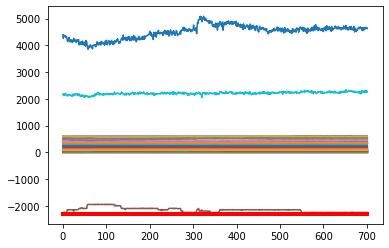

Predicción:  [[[0.9895985  0.01040143]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8776900e+01  1.2194100e+01  5.5796000e+01  7.6187300e+01
  6.1610970e+02  2.9053500e+01  8.3291000e+00  1.7998600e+02
  1.8200000e-02  8.4018400e+01  1.1996130e+02  1.0100600e+01
  6.4765100e+01  1.7619060e+02  2.1148400e+01  1.3748240e+02
  1.8118720e+02  6.9149600e+01 -6.8991000e+00  3.9044000e+00
  9.3830000e+00  7.5049000e+00  1.5009000e+00  7.1800200e+01
  1.4510000e+00  1.5235000e+00  8.3399600e+01  5.8558000e+01
  1.3064000e+00  1.2210000e+00  1.6212000e+00  1.3762000e+00
  1.5412880e+02  8.2390000e-01  8.2720000e-01 -2.2516919e+03
  2.0022790e+02  1.6065000e+00  1.3648000e+00  2.2646200e+03
  4.6508324e+03  1.8481450e+02  1.4016000e+00  1.3977000e+00
  7.9045000e+00  7.8077000e+00  1.7473000e+00  1.2600000e-01
  2.5388500e+01  5.3509780e+02  5.2371660e+02  5.1941260e+02
  5.1992750e+02  5.2026510e+02  2.8651700e+01  3.04

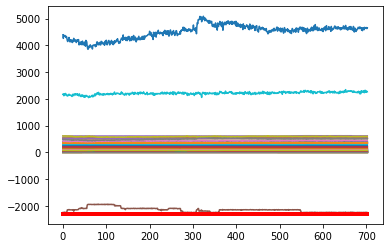

Predicción:  [[[0.99017847 0.00982152]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8378800e+01  1.2233900e+01  5.5541000e+01  7.7866800e+01
  6.1532940e+02  2.9026000e+01  8.3416000e+00  1.8005010e+02
  1.7900000e-02  8.4163700e+01  1.2013510e+02  9.8382000e+00
  6.4333600e+01  1.7571210e+02  2.1920800e+01  1.3745590e+02
  1.8111510e+02  6.8776200e+01 -6.8991000e+00  3.8868000e+00
  8.2065000e+00  7.5030000e+00  1.5010000e+00  7.1822200e+01
  1.4505000e+00  1.5227000e+00  8.2956000e+01  5.8132700e+01
  1.3087000e+00  1.2201000e+00  1.6229000e+00  1.3746000e+00
  1.5475990e+02  8.2720000e-01  8.2970000e-01 -2.2562554e+03
  1.9825340e+02  1.6063000e+00  1.3667000e+00  2.2450074e+03
  4.6379553e+03  1.8481450e+02  1.4002000e+00  1.3966000e+00
  7.8985000e+00  7.8011000e+00  1.7467000e+00  1.2380000e-01
  2.5615100e+01  5.3471770e+02  5.2339520e+02  5.1922960e+02
  5.1975920e+02  5.2005590e+02  2.8659400e+01  3.03

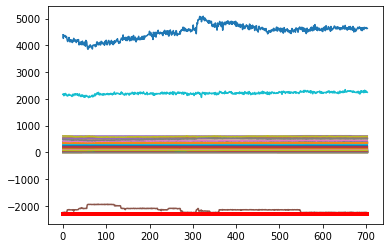

Predicción:  [[[0.9902091  0.00979094]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6918700e+01  1.2259100e+01  5.6228800e+01  7.8770400e+01
  6.1529920e+02  2.8922300e+01  8.3451000e+00  1.7987830e+02
  1.7900000e-02  8.4403600e+01  1.2004160e+02  1.0010300e+01
  6.3758000e+01  1.7609760e+02  2.2417500e+01  1.3756500e+02
  1.8110220e+02  6.8964500e+01 -6.8991000e+00  3.8969000e+00
  7.3735000e+00  7.4775000e+00  1.4997000e+00  7.1828400e+01
  1.4629000e+00  1.5359000e+00  8.2861400e+01  5.7939900e+01
  1.3209000e+00  1.2336000e+00  1.6349000e+00  1.3878000e+00
  1.5432810e+02  8.2700000e-01  8.3000000e-01 -2.2433035e+03
  1.9960300e+02  1.6191000e+00  1.3792000e+00  2.2516616e+03
  4.6244446e+03  1.8481450e+02  1.4129000e+00  1.4108000e+00
  7.9029000e+00  7.8009000e+00  1.7588000e+00  1.2380000e-01
  2.5057400e+01  5.3584890e+02  5.2404290e+02  5.1972660e+02
  5.2024510e+02  5.2062260e+02  2.9251100e+01  3.07

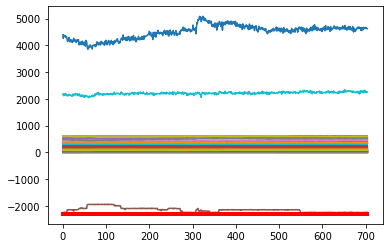

Predicción:  [[[0.9891289  0.01087112]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8580400e+01  1.2264600e+01  5.5578400e+01  7.7822600e+01
  6.1603300e+02  2.8770200e+01  8.2772000e+00  1.8003940e+02
  1.6100000e-02  8.4146800e+01  1.2017170e+02  9.9562000e+00
  6.3732300e+01  1.7747340e+02  2.2544500e+01  1.3858990e+02
  1.8107440e+02  6.9207300e+01 -6.8991000e+00  3.8804000e+00
  9.8453000e+00  7.5188000e+00  1.4993000e+00  7.1823500e+01
  1.4399000e+00  1.5140000e+00  8.2519600e+01  5.9461300e+01
  1.2975000e+00  1.2116000e+00  1.6104000e+00  1.3654000e+00
  1.5364600e+02  8.2850000e-01  8.2980000e-01 -2.2495893e+03
  2.0046170e+02  1.5970000e+00  1.3570000e+00  2.2560870e+03
  4.6126374e+03  1.8481450e+02  1.3898000e+00  1.3857000e+00
  7.8988000e+00  7.8018000e+00  1.7383000e+00  1.2780000e-01
  2.4513100e+01  5.3476540e+02  5.2354570e+02  5.1906370e+02
  5.1974810e+02  5.1997430e+02  2.9441000e+01  3.08

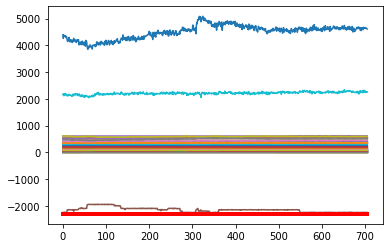

Predicción:  [[[0.9893332  0.01066676]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6100300e+01  1.2325900e+01  5.7343600e+01  7.5861600e+01
  6.1539000e+02  2.8357100e+01  8.3046000e+00  1.8006280e+02
  1.2900000e-02  8.3742500e+01  1.2000280e+02  1.0012400e+01
  6.4213800e+01  1.7679310e+02  2.2574800e+01  1.3690740e+02
  1.8122700e+02  6.9023700e+01 -6.8991000e+00  3.8700000e+00
  9.2771000e+00  7.4799000e+00  1.4999000e+00  7.1781100e+01
  1.4533000e+00  1.5256000e+00  8.1372300e+01  5.8740300e+01
  1.3105000e+00  1.2252000e+00  1.6217000e+00  1.3779000e+00
  1.5397410e+02  8.2900000e-01  8.3040000e-01 -2.2532892e+03
  2.0189080e+02  1.6070000e+00  1.3695000e+00  2.2832393e+03
  4.5416414e+03  1.8481450e+02  1.4029000e+00  1.3979000e+00
  7.9011000e+00  7.8008000e+00  1.7480000e+00  1.2620000e-01
  2.4987100e+01  5.3436580e+02  5.2288270e+02  5.1869880e+02
  5.1936700e+02  5.1963370e+02  2.9657700e+01  3.10

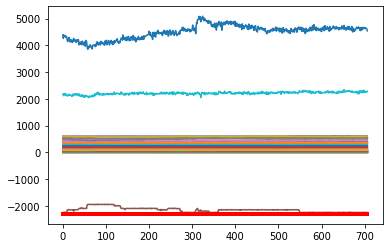

Predicción:  [[[0.9879457  0.01205431]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7827000e+01  1.2279500e+01  5.7131300e+01  7.7918000e+01
  6.1423930e+02  2.8390000e+01  8.2862000e+00  1.8001060e+02
  9.9000000e-03  8.3632500e+01  1.1993720e+02  1.0154000e+01
  6.3831900e+01  1.7646720e+02  2.2704500e+01  1.3629210e+02
  1.8117650e+02  6.8822100e+01 -6.8991000e+00  3.8933000e+00
  7.1505000e+00  7.5024000e+00  1.4996000e+00  7.1794400e+01
  1.4569000e+00  1.5312000e+00  8.2185800e+01  5.8544500e+01
  1.3159000e+00  1.2268000e+00  1.6272000e+00  1.3807000e+00
  1.5454210e+02  8.2830000e-01  8.3000000e-01 -2.2447061e+03
  2.0077900e+02  1.6139000e+00  1.3742000e+00  2.2737838e+03
  4.6189929e+03  1.8481450e+02  1.4057000e+00  1.4020000e+00
  7.8969000e+00  7.7992000e+00  1.7520000e+00  1.2490000e-01
  2.5275800e+01  5.3651990e+02  5.2428990e+02  5.2000920e+02
  5.2075870e+02  5.2094300e+02  2.9579700e+01  3.11

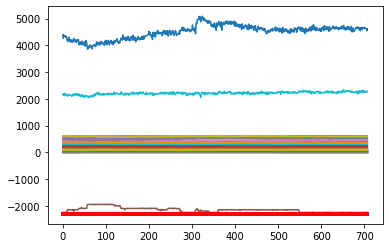

Predicción:  [[[0.9890815  0.01091844]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8123400e+01  1.2308200e+01  5.7859500e+01  7.6716400e+01
  6.1548260e+02  2.8331800e+01  8.3533000e+00  1.8003720e+02
  7.2000000e-03  8.3488100e+01  1.2005580e+02  9.9302000e+00
  6.4122100e+01  1.7701640e+02  2.2520000e+01  1.3620150e+02
  1.8104670e+02  6.9185100e+01 -6.8991000e+00  3.8968000e+00
  1.0035800e+01  7.5062000e+00  1.4995000e+00  7.1820700e+01
  1.4508000e+00  1.5234000e+00  8.2305800e+01  5.9338600e+01
  1.3063000e+00  1.2219000e+00  1.6198000e+00  1.3742000e+00
  1.5342940e+02  8.2910000e-01  8.3050000e-01 -2.2536031e+03
  1.9978850e+02  1.6061000e+00  1.3657000e+00  2.2905475e+03
  4.5848223e+03  1.8481450e+02  1.3991000e+00  1.3959000e+00
  7.9048000e+00  7.8025000e+00  1.7476000e+00  1.2710000e-01
  2.4855500e+01  5.3514890e+02  5.2333190e+02  5.1897550e+02
  5.1963590e+02  5.1990230e+02  2.9474300e+01  3.09

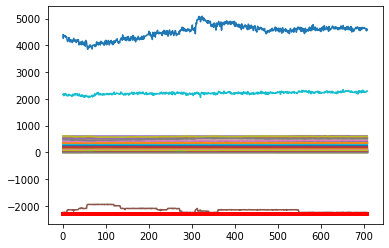

Predicción:  [[[0.9889831  0.01101686]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6515500e+01  1.2342100e+01  5.8305600e+01  7.7327500e+01
  6.1556490e+02  2.8103200e+01  8.3234000e+00  1.7987780e+02
  4.5000000e-03  8.3604500e+01  1.1989250e+02  1.0032200e+01
  6.3808900e+01  1.7651440e+02  2.2502700e+01  1.3611930e+02
  1.8118030e+02  6.8872600e+01 -6.8991000e+00  3.9085000e+00
  7.7332000e+00  7.5181000e+00  1.4990000e+00  7.1722200e+01
  1.4596000e+00  1.5360000e+00  8.2158700e+01  5.9008000e+01
  1.3168000e+00  1.2307000e+00  1.6264000e+00  1.3837000e+00
  1.5341410e+02  8.2840000e-01  8.3000000e-01 -2.2519162e+03
  1.9987130e+02  1.6192000e+00  1.3756000e+00  2.2854513e+03
  4.6090997e+03  1.8481450e+02  1.4081000e+00  1.4050000e+00
  7.8961000e+00  7.7993000e+00  1.7553000e+00  1.2860000e-01
  2.4411900e+01  5.3508230e+02  5.2343600e+02  5.1924730e+02
  5.1993830e+02  5.2017910e+02  2.9496500e+01  3.08

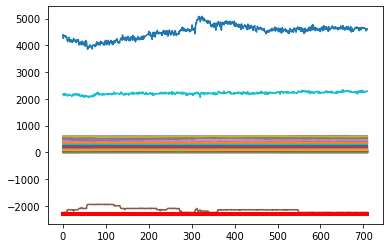

Predicción:  [[[0.9894097  0.01059033]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7101300e+01  1.2326400e+01  5.6757100e+01  7.7734700e+01
  6.1531330e+02  2.9212200e+01  8.3058000e+00  1.7988950e+02
  1.7000000e-03  8.3313800e+01  1.2003420e+02  9.9855000e+00
  6.4205600e+01  1.7757070e+02  2.2588300e+01  1.3739880e+02
  1.8122420e+02  6.9243300e+01 -6.8991000e+00  3.8896000e+00
  8.8072000e+00  7.4620000e+00  1.5007000e+00  7.1839700e+01
  1.4440000e+00  1.5213000e+00  8.3186300e+01  5.9757600e+01
  1.3003000e+00  1.2171000e+00  1.6140000e+00  1.3732000e+00
  1.5226450e+02  8.2770000e-01  8.3050000e-01 -2.2368811e+03
  2.0494070e+02  1.6043000e+00  1.3602000e+00  2.2861589e+03
  4.6968141e+03  1.8481450e+02  1.3982000e+00  1.3945000e+00
  7.9042000e+00  7.7998000e+00  1.7424000e+00  1.2850000e-01
  2.4640800e+01  5.3485320e+02  5.2314460e+02  5.1910400e+02
  5.1960520e+02  5.1997020e+02  2.9354100e+01  3.07

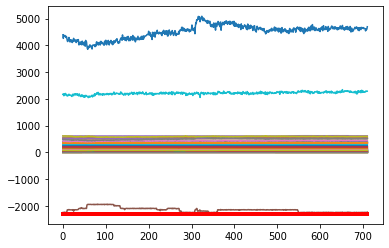

Predicción:  [[[0.99015045 0.00984955]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6532100e+01  1.2413700e+01  5.7853100e+01  7.6159800e+01
  6.1445410e+02  2.9311600e+01  8.3038000e+00  1.8002630e+02
  2.7000000e-03  8.2383600e+01  1.2021060e+02  9.9709000e+00
  6.4193500e+01  1.7722130e+02  2.2627700e+01  1.3821170e+02
  1.8122970e+02  6.9277400e+01 -6.8991000e+00  3.8924000e+00
  9.4443000e+00  7.4993000e+00  1.4986000e+00  7.1782800e+01
  1.4473000e+00  1.5235000e+00  8.2208900e+01  5.9489100e+01
  1.3055000e+00  1.2189000e+00  1.6140000e+00  1.3729000e+00
  1.5261270e+02  8.2640000e-01  8.3030000e-01 -2.2501651e+03
  2.0123520e+02  1.6059000e+00  1.3647000e+00  2.2560553e+03
  4.5534573e+03  1.8481450e+02  1.3993000e+00  1.3941000e+00
  7.8961000e+00  7.7993000e+00  1.7437000e+00  1.2960000e-01
  2.6289700e+01  5.3463330e+02  5.2320210e+02  5.1902730e+02
  5.1958630e+02  5.1999070e+02  2.9089600e+01  3.04

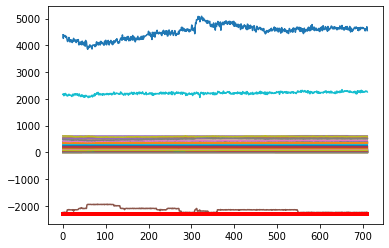

Predicción:  [[[0.9879907  0.01200928]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8430600e+01  1.2296900e+01  5.6192200e+01  7.6127900e+01
  6.1462650e+02  2.9374300e+01  8.2851000e+00  1.7993010e+02
  6.8000000e-03  8.0479200e+01  1.2008340e+02  9.9523000e+00
  6.4429000e+01  1.7596670e+02  2.2811900e+01  1.3929740e+02
  1.8107440e+02  6.9178500e+01 -6.8991000e+00  3.9009000e+00
  8.6969000e+00  7.4973000e+00  1.4994000e+00  7.1860900e+01
  1.4509000e+00  1.5285000e+00  8.3517100e+01  6.0133900e+01
  1.3097000e+00  1.2220000e+00  1.6199000e+00  1.3752000e+00
  1.5356920e+02  8.2490000e-01  8.3060000e-01 -2.2442711e+03
  2.0089290e+02  1.6115000e+00  1.3696000e+00  2.2657320e+03
  4.5670918e+03  1.8481450e+02  1.4028000e+00  1.3959000e+00
  7.9027000e+00  7.8010000e+00  1.7466000e+00  1.2660000e-01
  2.7322500e+01  5.3519780e+02  5.2358900e+02  5.1920880e+02
  5.1980540e+02  5.2027470e+02  2.9133400e+01  3.04

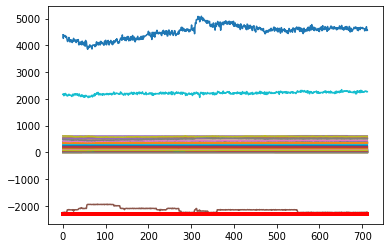

Predicción:  [[[0.9878334  0.01216661]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7810500e+01  1.2314300e+01  5.7360200e+01  7.5502500e+01
  6.1528690e+02  2.9495200e+01  8.2263000e+00  1.7999490e+02
  1.0900000e-02  8.1525000e+01  1.1989860e+02  1.0142100e+01
  6.4029600e+01  1.7704880e+02  2.2765000e+01  1.4115880e+02
  1.8121630e+02  6.9031000e+01 -6.8991000e+00  3.9114000e+00
  9.9047000e+00  7.5020000e+00  1.4992000e+00  7.1826600e+01
  1.4385000e+00  1.5130000e+00  8.2503800e+01  5.9396800e+01
  1.2931000e+00  1.2095000e+00  1.6032000e+00  1.3636000e+00
  1.5323630e+02  8.2720000e-01  8.2970000e-01 -2.2436430e+03
  2.0126710e+02  1.5957000e+00  1.3527000e+00  2.2601114e+03
  4.6002688e+03  1.8481450e+02  1.3953000e+00  1.3796000e+00
  7.8995000e+00  7.7982000e+00  1.7317000e+00  1.2860000e-01
  3.1584300e+01  5.3448670e+02  5.2312680e+02  5.1861580e+02
  5.1928060e+02  5.1971500e+02  2.8987800e+01  3.04

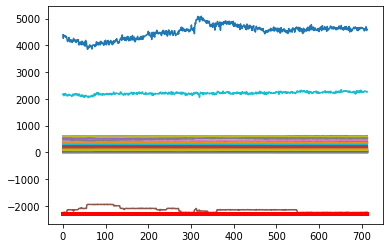

Predicción:  [[[0.9886285  0.01137147]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6340300e+01  1.2436100e+01  5.8234000e+01  7.5639000e+01
  6.1454790e+02  3.0238400e+01  8.3012000e+00  1.8012990e+02
  1.5000000e-02  8.1741800e+01  1.1977930e+02  1.0083900e+01
  6.3566700e+01  1.7724980e+02  2.2354200e+01  1.4289600e+02
  1.8169900e+02  6.9225800e+01 -6.8991000e+00  3.8890000e+00
  1.0129300e+01  7.4962000e+00  1.4998000e+00  7.1810000e+01
  1.4367000e+00  1.5127000e+00  8.3402500e+01  5.9365600e+01
  1.2908000e+00  1.2075000e+00  1.6029000e+00  1.3640000e+00
  1.5315270e+02  8.2690000e-01  8.3070000e-01 -2.2511874e+03
  2.0307450e+02  1.5959000e+00  1.3505000e+00  2.2563467e+03
  4.6976851e+03  1.8481450e+02  1.3956000e+00  1.3808000e+00
  7.9009000e+00  7.8011000e+00  1.7298000e+00  1.2700000e-01
  3.1322000e+01  5.3427780e+02  5.2224820e+02  5.1826940e+02
  5.1913390e+02  5.1946400e+02  2.8758900e+01  3.02

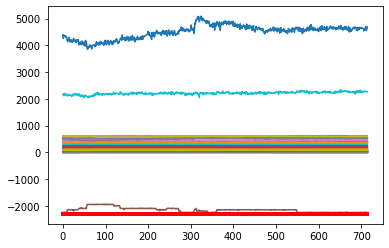

Predicción:  [[[0.9907863  0.00921375]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6168600e+01  1.2402600e+01  5.7986600e+01  7.6361600e+01
  6.1504490e+02  3.2734200e+01  8.3143000e+00  1.7999260e+02
  2.1300000e-02  8.1104700e+01  1.2007580e+02  1.0055900e+01
  6.3017900e+01  1.7977410e+02  2.2595400e+01  1.4491750e+02
  1.8188720e+02  6.9136500e+01 -6.8991000e+00  3.8980000e+00
  1.0348800e+01  7.4977000e+00  1.5020000e+00  7.1790300e+01
  1.4440000e+00  1.5177000e+00  8.3239600e+01  5.9048000e+01
  1.3003000e+00  1.2147000e+00  1.6044000e+00  1.3660000e+00
  1.5260310e+02  8.2630000e-01  8.2980000e-01 -2.2486761e+03
  2.0135330e+02  1.6007000e+00  1.3589000e+00  2.2999615e+03
  4.5895245e+03  1.8481450e+02  1.3979000e+00  1.3841000e+00
  7.9006000e+00  7.8014000e+00  1.7349000e+00  1.3090000e-01
  3.2160200e+01  5.3553330e+02  5.2339310e+02  5.1900670e+02
  5.1998940e+02  5.2017870e+02  2.8696200e+01  3.01

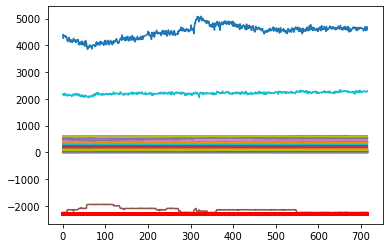

Predicción:  [[[0.98872656 0.01127342]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7176100e+01  1.2414200e+01  5.8083400e+01  7.6876800e+01
  6.1603800e+02  3.2374300e+01  8.3022000e+00  1.7986130e+02
  2.9400000e-02  8.1032400e+01  1.1993640e+02  1.0059000e+01
  6.1603500e+01  1.7895850e+02  2.2734200e+01  1.4708940e+02
  1.8183830e+02  6.9144300e+01 -6.8991000e+00  3.9034000e+00
  1.0420300e+01  7.5031000e+00  1.5000000e+00  7.1776500e+01
  1.4523000e+00  1.5222000e+00  8.2790500e+01  5.9016000e+01
  1.3109000e+00  1.2226000e+00  1.6139000e+00  1.3721000e+00
  1.5252630e+02  8.2600000e-01  8.2970000e-01 -2.2565254e+03
  2.0119160e+02  1.6055000e+00  1.3700000e+00  2.2630982e+03
  4.4627141e+03  1.8481450e+02  1.4049000e+00  1.3914000e+00
  7.8992000e+00  7.7958000e+00  1.7417000e+00  1.2800000e-01
  3.2970100e+01  5.3643550e+02  5.2392680e+02  5.1940670e+02
  5.2032180e+02  5.2061240e+02  2.8554800e+01  3.00

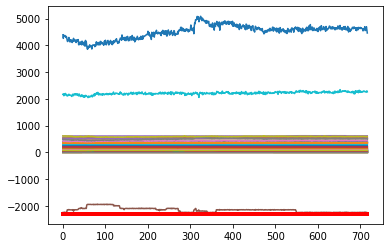

Predicción:  [[[0.98614454 0.01385544]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7754000e+01  1.2520300e+01  5.7470100e+01  7.7463000e+01
  6.1493770e+02  3.2167200e+01  8.2929000e+00  1.7982880e+02
  3.7500000e-02  8.0603400e+01  1.2010540e+02  9.8933000e+00
  6.2569600e+01  1.7870720e+02  2.2720800e+01  1.4864530e+02
  1.8178090e+02  6.9232400e+01 -6.8991000e+00  3.8920000e+00
  1.0774900e+01  7.5028000e+00  1.4997000e+00  7.1819400e+01
  1.4522000e+00  1.5282000e+00  8.3063000e+01  5.9803000e+01
  1.3094000e+00  1.2235000e+00  1.6132000e+00  1.3761000e+00
  1.5178370e+02  8.2300000e-01  8.3040000e-01 -2.2466852e+03
  2.0299140e+02  1.6117000e+00  1.3691000e+00  2.2452178e+03
  4.6154335e+03  1.8481450e+02  1.4049000e+00  1.3981000e+00
  7.8963000e+00  7.8013000e+00  1.7439000e+00  1.3100000e-01
  2.8859300e+01  5.3649560e+02  5.2368340e+02  5.1966550e+02
  5.2055610e+02  5.2070460e+02  2.8636600e+01  3.01

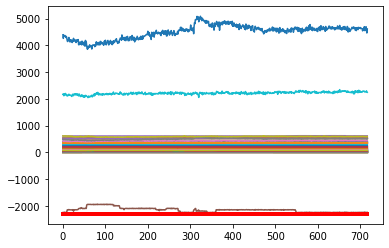

Predicción:  [[[0.9892447  0.01075533]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7791400e+01  1.2484100e+01  5.7780000e+01  7.7663200e+01
  6.1502290e+02  3.1739500e+01  8.2544000e+00  1.8003000e+02
  3.7600000e-02  8.0577600e+01  1.2005310e+02  9.9750000e+00
  6.2368000e+01  1.7824490e+02  2.3142900e+01  1.4807820e+02
  1.8137540e+02  6.9281200e+01 -6.8991000e+00  3.8973000e+00
  9.3346000e+00  7.4755000e+00  1.5004000e+00  7.1806100e+01
  1.4626000e+00  1.5402000e+00  8.2009800e+01  6.0065500e+01
  1.3226000e+00  1.2348000e+00  1.6250000e+00  1.3876000e+00
  1.5180800e+02  8.2390000e-01  8.3020000e-01 -2.2487475e+03
  2.0062020e+02  1.6229000e+00  1.3820000e+00  2.2749804e+03
  4.6532394e+03  1.8481450e+02  1.4134000e+00  1.4120000e+00
  7.9055000e+00  7.7995000e+00  1.7543000e+00  1.2920000e-01
  2.5634600e+01  5.3717110e+02  5.2467860e+02  5.2041100e+02
  5.2139800e+02  5.2152110e+02  2.8700100e+01  3.01

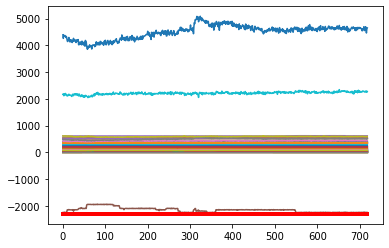

Predicción:  [[[0.9900946  0.00990545]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8065900e+01  1.2414400e+01  5.6637200e+01  7.7127200e+01
  6.1456570e+02  3.1142500e+01  8.2526000e+00  1.8011980e+02
  2.8200000e-02  8.1064900e+01  1.2022710e+02  9.9956000e+00
  6.4047800e+01  1.7778270e+02  2.3011000e+01  1.4808700e+02
  1.8105090e+02  6.9231900e+01 -6.8991000e+00  3.9141000e+00
  9.4435000e+00  7.5087000e+00  1.5001000e+00  7.1838400e+01
  1.4459000e+00  1.5210000e+00  8.2203400e+01  6.0599300e+01
  1.3031000e+00  1.2174000e+00  1.6092000e+00  1.3702000e+00
  1.5040500e+02  8.2560000e-01  8.2980000e-01 -2.2379029e+03
  2.0175820e+02  1.6035000e+00  1.3639000e+00  2.3056271e+03
  4.6676714e+03  1.8481450e+02  1.3963000e+00  1.3931000e+00
  7.8968000e+00  7.8004000e+00  1.7393000e+00  1.2990000e-01
  2.6013900e+01  5.3528660e+02  5.2383160e+02  5.1937790e+02
  5.2029810e+02  5.2040760e+02  2.8724300e+01  3.02

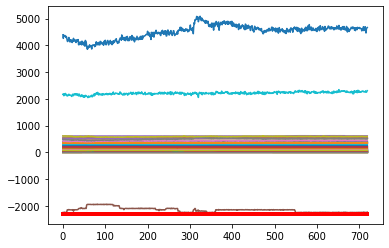

Predicción:  [[[0.9896604  0.01033956]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7333800e+01  1.2337200e+01  5.7766000e+01  7.4972900e+01
  6.1663440e+02  3.2047800e+01  8.2992000e+00  1.8011880e+02
  2.4500000e-02  8.3127000e+01  1.2006100e+02  1.0130100e+01
  6.3187300e+01  1.8072590e+02  2.2858800e+01  1.4778950e+02
  1.8104730e+02  6.9325900e+01 -6.8991000e+00  3.9082000e+00
  1.0828400e+01  7.5142000e+00  1.5015000e+00  7.1789600e+01
  1.4441000e+00  1.5178000e+00  8.2775500e+01  6.0560800e+01
  1.2997000e+00  1.2163000e+00  1.6007000e+00  1.3670000e+00
  1.5045960e+02  8.2590000e-01  8.3020000e-01 -2.2534984e+03
  2.0280140e+02  1.6009000e+00  1.3602000e+00  2.2805169e+03
  4.5722893e+03  1.8481450e+02  1.3922000e+00  1.3876000e+00
  7.9023000e+00  7.8023000e+00  1.7350000e+00  1.3430000e-01
  2.5186900e+01  5.3429560e+02  5.2300020e+02  5.1876940e+02
  5.1963390e+02  5.1977170e+02  2.8577800e+01  3.02

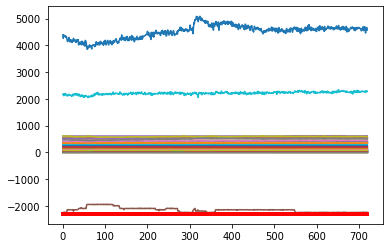

Predicción:  [[[0.98874867 0.01125129]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7141200e+01  1.2302000e+01  5.7560700e+01  7.5711800e+01
  6.1524850e+02  3.3814500e+01  8.2823000e+00  1.8004190e+02
  4.0700000e-02  8.2799200e+01  1.2004330e+02  9.9785000e+00
  6.0563300e+01  1.8205910e+02  2.2979400e+01  1.4922560e+02
  1.8100890e+02  6.9283900e+01 -6.8991000e+00  3.9070000e+00
  1.0828300e+01  7.4786000e+00  1.4982000e+00  7.1768900e+01
  1.4523000e+00  1.5248000e+00  8.2524800e+01  5.9999800e+01
  1.3103000e+00  1.2263000e+00  1.6045000e+00  1.3757000e+00
  1.4913620e+02  8.2680000e-01  8.2940000e-01 -2.2532325e+03
  2.0270110e+02  1.6079000e+00  1.3699000e+00  2.3022528e+03
  4.5087331e+03  1.8481450e+02  1.4010000e+00  1.3962000e+00
  7.9024000e+00  7.8009000e+00  1.7429000e+00  1.3850000e-01
  2.5167900e+01  5.3545110e+02  5.2360700e+02  5.1944530e+02
  5.2022500e+02  5.2039550e+02  2.8506500e+01  3.01

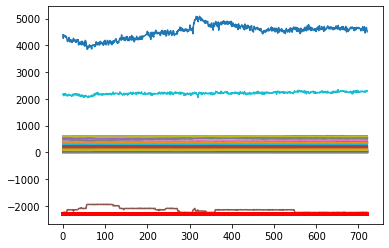

Predicción:  [[[0.9871202  0.01287971]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8611500e+01  1.2277300e+01  5.6843500e+01  7.7828900e+01
  6.1414860e+02  3.2590800e+01  8.3016000e+00  1.8001800e+02
  5.5400000e-02  8.2923600e+01  1.1999900e+02  1.0098500e+01
  6.0338400e+01  1.8088260e+02  2.2549100e+01  1.5032720e+02
  1.8091200e+02  6.9317400e+01 -6.8991000e+00  3.8954000e+00
  1.0351400e+01  7.5054000e+00  1.5009000e+00  7.1787100e+01
  1.4515000e+00  1.5281000e+00  8.3348200e+01  6.0315500e+01
  1.3114000e+00  1.2256000e+00  1.6069000e+00  1.3782000e+00
  1.4930890e+02  8.2450000e-01  8.2960000e-01 -2.2467324e+03
  2.0164000e+02  1.6119000e+00  1.3716000e+00  2.2269097e+03
  4.6034484e+03  1.8481450e+02  1.4037000e+00  1.3992000e+00
  7.8981000e+00  7.7996000e+00  1.7440000e+00  1.3760000e-01
  2.5293800e+01  5.3553340e+02  5.2414320e+02  5.1971710e+02
  5.2051260e+02  5.2064080e+02  2.8015900e+01  2.98

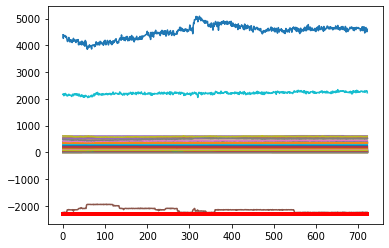

Predicción:  [[[0.9890491  0.01095094]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8338200e+01  1.2332900e+01  5.5524800e+01  7.8404200e+01
  6.1596430e+02  3.1917900e+01  8.2928000e+00  1.8000000e+02
  5.2600000e-02  8.2939900e+01  1.2027490e+02  1.0311300e+01
  6.2425700e+01  1.8035680e+02  2.2765100e+01  1.4973860e+02
  1.8073920e+02  6.9333500e+01 -6.8991000e+00  3.9072000e+00
  1.0283400e+01  7.5055000e+00  1.5010000e+00  7.1842200e+01
  1.4446000e+00  1.5195000e+00  8.2287200e+01  5.9837200e+01
  1.3040000e+00  1.2179000e+00  1.6018000e+00  1.3684000e+00
  1.5049500e+02  8.2690000e-01  8.3010000e-01 -2.2470929e+03
  2.0321060e+02  1.6022000e+00  1.3638000e+00  2.3121308e+03
  4.5572320e+03  1.8481450e+02  1.3932000e+00  1.3905000e+00
  7.9045000e+00  7.7999000e+00  1.7358000e+00  1.3400000e-01
  2.4887300e+01  5.3511560e+02  5.2397700e+02  5.1947490e+02
  5.2016530e+02  5.2041810e+02  2.7795500e+01  2.95

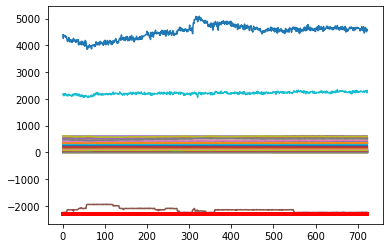

Predicción:  [[[0.98786885 0.01213112]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7559300e+01  1.2452500e+01  5.6452700e+01  7.6283700e+01
  6.1519820e+02  3.1756800e+01  8.2934000e+00  1.8003230e+02
  4.7000000e-02  8.3065800e+01  1.1994360e+02  1.0052700e+01
  6.4091800e+01  1.7917860e+02  2.2564500e+01  1.4724760e+02
  1.8077850e+02  6.9240800e+01 -6.8991000e+00  3.8975000e+00
  9.7718000e+00  7.4825000e+00  1.5010000e+00  7.1785200e+01
  1.4427000e+00  1.5178000e+00  8.3964000e+01  5.9714500e+01
  1.2985000e+00  1.2137000e+00  1.6033000e+00  1.3663000e+00
  1.5187870e+02  8.2360000e-01  8.3000000e-01 -2.2475442e+03
  2.0260920e+02  1.6012000e+00  1.3586000e+00  2.2093741e+03
  4.5824194e+03  1.8481450e+02  1.3920000e+00  1.3947000e+00
  7.8993000e+00  7.8013000e+00  1.7343000e+00  1.3110000e-01
  2.5684300e+01  5.3455110e+02  5.2328290e+02  5.1916710e+02
  5.1984840e+02  5.2017750e+02  2.7403400e+01  2.91

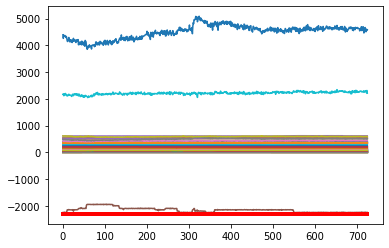

Predicción:  [[[0.9885705  0.01142955]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7566400e+01  1.2506300e+01  5.5645500e+01  7.6067300e+01
  6.1606940e+02  3.1423600e+01  8.2854000e+00  1.7996090e+02
  4.2900000e-02  8.2972900e+01  1.1988640e+02  9.7704000e+00
  6.3626300e+01  1.7943090e+02  2.2306100e+01  1.4693530e+02
  1.8085980e+02  6.9468300e+01 -6.8991000e+00  3.8992000e+00
  1.0065900e+01  7.5000000e+00  1.5007000e+00  7.1829600e+01
  1.4376000e+00  1.5087000e+00  8.3429600e+01  6.0413300e+01
  1.2938000e+00  1.2079000e+00  1.5961000e+00  1.3606000e+00
  1.5152850e+02  8.2610000e-01  8.2990000e-01 -2.2456829e+03
  2.0221630e+02  1.5914000e+00  1.3540000e+00  2.2190111e+03
  4.5725834e+03  1.8481450e+02  1.3864000e+00  1.3854000e+00
  7.8975000e+00  7.8007000e+00  1.7289000e+00  1.3270000e-01
  2.5628700e+01  5.3435220e+02  5.2319180e+02  5.1889480e+02
  5.1963710e+02  5.1998770e+02  2.7334600e+01  2.90

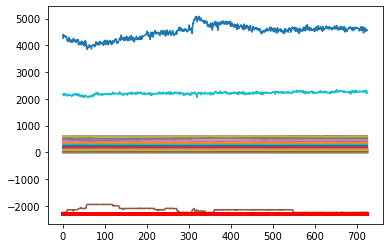

Predicción:  [[[0.98820823 0.0117918 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8545100e+01  1.2473300e+01  5.5932400e+01  7.6980700e+01
  6.1450830e+02  3.1663900e+01  8.2680000e+00  1.8009400e+02
  4.4900000e-02  8.2762100e+01  1.2007590e+02  1.0176200e+01
  6.1657200e+01  1.8025710e+02  2.2214300e+01  1.4958090e+02
  1.8093180e+02  6.9349900e+01 -6.8991000e+00  3.9001000e+00
  1.1046500e+01  7.5167000e+00  1.4984000e+00  7.1765000e+01
  1.4408000e+00  1.5131000e+00  8.2314000e+01  6.0614100e+01
  1.2943000e+00  1.2129000e+00  1.5967000e+00  1.3623000e+00
  1.4988190e+02  8.2710000e-01  8.3030000e-01 -2.2551457e+03
  2.0180690e+02  1.5958000e+00  1.3552000e+00  2.2731582e+03
  4.5837949e+03  1.8481450e+02  1.3885000e+00  1.3827000e+00
  7.9036000e+00  7.8011000e+00  1.7319000e+00  1.3500000e-01
  2.6132800e+01  5.3464670e+02  5.2303540e+02  5.1890360e+02
  5.1974000e+02  5.1998030e+02  2.7225400e+01  2.89

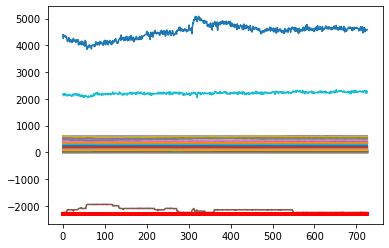

Predicción:  [[[0.9891502  0.01084983]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  727  - Datos Recibidos:  [ 3.8882400e+01  1.2452300e+01  5.6979800e+01  7.7296300e+01
  6.1493150e+02  3.1778200e+01  8.2192000e+00  1.8003480e+02
  4.7600000e-02  8.2784900e+01  1.1975450e+02  1.0007600e+01
  6.1243700e+01  1.7997580e+02  2.2016900e+01  1.5164970e+02
  1.8089360e+02  6.9486700e+01 -6.8991000e+00  3.8222000e+00
  1.0447300e+01  7.5049000e+00  1.5010000e+00  7.1773200e+01
  1.4450000e+00  1.5180000e+00  8.2289900e+01  6.1218000e+01
  1.3001000e+00  1.2172000e+00  1.6013000e+00  1.3672000e+00
  1.5080720e+02  8.2490000e-01  8.2900000e-01 -2.2518345e+03
  2.0119960e+02  1.6000000e+00  1.3619000e+00  2.2226311e+03
  4.5194844e+03  1.8481450e+02  1.3978000e+00  1.3855000e+00
  7.8949000e+00  7.7996000e+00  1.7352000e+00  1.3390000e-01
  3.0445700e+01  5.3541770e+02  5.2403870e+02  5.1965340e+02
  5.2043970e+02  5.2068220e+02  2.786990

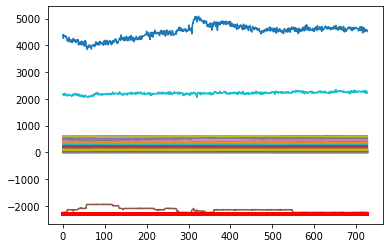

Predicción:  [[[0.9873727  0.01262728]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8882400e+01  1.2452300e+01  5.6979800e+01  7.7296300e+01
  6.1493150e+02  3.1778200e+01  8.2192000e+00  1.8003480e+02
  4.7600000e-02  8.2784900e+01  1.1975450e+02  1.0007600e+01
  6.1243700e+01  1.7997580e+02  2.2016900e+01  1.5164970e+02
  1.8089360e+02  6.9486700e+01 -6.8991000e+00  3.8222000e+00
  1.0447300e+01  7.5049000e+00  1.5010000e+00  7.1773200e+01
  1.4450000e+00  1.5180000e+00  8.2289900e+01  6.1218000e+01
  1.3001000e+00  1.2172000e+00  1.6013000e+00  1.3672000e+00
  1.5080720e+02  8.2490000e-01  8.2900000e-01 -2.2518345e+03
  2.0119960e+02  1.6000000e+00  1.3619000e+00  2.2226311e+03
  4.5194844e+03  1.8481450e+02  1.3978000e+00  1.3855000e+00
  7.8949000e+00  7.7996000e+00  1.7352000e+00  1.3390000e-01
  3.0445700e+01  5.3541770e+02  5.2403870e+02  5.1965340e+02
  5.2043970e+02  5.2068220e+02  2.7869900e+01  2.92

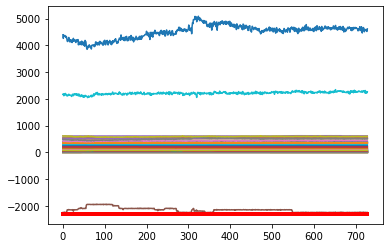

Predicción:  [[[0.9895035  0.01049647]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8018200e+01  1.2463500e+01  5.5456000e+01  7.8470100e+01
  6.1350770e+02  3.1972000e+01  8.1822000e+00  1.8001470e+02
  5.0400000e-02  8.2871700e+01  1.1995920e+02  1.0166600e+01
  6.1136600e+01  1.7864010e+02  2.1069700e+01  1.5263710e+02
  1.8087020e+02  6.9439500e+01 -6.8991000e+00  3.8034000e+00
  1.0708300e+01  7.4760000e+00  1.4993000e+00  7.1782600e+01
  1.4391000e+00  1.5120000e+00  8.3700600e+01  6.2547700e+01
  1.2951000e+00  1.2121000e+00  1.5966000e+00  1.3655000e+00
  1.4961660e+02  8.2780000e-01  8.2990000e-01 -2.2450169e+03
  2.0311140e+02  1.5962000e+00  1.3577000e+00  2.2670564e+03
  4.6263462e+03  1.8481450e+02  1.3977000e+00  1.3850000e+00
  7.8991000e+00  7.8012000e+00  1.7287000e+00  1.3230000e-01
  3.1786500e+01  5.3484890e+02  5.2329170e+02  5.1931670e+02
  5.1994640e+02  5.2015190e+02  2.7017000e+01  2.86

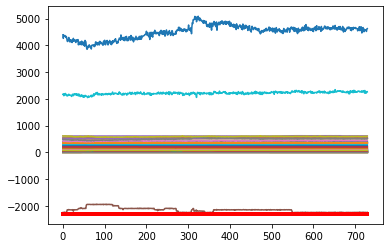

Predicción:  [[[0.98938376 0.01061624]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7386700e+01  1.2552700e+01  5.5296600e+01  7.9500600e+01
  6.1502340e+02  3.1954200e+01  8.1982000e+00  1.7996120e+02
  3.8900000e-02  8.2965300e+01  1.1997240e+02  9.9698000e+00
  6.2684300e+01  1.7888310e+02  2.1584400e+01  1.5064590e+02
  1.8100140e+02  6.9463700e+01 -6.8991000e+00  3.7989000e+00
  9.3715000e+00  7.5041000e+00  1.5000000e+00  7.1784000e+01
  1.4361000e+00  1.5099000e+00  8.3578000e+01  6.3118000e+01
  1.2900000e+00  1.2072000e+00  1.5938000e+00  1.3586000e+00
  1.5154870e+02  8.2420000e-01  8.2920000e-01 -2.2422252e+03
  2.0056510e+02  1.5934000e+00  1.3533000e+00  2.2247767e+03
  4.5912780e+03  1.8481450e+02  1.3883000e+00  1.3786000e+00
  7.9006000e+00  7.7998000e+00  1.7255000e+00  1.3180000e-01
  2.9902900e+01  5.3480010e+02  5.2343510e+02  5.1918020e+02
  5.1977550e+02  5.1998750e+02  2.7419400e+01  2.91

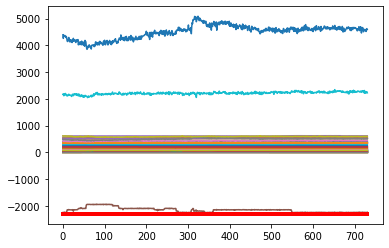

Predicción:  [[[0.9883847  0.01161522]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7159500e+01  1.2651000e+01  5.5789200e+01  7.7855500e+01
  6.1508030e+02  3.2859600e+01  8.1803000e+00  1.7986830e+02
  2.6100000e-02  8.2751600e+01  1.1996190e+02  9.8794000e+00
  6.1830500e+01  1.8024860e+02  2.1906500e+01  1.4813500e+02
  1.8111400e+02  6.9218200e+01 -6.8991000e+00  3.7937000e+00
  1.0012000e+01  7.5005000e+00  1.5008000e+00  7.1735100e+01
  1.4431000e+00  1.5157000e+00  8.3674400e+01  6.2217000e+01
  1.2962000e+00  1.2133000e+00  1.5985000e+00  1.3632000e+00
  1.5237310e+02  8.2510000e-01  8.3090000e-01 -2.2603038e+03
  2.0066680e+02  1.5998000e+00  1.3583000e+00  2.2794100e+03
  4.6030914e+03  1.8481450e+02  1.3944000e+00  1.3843000e+00
  7.8990000e+00  7.8005000e+00  1.7322000e+00  1.3400000e-01
  3.1470000e+01  5.3503330e+02  5.2357760e+02  5.1968090e+02
  5.2026950e+02  5.2044580e+02  2.7422200e+01  2.93

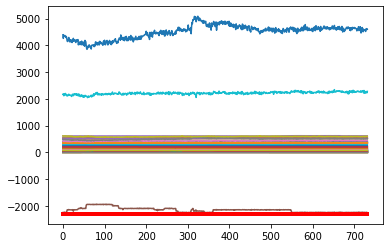

Predicción:  [[[0.98990566 0.0100944 ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7333700e+01  1.2700600e+01  5.5988700e+01  7.7057500e+01
  6.1571390e+02  3.2574000e+01  8.1904000e+00  1.8006270e+02
  1.3300000e-02  8.2662800e+01  1.2008500e+02  9.9634000e+00
  6.2854900e+01  1.7979660e+02  2.1986000e+01  1.4671750e+02
  1.8112460e+02  6.9424100e+01 -6.8991000e+00  3.8023000e+00
  9.3767000e+00  7.5072000e+00  1.5008000e+00  7.1802900e+01
  1.4398000e+00  1.5117000e+00  8.3714500e+01  6.3084000e+01
  1.2917000e+00  1.2100000e+00  1.5976000e+00  1.3620000e+00
  1.5202720e+02  8.2680000e-01  8.3030000e-01 -2.2445502e+03
  2.0319590e+02  1.5959000e+00  1.3548000e+00  2.2100082e+03
  4.5565640e+03  1.8481450e+02  1.3914000e+00  1.3854000e+00
  7.9011000e+00  7.8015000e+00  1.7304000e+00  1.3260000e-01
  2.9534100e+01  5.3528670e+02  5.2391480e+02  5.1950690e+02
  5.2018520e+02  5.2035560e+02  2.7505100e+01  2.93

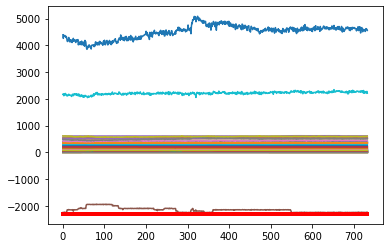

Predicción:  [[[0.987778   0.01222196]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7055800e+01  1.2708100e+01  5.6805900e+01  7.7310400e+01
  6.1553820e+02  3.2366400e+01  8.1914000e+00  1.7997650e+02
  3.6000000e-03  8.2513500e+01  1.2003880e+02  9.9810000e+00
  6.3046700e+01  1.7993950e+02  2.1699500e+01  1.4573670e+02
  1.8120600e+02  6.9558300e+01 -6.8991000e+00  3.8045000e+00
  1.0363200e+01  7.5052000e+00  1.5008000e+00  7.1804100e+01
  1.4355000e+00  1.5069000e+00  8.4083400e+01  6.4037800e+01
  1.2885000e+00  1.2059000e+00  1.5900000e+00  1.3580000e+00
  1.5130690e+02  8.2600000e-01  8.2950000e-01 -2.2469336e+03
  2.0323570e+02  1.5914000e+00  1.3521000e+00  2.2720670e+03
  4.6914360e+03  1.8481450e+02  1.3875000e+00  1.3779000e+00
  7.9023000e+00  7.8006000e+00  1.7249000e+00  1.3460000e-01
  2.9421900e+01  5.3443330e+02  5.2325870e+02  5.1910150e+02
  5.1989140e+02  5.1994550e+02  2.7603200e+01  2.93

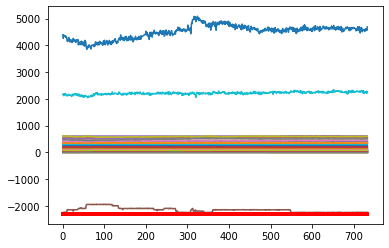

Predicción:  [[[0.9905619  0.00943807]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7840000e+01  1.2588800e+01  5.6931200e+01  7.7957500e+01
  6.1463030e+02  3.2492000e+01  8.1931000e+00  1.7992650e+02
  7.2000000e-03  8.2462900e+01  1.1999310e+02  1.0001600e+01
  6.1548700e+01  1.7946640e+02  2.1621900e+01  1.4739390e+02
  1.8123450e+02  6.9252300e+01 -6.8991000e+00  3.7886000e+00
  1.1366700e+01  7.4963000e+00  1.5012000e+00  7.1770800e+01
  1.4395000e+00  1.5094000e+00  8.3509600e+01  6.3270700e+01
  1.2932000e+00  1.2115000e+00  1.5936000e+00  1.3597000e+00
  1.4939020e+02  8.2840000e-01  8.3000000e-01 -2.2643549e+03
  2.0186930e+02  1.5918000e+00  1.3565000e+00  2.3005441e+03
  4.6069894e+03  1.8481450e+02  1.3860000e+00  1.3798000e+00
  7.8959000e+00  7.7995000e+00  1.7264000e+00  1.3260000e-01
  2.6449700e+01  5.3476220e+02  5.2345130e+02  5.1938420e+02
  5.2010150e+02  5.2029470e+02  2.7826500e+01  2.95

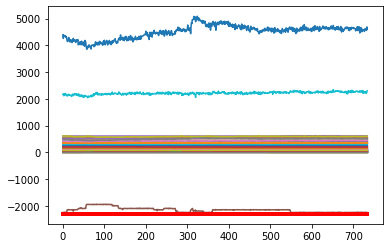

Predicción:  [[[0.99012166 0.00987834]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7875800e+01  1.2527700e+01  5.6750700e+01  7.8389100e+01
  6.1427580e+02  3.3743100e+01  8.2685000e+00  1.7995330e+02
  1.2400000e-02  8.2317700e+01  1.2021810e+02  1.0131000e+01
  6.1728800e+01  1.8131940e+02  2.2020100e+01  1.4972150e+02
  1.8108260e+02  6.9304300e+01 -6.8991000e+00  3.8130000e+00
  1.0896600e+01  7.4787000e+00  1.4999000e+00  7.1828800e+01
  1.4407000e+00  1.5150000e+00  8.2009200e+01  6.3508300e+01
  1.2934000e+00  1.2143000e+00  1.5919000e+00  1.3647000e+00
  1.4914190e+02  8.2460000e-01  8.3030000e-01 -2.2434514e+03
  2.0275110e+02  1.5972000e+00  1.3566000e+00  2.2454625e+03
  4.7113488e+03  1.8481450e+02  1.3901000e+00  1.3875000e+00
  7.9037000e+00  7.7995000e+00  1.7278000e+00  1.3630000e-01
  2.5412100e+01  5.3501780e+02  5.2348000e+02  5.1946190e+02
  5.2021940e+02  5.2053050e+02  2.8035200e+01  2.97

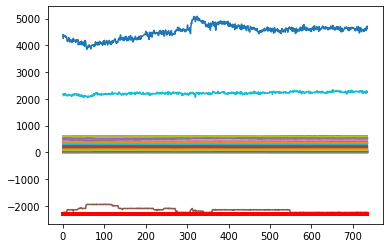

Predicción:  [[[0.99065745 0.00934252]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7105900e+01  1.2539800e+01  5.6806900e+01  7.8725000e+01
  6.1435200e+02  3.3442000e+01  8.2251000e+00  1.8003820e+02
  1.7600000e-02  8.2209100e+01  1.1997970e+02  1.0110600e+01
  6.2023100e+01  1.8034140e+02  2.2372100e+01  1.4917780e+02
  1.8103290e+02  6.9443200e+01 -6.8991000e+00  3.8146000e+00
  1.0729400e+01  7.5168000e+00  1.5005000e+00  7.1725200e+01
  1.4450000e+00  1.5177000e+00  8.1830100e+01  6.3635300e+01
  1.2964000e+00  1.2187000e+00  1.5962000e+00  1.3650000e+00
  1.4833290e+02  8.2600000e-01  8.3040000e-01 -2.2483118e+03
  2.0408280e+02  1.5987000e+00  1.3598000e+00  2.2351062e+03
  4.6155413e+03  1.8481450e+02  1.3903000e+00  1.3899000e+00
  7.8999000e+00  7.8017000e+00  1.7325000e+00  1.3600000e-01
  2.5455300e+01  5.3473340e+02  5.2355520e+02  5.1936990e+02
  5.2028250e+02  5.2050500e+02  2.8311700e+01  2.98

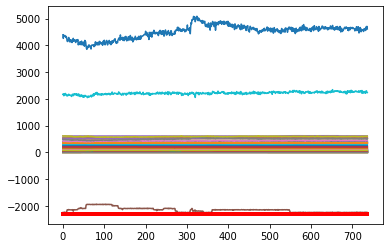

Predicción:  [[[0.98935765 0.01064243]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5934400e+01  1.2464200e+01  5.7049600e+01  7.7189200e+01
  6.1544120e+02  3.3038500e+01  8.1662000e+00  1.8002650e+02
  2.4400000e-02  8.2408700e+01  1.2011590e+02  1.0100700e+01
  6.3012700e+01  1.8013850e+02  2.2270500e+01  1.4672930e+02
  1.8105980e+02  6.9107700e+01 -6.8991000e+00  3.8016000e+00
  1.0045400e+01  7.5125000e+00  1.5000000e+00  7.1758300e+01
  1.4261000e+00  1.4974000e+00  8.1456200e+01  6.2598200e+01
  1.2788000e+00  1.2000000e+00  1.5809000e+00  1.3474000e+00
  1.4932950e+02  8.2770000e-01  8.3040000e-01 -2.2542218e+03
  1.9909370e+02  1.5792000e+00  1.3414000e+00  2.2461125e+03
  4.5450496e+03  1.8481450e+02  1.3768000e+00  1.3707000e+00
  7.8959000e+00  7.7987000e+00  1.7149000e+00  1.3440000e-01
  2.9248200e+01  5.3368660e+02  5.2307720e+02  5.1869590e+02
  5.1955970e+02  5.1993660e+02  2.8307900e+01  2.98

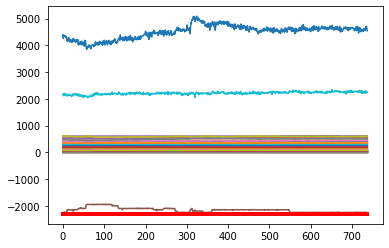

Predicción:  [[[0.98818654 0.01181343]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5724500e+01  1.2538700e+01  5.6741400e+01  7.3711800e+01
  6.1532920e+02  3.4133900e+01  8.2361000e+00  1.8005300e+02
  2.7100000e-02  8.1951400e+01  1.1988510e+02  9.9209000e+00
  6.4021000e+01  1.8137590e+02  2.2254200e+01  1.4639800e+02
  1.8134110e+02  6.9407700e+01 -6.8991000e+00  3.8061000e+00
  1.2035300e+01  7.5029000e+00  1.5002000e+00  7.1740000e+01
  1.4258000e+00  1.4962000e+00  8.3133800e+01  6.1544000e+01
  1.2765000e+00  1.1983000e+00  1.5777000e+00  1.3473000e+00
  1.4997700e+02  8.2850000e-01  8.2980000e-01 -2.2580966e+03
  2.0309840e+02  1.5788000e+00  1.3382000e+00  2.2574716e+03
  4.5429296e+03  1.8481450e+02  1.3779000e+00  1.3705000e+00
  7.8989000e+00  7.7989000e+00  1.7160000e+00  1.3830000e-01
  3.0657600e+01  5.3342280e+02  5.2239620e+02  5.1808560e+02
  5.1908760e+02  5.1943030e+02  2.8557400e+01  3.00

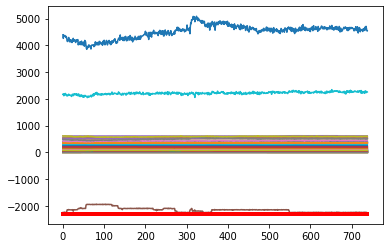

Predicción:  [[[0.9884688  0.01153119]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6277500e+01  1.2489600e+01  5.6416700e+01  7.5039000e+01
  6.1460970e+02  3.3120600e+01  8.2519000e+00  1.8001530e+02
  1.8500000e-02  8.2042900e+01  1.1995440e+02  9.8892000e+00
  6.1392400e+01  1.8064770e+02  2.2632300e+01  1.4274560e+02
  1.8146160e+02  6.9326000e+01 -6.8991000e+00  3.7848000e+00
  1.1186000e+01  7.5189000e+00  1.4982000e+00  7.1852300e+01
  1.4303000e+00  1.5003000e+00  8.3049700e+01  6.1595800e+01
  1.2841000e+00  1.2042000e+00  1.5829000e+00  1.3538000e+00
  1.4969030e+02  8.2850000e-01  8.3000000e-01 -2.2522538e+03
  2.0372070e+02  1.5835000e+00  1.3453000e+00  2.1995040e+03
  4.5382630e+03  1.8481450e+02  1.3843000e+00  1.3776000e+00
  7.9019000e+00  7.7991000e+00  1.7197000e+00  1.3660000e-01
  3.0590100e+01  5.3383110e+02  5.2290470e+02  5.1850820e+02
  5.1953330e+02  5.1983610e+02  2.8915100e+01  3.02

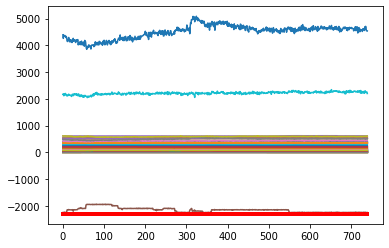

Predicción:  [[[0.9878961  0.01210393]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6905700e+01  1.2415100e+01  5.7067400e+01  7.5571100e+01
  6.1455170e+02  3.2887900e+01  8.2813000e+00  1.8002400e+02
  6.2600000e-02  8.2000700e+01  1.1994070e+02  9.9125000e+00
  6.2373300e+01  1.8043220e+02  2.2982500e+01  1.4226120e+02
  1.8137120e+02  6.9492300e+01 -6.8991000e+00  3.7806000e+00
  1.0860900e+01  7.4944000e+00  1.5002000e+00  7.1738700e+01
  1.4303000e+00  1.5041000e+00  8.2795400e+01  6.1344900e+01
  1.2828000e+00  1.2016000e+00  1.5844000e+00  1.3563000e+00
  1.5183950e+02  8.2830000e-01  8.2970000e-01 -2.2472301e+03
  2.0217460e+02  1.5874000e+00  1.3442000e+00  2.2549826e+03
  4.6718638e+03  1.8481450e+02  1.3868000e+00  1.3814000e+00
  7.9009000e+00  7.8001000e+00  1.7214000e+00  1.3700000e-01
  3.0511600e+01  5.3520000e+02  5.2343520e+02  5.1940250e+02
  5.2039050e+02  5.2063220e+02  2.8826200e+01  3.04

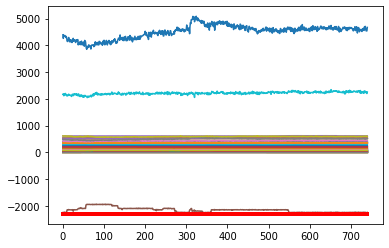

Predicción:  [[[0.9903161 0.0096839]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6321200e+01  1.2433600e+01  5.7892500e+01  7.5461100e+01
  6.1458630e+02  3.2618100e+01  8.2752000e+00  1.7999270e+02
  6.7400000e-02  8.2159600e+01  1.2004810e+02  9.9205000e+00
  6.3565800e+01  1.7910700e+02  2.3040800e+01  1.4130510e+02
  1.8134880e+02  6.9242800e+01 -6.8991000e+00  3.8067000e+00
  1.0033200e+01  7.4927000e+00  1.5001000e+00  7.1784700e+01
  1.4415000e+00  1.5124000e+00  8.1107700e+01  6.0856000e+01
  1.2952000e+00  1.2132000e+00  1.5978000e+00  1.3621000e+00
  1.5215050e+02  8.2830000e-01  8.3010000e-01 -2.2515860e+03
  2.0027340e+02  1.5928000e+00  1.3557000e+00  2.2509733e+03
  4.5288491e+03  1.8481450e+02  1.3895000e+00  1.3880000e+00
  7.8989000e+00  7.7965000e+00  1.7312000e+00  1.3380000e-01
  2.7718100e+01  5.3478660e+02  5.2341510e+02  5.1915980e+02
  5.2019740e+02  5.2034370e+02  2.8903400e+01  3.0391

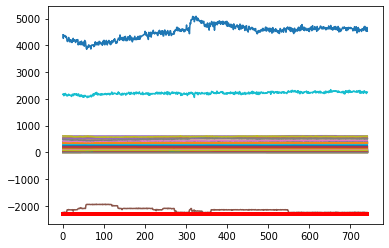

Predicción:  [[[0.98750067 0.01249927]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6361400e+01  1.2391300e+01  5.7663400e+01  7.5898400e+01
  6.1526800e+02  3.2050300e+01  8.2856000e+00  1.8008950e+02
  8.5000000e-03  8.2344900e+01  1.1981430e+02  1.0121500e+01
  6.3766500e+01  1.7813020e+02  2.2990300e+01  1.4329860e+02
  1.8125490e+02  6.9086400e+01 -6.8991000e+00  3.7908000e+00
  1.0168100e+01  7.5149000e+00  1.5004000e+00  7.1797600e+01
  1.4411000e+00  1.5114000e+00  8.1570700e+01  6.0069200e+01
  1.2973000e+00  1.2128000e+00  1.5998000e+00  1.3635000e+00
  1.5289840e+02  8.2870000e-01  8.2990000e-01 -2.2588924e+03
  1.9963230e+02  1.5928000e+00  1.3575000e+00  2.2695848e+03
  4.5567773e+03  1.8481450e+02  1.3908000e+00  1.3896000e+00
  7.8989000e+00  7.7989000e+00  1.7319000e+00  1.3200000e-01
  2.7369300e+01  5.3473120e+02  5.2328050e+02  5.1911400e+02
  5.2016700e+02  5.2024880e+02  2.8978300e+01  3.04

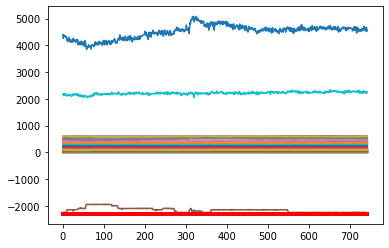

Predicción:  [[[0.98880273 0.01119731]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5835400e+01  1.2372800e+01  5.7821700e+01  7.6019100e+01
  6.1542800e+02  3.2091900e+01  8.2795000e+00  1.8007970e+02
  5.0000000e-04  8.2701700e+01  1.1999850e+02  1.0036000e+01
  6.2968700e+01  1.8014100e+02  2.2804500e+01  1.4167580e+02
  1.8123170e+02  6.9107500e+01 -6.8991000e+00  3.7834000e+00
  1.0416300e+01  7.4861000e+00  1.5004000e+00  7.1700900e+01
  1.4429000e+00  1.5170000e+00  8.1024300e+01  5.9805300e+01
  1.2970000e+00  1.2162000e+00  1.5987000e+00  1.3682000e+00
  1.5187940e+02  8.2810000e-01  8.2980000e-01 -2.2517255e+03
  2.0186690e+02  1.5983000e+00  1.3570000e+00  2.2757175e+03
  4.6035802e+03  1.8481450e+02  1.3982000e+00  1.3932000e+00
  7.9003000e+00  7.8007000e+00  1.7349000e+00  1.3600000e-01
  2.9960800e+01  5.3484890e+02  5.2329980e+02  5.1909210e+02
  5.2016710e+02  5.2015690e+02  2.8981500e+01  3.04

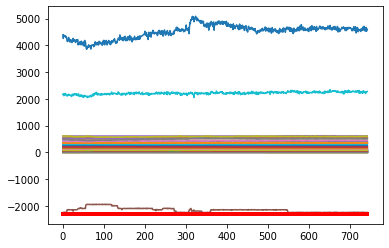

Predicción:  [[[0.98931086 0.01068919]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6841700e+01  1.2384000e+01  5.6221200e+01  7.8543800e+01
  6.1456150e+02  3.2271400e+01  8.2858000e+00  1.8000900e+02
  5.0000000e-04  8.2306100e+01  1.2006390e+02  9.9908000e+00
  5.8606900e+01  1.8062080e+02  2.2629600e+01  1.4320750e+02
  1.8112340e+02  6.9311700e+01 -6.8991000e+00  3.8010000e+00
  1.1951200e+01  7.4979000e+00  1.4987000e+00  7.1811100e+01
  1.4451000e+00  1.5155000e+00  8.2555700e+01  5.9298800e+01
  1.2997000e+00  1.2204000e+00  1.5976000e+00  1.3682000e+00
  1.4883660e+02  8.2900000e-01  8.3010000e-01 -2.2517279e+03
  2.0183450e+02  1.5976000e+00  1.3590000e+00  2.2556479e+03
  4.5902894e+03  1.8481450e+02  1.3983000e+00  1.3939000e+00
  7.9022000e+00  7.8003000e+00  1.7356000e+00  1.3810000e-01
  3.0153700e+01  5.3441550e+02  5.2330260e+02  5.1915780e+02
  5.2019440e+02  5.2023480e+02  2.9140500e+01  3.06

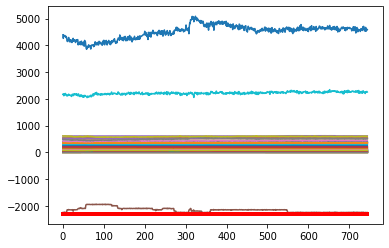

Predicción:  [[[0.9890297  0.01097023]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7804000e+01  1.2332200e+01  5.7762900e+01  7.8497000e+01
  6.1554110e+02  3.2215300e+01  8.2659000e+00  1.8002130e+02
  5.0000000e-04  8.2358900e+01  1.1998970e+02  1.0104200e+01
  5.8911200e+01  1.8044270e+02  2.2579200e+01  1.4558130e+02
  1.8109550e+02  6.9184000e+01 -6.8991000e+00  3.7979000e+00
  1.2608500e+01  7.5008000e+00  1.5001000e+00  7.1799600e+01
  1.4400000e+00  1.5113000e+00  8.1698900e+01  5.9732700e+01
  1.2948000e+00  1.2167000e+00  1.5932000e+00  1.3613000e+00
  1.4785820e+02  8.2830000e-01  8.3010000e-01 -2.2535863e+03
  2.0147850e+02  1.5925000e+00  1.3543000e+00  2.2280894e+03
  4.5658228e+03  1.8481450e+02  1.3905000e+00  1.3861000e+00
  7.8973000e+00  7.8035000e+00  1.7311000e+00  1.3800000e-01
  2.9528100e+01  5.3510220e+02  5.2307720e+02  5.1886980e+02
  5.1992990e+02  5.1992430e+02  2.9310200e+01  3.08

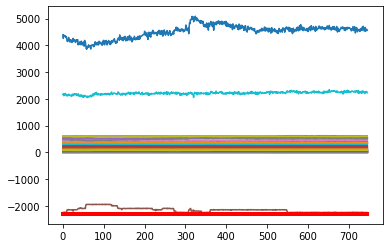

Predicción:  [[[0.9886171  0.01138284]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6278700e+01  1.2311300e+01  5.6118500e+01  7.7310700e+01
  6.1481610e+02  3.2086200e+01  8.3001000e+00  1.7990800e+02
  5.0000000e-04  8.2296100e+01  1.2004610e+02  1.0182400e+01
  6.1000900e+01  1.7972250e+02  2.2906900e+01  1.4698220e+02
  1.8112190e+02  6.9129200e+01 -6.8991000e+00  3.7934000e+00
  1.1967200e+01  7.4916000e+00  1.4998000e+00  7.1736800e+01
  1.4344000e+00  1.5058000e+00  8.2320500e+01  6.0427500e+01
  1.2887000e+00  1.2094000e+00  1.5896000e+00  1.3589000e+00
  1.4907970e+02  8.2890000e-01  8.2980000e-01 -2.2515699e+03
  1.9984700e+02  1.5885000e+00  1.3489000e+00  2.2702432e+03
  4.6808210e+03  1.8481450e+02  1.3864000e+00  1.3844000e+00
  7.9023000e+00  7.8006000e+00  1.7263000e+00  1.3660000e-01
  2.7680500e+01  5.3452000e+02  5.2276890e+02  5.1869650e+02
  5.1967920e+02  5.1970850e+02  2.9599100e+01  3.10

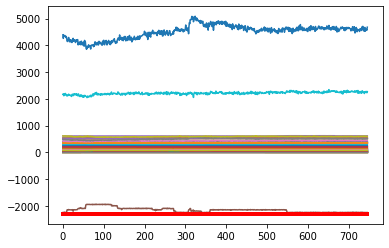

Predicción:  [[[0.9905759  0.00942413]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6675800e+01  1.2288400e+01  5.7922600e+01  7.6105100e+01
  6.1491000e+02  3.1697500e+01  8.3061000e+00  1.8009120e+02
  5.0000000e-04  8.2301400e+01  1.1997780e+02  1.0090300e+01
  6.1807100e+01  1.7849860e+02  2.3146500e+01  1.4347530e+02
  1.8118720e+02  6.8867100e+01 -6.8991000e+00  3.7925000e+00
  1.0324400e+01  7.5188000e+00  1.5014000e+00  7.1819700e+01
  1.4448000e+00  1.5189000e+00  8.0376700e+01  5.9758600e+01
  1.3036000e+00  1.2199000e+00  1.6015000e+00  1.3684000e+00
  1.5051130e+02  8.2880000e-01  8.2960000e-01 -2.2542533e+03
  1.9840380e+02  1.5988000e+00  1.3634000e+00  2.2821399e+03
  4.5632798e+03  1.8481450e+02  1.3950000e+00  1.3947000e+00
  7.8990000e+00  7.7997000e+00  1.7351000e+00  1.3370000e-01
  2.6659500e+01  5.3541340e+02  5.2336330e+02  5.1916710e+02
  5.2010000e+02  5.2014280e+02  2.9587300e+01  3.11

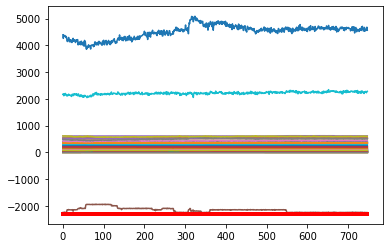

Predicción:  [[[0.98853815 0.01146189]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5356600e+01  1.2325600e+01  5.7168700e+01  7.7196400e+01
  6.1603950e+02  3.1880100e+01  8.2891000e+00  1.8005270e+02
  5.0000000e-04  8.2447100e+01  1.2009900e+02  9.6551000e+00
  6.1865900e+01  1.7890440e+02  2.2817000e+01  1.4384010e+02
  1.8099670e+02  6.8982800e+01 -6.8991000e+00  3.8011000e+00
  9.3987000e+00  7.4887000e+00  1.5004000e+00  7.1844500e+01
  1.4455000e+00  1.5194000e+00  8.1801100e+01  5.8457900e+01
  1.3025000e+00  1.2197000e+00  1.6026000e+00  1.3721000e+00
  1.5133690e+02  8.2790000e-01  8.3010000e-01 -2.2579442e+03
  2.0103570e+02  1.6001000e+00  1.3618000e+00  2.3553123e+03
  4.5075047e+03  1.8481450e+02  1.3986000e+00  1.3972000e+00
  7.9026000e+00  7.7982000e+00  1.7358000e+00  1.3330000e-01
  2.6312900e+01  5.3630830e+02  5.2407000e+02  5.2007850e+02
  5.2082270e+02  5.2102190e+02  2.9211100e+01  3.08

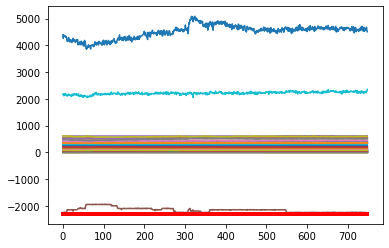

Predicción:  [[[0.98741156 0.01258845]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6229900e+01  1.2321800e+01  5.5847100e+01  7.6767900e+01
  6.1509150e+02  3.1530800e+01  8.3141000e+00  1.8011190e+02
  5.0000000e-04  8.2117800e+01  1.2011740e+02  1.0060200e+01
  6.0890100e+01  1.7906400e+02  2.2128400e+01  1.4252670e+02
  1.8089940e+02  6.9360700e+01 -6.8991000e+00  3.7861000e+00
  1.1707200e+01  7.4928000e+00  1.4980000e+00  7.1745500e+01
  1.4342000e+00  1.5097000e+00  8.2366400e+01  6.0264000e+01
  1.2854000e+00  1.2108000e+00  1.5917000e+00  1.3617000e+00
  1.4839730e+02  8.3040000e-01  8.3080000e-01 -2.2437077e+03
  2.0063810e+02  1.5920000e+00  1.3460000e+00  2.2638051e+03
  4.6981603e+03  1.8481450e+02  1.3881000e+00  1.3859000e+00
  7.9000000e+00  7.8019000e+00  1.7275000e+00  1.3570000e-01
  2.5987000e+01  5.3424170e+02  5.2295540e+02  5.1869170e+02
  5.1949210e+02  5.1969440e+02  2.9213300e+01  3.05

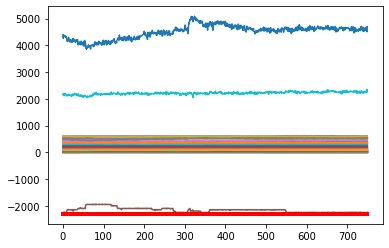

Predicción:  [[[0.9904863  0.00951363]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7594400e+01  1.2240200e+01  5.5722100e+01  7.7174300e+01
  6.1466790e+02  3.2569000e+01  8.2355000e+00  1.7999450e+02
  5.0000000e-04  8.1807300e+01  1.2009010e+02  9.9842000e+00
  6.0450800e+01  1.7987010e+02  2.2382200e+01  1.4383650e+02
  1.8097800e+02  6.9305600e+01 -6.8991000e+00  3.8140000e+00
  1.2407800e+01  7.4815000e+00  1.5009000e+00  7.1826400e+01
  1.4365000e+00  1.5097000e+00  8.0308100e+01  6.1146400e+01
  1.2877000e+00  1.2144000e+00  1.5894000e+00  1.3611000e+00
  1.4654940e+02  8.3030000e-01  8.3090000e-01 -2.2446982e+03
  2.0173350e+02  1.5910000e+00  1.3488000e+00  2.2454186e+03
  4.6880946e+03  1.8481450e+02  1.3860000e+00  1.3823000e+00
  7.8977000e+00  7.8010000e+00  1.7274000e+00  1.3780000e-01
  2.4862600e+01  5.3456560e+02  5.2297890e+02  5.1914560e+02
  5.1998860e+02  5.2004140e+02  2.9508200e+01  3.08

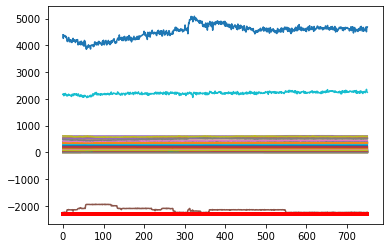

Predicción:  [[[0.99038637 0.00961366]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8088200e+01  1.2191400e+01  5.5796800e+01  7.6133100e+01
  6.1520370e+02  3.2587500e+01  8.3048000e+00  1.7984390e+02
  5.0000000e-04  8.1729000e+01  1.2000940e+02  9.9544000e+00
  6.0788300e+01  1.7898900e+02  2.2479700e+01  1.4349700e+02
  1.8085960e+02  6.9176800e+01 -6.8991000e+00  3.8048000e+00
  1.2437200e+01  7.5175000e+00  1.4996000e+00  7.1824700e+01
  1.4329000e+00  1.5076000e+00  8.0641900e+01  6.1006900e+01
  1.2895000e+00  1.2114000e+00  1.5869000e+00  1.3583000e+00
  1.4635540e+02  8.3030000e-01  8.2970000e-01 -2.2551578e+03
  1.9964550e+02  1.5892000e+00  1.3506000e+00  2.2802030e+03
  4.6706006e+03  1.8481450e+02  1.3829000e+00  1.3800000e+00
  7.9009000e+00  7.8009000e+00  1.7242000e+00  1.3730000e-01
  2.4770200e+01  5.3463440e+02  5.2326450e+02  5.1913710e+02
  5.2011500e+02  5.2003520e+02  2.9390700e+01  3.08

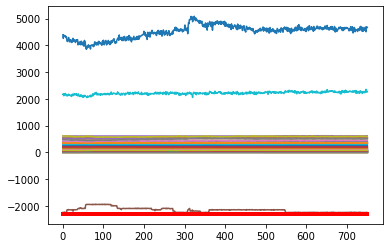

Predicción:  [[[0.9905799  0.00942013]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6537900e+01  1.2284800e+01  5.5806800e+01  7.6051100e+01
  6.1433480e+02  3.5028700e+01  8.2705000e+00  1.7997790e+02
  5.0000000e-04  8.2002700e+01  1.2001560e+02  9.9460000e+00
  6.1736500e+01  1.8103300e+02  2.2701400e+01  1.4398160e+02
  1.8083640e+02  6.9201700e+01 -6.8991000e+00  3.8111000e+00
  1.0785500e+01  7.4876000e+00  1.4997000e+00  7.1758800e+01
  1.4430000e+00  1.5169000e+00  8.1284100e+01  6.0513800e+01
  1.2983000e+00  1.2219000e+00  1.5917000e+00  1.3673000e+00
  1.4692680e+02  8.2850000e-01  8.3000000e-01 -2.2481145e+03
  2.0247200e+02  1.5982000e+00  1.3590000e+00  2.2598442e+03
  4.5980533e+03  1.8481450e+02  1.3924000e+00  1.3909000e+00
  7.9002000e+00  7.7984000e+00  1.7325000e+00  1.4100000e-01
  2.5192500e+01  5.3445220e+02  5.2361790e+02  5.1935410e+02
  5.2017400e+02  5.2013350e+02  2.8991600e+01  3.08

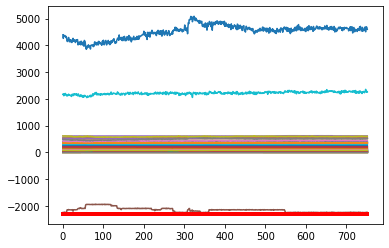

Predicción:  [[[0.9889493  0.01105066]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7331600e+01  1.2245000e+01  5.5372300e+01  7.6661000e+01
  6.1460030e+02  3.5570200e+01  8.2289000e+00  1.8009530e+02
  5.0000000e-04  8.2049300e+01  1.1983570e+02  9.8578000e+00
  6.0557500e+01  1.8217750e+02  2.2313500e+01  1.4466580e+02
  1.8067550e+02  6.9211000e+01 -6.8991000e+00  3.8143000e+00
  1.1755300e+01  7.5030000e+00  1.4973000e+00  7.1813000e+01
  1.4443000e+00  1.5191000e+00  8.2465400e+01  6.0583200e+01
  1.3007000e+00  1.2231000e+00  1.5902000e+00  1.3693000e+00
  1.4787650e+02  8.3280000e-01  8.3440000e-01 -2.2532021e+03
  1.9981510e+02  1.6017000e+00  1.3614000e+00  2.2302202e+03
  4.7239537e+03  1.8481450e+02  1.3948000e+00  1.3882000e+00
  7.8946000e+00  7.7950000e+00  1.7339000e+00  1.4350000e-01
  2.5589300e+01  5.3540970e+02  5.2353250e+02  5.1973520e+02
  5.2048720e+02  5.2033270e+02  2.9529100e+01  3.12

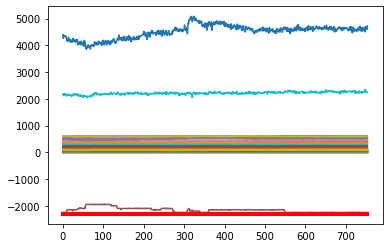

Predicción:  [[[0.99111474 0.00888524]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7142100e+01  1.2230000e+01  5.5450400e+01  7.6152800e+01
  6.1502890e+02  3.5289500e+01  8.2441000e+00  1.7996730e+02
  5.0000000e-04  8.2335100e+01  1.1977630e+02  9.8788000e+00
  6.1399300e+01  1.8127830e+02  2.0899800e+01  1.4467550e+02
  1.8051830e+02  6.9255700e+01 -6.8991000e+00  3.7956000e+00
  1.1155300e+01  7.5098000e+00  1.4988000e+00  7.1808900e+01
  1.4355000e+00  1.5089000e+00  8.2507200e+01  6.1267200e+01
  1.2925000e+00  1.2164000e+00  1.5832000e+00  1.3639000e+00
  1.4769430e+02  8.2330000e-01  8.2770000e-01 -2.2494431e+03
  2.0083250e+02  1.5910000e+00  1.3536000e+00  2.2906167e+03
  4.6607483e+03  1.8481450e+02  1.3892000e+00  1.3824000e+00
  7.9056000e+00  7.8050000e+00  1.7249000e+00  1.4190000e-01
  2.5284100e+01  5.3472250e+02  5.2340490e+02  5.1929280e+02
  5.1988420e+02  5.1978410e+02  2.8763200e+01  3.10

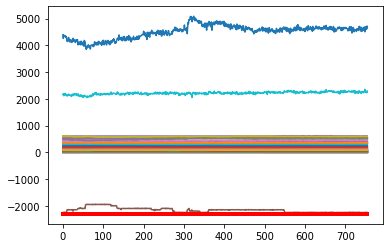

Predicción:  [[[0.990207   0.00979304]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7297900e+01  1.2216000e+01  5.5315600e+01  7.8224100e+01
  6.1533970e+02  3.4883200e+01  8.1983000e+00  1.8012940e+02
  5.0000000e-04  8.2351300e+01  1.1993540e+02  1.0429500e+01
  6.2296100e+01  1.8046220e+02  2.1640800e+01  1.4054710e+02
  1.8068900e+02  6.9365400e+01 -6.8991000e+00  3.7889000e+00
  1.1016300e+01  7.5012000e+00  1.4997000e+00  7.1812700e+01
  1.4277000e+00  1.5028000e+00  8.2350600e+01  6.1933400e+01
  1.2829000e+00  1.2074000e+00  1.5776000e+00  1.3543000e+00
  1.4724710e+02  8.2860000e-01  8.3050000e-01 -2.2475093e+03
  2.0245460e+02  1.5858000e+00  1.3449000e+00  2.2523123e+03
  4.6322391e+03  1.8481450e+02  1.3806000e+00  1.3737000e+00
  7.8989000e+00  7.8016000e+00  1.7184000e+00  1.4090000e-01
  2.6286600e+01  5.3435610e+02  5.2275030e+02  5.1885930e+02
  5.1921520e+02  5.1917780e+02  2.8295200e+01  3.04

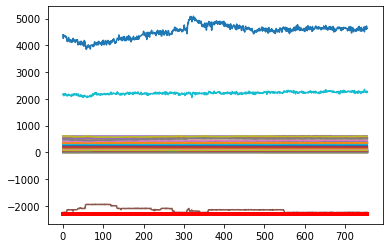

Predicción:  [[[0.9896343  0.01036574]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6059500e+01  1.2165400e+01  5.6164400e+01  7.7082200e+01
  6.1530100e+02  3.4756500e+01  8.1771000e+00  1.8004750e+02
  5.0000000e-04  8.2355900e+01  1.2001770e+02  9.9470000e+00
  6.3163600e+01  1.8032530e+02  2.2317700e+01  1.3726640e+02
  1.8085800e+02  6.9073700e+01 -6.8991000e+00  3.8103000e+00
  1.0542100e+01  7.4992000e+00  1.5001000e+00  7.1792900e+01
  1.4351000e+00  1.5116000e+00  8.3210200e+01  6.2576500e+01
  1.2910000e+00  1.2135000e+00  1.5855000e+00  1.3646000e+00
  1.4987420e+02  8.2890000e-01  8.3000000e-01 -2.2506925e+03
  2.0108410e+02  1.5952000e+00  1.3536000e+00  2.2197507e+03
  4.8033822e+03  1.8481450e+02  1.3898000e+00  1.3834000e+00
  7.8981000e+00  7.7992000e+00  1.7254000e+00  1.4010000e-01
  2.5197500e+01  5.3555610e+02  5.2283300e+02  5.1902790e+02
  5.1950110e+02  5.1947080e+02  2.9121300e+01  3.08

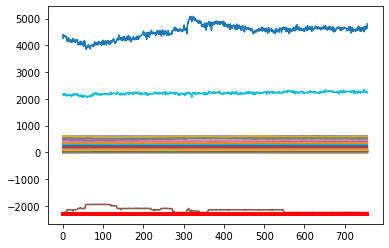

Predicción:  [[[0.9918194  0.00818066]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5698000e+01  1.2162600e+01  5.6103600e+01  7.6280000e+01
  6.1491980e+02  3.4253600e+01  8.2730000e+00  1.7997850e+02
  5.0000000e-04  8.2275700e+01  1.2000940e+02  9.9246000e+00
  6.3585700e+01  1.8076610e+02  2.2598300e+01  1.4060110e+02
  1.8085730e+02  6.9220600e+01 -6.8991000e+00  3.8166000e+00
  9.4459000e+00  7.5078000e+00  1.4992000e+00  7.1833000e+01
  1.4385000e+00  1.5139000e+00  8.3457200e+01  6.2149100e+01
  1.2993000e+00  1.2158000e+00  1.5867000e+00  1.3676000e+00
  1.5181740e+02  8.2520000e-01  8.2960000e-01 -2.2529203e+03
  2.0041620e+02  1.5969000e+00  1.3606000e+00  2.2992795e+03
  4.5759277e+03  1.8481450e+02  1.3955000e+00  1.3903000e+00
  7.9025000e+00  7.8004000e+00  1.7279000e+00  1.4090000e-01
  2.7810800e+01  5.3610720e+02  5.2363810e+02  5.1968630e+02
  5.2001690e+02  5.2017120e+02  2.9222500e+01  3.09

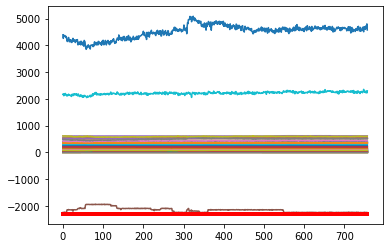

Predicción:  [[[0.9888011  0.01119883]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6140700e+01  1.2177800e+01  5.7393600e+01  7.6653300e+01
  6.1432350e+02  3.5299600e+01  8.1614000e+00  1.8007010e+02
  5.0000000e-04  8.2178700e+01  1.2015870e+02  1.0155500e+01
  6.1528600e+01  1.8175770e+02  2.2791300e+01  1.3699670e+02
  1.8070960e+02  6.9154900e+01 -6.8991000e+00  3.7983000e+00
  1.0262500e+01  7.5100000e+00  1.5005000e+00  7.1834100e+01
  1.4428000e+00  1.5177000e+00  8.3255700e+01  6.2050200e+01
  1.3023000e+00  1.2214000e+00  1.5903000e+00  1.3728000e+00
  1.4964340e+02  8.2660000e-01  8.2960000e-01 -2.2473580e+03
  2.0095400e+02  1.6008000e+00  1.3642000e+00  2.3132586e+03
  4.6236788e+03  1.8481450e+02  1.4001000e+00  1.3980000e+00
  7.8993000e+00  7.8012000e+00  1.7335000e+00  1.4310000e-01
  2.7483900e+01  5.3627110e+02  5.2407940e+02  5.1999830e+02
  5.2029630e+02  5.2047060e+02  2.9429700e+01  3.09

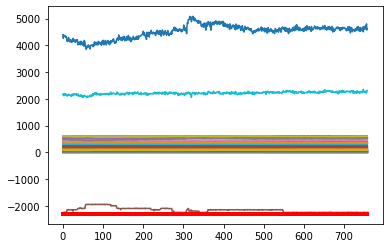

Predicción:  [[[0.989419   0.01058099]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6150100e+01  1.2166400e+01  5.7881600e+01  7.7357700e+01
  6.1549430e+02  3.5471000e+01  8.1319000e+00  1.7995090e+02
  5.0000000e-04  8.1900100e+01  1.2012060e+02  1.0054000e+01
  5.9525400e+01  1.8191160e+02  2.2199800e+01  1.3828990e+02
  1.8063150e+02  6.9286500e+01 -6.8991000e+00  3.7994000e+00
  1.1452800e+01  7.5083000e+00  1.5011000e+00  7.1840000e+01
  1.4362000e+00  1.5074000e+00  8.2011400e+01  6.1571900e+01
  1.2920000e+00  1.2175000e+00  1.5812000e+00  1.3605000e+00
  1.4564320e+02  8.2400000e-01  8.3020000e-01 -2.2434320e+03
  2.0137370e+02  1.5889000e+00  1.3539000e+00  2.2364538e+03
  4.5660554e+03  1.8481450e+02  1.3856000e+00  1.3846000e+00
  7.8977000e+00  7.7983000e+00  1.7248000e+00  1.4350000e-01
  2.5351300e+01  5.3469280e+02  5.2326660e+02  5.1919160e+02
  5.1952250e+02  5.1971250e+02  2.9483700e+01  3.12

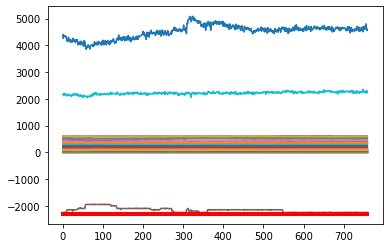

Predicción:  [[[0.9877637  0.01223628]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6129700e+01  1.2183600e+01  5.7242700e+01  7.6571200e+01
  6.1430320e+02  3.9476200e+01  8.2265000e+00  1.8004030e+02
  5.0000000e-04  8.1115700e+01  1.2012150e+02  9.8984000e+00
  5.9467500e+01  1.8513550e+02  2.2063200e+01  1.4381600e+02
  1.8094530e+02  6.9439100e+01 -6.8991000e+00  3.7989000e+00
  1.2484300e+01  7.4813000e+00  1.5004000e+00  7.1851100e+01
  1.4185000e+00  1.4929000e+00  8.1748900e+01  6.0005000e+01
  1.2786000e+00  1.1981000e+00  1.5580000e+00  1.3453000e+00
  1.4570300e+02  8.2290000e-01  8.2880000e-01 -2.2575597e+03
  2.0338620e+02  1.5738000e+00  1.3383000e+00  2.2284957e+03
  4.5469665e+03  1.8481450e+02  1.3750000e+00  1.3657000e+00
  7.8719000e+00  7.7996000e+00  1.7055000e+00  1.4760000e-01
  2.9283100e+01  5.3350220e+02  5.2265550e+02  5.1824300e+02
  5.1880310e+02  5.1903720e+02  2.9526000e+01  3.11

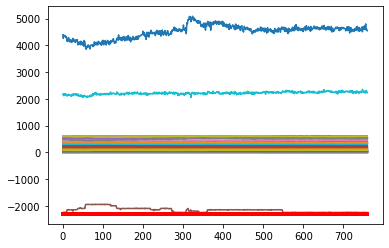

Predicción:  [[[0.9885217  0.01147835]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7062000e+01  1.2237700e+01  5.8350800e+01  7.5984600e+01
  6.1425460e+02  3.3559300e+01  8.2755000e+00  1.8001730e+02
  5.0000000e-04  8.1385800e+01  1.2001650e+02  1.0076200e+01
  6.0151500e+01  1.7927090e+02  2.2097500e+01  1.4802960e+02
  1.8122530e+02  6.9157500e+01 -6.8991000e+00  3.7963000e+00
  1.3207900e+01  7.5028000e+00  1.4988000e+00  7.1791400e+01
  1.4399000e+00  1.5132000e+00  8.2144200e+01  5.9663100e+01
  1.2973000e+00  1.2164000e+00  1.5863000e+00  1.3657000e+00
  1.4780430e+02  8.2260000e-01  8.2930000e-01 -2.2546825e+03
  2.0136260e+02  1.5953000e+00  1.3566000e+00  2.2832391e+03
  4.5602748e+03  1.8481450e+02  1.3963000e+00  1.3868000e+00
  7.4982000e+00  7.7992000e+00  1.7274000e+00  1.4070000e-01
  3.0601200e+01  5.3461700e+02  5.2243200e+02  5.1828930e+02
  5.1894680e+02  5.1922550e+02  2.9385900e+01  3.11

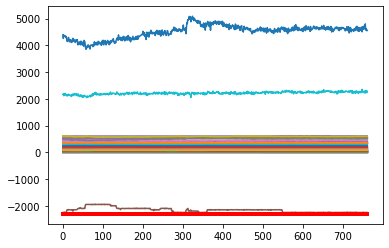

Predicción:  [[[0.9885689  0.01143106]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6838000e+01  1.2228900e+01  5.7131200e+01  7.7571600e+01
  6.1529080e+02  3.2933000e+01  8.2863000e+00  1.8008730e+02
  5.0000000e-04  8.2227900e+01  1.2004570e+02  1.0040300e+01
  6.1817700e+01  1.7925110e+02  2.1865500e+01  1.4675270e+02
  1.8151480e+02  6.9392100e+01 -6.8991000e+00  3.8060000e+00
  1.0832100e+01  7.5142000e+00  1.4999000e+00  7.1856900e+01
  1.4270000e+00  1.5014000e+00  8.2954900e+01  5.9631100e+01
  1.2837000e+00  1.2020000e+00  1.5753000e+00  1.3520000e+00
  1.4958150e+02  8.2310000e-01  8.2950000e-01 -2.2464752e+03
  2.0330540e+02  1.5841000e+00  1.3432000e+00  2.2490147e+03
  4.6401340e+03  1.8481450e+02  1.3828000e+00  1.3727000e+00
  7.6277000e+00  7.8012000e+00  1.7148000e+00  1.3970000e-01
  3.0716100e+01  5.3487030e+02  5.2300070e+02  5.1889430e+02
  5.1954970e+02  5.1988180e+02  2.8687800e+01  3.06

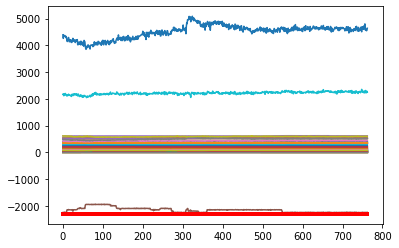

Predicción:  [[[0.98975813 0.01024187]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7521600e+01  1.2232000e+01  5.7518000e+01  7.6420600e+01
  6.1491110e+02  3.2330100e+01  8.3255000e+00  1.7997540e+02
  5.0000000e-04  8.2121000e+01  1.2009230e+02  9.9793000e+00
  6.1827300e+01  1.7929870e+02  2.2091300e+01  1.4463620e+02
  1.8156230e+02  6.9355800e+01 -6.8991000e+00  3.8952000e+00
  1.1625800e+01  7.5160000e+00  1.5009000e+00  7.1794700e+01
  1.4412000e+00  1.5128000e+00  8.3597300e+01  5.9060000e+01
  1.2987000e+00  1.2150000e+00  1.5872000e+00  1.3661000e+00
  1.5055480e+02  8.2380000e-01  8.2960000e-01 -2.2520475e+03
  2.0201840e+02  1.5960000e+00  1.3580000e+00  2.2503724e+03
  4.6173778e+03  1.8481450e+02  1.3967000e+00  1.3874000e+00
  7.6989000e+00  7.7999000e+00  1.7275000e+00  1.4030000e-01
  3.0777600e+01  5.3581050e+02  5.2380790e+02  5.1949540e+02
  5.2020880e+02  5.2048990e+02  2.8555500e+01  3.02

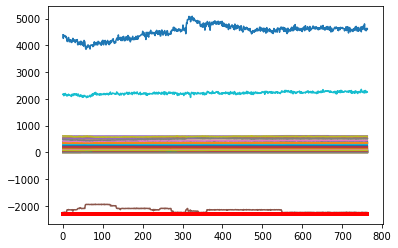

Predicción:  [[[0.98959726 0.01040272]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5969100e+01  1.2283700e+01  5.7810600e+01  7.6969900e+01
  6.1536190e+02  3.2068000e+01  8.3490000e+00  1.7995770e+02
  5.0000000e-04  8.2244000e+01  1.1996140e+02  1.0055700e+01
  6.1484200e+01  1.7907930e+02  2.2251000e+01  1.4178250e+02
  1.8145230e+02  6.9348400e+01 -6.8991000e+00  3.8989000e+00
  1.0484600e+01  7.4595000e+00  1.5006000e+00  7.1802100e+01
  1.4443000e+00  1.5177000e+00  8.2696400e+01  5.9406900e+01
  1.2998000e+00  1.2178000e+00  1.5913000e+00  1.3701000e+00
  1.5120850e+02  8.2360000e-01  8.2970000e-01 -2.2495838e+03
  1.9926500e+02  1.6006000e+00  1.3598000e+00  2.2991350e+03
  4.6260876e+03  1.8481450e+02  1.4009000e+00  1.3934000e+00
  7.7008000e+00  7.7988000e+00  1.7306000e+00  1.3930000e-01
  3.0733300e+01  5.3562280e+02  5.2406670e+02  5.1967980e+02
  5.2039360e+02  5.2075500e+02  2.8440200e+01  3.02

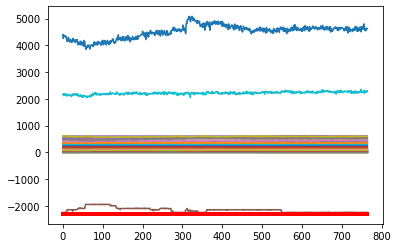

Predicción:  [[[0.9896136  0.01038639]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6606600e+01  1.2283100e+01  5.7612700e+01  7.7676500e+01
  6.1600100e+02  3.1313000e+01  8.3325000e+00  1.8001350e+02
  5.0000000e-04  8.2122300e+01  1.1998300e+02  9.8931000e+00
  6.2008600e+01  1.7832440e+02  2.2270000e+01  1.4179900e+02
  1.8135960e+02  6.9258800e+01 -6.8991000e+00  3.8994000e+00
  9.6966000e+00  7.5029000e+00  1.4996000e+00  7.1819700e+01
  1.4499000e+00  1.5246000e+00  8.2403400e+01  5.9905100e+01
  1.3054000e+00  1.2217000e+00  1.5998000e+00  1.3736000e+00
  1.5223160e+02  8.2410000e-01  8.3030000e-01 -2.2504548e+03
  2.0267560e+02  1.6073000e+00  1.3656000e+00  2.2519118e+03
  4.6594658e+03  1.8481450e+02  1.4044000e+00  1.3960000e+00
  7.6991000e+00  7.7987000e+00  1.7381000e+00  1.3820000e-01
  3.0874400e+01  5.3596670e+02  5.2410580e+02  5.1993740e+02
  5.2060680e+02  5.2083360e+02  2.8437800e+01  3.01

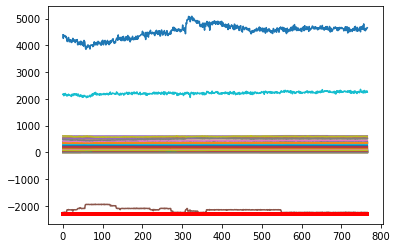

Predicción:  [[[0.99026674 0.00973327]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6511100e+01  1.2300000e+01  5.7466800e+01  7.7704700e+01
  6.1622510e+02  3.0374500e+01  8.3583000e+00  1.8000670e+02
  5.0000000e-04  8.2100000e+01  1.2006050e+02  9.9944000e+00
  6.2545600e+01  1.7750770e+02  2.2034700e+01  1.4243640e+02
  1.8133550e+02  6.9186800e+01 -6.8991000e+00  3.9077000e+00
  1.0136900e+01  7.5218000e+00  1.4988000e+00  7.1773200e+01
  1.4408000e+00  1.5160000e+00  8.3191700e+01  5.9873600e+01
  1.2986000e+00  1.2127000e+00  1.5915000e+00  1.3663000e+00
  1.5205920e+02  8.2370000e-01  8.2990000e-01 -2.2500953e+03
  2.0372110e+02  1.5994000e+00  1.3587000e+00  2.2043464e+03
  4.6290780e+03  1.8481450e+02  1.3975000e+00  1.3906000e+00
  7.6983000e+00  7.8008000e+00  1.7293000e+00  1.3810000e-01
  3.1138900e+01  5.3536670e+02  5.2351810e+02  5.1909040e+02
  5.1982620e+02  5.2000660e+02  2.8332200e+01  3.00

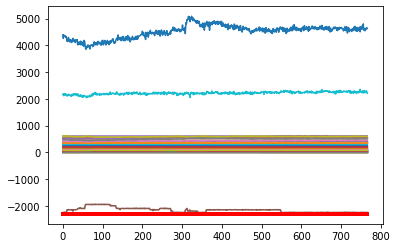

Predicción:  [[[0.98981327 0.01018678]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6723400e+01  1.2311700e+01  5.7321300e+01  7.6607200e+01
  6.1468330e+02  2.9879600e+01  8.3501000e+00  1.7998120e+02
  5.0000000e-04  8.2441400e+01  1.1982540e+02  1.0066900e+01
  6.2244400e+01  1.7763230e+02  2.2151800e+01  1.4161410e+02
  1.8131940e+02  6.9218700e+01 -6.8991000e+00  3.9134000e+00
  9.7088000e+00  7.4896000e+00  1.5002000e+00  7.1779200e+01
  1.4450000e+00  1.5180000e+00  8.3146000e+01  5.9033700e+01
  1.3039000e+00  1.2155000e+00  1.5947000e+00  1.3679000e+00
  1.5296520e+02  8.2520000e-01  8.2940000e-01 -2.2509814e+03
  2.0253570e+02  1.6011000e+00  1.3629000e+00  2.2664454e+03
  4.6159478e+03  1.8481450e+02  1.3977000e+00  1.3895000e+00
  7.7010000e+00  7.7991000e+00  1.7348000e+00  1.4050000e-01
  2.9825400e+01  5.3587610e+02  5.2375030e+02  5.1944280e+02
  5.2019100e+02  5.2038390e+02  2.8392200e+01  2.98

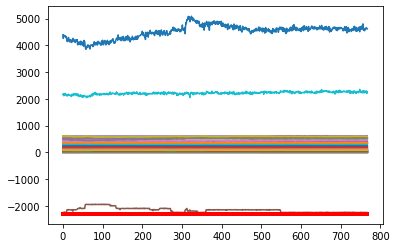

Predicción:  [[[0.98952484 0.01047518]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7849000e+01  1.2305000e+01  5.7982500e+01  7.5730700e+01
  6.1540460e+02  2.9786300e+01  8.3218000e+00  1.7998250e+02
  5.0000000e-04  8.2514700e+01  1.1998160e+02  1.0052300e+01
  6.1813200e+01  1.7855710e+02  2.1873600e+01  1.4415010e+02
  1.8118220e+02  6.9177800e+01 -6.8991000e+00  3.9152000e+00
  1.1365200e+01  7.5122000e+00  1.4991000e+00  7.1856000e+01
  1.4392000e+00  1.5127000e+00  8.3013800e+01  5.9064800e+01
  1.2958000e+00  1.2120000e+00  1.5880000e+00  1.3649000e+00
  1.5121420e+02  8.2730000e-01  8.3010000e-01 -2.2480484e+03
  1.9713400e+02  1.5965000e+00  1.3548000e+00  2.2413639e+03
  4.6859484e+03  1.8481450e+02  1.3926000e+00  1.3825000e+00
  7.7001000e+00  7.7986000e+00  1.7295000e+00  1.4160000e-01
  2.7657700e+01  5.3586440e+02  5.2353110e+02  5.1935440e+02
  5.1994130e+02  5.2026120e+02  2.8332400e+01  2.99

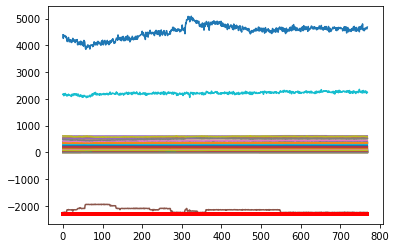

Predicción:  [[[0.9905239  0.00947608]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9349400e+01  1.2244900e+01  5.8029300e+01  7.7015500e+01
  6.1497610e+02  2.9640800e+01  8.2769000e+00  1.8002900e+02
  5.0000000e-04  8.2258400e+01  1.1992150e+02  1.0034000e+01
  5.9681000e+01  1.7803810e+02  2.1962900e+01  1.4500680e+02
  1.8128630e+02  6.9384300e+01 -6.8991000e+00  3.9081000e+00
  1.2095200e+01  7.4823000e+00  1.5009000e+00  7.1810200e+01
  1.4404000e+00  1.5132000e+00  8.3869000e+01  5.9300600e+01
  1.2964000e+00  1.2149000e+00  1.5875000e+00  1.3672000e+00
  1.5015100e+02  8.2760000e-01  8.2980000e-01 -2.2441873e+03
  2.0225780e+02  1.5964000e+00  1.3559000e+00  2.2632096e+03
  4.6160642e+03  1.8481450e+02  1.3943000e+00  1.3842000e+00
  7.7006000e+00  7.8003000e+00  1.7305000e+00  1.4330000e-01
  2.6858500e+01  5.3622130e+02  5.2366590e+02  5.1946860e+02
  5.1999370e+02  5.2035720e+02  2.8241100e+01  2.98

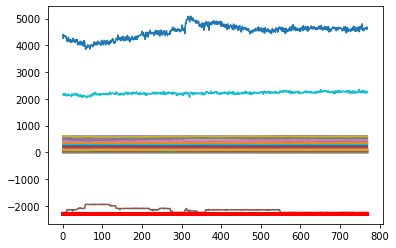

Predicción:  [[[0.98907894 0.01092101]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7652400e+01  1.2408800e+01  5.7643100e+01  7.8241400e+01
  6.1421890e+02  3.0038300e+01  8.2698000e+00  1.8001340e+02
  1.8000000e-03  8.2548200e+01  1.1998010e+02  1.0070000e+01
  6.1939700e+01  1.7783880e+02  2.2016100e+01  1.4393210e+02
  1.8149030e+02  6.9376200e+01 -6.8991000e+00  3.8921000e+00
  1.1460900e+01  7.5087000e+00  1.5001000e+00  7.1827500e+01
  1.4355000e+00  1.5092000e+00  8.1779400e+01  6.0051400e+01
  1.2940000e+00  1.2085000e+00  1.5806000e+00  1.3601000e+00
  1.5088460e+02  8.2750000e-01  8.2960000e-01 -2.2565349e+03
  2.0204890e+02  1.5912000e+00  1.3535000e+00  2.2212815e+03
  4.6381850e+03  1.8481450e+02  1.3883000e+00  1.3795000e+00
  7.6996000e+00  7.8007000e+00  1.7238000e+00  1.4340000e-01
  2.8004500e+01  5.3560470e+02  5.2320300e+02  5.1893500e+02
  5.1952470e+02  5.1992210e+02  2.8090300e+01  2.99

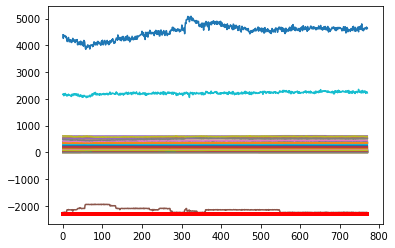

Predicción:  [[[0.99026334 0.00973665]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6398400e+01  1.2379800e+01  5.8050000e+01  7.7177300e+01
  6.1530360e+02  3.0054800e+01  8.2658000e+00  1.7992490e+02
  8.1000000e-03  8.2560200e+01  1.2005230e+02  1.0042300e+01
  6.3685400e+01  1.7855050e+02  2.2544200e+01  1.4005140e+02
  1.8137390e+02  6.9368400e+01 -6.8991000e+00  3.8982000e+00
  8.8227000e+00  7.4753000e+00  1.5004000e+00  7.1868300e+01
  1.4471000e+00  1.5247000e+00  8.2133100e+01  5.9593700e+01
  1.3107000e+00  1.2187000e+00  1.5939000e+00  1.3732000e+00
  1.5304440e+02  8.2710000e-01  8.3020000e-01 -2.2440777e+03
  2.0172320e+02  1.6062000e+00  1.3699000e+00  2.2364396e+03
  4.6444994e+03  1.8481450e+02  1.4012000e+00  1.3938000e+00
  7.6993000e+00  7.8028000e+00  1.7354000e+00  1.4130000e-01
  2.7839800e+01  5.3654890e+02  5.2389220e+02  5.1984190e+02
  5.2050540e+02  5.2064680e+02  2.8492500e+01  3.00

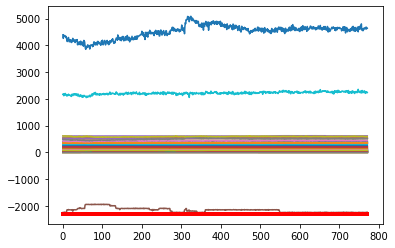

Predicción:  [[[0.98963404 0.01036594]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6609000e+01  1.2375400e+01  5.7727100e+01  7.6489100e+01
  6.1581360e+02  3.0664500e+01  8.2559000e+00  1.7992250e+02
  1.4900000e-02  8.2562000e+01  1.2003140e+02  1.0006000e+01
  6.3743600e+01  1.7795500e+02  2.2365100e+01  1.3867020e+02
  1.8118440e+02  6.9396200e+01 -6.8991000e+00  3.8856000e+00
  9.2380000e+00  7.5037000e+00  1.5013000e+00  7.1825800e+01
  1.4460000e+00  1.5233000e+00  8.2001600e+01  5.9284200e+01
  1.3034000e+00  1.2170000e+00  1.5940000e+00  1.3710000e+00
  1.5367190e+02  8.2810000e-01  8.2950000e-01 -2.2472772e+03
  2.0180670e+02  1.6059000e+00  1.3626000e+00  2.2120460e+03
  4.6461175e+03  1.8481450e+02  1.3981000e+00  1.3915000e+00
  7.7020000e+00  7.8009000e+00  1.7351000e+00  1.4110000e-01
  2.7244900e+01  5.3622500e+02  5.2356730e+02  5.1925600e+02
  5.1998450e+02  5.2011430e+02  2.8377200e+01  3.00

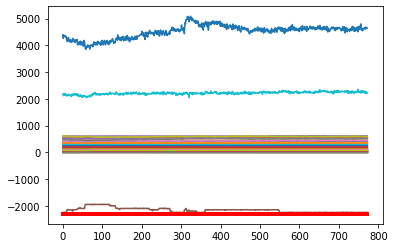

Predicción:  [[[0.9899256  0.01007433]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6666600e+01  1.2365400e+01  5.6833900e+01  7.6559700e+01
  6.1651200e+02  3.0793200e+01  8.2552000e+00  1.8004630e+02
  1.7900000e-02  8.2650100e+01  1.1998050e+02  9.9413000e+00
  6.2894000e+01  1.7860330e+02  2.1961300e+01  1.3731810e+02
  1.8104070e+02  6.9374500e+01 -6.8991000e+00  3.9083000e+00
  9.1825000e+00  7.5292000e+00  1.5000000e+00  7.1841900e+01
  1.4459000e+00  1.5213000e+00  8.1725000e+01  5.9929600e+01
  1.3050000e+00  1.2177000e+00  1.5931000e+00  1.3692000e+00
  1.5274630e+02  8.2640000e-01  8.2990000e-01 -2.2446360e+03
  1.9868880e+02  1.6028000e+00  1.3652000e+00  2.2210381e+03
  4.6089487e+03  1.8481450e+02  1.3963000e+00  1.3900000e+00
  7.6974000e+00  7.8000000e+00  1.7352000e+00  1.4230000e-01
  2.7194700e+01  5.3622100e+02  5.2387870e+02  5.1936070e+02
  5.2003730e+02  5.2011350e+02  2.8217500e+01  2.98

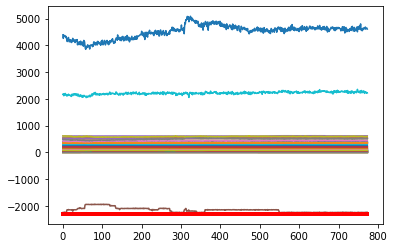

Predicción:  [[[0.9889563  0.01104375]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7910600e+01  1.2344700e+01  5.7061500e+01  7.6232300e+01
  6.1555320e+02  3.1382300e+01  8.2405000e+00  1.8006420e+02
  1.7800000e-02  8.2330500e+01  1.2001290e+02  9.7661000e+00
  6.0933600e+01  1.7994840e+02  2.1487600e+01  1.3877910e+02
  1.8099670e+02  6.9358000e+01 -6.8991000e+00  3.8986000e+00
  1.2084800e+01  7.4771000e+00  1.4996000e+00  7.1801700e+01
  1.4320000e+00  1.5079000e+00  8.0773200e+01  6.1341000e+01
  1.2884000e+00  1.2078000e+00  1.5742000e+00  1.3582000e+00
  1.4934270e+02  8.2730000e-01  8.3050000e-01 -2.2496775e+03
  2.0056490e+02  1.5890000e+00  1.3493000e+00  2.2150178e+03
  4.6162248e+03  1.8481450e+02  1.3850000e+00  1.3811000e+00
  7.6977000e+00  7.7994000e+00  1.7214000e+00  1.4720000e-01
  2.6607800e+01  5.3530510e+02  5.2320960e+02  5.1896170e+02
  5.1956900e+02  5.1976660e+02  2.7963400e+01  2.96

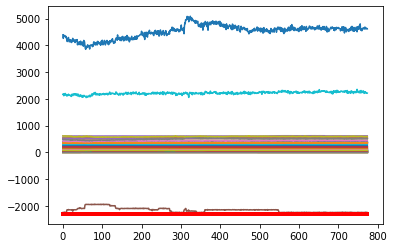

Predicción:  [[[0.9894741  0.01052587]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7946800e+01  1.2275900e+01  5.6755100e+01  7.6004500e+01
  6.1501260e+02  3.1777600e+01  8.2989000e+00  1.8000830e+02
  1.7500000e-02  8.2226400e+01  1.2001310e+02  1.0114300e+01
  6.0171400e+01  1.7999940e+02  2.1370900e+01  1.4195090e+02
  1.8124420e+02  6.9530700e+01 -6.8991000e+00  3.9043000e+00
  1.2895200e+01  7.5139000e+00  1.5007000e+00  7.1788600e+01
  1.4298000e+00  1.5042000e+00  8.1772500e+01  6.0630900e+01
  1.2834000e+00  1.2044000e+00  1.5697000e+00  1.3537000e+00
  1.4862560e+02  8.2450000e-01  8.2950000e-01 -2.2494136e+03
  2.0389930e+02  1.5863000e+00  1.3443000e+00  2.2375500e+03
  4.6300840e+03  1.8481450e+02  1.3836000e+00  1.3803000e+00
  7.7001000e+00  7.7986000e+00  1.7179000e+00  1.4840000e-01
  2.9626100e+01  5.3536050e+02  5.2285490e+02  5.1863620e+02
  5.1928960e+02  5.1951670e+02  2.7966600e+01  2.95

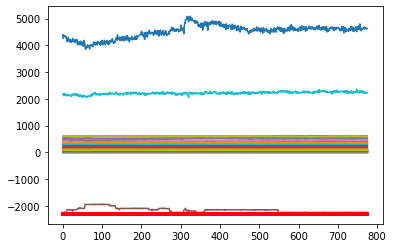

Predicción:  [[[0.9897181  0.01028197]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7719900e+01  1.2362900e+01  5.6427400e+01  7.6519500e+01
  6.1473160e+02  3.1321300e+01  8.2969000e+00  1.8002500e+02
  1.7300000e-02  8.2234000e+01  1.2006380e+02  1.0004300e+01
  6.0191400e+01  1.7947990e+02  2.1633200e+01  1.4326510e+02
  1.8131830e+02  6.9118300e+01 -6.8991000e+00  3.9057000e+00
  1.2284300e+01  7.4979000e+00  1.5004000e+00  7.1781200e+01
  1.4371000e+00  1.5104000e+00  8.2545500e+01  6.0418000e+01
  1.2912000e+00  1.2109000e+00  1.5765000e+00  1.3611000e+00
  1.4973660e+02  8.2530000e-01  8.3000000e-01 -2.2566555e+03
  2.0006530e+02  1.5932000e+00  1.3518000e+00  2.2836079e+03
  4.6588567e+03  1.8481450e+02  1.3918000e+00  1.3870000e+00
  7.7009000e+00  7.7997000e+00  1.7235000e+00  1.4710000e-01
  3.0709100e+01  5.3604670e+02  5.2307890e+02  5.1870860e+02
  5.1935790e+02  5.1962850e+02  2.7748400e+01  2.94

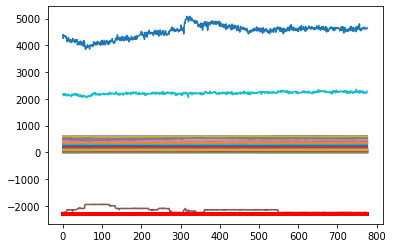

Predicción:  [[[0.99051887 0.00948116]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7006700e+01  1.2373000e+01  5.6580700e+01  7.7648700e+01
  6.1463620e+02  3.0790900e+01  8.3063000e+00  1.8015230e+02
  1.7000000e-02  8.2483100e+01  1.2001940e+02  9.9770000e+00
  6.2287200e+01  1.7877210e+02  2.2670600e+01  1.4248970e+02
  1.8149170e+02  6.9402700e+01 -6.8991000e+00  3.8969000e+00
  1.0662500e+01  7.5024000e+00  1.4994000e+00  7.1859600e+01
  1.4435000e+00  1.5188000e+00  8.2312000e+01  6.0336400e+01
  1.3013000e+00  1.2158000e+00  1.5844000e+00  1.3670000e+00
  1.5196560e+02  8.2530000e-01  8.3040000e-01 -2.2483912e+03
  1.9926830e+02  1.6009000e+00  1.3618000e+00  2.2870085e+03
  4.6135307e+03  1.8481450e+02  1.3980000e+00  1.3950000e+00
  7.6997000e+00  7.7995000e+00  1.7285000e+00  1.4450000e-01
  3.1019600e+01  5.3607020e+02  5.2326160e+02  5.1926050e+02
  5.1991440e+02  5.2025930e+02  2.8019200e+01  2.96

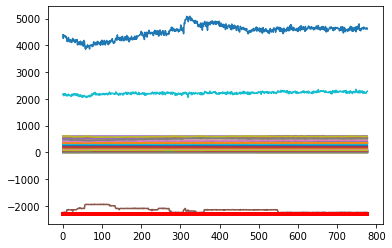

Predicción:  [[[0.98925436 0.01074559]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6455300e+01  1.2379200e+01  5.5593800e+01  7.7348200e+01
  6.1491570e+02  3.1813400e+01  8.3088000e+00  1.8012140e+02
  1.6800000e-02  8.2588400e+01  1.2012510e+02  9.9176000e+00
  6.2701100e+01  1.7977860e+02  2.2970200e+01  1.3877870e+02
  1.8124170e+02  6.9275100e+01 -6.8991000e+00  3.8916000e+00
  8.8954000e+00  7.5068000e+00  1.5006000e+00  7.1752900e+01
  1.4513000e+00  1.5279000e+00  8.2434600e+01  6.0225600e+01
  1.3084000e+00  1.2222000e+00  1.5931000e+00  1.3745000e+00
  1.5335020e+02  8.2480000e-01  8.3000000e-01 -2.2495130e+03
  1.9972280e+02  1.6097000e+00  1.3688000e+00  2.2695587e+03
  4.6197775e+03  1.8481450e+02  1.4055000e+00  1.4018000e+00
  7.7025000e+00  7.8001000e+00  1.7371000e+00  1.4410000e-01
  3.0987100e+01  5.3690590e+02  5.2390300e+02  5.1983120e+02
  5.2054360e+02  5.2073020e+02  2.8281000e+01  3.00

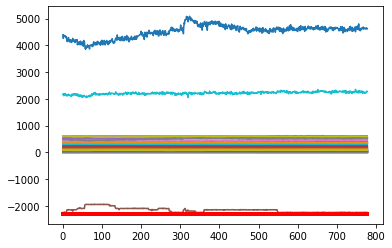

Predicción:  [[[0.98947537 0.01052467]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6345300e+01  1.2492700e+01  5.5595200e+01  7.5060500e+01
  6.1463660e+02  3.2143300e+01  8.2878000e+00  1.7988540e+02
  1.6800000e-02  8.2240600e+01  1.1995700e+02  9.9699000e+00
  6.2783200e+01  1.8053310e+02  2.1896000e+01  1.3831050e+02
  1.8117480e+02  6.9344900e+01 -6.8991000e+00  3.7986000e+00
  1.0507200e+01  7.4973000e+00  1.5004000e+00  7.1826800e+01
  1.4392000e+00  1.5126000e+00  8.2584200e+01  6.0904100e+01
  1.2929000e+00  1.2107000e+00  1.5782000e+00  1.3625000e+00
  1.5220740e+02  8.2640000e-01  8.2730000e-01 -2.2464340e+03
  1.9887100e+02  1.5948000e+00  1.3541000e+00  2.2450433e+03
  4.5987955e+03  1.8481450e+02  1.3932000e+00  1.3883000e+00
  7.7000000e+00  7.7942000e+00  1.7272000e+00  1.4940000e-01
  3.0602200e+01  5.3656780e+02  5.2350950e+02  5.1936800e+02
  5.2003630e+02  5.2027840e+02  2.9244900e+01  3.05

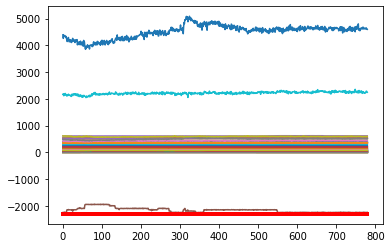

Predicción:  [[[0.98886275 0.01113719]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6073300e+01  1.2432900e+01  5.5276300e+01  7.5885100e+01
  6.1491510e+02  3.1786000e+01  8.2496000e+00  1.7998060e+02
  1.6800000e-02  8.1846100e+01  1.1992530e+02  9.8162000e+00
  6.0090900e+01  1.8144780e+02  2.2003600e+01  1.3994280e+02
  1.8123620e+02  6.9512200e+01 -6.8991000e+00  3.8077000e+00
  1.1915600e+01  7.5037000e+00  1.4994000e+00  7.1831500e+01
  1.4382000e+00  1.5130000e+00  8.2281100e+01  6.0833100e+01
  1.2934000e+00  1.2126000e+00  1.5704000e+00  1.3645000e+00
  1.5071640e+02  8.2480000e-01  8.3040000e-01 -2.2471396e+03
  2.0239860e+02  1.5951000e+00  1.3541000e+00  2.2375121e+03
  4.6457627e+03  1.8481450e+02  1.3950000e+00  1.3868000e+00
  7.6997000e+00  7.8062000e+00  1.7252000e+00  1.5470000e-01
  3.0343000e+01  5.3711560e+02  5.2388630e+02  5.1963140e+02
  5.2036670e+02  5.2053780e+02  2.8559100e+01  2.98

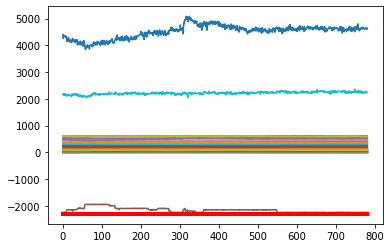

Predicción:  [[[0.9899154  0.01008465]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6371400e+01  1.2482400e+01  5.5163200e+01  7.8889700e+01
  6.1581270e+02  3.1798000e+01  8.2588000e+00  1.7993540e+02
  1.6700000e-02  8.1814700e+01  1.1999280e+02  9.8765000e+00
  6.1218300e+01  1.8040220e+02  2.2057500e+01  1.4112360e+02
  1.8126030e+02  6.9375000e+01 -6.8991000e+00  3.7933000e+00
  1.0372800e+01  7.5123000e+00  1.4984000e+00  7.1771200e+01
  1.4416000e+00  1.5132000e+00  8.2160900e+01  6.0177800e+01
  1.2960000e+00  1.2147000e+00  1.5780000e+00  1.3641000e+00
  1.5076410e+02  8.2580000e-01  8.2990000e-01 -2.2525940e+03
  2.0259850e+02  1.5960000e+00  1.3558000e+00  2.2364978e+03
  4.5728335e+03  1.8481450e+02  1.3947000e+00  1.3847000e+00
  7.6976000e+00  7.8011000e+00  1.7286000e+00  1.5050000e-01
  3.0857000e+01  5.3515330e+02  5.2272490e+02  5.1845100e+02
  5.1910750e+02  5.1935360e+02  2.8395900e+01  2.97

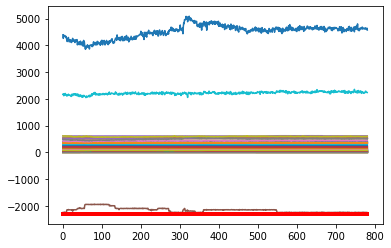

Predicción:  [[[0.9887262  0.01127388]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6700000e+01  1.2450900e+01  5.6097300e+01  7.8734700e+01
  6.1582050e+02  3.1244700e+01  8.2643000e+00  1.8018460e+02
  1.2900000e-02  8.1861200e+01  1.1983930e+02  1.0073100e+01
  6.2246000e+01  1.8001140e+02  2.2082500e+01  1.4476630e+02
  1.8132320e+02  6.9461300e+01 -6.8991000e+00  3.7968000e+00
  1.0285600e+01  7.4902000e+00  1.4992000e+00  7.1768000e+01
  1.4443000e+00  1.5186000e+00  8.2966500e+01  6.0107700e+01
  1.2953000e+00  1.2162000e+00  1.5825000e+00  1.3680000e+00
  1.5151790e+02  8.2580000e-01  8.3060000e-01 -2.2493380e+03
  2.0302540e+02  1.6009000e+00  1.3554000e+00  2.1930479e+03
  4.6393823e+03  1.8481450e+02  1.3988000e+00  1.3888000e+00
  7.7026000e+00  7.7981000e+00  1.7328000e+00  1.5040000e-01
  3.0944300e+01  5.3644670e+02  5.2339220e+02  5.1932560e+02
  5.1997030e+02  5.2026860e+02  2.8693500e+01  3.04

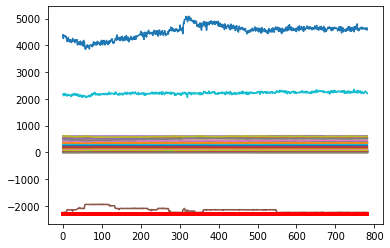

Predicción:  [[[0.9899955  0.01000453]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7310400e+01  1.2416300e+01  5.5582000e+01  7.6652400e+01
  6.1584990e+02  3.1661200e+01  8.2684000e+00  1.7987310e+02
  1.6200000e-02  8.1589900e+01  1.1999650e+02  1.0077300e+01
  6.1741900e+01  1.8035640e+02  2.2383500e+01  1.4620700e+02
  1.8121890e+02  6.9412800e+01 -6.8991000e+00  3.7964000e+00
  1.0971000e+01  7.5001000e+00  1.4991000e+00  7.1774600e+01
  1.4439000e+00  1.5147000e+00  8.1965800e+01  6.0101100e+01
  1.2972000e+00  1.2163000e+00  1.5778000e+00  1.3661000e+00
  1.5134990e+02  8.2740000e-01  8.3000000e-01 -2.2510785e+03
  2.0278770e+02  1.5975000e+00  1.3577000e+00  2.2344552e+03
  4.5756325e+03  1.8481450e+02  1.3962000e+00  1.3882000e+00
  7.6989000e+00  7.8003000e+00  1.7320000e+00  1.5420000e-01
  3.0463700e+01  5.3645110e+02  5.2371450e+02  5.1913900e+02
  5.1981610e+02  5.2014090e+02  2.9108200e+01  3.06

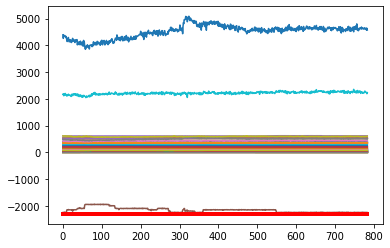

Predicción:  [[[0.98872524 0.01127478]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7805300e+01  1.2421000e+01  5.7644300e+01  7.6502800e+01
  6.1404000e+02  3.2010300e+01  8.2928000e+00  1.7998950e+02
  5.1000000e-03  8.0977800e+01  1.2000090e+02  1.0010500e+01
  6.0108400e+01  1.8009770e+02  2.2355900e+01  1.4945990e+02
  1.8125680e+02  6.9431100e+01 -6.8991000e+00  3.7986000e+00
  1.1910700e+01  7.4800000e+00  1.5008000e+00  7.1755200e+01
  1.4444000e+00  1.5180000e+00  8.2191300e+01  5.9998600e+01
  1.3007000e+00  1.2183000e+00  1.5777000e+00  1.3678000e+00
  1.4985990e+02  8.2830000e-01  8.3010000e-01 -2.2496352e+03
  2.0073910e+02  1.6000000e+00  1.3612000e+00  2.2178921e+03
  4.6240841e+03  1.8481450e+02  1.3977000e+00  1.3933000e+00
  7.6978000e+00  7.8009000e+00  1.7314000e+00  1.5320000e-01
  3.0049100e+01  5.3584390e+02  5.2314460e+02  5.1905850e+02
  5.1978060e+02  5.2000290e+02  2.9262500e+01  3.07

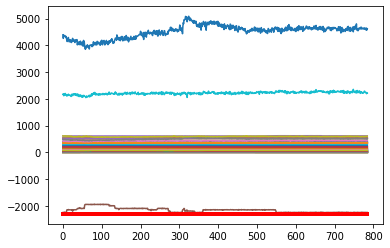

Predicción:  [[[0.9896344  0.01036567]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9985200e+01  1.2250200e+01  5.8350600e+01  7.7372700e+01
  6.1498870e+02  3.1146900e+01  8.2869000e+00  1.8005110e+02
  1.5100000e-02  7.8816700e+01  1.1981180e+02  1.0042300e+01
  5.9623300e+01  1.7782250e+02  2.1946300e+01  1.5073140e+02
  1.8126960e+02  6.9159500e+01 -6.8991000e+00  3.7916000e+00
  1.2156600e+01  7.5139000e+00  1.5017000e+00  7.1777400e+01
  1.4449000e+00  1.5202000e+00  8.2062200e+01  6.0728600e+01
  1.3004000e+00  1.2196000e+00  1.5836000e+00  1.3703000e+00
  1.4937810e+02  8.2780000e-01  8.2950000e-01 -2.2501186e+03
  2.0198160e+02  1.6024000e+00  1.3606000e+00  2.2036554e+03
  4.5881864e+03  1.8481450e+02  1.3991000e+00  1.3949000e+00
  7.6998000e+00  7.7997000e+00  1.7340000e+00  1.5060000e-01
  2.8685300e+01  5.3662170e+02  5.2362720e+02  5.1950210e+02
  5.2021900e+02  5.2039460e+02  2.9337100e+01  3.08

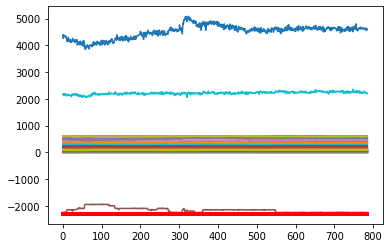

Predicción:  [[[0.98890275 0.01109728]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0629000e+01  1.2207600e+01  5.7488600e+01  7.8042600e+01
  6.1472560e+02  3.0215500e+01  8.2932000e+00  1.7980220e+02
  8.5000000e-03  7.8883500e+01  1.2001880e+02  1.0002100e+01
  6.0373300e+01  1.7642740e+02  2.2313900e+01  1.5139010e+02
  1.8124820e+02  6.9385600e+01 -6.8991000e+00  3.8058000e+00
  1.1470500e+01  7.5083000e+00  1.5002000e+00  7.1805900e+01
  1.4400000e+00  1.5136000e+00  8.2334700e+01  5.9898700e+01
  1.2949000e+00  1.2141000e+00  1.5807000e+00  1.3635000e+00
  1.4995880e+02  8.2860000e-01  8.3100000e-01 -2.2452552e+03
  2.0279370e+02  1.5955000e+00  1.3551000e+00  2.2562037e+03
  4.5740864e+03  1.8481450e+02  1.3922000e+00  1.3882000e+00
  7.7016000e+00  7.8023000e+00  1.7281000e+00  1.4760000e-01
  2.8711200e+01  5.3596670e+02  5.2350290e+02  5.1934950e+02
  5.2008620e+02  5.2038650e+02  2.9707200e+01  3.09

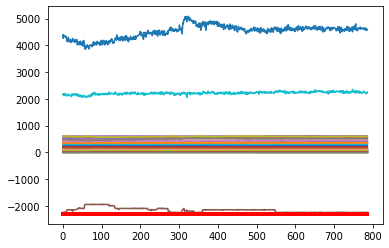

Predicción:  [[[0.9881356  0.01186438]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0026800e+01  1.2273800e+01  5.7563100e+01  7.6352100e+01
  6.1550010e+02  3.1561200e+01  8.2837000e+00  1.7995900e+02
  4.2000000e-03  7.8695200e+01  1.2014080e+02  1.0120400e+01
  6.1391700e+01  1.7742360e+02  2.2584200e+01  1.4783630e+02
  1.8146010e+02  6.9576400e+01 -6.8991000e+00  3.8082000e+00
  1.1760700e+01  7.4775000e+00  1.5010000e+00  7.1770700e+01
  1.4352000e+00  1.5077000e+00  8.2037100e+01  6.0630900e+01
  1.2910000e+00  1.2087000e+00  1.5727000e+00  1.3592000e+00
  1.5039530e+02  8.2860000e-01  8.3050000e-01 -2.2515419e+03
  2.0220720e+02  1.5899000e+00  1.3518000e+00  2.2045623e+03
  4.5909854e+03  1.8481450e+02  1.3872000e+00  1.3841000e+00
  7.6962000e+00  7.8002000e+00  1.7236000e+00  1.5080000e-01
  2.8014100e+01  5.3569780e+02  5.2294640e+02  5.1875140e+02
  5.1950200e+02  5.1971240e+02  2.9998000e+01  3.10

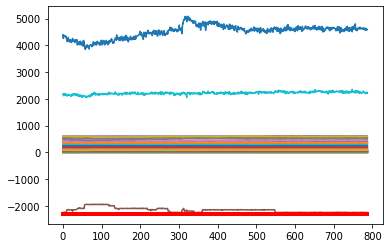

Predicción:  [[[0.9890381  0.01096183]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8856800e+01  1.2326600e+01  5.7671100e+01  7.6072100e+01
  6.1459420e+02  3.2452400e+01  8.2975000e+00  1.7993940e+02
  1.6000000e-03  7.8650900e+01  1.2007400e+02  1.0040400e+01
  6.2452600e+01  1.7798250e+02  2.2732800e+01  1.4692690e+02
  1.8142740e+02  6.9217500e+01 -6.8991000e+00  3.7980000e+00
  1.0773600e+01  7.5007000e+00  1.5020000e+00  7.1794500e+01
  1.4400000e+00  1.5134000e+00  8.2204700e+01  6.0472300e+01
  1.2961000e+00  1.2132000e+00  1.5772000e+00  1.3666000e+00
  1.5203890e+02  8.2850000e-01  8.3010000e-01 -2.2455829e+03
  2.0142140e+02  1.5951000e+00  1.3566000e+00  2.2587466e+03
  4.5268439e+03  1.8481450e+02  1.3942000e+00  1.3944000e+00
  7.7003000e+00  7.7999000e+00  1.7274000e+00  1.5020000e-01
  2.7414500e+01  5.3687110e+02  5.2320440e+02  5.1915180e+02
  5.1995360e+02  5.2014010e+02  2.9792100e+01  3.10

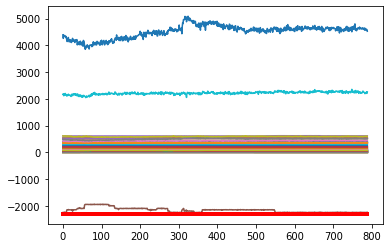

Predicción:  [[[0.98699236 0.01300769]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7956800e+01  1.2271400e+01  5.7176400e+01  7.6240500e+01
  6.1451690e+02  3.2294700e+01  8.3190000e+00  1.7999330e+02
  1.2000000e-03  7.8714600e+01  1.1995010e+02  9.8614000e+00
  6.2444100e+01  1.7846730e+02  2.3018200e+01  1.4290580e+02
  1.8137550e+02  6.9049900e+01 -6.8991000e+00  3.7918000e+00
  9.2815000e+00  7.5010000e+00  1.4986000e+00  7.1807500e+01
  1.4536000e+00  1.5251000e+00  8.1107500e+01  6.0300500e+01
  1.3089000e+00  1.2252000e+00  1.5925000e+00  1.3749000e+00
  1.5213820e+02  8.2860000e-01  8.3010000e-01 -2.2528402e+03
  2.0067140e+02  1.6064000e+00  1.3684000e+00  2.2873450e+03
  4.5061239e+03  1.8481450e+02  1.4019000e+00  1.4029000e+00
  7.7004000e+00  7.8004000e+00  1.7416000e+00  1.4880000e-01
  2.6994100e+01  5.3748010e+02  5.2353690e+02  5.1938400e+02
  5.2025100e+02  5.2033840e+02  2.9944700e+01  3.11

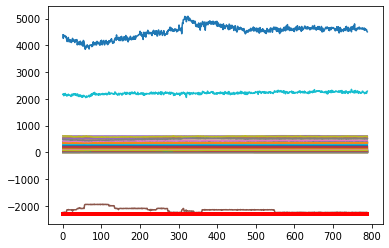

Predicción:  [[[0.98701906 0.01298092]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7900500e+01  1.2231700e+01  5.7365700e+01  7.7698700e+01
  6.1499720e+02  3.1778300e+01  8.3249000e+00  1.8001750e+02
  1.0000000e-03  7.8658000e+01  1.2009110e+02  1.0010200e+01
  6.2606400e+01  1.7819220e+02  2.2502900e+01  1.3998770e+02
  1.8113440e+02  6.9451100e+01 -6.8991000e+00  3.8108000e+00
  9.6509000e+00  7.5103000e+00  1.5004000e+00  7.1835900e+01
  1.4483000e+00  1.5199000e+00  8.1324900e+01  5.9569500e+01
  1.3014000e+00  1.2194000e+00  1.5873000e+00  1.3703000e+00
  1.5120010e+02  8.2870000e-01  8.2990000e-01 -2.2516580e+03
  2.0099190e+02  1.6006000e+00  1.3615000e+00  2.2801327e+03
  4.5582280e+03  1.8481450e+02  1.3971000e+00  1.3961000e+00
  7.6973000e+00  7.8022000e+00  1.7384000e+00  1.5150000e-01
  2.6737800e+01  5.3731770e+02  5.2348170e+02  5.1941920e+02
  5.2033220e+02  5.2036940e+02  2.9679900e+01  3.09

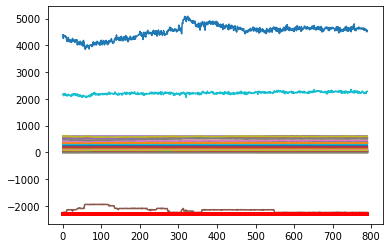

Predicción:  [[[0.98823625 0.01176372]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7618600e+01  1.2251200e+01  5.7004300e+01  7.7528700e+01
  6.1563680e+02  3.1490600e+01  8.2815000e+00  1.7997820e+02
  7.0000000e-04  7.8432900e+01  1.1998140e+02  1.0367500e+01
  6.1869100e+01  1.7832000e+02  2.1921400e+01  1.3776160e+02
  1.8116870e+02  6.9210000e+01 -6.8991000e+00  3.7997000e+00
  1.1351700e+01  7.4752000e+00  1.4999000e+00  7.1835300e+01
  1.4460000e+00  1.5187000e+00  8.0148000e+01  6.0665700e+01
  1.3011000e+00  1.2192000e+00  1.5832000e+00  1.3697000e+00
  1.4933360e+02  8.2890000e-01  8.2990000e-01 -2.2495439e+03
  1.9998540e+02  1.5996000e+00  1.3617000e+00  2.1886869e+03
  4.5028617e+03  1.8481450e+02  1.3958000e+00  1.3927000e+00
  7.6989000e+00  7.7995000e+00  1.7370000e+00  1.5400000e-01
  2.5911700e+01  5.3751670e+02  5.2364710e+02  5.1958830e+02
  5.2043640e+02  5.2040180e+02  2.9787600e+01  3.05

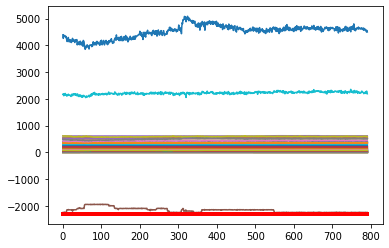

Predicción:  [[[0.9866723  0.01332773]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7422000e+01  1.2300400e+01  5.6174900e+01  7.7797600e+01
  6.1445270e+02  3.1626700e+01  8.2504000e+00  1.7986300e+02
  5.0000000e-04  7.8407200e+01  1.2018480e+02  9.9873000e+00
  6.1599300e+01  1.7719770e+02  2.2306500e+01  1.3703590e+02
  1.8105090e+02  6.9407500e+01 -6.8991000e+00  3.8050000e+00
  1.0692800e+01  7.4956000e+00  1.4990000e+00  7.1809800e+01
  1.4409000e+00  1.5132000e+00  8.0949900e+01  6.0807200e+01
  1.2954000e+00  1.2161000e+00  1.5808000e+00  1.3642000e+00
  1.4885810e+02  8.2900000e-01  8.2990000e-01 -2.2459481e+03
  2.0190670e+02  1.5943000e+00  1.3566000e+00  2.2776167e+03
  4.5492162e+03  1.8481450e+02  1.3886000e+00  1.3858000e+00
  7.7040000e+00  7.7971000e+00  1.7321000e+00  1.5150000e-01
  2.4485400e+01  5.3674060e+02  5.2354700e+02  5.1920630e+02
  5.2001520e+02  5.2005640e+02  3.0333400e+01  3.06

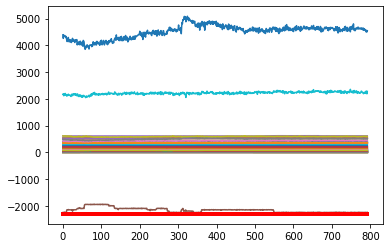

Predicción:  [[[0.98750114 0.01249881]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Predictor - Proc.Nro. 7616
Predicción Nro.:  793  - Datos Recibidos:  [ 3.7044900e+01  1.2282200e+01  5.7870100e+01  7.5406900e+01
  6.1432700e+02  3.1409800e+01  8.2068000e+00  1.8004840e+02
  5.0000000e-04  7.8499400e+01  1.1993990e+02  9.9380000e+00
  6.3383000e+01  1.7811730e+02  2.2487200e+01  1.3796660e+02
  1.8116850e+02  6.9189800e+01 -6.8991000e+00  3.7262000e+00
  1.1130600e+01  7.5118000e+00  1.5001000e+00  7.1806900e+01
  1.4329000e+00  1.5052000e+00  8.0880200e+01  6.0726800e+01
  1.2911000e+00  1.2075000e+00  1.5698000e+00  1.3605000e+00
  1.4955510e+02  8.2910000e-01  8.3020000e-01 -2.2594823e+03
  2.0279040e+02  1.5860000e+00  1.3520000e+00  2.2462153e+03
  4.4490891e+03  1.8481450e+02  1.3852000e+00  1.3821000e+00
  7.6962000e+00  7.7982000e+00  1.7245000e+00  1.5430000e-01
  2.4718000e+01  5.3608320e+02  5.2275140e+02  5.1898590e+02
  5.1973040e+02  5.1985170e+02  3.078640

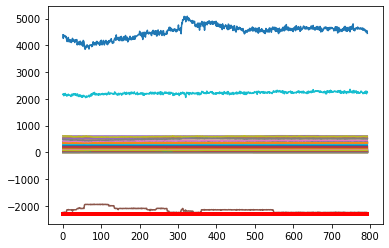

Predicción:  [[[0.9860285  0.01397144]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6092200e+01  1.2273800e+01  5.8201500e+01  7.5218300e+01
  6.1589660e+02  3.1085500e+01  8.2375000e+00  1.8003160e+02
  5.0000000e-04  7.9251800e+01  1.1987650e+02  1.0260200e+01
  6.3811900e+01  1.7795850e+02  2.2499500e+01  1.3351290e+02
  1.8117530e+02  6.9174000e+01 -6.8991000e+00  3.6977000e+00
  9.8073000e+00  7.5258000e+00  1.4988000e+00  7.1781200e+01
  1.4454000e+00  1.5200000e+00  8.0360000e+01  6.0158400e+01
  1.3030000e+00  1.2207000e+00  1.5859000e+00  1.3698000e+00
  1.4997470e+02  8.2940000e-01  8.2980000e-01 -2.2524978e+03
  1.9925650e+02  1.5995000e+00  1.3638000e+00  2.3162704e+03
  4.5183644e+03  1.8481450e+02  1.3942000e+00  1.3916000e+00
  7.7041000e+00  7.8020000e+00  1.7366000e+00  1.5080000e-01
  2.4563600e+01  5.3686340e+02  5.2301550e+02  5.1901920e+02
  5.1980250e+02  5.1985870e+02  3.0509000e+01  3.08

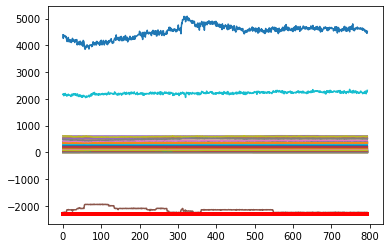

Predicción:  [[[0.9871951  0.01280491]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5841400e+01  1.2201800e+01  5.8147900e+01  7.6461700e+01
  6.1470130e+02  3.2985300e+01  8.1734000e+00  1.8001810e+02
  5.0000000e-04  7.9457100e+01  1.2020450e+02  1.0050500e+01
  6.2336600e+01  1.8062520e+02  2.2740800e+01  1.3262280e+02
  1.8113100e+02  6.9143000e+01 -6.8991000e+00  3.7182000e+00
  1.0530600e+01  7.5042000e+00  1.4999000e+00  7.1782400e+01
  1.4409000e+00  1.5154000e+00  8.1131800e+01  6.0320600e+01
  1.2991000e+00  1.2187000e+00  1.5754000e+00  1.3664000e+00
  1.4868450e+02  8.2850000e-01  8.2970000e-01 -2.2493836e+03
  2.0062880e+02  1.5962000e+00  1.3597000e+00  2.2358714e+03
  4.5796916e+03  1.8481450e+02  1.3899000e+00  1.3889000e+00
  7.7181000e+00  7.7985000e+00  1.7318000e+00  1.5640000e-01
  2.3601500e+01  5.3832120e+02  5.2401900e+02  5.1995540e+02
  5.2068480e+02  5.2080210e+02  3.0765200e+01  3.10

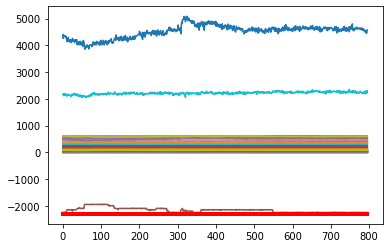

Predicción:  [[[0.9885328  0.01146721]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7487400e+01  1.2155000e+01  5.8278900e+01  7.6349100e+01
  6.1519070e+02  3.2956400e+01  8.2645000e+00  1.7998970e+02
  5.0000000e-04  7.7865900e+01  1.2003880e+02  1.0024300e+01
  6.0149700e+01  1.7944650e+02  2.2442500e+01  1.3678980e+02
  1.8107900e+02  6.8965500e+01 -6.8991000e+00  3.7635000e+00
  1.1531700e+01  7.4801000e+00  1.4969000e+00  7.1794700e+01
  1.4306000e+00  1.5087000e+00  8.2381800e+01  6.0883200e+01
  1.2866000e+00  1.2067000e+00  1.5654000e+00  1.3580000e+00
  1.4785360e+02  8.2760000e-01  8.2950000e-01 -2.2326575e+03
  2.0015360e+02  1.5895000e+00  1.3471000e+00  2.2439547e+03
  4.6774637e+03  1.8481450e+02  1.3836000e+00  1.3862000e+00
  7.6950000e+00  7.8005000e+00  1.7237000e+00  1.5830000e-01
  2.5616600e+01  5.3557490e+02  5.2278580e+02  5.1875120e+02
  5.1945410e+02  5.1954900e+02  3.0814500e+01  3.08

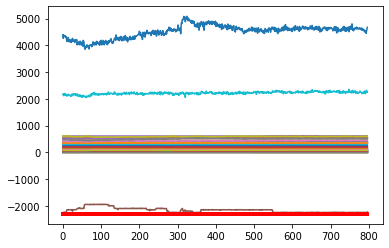

Predicción:  [[[0.9895188  0.01048115]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6639700e+01  1.2167300e+01  5.8222300e+01  7.4950100e+01
  6.1618050e+02  3.2549500e+01  8.3024000e+00  1.7994450e+02
  5.0000000e-04  7.7698300e+01  1.2010530e+02  9.8623000e+00
  6.2772800e+01  1.7883670e+02  2.2400100e+01  1.3591950e+02
  1.8118340e+02  6.9269500e+01 -6.8991000e+00  3.7938000e+00
  1.2165200e+01  7.4796000e+00  1.4990000e+00  7.1820800e+01
  1.4356000e+00  1.5109000e+00  8.0895000e+01  6.0549100e+01
  1.2912000e+00  1.2115000e+00  1.5694000e+00  1.3608000e+00
  1.4869470e+02  8.2890000e-01  8.3010000e-01 -2.2525024e+03
  1.9942470e+02  1.5912000e+00  1.3517000e+00  2.2722672e+03
  4.5671003e+03  1.8481450e+02  1.3865000e+00  1.3874000e+00
  7.7015000e+00  7.8040000e+00  1.7272000e+00  1.5760000e-01
  2.5692500e+01  5.3648230e+02  5.2246500e+02  5.1850380e+02
  5.1932300e+02  5.1932950e+02  3.0859600e+01  3.09

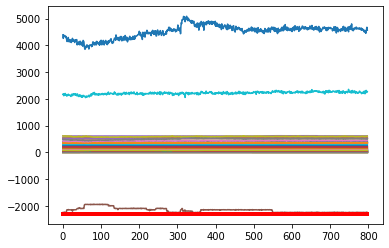

Predicción:  [[[0.9884376  0.01156245]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6176900e+01  1.2176300e+01  5.7578000e+01  7.5794000e+01
  6.1462100e+02  3.2574700e+01  8.3073000e+00  1.8002190e+02
  5.0000000e-04  7.7758300e+01  1.1996020e+02  9.9939000e+00
  6.3627300e+01  1.7904860e+02  2.2756800e+01  1.3603550e+02
  1.8130210e+02  6.9167500e+01 -6.8991000e+00  3.7927000e+00
  1.0132300e+01  7.5092000e+00  1.4989000e+00  7.1807400e+01
  1.4425000e+00  1.5186000e+00  8.0619100e+01  5.9753900e+01
  1.3019000e+00  1.2159000e+00  1.5806000e+00  1.3671000e+00
  1.5219270e+02  8.2890000e-01  8.2990000e-01 -2.2543951e+03
  2.0113720e+02  1.5989000e+00  1.3620000e+00  2.2808236e+03
  4.4762185e+03  1.8481450e+02  1.3925000e+00  1.3930000e+00
  7.7009000e+00  7.8004000e+00  1.7320000e+00  1.5130000e-01
  2.5692600e+01  5.3741770e+02  5.2355890e+02  5.1958770e+02
  5.2049920e+02  5.2043270e+02  3.0558900e+01  3.09

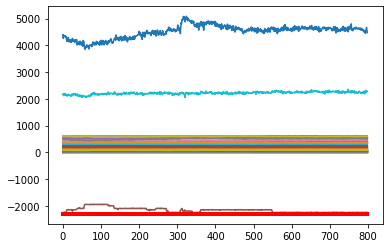

Predicción:  [[[0.9862265 0.0137735]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5554500e+01  1.2216300e+01  5.6891400e+01  7.7030100e+01
  6.1466390e+02  3.2779500e+01  8.3207000e+00  1.7993290e+02
  5.0000000e-04  7.7764100e+01  1.2007790e+02  1.0054100e+01
  6.1507500e+01  1.8027820e+02  2.2292300e+01  1.3504820e+02
  1.8101560e+02  6.8985600e+01 -6.8991000e+00  3.7919000e+00
  9.5187000e+00  7.5182000e+00  1.5017000e+00  7.1762600e+01
  1.4564000e+00  1.5293000e+00  8.1071100e+01  5.9317500e+01
  1.3147000e+00  1.2299000e+00  1.5897000e+00  1.3791000e+00
  1.5135810e+02  8.2820000e-01  8.2980000e-01 -2.2521368e+03
  2.0104500e+02  1.6102000e+00  1.3744000e+00  2.2363118e+03
  4.4490250e+03  1.8481450e+02  1.4046000e+00  1.4030000e+00
  7.7003000e+00  7.8000000e+00  1.7461000e+00  1.5610000e-01
  2.5638600e+01  5.3741560e+02  5.2401120e+02  5.1971930e+02
  5.2066050e+02  5.2053070e+02  2.9976700e+01  3.0551

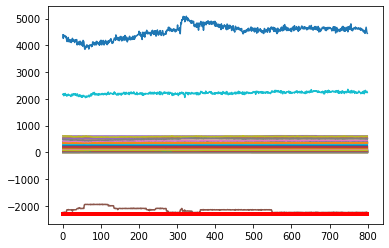

Predicción:  [[[0.98524654 0.01475344]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5998000e+01  1.2221900e+01  5.6132800e+01  7.6703200e+01
  6.1451910e+02  3.2360300e+01  8.2850000e+00  1.8000750e+02
  5.0000000e-04  7.7710600e+01  1.2005900e+02  1.0106400e+01
  6.2176300e+01  1.8034450e+02  2.2173100e+01  1.3626160e+02
  1.8087280e+02  6.9385900e+01 -6.8991000e+00  3.8068000e+00
  1.1056000e+01  7.5089000e+00  1.4987000e+00  7.1825200e+01
  1.4362000e+00  1.5095000e+00  8.1118200e+01  6.0052000e+01
  1.2953000e+00  1.2098000e+00  1.5710000e+00  1.3600000e+00
  1.5038460e+02  8.2840000e-01  8.2980000e-01 -2.2510410e+03
  1.9957480e+02  1.5904000e+00  1.3554000e+00  2.2579115e+03
  4.4826831e+03  1.8481450e+02  1.3855000e+00  1.3830000e+00
  7.6977000e+00  7.8013000e+00  1.7262000e+00  1.5490000e-01
  2.5508900e+01  5.3596890e+02  5.2322690e+02  5.1898300e+02
  5.1986380e+02  5.1970440e+02  2.9833500e+01  3.03

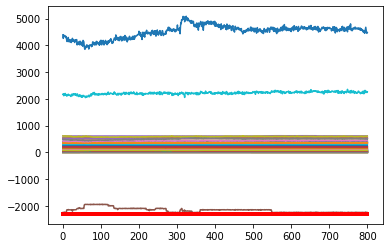

Predicción:  [[[0.9861195  0.01388044]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5434200e+01  1.2150600e+01  5.6948200e+01  7.5488500e+01
  6.1491840e+02  3.1995900e+01  8.3155000e+00  1.7997740e+02
  5.0000000e-04  7.7476600e+01  1.1982720e+02  9.9542000e+00
  6.1338700e+01  1.8040070e+02  2.2266600e+01  1.3609740e+02
  1.8090150e+02  6.9192300e+01 -6.8991000e+00  3.7990000e+00
  1.2772600e+01  7.5144000e+00  1.4990000e+00  7.1804600e+01
  1.4385000e+00  1.5105000e+00  7.9562400e+01  5.9199600e+01
  1.2946000e+00  1.2138000e+00  1.5676000e+00  1.3606000e+00
  1.4970640e+02  8.2700000e-01  8.3030000e-01 -2.2616092e+03
  2.0085260e+02  1.5912000e+00  1.3538000e+00  2.2462495e+03
  4.4598766e+03  1.8481450e+02  1.3860000e+00  1.3817000e+00
  7.6999000e+00  7.7987000e+00  1.7274000e+00  1.5970000e-01
  2.5721700e+01  5.3582890e+02  5.2260520e+02  5.1852230e+02
  5.1945260e+02  5.1935920e+02  3.0046100e+01  3.03

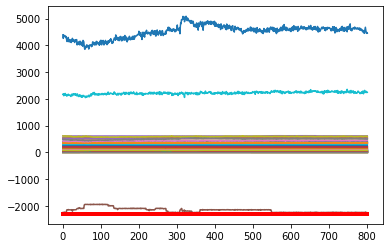

Predicción:  [[[0.9864819  0.01351815]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5882600e+01  1.2137300e+01  5.5913400e+01  7.7154900e+01
  6.1438560e+02  3.2700100e+01  8.3369000e+00  1.7995250e+02
  5.0000000e-04  7.7519200e+01  1.2005680e+02  9.9192000e+00
  6.0745600e+01  1.7993000e+02  2.2414900e+01  1.3864890e+02
  1.8104350e+02  6.9078600e+01 -6.8991000e+00  3.7998000e+00
  1.0075400e+01  7.5141000e+00  1.4995000e+00  7.1719500e+01
  1.4471000e+00  1.5213000e+00  8.1505700e+01  5.8873500e+01
  1.3053000e+00  1.2221000e+00  1.5785000e+00  1.3686000e+00
  1.5031560e+02  8.2480000e-01  8.2980000e-01 -2.2533862e+03
  1.9772050e+02  1.6023000e+00  1.3640000e+00  2.2655006e+03
  4.4955282e+03  1.8481450e+02  1.3948000e+00  1.3923000e+00
  7.6981000e+00  7.7994000e+00  1.7347000e+00  1.5610000e-01
  2.6309300e+01  5.3732000e+02  5.2359290e+02  5.1923560e+02
  5.2007480e+02  5.2010380e+02  2.9517600e+01  3.01

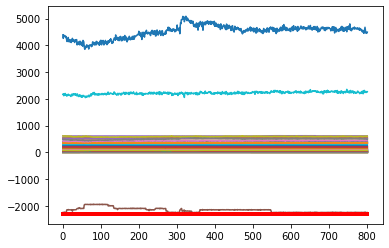

Predicción:  [[[0.98663586 0.01336416]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5754600e+01  1.2124300e+01  5.7791000e+01  7.6957800e+01
  6.1440840e+02  3.2770000e+01  8.3252000e+00  1.8006890e+02
  5.0000000e-04  7.7512700e+01  1.2003070e+02  9.9509000e+00
  6.2258300e+01  1.7979580e+02  2.2861300e+01  1.3750070e+02
  1.8095400e+02  6.9341600e+01 -6.8991000e+00  3.8092000e+00
  1.0388300e+01  7.4879000e+00  1.4996000e+00  7.1825200e+01
  1.4425000e+00  1.5177000e+00  8.2068800e+01  5.8747600e+01
  1.3016000e+00  1.2161000e+00  1.5749000e+00  1.3677000e+00
  1.5100380e+02  8.2470000e-01  8.3000000e-01 -2.2485236e+03
  2.0074940e+02  1.6001000e+00  1.3605000e+00  2.2672150e+03
  4.4960497e+03  1.8481450e+02  1.3942000e+00  1.3908000e+00
  7.7005000e+00  7.7976000e+00  1.7312000e+00  1.5630000e-01
  2.6522900e+01  5.3650000e+02  5.2363760e+02  5.1922650e+02
  5.1999640e+02  5.2013250e+02  2.9908500e+01  3.00

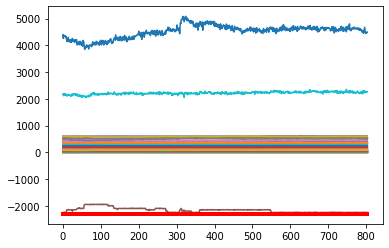

Predicción:  [[[0.98631763 0.01368237]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5201500e+01  1.2158700e+01  5.5943300e+01  7.6146600e+01
  6.1476260e+02  3.0443700e+01  8.2933000e+00  1.7993620e+02
  5.0000000e-04  7.7827600e+01  1.2001320e+02  1.0049600e+01
  6.2590100e+01  1.7790540e+02  2.3123300e+01  1.3685250e+02
  1.8098650e+02  6.9184000e+01 -6.8991000e+00  3.7916000e+00
  9.9715000e+00  7.4943000e+00  1.4997000e+00  7.1793700e+01
  1.4491000e+00  1.5237000e+00  8.2410700e+01  5.8944600e+01
  1.3090000e+00  1.2221000e+00  1.5854000e+00  1.3740000e+00
  1.5208580e+02  8.2460000e-01  8.2960000e-01 -2.2496018e+03
  2.0132910e+02  1.6053000e+00  1.3676000e+00  2.2863813e+03
  4.5044658e+03  1.8481450e+02  1.4007000e+00  1.3962000e+00
  7.7017000e+00  7.8013000e+00  1.7393000e+00  1.5380000e-01
  2.6649000e+01  5.3689790e+02  5.2337940e+02  5.1908930e+02
  5.1977310e+02  5.1998960e+02  3.0423400e+01  3.03

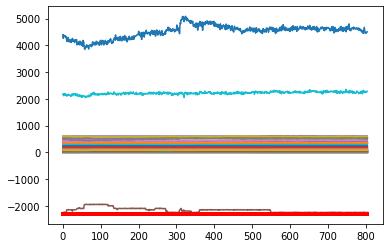

Predicción:  [[[0.9866289 0.0133711]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5675700e+01  1.2222500e+01  5.5620000e+01  7.6830400e+01
  6.1453620e+02  2.8427700e+01  8.2717000e+00  1.8009130e+02
  5.0000000e-04  7.8649400e+01  1.1983630e+02  1.0044600e+01
  6.3595100e+01  1.7642790e+02  2.2375000e+01  1.3884620e+02
  1.8108540e+02  6.9197700e+01 -6.8991000e+00  3.8047000e+00
  8.8027000e+00  7.4961000e+00  1.4995000e+00  7.1800800e+01
  1.4451000e+00  1.5209000e+00  8.1618500e+01  5.8504400e+01
  1.3028000e+00  1.2168000e+00  1.5865000e+00  1.3693000e+00
  1.5377700e+02  8.3060000e-01  8.3350000e-01 -2.2528284e+03
  2.0195910e+02  1.6021000e+00  1.3617000e+00  2.2614361e+03
  4.5231402e+03  1.8481450e+02  1.3953000e+00  1.3903000e+00
  7.6963000e+00  7.7929000e+00  1.7360000e+00  1.4930000e-01
  2.6103100e+01  5.3618660e+02  5.2319320e+02  5.1896560e+02
  5.1969220e+02  5.1985650e+02  3.0900600e+01  3.1062

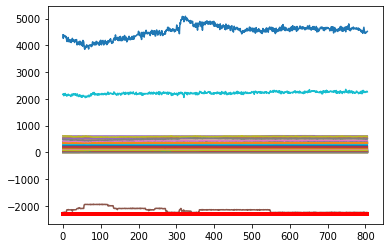

Predicción:  [[[0.9874414  0.01255859]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6346300e+01  1.2166000e+01  5.5177700e+01  7.5840500e+01
  6.1516170e+02  2.8234200e+01  9.1431000e+00  1.8006030e+02
  5.0000000e-04  7.9171500e+01  1.2010350e+02  9.8917000e+00
  6.4043500e+01  1.7703400e+02  2.1054600e+01  1.3752180e+02
  1.8102770e+02  6.9237500e+01 -6.8991000e+00  3.7981000e+00
  9.7247000e+00  7.5032000e+00  1.5006000e+00  7.1854800e+01
  1.4473000e+00  1.5261000e+00  8.1000400e+01  5.9115100e+01
  1.3081000e+00  1.2190000e+00  1.5857000e+00  1.3741000e+00
  1.5450740e+02  8.2280000e-01  8.2680000e-01 -2.2471937e+03
  2.0277840e+02  1.6070000e+00  1.3672000e+00  2.2745625e+03
  4.4798889e+03  1.8481450e+02  1.4010000e+00  1.3963000e+00
  7.7037000e+00  7.8052000e+00  1.7382000e+00  1.5240000e-01
  2.6886200e+01  5.3736440e+02  5.2380970e+02  5.1955440e+02
  5.2036640e+02  5.2049760e+02  2.9544300e+01  3.10

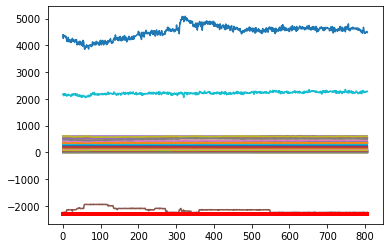

Predicción:  [[[0.9857488  0.01425115]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6072900e+01  1.2259600e+01  5.5174800e+01  7.7133700e+01
  6.1476650e+02  2.7684500e+01  9.4327000e+00  1.8003800e+02
  5.0000000e-04  7.9322000e+01  1.2016060e+02  9.9729000e+00
  6.3355100e+01  1.7605030e+02  2.1298100e+01  1.3609700e+02
  1.8093800e+02  6.9250000e+01 -6.8991000e+00  3.8023000e+00
  8.5870000e+00  7.4975000e+00  1.5008000e+00  7.1862000e+01
  1.4510000e+00  1.5289000e+00  8.2277800e+01  5.9351700e+01
  1.3103000e+00  1.2233000e+00  1.5929000e+00  1.3795000e+00
  1.5388900e+02  8.2610000e-01  8.3060000e-01 -2.2431617e+03
  2.0218870e+02  1.6106000e+00  1.3694000e+00  2.3202906e+03
  4.5239498e+03  1.8481450e+02  1.4084000e+00  1.4033000e+00
  7.7003000e+00  7.8022000e+00  1.7424000e+00  1.4950000e-01
  2.8547400e+01  5.3605110e+02  5.2355900e+02  5.1925900e+02
  5.2008330e+02  5.2017720e+02  2.8925700e+01  3.07

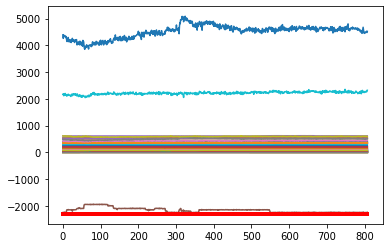

Predicción:  [[[0.98657775 0.01342224]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5940500e+01  1.2269200e+01  5.6322200e+01  7.8560800e+01
  6.1359500e+02  2.7476600e+01  9.5296000e+00  1.7999530e+02
  5.0000000e-04  7.9436700e+01  1.1999560e+02  9.9517000e+00
  6.2618400e+01  1.7581340e+02  2.1481600e+01  1.3408420e+02
  1.8088990e+02  6.9174400e+01 -6.8991000e+00  3.8019000e+00
  8.6708000e+00  7.5059000e+00  1.4986000e+00  7.1822600e+01
  1.4549000e+00  1.5305000e+00  8.1807600e+01  5.9012700e+01
  1.3154000e+00  1.2268000e+00  1.5976000e+00  1.3812000e+00
  1.5401340e+02  8.2460000e-01  8.2980000e-01 -2.2480885e+03
  2.0067380e+02  1.6122000e+00  1.3746000e+00  2.2209330e+03
  4.4917450e+03  1.8481450e+02  1.4098000e+00  1.4038000e+00
  7.6989000e+00  7.7994000e+00  1.7461000e+00  1.4860000e-01
  2.8503200e+01  5.3636670e+02  5.2344480e+02  5.1927820e+02
  5.2011270e+02  5.2016390e+02  2.9388300e+01  3.12

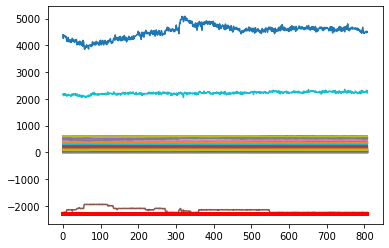

Predicción:  [[[0.9862288  0.01377115]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6325800e+01  1.2263300e+01  5.6019200e+01  7.8030400e+01
  6.1500920e+02  2.7953100e+01  9.2571000e+00  1.8003620e+02
  5.0000000e-04  7.9285400e+01  1.1998790e+02  1.0141800e+01
  6.3030200e+01  1.7618510e+02  2.1519600e+01  1.3574520e+02
  1.8095220e+02  6.9216400e+01 -6.8991000e+00  3.8036000e+00
  9.5925000e+00  7.5187000e+00  1.4977000e+00  7.1845100e+01
  1.4482000e+00  1.5247000e+00  8.1470700e+01  5.8656900e+01
  1.3110000e+00  1.2204000e+00  1.5864000e+00  1.3727000e+00
  1.5296020e+02  8.2380000e-01  8.2950000e-01 -2.2587980e+03
  1.9927950e+02  1.6059000e+00  1.3697000e+00  2.3007265e+03
  4.4172306e+03  1.8481450e+02  1.4028000e+00  1.3943000e+00
  7.6980000e+00  7.8014000e+00  1.7392000e+00  1.5290000e-01
  3.0104800e+01  5.3724670e+02  5.2356820e+02  5.1925530e+02
  5.2009700e+02  5.2021730e+02  2.9086900e+01  3.11

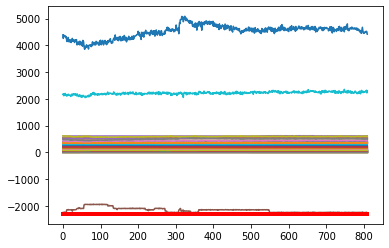

Predicción:  [[[0.98493135 0.01506867]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6131900e+01  1.2266700e+01  5.6103300e+01  7.6704600e+01
  6.1621780e+02  2.8586700e+01  8.2626000e+00  1.8003110e+02
  5.0000000e-04  7.9170100e+01  1.1991640e+02  1.0019900e+01
  6.3168400e+01  1.7665040e+02  2.2010900e+01  1.3794050e+02
  1.8068050e+02  6.9341100e+01 -6.8991000e+00  3.7951000e+00
  9.5043000e+00  7.4664000e+00  1.5004000e+00  7.1744700e+01
  1.4542000e+00  1.5322000e+00  8.2893600e+01  5.9065300e+01
  1.3131000e+00  1.2255000e+00  1.5926000e+00  1.3803000e+00
  1.5376890e+02  8.2330000e-01  8.2990000e-01 -2.2473916e+03
  1.9952940e+02  1.6140000e+00  1.3717000e+00  2.2802237e+03
  4.5866729e+03  1.8481450e+02  1.4106000e+00  1.4027000e+00
  7.7041000e+00  7.8002000e+00  1.7452000e+00  1.5270000e-01
  3.0267800e+01  5.3734890e+02  5.2406340e+02  5.1962200e+02
  5.2045430e+02  5.2054580e+02  2.9178200e+01  3.11

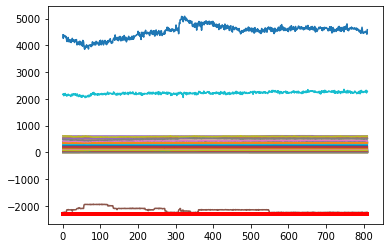

Predicción:  [[[0.9886382  0.01136176]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6324500e+01  1.2228700e+01  5.7397900e+01  7.6302500e+01
  6.1528710e+02  2.8889700e+01  8.2907000e+00  1.8005540e+02
  5.0000000e-04  7.9129500e+01  1.2006770e+02  9.9761000e+00
  6.2199300e+01  1.7644710e+02  2.1418500e+01  1.3870620e+02
  1.8064090e+02  6.9208600e+01 -6.8991000e+00  3.8011000e+00
  1.0274800e+01  7.5221000e+00  1.5008000e+00  7.1769700e+01
  1.4473000e+00  1.5211000e+00  8.1605400e+01  5.8242100e+01
  1.3064000e+00  1.2195000e+00  1.5839000e+00  1.3708000e+00
  1.5314340e+02  8.2310000e-01  8.2960000e-01 -2.2754322e+03
  2.0196040e+02  1.6031000e+00  1.3649000e+00  2.2728471e+03
  4.4230861e+03  1.8481450e+02  1.4012000e+00  1.3928000e+00
  7.6975000e+00  7.8002000e+00  1.7368000e+00  1.5330000e-01
  3.0238300e+01  5.3660220e+02  5.2328460e+02  5.1881520e+02
  5.1967680e+02  5.1969840e+02  2.9248400e+01  3.11

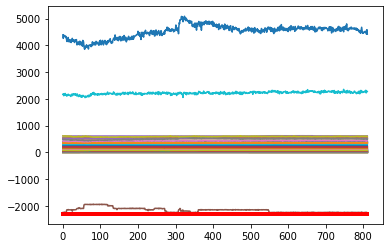

Predicción:  [[[0.98680186 0.01319815]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7688100e+01  1.2205900e+01  5.7648900e+01  7.7139200e+01
  6.1475740e+02  2.9340900e+01  8.2148000e+00  1.7992050e+02
  5.0000000e-04  7.8814000e+01  1.1984610e+02  9.8261000e+00
  5.9953800e+01  1.7753900e+02  2.1394000e+01  1.4337080e+02
  1.8085530e+02  6.9424400e+01 -6.8991000e+00  3.6264000e+00
  1.1657400e+01  7.5274000e+00  1.5004000e+00  7.1789100e+01
  1.4410000e+00  1.5140000e+00  8.1906100e+01  5.8989400e+01
  1.2994000e+00  1.2149000e+00  1.5720000e+00  1.3638000e+00
  1.5003600e+02  8.2450000e-01  8.2970000e-01 -2.2343293e+03
  2.0060740e+02  1.5971000e+00  1.3584000e+00  2.2371389e+03
  4.4580809e+03  1.8481450e+02  1.3939000e+00  1.3864000e+00
  7.7031000e+00  7.8005000e+00  1.7301000e+00  1.5790000e-01
  3.0278300e+01  5.3588440e+02  5.2309550e+02  5.1877490e+02
  5.1959610e+02  5.1976860e+02  2.8994400e+01  3.10

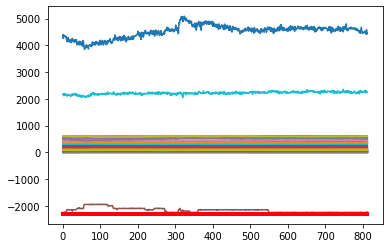

Predicción:  [[[0.98376507 0.01623499]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7537700e+01  1.2277100e+01  5.7082500e+01  7.8189700e+01
  6.1470980e+02  2.9665900e+01  8.2034000e+00  1.7996180e+02
  5.0000000e-04  7.8722800e+01  1.2005750e+02  1.0039800e+01
  6.1413400e+01  1.7794660e+02  2.1617700e+01  1.4220510e+02
  1.8086200e+02  6.9278100e+01 -6.8991000e+00  3.5869000e+00
  1.0955800e+01  7.4866000e+00  1.5002000e+00  7.1844800e+01
  1.4420000e+00  1.5167000e+00  8.2901500e+01  5.9098800e+01
  1.2964000e+00  1.2153000e+00  1.5712000e+00  1.3663000e+00
  1.5141740e+02  8.2570000e-01  8.3020000e-01 -2.2950859e+03
  2.0187610e+02  1.5996000e+00  1.3554000e+00  2.1896079e+03
  4.4217392e+03  1.8481450e+02  1.3960000e+00  1.3895000e+00
  7.6977000e+00  7.8013000e+00  1.7299000e+00  1.5850000e-01
  2.9729000e+01  5.3685110e+02  5.2407380e+02  5.1956560e+02
  5.2032660e+02  5.2042870e+02  2.8612700e+01  3.08

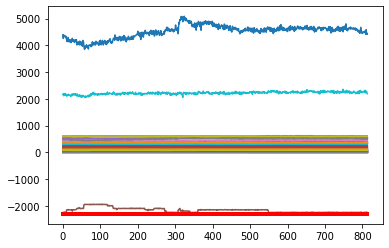

Predicción:  [[[0.98849326 0.01150676]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6851500e+01  1.2246200e+01  5.7633500e+01  7.6495200e+01
  6.1473830e+02  3.0043900e+01  8.2114000e+00  1.8003810e+02
  5.0000000e-04  7.8836400e+01  1.1996310e+02  9.9240000e+00
  6.2706600e+01  1.7695630e+02  2.1600100e+01  1.4463340e+02
  1.8090500e+02  6.9356600e+01 -6.8991000e+00  3.6060000e+00
  1.0664500e+01  7.4824000e+00  1.5020000e+00  7.1774600e+01
  1.4377000e+00  1.5110000e+00  8.2248700e+01  5.8826500e+01
  1.2904000e+00  1.2101000e+00  1.5702000e+00  1.3618000e+00
  1.5223050e+02  8.2440000e-01  8.3050000e-01 -2.3041105e+03
  1.9951520e+02  1.5932000e+00  1.3496000e+00  2.2460519e+03
  4.5154122e+03  1.8481450e+02  1.3919000e+00  1.3858000e+00
  7.7007000e+00  7.8002000e+00  1.7260000e+00  1.5560000e-01
  3.0143000e+01  5.3625110e+02  5.2340410e+02  5.1909290e+02
  5.1984730e+02  5.1998590e+02  2.8228200e+01  3.05

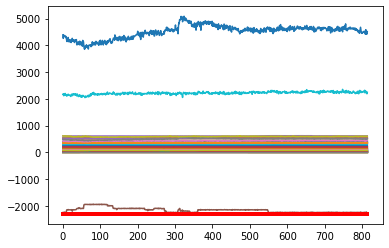

Predicción:  [[[0.9906724  0.00932756]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6341000e+01  1.2296200e+01  5.7939100e+01  7.6273100e+01
  6.1497430e+02  3.0119300e+01  8.2000000e+00  1.7910020e+02
  5.0000000e-04  7.8873300e+01  1.1896460e+02  9.9997000e+00
  6.2189400e+01  1.7696280e+02  2.1578900e+01  1.4296050e+02
  1.8042700e+02  6.9345400e+01 -6.8991000e+00  3.6017000e+00
  1.0335200e+01  7.5019000e+00  1.5002000e+00  7.1751600e+01
  1.4393000e+00  1.5129000e+00  8.2460300e+01  5.8590400e+01
  1.2912000e+00  1.2115000e+00  1.5735000e+00  1.3614000e+00
  1.5170650e+02  8.2590000e-01  8.3020000e-01 -2.3024248e+03
  2.0399370e+02  1.5955000e+00  1.3504000e+00  2.2234462e+03
  4.5122123e+03  1.8481450e+02  1.3905000e+00  1.3836000e+00
  7.6980000e+00  7.8005000e+00  1.7276000e+00  1.5390000e-01
  2.9238600e+01  5.3674890e+02  5.2350390e+02  5.1932570e+02
  5.2003290e+02  5.2020610e+02  2.8207200e+01  3.04

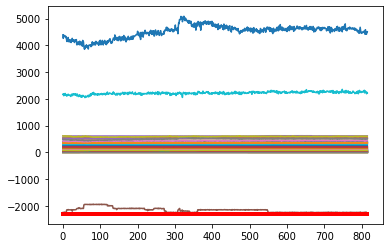

Predicción:  [[[0.99057454 0.00942546]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6671400e+01  1.2322300e+01  5.7402400e+01  7.6603700e+01
  6.1583460e+02  3.0101500e+01  8.1630000e+00  1.7765600e+02
  5.0000000e-04  7.8593800e+01  1.1821100e+02  9.9160000e+00
  6.0538000e+01  1.7714640e+02  2.1994000e+01  1.3993070e+02
  1.7903370e+02  6.9396900e+01 -6.8991000e+00  3.5774000e+00
  1.0588900e+01  7.5268000e+00  1.5009000e+00  7.1785900e+01
  1.4460000e+00  1.5196000e+00  8.1397600e+01  5.9269100e+01
  1.3005000e+00  1.2204000e+00  1.5798000e+00  1.3693000e+00
  1.5086550e+02  8.2370000e-01  8.2970000e-01 -2.2784165e+03
  2.0142050e+02  1.6002000e+00  1.3597000e+00  2.2137329e+03
  4.5215685e+03  1.8481450e+02  1.3957000e+00  1.3892000e+00
  7.7000000e+00  7.7998000e+00  1.7355000e+00  1.5580000e-01
  2.6689200e+01  5.3754890e+02  5.2468260e+02  5.2038730e+02
  5.2108590e+02  5.2122630e+02  2.8038100e+01  3.04

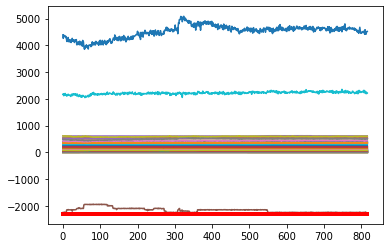

Predicción:  [[[0.9894392 0.0105608]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5851500e+01  1.2319400e+01  5.6740700e+01  7.6276800e+01
  6.1515740e+02  2.9879500e+01  8.1354000e+00  1.7620200e+02
  5.0000000e-04  7.8720000e+01  1.1796920e+02  1.0173500e+01
  5.8722300e+01  1.7610460e+02  2.1782700e+01  1.3942460e+02
  1.7731160e+02  6.8971400e+01 -6.8991000e+00  3.5131000e+00
  1.0356500e+01  7.3271000e+00  1.4996000e+00  7.1313200e+01
  1.4307000e+00  1.5015000e+00  7.9210500e+01  5.8204400e+01
  1.2915000e+00  1.2072000e+00  1.5652000e+00  1.3512000e+00
  1.4850710e+02  8.2530000e-01  8.2990000e-01 -2.2128372e+03
  1.9962390e+02  1.5813000e+00  1.3494000e+00  2.2673170e+03
  4.3593175e+03  1.8481450e+02  1.3792000e+00  1.3710000e+00
  7.6837000e+00  7.7988000e+00  1.7202000e+00  1.5500000e-01
  2.8332500e+01  5.3650220e+02  5.2399120e+02  5.1932800e+02
  5.2016740e+02  5.2025900e+02  2.8054400e+01  3.0420

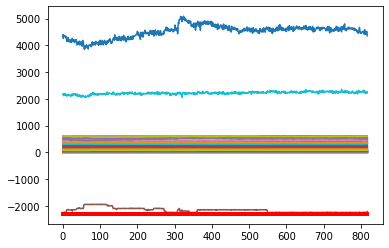

Predicción:  [[[0.9767463  0.02325374]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8148200e+01  1.2128300e+01  5.4118900e+01  7.5457900e+01
  6.1500340e+02  2.9598500e+01  8.1337000e+00  1.7482620e+02
  5.0000000e-04  7.8623100e+01  1.1817460e+02  9.9045000e+00
  5.7615600e+01  1.7558130e+02  2.1514500e+01  1.3896600e+02
  1.7617870e+02  6.8843300e+01 -6.8991000e+00  3.5143000e+00
  1.1865700e+01  7.2249000e+00  1.5004000e+00  7.1018300e+01
  1.4199000e+00  1.4893000e+00  7.8885000e+01  5.6890300e+01
  1.2895000e+00  1.1974000e+00  1.5541000e+00  1.3414000e+00
  1.4724040e+02  8.2730000e-01  8.3030000e-01 -2.1241981e+03
  1.9792440e+02  1.5688000e+00  1.3463000e+00  2.2520033e+03
  4.3032038e+03  1.8481450e+02  1.3710000e+00  1.3617000e+00
  7.5965000e+00  7.7988000e+00  1.7093000e+00  1.5510000e-01
  2.9807300e+01  5.3671120e+02  5.2304200e+02  5.1869320e+02
  5.1952130e+02  5.1971740e+02  2.7942700e+01  3.03

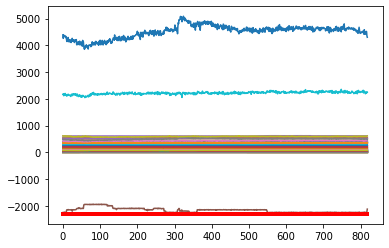

Predicción:  [[[0.9528784  0.04712162]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5567500e+01  1.2177100e+01  5.3590800e+01  7.5787000e+01
  6.1499760e+02  3.0038800e+01  8.0631000e+00  1.7324840e+02
  5.0000000e-04  7.9304500e+01  1.1803080e+02  1.0190700e+01
  5.7512600e+01  1.7505300e+02  2.1768700e+01  1.3823100e+02
  1.7483980e+02  6.8650900e+01 -6.8991000e+00  3.3798000e+00
  1.0211100e+01  7.1096000e+00  1.4995000e+00  7.0796700e+01
  1.4306000e+00  1.5004000e+00  7.9199000e+01  5.6459300e+01
  1.2997000e+00  1.2093000e+00  1.5675000e+00  1.3568000e+00
  1.4791580e+02  8.2750000e-01  8.3030000e-01 -2.0981711e+03
  1.9948720e+02  1.5795000e+00  1.3562000e+00  2.2236809e+03
  4.2481278e+03  1.8481450e+02  1.3868000e+00  1.3781000e+00
  7.5114000e+00  7.7994000e+00  1.7193000e+00  1.5200000e-01
  2.9965400e+01  5.3853550e+02  5.2492380e+02  5.2066970e+02
  5.2141810e+02  5.2161420e+02  2.7662800e+01  3.02

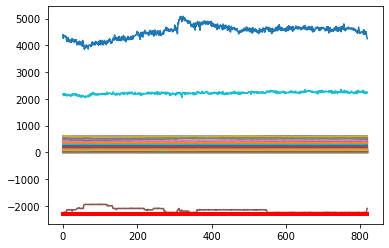

Predicción:  [[[0.9377352  0.06226481]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8891100e+01  1.2217500e+01  5.2420000e+01  7.5640700e+01
  6.1407820e+02  3.0209600e+01  8.0491000e+00  1.7180270e+02
  5.0000000e-04  7.8210600e+01  1.1691980e+02  1.0004900e+01
  5.3835300e+01  1.7306640e+02  2.1895900e+01  1.3924860e+02
  1.7311100e+02  6.8631200e+01 -6.8991000e+00  3.3135000e+00
  1.1102900e+01  7.0260000e+00  1.4991000e+00  7.0569900e+01
  1.4233000e+00  1.4925000e+00  7.8996200e+01  5.6652300e+01
  1.2887000e+00  1.2019000e+00  1.5641000e+00  1.3491000e+00
  1.4777680e+02  8.2760000e-01  8.2970000e-01 -2.1040342e+03
  1.9890810e+02  1.5720000e+00  1.3456000e+00  2.2229889e+03
  4.3150224e+03  1.8481450e+02  1.3784000e+00  1.3688000e+00
  7.5006000e+00  7.7977000e+00  1.7154000e+00  1.5100000e-01
  2.9308600e+01  5.3858230e+02  5.2474560e+02  5.2029440e+02
  5.2104940e+02  5.2116960e+02  2.7685600e+01  3.00

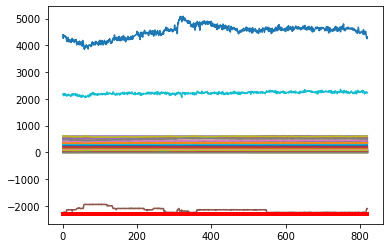

Predicción:  [[[0.9473517  0.05264824]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0537500e+01  1.2195800e+01  5.3986100e+01  7.4213000e+01
  6.0180400e+02  2.9833000e+01  8.0393000e+00  1.7031060e+02
  5.0000000e-04  7.8000600e+01  1.1529150e+02  1.0075400e+01
  5.3129700e+01  1.7151480e+02  2.1402400e+01  1.4216970e+02
  1.7163530e+02  6.8105200e+01 -6.8991000e+00  3.3053000e+00
  1.4398200e+01  7.0057000e+00  1.4978000e+00  7.0024100e+01
  1.4105000e+00  1.4766000e+00  7.8268100e+01  5.6080700e+01
  1.2744000e+00  1.1896000e+00  1.5501000e+00  1.3369000e+00
  1.4615460e+02  8.2730000e-01  8.2970000e-01 -2.1012527e+03
  1.9719850e+02  1.5546000e+00  1.3305000e+00  2.1980354e+03
  4.2764473e+03  1.8481450e+02  1.3669000e+00  1.3593000e+00
  7.4991000e+00  7.7994000e+00  1.7041000e+00  1.5400000e-01
  2.9836200e+01  5.3755100e+02  5.2355810e+02  5.1939880e+02
  5.2010770e+02  5.2031130e+02  2.7848000e+01  3.00

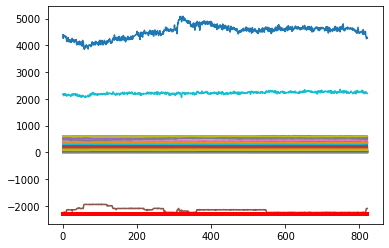

Predicción:  [[[0.9419467  0.05805327]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8965400e+01  1.2193900e+01  5.1666200e+01  7.4931600e+01
  5.9949340e+02  2.9812800e+01  8.0380000e+00  1.6884270e+02
  5.0000000e-04  7.8657600e+01  1.1509300e+02  1.0040500e+01
  5.2864700e+01  1.7062640e+02  2.1516200e+01  1.4109750e+02
  1.7014940e+02  6.8050400e+01 -6.8991000e+00  3.3063000e+00
  1.2219300e+01  7.0087000e+00  1.4981000e+00  7.0006600e+01
  1.4105000e+00  1.4770000e+00  7.6884800e+01  5.6124800e+01
  1.2759000e+00  1.1926000e+00  1.5517000e+00  1.3384000e+00
  1.4594460e+02  8.2690000e-01  8.2990000e-01 -2.0987028e+03
  1.9821410e+02  1.5534000e+00  1.3321000e+00  2.2137781e+03
  4.2805192e+03  1.8481450e+02  1.3679000e+00  1.3618000e+00
  7.4998000e+00  7.7992000e+00  1.7013000e+00  1.4990000e-01
  2.9570100e+01  5.3735110e+02  5.2420560e+02  5.2011430e+02
  5.2077540e+02  5.2091460e+02  2.7753500e+01  2.99

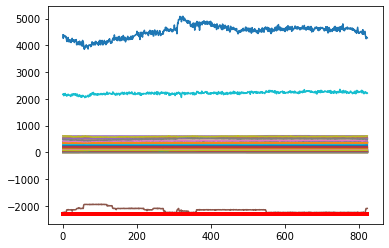

Predicción:  [[[0.94109213 0.05890788]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8829300e+01  1.2259100e+01  5.0422200e+01  7.4840100e+01
  6.0052790e+02  2.9658800e+01  8.0480000e+00  1.6769600e+02
  5.0000000e-04  7.8918200e+01  1.1503390e+02  9.8786000e+00
  5.3120600e+01  1.6884770e+02  2.1794700e+01  1.4218490e+02
  1.6883570e+02  6.8319200e+01 -6.8991000e+00  3.2294000e+00
  9.4973000e+00  6.9834000e+00  1.5001000e+00  7.0044900e+01
  1.4110000e+00  1.4795000e+00  7.7051800e+01  5.6456600e+01
  1.2737000e+00  1.1932000e+00  1.5605000e+00  1.3420000e+00
  1.4565070e+02  8.2320000e-01  8.3000000e-01 -2.0766352e+03
  1.9542980e+02  1.5569000e+00  1.3301000e+00  2.2405193e+03
  4.4080661e+03  1.8481450e+02  1.3718000e+00  1.3673000e+00
  7.5000000e+00  7.7994000e+00  1.7055000e+00  1.4480000e-01
  2.9633800e+01  5.3774890e+02  5.2480090e+02  5.2070030e+02
  5.2128180e+02  5.2147960e+02  2.7822200e+01  2.99

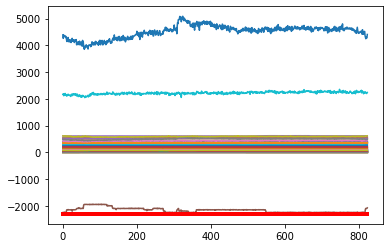

Predicción:  [[[0.94703907 0.05296087]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8647400e+01  1.2306500e+01  4.8477200e+01  7.3931700e+01
  5.9971270e+02  2.9267700e+01  8.0547000e+00  1.6676790e+02
  5.0000000e-04  7.8890200e+01  1.1512610e+02  9.9873000e+00
  5.3290100e+01  1.6797040e+02  2.1416000e+01  1.4195030e+02
  1.6785350e+02  6.8298300e+01 -6.8991000e+00  3.1963000e+00
  1.1056500e+01  7.0170000e+00  1.5017000e+00  6.9985400e+01
  1.4004000e+00  1.4625000e+00  7.6844100e+01  5.6076200e+01
  1.2711000e+00  1.1812000e+00  1.5524000e+00  1.3262000e+00
  1.4496510e+02  8.2360000e-01  8.2950000e-01 -2.0045584e+03
  1.9658960e+02  1.5385000e+00  1.3271000e+00  2.2560339e+03
  4.1559716e+03  1.8481450e+02  1.3553000e+00  1.3525000e+00
  7.5001000e+00  7.8040000e+00  1.6958000e+00  1.4320000e-01
  2.9119800e+01  5.3718440e+02  5.2371220e+02  5.1958440e+02
  5.2007190e+02  5.2042030e+02  2.7507300e+01  2.98

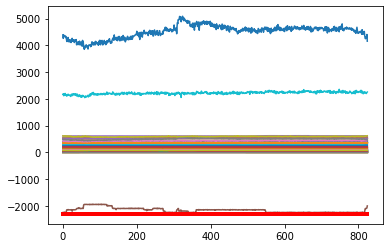

Predicción:  [[[0.86439013 0.13560991]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8096700e+01  1.2435000e+01  4.8016600e+01  7.3883000e+01
  6.0026390e+02  2.9454500e+01  7.9254000e+00  1.6605200e+02
  5.0000000e-04  7.8899400e+01  1.1493700e+02  1.0106800e+01
  5.2753700e+01  1.6768430e+02  2.1632300e+01  1.4386200e+02
  1.6709740e+02  6.8039700e+01 -6.8991000e+00  3.0817000e+00
  1.0462100e+01  7.0025000e+00  1.5010000e+00  7.0051900e+01
  1.4081000e+00  1.4726000e+00  7.6151600e+01  5.6201100e+01
  1.2753000e+00  1.1900000e+00  1.5581000e+00  1.3350000e+00
  1.4533220e+02  8.2460000e-01  8.2950000e-01 -1.9982756e+03
  1.9773370e+02  1.5488000e+00  1.3311000e+00  2.2614041e+03
  4.2054913e+03  1.8481450e+02  1.3622000e+00  1.3568000e+00
  7.5009000e+00  7.7922000e+00  1.7025000e+00  1.4440000e-01
  2.7414000e+01  5.3781780e+02  5.2467700e+02  5.2055760e+02
  5.2101990e+02  5.2134940e+02  2.7530400e+01  2.98

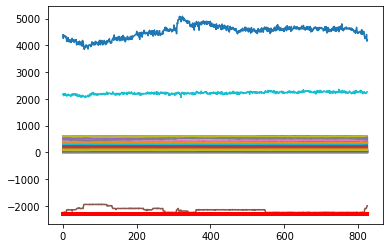

Predicción:  [[[0.87178063 0.12821938]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8014300e+01  1.2455000e+01  4.7445500e+01  7.3334400e+01
  5.9911370e+02  2.9065400e+01  7.8793000e+00  1.6598350e+02
  5.0000000e-04  7.8965700e+01  1.1508350e+02  1.0165200e+01
  5.3108500e+01  1.6698930e+02  2.1012800e+01  1.4315320e+02
  1.6686150e+02  6.8328800e+01 -6.8991000e+00  3.0053000e+00
  1.0456300e+01  7.0121000e+00  1.5001000e+00  7.0017900e+01
  1.3960000e+00  1.4585000e+00  7.6347600e+01  5.7109700e+01
  1.2606000e+00  1.1791000e+00  1.5466000e+00  1.3213000e+00
  1.4421370e+02  8.2360000e-01  8.3060000e-01 -2.0023859e+03
  1.9692800e+02  1.5345000e+00  1.3175000e+00  2.1717989e+03
  4.2467376e+03  1.8481450e+02  1.3478000e+00  1.3409000e+00
  7.5004000e+00  7.8070000e+00  1.6901000e+00  1.4350000e-01
  2.6620900e+01  5.3581780e+02  5.2358110e+02  5.1952480e+02
  5.1998230e+02  5.2027670e+02  2.7198500e+01  2.96

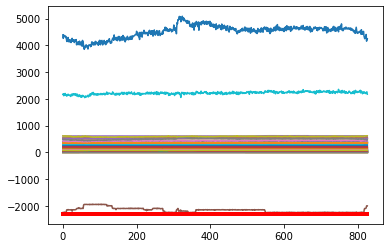

Predicción:  [[[0.884679   0.11532091]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7648000e+01  1.2419500e+01  4.6220200e+01  7.4092400e+01
  5.9990540e+02  2.8939400e+01  7.8910000e+00  1.6562490e+02
  5.0000000e-04  7.9190200e+01  1.1507330e+02  9.9579000e+00
  5.3005900e+01  1.6668650e+02  2.0642900e+01  1.4110420e+02
  1.6657990e+02  6.7936900e+01 -6.8991000e+00  2.9961000e+00
  9.8743000e+00  7.0071000e+00  1.4978000e+00  6.9997200e+01
  1.3956000e+00  1.4597000e+00  7.5144400e+01  5.6571700e+01
  1.2607000e+00  1.1798000e+00  1.5479000e+00  1.3220000e+00
  1.4356710e+02  8.2820000e-01  8.3020000e-01 -2.0050479e+03
  1.9830500e+02  1.5346000e+00  1.3178000e+00  2.2253975e+03
  4.2826904e+03  1.8481450e+02  1.3493000e+00  1.3418000e+00
  7.5000000e+00  7.7982000e+00  1.6891000e+00  1.4130000e-01
  2.7452500e+01  5.3624440e+02  5.2351390e+02  5.1939960e+02
  5.1999090e+02  5.2025220e+02  2.7000400e+01  2.93

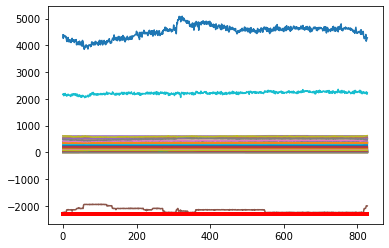

Predicción:  [[[0.89355236 0.10644766]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7291900e+01  1.2442900e+01  4.4959500e+01  7.4049900e+01
  5.9933230e+02  2.8869700e+01  7.9328000e+00  1.6463230e+02
  5.0000000e-04  7.9567800e+01  1.1484290e+02  1.0051400e+01
  5.2970800e+01  1.6553390e+02  2.1089600e+01  1.4092890e+02
  1.6552010e+02  6.8288100e+01 -6.8991000e+00  3.0016000e+00
  8.5107000e+00  7.0104000e+00  1.5016000e+00  6.9909900e+01
  1.3917000e+00  1.4558000e+00  7.5716300e+01  5.7093200e+01
  1.2560000e+00  1.1774000e+00  1.5491000e+00  1.3228000e+00
  1.4283820e+02  8.2750000e-01  8.2970000e-01 -1.9953241e+03
  1.9633940e+02  1.5322000e+00  1.3134000e+00  2.2329072e+03
  4.3009587e+03  1.8481450e+02  1.3518000e+00  1.3445000e+00
  7.4986000e+00  7.7988000e+00  1.6884000e+00  1.3930000e-01
  2.8855600e+01  5.3653780e+02  5.2430570e+02  5.2014310e+02
  5.2072250e+02  5.2091810e+02  2.6714300e+01  2.92

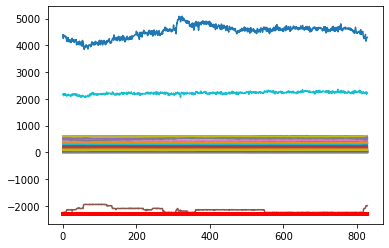

Predicción:  [[[0.8912301  0.10876987]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.6042700e+01  1.2610800e+01  4.3481700e+01  7.3905400e+01
  6.0049450e+02  2.9493100e+01  7.9272000e+00  1.6365350e+02
  5.0000000e-04  7.9629100e+01  1.1464850e+02  9.8600000e+00
  5.3172200e+01  1.6615150e+02  2.1260700e+01  1.4085590e+02
  1.6447590e+02  6.7796000e+01 -6.8991000e+00  2.9846000e+00
  8.1913000e+00  6.9887000e+00  1.5010000e+00  6.9590800e+01
  1.3930000e+00  1.4557000e+00  7.4814300e+01  5.7473500e+01
  1.2550000e+00  1.1792000e+00  1.5523000e+00  1.3236000e+00
  1.4282040e+02  8.2690000e-01  8.3010000e-01 -1.9973645e+03
  1.9567550e+02  1.5312000e+00  1.3123000e+00  2.2369017e+03
  4.3631638e+03  1.8481450e+02  1.3516000e+00  1.3469000e+00
  7.5002000e+00  7.8011000e+00  1.6913000e+00  1.3910000e-01
  2.8103500e+01  5.3658230e+02  5.2466070e+02  5.2047040e+02
  5.2098890e+02  5.2114930e+02  2.6647300e+01  2.92

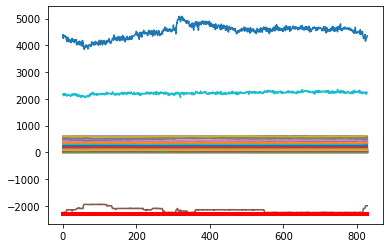

Predicción:  [[[0.9044214  0.09557858]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.5412100e+01  1.2571400e+01  4.5659300e+01  7.3502100e+01
  6.0057140e+02  2.9918000e+01  7.9389000e+00  1.6259690e+02
  5.0000000e-04  7.9927200e+01  1.1185440e+02  1.0242500e+01
  5.3024800e+01  1.6572060e+02  2.0850000e+01  1.4113990e+02
  1.6332670e+02  6.8173600e+01 -6.8991000e+00  2.9698000e+00
  7.1045000e+00  7.0117000e+00  1.5017000e+00  6.9604900e+01
  1.3645000e+00  1.4248000e+00  7.5106600e+01  5.8138800e+01
  1.2308000e+00  1.1553000e+00  1.5232000e+00  1.2944000e+00
  1.3882390e+02  8.2680000e-01  8.2870000e-01 -1.9396843e+03
  1.9797150e+02  1.5000000e+00  1.2886000e+00  2.2063387e+03
  4.1288551e+03  1.8481450e+02  1.3204000e+00  1.3191000e+00
  7.5003000e+00  7.8012000e+00  1.6625000e+00  1.3930000e-01
  2.6264200e+01  5.3371760e+02  5.2378260e+02  5.1799820e+02
  5.1859230e+02  5.1875310e+02  2.6675600e+01  2.91

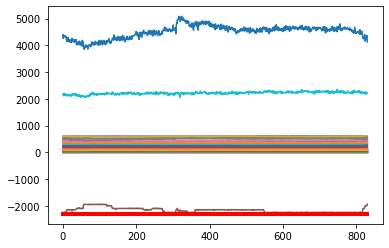

Predicción:  [[[0.79569656 0.20430346]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3797400e+01  1.2467100e+01  4.3200000e+01  4.2305600e+01
  5.9821370e+02  2.9417500e+01  8.2312000e+00  1.6184520e+02
  5.0000000e-04  7.9076300e+01  1.1180070e+02  1.0149700e+01
  4.5400900e+01  1.5311040e+02  1.9618500e+01  1.4044070e+02
  1.6549160e+02  6.8251200e+01  2.7838200e+01  2.6196000e+00
  1.8755400e+01  7.0422000e+00  1.4985000e+00  6.8900900e+01
  1.2306000e+00  1.2849000e+00  7.1530000e+01  6.1599800e+01
  1.1123000e+00  9.8180000e-01  1.3918000e+00  1.0857000e+00
  1.0505210e+02  8.2790000e-01  8.3070000e-01 -1.6379608e+03
  1.9981210e+02  1.3563000e+00  1.1737000e+00  2.2082732e+03
  1.4566588e+03  1.8481450e+02  1.1066000e+00  1.1049000e+00
  7.4961000e+00  7.7878000e+00  1.5282000e+00  1.3650000e-01
  2.0735600e+01  5.0471560e+02  4.9877970e+02  4.9369750e+02
  4.9476480e+02  4.9503970e+02  2.8472800e+01  2.99

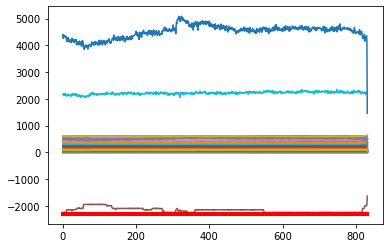

Predicción:  [[[0.00663923 0.99336076]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7731400e+01  1.3663200e+01  4.0571700e+01  5.6441000e+01
  5.8844770e+02  3.7743000e+01  8.5534000e+00  1.6005680e+02
  5.0000000e-04  7.5446400e+01  1.1245210e+02  1.0544800e+01
  5.4475000e+01  1.5262700e+02  2.0482400e+01  1.1499130e+02
  1.6492790e+02  6.4755700e+01  3.0355600e+01  2.2911000e+00
  2.0436100e+01  7.0127000e+00  1.5342000e+00  6.7856600e+01
  1.5196000e+00  1.5809000e+00  7.2367800e+01  6.2982400e+01
  1.3864000e+00  1.1869000e+00  1.6687000e+00  1.3250000e+00
  1.3590510e+02  8.2800000e-01  8.3120000e-01 -1.8637127e+03
  1.8489120e+02  1.6530000e+00  1.4494000e+00  2.0593612e+03
  3.2461664e+03  1.8481450e+02  1.3530000e+00  1.3551000e+00
  7.5030000e+00  7.8049000e+00  1.8130000e+00  1.4410000e-01
  2.7573900e+01  5.3978000e+02  5.2365090e+02  5.2227160e+02
  5.2284230e+02  5.2367740e+02  2.7178000e+01  2

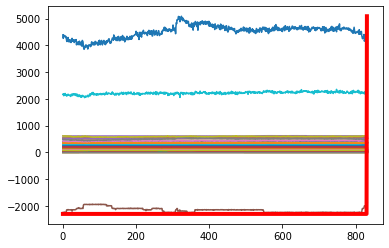

Predicción:  [[[0.25984123 0.7401588 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7089700e+01  1.3769700e+01  4.1396700e+01  7.0639800e+01
  5.8996220e+02  3.6060900e+01  8.5615000e+00  1.6011240e+02
  5.0000000e-04  7.4988200e+01  1.1160410e+02  9.8899000e+00
  5.3412400e+01  1.5644710e+02  2.0179600e+01  1.2737900e+02
  1.6344760e+02  6.5683800e+01  2.0000600e+01  2.2983000e+00
  1.9341200e+01  6.9745000e+00  1.6016000e+00  6.7985600e+01
  1.4241000e+00  1.4851000e+00  7.2152700e+01  5.7941700e+01
  1.2844000e+00  1.1136000e+00  1.5686000e+00  1.2451000e+00
  1.3295020e+02  8.2660000e-01  8.2950000e-01 -2.0176557e+03
  1.8840450e+02  1.5571000e+00  1.3419000e+00  2.2052788e+03
  4.3486033e+03  1.8481450e+02  1.2735000e+00  1.2697000e+00
  7.5005000e+00  7.8021000e+00  1.7144000e+00  1.4580000e-01
  2.8602400e+01  5.3527560e+02  5.2771970e+02  5.2130670e+02
  5.2200830e+02  5.2265220e+02  2.8935500e+01  2

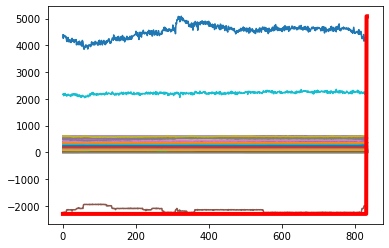

Predicción:  [[[0.91127706 0.08872294]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5620800e+01  1.3815300e+01  4.3781500e+01  7.0729700e+01
  5.8956960e+02  3.5673300e+01  8.5317000e+00  1.6004380e+02
  5.0000000e-04  7.5988000e+01  1.1097760e+02  9.9430000e+00
  5.3351300e+01  1.5357830e+02  2.1298600e+01  1.2626180e+02
  1.6356150e+02  6.5438900e+01  1.4010800e+01  2.2998000e+00
  1.9509300e+01  7.0041000e+00  1.5998000e+00  6.7980700e+01
  1.4611000e+00  1.5256000e+00  7.2676600e+01  5.2591000e+01
  1.3286000e+00  1.1698000e+00  1.6134000e+00  1.3185000e+00
  1.4862900e+02  8.2740000e-01  8.3120000e-01 -1.9943213e+03
  1.8488100e+02  1.6002000e+00  1.3812000e+00  2.2823220e+03
  4.3586602e+03  1.8481450e+02  1.3474000e+00  1.3409000e+00
  7.5297000e+00  7.8020000e+00  1.7555000e+00  1.4190000e-01
  2.8847100e+01  5.3417670e+02  5.2435870e+02  5.2028000e+02
  5.2081400e+02  5.2139000e+02  2.9172900e+01  2.93

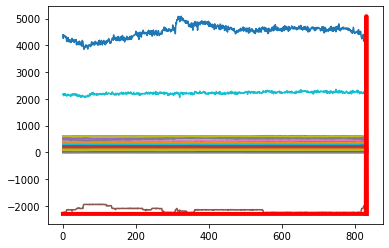

Predicción:  [[[0.8992313  0.10076864]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2688700e+01  1.4027600e+01  4.4209300e+01  7.2920800e+01
  5.9017340e+02  3.4293600e+01  8.5628000e+00  1.6006080e+02
  5.0000000e-04  7.6039500e+01  1.1045250e+02  9.7966000e+00
  5.2778000e+01  1.6226020e+02  2.1860800e+01  1.3302100e+02
  1.6305910e+02  6.5810100e+01  3.4400000e-01  2.2911000e+00
  1.9400600e+01  7.0049000e+00  1.5997000e+00  6.8181200e+01
  1.4423000e+00  1.5075000e+00  7.4214600e+01  5.3003700e+01
  1.3135000e+00  1.1924000e+00  1.5770000e+00  1.3387000e+00
  1.4856790e+02  8.2720000e-01  8.3010000e-01 -1.9960133e+03
  1.8682770e+02  1.5822000e+00  1.3665000e+00  2.2156543e+03
  4.3356640e+03  1.8481450e+02  1.3670000e+00  1.3598000e+00
  7.4540000e+00  7.8009000e+00  1.7322000e+00  1.5520000e-01
  2.8395000e+01  5.3776880e+02  5.2761270e+02  5.2307720e+02
  5.2359680e+02  5.2406040e+02  2.8362800e+01  2.94

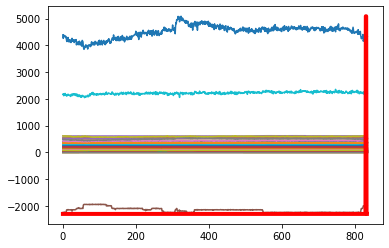

Predicción:  [[[0.8961786  0.10382136]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.4705800e+01  1.4333800e+01  4.6570400e+01  7.3711000e+01
  5.8998070e+02  3.4147200e+01  8.5511000e+00  1.5944800e+02
  2.3000000e-03  7.7875600e+01  1.0924660e+02  1.0047300e+01
  5.2821000e+01  1.6978710e+02  2.1097100e+01  1.3862770e+02
  1.6224230e+02  6.6687800e+01  3.9776000e+00  2.3245000e+00
  1.0265200e+01  6.9865000e+00  1.6006000e+00  6.8270300e+01
  1.3795000e+00  1.4427000e+00  7.4126400e+01  5.5242800e+01
  1.2488000e+00  1.1663000e+00  1.5103000e+00  1.3070000e+00
  1.4075090e+02  8.2800000e-01  8.2930000e-01 -1.9867360e+03
  1.8971570e+02  1.5177000e+00  1.3041000e+00  2.2470050e+03
  4.3179621e+03  1.8481450e+02  1.3327000e+00  1.3285000e+00
  7.4968000e+00  7.7987000e+00  1.6660000e+00  1.5560000e-01
  2.5793200e+01  5.3295560e+02  5.2467010e+02  5.1964620e+02
  5.2012840e+02  5.2059020e+02  2.8834000e+01  2.97

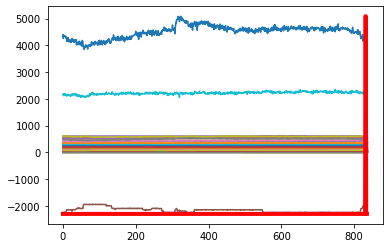

Predicción:  [[[0.88745093 0.112549  ]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.4130800e+01  1.4712200e+01  4.4946700e+01  7.0472600e+01
  5.9056000e+02  3.3674300e+01  8.4771000e+00  1.5909180e+02
  7.7000000e-03  7.8883600e+01  1.0934740e+02  9.9370000e+00
  5.0894100e+01  1.6879420e+02  2.0032900e+01  1.4502210e+02
  1.6306730e+02  6.6760200e+01  2.0000600e+01  2.1561000e+00
  1.0584700e+01  7.0652000e+00  1.6009000e+00  6.8255200e+01
  1.3250000e+00  1.3874000e+00  7.5169200e+01  6.2816600e+01
  1.1996000e+00  1.1195000e+00  1.4623000e+00  1.2490000e+00
  1.2887370e+02  8.4030000e-01  8.4210000e-01 -1.8574336e+03
  1.9265650e+02  1.4622000e+00  1.2621000e+00  2.1110556e+03
  4.1040475e+03  1.8481450e+02  1.2711000e+00  1.2682000e+00
  7.5021000e+00  7.8017000e+00  1.6165000e+00  1.5430000e-01
  2.2202200e+01  5.2922000e+02  5.2086770e+02  5.1629050e+02
  5.1690210e+02  5.1741300e+02  2.9629300e+01  3.00

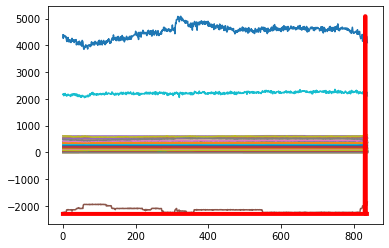

Predicción:  [[[0.6762722  0.32372773]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3804200e+01  1.4595400e+01  4.0512000e+01  5.0322500e+01
  5.8880710e+02  3.2124600e+01  8.3933000e+00  1.5906370e+02
  1.3100000e-02  7.5083200e+01  1.1418270e+02  1.0325600e+01
  4.9247200e+01  1.6200590e+02  2.0023600e+01  1.3248520e+02
  1.6416300e+02  6.6984700e+01  2.0000600e+01  2.0247000e+00
  2.1082600e+01  7.1058000e+00  1.5990000e+00  6.8193100e+01
  1.2705000e+00  1.3296000e+00  7.1919700e+01  7.7791900e+01
  1.1418000e+00  1.0402000e+00  1.3965000e+00  1.1549000e+00
  1.1475100e+02  8.4900000e-01  8.5090000e-01 -1.6788431e+03
  1.9579860e+02  1.4009000e+00  1.2193000e+00  1.9368818e+03
  3.8708162e+03  1.8481450e+02  1.1758000e+00  1.1712000e+00
  7.5007000e+00  7.7999000e+00  1.5560000e+00  1.5960000e-01
  2.0774500e+01  5.3289110e+02  5.2296850e+02  5.1774720e+02
  5.1883880e+02  5.1949800e+02  3.0033200e+01  3.03

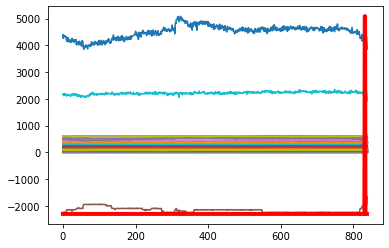

Predicción:  [[[0.27144173 0.72855824]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8960500e+01  1.4388200e+01  3.8424700e+01  3.7303300e+01
  5.8012240e+02  3.0061800e+01  8.4225000e+00  1.5904710e+02
  2.0100000e-02  7.3064200e+01  1.1502220e+02  9.9126000e+00
  4.9820800e+01  1.5806140e+02  2.0007800e+01  1.0729480e+02
  1.6391140e+02  6.6752200e+01  2.0000600e+01  2.0180000e+00
  2.3342400e+01  7.0839000e+00  1.5987000e+00  6.8155400e+01
  1.2706000e+00  1.3285000e+00  6.9946100e+01  8.1957700e+01
  1.1397000e+00  9.9180000e-01  1.3964000e+00  1.1006000e+00
  1.0809660e+02  8.4820000e-01  8.5050000e-01 -1.6072571e+03
  1.9484990e+02  1.3977000e+00  1.2218000e+00  1.9460006e+03
  4.0158531e+03  1.8481450e+02  1.1213000e+00  1.1174000e+00
  7.5003000e+00  7.7988000e+00  1.5514000e+00  1.5490000e-01
  2.0620000e+01  5.3828000e+02  5.2958940e+02  5.2093760e+02
  5.2220240e+02  5.2281520e+02  3.0059300e+01  3

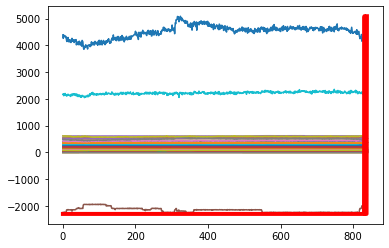

Predicción:  [[[0.23395182 0.76604825]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.8973700e+01  1.4620600e+01  3.6565300e+01  3.1033500e+01
  5.6945950e+02  2.9201500e+01  8.5057000e+00  1.5905320e+02
  4.0000000e-02  7.0465700e+01  1.1510450e+02  9.9802000e+00
  4.7771200e+01  1.5738550e+02  1.9983300e+01  1.0444120e+02
  1.6395900e+02  6.6477900e+01  2.0000600e+01  2.2708000e+00
  2.7940500e+01  7.1085000e+00  1.5988000e+00  6.8166800e+01
  1.3018000e+00  1.3575000e+00  6.8645000e+01  7.9487100e+01
  1.1729000e+00  9.7210000e-01  1.4165000e+00  1.0769000e+00
  1.0446430e+02  8.4860000e-01  8.4990000e-01 -1.6064213e+03
  1.9459150e+02  1.4264000e+00  1.2519000e+00  2.0453192e+03
  4.1245226e+03  1.8481450e+02  1.0971000e+00  1.1160000e+00
  7.4973000e+00  7.7992000e+00  1.5779000e+00  1.6150000e-01
  2.0219300e+01  5.4005730e+02  5.3201450e+02  5.2150170e+02
  5.2277840e+02  5.2339190e+02  3.0066100e+01  3

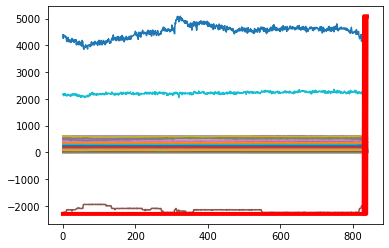

Predicción:  [[[0.27464405 0.7253559 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.5196800e+01  1.4599900e+01  3.7183700e+01  2.8719100e+01
  5.5963920e+02  2.9848200e+01  8.5606000e+00  1.5840920e+02
  6.2900000e-02  6.8721700e+01  1.1472980e+02  9.9803000e+00
  4.7752900e+01  1.5386450e+02  1.9998300e+01  1.0966940e+02
  1.6292380e+02  6.5907000e+01  2.0000600e+01  2.4682000e+00
  2.8226400e+01  7.0811000e+00  1.5995000e+00  6.8153200e+01
  1.3547000e+00  1.4116000e+00  6.7741600e+01  7.5593700e+01
  1.2278000e+00  9.6940000e-01  1.4735000e+00  1.0776000e+00
  1.0482410e+02  8.4850000e-01  8.4960000e-01 -1.6188143e+03
  1.9113610e+02  1.4783000e+00  1.3034000e+00  2.0735688e+03
  4.0894462e+03  1.8481450e+02  1.1356000e+00  1.1667000e+00
  7.5024000e+00  7.7994000e+00  1.6308000e+00  1.5750000e-01
  5.6344500e+01  5.4133110e+02  5.3329660e+02  5.2208910e+02
  5.2336340e+02  5.2414420e+02  3.0136300e+01  3

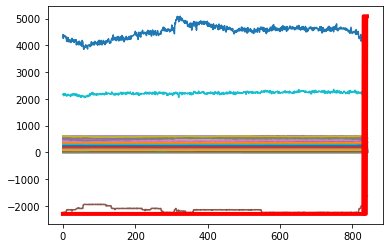

Predicción:  [[[0.27512434 0.7248756 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.5503900e+01  1.3809600e+01  3.6230100e+01  3.0858300e+01
  5.4930290e+02  3.2390400e+01  8.5760000e+00  1.5799830e+02
  8.5700000e-02  6.7201100e+01  1.1456580e+02  9.9451000e+00
  4.8398100e+01  1.5141170e+02  2.0005000e+01  9.1375500e+01
  1.6140020e+02  6.5204700e+01  1.2689100e+01  2.4737000e+00
  2.8313000e+01  7.1197000e+00  1.5995000e+00  6.8158500e+01
  1.4317000e+00  1.4875000e+00  6.4778600e+01  7.2342100e+01
  1.3029000e+00  9.7900000e-01  1.5521000e+00  1.1213000e+00
  1.3696510e+02  8.4860000e-01  8.4990000e-01 -1.6114209e+03
  1.8794120e+02  1.5523000e+00  1.3756000e+00  2.0966192e+03
  4.0975647e+03  1.8481450e+02  1.2080000e+00  1.2367000e+00
  7.5000000e+00  7.7999000e+00  1.7077000e+00  1.5570000e-01
  8.6786300e+01  5.4143330e+02  5.3390450e+02  5.2194300e+02
  5.2332140e+02  5.2411980e+02  3.0187800e+01  3

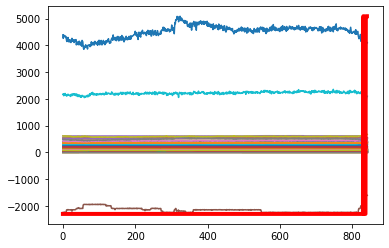

Predicción:  [[[0.2665495 0.7334505]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.5399200e+01  1.3701700e+01  3.6291400e+01  3.4860400e+01
  5.2883600e+02  3.1073900e+01  8.5904000e+00  1.5794960e+02
  1.0630000e-01  6.7152900e+01  1.1482490e+02  9.7872000e+00
  5.4664000e+01  1.5038680e+02  2.0440100e+01  9.6654200e+01
  1.6107320e+02  6.4989100e+01  3.8330000e+00  2.4892000e+00
  2.8338300e+01  7.1002000e+00  1.5997000e+00  6.8173500e+01
  1.4768000e+00  1.5307000e+00  6.4049000e+01  7.1560600e+01
  1.3478000e+00  9.8280000e-01  1.5989000e+00  1.1570000e+00
  1.7194530e+02  8.4860000e-01  8.5030000e-01 -1.6043347e+03
  1.8858020e+02  1.5954000e+00  1.4192000e+00  2.1445854e+03
  4.2232932e+03  1.8481450e+02  1.2478000e+00  1.2779000e+00
  7.5005000e+00  7.8007000e+00  1.7518000e+00  1.5280000e-01
  8.9645400e+01  5.4090220e+02  5.3333790e+02  5.2126660e+02
  5.2255850e+02  5.2337510e+02  2.9960100e+01  3.1

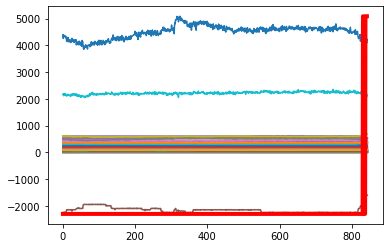

Predicción:  [[[0.30639264 0.69360733]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.5517100e+01  1.3589500e+01  3.5722300e+01  3.7046400e+01
  5.2619980e+02  3.1034700e+01  8.3154000e+00  1.5815260e+02
  1.0870000e-01  6.6927500e+01  1.1459240e+02  9.8474000e+00
  4.9611000e+01  1.4952420e+02  1.7471700e+01  1.0356690e+02
  1.6096850e+02  6.5569200e+01  3.3330000e+00  2.5121000e+00
  2.8393400e+01  7.0729000e+00  1.5978000e+00  6.8801600e+01
  1.5276000e+00  1.5813000e+00  6.1919900e+01  7.2259100e+01
  1.3853000e+00  9.9090000e-01  1.6456000e+00  1.2066000e+00
  2.0935480e+02  8.4650000e-01  8.5040000e-01 -1.6751249e+03
  1.8964040e+02  1.6441000e+00  1.4579000e+00  2.1121723e+03
  4.3947583e+03  1.8481450e+02  1.2975000e+00  1.3267000e+00
  7.5010000e+00  7.8062000e+00  1.8039000e+00  1.5860000e-01
  9.0994400e+01  5.4166660e+02  5.3384830e+02  5.2151610e+02
  5.2289130e+02  5.2368230e+02  2.9763000e+01  3

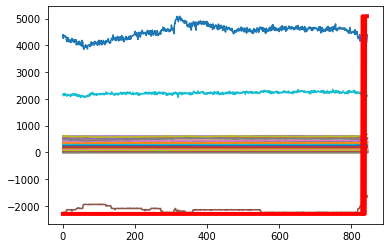

Predicción:  [[[0.51301956 0.48698038]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.1554300e+01  1.3867000e+01  3.6665200e+01  3.5305500e+01
  5.0467220e+02  3.1068200e+01  8.1311000e+00  1.5725250e+02
  1.5480000e-01  6.7264500e+01  1.1450340e+02  1.0068400e+01
  5.0319900e+01  1.4480110e+02  1.9193600e+01  1.0414630e+02
  1.6070760e+02  6.5020200e+01  1.3277800e+01  2.4960000e+00
  2.8578500e+01  7.1233000e+00  1.6003000e+00  6.9148800e+01
  1.5755000e+00  1.6244000e+00  6.0133600e+01  7.2107000e+01
  1.4304000e+00  9.8690000e-01  1.7017000e+00  1.2432000e+00
  2.5344280e+02  8.4810000e-01  8.5040000e-01 -1.7103634e+03
  1.8962830e+02  1.6842000e+00  1.5024000e+00  2.1203793e+03
  4.1345788e+03  1.8481450e+02  1.3357000e+00  1.3669000e+00
  7.4974000e+00  7.7981000e+00  1.8520000e+00  1.5020000e-01
  9.2476200e+01  5.4016450e+02  5.3330090e+02  5.2051600e+02
  5.2215270e+02  5.2281380e+02  2.9637200e+01  3.13

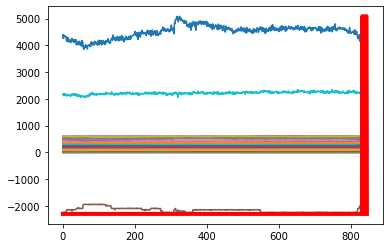

Predicción:  [[[0.43267676 0.5673232 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.9094500e+01  1.4769700e+01  3.2584800e+01  3.3241600e+01
  4.9963940e+02  2.9835900e+01  7.9809000e+00  1.5566270e+02
  4.1876500e+01  6.1993500e+01  1.1494410e+02  1.0023600e+01
  5.4774000e+01  1.8111650e+02  1.9706500e+01  1.0476160e+02
  1.6089780e+02  6.5220200e+01  4.9167600e+01  2.5170000e+00
  9.2006000e+00  7.1003000e+00  1.5998000e+00  6.9212900e+01
  1.5858000e+00  1.6337000e+00  5.8710700e+01  7.2448700e+01
  1.4415000e+00  9.7510000e-01  1.6872000e+00  1.2585000e+00
  2.8185650e+02  8.4810000e-01  8.5010000e-01 -1.6953404e+03
  1.9000120e+02  1.6946000e+00  1.5141000e+00  2.1756582e+03
  3.8861552e+03  1.8481450e+02  1.3512000e+00  1.3846000e+00
  7.4987000e+00  7.7979000e+00  1.8530000e+00  1.6570000e-01
  9.2849200e+01  5.4339550e+02  5.3480310e+02  5.2188360e+02
  5.2344550e+02  5.2423110e+02  2.9296900e+01  3

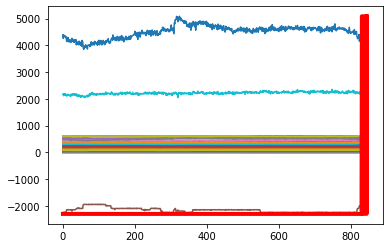

Predicción:  [[[0.288974 0.711026]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.0685400e+01  1.4265400e+01  2.6198900e+01  3.0053700e+01
  4.8346100e+02  3.3514300e+01  7.8700000e+00  1.5324440e+02
  5.7350600e+01  5.4652100e+01  1.1542320e+02  9.9327000e+00
  6.6096900e+01  1.9144430e+02  1.9846300e+01  1.0237950e+02
  1.5728640e+02  6.6005400e+01  5.0001000e+01  2.5829000e+00
  1.2344000e+00  7.0961000e+00  1.6025000e+00  6.9323800e+01
  1.5262000e+00  1.5771000e+00  5.8955200e+01  7.5219300e+01
  1.3803000e+00  9.9350000e-01  1.6108000e+00  1.2045000e+00
  2.1847860e+02  8.4760000e-01  8.5010000e-01 -1.6823050e+03
  1.9311720e+02  1.6365000e+00  1.4562000e+00  2.1346846e+03
  4.0040605e+03  1.8481450e+02  1.2957000e+00  1.3304000e+00
  7.5002000e+00  7.7998000e+00  1.7901000e+00  1.7940000e-01
  9.1306900e+01  5.4687280e+02  5.3779930e+02  5.2415330e+02
  5.2568070e+02  5.2659790e+02  2.8411700e+01  3.155

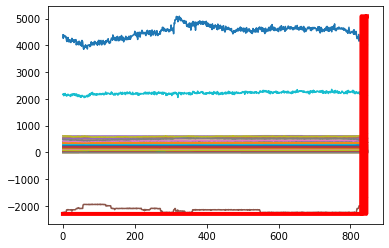

Predicción:  [[[0.3162916  0.68370837]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8584900e+01  1.3939300e+01  3.0013000e+01  2.9122800e+01
  4.7991370e+02  3.2798300e+01  7.9491000e+00  1.5282570e+02
  5.7699800e+01  5.2799500e+01  1.1468620e+02  9.9825000e+00
  5.5843000e+01  1.8702710e+02  1.9407900e+01  1.0391860e+02
  1.5563330e+02  6.6761800e+01  5.0001000e+01  2.6153000e+00
  1.2446000e+00  7.1125000e+00  1.6006000e+00  6.9247200e+01
  1.4098000e+00  1.4617000e+00  6.0530500e+01  7.7939500e+01
  1.2652000e+00  9.7260000e-01  1.4982000e+00  1.0987000e+00
  1.2855070e+02  8.4610000e-01  8.5000000e-01 -1.6714211e+03
  1.9646380e+02  1.5225000e+00  1.3426000e+00  2.1861359e+03
  4.1079541e+03  1.8481450e+02  1.1850000e+00  1.2205000e+00
  7.5005000e+00  7.8009000e+00  1.6753000e+00  1.7690000e-01
  8.6365000e+01  5.4549610e+02  5.3785600e+02  5.2379620e+02
  5.2535390e+02  5.2617660e+02  2.8664100e+01  3

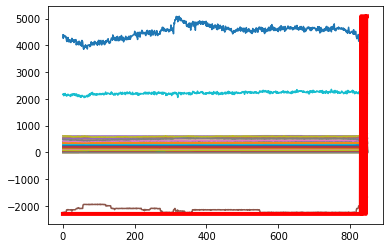

Predicción:  [[[0.34061134 0.65938866]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2686000e+01  1.3430800e+01  3.3298400e+01  2.9064500e+01
  4.8046810e+02  3.2541800e+01  7.8892000e+00  1.5204370e+02
  5.7595500e+01  5.0809600e+01  1.1104800e+02  1.0057300e+01
  5.2656600e+01  1.8840100e+02  1.9741500e+01  9.6333600e+01
  1.5424280e+02  6.6970400e+01  3.5056200e+01  2.6007000e+00
  1.2495000e+00  7.1056000e+00  1.6010000e+00  6.9207800e+01
  1.3720000e+00  1.4226000e+00  6.2359300e+01  7.4995000e+01
  1.2360000e+00  9.9320000e-01  1.4515000e+00  1.0985000e+00
  1.0688040e+02  8.4420000e-01  8.4960000e-01 -1.6416149e+03
  1.9702690e+02  1.4856000e+00  1.3107000e+00  2.2698712e+03
  3.8646284e+03  1.8481450e+02  1.1531000e+00  1.1875000e+00
  7.5025000e+00  7.7997000e+00  1.6335000e+00  1.8200000e-01
  5.8143600e+01  5.4562280e+02  5.3723830e+02  5.2405560e+02
  5.2557390e+02  5.2632810e+02  2.8585800e+01  3

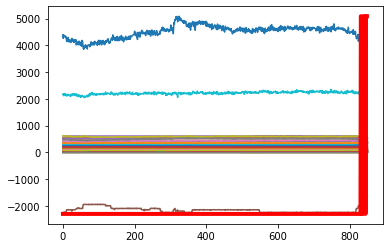

Predicción:  [[[0.1963313  0.80366874]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7135900e+01  1.1970700e+01  3.5693200e+01  3.2097000e+01
  4.8037840e+02  3.6521800e+01  8.0446000e+00  1.5199470e+02
  5.6227100e+01  5.1597900e+01  1.0906910e+02  9.8557000e+00
  4.8492900e+01  1.9755450e+02  1.9953800e+01  9.1512100e+01
  1.5261040e+02  6.7200300e+01 -4.0000000e-04  2.8689000e+00
  1.2435000e+00  7.0814000e+00  1.6005000e+00  6.8959900e+01
  1.3071000e+00  1.3623000e+00  6.5357800e+01  7.4318100e+01
  1.1812000e+00  9.9530000e-01  1.3611000e+00  1.1006000e+00
  1.0468110e+02  8.4510000e-01  8.5010000e-01 -1.5653332e+03
  1.9775150e+02  1.4268000e+00  1.2562000e+00  2.2288896e+03
  3.8873343e+03  1.8481450e+02  1.1215000e+00  1.1292000e+00
  7.4981000e+00  7.8041000e+00  1.5644000e+00  2.0280000e-01
  2.1025900e+01  5.4544160e+02  5.3740350e+02  5.2456000e+02
  5.2595990e+02  5.2670010e+02  2.8488800e+01  3

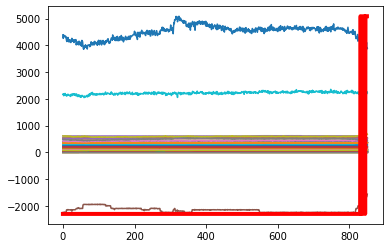

Predicción:  [[[0.13096689 0.8690331 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7753600e+01  1.0467800e+01  5.1808100e+01  3.2611200e+01
  4.7898990e+02  3.5521900e+01  8.2107000e+00  1.5209880e+02
  5.5240600e+01  5.5495400e+01  9.8763100e+01  1.0073000e+01
  4.7202300e+01  2.0279920e+02  1.9797000e+01  9.0362200e+01
  1.5160980e+02  6.7615900e+01 -4.0000000e-04  3.1971000e+00
  1.2415000e+00  7.0886000e+00  1.6006000e+00  6.9061800e+01
  1.2723000e+00  1.3292000e+00  6.6536500e+01  7.4214600e+01
  1.1553000e+00  9.9950000e-01  1.3106000e+00  1.1041000e+00
  1.0420940e+02  8.4570000e-01  8.4960000e-01 -1.5243013e+03
  2.0001680e+02  1.3959000e+00  1.2296000e+00  2.2181344e+03
  3.8761303e+03  1.8481450e+02  1.1246000e+00  1.1190000e+00
  7.4988000e+00  7.7988000e+00  1.5277000e+00  2.1740000e-01
  2.0569300e+01  5.4623840e+02  5.3746510e+02  5.2530860e+02
  5.2666410e+02  5.2737720e+02  2.8027100e+01  3

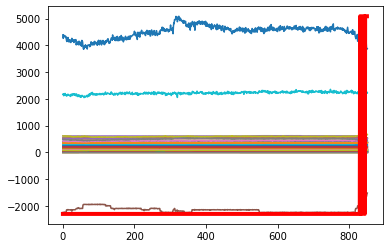

Predicción:  [[[0.10025106 0.899749  ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.6681900e+01  8.3914000e+00  6.0558000e+01  3.2964800e+01
  4.7025930e+02  3.1920400e+01  8.3314000e+00  1.5211070e+02
  5.5121900e+01  5.7715800e+01  9.0629800e+01  1.0014400e+01
  4.8357500e+01  2.0331130e+02  1.9173600e+01  9.1219100e+01
  1.5003090e+02  6.7574800e+01 -4.0000000e-04  3.4799000e+00
  1.2383000e+00  7.1038000e+00  1.5987000e+00  6.9020000e+01
  1.2566000e+00  1.3131000e+00  6.7634900e+01  7.5098000e+01
  1.1458000e+00  1.0099000e+00  1.2860000e+00  1.1154000e+00
  1.0571080e+02  8.4490000e-01  8.4950000e-01 -1.4646030e+03
  1.9817360e+02  1.3804000e+00  1.2206000e+00  2.1567104e+03
  3.8322910e+03  1.8481450e+02  1.1356000e+00  1.1303000e+00
  7.4979000e+00  7.7999000e+00  1.5118000e+00  2.2570000e-01
  2.0205800e+01  5.4792720e+02  5.3873350e+02  5.2680800e+02
  5.2807080e+02  5.2884500e+02  2.6513300e+01  3

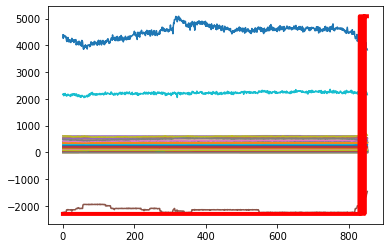

Predicción:  [[[0.07229015 0.9277098 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 7.1705400e+01  7.7705000e+00  5.9729000e+01  3.6709900e+01
  4.6898250e+02  3.0094400e+01  8.4117000e+00  1.5194070e+02
  5.5938800e+01  5.6294000e+01  9.0318700e+01  9.7143000e+00
  4.9593600e+01  1.9949880e+02  1.9671900e+01  8.9881700e+01
  1.4922940e+02  6.8475600e+01 -4.0000000e-04  3.6231000e+00
  1.2321000e+00  7.2196000e+00  1.6003000e+00  6.9686100e+01
  1.2633000e+00  1.3212000e+00  6.7697100e+01  7.5542100e+01
  1.1617000e+00  1.0319000e+00  1.2963000e+00  1.1422000e+00
  1.0922130e+02  8.4400000e-01  8.5020000e-01 -1.3735916e+03
  2.0119300e+02  1.3894000e+00  1.2377000e+00  2.1429472e+03
  4.0258350e+03  1.8481450e+02  1.1620000e+00  1.1594000e+00
  7.5030000e+00  7.8019000e+00  1.5217000e+00  2.2530000e-01
  1.9527200e+01  5.4881560e+02  5.3951250e+02  5.2792090e+02
  5.2921830e+02  5.2990640e+02  2.6949100e+01  3

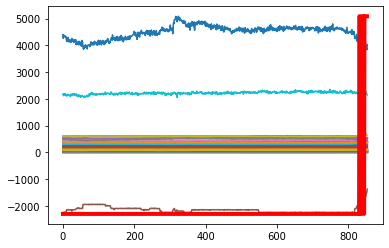

Predicción:  [[[0.0622903 0.9377096]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.1487600e+01  8.5459000e+00  6.2280800e+01  3.7119400e+01
  4.7057920e+02  3.2942600e+01  8.3782000e+00  1.5200530e+02
  2.1307900e+01  5.9475500e+01  8.8025000e+01  1.0041500e+01
  4.8940500e+01  1.7295220e+02  1.9477300e+01  9.1581200e+01
  1.4950080e+02  6.8345900e+01 -4.0000000e-04  3.5996000e+00
  1.2823000e+00  7.1741000e+00  1.6024000e+00  6.9756400e+01
  1.2434000e+00  1.3017000e+00  6.6533200e+01  7.6105600e+01
  1.1457000e+00  1.0118000e+00  1.3422000e+00  1.1205000e+00
  1.0805310e+02  8.4680000e-01  8.5000000e-01 -1.3181445e+03
  1.9909540e+02  1.3685000e+00  1.2216000e+00  2.0509944e+03
  4.2536836e+03  1.8481450e+02  1.1426000e+00  1.1328000e+00
  7.4968000e+00  7.7979000e+00  1.5154000e+00  1.7290000e-01
  2.1786200e+01  5.4587330e+02  5.3762760e+02  5.2628970e+02
  5.2761560e+02  5.2828270e+02  2.7205700e+01  3.0

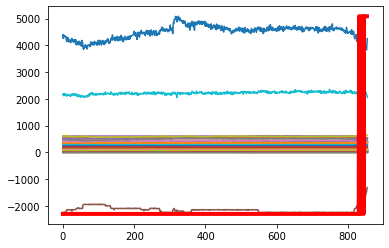

Predicción:  [[[0.06676932 0.9332307 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.6466400e+01  8.2967000e+00  6.6958800e+01  3.7357900e+01
  4.6986920e+02  3.1718300e+01  8.5720000e+00  1.5082630e+02
  5.0564100e+01  5.8300100e+01  8.4848000e+01  8.8564000e+00
  5.0147400e+01  1.9420000e+02  1.8908900e+01  9.0814900e+01
  1.4920690e+02  6.8419500e+01 -4.0000000e-04  3.9019000e+00
  9.8500000e-01  7.1901000e+00  1.5999000e+00  6.9808600e+01
  1.2645000e+00  1.3228000e+00  6.7733800e+01  7.3763000e+01
  1.1715000e+00  1.0237000e+00  1.3096000e+00  1.1372000e+00
  1.1159920e+02  8.5090000e-01  8.5520000e-01 -1.2970986e+03
  2.0070700e+02  1.3905000e+00  1.2458000e+00  2.0555188e+03
  4.1466163e+03  1.8481450e+02  1.1627000e+00  1.1488000e+00
  7.5024000e+00  7.7992000e+00  1.5240000e+00  2.1440000e-01
  2.5565900e+01  5.4407780e+02  5.3518020e+02  5.2524870e+02
  5.2652290e+02  5.2720410e+02  2.7268900e+01  3

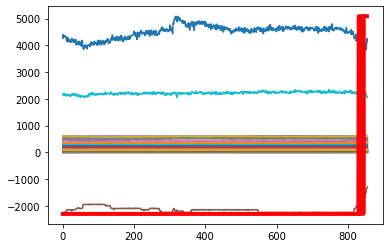

Predicción:  [[[0.05221219 0.94778776]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.4210900e+01  8.5359000e+00  6.7392700e+01  3.8895000e+01
  4.6899860e+02  3.2212600e+01  8.5022000e+00  1.4998390e+02
  3.0486700e+01  6.0293800e+01  8.4968800e+01  8.1196000e+00
  5.0873400e+01  1.7856060e+02  1.9262300e+01  8.9498700e+01
  1.4797510e+02  6.8589900e+01 -4.0000000e-04  3.8039000e+00
  1.8537000e+00  7.3076000e+00  1.5991000e+00  7.0010400e+01
  1.2535000e+00  1.3106000e+00  6.7752000e+01  7.0675500e+01
  1.1672000e+00  1.0321000e+00  1.3416000e+00  1.1454000e+00
  1.1433990e+02  8.5340000e-01  8.5820000e-01 -1.3036599e+03
  2.0036580e+02  1.3772000e+00  1.2382000e+00  2.1060780e+03
  4.0401327e+03  1.8481450e+02  1.1669000e+00  1.1601000e+00
  7.4956000e+00  7.7981000e+00  1.5235000e+00  1.8210000e-01
  2.1661100e+01  5.4460770e+02  5.3608540e+02  5.2631290e+02
  5.2753530e+02  5.2817890e+02  2.7231700e+01  2

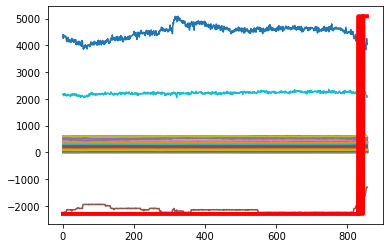

Predicción:  [[[0.04640968 0.9535903 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.8294300e+01  8.6968000e+00  6.6025500e+01  4.0902500e+01
  4.6970650e+02  3.1861900e+01  8.4627000e+00  1.4991640e+02
  2.9571300e+01  6.0844100e+01  8.5009200e+01  8.0431000e+00
  5.4721400e+01  1.7243720e+02  1.9042500e+01  9.1130600e+01
  1.4854000e+02  6.8307500e+01 -4.0000000e-04  3.7987000e+00
  2.6000000e-03  7.2965000e+00  1.5999000e+00  7.0006500e+01
  1.2863000e+00  1.3444000e+00  6.6641500e+01  6.7571400e+01
  1.2003000e+00  1.0540000e+00  1.3931000e+00  1.1732000e+00
  1.1694400e+02  8.5610000e-01  8.5970000e-01 -1.3064170e+03
  1.9546290e+02  1.4116000e+00  1.2679000e+00  2.1018552e+03
  4.1555746e+03  1.8481450e+02  1.1943000e+00  1.1881000e+00
  7.4979000e+00  7.7913000e+00  1.5626000e+00  1.6950000e-01
  2.1084400e+01  5.4104780e+02  5.3334790e+02  5.2461390e+02
  5.2581890e+02  5.2647760e+02  2.7632700e+01  2

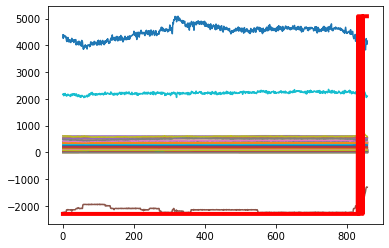

Predicción:  [[[0.05456572 0.94543433]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.8711200e+01  8.7348000e+00  6.4427600e+01  4.5586500e+01
  4.7057280e+02  3.1391500e+01  8.5213000e+00  1.5018680e+02
  2.6627100e+01  6.1065400e+01  8.4998900e+01  8.0563000e+00
  5.6863200e+01  1.7208480e+02  1.8930100e+01  9.4548200e+01
  1.4862780e+02  6.8264900e+01 -4.1320000e+00  3.7984000e+00
  3.6000000e-03  7.3142000e+00  1.5995000e+00  7.0180300e+01
  1.3014000e+00  1.3607000e+00  6.7264800e+01  6.3168500e+01
  1.2134000e+00  1.0718000e+00  1.4074000e+00  1.2005000e+00
  1.2644910e+02  8.5620000e-01  8.5950000e-01 -1.3816324e+03
  1.9776650e+02  1.4274000e+00  1.2761000e+00  2.1488183e+03
  3.9704372e+03  1.8481450e+02  1.2232000e+00  1.2173000e+00
  7.5048000e+00  7.8061000e+00  1.5786000e+00  1.7120000e-01
  2.2370600e+01  5.4047000e+02  5.3271900e+02  5.2529450e+02
  5.2631460e+02  5.2693280e+02  2.6947300e+01  2

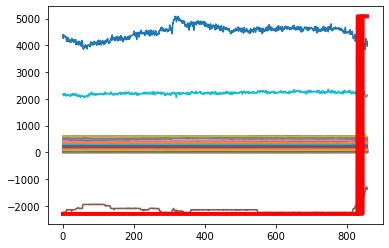

Predicción:  [[[0.05981907 0.9401809 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.9416700e+01  8.6071000e+00  6.2944800e+01  6.0411300e+01
  4.7441850e+02  3.1973900e+01  8.4165000e+00  1.5001860e+02
  1.2079500e+01  6.2392000e+01  8.6963500e+01  7.8913000e+00
  5.4385400e+01  1.6142580e+02  2.1623400e+01  1.0884500e+02
  1.4829690e+02  6.7422100e+01 -6.8991000e+00  3.6050000e+00
  4.2000000e-03  7.2932000e+00  1.6002000e+00  7.0228900e+01
  1.3978000e+00  1.4577000e+00  6.8028600e+01  5.5264800e+01
  1.3098000e+00  1.1707000e+00  1.5302000e+00  1.3124000e+00
  1.4034830e+02  8.5530000e-01  8.5930000e-01 -1.4925366e+03
  1.9207100e+02  1.5251000e+00  1.3649000e+00  2.2501510e+03
  3.6919237e+03  1.8481450e+02  1.3388000e+00  1.3292000e+00
  7.5040000e+00  7.8004000e+00  1.6840000e+00  1.5400000e-01
  2.6160000e+01  5.4071210e+02  5.3069590e+02  5.2620290e+02
  5.2691060e+02  5.2710810e+02  2.7060400e+01  2

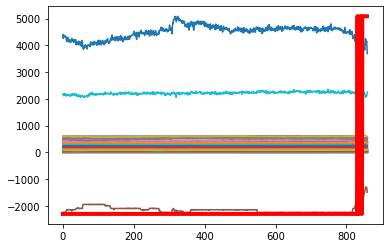

Predicción:  [[[0.06800237 0.93199766]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5963700e+01  9.0143000e+00  6.3738000e+01  6.8059900e+01
  4.8716390e+02  3.2176600e+01  8.2314000e+00  1.4997450e+02
  7.3954000e+00  6.3358100e+01  8.7806400e+01  8.0608000e+00
  4.6765900e+01  1.5810110e+02  2.2225700e+01  1.2413390e+02
  1.4826370e+02  6.7386100e+01 -6.8991000e+00  3.2255000e+00
  6.8000000e-03  7.2759000e+00  1.5984000e+00  7.0333700e+01
  1.4676000e+00  1.5287000e+00  6.8206700e+01  5.3472800e+01
  1.3603000e+00  1.2382000e+00  1.6116000e+00  1.3776000e+00
  1.4008770e+02  8.5660000e-01  8.6000000e-01 -1.7030284e+03
  1.9222810e+02  1.5962000e+00  1.4134000e+00  2.2300617e+03
  3.8983721e+03  1.8481450e+02  1.4041000e+00  1.3953000e+00
  7.4981000e+00  7.8002000e+00  1.7603000e+00  1.4860000e-01
  2.6606800e+01  5.4464460e+02  5.3459980e+02  5.2975200e+02
  5.3047510e+02  5.3049890e+02  2.7088600e+01  2

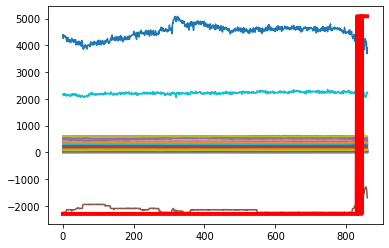

Predicción:  [[[0.2890204 0.7109796]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2128400e+01  9.1435000e+00  6.2004100e+01  6.9862700e+01
  4.9593870e+02  3.2349800e+01  8.4109000e+00  1.4993060e+02
  4.9955000e+00  6.3787300e+01  8.7855900e+01  8.1036000e+00
  4.7043600e+01  1.5862490e+02  2.2221900e+01  1.2461610e+02
  1.4833400e+02  6.8457100e+01 -6.8991000e+00  3.5678000e+00
  6.5000000e-03  7.3277000e+00  1.6000000e+00  7.1101500e+01
  1.4728000e+00  1.5349000e+00  6.9189300e+01  5.4843000e+01
  1.3650000e+00  1.2419000e+00  1.6181000e+00  1.3836000e+00
  1.4158940e+02  8.5630000e-01  8.5920000e-01 -1.6973619e+03
  1.9551970e+02  1.6031000e+00  1.4196000e+00  2.2607208e+03
  3.9390710e+03  1.8481450e+02  1.4083000e+00  1.4019000e+00
  7.5009000e+00  7.7997000e+00  1.7693000e+00  1.5090000e-01
  2.4696600e+01  5.4534610e+02  5.3583270e+02  5.3063460e+02
  5.3135270e+02  5.3141000e+02  2.7124300e+01  2.8

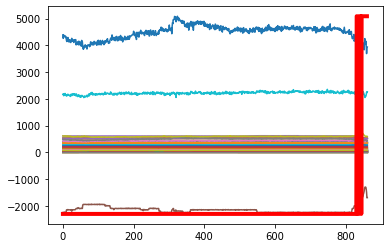

Predicción:  [[[0.3001999  0.69980013]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9349100e+01  9.4216000e+00  6.2049600e+01  6.9404900e+01
  4.9858080e+02  3.3056500e+01  8.4830000e+00  1.4998310e+02
  9.5006000e+00  6.3827600e+01  8.8030500e+01  7.9710000e+00
  4.7382700e+01  1.6528240e+02  2.1829400e+01  1.2704270e+02
  1.4872060e+02  6.8571300e+01 -6.8991000e+00  3.7414000e+00
  4.7000000e-03  7.3018000e+00  1.6001000e+00  7.1302200e+01
  1.4612000e+00  1.5227000e+00  6.8281600e+01  5.5156100e+01
  1.3525000e+00  1.2353000e+00  1.5957000e+00  1.3716000e+00
  1.3915100e+02  8.5600000e-01  8.5960000e-01 -1.6988075e+03
  1.9877370e+02  1.5916000e+00  1.4076000e+00  2.2259752e+03
  3.9157777e+03  1.8481450e+02  1.3956000e+00  1.3884000e+00
  7.4994000e+00  7.8018000e+00  1.7582000e+00  1.6240000e-01
  2.4189000e+01  5.4320440e+02  5.3418190e+02  5.2883510e+02
  5.2966000e+02  5.2964240e+02  2.7495100e+01  2

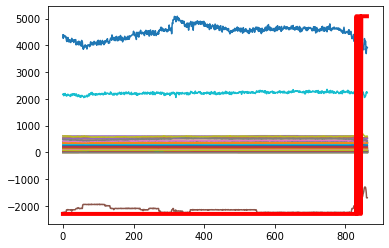

Predicción:  [[[0.2915949 0.7084051]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6452600e+01  9.5468000e+00  6.2482100e+01  6.9372000e+01
  4.9936440e+02  3.2481700e+01  8.5011000e+00  1.4994880e+02
  1.0172100e+01  6.4070900e+01  8.7930400e+01  8.0688000e+00
  4.7305000e+01  1.6637830e+02  2.1159700e+01  1.2969870e+02
  1.4866780e+02  6.9173000e+01 -6.8991000e+00  3.8102000e+00
  3.3000000e-03  7.2721000e+00  1.6010000e+00  7.1404200e+01
  1.4390000e+00  1.4972000e+00  6.7837900e+01  5.6402400e+01
  1.3247000e+00  1.2271000e+00  1.5708000e+00  1.3639000e+00
  1.3809690e+02  8.5580000e-01  8.6070000e-01 -1.6970999e+03
  2.0151590e+02  1.5653000e+00  1.3813000e+00  2.1843414e+03
  3.9015031e+03  1.8481450e+02  1.3880000e+00  1.3811000e+00
  7.4968000e+00  7.8002000e+00  1.7359000e+00  1.6540000e-01
  2.3942400e+01  5.4246010e+02  5.3293530e+02  5.2815340e+02
  5.2896080e+02  5.2888450e+02  2.7589900e+01  2.9

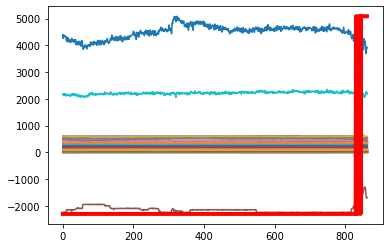

Predicción:  [[[0.28280324 0.71719676]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.6850300e+01  9.6073000e+00  6.4205800e+01  6.7635800e+01
  5.0013390e+02  3.3460600e+01  8.5783000e+00  1.4995630e+02
  7.9280000e+00  6.4942000e+01  8.8125900e+01  7.9214000e+00
  4.7267300e+01  1.6418040e+02  2.1069000e+01  1.2926560e+02
  1.4871780e+02  6.9301100e+01 -6.8991000e+00  3.9440000e+00
  2.0000000e-03  7.3181000e+00  1.5999000e+00  7.1523300e+01
  1.4280000e+00  1.4834000e+00  6.9317200e+01  5.6782700e+01
  1.3143000e+00  1.2189000e+00  1.5604000e+00  1.3561000e+00
  1.3785490e+02  8.5490000e-01  8.5950000e-01 -1.7006967e+03
  1.9929060e+02  1.5528000e+00  1.3712000e+00  2.2226933e+03
  3.9210501e+03  1.8481450e+02  1.3797000e+00  1.3745000e+00
  7.5030000e+00  7.8002000e+00  1.7242000e+00  1.6380000e-01
  2.3596300e+01  5.4113160e+02  5.3250160e+02  5.2734990e+02
  5.2820880e+02  5.2813850e+02  2.7560100e+01  2

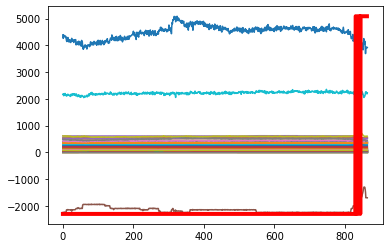

Predicción:  [[[0.29691896 0.703081  ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3207400e+01  9.8747000e+00  6.3609700e+01  6.7929600e+01
  4.9952070e+02  3.3824800e+01  8.6061000e+00  1.5006110e+02
  7.8019000e+00  6.6257100e+01  8.8924400e+01  8.0083000e+00
  4.7003100e+01  1.6625210e+02  2.0907100e+01  1.3255450e+02
  1.4912440e+02  6.9106600e+01 -6.8991000e+00  4.0654000e+00
  1.1000000e-03  7.3095000e+00  1.5995000e+00  7.1564800e+01
  1.4269000e+00  1.4831000e+00  6.8729700e+01  5.6785800e+01
  1.3110000e+00  1.2212000e+00  1.5560000e+00  1.3539000e+00
  1.3534130e+02  8.5480000e-01  8.5990000e-01 -1.7024762e+03
  2.0199450e+02  1.5518000e+00  1.3682000e+00  2.1937138e+03
  3.8510896e+03  1.8481450e+02  1.3771000e+00  1.3729000e+00
  7.5008000e+00  7.7998000e+00  1.7251000e+00  1.6940000e-01
  2.3450200e+01  5.4088330e+02  5.3187710e+02  5.2692320e+02
  5.2781410e+02  5.2776990e+02  2.7373400e+01  2

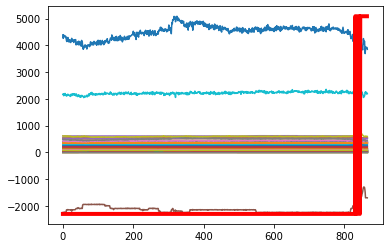

Predicción:  [[[0.27060294 0.72939706]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3026400e+01  9.7447000e+00  5.7956400e+01  6.8378900e+01
  4.9957230e+02  3.4819300e+01  8.6901000e+00  1.5005560e+02
  8.7131000e+00  6.6295900e+01  9.2656100e+01  7.9573000e+00
  4.6967100e+01  1.6743010e+02  2.0593400e+01  1.3898570e+02
  1.4899270e+02  6.9576200e+01 -6.8991000e+00  4.2116000e+00
  9.0000000e-04  7.3142000e+00  1.6003000e+00  7.1729900e+01
  1.4096000e+00  1.4651000e+00  6.9659500e+01  5.7694700e+01
  1.2972000e+00  1.2060000e+00  1.5326000e+00  1.3396000e+00
  1.3337540e+02  8.5450000e-01  8.5860000e-01 -1.6989514e+03
  2.0282350e+02  1.5346000e+00  1.3548000e+00  2.1658402e+03
  3.8713557e+03  1.8481450e+02  1.3624000e+00  1.3601000e+00
  7.4971000e+00  7.7994000e+00  1.7070000e+00  1.7440000e-01
  2.2725400e+01  5.3869610e+02  5.3027620e+02  5.2495010e+02
  5.2576770e+02  5.2577760e+02  2.7324800e+01  2

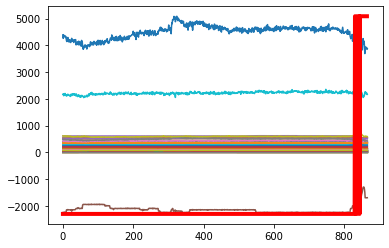

Predicción:  [[[0.2740944 0.7259056]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0707500e+01  9.7015000e+00  5.7965600e+01  6.8613300e+01
  5.0046660e+02  3.4958100e+01  8.6539000e+00  1.4996270e+02
  6.1366000e+00  6.6760800e+01  9.3008100e+01  7.8838000e+00
  4.6741400e+01  1.6947330e+02  2.0130800e+01  1.4103200e+02
  1.4877460e+02  6.9653500e+01 -6.8991000e+00  4.1238000e+00
  4.0000000e-04  7.2701000e+00  1.5984000e+00  7.1561000e+01
  1.3959000e+00  1.4510000e+00  6.9648600e+01  5.8271800e+01
  1.2775000e+00  1.1952000e+00  1.5119000e+00  1.3257000e+00
  1.3178160e+02  8.5440000e-01  8.6020000e-01 -1.7031917e+03
  2.0241230e+02  1.5197000e+00  1.3355000e+00  2.1997296e+03
  3.8990151e+03  1.8481450e+02  1.3485000e+00  1.3461000e+00
  7.4986000e+00  7.7999000e+00  1.6890000e+00  1.7730000e-01
  2.2784600e+01  5.3575940e+02  5.2714950e+02  5.2240510e+02
  5.2328630e+02  5.2347220e+02  2.7595600e+01  2.9

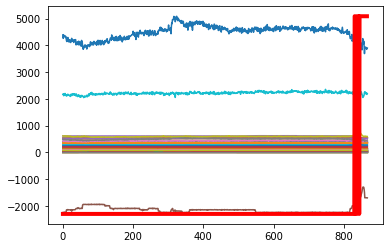

Predicción:  [[[0.29270837 0.7072916 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0781400e+01  9.7034000e+00  5.7042300e+01  6.9779500e+01
  4.9964390e+02  3.3073200e+01  8.6801000e+00  1.4991150e+02
  5.2400000e-02  6.7814700e+01  9.3052200e+01  8.0861000e+00
  4.7046900e+01  1.6241670e+02  2.0156700e+01  1.4554820e+02
  1.4860460e+02  6.9454400e+01 -6.8991000e+00  4.1441000e+00
  5.8000000e-03  7.3128000e+00  1.5991000e+00  7.1524700e+01
  1.3877000e+00  1.4425000e+00  6.9814500e+01  5.8475200e+01
  1.2712000e+00  1.1879000e+00  1.5136000e+00  1.3191000e+00
  1.3145390e+02  8.5500000e-01  8.5940000e-01 -1.6958779e+03
  2.0281310e+02  1.5113000e+00  1.3296000e+00  2.1370149e+03
  3.8410352e+03  1.8481450e+02  1.3425000e+00  1.3396000e+00
  7.5006000e+00  7.7990000e+00  1.6813000e+00  1.6770000e-01
  2.3461000e+01  5.3576780e+02  5.2651570e+02  5.2171660e+02
  5.2264710e+02  5.2302600e+02  2.7618500e+01  2

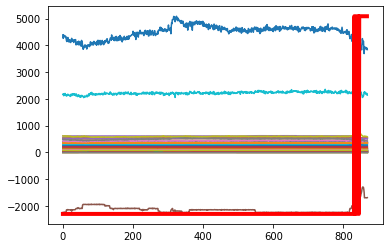

Predicción:  [[[0.26098612 0.7390139 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9062200e+01  9.8670000e+00  5.8361600e+01  6.8608000e+01
  5.0125360e+02  3.2770900e+01  8.6974000e+00  1.4992540e+02
  4.5985000e+00  7.3473800e+01  9.3000400e+01  8.1392000e+00
  4.6905100e+01  1.6418440e+02  2.0578200e+01  1.4608870e+02
  1.4891480e+02  6.9282500e+01 -6.8991000e+00  4.1998000e+00
  4.4000000e-03  7.3010000e+00  1.5995000e+00  7.1450000e+01
  1.3958000e+00  1.4558000e+00  6.9174700e+01  5.8012700e+01
  1.2836000e+00  1.1902000e+00  1.5292000e+00  1.3194000e+00
  1.3067520e+02  8.5500000e-01  8.5950000e-01 -1.7090980e+03
  1.9999930e+02  1.5245000e+00  1.3416000e+00  2.1741776e+03
  3.8305630e+03  1.8481450e+02  1.3422000e+00  1.3396000e+00
  7.5000000e+00  7.7990000e+00  1.7023000e+00  1.7310000e-01
  2.3170900e+01  5.3716950e+02  5.2703500e+02  5.2243870e+02
  5.2338640e+02  5.2377680e+02  2.7599100e+01  2

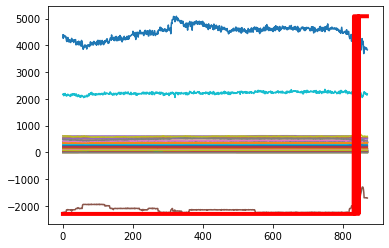

Predicción:  [[[0.27403462 0.72596544]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.8642600e+01  9.7181000e+00  5.7917400e+01  6.8589400e+01
  5.0023940e+02  3.2898800e+01  8.7072000e+00  1.4927300e+02
  1.3898300e+01  6.4751800e+01  9.2948000e+01  8.0889000e+00
  4.7020800e+01  1.6993080e+02  2.0701400e+01  1.4594040e+02
  1.4767120e+02  6.9242700e+01 -6.8991000e+00  4.2080000e+00
  5.0000000e-03  7.3121000e+00  1.6003000e+00  7.1454600e+01
  1.4062000e+00  1.4627000e+00  6.7886100e+01  5.7687700e+01
  1.2895000e+00  1.2046000e+00  1.5272000e+00  1.3356000e+00
  1.3162430e+02  8.5420000e-01  8.6070000e-01 -1.7025864e+03
  2.0218330e+02  1.5313000e+00  1.3472000e+00  2.1326562e+03
  3.8593298e+03  1.8481450e+02  1.3592000e+00  1.3573000e+00
  7.5011000e+00  7.7963000e+00  1.7065000e+00  1.7910000e-01
  2.3442700e+01  5.3856660e+02  5.2835830e+02  5.2359760e+02
  5.2442080e+02  5.2491100e+02  2.7650800e+01  2

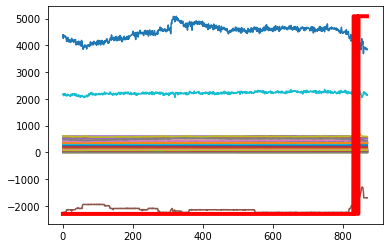

Predicción:  [[[0.2741674 0.7258326]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1289600e+01  9.6339000e+00  5.4789900e+01  6.9475600e+01
  4.9981440e+02  3.1021400e+01  8.7127000e+00  1.4872550e+02
  5.6597000e+00  6.4911000e+01  9.2993500e+01  7.9703000e+00
  4.7032100e+01  1.5825900e+02  2.0523200e+01  1.4624260e+02
  1.4701670e+02  6.9738500e+01 -6.8991000e+00  4.2030000e+00
  8.4000000e-03  7.3073000e+00  1.6002000e+00  7.1505500e+01
  1.3908000e+00  1.4428000e+00  6.8681700e+01  5.7715900e+01
  1.2725000e+00  1.1901000e+00  1.5298000e+00  1.3207000e+00
  1.3208160e+02  8.5410000e-01  8.6010000e-01 -1.6987855e+03
  2.0319960e+02  1.5119000e+00  1.3303000e+00  2.1759102e+03
  3.7796819e+03  1.8481450e+02  1.3458000e+00  1.3425000e+00
  7.5016000e+00  7.7993000e+00  1.6888000e+00  1.5890000e-01
  2.5100300e+01  5.3723550e+02  5.2763580e+02  5.2267290e+02
  5.2345200e+02  5.2400580e+02  2.7602600e+01  2.9

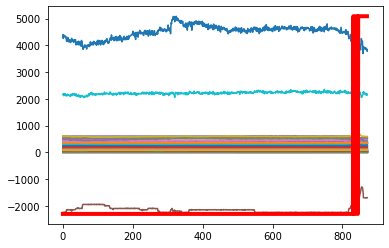

Predicción:  [[[0.23681657 0.76318336]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1930300e+01  9.6971000e+00  5.4851400e+01  6.7527800e+01
  5.0027550e+02  3.1698100e+01  8.7159000e+00  1.4791740e+02
  1.0089300e+01  6.4490900e+01  9.3101000e+01  7.9952000e+00
  4.6840400e+01  1.6216090e+02  2.0143200e+01  1.4771960e+02
  1.4631960e+02  6.9710100e+01 -6.8991000e+00  4.2002000e+00
  1.1400000e-02  7.3276000e+00  1.6001000e+00  7.1509000e+01
  1.3805000e+00  1.4296000e+00  6.8103500e+01  5.8269700e+01
  1.2609000e+00  1.1797000e+00  1.5161000e+00  1.3049000e+00
  1.3064820e+02  8.5420000e-01  8.5910000e-01 -1.7023522e+03
  2.0340090e+02  1.4973000e+00  1.3189000e+00  2.1110651e+03
  3.7004631e+03  1.8481450e+02  1.3313000e+00  1.3268000e+00
  7.4707000e+00  7.8012000e+00  1.6829000e+00  1.6630000e-01
  2.6887300e+01  5.3582950e+02  5.2672640e+02  5.2150770e+02
  5.2235860e+02  5.2282040e+02  2.7562600e+01  2

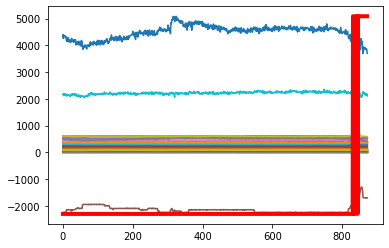

Predicción:  [[[0.21207434 0.78792566]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.0624300e+01  9.7787000e+00  5.3722300e+01  6.7861000e+01
  4.9956800e+02  3.1176400e+01  8.7267000e+00  1.4730440e+02
  8.1572000e+00  6.3579800e+01  9.3063600e+01  8.0232000e+00
  4.6991900e+01  1.5691920e+02  1.9716100e+01  1.4661990e+02
  1.4563830e+02  6.9902200e+01 -6.8991000e+00  4.1864000e+00
  1.0800000e-02  7.2754000e+00  1.5987000e+00  7.1466200e+01
  1.3746000e+00  1.4243000e+00  6.7589200e+01  5.8325400e+01
  1.2544000e+00  1.1762000e+00  1.5122000e+00  1.3049000e+00
  1.2985920e+02  8.5350000e-01  8.5960000e-01 -1.7070928e+03
  2.0469090e+02  1.4922000e+00  1.3126000e+00  2.1892166e+03
  3.8173369e+03  1.8481450e+02  1.3292000e+00  1.3273000e+00
  7.4926000e+00  7.7996000e+00  1.6731000e+00  1.6080000e-01
  2.4400700e+01  5.3431190e+02  5.2499200e+02  5.2033160e+02
  5.2119290e+02  5.2170220e+02  2.7789000e+01  2

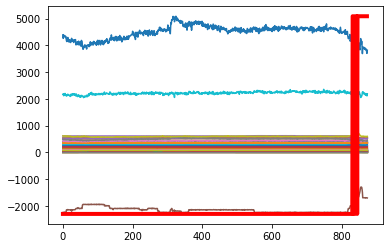

Predicción:  [[[0.2605189  0.73948103]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3748800e+01  9.9092000e+00  5.0757800e+01  6.5822700e+01
  5.0085900e+02  3.1826500e+01  8.7480000e+00  1.4701430e+02
  9.9852000e+00  6.2423400e+01  9.2981900e+01  8.0491000e+00
  4.4789600e+01  1.5694310e+02  1.9329900e+01  1.4586370e+02
  1.4574340e+02  7.0513300e+01 -6.8991000e+00  4.0946000e+00
  1.0700000e-02  7.4055000e+00  1.5995000e+00  7.1596900e+01
  1.3084000e+00  1.3591000e+00  6.7847000e+01  6.0974400e+01
  1.2006000e+00  1.1158000e+00  1.4546000e+00  1.2356000e+00
  1.1996620e+02  8.5450000e-01  8.5940000e-01 -1.5415208e+03
  2.0513120e+02  1.4265000e+00  1.2614000e+00  2.0584011e+03
  3.1459060e+03  1.8481450e+02  1.2585000e+00  1.2547000e+00
  7.5523000e+00  7.8534000e+00  1.6137000e+00  1.5930000e-01
  2.3211400e+01  5.2110090e+02  5.1801830e+02  5.1062430e+02
  5.1170110e+02  5.1187960e+02  2.7737500e+01  2

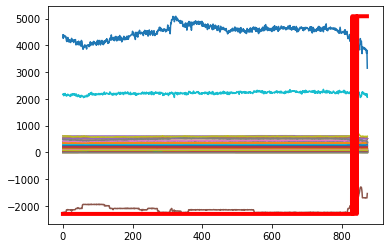

Predicción:  [[[0.04148906 0.95851094]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.1399400e+01  9.4805000e+00  5.6639100e+01  4.3484300e+01
  4.9995230e+02  3.0063600e+01  8.9619000e+00  1.4699600e+02
  4.5110700e+01  5.8500400e+01  9.2966000e+01  8.0137000e+00
  4.4960000e+01  1.7814140e+02  1.9053900e+01  1.3914260e+02
  1.4744490e+02  6.9547500e+01 -6.8991000e+00  3.8043000e+00
  1.1200000e-02  7.4783000e+00  1.5972000e+00  7.1475300e+01
  1.3139000e+00  1.3708000e+00  6.6720300e+01  5.8341000e+01
  1.2560000e+00  1.0982000e+00  1.4123000e+00  1.2151000e+00
  1.1411570e+02  8.5450000e-01  8.6010000e-01 -1.0610333e+03
  2.0460770e+02  1.4377000e+00  1.3141000e+00  2.1086697e+03
  1.5011788e+03  1.8481450e+02  1.2377000e+00  1.2337000e+00
  8.4697000e+00  8.0007000e+00  1.6136000e+00  2.0160000e-01
  2.2444700e+01  5.1077050e+02  5.0339440e+02  5.0154490e+02
  5.0262820e+02  5.0273080e+02  2.7305600e+01  2

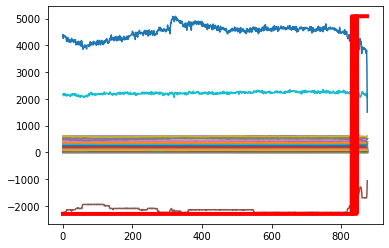

Predicción:  [[[5.2865775e-04 9.9947137e-01]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3949300e+01  9.3099000e+00  5.3314800e+01  7.0757500e+01
  4.9862050e+02  3.1210800e+01  9.2506000e+00  1.4704520e+02
  1.2702100e+01  5.8142400e+01  9.3122700e+01  7.9382000e+00
  4.5677200e+01  1.5431940e+02  1.9074200e+01  1.4443770e+02
  1.4698010e+02  6.9354600e+01 -6.8991000e+00  3.9306000e+00
  1.2200000e-02  7.5016000e+00  1.6017000e+00  7.1478700e+01
  1.3468000e+00  1.3960000e+00  6.9569000e+01  5.6889500e+01
  1.2937000e+00  1.1516000e+00  1.4809000e+00  1.2738000e+00
  1.2312560e+02  8.5760000e-01  8.6060000e-01 -1.0036921e+03
  2.0297380e+02  1.4644000e+00  1.3508000e+00  2.0915602e+03
  3.0257341e+03  1.8481450e+02  1.2978000e+00  1.2964000e+00
  8.5040000e+00  8.0046000e+00  1.6384000e+00  1.5730000e-01
  2.4130700e+01  5.2527550e+02  5.1694960e+02  5.1371550e+02
  5.1462930e+02  5.1478920e+02  2.8472300e

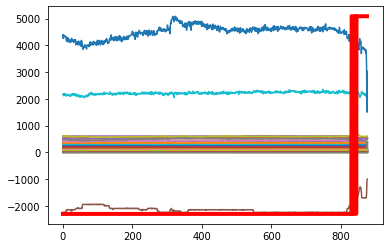

Predicción:  [[[0.00268635 0.9973137 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.4055200e+01  9.2319000e+00  5.6009200e+01  6.6353700e+01
  4.9923970e+02  3.1040200e+01  9.1690000e+00  1.4696660e+02
  1.4982600e+01  5.8147000e+01  9.2874400e+01  7.9325000e+00
  4.5604900e+01  1.5591750e+02  1.8965800e+01  1.4903890e+02
  1.4785620e+02  6.8947300e+01 -6.8991000e+00  3.9972000e+00
  1.3600000e-02  7.5242000e+00  1.5994000e+00  7.1478900e+01
  1.3549000e+00  1.4063000e+00  6.8873300e+01  5.6700500e+01
  1.3076000e+00  1.1566000e+00  1.4982000e+00  1.2797000e+00
  1.2409650e+02  8.5770000e-01  8.5910000e-01 -1.0094407e+03
  2.0164560e+02  1.4751000e+00  1.3641000e+00  2.1635534e+03
  3.2062341e+03  1.8481450e+02  1.3035000e+00  1.3043000e+00
  8.4966000e+00  8.0004000e+00  1.6569000e+00  1.5860000e-01
  2.4027600e+01  5.2766330e+02  5.2017250e+02  5.1634880e+02
  5.1724960e+02  5.1739680e+02  2.8576300e+01  2

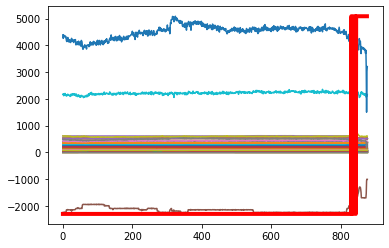

Predicción:  [[[0.00352818 0.9964719 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.7048700e+01  9.1441000e+00  5.2448200e+01  6.5377500e+01
  4.9974820e+02  3.0004500e+01  9.1651000e+00  1.4712550e+02
  1.3415300e+01  5.8288300e+01  9.3011500e+01  7.9191000e+00
  4.5008000e+01  1.5358710e+02  1.8953800e+01  1.4419690e+02
  1.4772800e+02  6.9065800e+01 -6.8991000e+00  3.9923000e+00
  1.4600000e-02  7.5022000e+00  1.5978000e+00  7.1482400e+01
  1.3456000e+00  1.4006000e+00  6.8366900e+01  5.6286900e+01
  1.2956000e+00  1.1473000e+00  1.4957000e+00  1.2749000e+00
  1.2677410e+02  8.5780000e-01  8.5980000e-01 -1.0395990e+03
  2.0180330e+02  1.4698000e+00  1.3522000e+00  2.1673669e+03
  3.2501608e+03  1.8481450e+02  1.2968000e+00  1.2975000e+00
  8.5002000e+00  7.9992000e+00  1.6522000e+00  1.5650000e-01
  2.1890600e+01  5.2675010e+02  5.1997890e+02  5.1554380e+02
  5.1641070e+02  5.1668640e+02  2.8258800e+01  2

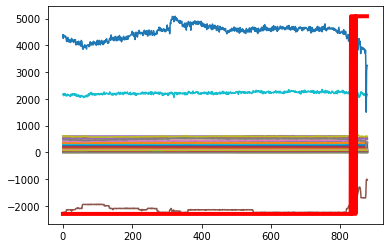

Predicción:  [[[0.00434383 0.99565613]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.8328900e+01  8.9264000e+00  5.2391000e+01  6.3312000e+01
  5.0022840e+02  2.9067900e+01  9.0923000e+00  1.4709120e+02
  1.8225300e+01  5.7498400e+01  9.2947600e+01  7.7903000e+00
  4.5376200e+01  1.5613650e+02  1.9032500e+01  1.4359120e+02
  1.4770260e+02  6.9105400e+01 -6.8991000e+00  4.0020000e+00
  1.7500000e-02  7.4694000e+00  1.5990000e+00  7.1521300e+01
  1.3502000e+00  1.4089000e+00  6.8277500e+01  5.6236200e+01
  1.2963000e+00  1.1512000e+00  1.4973000e+00  1.2784000e+00
  1.2568710e+02  8.5790000e-01  8.6020000e-01 -1.0939124e+03
  1.9994190e+02  1.4770000e+00  1.3524000e+00  2.1504330e+03
  3.1632389e+03  1.8481450e+02  1.3025000e+00  1.2977000e+00
  8.4990000e+00  8.0007000e+00  1.6584000e+00  1.6110000e-01
  2.3833100e+01  5.2584660e+02  5.1792980e+02  5.1402800e+02
  5.1482870e+02  5.1510880e+02  2.7924300e+01  2

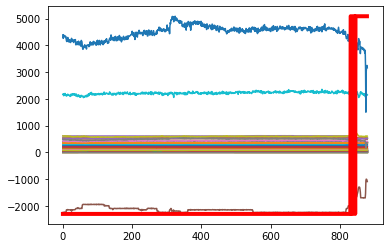

Predicción:  [[[0.00499429 0.9950058 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.0811200e+01  8.5816000e+00  5.2171900e+01  6.4191400e+01
  5.0041240e+02  2.7206800e+01  8.9745000e+00  1.4697350e+02
  1.5890600e+01  5.7904700e+01  9.3016200e+01  7.8738000e+00
  4.5205700e+01  1.5143570e+02  1.8974400e+01  1.4496600e+02
  1.4720000e+02  6.9543400e+01 -6.8991000e+00  3.8008000e+00
  2.3200000e-02  7.5116000e+00  1.6003000e+00  7.1519600e+01
  1.3318000e+00  1.3850000e+00  6.8586500e+01  5.7886500e+01
  1.2559000e+00  1.1318000e+00  1.4851000e+00  1.2588000e+00
  1.2651480e+02  8.5850000e-01  8.6010000e-01 -1.2567060e+03
  2.0269740e+02  1.4540000e+00  1.3136000e+00  2.1113912e+03
  3.2325306e+03  1.8481450e+02  1.2862000e+00  1.2762000e+00
  8.4626000e+00  7.9996000e+00  1.6354000e+00  1.5000000e-01
  2.7543200e+01  5.2596610e+02  5.1804980e+02  5.1350550e+02
  5.1438280e+02  5.1472690e+02  2.8165800e+01  2

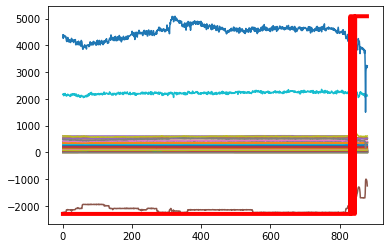

Predicción:  [[[0.01209569 0.98790437]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.9144700e+01  9.1622000e+00  5.3921600e+01  6.2053200e+01
  5.0010370e+02  2.7931200e+01  8.8132000e+00  1.4698190e+02
  2.1276400e+01  5.7643800e+01  9.3030300e+01  8.0214000e+00
  4.5074400e+01  1.5658140e+02  1.8972500e+01  1.4299600e+02
  1.4798240e+02  6.9355400e+01 -6.8991000e+00  3.4641000e+00
  2.1900000e-02  7.5024000e+00  1.5994000e+00  7.1385300e+01
  1.3374000e+00  1.3945000e+00  6.7748000e+01  5.6806000e+01
  1.2587000e+00  1.1374000e+00  1.4842000e+00  1.2631000e+00
  1.2454270e+02  8.5830000e-01  8.5960000e-01 -1.3070350e+03
  2.0422440e+02  1.4622000e+00  1.3162000e+00  2.1097896e+03
  3.2699240e+03  1.8481450e+02  1.2892000e+00  1.2818000e+00
  8.2973000e+00  7.9991000e+00  1.6422000e+00  1.5810000e-01
  2.6191500e+01  5.2599690e+02  5.1631650e+02  5.1277150e+02
  5.1369170e+02  5.1395390e+02  2.8243800e+01  2

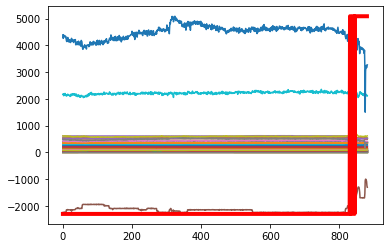

Predicción:  [[[0.0161381  0.98386186]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.2018200e+01  8.9764000e+00  5.2414500e+01  6.4001700e+01
  5.0030180e+02  2.8592900e+01  8.8161000e+00  1.4701870e+02
  1.5467300e+01  5.7909300e+01  9.3025500e+01  7.9231000e+00
  4.5458200e+01  1.5186970e+02  1.9071700e+01  1.4122210e+02
  1.4784080e+02  6.9057400e+01 -6.8991000e+00  3.2762000e+00
  2.6400000e-02  7.4651000e+00  1.6018000e+00  7.1048400e+01
  1.3261000e+00  1.3812000e+00  6.8852800e+01  5.7104900e+01
  1.2417000e+00  1.1268000e+00  1.4802000e+00  1.2563000e+00
  1.2694330e+02  8.5920000e-01  8.6200000e-01 -1.3422097e+03
  2.0350740e+02  1.4498000e+00  1.2991000e+00  2.1100678e+03
  3.2497752e+03  1.8481450e+02  1.2834000e+00  1.2752000e+00
  8.1964000e+00  8.0018000e+00  1.6302000e+00  1.5030000e-01
  2.6706200e+01  5.2849870e+02  5.1975090e+02  5.1529700e+02
  5.1616240e+02  5.1651040e+02  2.8519200e+01  2

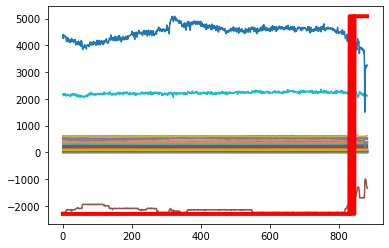

Predicción:  [[[0.01854094 0.981459  ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.1230200e+01  8.8238000e+00  5.3009300e+01  6.3046700e+01
  5.0095190e+02  2.8709800e+01  8.7658000e+00  1.4705800e+02
  1.9392000e+01  5.7751100e+01  9.2857400e+01  8.1545000e+00
  4.5127600e+01  1.5430320e+02  1.9206300e+01  1.4494050e+02
  1.4774640e+02  6.9020000e+01 -6.8991000e+00  3.3186000e+00
  2.8100000e-02  7.4871000e+00  1.5996000e+00  7.1038000e+01
  1.3215000e+00  1.3797000e+00  6.8076900e+01  5.6350900e+01
  1.2415000e+00  1.1193000e+00  1.4725000e+00  1.2475000e+00
  1.2583520e+02  8.5780000e-01  8.5960000e-01 -1.3484642e+03
  1.9974840e+02  1.4485000e+00  1.2977000e+00  2.1524605e+03
  3.2203906e+03  1.8481450e+02  1.2752000e+00  1.2647000e+00
  8.2014000e+00  7.9928000e+00  1.6266000e+00  1.5420000e-01
  2.7608700e+01  5.2604500e+02  5.1754890e+02  5.1314850e+02
  5.1405930e+02  5.1441810e+02  2.9830300e+01  2

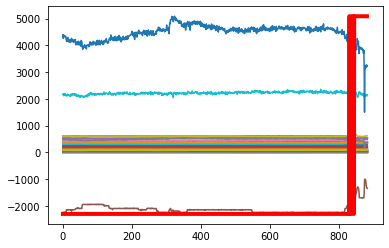

Predicción:  [[[0.01827854 0.9817215 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.4158900e+01  8.5179000e+00  5.1199900e+01  6.2591200e+01
  4.9951520e+02  2.8047300e+01  8.7593000e+00  1.4696690e+02
  1.9030800e+01  5.8014700e+01  9.2926900e+01  7.8277000e+00
  4.5256500e+01  1.5282960e+02  1.8978300e+01  1.4558110e+02
  1.4771850e+02  6.8972900e+01 -6.8991000e+00  3.3037000e+00
  2.9000000e-02  7.5169000e+00  1.6002000e+00  7.0962100e+01
  1.3378000e+00  1.3940000e+00  6.7488200e+01  5.5836300e+01
  1.2492000e+00  1.1370000e+00  1.4941000e+00  1.2615000e+00
  1.2614600e+02  8.5850000e-01  8.6030000e-01 -1.4002562e+03
  1.9915780e+02  1.4610000e+00  1.3052000e+00  2.0953554e+03
  3.2150980e+03  1.8481450e+02  1.2887000e+00  1.2800000e+00
  8.2009000e+00  8.0086000e+00  1.6425000e+00  1.4860000e-01
  2.7416800e+01  5.2643220e+02  5.1751570e+02  5.1344160e+02
  5.1426810e+02  5.1457800e+02  2.8828200e+01  2

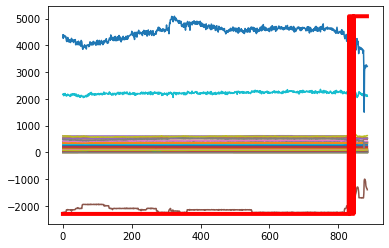

Predicción:  [[[0.02329222 0.97670776]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.4003300e+01  9.5977000e+00  5.2746800e+01  6.3489400e+01
  4.9969280e+02  2.8074000e+01  8.7356000e+00  1.4695760e+02
  1.7742700e+01  5.8050100e+01  9.2999500e+01  7.8402000e+00
  4.5407200e+01  1.5167410e+02  1.9274500e+01  1.4175700e+02
  1.4903550e+02  6.9137300e+01 -6.8991000e+00  3.1870000e+00
  4.2310000e-01  7.4863000e+00  1.5981000e+00  7.0920900e+01
  1.3264000e+00  1.3861000e+00  6.8347400e+01  5.5746000e+01
  1.2425000e+00  1.1228000e+00  1.4836000e+00  1.2556000e+00
  1.2881890e+02  8.5850000e-01  8.6120000e-01 -1.4153525e+03
  1.9989470e+02  1.4546000e+00  1.2979000e+00  2.1406354e+03
  3.3282378e+03  1.8481450e+02  1.2813000e+00  1.2740000e+00
  8.1880000e+00  8.0028000e+00  1.6321000e+00  1.4840000e-01
  2.5532000e+01  5.2759390e+02  5.1761980e+02  5.1453800e+02
  5.1529040e+02  5.1568920e+02  2.9583900e+01  2

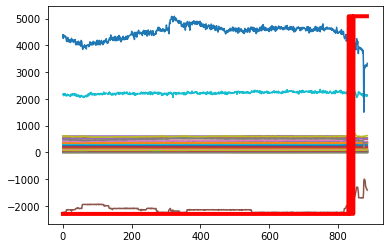

Predicción:  [[[0.02918383 0.9708162 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.8399800e+01  9.3800000e+00  5.3085500e+01  7.1594900e+01
  4.9964930e+02  2.8177600e+01  8.6600000e+00  1.4699940e+02
  7.6528000e+00  5.8938500e+01  9.3025900e+01  7.9424000e+00
  4.5703000e+01  1.4212230e+02  2.1745100e+01  1.4384190e+02
  1.4880550e+02  6.8090900e+01 -6.8991000e+00  3.0801000e+00
  1.6066000e+00  7.4872000e+00  1.6006000e+00  7.0804800e+01
  1.4200000e+00  1.4725000e+00  6.7856200e+01  5.3093800e+01
  1.3210000e+00  1.2069000e+00  1.5797000e+00  1.3487000e+00
  1.4006000e+02  8.5830000e-01  8.6050000e-01 -1.5192286e+03
  1.9467940e+02  1.5398000e+00  1.3739000e+00  2.2786920e+03
  3.6986457e+03  1.8481450e+02  1.3761000e+00  1.3674000e+00
  8.0994000e+00  7.9994000e+00  1.7147000e+00  1.3520000e-01
  2.7257200e+01  5.4217160e+02  5.3126480e+02  5.2718820e+02
  5.2791400e+02  5.2843420e+02  2.9690000e+01  2

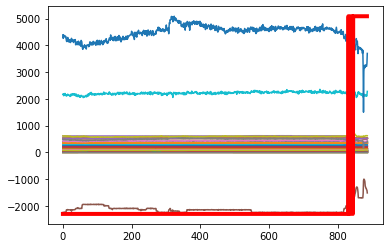

Predicción:  [[[0.07750378 0.92249626]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 6.2387100e+01  1.0172200e+01  5.3134600e+01  6.9678600e+01
  5.0000390e+02  2.8458500e+01  8.6650000e+00  1.4702330e+02
  3.1069000e+00  5.9444800e+01  9.2948600e+01  8.1478000e+00
  4.5879400e+01  1.4150940e+02  2.1868400e+01  1.4195940e+02
  1.4822120e+02  6.7962100e+01  1.0716000e+01  3.0996000e+00
  2.1701000e+00  7.5177000e+00  1.6008000e+00  7.0646700e+01
  1.4252000e+00  1.4768000e+00  6.8286000e+01  5.4142600e+01
  1.3208000e+00  1.2127000e+00  1.5907000e+00  1.3512000e+00
  1.4018010e+02  8.5760000e-01  8.6010000e-01 -1.5627847e+03
  1.9651370e+02  1.5444000e+00  1.3750000e+00  2.1961256e+03
  3.7823992e+03  1.8481450e+02  1.3775000e+00  1.3726000e+00
  8.1000000e+00  7.9967000e+00  1.7267000e+00  1.3590000e-01
  2.6339600e+01  5.4038180e+02  5.3250750e+02  5.2741320e+02
  5.2821850e+02  5.2849860e+02  2.9929000e+01  2

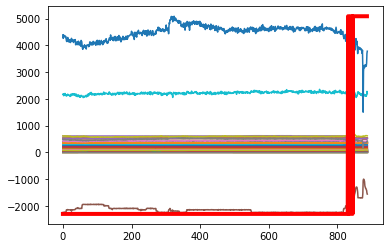

Predicción:  [[[0.10669884 0.8933012 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.9655200e+01  1.0608800e+01  5.2762200e+01  6.9265000e+01
  4.9974910e+02  2.8754900e+01  8.6275000e+00  1.4705540e+02
  7.3930000e+00  5.9255100e+01  9.3098600e+01  7.8110000e+00
  4.5665000e+01  1.4831600e+02  2.0917500e+01  1.4121020e+02
  1.4809280e+02  6.7167400e+01 -4.0000000e-04  3.1083000e+00
  2.5623000e+00  7.4957000e+00  1.5975000e+00  6.9991400e+01
  1.3925000e+00  1.4462000e+00  6.7878600e+01  5.3788300e+01
  1.2890000e+00  1.1831000e+00  1.5542000e+00  1.3184000e+00
  1.3696200e+02  8.5820000e-01  8.5910000e-01 -1.5984805e+03
  1.9348330e+02  1.5138000e+00  1.3423000e+00  2.2419330e+03
  3.6430090e+03  1.8481450e+02  1.3447000e+00  1.3401000e+00
  8.0313000e+00  8.0035000e+00  1.7005000e+00  1.4640000e-01
  2.6297400e+01  5.3562090e+02  5.2912950e+02  5.2395520e+02
  5.2485770e+02  5.2502350e+02  2.9896200e+01  2

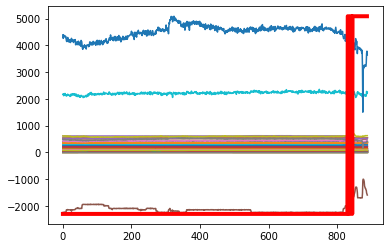

Predicción:  [[[0.10256407 0.8974359 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5951600e+01  1.1017200e+01  5.2880400e+01  6.8149800e+01
  5.0053550e+02  2.9158500e+01  8.6619000e+00  1.4697980e+02
  1.0628900e+01  5.9072700e+01  9.3025200e+01  8.0869000e+00
  4.5818200e+01  1.5299000e+02  2.0030600e+01  1.4167550e+02
  1.4838260e+02  6.7486800e+01 -4.0000000e-04  3.0938000e+00
  2.7667000e+00  7.4997000e+00  1.5981000e+00  6.9923500e+01
  1.3775000e+00  1.4341000e+00  6.9053500e+01  5.4216900e+01
  1.2703000e+00  1.1713000e+00  1.5339000e+00  1.3096000e+00
  1.3529830e+02  8.5810000e-01  8.6040000e-01 -1.5947604e+03
  1.9735290e+02  1.5028000e+00  1.3248000e+00  2.2136529e+03
  3.7534367e+03  1.8481450e+02  1.3349000e+00  1.3316000e+00
  8.0016000e+00  7.9996000e+00  1.6870000e+00  1.5300000e-01
  2.4926400e+01  5.3318840e+02  5.2612110e+02  5.2173330e+02
  5.2261590e+02  5.2268830e+02  3.0130000e+01  3

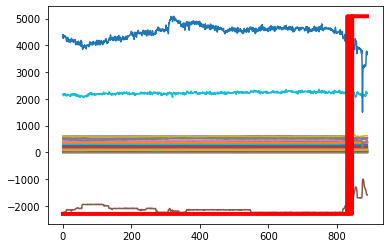

Predicción:  [[[0.12350062 0.87649935]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.5247800e+01  1.1190000e+01  5.3607700e+01  6.8456600e+01
  5.0077980e+02  2.9214000e+01  8.6421000e+00  1.4689610e+02
  9.5439000e+00  5.9798700e+01  9.2978700e+01  7.8010000e+00
  4.5599100e+01  1.5073990e+02  2.0357600e+01  1.4499810e+02
  1.4866480e+02  6.7697800e+01 -4.0000000e-04  3.0821000e+00
  2.8797000e+00  7.5062000e+00  1.6016000e+00  6.9990400e+01
  1.3835000e+00  1.4357000e+00  6.8690300e+01  5.3696500e+01
  1.2805000e+00  1.1778000e+00  1.5380000e+00  1.3121000e+00
  1.3535270e+02  8.5800000e-01  8.5920000e-01 -1.6037242e+03
  1.9431710e+02  1.5040000e+00  1.3344000e+00  2.2382343e+03
  3.6799002e+03  1.8481450e+02  1.3367000e+00  1.3338000e+00
  7.9996000e+00  8.0025000e+00  1.6880000e+00  1.5050000e-01
  2.4655200e+01  5.3467610e+02  5.2646350e+02  5.2240450e+02
  5.2333310e+02  5.2338890e+02  3.0168000e+01  3

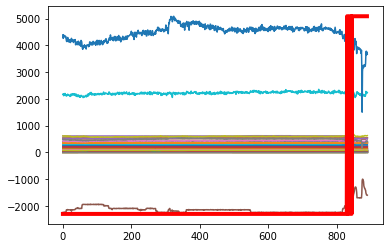

Predicción:  [[[0.11292161 0.8870784 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3790300e+01  1.1280300e+01  5.5257300e+01  6.9135200e+01
  4.9972570e+02  2.9450700e+01  8.6606000e+00  1.4692400e+02
  7.4795000e+00  5.9877500e+01  9.2917100e+01  8.0923000e+00
  4.6284800e+01  1.4996720e+02  2.0744900e+01  1.4399260e+02
  1.4876270e+02  6.7454900e+01 -4.0000000e-04  3.1113000e+00
  2.9202000e+00  7.5101000e+00  1.5997000e+00  6.9975800e+01
  1.3967000e+00  1.4491000e+00  6.9009700e+01  5.4175400e+01
  1.2878000e+00  1.1901000e+00  1.5525000e+00  1.3262000e+00
  1.3571140e+02  8.5880000e-01  8.5990000e-01 -1.6061559e+03
  1.9539200e+02  1.5172000e+00  1.3413000e+00  2.2350465e+03
  3.8401222e+03  1.8481450e+02  1.3538000e+00  1.3480000e+00
  7.9990000e+00  7.9998000e+00  1.7022000e+00  1.4970000e-01
  2.7337200e+01  5.3607990e+02  5.2802730e+02  5.2392000e+02
  5.2481210e+02  5.2484380e+02  3.0112500e+01  3

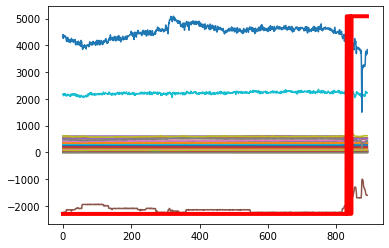

Predicción:  [[[0.15360133 0.84639865]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2796000e+01  1.1374300e+01  5.4862300e+01  6.9153300e+01
  5.0079680e+02  2.9627800e+01  8.7822000e+00  1.4712730e+02
  6.6282000e+00  6.0059300e+01  9.2700900e+01  7.9427000e+00
  4.6511300e+01  1.4959010e+02  2.0884600e+01  1.4279160e+02
  1.4861350e+02  6.7177400e+01 -4.0000000e-04  3.2788000e+00
  2.9383000e+00  7.4890000e+00  1.5983000e+00  6.9944500e+01
  1.3901000e+00  1.4412000e+00  6.8722700e+01  5.4291000e+01
  1.2808000e+00  1.1829000e+00  1.5463000e+00  1.3149000e+00
  1.3622880e+02  8.5920000e-01  8.6000000e-01 -1.6651501e+03
  1.9441940e+02  1.5098000e+00  1.3353000e+00  2.2367316e+03
  3.6616832e+03  1.8481450e+02  1.3407000e+00  1.3367000e+00
  8.0002000e+00  7.9994000e+00  1.6943000e+00  1.4760000e-01
  2.5830800e+01  5.3530230e+02  5.2784880e+02  5.2315740e+02
  5.2413340e+02  5.2414660e+02  3.0237000e+01  3

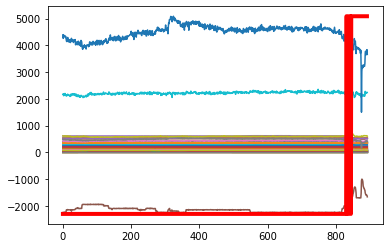

Predicción:  [[[0.15737225 0.84262776]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8280300e+01  1.1534600e+01  5.5083800e+01  6.8204100e+01
  5.0092100e+02  3.0594300e+01  8.7664000e+00  1.4698240e+02
  9.6152000e+00  5.9457600e+01  9.2957300e+01  7.9605000e+00
  4.6755700e+01  1.5517120e+02  2.0807800e+01  1.4292770e+02
  1.4876110e+02  6.7375600e+01 -4.0000000e-04  3.2848000e+00
  2.9546000e+00  7.5256000e+00  1.6003000e+00  7.0022100e+01
  1.3896000e+00  1.4429000e+00  6.7936400e+01  5.4272300e+01
  1.2784000e+00  1.1856000e+00  1.5371000e+00  1.3187000e+00
  1.3445750e+02  8.5940000e-01  8.6050000e-01 -1.6481180e+03
  1.9493690e+02  1.5118000e+00  1.3329000e+00  2.2299917e+03
  3.7501749e+03  1.8481450e+02  1.3455000e+00  1.3394000e+00
  7.9988000e+00  7.9987000e+00  1.6947000e+00  1.5790000e-01
  2.6637500e+01  5.3468220e+02  5.2673190e+02  5.2245960e+02
  5.2336830e+02  5.2342580e+02  3.0342300e+01  3

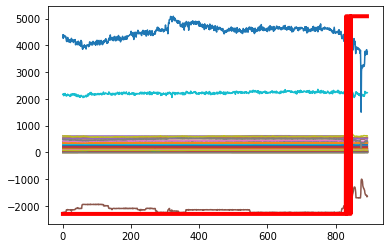

Predicción:  [[[0.16672386 0.8332762 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9099300e+01  1.1591200e+01  5.4127300e+01  6.8809700e+01
  4.9990180e+02  3.0255000e+01  8.7915000e+00  1.4700100e+02
  6.9872000e+00  5.9351400e+01  9.2810300e+01  7.9658000e+00
  4.6851800e+01  1.5062200e+02  2.0854700e+01  1.4193210e+02
  1.4879730e+02  6.7323700e+01 -4.0000000e-04  3.3196000e+00
  2.9493000e+00  7.5099000e+00  1.5991000e+00  6.9998700e+01
  1.3866000e+00  1.4422000e+00  6.9344100e+01  5.4499600e+01
  1.2749000e+00  1.1824000e+00  1.5410000e+00  1.3171000e+00
  1.3497360e+02  8.5930000e-01  8.6010000e-01 -1.6492684e+03
  1.9416550e+02  1.5111000e+00  1.3295000e+00  2.2213079e+03
  3.8785063e+03  1.8481450e+02  1.3419000e+00  1.3372000e+00
  7.9993000e+00  8.0006000e+00  1.6927000e+00  1.5170000e-01
  2.4886800e+01  5.3460000e+02  5.2661170e+02  5.2241150e+02
  5.2317430e+02  5.2338000e+02  3.0238400e+01  3

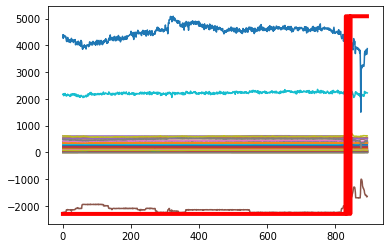

Predicción:  [[[0.20935251 0.7906475 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.9119400e+01  1.1535600e+01  5.4815000e+01  6.7751500e+01
  4.9917920e+02  2.9260800e+01  8.8230000e+00  1.4691850e+02
  9.5789000e+00  5.9223900e+01  9.3092600e+01  8.0377000e+00
  4.6774600e+01  1.5369300e+02  2.0894900e+01  1.4282370e+02
  1.4891700e+02  6.7672900e+01 -4.0000000e-04  3.2090000e+00
  2.8723000e+00  7.4906000e+00  1.5983000e+00  7.0030800e+01
  1.3552000e+00  1.4078000e+00  6.8813700e+01  5.5504700e+01
  1.2414000e+00  1.1556000e+00  1.5051000e+00  1.2859000e+00
  1.3138970e+02  8.6050000e-01  8.6140000e-01 -1.6587770e+03
  1.9625830e+02  1.4767000e+00  1.2972000e+00  2.1814851e+03
  3.6143490e+03  1.8481450e+02  1.3092000e+00  1.3045000e+00
  8.0038000e+00  8.0165000e+00  1.6636000e+00  1.5860000e-01
  2.3523700e+01  5.3170440e+02  5.2452660e+02  5.1948740e+02
  5.2026400e+02  5.2044920e+02  3.0286800e+01  3

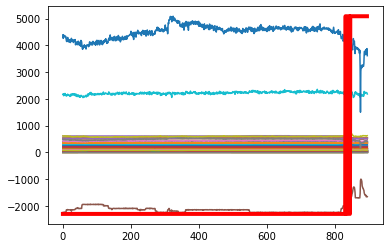

Predicción:  [[[0.13980551 0.8601945 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.7602300e+01  1.1263400e+01  5.5433900e+01  6.4050600e+01
  4.9959480e+02  2.8613100e+01  9.4559000e+00  1.4696320e+02
  1.7635300e+01  5.8075200e+01  9.2797900e+01  7.9931000e+00
  4.6562200e+01  1.6071350e+02  1.9461800e+01  1.4602710e+02
  1.5083010e+02  6.8714000e+01 -4.0000000e-04  2.9549000e+00
  2.8615000e+00  7.4840000e+00  1.5992000e+00  7.0219400e+01
  1.2973000e+00  1.3596000e+00  7.0496600e+01  5.7131000e+01
  1.1876000e+00  1.1005000e+00  1.4331000e+00  1.2285000e+00
  1.2366590e+02  8.5130000e-01  8.5400000e-01 -1.6147594e+03
  1.9998830e+02  1.4304000e+00  1.2452000e+00  2.0930204e+03
  1.8994962e+03  1.8481450e+02  1.2518000e+00  1.2438000e+00
  7.9809000e+00  8.0791000e+00  1.6079000e+00  1.7470000e-01
  2.3050300e+01  5.2207340e+02  5.1684500e+02  5.1307270e+02
  5.1390310e+02  5.1391660e+02  3.0031100e+01  2

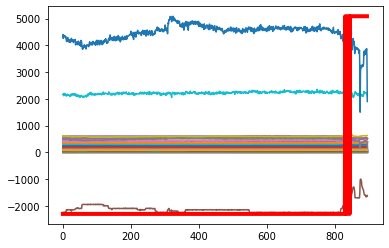

Predicción:  [[[0.00997046 0.9900295 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3848500e+01  1.0786400e+01  5.2599400e+01  6.3344500e+01
  4.9931010e+02  2.8112700e+01  8.8086000e+00  1.4706930e+02
  1.6117500e+01  5.7383700e+01  9.3036500e+01  8.4929000e+00
  4.6564900e+01  1.5817010e+02  1.9650400e+01  1.4339540e+02
  1.5135190e+02  6.8290500e+01 -4.0000000e-04  2.8892000e+00
  2.8655000e+00  7.4944000e+00  1.5986000e+00  7.0451500e+01
  1.3065000e+00  1.3632000e+00  6.9230300e+01  5.6191700e+01
  1.2210000e+00  1.1092000e+00  1.4454000e+00  1.2389000e+00
  1.2762280e+02  8.5540000e-01  8.5760000e-01 -1.4266432e+03
  1.9754220e+02  1.4323000e+00  1.2770000e+00  2.1544630e+03
  1.4015002e+03  1.8481450e+02  1.2626000e+00  1.2576000e+00
  7.9949000e+00  8.0939000e+00  1.6154000e+00  1.6960000e-01
  2.3748600e+01  5.3247440e+02  5.2147160e+02  5.1799580e+02
  5.1866540e+02  5.1894340e+02  3.0224800e+01  2

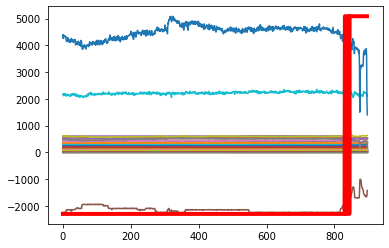

Predicción:  [[[0.00198041 0.9980196 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.3773300e+01  1.0882300e+01  5.4283200e+01  6.5461300e+01
  4.9887400e+02  2.8268900e+01  8.9533000e+00  1.4663820e+02
  1.2345000e+01  5.7386600e+01  9.3077600e+01  8.1293000e+00
  4.6887800e+01  1.5221270e+02  2.0917000e+01  1.4071550e+02
  1.4997520e+02  6.7900800e+01 -4.0000000e-04  2.8982000e+00
  2.8647000e+00  7.4955000e+00  1.6020000e+00  7.0421100e+01
  1.3733000e+00  1.4251000e+00  6.8937400e+01  5.5014500e+01
  1.2807000e+00  1.1695000e+00  1.5169000e+00  1.3062000e+00
  1.3412490e+02  8.6150000e-01  8.6460000e-01 -1.4459487e+03
  1.9481510e+02  1.4935000e+00  1.3356000e+00  2.1684469e+03
  2.5148181e+03  1.8481450e+02  1.3312000e+00  1.3240000e+00
  7.9992000e+00  8.0934000e+00  1.6716000e+00  1.5500000e-01
  2.5008100e+01  5.3657450e+02  5.2617680e+02  5.2262140e+02
  5.2335800e+02  5.2368840e+02  3.0132700e+01  2

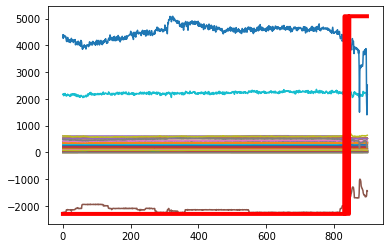

Predicción:  [[[0.01061076 0.98938924]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 5.2019800e+01  1.1334300e+01  5.1958800e+01  7.0385200e+01
  5.0014420e+02  3.0217700e+01  9.2750000e+00  1.4604720e+02
  7.2970000e-01  5.8072000e+01  9.3044500e+01  8.1018000e+00
  4.7155300e+01  1.4316730e+02  2.3415100e+01  1.4163400e+02
  1.4711540e+02  6.7084700e+01 -4.0000000e-04  2.8920000e+00
  2.7461000e+00  7.4695000e+00  1.6011000e+00  7.0005500e+01
  1.4365000e+00  1.4880000e+00  6.8698000e+01  5.3827400e+01
  1.3343000e+00  1.2269000e+00  1.5894000e+00  1.3669000e+00
  1.3987550e+02  8.5860000e-01  8.6090000e-01 -1.4952632e+03
  1.9258120e+02  1.5571000e+00  1.3885000e+00  2.2289332e+03
  3.9155360e+03  1.8481450e+02  1.3928000e+00  1.3861000e+00
  7.9992000e+00  8.0992000e+00  1.7305000e+00  1.4070000e-01
  2.5934700e+01  5.3839330e+02  5.3360090e+02  5.2842840e+02
  5.2921600e+02  5.2942300e+02  2.9830400e+01  2

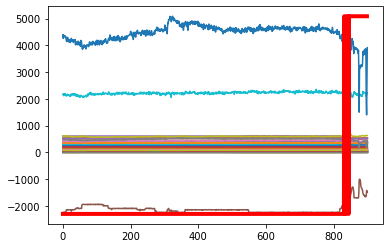

Predicción:  [[[0.09308964 0.90691036]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.8226100e+01  1.0780100e+01  5.3437300e+01  6.9197000e+01
  5.0050200e+02  2.9769200e+01  9.4011000e+00  1.4606410e+02
  2.4684000e+00  5.8673000e+01  9.2964500e+01  7.7348000e+00
  4.6889100e+01  1.4630520e+02  2.2405900e+01  1.4169270e+02
  1.4456540e+02  6.7145700e+01 -4.0000000e-04  3.1595000e+00
  2.3994000e+00  7.4906000e+00  1.6009000e+00  6.9813900e+01
  1.3987000e+00  1.4539000e+00  6.8401000e+01  5.4689900e+01
  1.2972000e+00  1.1947000e+00  1.5595000e+00  1.3293000e+00
  1.3512870e+02  8.5780000e-01  8.5960000e-01 -1.5408160e+03
  1.9255880e+02  1.5231000e+00  1.3517000e+00  2.1309111e+03
  3.9445779e+03  1.8481450e+02  1.3539000e+00  1.3490000e+00
  7.7364000e+00  8.1056000e+00  1.7074000e+00  1.4790000e-01
  2.4714200e+01  5.2686220e+02  5.2735730e+02  5.2215540e+02
  5.2298590e+02  5.2305930e+02  3.0408200e+01  2

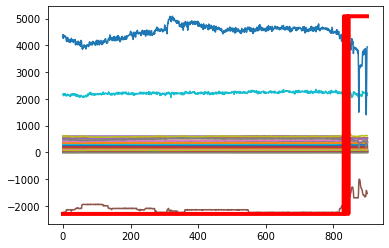

Predicción:  [[[0.12649488 0.87350506]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.5180600e+01  1.0461200e+01  5.4551600e+01  6.9313700e+01
  5.0042130e+02  2.8085800e+01  9.4074000e+00  1.4598440e+02
  3.6606000e+00  5.8752200e+01  9.2865900e+01  7.9278000e+00
  4.6886600e+01  1.4605620e+02  2.1832700e+01  1.4316610e+02
  1.4475650e+02  6.7098000e+01 -4.0000000e-04  3.1944000e+00
  8.2090000e+00  7.5066000e+00  1.6012000e+00  6.9814400e+01
  1.3946000e+00  1.4467000e+00  6.7949400e+01  5.5400500e+01
  1.2925000e+00  1.1936000e+00  1.5313000e+00  1.3275000e+00
  1.3329370e+02  8.5670000e-01  8.5980000e-01 -1.5543137e+03
  1.9131140e+02  1.5158000e+00  1.3478000e+00  2.2406660e+03
  3.8538115e+03  1.8481450e+02  1.3511000e+00  1.3477000e+00
  7.7034000e+00  8.1073000e+00  1.6906000e+00  1.5910000e-01
  2.3753900e+01  5.2594230e+02  5.2459310e+02  5.2057670e+02
  5.2144820e+02  5.2150780e+02  3.0472000e+01  2

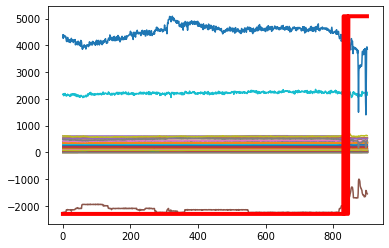

Predicción:  [[[0.11539196 0.88460803]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2774500e+01  1.0114400e+01  5.3151600e+01  6.8560300e+01
  5.0094510e+02  2.8258500e+01  9.3941000e+00  1.4608890e+02
  3.2068000e+00  7.2889700e+01  9.2846000e+01  8.0827000e+00
  4.7113900e+01  1.5105570e+02  2.1879000e+01  1.4319770e+02
  1.4423840e+02  6.7286900e+01 -4.0000000e-04  3.2046000e+00
  2.3100000e-01  7.4771000e+00  1.6001000e+00  6.9719900e+01
  1.3797000e+00  1.4307000e+00  6.7082600e+01  5.5630100e+01
  1.2747000e+00  1.1811000e+00  1.5220000e+00  1.3090000e+00
  1.3189520e+02  8.5610000e-01  8.5970000e-01 -1.5518205e+03
  1.9309980e+02  1.4981000e+00  1.3302000e+00  2.2477224e+03
  3.8927214e+03  1.8481450e+02  1.3333000e+00  1.3268000e+00
  7.7001000e+00  8.1009000e+00  1.6747000e+00  1.5240000e-01
  2.4330500e+01  5.2588890e+02  5.2533230e+02  5.2075180e+02
  5.2169750e+02  5.2168760e+02  3.0253500e+01  2

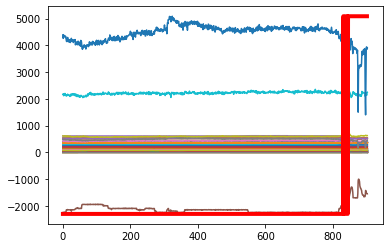

Predicción:  [[[0.1232135  0.87678653]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7238300e+01  1.0263700e+01  5.2243900e+01  6.7380000e+01
  5.0089460e+02  2.9030200e+01  9.4152000e+00  1.4601170e+02
  4.6928000e+00  7.3128500e+01  9.2960300e+01  8.0834000e+00
  4.5356800e+01  1.5544020e+02  2.1107000e+01  1.4569610e+02
  1.4393840e+02  6.7308100e+01 -4.0000000e-04  3.1925000e+00
  6.6223000e+00  7.5096000e+00  1.6016000e+00  6.9828900e+01
  1.3739000e+00  1.4346000e+00  6.7295600e+01  5.5889900e+01
  1.2813000e+00  1.1784000e+00  1.5150000e+00  1.3065000e+00
  1.2699970e+02  8.5370000e-01  8.5960000e-01 -1.5524386e+03
  1.9330670e+02  1.5024000e+00  1.3370000e+00  2.1798877e+03
  3.8511802e+03  1.8481450e+02  1.3325000e+00  1.3246000e+00
  7.6964000e+00  8.1022000e+00  1.6878000e+00  1.7300000e-01
  2.5757400e+01  5.2343340e+02  5.2334720e+02  5.1890770e+02
  5.1990840e+02  5.1986670e+02  2.9601700e+01  2

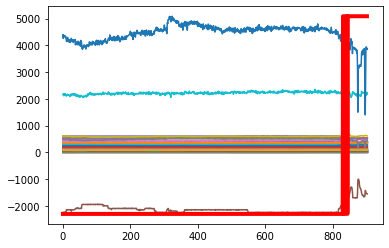

Predicción:  [[[0.11545531 0.88454473]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7070000e+01  1.0867500e+01  5.1615800e+01  6.8804000e+01
  5.0014890e+02  2.8754400e+01  9.3795000e+00  1.4596710e+02
  4.1164000e+00  7.2612100e+01  9.2945300e+01  7.9019000e+00
  4.4885400e+01  1.5713340e+02  2.1256300e+01  1.4699820e+02
  1.4428980e+02  6.7466500e+01 -4.0000000e-04  3.2020000e+00
  8.8269000e+00  7.5366000e+00  1.5993000e+00  6.9837300e+01
  1.3733000e+00  1.4281000e+00  6.9236000e+01  5.6510200e+01
  1.2769000e+00  1.1788000e+00  1.4999000e+00  1.3075000e+00
  1.2739170e+02  8.5300000e-01  8.5930000e-01 -1.5501135e+03
  1.9364730e+02  1.4961000e+00  1.3331000e+00  2.2104520e+03
  3.8589964e+03  1.8481450e+02  1.3326000e+00  1.3260000e+00
  7.7031000e+00  8.1028000e+00  1.6823000e+00  1.8250000e-01
  2.5171700e+01  5.2233550e+02  5.2276270e+02  5.1855510e+02
  5.1953830e+02  5.1961660e+02  2.9594800e+01  2

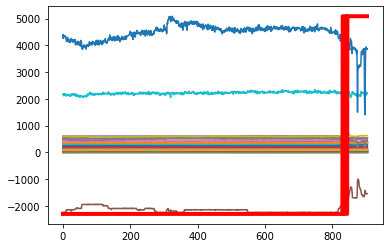

Predicción:  [[[0.11565547 0.8843446 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7844100e+01  1.0881400e+01  5.2219700e+01  6.9503200e+01
  4.9949930e+02  2.8816000e+01  9.3797000e+00  1.4597680e+02
  4.9011000e+00  7.2615900e+01  9.2981000e+01  7.9838000e+00
  4.4700500e+01  1.5601690e+02  2.1341000e+01  1.4880970e+02
  1.4446650e+02  6.7274000e+01 -4.0000000e-04  3.2179000e+00
  7.3211000e+00  7.4964000e+00  1.5992000e+00  6.9846400e+01
  1.3708000e+00  1.4279000e+00  6.8764800e+01  5.5680900e+01
  1.2690000e+00  1.1765000e+00  1.5024000e+00  1.3050000e+00
  1.2772030e+02  8.5410000e-01  8.6090000e-01 -1.5448183e+03
  1.9286130e+02  1.4967000e+00  1.3252000e+00  2.2038569e+03
  3.9238665e+03  1.8481450e+02  1.3312000e+00  1.3230000e+00
  7.6976000e+00  8.1009000e+00  1.6791000e+00  1.7660000e-01
  2.6166900e+01  5.2252900e+02  5.2286800e+02  5.1859600e+02
  5.1954960e+02  5.1968520e+02  2.9492300e+01  2

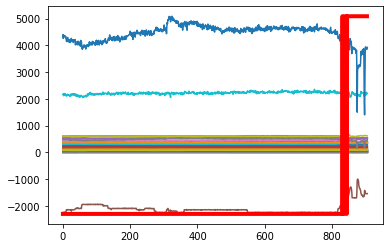

Predicción:  [[[0.12652753 0.8734725 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7695600e+01  1.0965000e+01  5.1915400e+01  6.8288800e+01
  5.0062260e+02  2.9687400e+01  9.3901000e+00  1.4608560e+02
  4.8633000e+00  7.1093400e+01  9.3032500e+01  7.8230000e+00
  4.5968500e+01  1.5560930e+02  2.1351800e+01  1.5112250e+02
  1.4462180e+02  6.7384700e+01 -4.0000000e-04  3.2097000e+00
  7.6853000e+00  7.4842000e+00  1.5999000e+00  6.9800900e+01
  1.3716000e+00  1.4237000e+00  6.8923000e+01  5.6970300e+01
  1.2695000e+00  1.1757000e+00  1.4998000e+00  1.3021000e+00
  1.2872370e+02  8.5290000e-01  8.5960000e-01 -1.5544893e+03
  1.9628260e+02  1.4929000e+00  1.3262000e+00  2.1433735e+03
  3.8589400e+03  1.8481450e+02  1.3284000e+00  1.3191000e+00
  7.7010000e+00  8.0991000e+00  1.6770000e+00  1.7730000e-01
  2.6260300e+01  5.2300430e+02  5.2295350e+02  5.1873940e+02
  5.1975420e+02  5.1980560e+02  2.9324600e+01  2

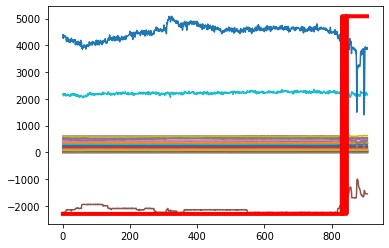

Predicción:  [[[0.11967114 0.8803289 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.7502300e+01  1.0917400e+01  5.2596000e+01  6.7946800e+01
  4.9916120e+02  3.1545600e+01  9.3843000e+00  1.4594270e+02
  5.0220000e+00  7.0241000e+01  9.2985300e+01  8.0538000e+00
  4.5776000e+01  1.5695860e+02  2.1413900e+01  1.5265890e+02
  1.4469270e+02  6.7387000e+01 -4.0000000e-04  3.1935000e+00
  7.2279000e+00  7.5212000e+00  1.5982000e+00  6.9838100e+01
  1.3720000e+00  1.4227000e+00  6.8614900e+01  5.6003500e+01
  1.2733000e+00  1.1764000e+00  1.4978000e+00  1.3043000e+00
  1.2796180e+02  8.5450000e-01  8.5970000e-01 -1.5593113e+03
  1.9568640e+02  1.4911000e+00  1.3290000e+00  2.2566179e+03
  3.8436204e+03  1.8481450e+02  1.3313000e+00  1.3223000e+00
  7.6968000e+00  8.0967000e+00  1.6763000e+00  1.7850000e-01
  2.6866500e+01  5.2357790e+02  5.2345700e+02  5.1892820e+02
  5.1997690e+02  5.2005510e+02  2.9443300e+01  2

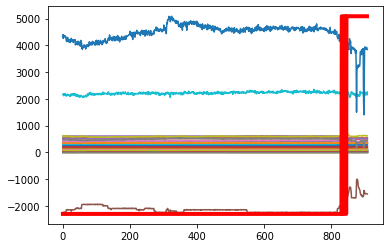

Predicción:  [[[0.11872728 0.88127273]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 3.9121900e+01  1.0981600e+01  5.1351000e+01  6.8530500e+01
  5.0006960e+02  3.0195200e+01  9.3814000e+00  1.4590990e+02
  5.1033000e+00  7.0118700e+01  9.3123600e+01  7.9724000e+00
  4.5032900e+01  1.5567040e+02  2.0784900e+01  1.5450940e+02
  1.4487510e+02  6.7724100e+01 -4.0000000e-04  3.1982000e+00
  8.0986000e+00  7.4870000e+00  1.6012000e+00  6.9875000e+01
  1.3506000e+00  1.4025000e+00  6.8080600e+01  5.6283700e+01
  1.2507000e+00  1.1582000e+00  1.4801000e+00  1.2823000e+00
  1.2571500e+02  8.5240000e-01  8.5910000e-01 -1.5316430e+03
  1.9532310e+02  1.4716000e+00  1.3074000e+00  2.1636078e+03
  3.7676057e+03  1.8481450e+02  1.3068000e+00  1.3027000e+00
  7.7033000e+00  8.1974000e+00  1.6588000e+00  1.7850000e-01
  2.4394700e+01  5.2128210e+02  5.2218600e+02  5.1681870e+02
  5.1781880e+02  5.1790350e+02  2.9459800e+01  2

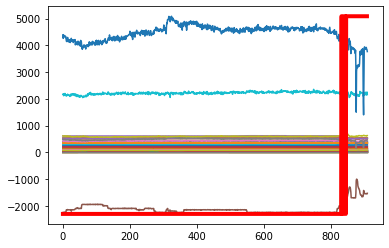

Predicción:  [[[0.09305124 0.9069487 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.1725100e+01  1.0756700e+01  5.2044100e+01  6.5863200e+01
  5.0055570e+02  2.9310300e+01  9.4271000e+00  1.4609090e+02
  5.4874000e+00  6.9581500e+01  9.2934100e+01  7.9917000e+00
  4.4652400e+01  1.5227930e+02  2.0309300e+01  1.5433600e+02
  1.4580780e+02  6.8016600e+01 -4.0000000e-04  3.2057000e+00
  1.3665100e+01  7.4950000e+00  1.5990000e+00  6.9808700e+01
  1.3149000e+00  1.3751000e+00  6.9236500e+01  5.7722400e+01
  1.2136000e+00  1.1237000e+00  1.4431000e+00  1.2492000e+00
  1.2208700e+02  8.5730000e-01  8.6240000e-01 -1.5651386e+03
  1.9855620e+02  1.4445000e+00  1.2717000e+00  2.1504283e+03
  3.8719638e+03  1.8481450e+02  1.2724000e+00  1.2713000e+00
  7.7005000e+00  8.6453000e+00  1.6275000e+00  1.8450000e-01
  2.2924000e+01  5.1755560e+02  5.1623090e+02  5.1260900e+02
  5.1350600e+02  5.1370350e+02  2.8675500e+01  2

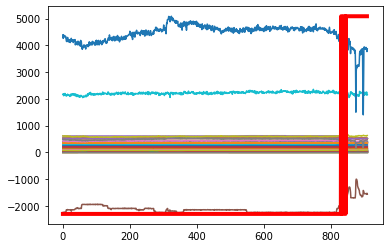

Predicción:  [[[0.13320157 0.8667984 ]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2034100e+01  1.0474900e+01  5.1293800e+01  6.6508600e+01
  4.9976110e+02  2.9165600e+01  9.4664000e+00  1.4601730e+02
  5.1841000e+00  6.9575900e+01  9.2763800e+01  8.1408000e+00
  4.4952300e+01  1.5321920e+02  1.9499100e+01  1.5477290e+02
  1.4637440e+02  6.7932400e+01 -4.0000000e-04  3.2030000e+00
  1.0786200e+01  7.4951000e+00  1.6002000e+00  6.9765300e+01
  1.3395000e+00  1.3919000e+00  6.9588300e+01  5.7360000e+01
  1.2117000e+00  1.1446000e+00  1.4685000e+00  1.2721000e+00
  1.2567470e+02  8.5820000e-01  8.5950000e-01 -1.7811447e+03
  1.9575550e+02  1.4612000e+00  1.2688000e+00  2.1228711e+03
  3.9685239e+03  1.8481450e+02  1.2990000e+00  1.2927000e+00
  7.6997000e+00  8.5571000e+00  1.6457000e+00  1.7730000e-01
  2.6439700e+01  5.2500670e+02  5.2029990e+02  5.1685640e+02
  5.1771850e+02  5.1800140e+02  2.7644500e+01  2

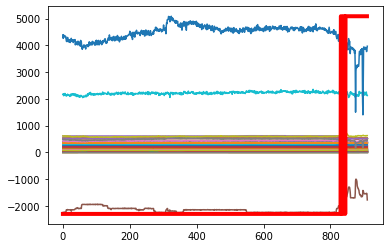

Predicción:  [[[0.45862985 0.54137015]]] Etiqueta:  1
Estado en 30 minutos:  ESTADO CRITICO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.3265600e+01  1.0437600e+01  5.1295300e+01  6.7847400e+01
  5.0006620e+02  2.9110600e+01  9.4811000e+00  1.4597500e+02
  4.3190000e+00  6.9965700e+01  9.2884900e+01  7.9223000e+00
  4.5873700e+01  1.5193100e+02  2.2157900e+01  1.5672470e+02
  1.4575170e+02  6.7897200e+01 -4.0000000e-04  3.2016000e+00
  7.0252000e+00  7.4893000e+00  1.6014000e+00  6.9809800e+01
  1.3655000e+00  1.4180000e+00  6.8879200e+01  5.7670000e+01
  1.2161000e+00  1.1676000e+00  1.5045000e+00  1.2954000e+00
  1.2889630e+02  8.5810000e-01  8.6080000e-01 -2.0004253e+03
  1.9805180e+02  1.4872000e+00  1.2736000e+00  2.1955041e+03
  4.2350691e+03  1.8481450e+02  1.3233000e+00  1.3162000e+00
  7.7023000e+00  8.6068000e+00  1.6716000e+00  1.6710000e-01
  2.7751200e+01  5.2772210e+02  5.2446500e+02  5.2003470e+02
  5.2079580e+02  5.2110670e+02  2.7379600e+01  2

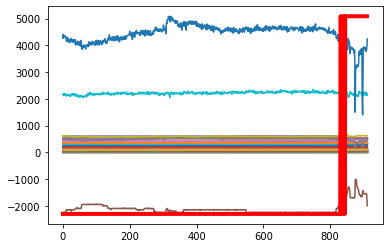

Predicción:  [[[0.8695009  0.13049915]]] Etiqueta:  0
Estado en 30 minutos:  BUEN ESTADO
Proceso Simulador de Lecturas - Proc.Nro. 4584
Lecturas enviadas:  [ 4.2326000e+01  1.0513700e+01  5.2086700e+01  6.7956300e+01
  4.9993330e+02  2.9358200e+01  9.4901000e+00  1.4595750e+02
  8.0980000e-01  6.9568800e+01  9.2850400e+01  7.9223000e+00
  4.6228300e+01  1.5225790e+02  2.2172800e+01  1.5599260e+02
  1.4531560e+02  6.8081200e+01 -4.0000000e-04  3.1838000e+00
  7.7828000e+00  7.5171000e+00  1.6008000e+00  6.9777800e+01
  1.3649000e+00  1.4177000e+00  6.8213300e+01  5.8034700e+01
  1.2156000e+00  1.1667000e+00  1.5032000e+00  1.2956000e+00
  1.2922730e+02  8.5770000e-01  8.6010000e-01 -2.0009105e+03
  1.9739230e+02  1.4863000e+00  1.2738000e+00  2.1495327e+03
  4.2282267e+03  1.8481450e+02  1.3231000e+00  1.3167000e+00
  7.7001000e+00  8.6541000e+00  1.6731000e+00  1.7030000e-01
  2.7481400e+01  5.2468450e+02  5.2339570e+02  5.1892400e+02
  5.1958920e+02  5.2003470e+02  2.7680700e+01  2.81

In [6]:
# Lectura del dataset sintético
sds = pd.read_csv('TimeSerie_Real_Data.txt', sep='\t', header=None)
sds = sds.to_numpy()

# Semáforo para acceso a la consola
console_lock = threading.Lock()

# Lectura del modelo de aprendizaje profundo
with open('model_MLP_Real_1.json', 'r') as json_file:
    model_json = json_file.read()
loaded_model = model_from_json(model_json)

# Lectura de los parámetros entrenados
loaded_model.load_weights('model_MLP_Real_1.h5')

# Compilación del modelo
opt = keras.optimizers.Adam(learning_rate=.002)
loaded_model.compile(optimizer = opt, loss='categorical_crossentropy', metrics = ['accuracy'])

# Etiquetas con los estados posibles
text_labels = ['BUEN ESTADO', 'ESTADO CRITICO']

# Creación del repositorio para intercambio de datos entre procesos (FIFO)
q = queue.Queue()

# Visualización de la estructura del modelo de aprendizaje profundo leído
loaded_model.summary()

# Creación de los procesos concurrentes
p1 = threading.Thread(target=simulator, args=('p1', console_lock))
p2 = threading.Thread(target=predictor, args=('p2', console_lock, loaded_model))

# Inicio de la ejecución de los procesos
p1.start()
p2.start()